# Image Warping

Pointwise image operations change the colors and tones in an image without moving its content around in space. Image warping is in some ways the opposite: the color of content stays the same, but we move that content around spatially.  

To be more precise, let's say that we have an image \\(I\\), and some warping function \\(\phi\\), such that:
- \\(I:R^2 \rightarrow C\\)
- \\(\phi:R^2\rightarrow R^2\\)

So \\(I\\) simply maps the 2D plane to some color space \\(C\\) (which could be, e.g., Luminance, RGB, or RGBA), while \\(\phi\\) maps points on the 2D plane to other points on the 2D plane. Now we can define the output image \\(O\\) warped by \\(\phi\\) as the composition:

\\[O = I \circ \phi\\]

That is, to evaluate the output image at a particular point \\(\mathbf{x}\\), you simply evaluate the input image at the point \\(\phi(\mathbf{x})\\).

So to compute the value of a pixel in \\(O\\), we compute the point in the domain of \\(I\\) that corresponds, and we look up the value of \\(I\\) there.  Since \\(I\\) is represented as a grid of pixels, and there is no particular reason that the desired sample locations are aligned with pixel locations, this is going to require interpolation.

In [102]:
import math
import numpy as np
from PIL import Image
from IPython.display import display
from ipywidgets import interact

In [103]:
%matplotlib notebook
import matplotlib
from matplotlib import pyplot as plt

Let's start by loading an image that has some detail and sharp edges in it, which will help reveal differences between interpolation methods.

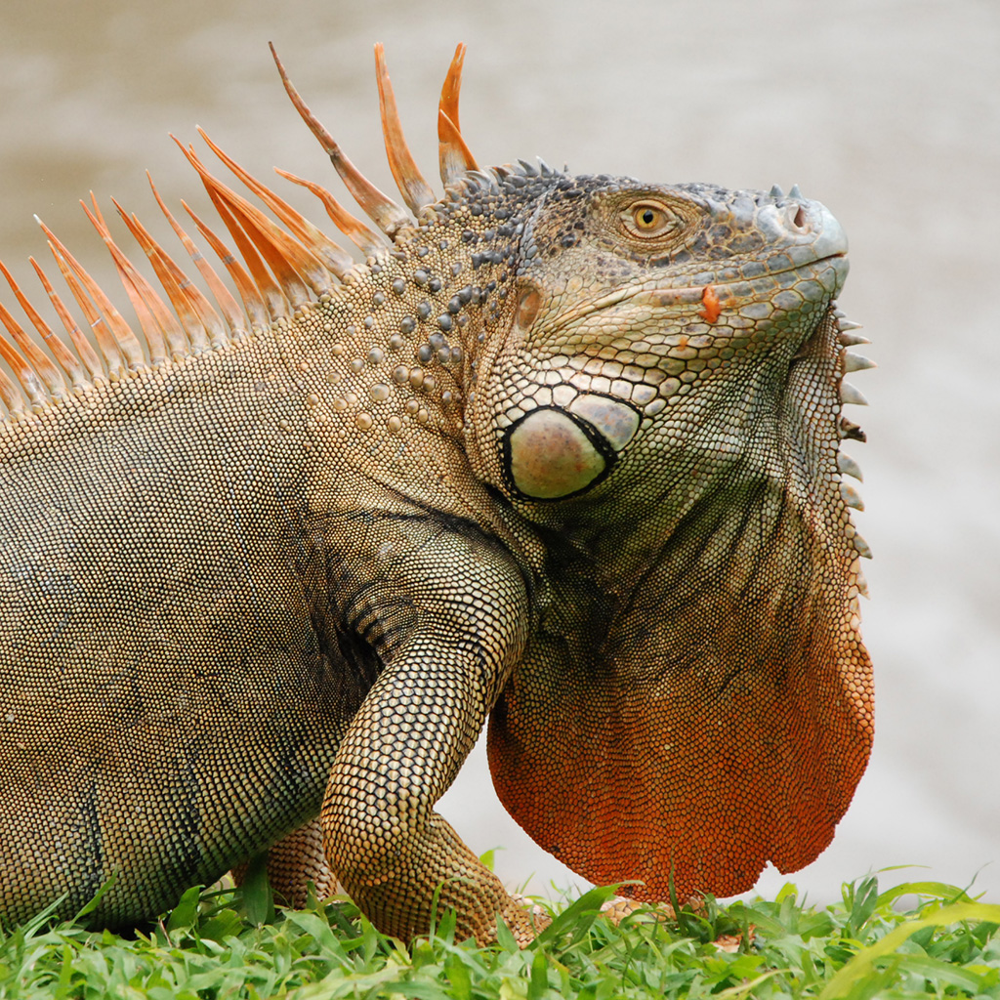

<IPython.core.display.Javascript object>


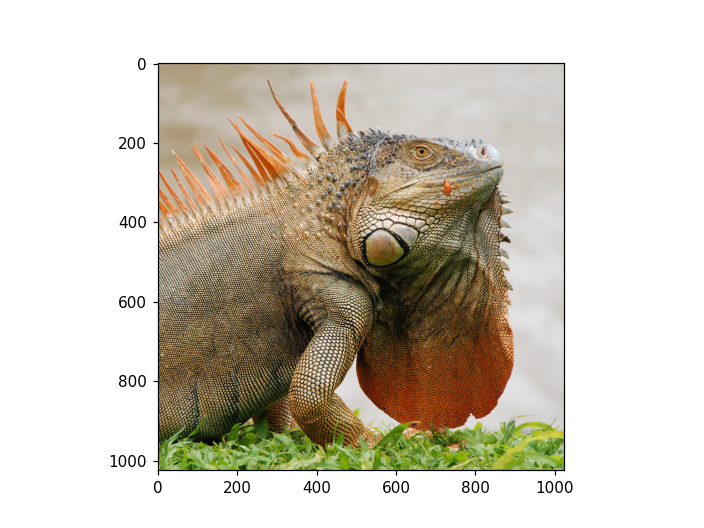

In [29]:
im = np.array(Image.open('inputs/iguana.jpg'))
display(Image.fromarray(im))
plt.figure()
plt.imshow(im)


As a warm-up, write a function that takes an image and returns that image shifted to the left by k pixels.  Observe that to do this means looking k pixels to the *right* in the input image.  This is exactly the same phenomenon as the function \\(f(x+3)\\) looking like \\(f(x)\\) shifted 3 units to the *left*, even though \\(x+3\\) is to the right of \\(x\\). 


Image is same as reference:  True


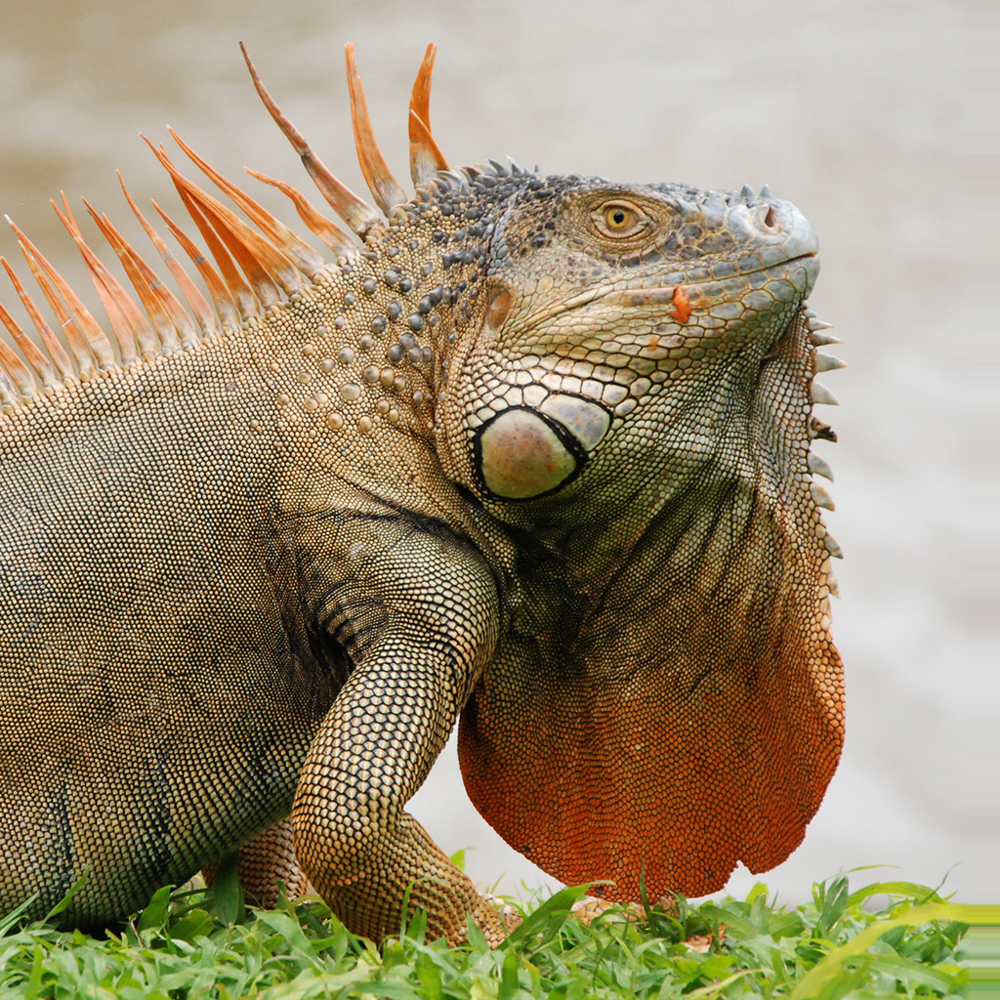

In [12]:
# ======================= shift_image_to_left =======================
# Input:
#   img: 2D numpy array of a grayscale image
#   k: The number of units/pixels to be shifted to the left (you can assume k < width of image)
# Output:
#   A 2D array of img shifted to the left by k pixels
#   For points that fall out of range on the right side, repeat the rightmost pixel. 
def shift_image_to_left(img, k):
    # coordinate -x +y
    new_img = np.zeros(img.shape, np.uint8)
    row_num = img.shape[0]
    col_num = img.shape[1]
    for i in range(row_num):
        for j in range(col_num):
            new_col = j + k
            if new_col >= col_num:
                new_img[i][j] = img[i][col_num-1]
            else:
                new_img[i][j] = img[i][new_col]

    return new_img

# This is for testing
ref_shift_im = np.array(Image.open('./reference/distortion-shift-reference.png'))
shift_im = shift_image_to_left(im, 30)

print("Image is same as reference: ", np.array_equal(ref_shift_im[:,:-30,:], shift_im[:,:-30,:]))
display(Image.fromarray(shift_im))


## Rotating images

Next write a function to rotate an image by k degrees counter-clockwise around its center.  What function \\(\phi\\) do you need to accomplish this? For points that fall outside the bounds of the input image, you can just put in black.

This rotation is done around the center of the image. This should be an integer coordinate value. Calculate the center by using python integer division (this will handle odd length and widths). 

**For now ignore the `interp_mode` parameter and use nearest-neighbor interpolation when looking up values from the input image. This corresponds to interp_mode = 0. You will come back to this and implement interp_mode=1 for bilinear interpolation later in the assignment**

In [90]:
math.ceil(0.1)

1

Image is same as reference:  False


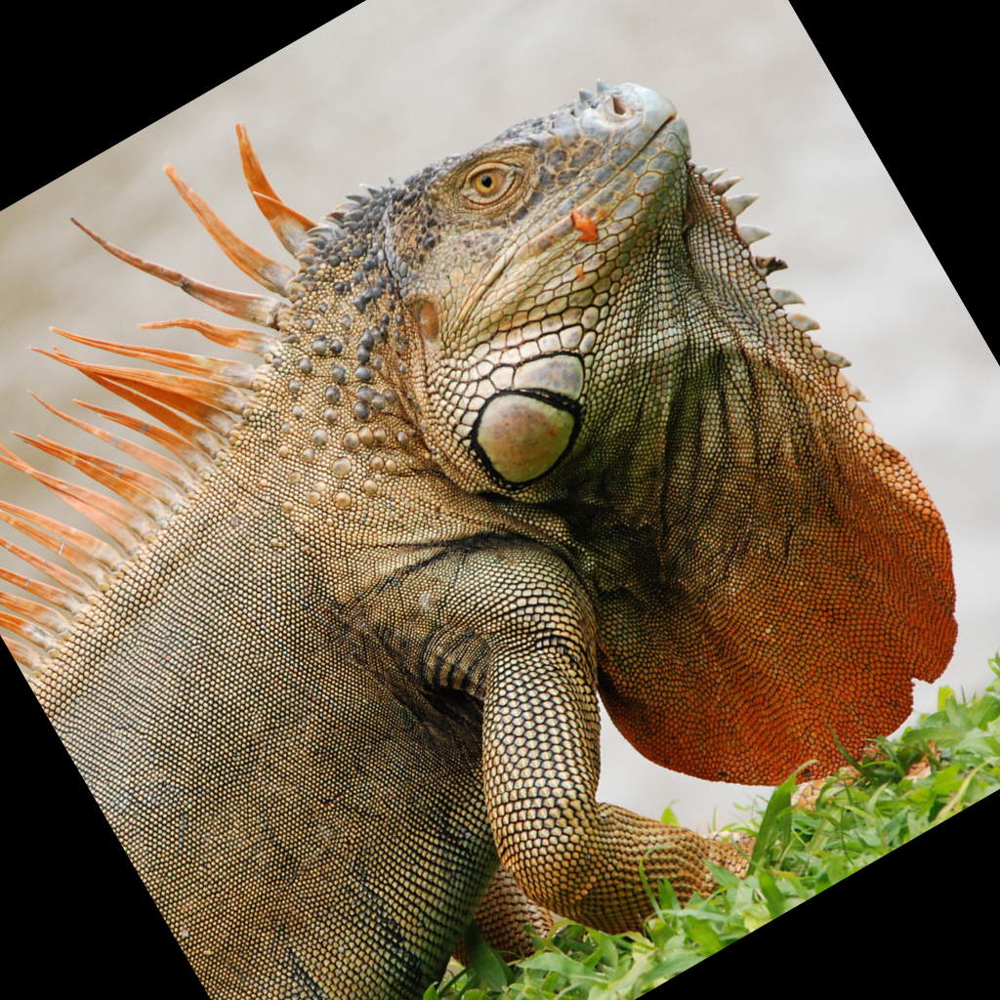

CPU times: user 15.8 s, sys: 58.1 ms, total: 15.9 s
Wall time: 16 s


In [98]:
%%time
# ======================= rotate_image =======================
# Input:
#   img: 2D numpy array of a grayscale image
#   k: The angle (in degrees) to be rotated counter-clockwise around the image center
#   interp_mode: 0 for nearest neighbor, 1 for bilinear
# Output:
#   A 2D array of img rotated around the original image's center by k degrees
# Put black in for points that fall out of bounds
def rotate_image(img, k, interp_mode=1):
    new_img = np.zeros(img.shape, np.uint8)
    row_num = img.shape[0] # height
    col_num = img.shape[1] # width
    center_x = col_num//2
    center_y = row_num//2
    cos = math.cos(math.radians(k%360))
    sin = math.sin(math.radians(k%360) )
    for i in range(row_num): # go over new im
        for j in range(col_num):
            adjusted_i = i - center_x
            adjusted_j = j - center_y
            x = (adjusted_i*cos) + (adjusted_j*sin) + center_x
            y = (-adjusted_i*sin) + (adjusted_j*cos) + center_y
            
            if interp_mode == 0:
                if x >= 0 and x < row_num and y >= 0 and y < col_num:
                    new_img[i][j] = img[round(x)][round(y)]
            else:
                if x>-1 and x < row_num and y>-1 and y<col_num:

                    floorx = math.floor(x)
                    floory = math.floor(y)
                    ceilx = floorx+1
                    ceily = floory+1

                    topleft = [floorx,floory]
                    topright = [ceilx,floory]
                    bottomleft = [floorx,ceily]
                    bottomright = [ceilx,ceily]

                    a = topright[0] - x
                    b = x - topleft[0]

                    q00 = np.array([0,0,0])
                    q01 = np.array([0,0,0])
                    q10 = np.array([0,0,0])
                    q11 = np.array([0,0,0])
                    if floorx >= 0 and floory >=0:
                        q00 = img[topleft[0]][topleft[1]]
                    if ceilx < row_num and floory >= 0:
                        q01 =  img[topright[0]][topright[1]]
                    if floorx >= 0 and ceily < col_num:
                        q10 =  img[bottomleft[0]][bottomleft[1]]
                    if ceilx < row_num and ceily < col_num:
                        q11 = img[bottomright[0]][bottomright[1]]
                    
                    temp1 = a*q00 + b*q01
                    temp2 = a*q10 + b*q11
                    c = bottomright[1] - y
                    d = y - topright[1]
                    new_img[i][j] = np.round(d*temp2+ c*temp1)
                
    return new_img 

# This is for testing
rot_im = rotate_image(im, 30)
ref_rot_im = np.array(Image.open('./reference/rotated-img-lin-reference.png'))
# ref_rot_im = np.array(Image.open('./reference/distortion-rotate-reference.png'))
print("Image is same as reference: ", np.array_equal(ref_rot_im, rot_im))
display(Image.fromarray(rot_im))

In [100]:
np.amax(np.abs(rot_im.astype(int) - ref_rot_im.astype(int)))


1

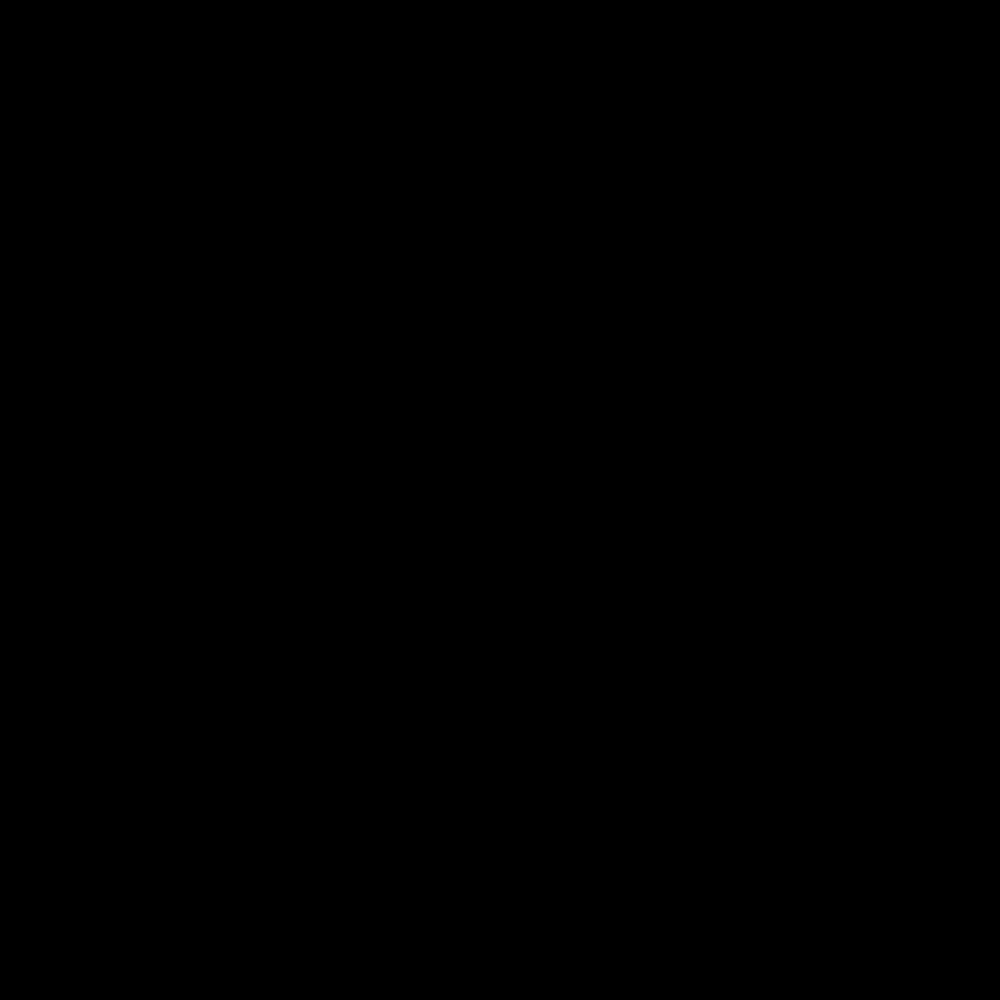

In [99]:
diff = rot_im-ref_rot_im
Image.fromarray(diff)

A fun stress test for image rotation is to apply the operation many times so that the image rotates a full 360 degrees.  Try it below; you might like to set `k` to a smaller value if your implementation is slow.  With nearest-neighbor sampling this test will produce artifacts that look like noise around details and edges.

For reference: I implemented two versions of the rotate function. The first one is very straightforward and takes about 30 seconds *per call* (I didn't run it on the code below, which presumably would have taken about 10 minutes). The second one is a bit fancier---using it, the code below runs in under 2 seconds. The first implementation is fine for the core part of this assignment. Something closer in performance to my fancy implementation can count toward your creative submission. 

## Correcting lens distortion

Below we load a camera image that is very wide-angle and has a lot of distortion (the straight lines in the scene do not stay straight in the image).  This is a common behavior of wide angle camera optics, but we might like to have an image that does not exhibit this distortion.  Fortunately the distortion that is caused by lenses can often be described by simple models, which lets us use image warping to correct for it.

By analyzing a set of photos of a known pattern (a checkerboard) we have fit such a model for this particular camera.  This model is a function that maps the point where an ideal lens would put a particular image feature to the place where our distorted lens actually puts it.  This is the right kind of function \\(\phi\\) for an image warp, since we can give it the coordinates of a pixel in the corrected image we want, and it will tell us where we should look for the content in the distorted image we have. To be specific, the input of \\(\phi\\) is a coordinate in the undistorted corrected image. The output is the coordinates of that pixel in the distorted image. 

This particular model comes in two parts: a polynomial model for radial distortion, and an affine transformation from pixel coordinates to the coordinates where the distortion model is defined.

The distortion model (denote it as $g$) is called a radial distortion model because it moves each point along the line from some optical center to that point. If we use a coordinate system that places our optical center at the origin origin then we can write the distortion model as a scaling of input points where the scaling factor varies with distance from the origin. In other words, a point \\(x\\) with distance \\(r = \|\mathbf{x}\|\\) from the origin maps to the point \\(s\mathbf{x}\\) where \\(s\\) is a function of \\(r\\) with the form given below:

\\[
g(\mathbf{x}) = s(r) \mathbf{x}\\
s(r) = 1 + k_1 r^2 + k_2 r^4
\\]

The two coefficients \\(k_1\\) and \\(k_2\\) describe the kind of distortion.  For instance, if both are zero, the scale factor is always 1 and there is no distortion.

In practice, this family of radial distortion functions is a good approximation of the distortion in real lenses. However, the optical center of this distortion is not usually at the origin of pixel coordinates. Therefore, the other piece of our calibration data is a 2D affine transformation (denote it as matrix $M$) that relates pixel coordinates (where (0,0) is at the corner of our image, rather than the optical center of lens distortion) and the coordinates of this distortion model.  In particular, this transformation takes the distortion-model coordinates and maps them to image (pixel) coordinates:

\\[
\mathbf{x}_\mathrm{pix} = M \mathbf{x}
\\]

where \\(\mathbf{x}_\mathrm{pix}\\) is the coordinates of the point measured in pixels.  For example, the center of distortion, measured in pixels, is the translation part of this matrix.  Putting it all together, what is the distortion model $\phi(\mathbf{x})$ that allows us to transform a distorted image into an undistorted image (written in terms of $M$ and $g$)?
[We leave it as an exercise.]

Write a function that will compute the undistorted image given the distorted image and the model parameters.  Try it on the provided example and see if it straightens out the lines!

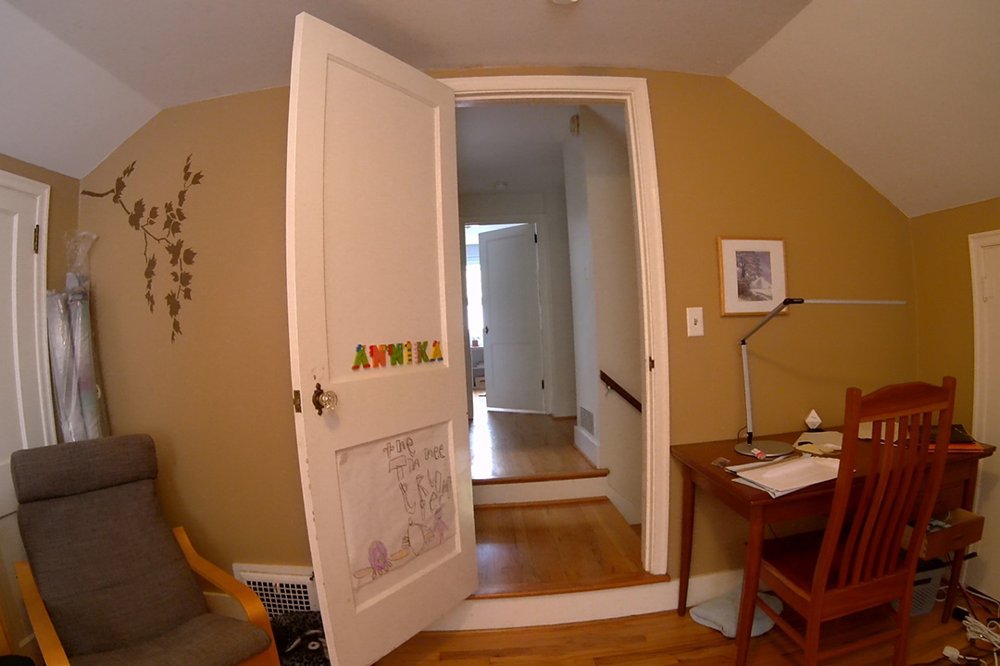

In [5]:
distorted_im = np.array(Image.open('inputs/room.jpg'))
display(Image.fromarray(distorted_im))

Here are the distortion model parameters for the camera that took this image:

In [7]:
M = np.array([ 
    [5.7871056857319593e+02, 0., 5.4526824062989147e+02],
    [0., 5.7871056857319593e+02, 3.8199592334118745e+02],
    [0., 0., 1. ]
])
k1, k2 = -2.6411937522059986e-01, 6.2966059838308094e-02
print(M[0][2], M[1][2])

545.2682406298915 381.99592334118745


**Like with rotate_image, ignore the interp_mode parameter for now and use nearest-neighbor interpolation. This corresponds to interp_mode = 0. You will come back to this and implement interp_mode=1 for bilinear interpolation later in the assignment**

In [104]:
# ======================= undistort_image =======================
# Input:
#   img: A distorted image, with coordinates in the distorted space
#   k1, k2: distortion model coefficients (see explanation above)
#   M: affine transformation from distortion-model coordinates to pixel coordinates
#   interp_mode: 0 for nearest neighbor, 1 for bilinear
# Output:
#   An undistorted image, with pixels in the image coordinates
# Write down the formula for calculating the distortion model first (see exercise above)
# Put black in for points that fall out of bounds
def undistort_image(img, k1, k2, M, interp_mode=1):
    Mi = np.linalg.inv(M)
    output = np.zeros_like(img)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            res = np.matmul(Mi,np.array([j,i,1]))
            x = res[0]
            y = res[1]
            r = math.sqrt((x)**2 + (y)**2)
            s = 1 + k1*(r**2) + k2*(r**4)
         
            temp_x = s*x
            temp_y = s*y
            res = np.matmul(M,np.array([temp_x  ,temp_y ,1]))
            x = res[1]
            y = res[0]
            if interp_mode == 0:
                original_x = round(x)
                original_y = round(y)
                output[i][j] = img[original_x][original_y]
            else:
                topleft = [math.floor(x),math.floor(y)]
                topright = [math.floor(x)+1,math.floor(y)]
                bottomleft = [math.floor(x),math.floor(y)+1]
                bottomright = [math.floor(x)+1,math.floor(y)+1]

                a = topright[0] - x
                b = x - topleft[0]
                temp1 = a*img[topleft[0]][topleft[1]] + b*img[topright[0]][topright[1]]
                temp2 = a*img[bottomleft[0]][bottomleft[1]] + b*img[bottomright[0]][bottomright[1]]
                c = bottomright[1] - y
                d = y - topright[1]

                output[i][j] =  np.round(d*temp2+ c*temp1)

       
    return output

undistort_im = undistort_image(distorted_im, k1, k2, M)

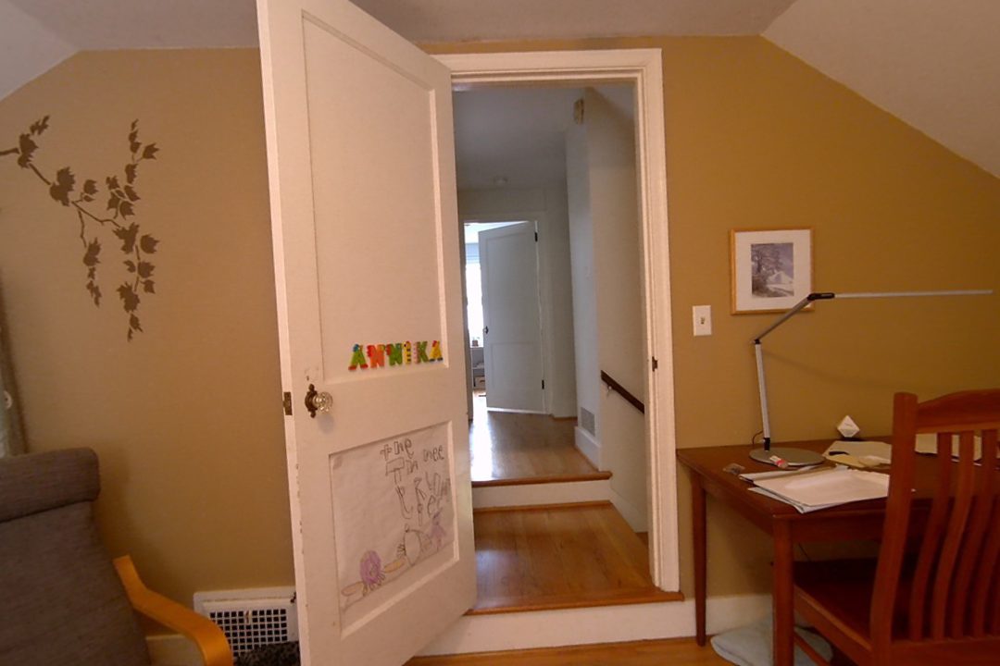

True

In [105]:
ref_undistort_im = np.array(Image.open('./reference/distortion-img-lin-reference.png')) 
display(Image.fromarray(undistort_im))
np.array_equal(ref_undistort_im, undistort_im)

In [64]:
diff = ref_undistort_im-undistort_im
Image.fromarray(diff)
np.array_equal(ref_undistort_im, undistort_im)

True

Image is same as reference:  True


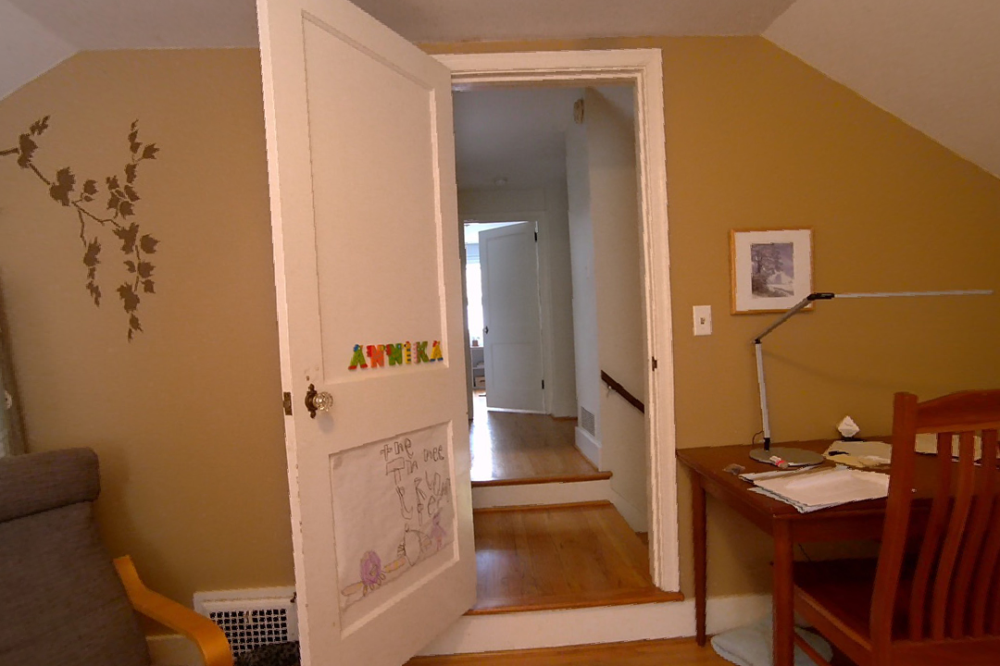

CPU times: user 8.81 s, sys: 167 ms, total: 8.98 s
Wall time: 8.57 s


In [27]:
%%time
undistort_im = undistort_image(distorted_im, k1, k2, M)
ref_undistort_im = np.array(Image.open('./reference/distortion-img-reference.png'))

print("Image is same as reference: ", np.array_equal(ref_undistort_im, undistort_im))
display(Image.fromarray(undistort_im))


## Bilinear interpolation

So far we have just rounded off coordinates when looking up points in the input image.  But this produces some artifacts, in the form of jagged edges where things used to look smooth.  The edges of the door and doorframe in the distortion example show this pretty strongly.  To see a dramatic illustration try rotating your image by 18 degrees 20 times; it ought to be back to the same image, but you will see it has been damaged quite a bit.  This damage is unavoidable, but it can be made less objectionable by more careful interpolation.

Check out the image interpolation lecture to learn about better methods for interpolation in images.

**Note that the function signatures for the rotation and undistortion functions have an argument that lets you request bilinear interpolation. 
Go back and add that branch now; compute the sample points in the input image in exactly the same way, but then rather than rounding to the nearest integer coordinate, look up the four neighboring pixels and average them with bilinear interpolation weights. This corresponds to the interp_mode paramater being 1.**

Here are some cells to compare the timings and results of the image distortion operation with the two interpolation modes.

In [ ]:
# %%time
# undistort_im_nn = undistort_image(distorted_im, k1, k2, M, 0)

0 0 665.5441382808506
0 0 -> [545.26824063 381.99592334   1.        ]
0 1 664.9706760451922
0 1 -> [5.45268241e+02 7.12481822e+12 1.00000000e+00]
0 2 664.3982239590952
0 2 -> [5.45268241e+02 1.42006313e+13 1.00000000e+00]
0 3 663.8267846358717
0 3 -> [5.45268241e+02 2.12277585e+13 1.00000000e+00]
0 4 663.2563606932089
0 4 -> [5.45268241e+02 2.82065179e+13 1.00000000e+00]
0 5 662.6869547531473
0 5 -> [5.45268241e+02 3.51372261e+13 1.00000000e+00]
0 6 662.11856944206
0 6 -> [5.45268241e+02 4.20201984e+13 1.00000000e+00]
0 7 661.5512073906298
0 7 -> [5.45268241e+02 4.88557489e+13 1.00000000e+00]
0 8 660.9848712338279
0 8 -> [5.45268241e+02 5.56441902e+13 1.00000000e+00]
0 9 660.4195636108913
0 9 -> [5.45268241e+02 6.23858338e+13 1.00000000e+00]
0 10 659.8552871652996
0 10 -> [5.45268241e+02 6.90809897e+13 1.00000000e+00]
0 11 659.2920445447526
0 11 -> [5.45268241e+02 7.57299668e+13 1.00000000e+00]
0 12 658.729838401146
0 12 -> [5.45268241e+02 8.23330727e+13 1.00000000e+00]
0 13 658.168671

0 137 -> [5.45268241e+02 6.36416559e+14 1.00000000e+00]
0 138 597.1272896125247
0 138 -> [5.45268241e+02 6.39307187e+14 1.00000000e+00]
0 139 596.7193645257375
0 139 -> [5.45268241e+02 6.42182020e+14 1.00000000e+00]
0 140 596.3128373597201
0 140 -> [5.45268241e+02 6.45041237e+14 1.00000000e+00]
0 141 595.9077109754496
0 141 -> [5.45268241e+02 6.47885014e+14 1.00000000e+00]
0 142 595.503988231817
0 142 -> [5.45268241e+02 6.50713529e+14 1.00000000e+00]
0 143 595.1016719855523
0 143 -> [5.45268241e+02 6.53526958e+14 1.00000000e+00]
0 144 594.7007650911507
0 144 -> [5.45268241e+02 6.56325475e+14 1.00000000e+00]
0 145 594.3012704007959
0 145 -> [5.45268241e+02 6.59109256e+14 1.00000000e+00]
0 146 593.9031907642861
0 146 -> [5.45268241e+02 6.61878474e+14 1.00000000e+00]
0 147 593.5065290289568
0 147 -> [5.45268241e+02 6.64633302e+14 1.00000000e+00]
0 148 593.1112880396056
0 148 -> [5.45268241e+02 6.67373913e+14 1.00000000e+00]
0 149 592.7174706384147
0 149 -> [5.45268241e+02 6.70100479e+14 1

0 281 554.2797127804697
0 281 -> [5.45268241e+02 9.66460825e+14 1.00000000e+00]
0 282 554.0983667184014
0 282 -> [5.45268241e+02 9.68631496e+14 1.00000000e+00]
0 283 553.9187666075234
0 283 -> [5.45268241e+02 9.70806658e+14 1.00000000e+00]
0 284 553.7409141466793
0 284 -> [5.45268241e+02 9.72986431e+14 1.00000000e+00]
0 285 553.5648110203538
0 285 -> [5.45268241e+02 9.75170931e+14 1.00000000e+00]
0 286 553.3904588985972
0 286 -> [5.45268241e+02 9.77360278e+14 1.00000000e+00]
0 287 553.2178594369491
0 287 -> [5.45268241e+02 9.79554589e+14 1.00000000e+00]
0 288 553.0470142763633
0 288 -> [5.45268241e+02 9.81753982e+14 1.00000000e+00]
0 289 552.8779250431328
0 289 -> [5.45268241e+02 9.83958575e+14 1.00000000e+00]
0 290 552.7105933488158
0 290 -> [5.45268241e+02 9.86168485e+14 1.00000000e+00]
0 291 552.5450207901615
0 291 -> [5.45268241e+02 9.88383831e+14 1.00000000e+00]
0 292 552.3812089490373
0 292 -> [5.45268241e+02 9.90604730e+14 1.00000000e+00]
0 293 552.2191593923558
0 293 -> [5.4526

0 423 546.5400259816292
0 423 -> [5.45268241e+02 1.37527672e+15 1.00000000e+00]
0 424 546.6159529322209
0 424 -> [5.45268241e+02 1.37929417e+15 1.00000000e+00]
0 425 546.6936985186495
0 425 -> [5.45268241e+02 1.38333396e+15 1.00000000e+00]
0 426 546.7732619651404
0 426 -> [5.45268241e+02 1.38739624e+15 1.00000000e+00]
0 427 546.8546424782367
0 427 -> [5.45268241e+02 1.39148115e+15 1.00000000e+00]
0 428 546.9378392468379
0 428 -> [5.45268241e+02 1.39558886e+15 1.00000000e+00]
0 429 547.022851442241
0 429 -> [5.45268241e+02 1.39971950e+15 1.00000000e+00]
0 430 547.1096782181796
0 430 -> [5.45268241e+02 1.40387322e+15 1.00000000e+00]
0 431 547.1983187108674
0 431 -> [5.45268241e+02 1.40805019e+15 1.00000000e+00]
0 432 547.2887720390397
0 432 -> [5.45268241e+02 1.41225054e+15 1.00000000e+00]
0 433 547.3810373039972
0 433 -> [5.45268241e+02 1.41647444e+15 1.00000000e+00]
0 434 547.4751135896498
0 434 -> [5.45268241e+02 1.42072202e+15 1.00000000e+00]
0 435 547.5709999625619
0 435 -> [5.45268

0 557 572.4071977185472
0 557 -> [5.45268241e+02 2.17890307e+15 1.00000000e+00]
0 558 572.7137155682584
0 558 -> [5.45268241e+02 2.18749421e+15 1.00000000e+00]
0 559 573.021814593476
0 559 -> [5.45268241e+02 2.19613389e+15 1.00000000e+00]
0 560 573.331492245106
0 560 -> [5.45268241e+02 2.20482237e+15 1.00000000e+00]
0 561 573.6427459665118
0 561 -> [5.45268241e+02 2.21355991e+15 1.00000000e+00]
0 562 573.9555731936053
0 562 -> [5.45268241e+02 2.22234677e+15 1.00000000e+00]
0 563 574.2699713549368
0 563 -> [5.45268241e+02 2.23118321e+15 1.00000000e+00]
0 564 574.5859378717861
0 564 -> [5.45268241e+02 2.24006948e+15 1.00000000e+00]
0 565 574.9034701582518
0 565 -> [5.45268241e+02 2.24900586e+15 1.00000000e+00]
0 566 575.2225656213428
0 566 -> [5.45268241e+02 2.25799261e+15 1.00000000e+00]
0 567 575.5432216610669
0 567 -> [5.45268241e+02 2.26702999e+15 1.00000000e+00]
0 568 575.865435670522
0 568 -> [5.45268241e+02 2.27611826e+15 1.00000000e+00]
0 569 576.1892050359847
0 569 -> [5.4526824

0 697 629.4839156007085
0 697 -> [5.45268241e+02 3.98781188e+15 1.00000000e+00]
0 698 629.9849204544503
0 698 -> [5.45268241e+02 4.00626230e+15 1.00000000e+00]
0 699 630.4871132703665
0 699 -> [5.45268241e+02 4.02480998e+15 1.00000000e+00]
0 700 630.9904912120309
0 700 -> [5.45268241e+02 4.04345538e+15 1.00000000e+00]
0 701 631.4950514453775
0 701 -> [5.45268241e+02 4.06219893e+15 1.00000000e+00]
0 702 632.0007911387453
0 702 -> [5.45268241e+02 4.08104112e+15 1.00000000e+00]
0 703 632.507707462921
0 703 -> [5.45268241e+02 4.09998239e+15 1.00000000e+00]
0 704 633.0157975911818
0 704 -> [5.45268241e+02 4.11902320e+15 1.00000000e+00]
0 705 633.5250586993383
0 705 -> [5.45268241e+02 4.13816402e+15 1.00000000e+00]
0 706 634.0354879657763
0 706 -> [5.45268241e+02 4.15740532e+15 1.00000000e+00]
0 707 634.5470825714984
0 707 -> [5.45268241e+02 4.17674756e+15 1.00000000e+00]
0 708 635.0598397001655
0 708 -> [5.45268241e+02 4.19619121e+15 1.00000000e+00]
0 709 635.5737565381378
0 709 -> [5.45268

0 836 -> [5.45268241e+02 7.71169785e+15 1.00000000e+00]
0 837 709.964787859229
0 837 -> [5.45268241e+02 7.74884571e+15 1.00000000e+00]
0 838 710.6060793435418
0 838 -> [5.45268241e+02 7.78617242e+15 1.00000000e+00]
0 839 711.2481985917434
0 839 -> [5.45268241e+02 7.82367874e+15 1.00000000e+00]
0 840 711.8911433639275
0 840 -> [5.45268241e+02 7.86136539e+15 1.00000000e+00]
0 841 712.5349114253981
0 841 -> [5.45268241e+02 7.89923312e+15 1.00000000e+00]
0 842 713.1795005466716
0 842 -> [5.45268241e+02 7.93728267e+15 1.00000000e+00]
0 843 713.8249085034789
0 843 -> [5.45268241e+02 7.97551478e+15 1.00000000e+00]
0 844 714.4711330767675
0 844 -> [5.45268241e+02 8.01393020e+15 1.00000000e+00]
0 845 715.1181720527035
0 845 -> [5.45268241e+02 8.05252969e+15 1.00000000e+00]
0 846 715.766023222673
0 846 -> [5.45268241e+02 8.09131399e+15 1.00000000e+00]
0 847 716.4146843832837
0 847 -> [5.45268241e+02 8.13028385e+15 1.00000000e+00]
0 848 717.0641533363664
0 848 -> [5.45268241e+02 8.16944005e+15 1.

0 966 798.7997245868329
0 966 -> [5.45268241e+02 1.43315720e+16 1.00000000e+00]
0 967 799.5311125903731
0 967 -> [5.45268241e+02 1.43990231e+16 1.00000000e+00]
0 968 800.263081742498
0 968 -> [5.45268241e+02 1.44667699e+16 1.00000000e+00]
0 969 800.9956304500043
0 969 -> [5.45268241e+02 1.45348133e+16 1.00000000e+00]
0 970 801.7287571242533
0 970 -> [5.45268241e+02 1.46031544e+16 1.00000000e+00]
0 971 802.4624601811602
0 971 -> [5.45268241e+02 1.46717944e+16 1.00000000e+00]
0 972 803.196738041185
0 972 -> [5.45268241e+02 1.47407343e+16 1.00000000e+00]
0 973 803.9315891293238
0 973 -> [5.45268241e+02 1.48099751e+16 1.00000000e+00]
0 974 804.6670118750985
0 974 -> [5.45268241e+02 1.48795180e+16 1.00000000e+00]
0 975 805.4030047125476
0 975 -> [5.45268241e+02 1.49493641e+16 1.00000000e+00]
0 976 806.1395660802167
0 976 -> [5.45268241e+02 1.50195145e+16 1.00000000e+00]
0 977 806.8766944211488
0 977 -> [5.45268241e+02 1.50899702e+16 1.00000000e+00]
0 978 807.6143881828754
0 978 -> [5.452682

1 17 655.1038085677719
1 17 -> [6.71126185e+12 1.14091451e+14 1.00000000e+00]
1 18 654.5471717149193
1 18 -> [6.68848076e+12 1.20392654e+14 1.00000000e+00]
1 19 653.9915901599959
1 19 -> [6.66580073e+12 1.26650214e+14 1.00000000e+00]
1 20 653.4370665947869
1 20 -> [6.64322146e+12 1.32864429e+14 1.00000000e+00]
1 21 652.8836037150879
1 21 -> [6.62074263e+12 1.39035595e+14 1.00000000e+00]
1 22 652.331204220678
1 22 -> [6.59836392e+12 1.45164006e+14 1.00000000e+00]
1 23 651.779870815293
1 23 -> [6.57608501e+12 1.51249955e+14 1.00000000e+00]
1 24 651.2296062065975
1 24 -> [6.55390559e+12 1.57293734e+14 1.00000000e+00]
1 25 650.6804131061576
1 25 -> [6.53182535e+12 1.63295634e+14 1.00000000e+00]
1 26 650.132294229413
1 26 -> [6.50984397e+12 1.69255943e+14 1.00000000e+00]
1 27 649.5852522956475
1 27 -> [6.48796114e+12 1.75174951e+14 1.00000000e+00]
1 28 649.0392900279612
1 28 -> [6.46617655e+12 1.81052944e+14 1.00000000e+00]
1 29 648.494410153241
1 29 -> [6.44448990e+12 1.86890207e+14 1.0000

1 146 -> [4.50546409e+12 6.57797757e+14 1.00000000e+00]
1 147 592.5883900313944
1 147 -> [4.49340225e+12 6.60530130e+14 1.00000000e+00]
1 148 592.192536258268
1 148 -> [4.48140769e+12 6.63248337e+14 1.00000000e+00]
1 149 591.7981074657133
1 149 -> [4.4694802e+12 6.6595255e+14 1.0000000e+00]
1 150 591.4051065048391
1 150 -> [4.45761959e+12 6.68642939e+14 1.00000000e+00]
1 151 591.0135362240022
1 151 -> [4.44582565e+12 6.71319673e+14 1.00000000e+00]
1 152 590.6233994687308
1 152 -> [4.43409818e+12 6.73982923e+14 1.00000000e+00]
1 153 590.234699081645
1 153 -> [4.42243697e+12 6.76632857e+14 1.00000000e+00]
1 154 589.8474379023783
1 154 -> [4.41084183e+12 6.79269642e+14 1.00000000e+00]
1 155 589.4616187674987
1 155 -> [4.39931256e+12 6.81893446e+14 1.00000000e+00]
1 156 589.0772445104292
1 156 -> [4.38784895e+12 6.84504436e+14 1.00000000e+00]
1 157 588.6943179613678
1 157 -> [4.37645081e+12 6.87102777e+14 1.00000000e+00]
1 158 588.3128419472075
1 158 -> [4.36511794e+12 6.89688634e+14 1.000

1 287 552.2327407896058
1 287 -> [3.38883609e+12 9.72595959e+14 1.00000000e+00]
1 288 552.0615907668274
1 288 -> [3.38463690e+12 9.74775426e+14 1.00000000e+00]
1 289 551.8921996187299
1 289 -> [3.38048469e+12 9.76960076e+14 1.00000000e+00]
1 290 551.7245689653489
1 290 -> [3.37637941e+12 9.79150029e+14 1.00000000e+00]
1 291 551.558700411842
1 291 -> [3.37232096e+12 9.81345399e+14 1.00000000e+00]
1 292 551.3945955484148
1 292 -> [3.36830927e+12 9.83546306e+14 1.00000000e+00]
1 293 551.2322559502483
1 293 -> [3.36434425e+12 9.85752865e+14 1.00000000e+00]
1 294 551.0716831774248
1 294 -> [3.36042583e+12 9.87965194e+14 1.00000000e+00]
1 295 550.9128787748567
1 295 -> [3.35655393e+12 9.90183409e+14 1.00000000e+00]
1 296 550.7558442722147
1 296 -> [3.35272848e+12 9.92407629e+14 1.00000000e+00]
1 297 550.600581183856
1 297 -> [3.34894939e+12 9.94637968e+14 1.00000000e+00]
1 298 550.4470910087545
1 298 -> [3.34521660e+12 9.96874546e+14 1.00000000e+00]
1 299 550.2953752304302
1 299 -> [3.341530

1 414 -> [3.21334759e+12 1.33032590e+15 1.00000000e+00]
1 415 545.0
1 415 -> [3.21475446e+12 1.33412310e+15 1.00000000e+00]
1 416 545.0614644239675
1 416 -> [3.21620494e+12 1.33794125e+15 1.00000000e+00]
1 417 545.124756363165
1 417 -> [3.21769906e+12 1.34178051e+15 1.00000000e+00]
1 418 545.1898751811152
1 418 -> [3.21923685e+12 1.34564100e+15 1.00000000e+00]
1 419 545.2568202232779
1 419 -> [3.22081834e+12 1.34952288e+15 1.00000000e+00]
1 420 545.3255908170825
1 420 -> [3.22244356e+12 1.35342630e+15 1.00000000e+00]
1 421 545.3961862719614
1 421 -> [3.22411255e+12 1.35735138e+15 1.00000000e+00]
1 422 545.4686058793851
1 422 -> [3.22582534e+12 1.36129829e+15 1.00000000e+00]
1 423 545.542848912897
1 423 -> [3.22758196e+12 1.36526717e+15 1.00000000e+00]
1 424 545.6189146281496
1 424 -> [3.22938246e+12 1.36925816e+15 1.00000000e+00]
1 425 545.6968022629416
1 425 -> [3.23122685e+12 1.37327141e+15 1.00000000e+00]
1 426 545.776511037256
1 426 -> [3.23311519e+12 1.37730707e+15 1.00000000e+00]

1 541 -> [3.75975291e+12 2.03402632e+15 1.00000000e+00]
1 542 567.0414446934192
1 542 -> [3.76722427e+12 2.04183555e+15 1.00000000e+00]
1 543 567.3244221783511
1 543 -> [3.77474996e+12 2.04968923e+15 1.00000000e+00]
1 544 567.609020365251
1 544 -> [3.78233012e+12 2.05758759e+15 1.00000000e+00]
1 545 567.8952368174961
1 545 -> [3.78996489e+12 2.06553087e+15 1.00000000e+00]
1 546 568.1830690895321
1 546 -> [3.79765442e+12 2.07351931e+15 1.00000000e+00]
1 547 568.4725147269655
1 547 -> [3.80539884e+12 2.08155316e+15 1.00000000e+00]
1 548 568.7635712666556
1 548 -> [3.81319829e+12 2.08963266e+15 1.00000000e+00]
1 549 569.0562362368064
1 549 -> [3.82105294e+12 2.09775806e+15 1.00000000e+00]
1 550 569.3505071570587
1 550 -> [3.82896291e+12 2.10592960e+15 1.00000000e+00]
1 551 569.6463815385822
1 551 -> [3.83692835e+12 2.11414752e+15 1.00000000e+00]
1 552 569.9438568841672
1 552 -> [3.84494942e+12 2.12241208e+15 1.00000000e+00]
1 553 570.2429306883164
1 553 -> [3.85302626e+12 2.13072352e+15 1

1 658 610.0098359862733
1 658 -> [5.04557176e+12 3.31998622e+15 1.00000000e+00]
1 659 610.4629390880334
1 659 -> [5.06057955e+12 3.33492192e+15 1.00000000e+00]
1 660 610.9173430178587
1 660 -> [5.07566403e+12 3.34993826e+15 1.00000000e+00]
1 661 611.3730448752218
1 661 -> [5.09082544e+12 3.36503562e+15 1.00000000e+00]
1 662 611.8300417599646
1 662 -> [5.10606402e+12 3.38021438e+15 1.00000000e+00]
1 663 612.2883307723577
1 663 -> [5.12138002e+12 3.39547495e+15 1.00000000e+00]
1 664 612.7479090131602
1 664 -> [5.13677367e+12 3.41081772e+15 1.00000000e+00]
1 665 613.2087735836792
1 665 -> [5.15224524e+12 3.42624308e+15 1.00000000e+00]
1 666 613.6709215858284
1 666 -> [5.16779496e+12 3.44175144e+15 1.00000000e+00]
1 667 614.1343501221862
1 667 -> [5.18342308e+12 3.45734320e+15 1.00000000e+00]
1 668 614.5990562960538
1 668 -> [5.19912986e+12 3.47301875e+15 1.00000000e+00]
1 669 615.0650372115131
1 669 -> [5.21491554e+12 3.48877849e+15 1.00000000e+00]
1 670 615.532289973483
1 670 -> [5.23078

1 770 668.1915892915744
1 770 -> [7.26386678e+12 5.59317742e+15 1.00000000e+00]
1 771 668.7727566221579
1 771 -> [7.28917121e+12 5.61995100e+15 1.00000000e+00]
1 772 669.3549133307382
1 772 -> [7.31458495e+12 5.64685958e+15 1.00000000e+00]
1 773 669.9380568380931
1 773 -> [7.34010833e+12 5.67390374e+15 1.00000000e+00]
1 774 670.5221845696084
1 774 -> [7.36574169e+12 5.70108407e+15 1.00000000e+00]
1 775 671.107293955296
1 775 -> [7.39148539e+12 5.72840117e+15 1.00000000e+00]
1 776 671.6933824298108
1 776 -> [7.41733975e+12 5.75585565e+15 1.00000000e+00]
1 777 672.2804474324685
1 777 -> [7.44330513e+12 5.78344808e+15 1.00000000e+00]
1 778 672.8684864072623
1 778 -> [7.46938186e+12 5.81117909e+15 1.00000000e+00]
1 779 673.4574968028792
1 779 -> [7.49557030e+12 5.83904927e+15 1.00000000e+00]
1 780 674.047476072717
1 780 -> [7.52187080e+12 5.86705922e+15 1.00000000e+00]
1 781 674.6384216748999
1 781 -> [7.54828369e+12 5.89520956e+15 1.00000000e+00]
1 782 675.2303310722941
1 782 -> [7.574809

1 892 745.6782147816845
1 892 -> [1.12660189e+13 1.00492889e+16 1.00000000e+00]
1 893 746.362512456246
1 893 -> [1.13074307e+13 1.00975356e+16 1.00000000e+00]
1 894 747.0475219154401
1 894 -> [1.13489997e+13 1.01460057e+16 1.00000000e+00]
1 895 747.7332412030376
1 895 -> [1.13907265e+13 1.01947002e+16 1.00000000e+00]
1 896 748.4196683679552
1 896 -> [1.14326116e+13 1.02436200e+16 1.00000000e+00]
1 897 749.1068014642505
1 897 -> [1.14746552e+13 1.02927658e+16 1.00000000e+00]
1 898 749.7946385511169
1 898 -> [1.15168580e+13 1.03421385e+16 1.00000000e+00]
1 899 750.483177692878
1 899 -> [1.15592204e+13 1.03917391e+16 1.00000000e+00]
1 900 751.1724169589828
1 900 -> [1.16017428e+13 1.04415685e+16 1.00000000e+00]
1 901 751.8623544239996
1 901 -> [1.16444256e+13 1.04916275e+16 1.00000000e+00]
1 902 752.5529881676107
1 902 -> [1.16872693e+13 1.05419169e+16 1.00000000e+00]
1 903 753.2443162746068
1 903 -> [1.17302745e+13 1.05924378e+16 1.00000000e+00]
1 904 753.9363368348816
1 904 -> [1.177344

1 1015 -> [1.76833046e+13 1.79485542e+16 1.00000000e+00]
1 1016 835.3993057215214
1 1016 -> [1.7747687e+13 1.8031650e+16 1.0000000e+00]
1 1017 836.1584778019056
1 1017 -> [1.78122883e+13 1.81150972e+16 1.00000000e+00]
1 1018 836.9181560941308
1 1018 -> [1.7877109e+13 1.8198897e+16 1.0000000e+00]
1 1019 837.6783392209685
1 1019 -> [1.79421498e+13 1.82830506e+16 1.00000000e+00]
1 1020 838.4390258092714
1 1020 -> [1.80074111e+13 1.83675593e+16 1.00000000e+00]
1 1021 839.2002144899631
1 1021 -> [1.80728935e+13 1.84524243e+16 1.00000000e+00]
1 1022 839.961903898028
1 1022 -> [1.81385976e+13 1.85376468e+16 1.00000000e+00]
1 1023 840.724092672501
1 1023 -> [1.8204524e+13 1.8623228e+16 1.0000000e+00]
1 1024 841.486779456457
1 1024 -> [1.82706731e+13 1.87091693e+16 1.00000000e+00]
1 1025 842.2499628970013
1 1025 -> [1.83370456e+13 1.87954718e+16 1.00000000e+00]
1 1026 843.0136416452583
1 1026 -> [1.84036421e+13 1.88821367e+16 1.00000000e+00]
1 1027 843.7778143563625
1 1027 -> [1.84704630e+13 1.

2 69 -> [1.12454296e+13 3.87967320e+14 1.00000000e+00]
2 70 626.2531437046844
2 70 -> [1.12096734e+13 3.92338568e+14 1.00000000e+00]
2 71 625.7555433234292
2 71 -> [1.11740882e+13 3.96680133e+14 1.00000000e+00]
2 72 625.2591462745667
2 72 -> [1.11386737e+13 4.00992252e+14 1.00000000e+00]
2 73 624.7639554263674
2 73 -> [1.11034291e+13 4.05275162e+14 1.00000000e+00]
2 74 624.2699736492217
2 74 -> [1.10683540e+13 4.09529096e+14 1.00000000e+00]
2 75 623.7772038155931
2 75 -> [1.10334477e+13 4.13754290e+14 1.00000000e+00]
2 76 623.2856487999703
2 76 -> [1.09987099e+13 4.17950976e+14 1.00000000e+00]
2 77 622.7953114788197
2 77 -> [1.09641399e+13 4.22119386e+14 1.00000000e+00]
2 78 622.3061947305362
2 78 -> [1.09297372e+13 4.26259751e+14 1.00000000e+00]
2 79 621.8183014353951
2 79 -> [1.08955013e+13 4.30372301e+14 1.00000000e+00]
2 80 621.3316344755029
2 80 -> [1.08614316e+13 4.34457264e+14 1.00000000e+00]
2 81 620.8461967347469
2 81 -> [1.08275276e+13 4.38514869e+14 1.00000000e+00]
2 82 620.

2 193 -> [7.96378069e+12 7.68504837e+14 1.00000000e+00]
2 194 574.6242250375458
2 194 -> [7.94562628e+12 7.70725749e+14 1.00000000e+00]
2 195 574.2978321393874
2 195 -> [7.92758873e+12 7.72939901e+14 1.00000000e+00]
2 196 573.9729958804683
2 196 -> [7.90966771e+12 7.75147435e+14 1.00000000e+00]
2 197 573.649718905187
2 197 -> [7.89186290e+12 7.77348495e+14 1.00000000e+00]
2 198 573.3280038511986
2 198 -> [7.87417397e+12 7.79543223e+14 1.00000000e+00]
2 199 573.0078533493237
2 199 -> [7.8566006e+12 7.8173176e+14 1.0000000e+00]
2 200 572.689270023457
2 200 -> [7.83914247e+12 7.83914247e+14 1.00000000e+00]
2 201 572.3722564904766
2 201 -> [7.82179926e+12 7.86090826e+14 1.00000000e+00]
2 202 572.0568153601529
2 202 -> [7.80457065e+12 7.88261636e+14 1.00000000e+00]
2 203 571.7429492350561
2 203 -> [7.78745634e+12 7.90426818e+14 1.00000000e+00]
2 204 571.4306607104662
2 204 -> [7.77045599e+12 7.92586511e+14 1.00000000e+00]
2 205 571.1199523742802
2 205 -> [7.75356930e+12 7.94740854e+14 1.000

2 310 547.7526814174441
2 310 -> [6.56039372e+12 1.01686103e+15 1.00000000e+00]
2 311 547.622132496487
2 311 -> [6.55414162e+12 1.01916902e+15 1.00000000e+00]
2 312 547.4933789553988
2 312 -> [6.54797987e+12 1.02148486e+15 1.00000000e+00]
2 313 547.3664220611272
2 313 -> [6.54190836e+12 1.02380866e+15 1.00000000e+00]
2 314 547.2412630641078
2 314 -> [6.53592696e+12 1.02614053e+15 1.00000000e+00]
2 315 547.1179031982047
2 315 -> [6.53003557e+12 1.02848060e+15 1.00000000e+00]
2 316 546.9963436806502
2 316 -> [6.52423404e+12 1.03082898e+15 1.00000000e+00]
2 317 546.8765857119868
2 317 -> [6.51852228e+12 1.03318578e+15 1.00000000e+00]
2 318 546.7586304760081
2 318 -> [6.51290017e+12 1.03555113e+15 1.00000000e+00]
2 319 546.6424791397025
2 319 -> [6.50736759e+12 1.03792513e+15 1.00000000e+00]
2 320 546.5281328531954
2 320 -> [6.50192444e+12 1.04030791e+15 1.00000000e+00]
2 321 546.4155927496945
2 321 -> [6.49657059e+12 1.04269958e+15 1.00000000e+00]
2 322 546.3048599454338
2 322 -> [6.49130

2 476 -> [6.72107298e+12 1.59961537e+15 1.00000000e+00]
2 477 551.2476757320615
2 477 -> [6.72944143e+12 1.60497178e+15 1.00000000e+00]
2 478 551.4208918784271
2 478 -> [6.73790373e+12 1.61035899e+15 1.00000000e+00]
2 479 551.5958665544912
2 479 -> [6.74646004e+12 1.61577718e+15 1.00000000e+00]
2 480 551.7725980872917
2 480 -> [6.75511053e+12 1.62122653e+15 1.00000000e+00]
2 481 551.9510847892229
2 481 -> [6.76385537e+12 1.62670722e+15 1.00000000e+00]
2 482 552.1313249581118
2 482 -> [6.77269473e+12 1.63221943e+15 1.00000000e+00]
2 483 552.3133168772956
2 483 -> [6.78162879e+12 1.63776335e+15 1.00000000e+00]
2 484 552.4970588157008
2 484 -> [6.79065773e+12 1.64333917e+15 1.00000000e+00]
2 485 552.6825490279207
2 485 -> [6.79978171e+12 1.64894706e+15 1.00000000e+00]
2 486 552.869785754295
2 486 -> [6.80900092e+12 1.65458722e+15 1.00000000e+00]
2 487 553.0587672209889
2 487 -> [6.81831555e+12 1.66025984e+15 1.00000000e+00]
2 488 553.2494916400738
2 488 -> [6.82772577e+12 1.66596509e+15 1

2 585 579.7050974417941
2 585 -> [8.23040077e+12 2.40739222e+15 1.00000000e+00]
2 586 580.0560317762414
2 586 -> [8.25034865e+12 2.41735215e+15 1.00000000e+00]
2 587 580.4084768505711
2 587 -> [8.27041888e+12 2.42736794e+15 1.00000000e+00]
2 588 580.7624299143325
2 588 -> [8.29061181e+12 2.43743987e+15 1.00000000e+00]
2 589 581.117888212022
2 589 -> [8.31092781e+12 2.44756824e+15 1.00000000e+00]
2 590 581.4748489831696
2 590 -> [8.33136723e+12 2.45775333e+15 1.00000000e+00]
2 591 581.8333094624267
2 591 -> [8.35193044e+12 2.46799544e+15 1.00000000e+00]
2 592 582.1932668796505
2 592 -> [8.37261780e+12 2.47829487e+15 1.00000000e+00]
2 593 582.5547184599915
2 593 -> [8.39342968e+12 2.48865190e+15 1.00000000e+00]
2 594 582.9176614239784
2 594 -> [8.41436644e+12 2.49906683e+15 1.00000000e+00]
2 595 583.2820929876041
2 595 -> [8.43542847e+12 2.50953997e+15 1.00000000e+00]
2 596 583.6480103624101
2 596 -> [8.45661612e+12 2.52007160e+15 1.00000000e+00]
2 597 584.0154107555725
2 597 -> [8.47792

2 753 657.6397189951349
2 753 -> [1.36315693e+13 5.13228584e+15 1.00000000e+00]
2 754 658.2043755551919
2 754 -> [1.36784467e+13 5.15677440e+15 1.00000000e+00]
2 755 658.7700661080465
2 755 -> [1.37255311e+13 5.18138798e+15 1.00000000e+00]
2 756 659.3367879922976
2 756 -> [1.37728231e+13 5.20612713e+15 1.00000000e+00]
2 757 659.9045385508422
2 757 -> [1.38203234e+13 5.23099240e+15 1.00000000e+00]
2 758 660.4733151308991
2 758 -> [1.38680326e+13 5.25598435e+15 1.00000000e+00]
2 759 661.0431150840315
2 759 -> [1.39159514e+13 5.28110356e+15 1.00000000e+00]
2 760 661.6139357661687
2 760 -> [1.39640805e+13 5.30635058e+15 1.00000000e+00]
2 761 662.1857745376293
2 761 -> [1.40124204e+13 5.33172598e+15 1.00000000e+00]
2 762 662.7586287631418
2 762 -> [1.40609720e+13 5.35723032e+15 1.00000000e+00]
2 763 663.3324958118666
2 763 -> [1.41097358e+13 5.38286419e+15 1.00000000e+00]
2 764 663.9073730574167
2 764 -> [1.41587124e+13 5.40862815e+15 1.00000000e+00]
2 765 664.4832578778792
2 765 -> [1.4207

2 877 734.761185692331
2 877 -> [2.12412161e+13 9.31427327e+15 1.00000000e+00]
2 878 735.4352452799634
2 878 -> [2.13192693e+13 9.35915924e+15 1.00000000e+00]
2 879 736.1100461208229
2 879 -> [2.13976236e+13 9.40425559e+15 1.00000000e+00]
2 880 736.7855861782314
2 880 -> [2.14762799e+13 9.44956316e+15 1.00000000e+00]
2 881 737.4618634207467
2 881 -> [2.15552390e+13 9.49508279e+15 1.00000000e+00]
2 882 738.1388758221585
2 882 -> [2.16345019e+13 9.54081532e+15 1.00000000e+00]
2 883 738.8166213614851
2 883 -> [2.17140693e+13 9.58676158e+15 1.00000000e+00]
2 884 739.4950980229686
2 884 -> [2.17939422e+13 9.63292243e+15 1.00000000e+00]
2 885 740.1743037960721
2 885 -> [2.18741214e+13 9.67929870e+15 1.00000000e+00]
2 886 740.8542366754745
2 886 -> [2.19546078e+13 9.72589126e+15 1.00000000e+00]
2 887 741.5348946610671
2 887 -> [2.20354023e+13 9.77270093e+15 1.00000000e+00]
2 888 742.2162757579491
2 888 -> [2.21165058e+13 9.81972860e+15 1.00000000e+00]
2 889 742.8983779764228
2 889 -> [2.21979

2 1013 832.4722217587804
2 1013 -> [3.50005043e+13 1.77277554e+16 1.00000000e+00]
2 1014 833.2304603169522
2 1014 -> [3.51281966e+13 1.78099957e+16 1.00000000e+00]
2 1015 833.9892085632763
2 1015 -> [3.52563243e+13 1.78925846e+16 1.00000000e+00]
2 1016 834.748465107903
2 1016 -> [3.53848883e+13 1.79755233e+16 1.00000000e+00]
2 1017 835.5082285651051
2 1017 -> [3.55138898e+13 1.80588130e+16 1.00000000e+00]
2 1018 836.2684975532678
2 1018 -> [3.56433299e+13 1.81424549e+16 1.00000000e+00]
2 1019 837.0292706948784
2 1019 -> [3.57732097e+13 1.82264504e+16 1.00000000e+00]
2 1020 837.7905466165156
2 1020 -> [3.59035303e+13 1.83108005e+16 1.00000000e+00]
2 1021 838.5523239488398
2 1021 -> [3.60342929e+13 1.83955065e+16 1.00000000e+00]
2 1022 839.3146013265824
2 1022 -> [3.61654984e+13 1.84805697e+16 1.00000000e+00]
2 1023 840.0773773885355
2 1023 -> [3.62971482e+13 1.85659913e+16 1.00000000e+00]
2 1024 840.8406507775418
2 1024 -> [3.64292432e+13 1.86517725e+16 1.00000000e+00]
2 1025 841.604420

3 51 -> [1.77825875e+13 3.02303988e+14 1.00000000e+00]
3 52 634.5581139659314
3 52 -> [1.77243480e+13 3.07222032e+14 1.00000000e+00]
3 53 634.0386423554955
3 53 -> [1.76663798e+13 3.12106044e+14 1.00000000e+00]
3 54 633.5203232730581
3 54 -> [1.76086821e+13 3.16956278e+14 1.00000000e+00]
3 55 633.0031595497767
3 55 -> [1.7551254e+13 3.2177299e+14 1.0000000e+00]
3 56 632.4871540197477
3 56 -> [1.74940946e+13 3.26556432e+14 1.00000000e+00]
3 57 631.9723095199662
3 57 -> [1.74372030e+13 3.31306857e+14 1.00000000e+00]
3 58 631.458628890286
3 58 -> [1.73805785e+13 3.36024517e+14 1.00000000e+00]
3 59 630.9461149733787
3 59 -> [1.73242201e+13 3.40709662e+14 1.00000000e+00]
3 60 630.4347706146925
3 60 -> [1.7268127e+13 3.4536254e+14 1.0000000e+00]
3 61 629.9245986624113
3 61 -> [1.72122984e+13 3.49983401e+14 1.00000000e+00]
3 62 629.4156019674123
3 62 -> [1.71567334e+13 3.54572491e+14 1.00000000e+00]
3 63 628.9077833832239
3 63 -> [1.71014312e+13 3.59130056e+14 1.00000000e+00]
3 64 628.4011457

3 174 -> [1.24169733e+13 7.20184451e+14 1.00000000e+00]
3 175 580.1835916328555
3 175 -> [1.23864126e+13 7.22540736e+14 1.00000000e+00]
3 176 579.827560572969
3 176 -> [1.23560366e+13 7.24887480e+14 1.00000000e+00]
3 177 579.4730364736569
3 177 -> [1.23258447e+13 7.27224837e+14 1.00000000e+00]
3 178 579.1200221024999
3 178 -> [1.22958364e+13 7.29552958e+14 1.00000000e+00]
3 179 578.7685202220314
3 179 -> [1.22660111e+13 7.31871996e+14 1.00000000e+00]
3 180 578.4185335896491
3 180 -> [1.22363683e+13 7.34182100e+14 1.00000000e+00]
3 181 578.0700649575274
3 181 -> [1.22069076e+13 7.36483423e+14 1.00000000e+00]
3 182 577.7231170725298
3 182 -> [1.21776282e+13 7.38776112e+14 1.00000000e+00]
3 183 577.37769267612
3 183 -> [1.21485298e+13 7.41060319e+14 1.00000000e+00]
3 184 577.0337945042734
3 184 -> [1.21196118e+13 7.43336192e+14 1.00000000e+00]
3 185 576.6914252873888
3 185 -> [1.20908737e+13 7.45603878e+14 1.00000000e+00]
3 186 576.3505877501991
3 186 -> [1.20623149e+13 7.47863526e+14 1.0

3 282 -> [1.00868554e+13 9.48164408e+14 1.00000000e+00]
3 283 550.9673311549425
3 283 -> [1.00736436e+13 9.50280376e+14 1.00000000e+00]
3 284 550.7885256611652
3 284 -> [1.00605730e+13 9.52400914e+14 1.00000000e+00]
3 285 550.6114782675712
3 285 -> [1.00476436e+13 9.54526138e+14 1.00000000e+00]
3 286 550.4361906706354
3 286 -> [1.00348549e+13 9.56656165e+14 1.00000000e+00]
3 287 550.262664552121
3 287 -> [1.00222067e+13 9.58791111e+14 1.00000000e+00]
3 288 550.0909015790027
3 288 -> [1.00096989e+13 9.60931094e+14 1.00000000e+00]
3 289 549.9209034033895
3 289 -> [9.99733109e+12 9.63076228e+14 1.00000000e+00]
3 290 549.7526716624486
3 290 -> [9.98510309e+12 9.65226632e+14 1.00000000e+00]
3 291 549.5862079783299
3 291 -> [9.97301464e+12 9.67382420e+14 1.00000000e+00]
3 292 549.4215139580903
3 292 -> [9.96106551e+12 9.69543710e+14 1.00000000e+00]
3 293 549.2585911936198
3 293 -> [9.94925546e+12 9.71710617e+14 1.00000000e+00]
3 294 549.0974412615669
3 294 -> [9.93758426e+12 9.73883257e+14 1

3 396 542.1807816586642
3 396 -> [9.44625068e+12 1.24690509e+15 1.00000000e+00]
3 397 542.2075248463451
3 397 -> [9.44811458e+12 1.25030050e+15 1.00000000e+00]
3 398 542.2361109332354
3 398 -> [9.45010724e+12 1.25371423e+15 1.00000000e+00]
3 399 542.2665396278845
3 399 -> [9.45222868e+12 1.25714641e+15 1.00000000e+00]
3 400 542.2988106201229
3 400 -> [9.45447896e+12 1.26059719e+15 1.00000000e+00]
3 401 542.3329235810786
3 401 -> [9.45685811e+12 1.26406670e+15 1.00000000e+00]
3 402 542.3688781631926
3 402 -> [9.45936619e+12 1.26755507e+15 1.00000000e+00]
3 403 542.4066740002376
3 403 -> [9.46200325e+12 1.27106244e+15 1.00000000e+00]
3 404 542.4463107073362
3 404 -> [9.46476934e+12 1.27458894e+15 1.00000000e+00]
3 405 542.4877878809808
3 405 -> [9.46766452e+12 1.27813471e+15 1.00000000e+00]
3 406 542.5311050990533
3 406 -> [9.47068884e+12 1.28169989e+15 1.00000000e+00]
3 407 542.5762619208474
3 407 -> [9.47384238e+12 1.28528462e+15 1.00000000e+00]
3 408 542.6232578870905
3 408 -> [9.4771

3 518 -> [1.06589902e+13 1.84045231e+15 1.00000000e+00]
3 519 559.0465096930666
3 519 -> [1.06776362e+13 1.84723106e+15 1.00000000e+00]
3 520 559.2924101040528
3 520 -> [1.06964352e+13 1.85404877e+15 1.00000000e+00]
3 521 559.5399896343424
3 521 -> [1.07153877e+13 1.86090567e+15 1.00000000e+00]
3 522 559.7892460560493
3 522 -> [1.07344940e+13 1.86780195e+15 1.00000000e+00]
3 523 560.040177130177
3 523 -> [1.07537544e+13 1.87473786e+15 1.00000000e+00]
3 524 560.2927806067111
3 524 -> [1.07731694e+13 1.88171359e+15 1.00000000e+00]
3 525 560.54705422471
3 525 -> [1.07927393e+13 1.88872938e+15 1.00000000e+00]
3 526 560.8029957123981
3 526 -> [1.08124645e+13 1.89578544e+15 1.00000000e+00]
3 527 561.0606027872568
3 527 -> [1.08323453e+13 1.90288199e+15 1.00000000e+00]
3 528 561.3198731561176
3 528 -> [1.08523821e+13 1.91001926e+15 1.00000000e+00]
3 529 561.580804515254
3 529 -> [1.08725754e+13 1.91719746e+15 1.00000000e+00]
3 530 561.8433945504744
3 530 -> [1.08929255e+13 1.92441683e+15 1.00

3 642 -> [1.42749276e+13 3.05483451e+15 1.00000000e+00]
3 643 601.568782434727
3 643 -> [1.43161196e+13 3.06842162e+15 1.00000000e+00]
3 644 602.003322249969
3 644 -> [1.43575293e+13 3.08208296e+15 1.00000000e+00]
3 645 602.4392085513691
3 645 -> [1.43991576e+13 3.09581888e+15 1.00000000e+00]
3 646 602.8764384183545
3 646 -> [1.44410050e+13 3.10962974e+15 1.00000000e+00]
3 647 603.3150089298293
3 647 -> [1.44830723e+13 3.12351593e+15 1.00000000e+00]
3 648 603.7549171642414
3 648 -> [1.45253602e+13 3.13747781e+15 1.00000000e+00]
3 649 604.1961601996491
3 649 -> [1.45678694e+13 3.15151575e+15 1.00000000e+00]
3 650 604.6387351137868
3 650 -> [1.46106005e+13 3.16563012e+15 1.00000000e+00]
3 651 605.0826389841309
3 651 -> [1.46535544e+13 3.17982130e+15 1.00000000e+00]
3 652 605.5278688879646
3 652 -> [1.46967316e+13 3.19408966e+15 1.00000000e+00]
3 653 605.974421902443
3 653 -> [1.47401328e+13 3.20843558e+15 1.00000000e+00]
3 654 606.4222951046572
3 654 -> [1.47837589e+13 3.22285944e+15 1.0

3 766 664.2439310976051
3 766 -> [2.12811669e+13 5.43379128e+15 1.00000000e+00]
3 767 664.822532710798
3 767 -> [2.13554136e+13 5.45986740e+15 1.00000000e+00]
3 768 665.4021340512818
3 768 -> [2.14299831e+13 5.48607568e+15 1.00000000e+00]
3 769 665.9827325088842
3 769 -> [2.15048766e+13 5.51241670e+15 1.00000000e+00]
3 770 666.5643254780441
3 770 -> [2.15800950e+13 5.53889105e+15 1.00000000e+00]
3 771 667.1469103578312
3 771 -> [2.16556393e+13 5.56549931e+15 1.00000000e+00]
3 772 667.7304845519635
3 772 -> [2.17315106e+13 5.59224206e+15 1.00000000e+00]
3 773 668.3150454688267
3 773 -> [2.18077099e+13 5.61911991e+15 1.00000000e+00]
3 774 668.9005905214915
3 774 -> [2.18842381e+13 5.64613344e+15 1.00000000e+00]
3 775 669.4871171277308
3 775 -> [2.19610964e+13 5.67328325e+15 1.00000000e+00]
3 776 670.0746227100382
3 776 -> [2.20382858e+13 5.70056993e+15 1.00000000e+00]
3 777 670.6631046956437
3 777 -> [2.21158073e+13 5.72799408e+15 1.00000000e+00]
3 778 671.2525605165316
3 778 -> [2.21936

3 883 738.0819737671419
3 883 -> [3.24417473e+13 9.54868761e+15 1.00000000e+00]
3 884 738.761125127737
3 884 -> [3.25613187e+13 9.59473523e+15 1.00000000e+00]
3 885 739.4410050842461
3 885 -> [3.26813491e+13 9.64099798e+15 1.00000000e+00]
3 886 740.1216116287917
3 886 -> [3.28018398e+13 9.68747670e+15 1.00000000e+00]
3 887 740.8029427587339
3 887 -> [3.29227923e+13 9.73417225e+15 1.00000000e+00]
3 888 741.4849964766651
3 888 -> [3.30442077e+13 9.78108549e+15 1.00000000e+00]
3 889 742.1677707904056
3 889 -> [3.31660875e+13 9.82821726e+15 1.00000000e+00]
3 890 742.8512637129993
3 890 -> [3.32884329e+13 9.87556843e+15 1.00000000e+00]
3 891 743.5354732627086
3 891 -> [3.34112453e+13 9.92313986e+15 1.00000000e+00]
3 892 744.2203974630096
3 892 -> [3.35345260e+13 9.97093241e+15 1.00000000e+00]
3 893 744.9060343425874
3 893 -> [3.36582764e+13 1.00189469e+16 1.00000000e+00]
3 894 745.5923819353306
3 894 -> [3.37824978e+13 1.00671843e+16 1.00000000e+00]
3 895 746.2794382803268
3 895 -> [3.39071

3 1003 824.2602744279261
3 1003 -> [5.04596208e+13 1.68703332e+16 1.00000000e+00]
3 1004 825.0139392761797
3 1004 -> [5.06444262e+13 1.69490013e+16 1.00000000e+00]
3 1005 825.7681272609158
3 1005 -> [5.08298677e+13 1.70280057e+16 1.00000000e+00]
3 1006 826.5228369500749
3 1006 -> [5.10159467e+13 1.71073475e+16 1.00000000e+00]
3 1007 827.2780669158345
3 1007 -> [5.12026650e+13 1.71870279e+16 1.00000000e+00]
3 1008 828.0338157345991
3 1008 -> [5.13900241e+13 1.72670481e+16 1.00000000e+00]
3 1009 828.790081986989
3 1009 -> [5.15780258e+13 1.73474093e+16 1.00000000e+00]
3 1010 829.5468642578309
3 1010 -> [5.17666717e+13 1.74281128e+16 1.00000000e+00]
3 1011 830.3041611361465
3 1011 -> [5.19559633e+13 1.75091596e+16 1.00000000e+00]
3 1012 831.0619712151434
3 1012 -> [5.21459024e+13 1.75905511e+16 1.00000000e+00]
3 1013 831.8202930922039
3 1013 -> [5.23364906e+13 1.76722883e+16 1.00000000e+00]
3 1014 832.5791253688744
3 1014 -> [5.25277296e+13 1.77543726e+16 1.00000000e+00]
3 1015 833.338466

4 36 642.1814385358705
4 36 -> [2.47887427e+13 2.23098685e+14 1.00000000e+00]
4 37 641.6432030342097
4 37 -> [2.47057414e+13 2.28528108e+14 1.00000000e+00]
4 38 641.1060754664551
4 38 -> [2.46231188e+13 2.33919629e+14 1.00000000e+00]
4 39 640.5700586196642
4 39 -> [2.45408739e+13 2.39273520e+14 1.00000000e+00]
4 40 640.0351552844578
4 40 -> [2.44590054e+13 2.44590054e+14 1.00000000e+00]
4 41 639.5013682549866
4 41 -> [2.43775121e+13 2.49869499e+14 1.00000000e+00]
4 42 638.9687003288972
4 42 -> [2.42963928e+13 2.55112125e+14 1.00000000e+00]
4 43 638.4371543072975
4 43 -> [2.42156464e+13 2.60318199e+14 1.00000000e+00]
4 44 637.9067329947223
4 44 -> [2.41352716e+13 2.65487988e+14 1.00000000e+00]
4 45 637.3774391990981
4 45 -> [2.40552673e+13 2.70621757e+14 1.00000000e+00]
4 46 636.8492757317072
4 46 -> [2.39756322e+13 2.75719771e+14 1.00000000e+00]
4 47 636.3222454071522
4 47 -> [2.38963653e+13 2.80782292e+14 1.00000000e+00]
4 48 635.7963510433195
4 48 -> [2.38174653e+13 2.85809583e+14 1.

4 147 -> [1.76419474e+13 6.48341568e+14 1.00000000e+00]
4 148 589.4378678028754
4 148 -> [1.75944142e+13 6.50993326e+14 1.00000000e+00]
4 149 589.0415944566224
4 149 -> [1.75471474e+13 6.53631241e+14 1.00000000e+00]
4 150 588.646753155065
4 150 -> [1.75001462e+13 6.56255483e+14 1.00000000e+00]
4 151 588.2533467818097
4 151 -> [1.74534098e+13 6.58866219e+14 1.00000000e+00]
4 152 587.8613782176883
4 152 -> [1.74069373e+13 6.61463618e+14 1.00000000e+00]
4 153 587.4708503406786
4 153 -> [1.73607280e+13 6.64047847e+14 1.00000000e+00]
4 154 587.0817660258238
4 154 -> [1.73147811e+13 6.66619072e+14 1.00000000e+00]
4 155 586.6941281451519
4 155 -> [1.72690957e+13 6.69177459e+14 1.00000000e+00]
4 156 586.3079395675961
4 156 -> [1.72236711e+13 6.71723174e+14 1.00000000e+00]
4 157 585.9232031589123
4 157 -> [1.71785065e+13 6.74256381e+14 1.00000000e+00]
4 158 585.5399217815981
4 158 -> [1.71336011e+13 6.76777242e+14 1.00000000e+00]
4 159 585.1580982948112
4 159 -> [1.70889540e+13 6.79285923e+14 1

4 261 -> [1.37660485e+13 8.98234668e+14 1.00000000e+00]
4 262 554.1488969582092
4 262 -> [1.37444664e+13 9.00262547e+14 1.00000000e+00]
4 263 553.933208970179
4 263 -> [1.37230800e+13 9.02292511e+14 1.00000000e+00]
4 264 553.7192429381519
4 264 -> [1.37018891e+13 9.04324678e+14 1.00000000e+00]
4 265 553.5070008590677
4 265 -> [1.36808931e+13 9.06359169e+14 1.00000000e+00]
4 266 553.2964847168288
4 266 -> [1.36600917e+13 9.08396101e+14 1.00000000e+00]
4 267 553.0876964822124
4 267 -> [1.36394845e+13 9.10435594e+14 1.00000000e+00]
4 268 552.8806381127847
4 268 -> [1.36190711e+13 9.12477765e+14 1.00000000e+00]
4 269 552.675311552814
4 269 -> [1.35988511e+13 9.14522735e+14 1.00000000e+00]
4 270 552.4717187331855
4 270 -> [1.3578824e+13 9.1657062e+14 1.0000000e+00]
4 271 552.2698615713155
4 271 -> [1.35589895e+13 9.18621538e+14 1.00000000e+00]
4 272 552.0697419710666
4 272 -> [1.35393472e+13 9.20675609e+14 1.00000000e+00]
4 273 551.8713618226625
4 273 -> [1.35198967e+13 9.22732949e+14 1.000

4 378 541.0147872285933
4 378 -> [1.24870037e+13 1.18002185e+15 1.00000000e+00]
4 379 541.0083178658161
4 379 -> [1.24864065e+13 1.18308701e+15 1.00000000e+00]
4 380 541.00369684504
4 380 -> [1.24859799e+13 1.18616809e+15 1.00000000e+00]
4 381 541.0009242136283
4 381 -> [1.24857239e+13 1.18926520e+15 1.00000000e+00]
4 382 541.0
4 382 -> [1.24856386e+13 1.19237848e+15 1.00000000e+00]
4 383 541.0009242136283
4 383 -> [1.24857239e+13 1.19550806e+15 1.00000000e+00]
4 384 541.00369684504
4 384 -> [1.24859799e+13 1.19865407e+15 1.00000000e+00]
4 385 541.0083178658161
4 385 -> [1.24864065e+13 1.20181662e+15 1.00000000e+00]
4 386 541.0147872285933
4 386 -> [1.24870037e+13 1.20499586e+15 1.00000000e+00]
4 387 541.0231048670657
4 387 -> [1.24877717e+13 1.20819191e+15 1.00000000e+00]
4 388 541.0332706959896
4 388 -> [1.24887103e+13 1.21140490e+15 1.00000000e+00]
4 389 541.0452846111867
4 389 -> [1.24898196e+13 1.21463495e+15 1.00000000e+00]
4 390 541.0591464895497
4 390 -> [1.24910996e+13 1.21788

4 491 -> [1.35198967e+13 1.65956732e+15 1.00000000e+00]
4 492 552.0697419710666
4 492 -> [1.35393472e+13 1.66533970e+15 1.00000000e+00]
4 493 552.2698615713155
4 493 -> [1.35589895e+13 1.67114546e+15 1.00000000e+00]
4 494 552.4717187331855
4 494 -> [1.35788240e+13 1.67698476e+15 1.00000000e+00]
4 495 552.675311552814
4 495 -> [1.35988511e+13 1.68285782e+15 1.00000000e+00]
4 496 552.8806381127847
4 496 -> [1.36190711e+13 1.68876482e+15 1.00000000e+00]
4 497 553.0876964822124
4 497 -> [1.36394845e+13 1.69470596e+15 1.00000000e+00]
4 498 553.2964847168288
4 498 -> [1.36600917e+13 1.70068142e+15 1.00000000e+00]
4 499 553.5070008590677
4 499 -> [1.36808931e+13 1.70669142e+15 1.00000000e+00]
4 500 553.7192429381519
4 500 -> [1.37018891e+13 1.71273613e+15 1.00000000e+00]
4 501 553.933208970179
4 501 -> [1.37230800e+13 1.71881577e+15 1.00000000e+00]
4 502 554.1488969582092
4 502 -> [1.37444664e+13 1.72493053e+15 1.00000000e+00]
4 503 554.3663048923519
4 503 -> [1.37660485e+13 1.73108060e+15 1.

4 617 589.8355703075222
4 617 -> [1.76419474e+13 2.72127039e+15 1.00000000e+00]
4 618 590.234699081645
4 618 -> [1.76897479e+13 2.73306605e+15 1.00000000e+00]
4 619 590.6352512337882
4 619 -> [1.77378164e+13 2.74492709e+15 1.00000000e+00]
4 620 591.0372238700368
4 620 -> [1.77861538e+13 2.75685384e+15 1.00000000e+00]
4 621 591.4406140940948
4 621 -> [1.78347609e+13 2.76884663e+15 1.00000000e+00]
4 622 591.8454190073621
4 622 -> [1.78836386e+13 2.78090580e+15 1.00000000e+00]
4 623 592.2516357090118
4 623 -> [1.79327876e+13 2.79303167e+15 1.00000000e+00]
4 624 592.6592612960671
4 624 -> [1.79822089e+13 2.80522458e+15 1.00000000e+00]
4 625 593.068292863478
4 625 -> [1.80319032e+13 2.81748488e+15 1.00000000e+00]
4 626 593.4787275041962
4 626 -> [1.80818715e+13 2.82981289e+15 1.00000000e+00]
4 627 593.8905623092523
4 627 -> [1.81321145e+13 2.84220895e+15 1.00000000e+00]
4 628 594.30379436783
4 628 -> [1.81826332e+13 2.85467341e+15 1.00000000e+00]
4 629 594.718420767341
4 629 -> [1.82334283e

4 741 -> [2.59027882e+13 4.79849151e+15 1.00000000e+00]
4 742 649.8315166256558
4 742 -> [2.59912216e+13 4.82137160e+15 1.00000000e+00]
4 743 650.3860392105599
4 743 -> [2.60800523e+13 4.84436971e+15 1.00000000e+00]
4 744 650.9416256470314
4 744 -> [2.61692816e+13 4.86748637e+15 1.00000000e+00]
4 745 651.4982732133677
4 745 -> [2.62589107e+13 4.89072212e+15 1.00000000e+00]
4 746 652.0559791919709
4 746 -> [2.63489410e+13 4.91407749e+15 1.00000000e+00]
4 747 652.6147408693739
4 747 -> [2.64393736e+13 4.93755302e+15 1.00000000e+00]
4 748 653.174555536267
4 748 -> [2.65302099e+13 4.96114926e+15 1.00000000e+00]
4 749 653.7354204875242
4 749 -> [2.66214512e+13 4.98486673e+15 1.00000000e+00]
4 750 654.2973330222278
4 750 -> [2.67130986e+13 5.00870599e+15 1.00000000e+00]
4 751 654.8602904436946
4 751 -> [2.68051536e+13 5.03266759e+15 1.00000000e+00]
4 752 655.4242900595003
4 752 -> [2.68976174e+13 5.05675207e+15 1.00000000e+00]
4 753 655.9893291815043
4 753 -> [2.69904912e+13 5.08095997e+15 1

4 871 729.2475574179183
4 871 -> [4.12215606e+13 8.97599482e+15 1.00000000e+00]
4 872 729.9184885999258
4 872 -> [4.13734713e+13 9.01941675e+15 1.00000000e+00]
4 873 730.5901723948933
4 873 -> [4.15259727e+13 9.06304353e+15 1.00000000e+00]
4 874 731.262606728937
4 874 -> [4.16790663e+13 9.10687598e+15 1.00000000e+00]
4 875 731.9357895334808
4 875 -> [4.18327539e+13 9.15091492e+15 1.00000000e+00]
4 876 732.6097187452539
4 876 -> [4.19870373e+13 9.19516118e+15 1.00000000e+00]
4 877 733.2843923062866
4 877 -> [4.21419182e+13 9.23961557e+15 1.00000000e+00]
4 878 733.9598081639076
4 878 -> [4.22973983e+13 9.28427893e+15 1.00000000e+00]
4 879 734.63596427074
4 879 -> [4.24534793e+13 9.32915209e+15 1.00000000e+00]
4 880 735.3128585846979
4 880 -> [4.26101631e+13 9.37423587e+15 1.00000000e+00]
4 881 735.9904890689825
4 881 -> [4.27674512e+13 9.41953112e+15 1.00000000e+00]
4 882 736.6688536920778
4 882 -> [4.29253455e+13 9.46503868e+15 1.00000000e+00]
4 883 737.3479504277475
4 883 -> [4.3083847

4 1004 824.357325436003
4 1004 -> [6.73111868e+13 1.68951079e+16 1.00000000e+00]
4 1005 825.1121135942678
4 1005 -> [6.75580490e+13 1.69739598e+16 1.00000000e+00]
4 1006 825.8674227743821
4 1006 -> [6.78057607e+13 1.70531488e+16 1.00000000e+00]
4 1007 826.6232515481282
4 1007 -> [6.80543241e+13 1.71326761e+16 1.00000000e+00]
4 1008 827.3795984915267
4 1008 -> [6.83037414e+13 1.72125428e+16 1.00000000e+00]
4 1009 828.1364621848262
4 1009 -> [6.85540147e+13 1.72927502e+16 1.00000000e+00]
4 1010 828.893841212492
4 1010 -> [6.88051463e+13 1.73732994e+16 1.00000000e+00]
4 1011 829.6517341631969
4 1011 -> [6.90571383e+13 1.74541917e+16 1.00000000e+00]
4 1012 830.4101396298097
4 1012 -> [6.93099930e+13 1.75354282e+16 1.00000000e+00]
4 1013 831.1690562093851
4 1013 -> [6.95637125e+13 1.76170102e+16 1.00000000e+00]
4 1014 831.9284825031536
4 1014 -> [6.98182991e+13 1.76989388e+16 1.00000000e+00]
4 1015 832.6884171165107
4 1015 -> [7.00737549e+13 1.77812153e+16 1.00000000e+00]
4 1016 833.4488586

5 38 -> [3.06172098e+13 2.32690794e+14 1.00000000e+00]
5 39 639.7257224780008
5 39 -> [3.05146743e+13 2.38014459e+14 1.00000000e+00]
5 40 639.1901125643293
5 40 -> [3.04126084e+13 2.43300868e+14 1.00000000e+00]
5 41 638.6556192503124
5 41 -> [3.03110109e+13 2.48550289e+14 1.00000000e+00]
5 42 638.1222453417527
5 42 -> [3.02098800e+13 2.53762992e+14 1.00000000e+00]
5 43 637.5899936479556
5 43 -> [3.01092145e+13 2.58939244e+14 1.00000000e+00]
5 44 637.0588669816942
5 44 -> [3.00090126e+13 2.64079311e+14 1.00000000e+00]
5 45 636.5288681591747
5 45 -> [2.99092731e+13 2.69183458e+14 1.00000000e+00]
5 46 636.0
5 46 -> [2.98099944e+13 2.74251949e+14 1.00000000e+00]
5 47 635.4722653271344
5 47 -> [2.97111751e+13 2.79285045e+14 1.00000000e+00]
5 48 634.9456669668673
5 48 -> [2.96128136e+13 2.84283010e+14 1.00000000e+00]
5 49 634.420207748776
5 49 -> [2.95149085e+13 2.89246103e+14 1.00000000e+00]
5 50 633.8958905056886
5 50 -> [2.94174584e+13 2.94174584e+14 1.00000000e+00]
5 51 633.3727180736473

5 154 -> [2.15079242e+13 6.62444064e+14 1.00000000e+00]
5 155 585.7721399998467
5 155 -> [2.14509967e+13 6.64980897e+14 1.00000000e+00]
5 156 585.3853431714873
5 156 -> [2.13943944e+13 6.67505105e+14 1.00000000e+00]
5 157 585.0
5 157 -> [2.13381163e+13 6.70016850e+14 1.00000000e+00]
5 158 584.6161133598697
5 158 -> [2.12821613e+13 6.72516298e+14 1.00000000e+00]
5 159 584.233686122257
5 159 -> [2.12265286e+13 6.75003610e+14 1.00000000e+00]
5 160 583.8527211549159
5 160 -> [2.11712171e+13 6.77478948e+14 1.00000000e+00]
5 161 583.47322132211
5 161 -> [2.11162259e+13 6.79942475e+14 1.00000000e+00]
5 162 583.09518948453
5 162 -> [2.1061554e+13 6.8239435e+14 1.0000000e+00]
5 163 582.7186284992097
5 163 -> [2.10072004e+13 6.84834733e+14 1.00000000e+00]
5 164 582.343541219442
5 164 -> [2.09531642e+13 6.87263786e+14 1.00000000e+00]
5 165 581.9699304946948
5 165 -> [2.08994444e+13 6.89681665e+14 1.00000000e+00]
5 166 581.5977991705264
5 166 -> [2.08460401e+13 6.92088530e+14 1.00000000e+00]
5 167

5 298 -> [1.62507842e+13 9.68546741e+14 1.00000000e+00]
5 299 546.3414683144599
5 299 -> [1.62326152e+13 9.70710391e+14 1.00000000e+00]
5 300 546.1904429775387
5 300 -> [1.62146738e+13 9.72880428e+14 1.00000000e+00]
5 301 546.0412072362304
5 301 -> [1.61969596e+13 9.75056967e+14 1.00000000e+00]
5 302 545.8937625582472
5 302 -> [1.61794722e+13 9.77240122e+14 1.00000000e+00]
5 303 545.7481103952629
5 303 -> [1.61622114e+13 9.79430009e+14 1.00000000e+00]
5 304 545.6042521828437
5 304 -> [1.61451767e+13 9.81626741e+14 1.00000000e+00]
5 305 545.4621893403795
5 305 -> [1.61283678e+13 9.83830434e+14 1.00000000e+00]
5 306 545.3219232710161
5 306 -> [1.61117844e+13 9.86041203e+14 1.00000000e+00]
5 307 545.1834553615874
5 307 -> [1.60954261e+13 9.88259162e+14 1.00000000e+00]
5 308 545.0467869825488
5 308 -> [1.60792926e+13 9.90484426e+14 1.00000000e+00]
5 309 544.9119194879114
5 309 -> [1.60633837e+13 9.92717110e+14 1.00000000e+00]
5 310 544.778854215176
5 310 -> [1.60476988e+13 9.94957328e+14 1

5 401 -> [1.55303549e+13 1.24553447e+15 1.00000000e+00]
5 402 540.3702434442519
5 402 -> [1.55345043e+13 1.24897415e+15 1.00000000e+00]
5 403 540.408179064677
5 403 -> [1.55388671e+13 1.25243269e+15 1.00000000e+00]
5 404 540.4479623423517
5 404 -> [1.55434433e+13 1.25591022e+15 1.00000000e+00]
5 405 540.4895928692799
5 405 -> [1.55482331e+13 1.25940688e+15 1.00000000e+00]
5 406 540.53307021865
5 406 -> [1.55532366e+13 1.26292281e+15 1.00000000e+00]
5 407 540.5783939448561
5 407 -> [1.55584539e+13 1.26645814e+15 1.00000000e+00]
5 408 540.6255635835213
5 408 -> [1.55638850e+13 1.27001302e+15 1.00000000e+00]
5 409 540.6745786515212
5 409 -> [1.55695301e+13 1.27358756e+15 1.00000000e+00]
5 410 540.7254386470087
5 410 -> [1.55753893e+13 1.27718193e+15 1.00000000e+00]
5 411 540.7781430494394
5 411 -> [1.55814628e+13 1.28079624e+15 1.00000000e+00]
5 412 540.8326913195984
5 412 -> [1.55877506e+13 1.28443065e+15 1.00000000e+00]
5 413 540.8890828996274
5 413 -> [1.55942529e+13 1.28808529e+15 1.0

5 508 -> [1.72248106e+13 1.75004076e+15 1.00000000e+00]
5 509 554.7332692384692
5 509 -> [1.72531686e+13 1.75637257e+15 1.00000000e+00]
5 510 554.9630618338485
5 510 -> [1.72817744e+13 1.76274099e+15 1.00000000e+00]
5 511 555.1945604920855
5 511 -> [1.73106285e+13 1.76914623e+15 1.00000000e+00]
5 512 555.4277630799527
5 512 -> [1.73397315e+13 1.77558850e+15 1.00000000e+00]
5 513 555.6626674521152
5 513 -> [1.73690839e+13 1.78206801e+15 1.00000000e+00]
5 514 555.8992714512225
5 514 -> [1.73986864e+13 1.78858496e+15 1.00000000e+00]
5 515 556.1375729079991
5 515 -> [1.74285395e+13 1.79513957e+15 1.00000000e+00]
5 516 556.3775696413363
5 516 -> [1.74586438e+13 1.80173204e+15 1.00000000e+00]
5 517 556.6192594583841
5 517 -> [1.74889998e+13 1.80836258e+15 1.00000000e+00]
5 518 556.8626401546435
5 518 -> [1.75196082e+13 1.81503141e+15 1.00000000e+00]
5 519 557.107709514058
5 519 -> [1.75504695e+13 1.82173874e+15 1.00000000e+00]
5 520 557.3544653091064
5 520 -> [1.75815844e+13 1.82848478e+15 1

5 645 -> [2.37132626e+13 3.05901088e+15 1.00000000e+00]
5 646 601.0790297456733
5 646 -> [2.37825928e+13 3.07271099e+15 1.00000000e+00]
5 647 601.5189107584233
5 647 -> [2.38522879e+13 3.08648605e+15 1.00000000e+00]
5 648 601.9601315701897
5 648 -> [2.39223490e+13 3.10033643e+15 1.00000000e+00]
5 649 602.4026892370252
5 649 -> [2.39927773e+13 3.11426250e+15 1.00000000e+00]
5 650 602.846580814721
5 650 -> [2.40635740e+13 3.12826463e+15 1.00000000e+00]
5 651 603.2918033588721
5 651 -> [2.41347403e+13 3.14234319e+15 1.00000000e+00]
5 652 603.7383539249432
5 652 -> [2.42062773e+13 3.15649855e+15 1.00000000e+00]
5 653 604.1862295683343
5 653 -> [2.42781861e+13 3.17073111e+15 1.00000000e+00]
5 654 604.6354273444454
5 654 -> [2.43504681e+13 3.18504122e+15 1.00000000e+00]
5 655 605.0859443087403
5 655 -> [2.44231243e+13 3.19942928e+15 1.00000000e+00]
5 656 605.537777516812
5 656 -> [2.44961559e+13 3.21389566e+15 1.00000000e+00]
5 657 605.9909240244444
5 657 -> [2.45695642e+13 3.22844074e+15 1.

5 802 684.1052550594828
5 802 -> [3.99048561e+13 6.40073892e+15 1.00000000e+00]
5 803 684.7196506600347
5 803 -> [4.00484044e+13 6.43177374e+15 1.00000000e+00]
5 804 685.3349546024922
5 804 -> [4.01925526e+13 6.46296246e+15 1.00000000e+00]
5 805 685.9511644424842
5 805 -> [4.03373028e+13 6.49430574e+15 1.00000000e+00]
5 806 686.5682777408231
5 806 -> [4.04826566e+13 6.52580424e+15 1.00000000e+00]
5 807 687.1862920635132
5 807 -> [4.06286160e+13 6.55745862e+15 1.00000000e+00]
5 808 687.8052049817594
5 808 -> [4.07751828e+13 6.58926955e+15 1.00000000e+00]
5 809 688.4250140719757
5 809 -> [4.09223589e+13 6.62123768e+15 1.00000000e+00]
5 810 689.0457169157936
5 810 -> [4.10701462e+13 6.65336368e+15 1.00000000e+00]
5 811 689.6673111000695
5 811 -> [4.12185465e+13 6.68564824e+15 1.00000000e+00]
5 812 690.2897942168927
5 812 -> [4.13675616e+13 6.71809201e+15 1.00000000e+00]
5 813 690.9131638635929
5 813 -> [4.15171936e+13 6.75069567e+15 1.00000000e+00]
5 814 691.5374176427476
5 814 -> [4.1667

5 922 -> [6.19683372e+13 1.14269614e+16 1.00000000e+00]
5 923 764.3827575240039
5 923 -> [6.21982758e+13 1.14818017e+16 1.00000000e+00]
5 924 765.0908442792921
5 924 -> [6.24290668e+13 1.15368915e+16 1.00000000e+00]
5 925 765.799582136214
5 925 -> [6.26607126e+13 1.15922318e+16 1.00000000e+00]
5 926 766.5089692886835
5 926 -> [6.28932156e+13 1.16478235e+16 1.00000000e+00]
5 927 767.2190039356428
5 927 -> [6.31265780e+13 1.17036676e+16 1.00000000e+00]
5 928 767.9296842810545
5 928 -> [6.33608024e+13 1.17597649e+16 1.00000000e+00]
5 929 768.6410085338929
5 929 -> [6.35958911e+13 1.18161166e+16 1.00000000e+00]
5 930 769.3529749081367
5 930 -> [6.38318465e+13 1.18727235e+16 1.00000000e+00]
5 931 770.0655816227602
5 931 -> [6.40686710e+13 1.19295865e+16 1.00000000e+00]
5 932 770.7788269017254
5 932 -> [6.43063669e+13 1.19867068e+16 1.00000000e+00]
5 933 771.4927089739734
5 933 -> [6.45449367e+13 1.20440852e+16 1.00000000e+00]
5 934 772.2072260734161
5 934 -> [6.47843829e+13 1.21017227e+16 1

5 1045 855.0842063796991
5 1045 -> [9.74026974e+13 2.03571638e+16 1.00000000e+00]
5 1046 855.8598016030429
5 1046 -> [9.77565719e+13 2.04506749e+16 1.00000000e+00]
5 1047 856.6358619623626
5 1047 -> [9.81116229e+13 2.05445738e+16 1.00000000e+00]
5 1048 857.4123861946479
5 1048 -> [9.84678533e+13 2.06388621e+16 1.00000000e+00]
5 1049 858.189373040706
5 1049 -> [9.88252659e+13 2.07335408e+16 1.00000000e+00]
5 1050 858.9668212451514
5 1050 -> [9.91838638e+13 2.08286114e+16 1.00000000e+00]
5 1051 859.7447295563957
5 1051 -> [9.95436497e+13 2.09240752e+16 1.00000000e+00]
5 1052 860.5230967266364
5 1052 -> [9.99046267e+13 2.10199335e+16 1.00000000e+00]
5 1053 861.3019215118471
5 1053 -> [1.00266798e+14 2.11161876e+16 1.00000000e+00]
5 1054 862.0812026717668
5 1054 -> [1.00630165e+14 2.12128389e+16 1.00000000e+00]
5 1055 862.8609389698898
5 1055 -> [1.00994733e+14 2.13098887e+16 1.00000000e+00]
5 1056 863.6411291734548
5 1056 -> [1.01360504e+14 2.14073384e+16 1.00000000e+00]
5 1057 864.421772

6 127 596.2767813691893
6 127 -> [2.76379389e+13 5.85003040e+14 1.00000000e+00]
6 128 595.8498132919067
6 128 -> [2.75588621e+13 5.87922391e+14 1.00000000e+00]
6 129 595.4242185198717
6 129 -> [2.74802086e+13 5.90824484e+14 1.00000000e+00]
6 130 595.0
6 130 -> [2.74019771e+13 5.93709504e+14 1.00000000e+00]
6 131 594.5771606780738
6 131 -> [2.73241663e+13 5.96577631e+14 1.00000000e+00]
6 132 594.1557034986705
6 132 -> [2.72467749e+13 5.99429047e+14 1.00000000e+00]
6 133 593.7356314050893
6 133 -> [2.71698015e+13 6.02263932e+14 1.00000000e+00]
6 134 593.3169473392784
6 134 -> [2.70932448e+13 6.05082467e+14 1.00000000e+00]
6 135 592.8996542417613
6 135 -> [2.70171036e+13 6.07884831e+14 1.00000000e+00]
6 136 592.4837550515625
6 136 -> [2.69413765e+13 6.10671201e+14 1.00000000e+00]
6 137 592.0692527061341
6 137 -> [2.68660623e+13 6.13441755e+14 1.00000000e+00]
6 138 591.6561501412792
6 138 -> [2.67911596e+13 6.16196670e+14 1.00000000e+00]
6 139 591.2444502910788
6 139 -> [2.67166671e+13 6.1

6 236 -> [2.12602627e+13 8.36237001e+14 1.00000000e+00]
6 237 558.1630586128035
6 237 -> [2.12206017e+13 8.38213767e+14 1.00000000e+00]
6 238 557.9041136252716
6 238 -> [2.11812499e+13 8.40189578e+14 1.00000000e+00]
6 239 557.6468416480093
6 239 -> [2.11422065e+13 8.42164560e+14 1.00000000e+00]
6 240 557.3912449976228
6 240 -> [2.11034709e+13 8.44138836e+14 1.00000000e+00]
6 241 557.1373259798701
6 241 -> [2.10650423e+13 8.46112531e+14 1.00000000e+00]
6 242 556.8850868895664
6 242 -> [2.10269198e+13 8.48085767e+14 1.00000000e+00]
6 243 556.6345300104908
6 243 -> [2.09891029e+13 8.50058668e+14 1.00000000e+00]
6 244 556.3856576152912
6 244 -> [2.09515908e+13 8.52031357e+14 1.00000000e+00]
6 245 556.138471965391
6 245 -> [2.09143826e+13 8.54003957e+14 1.00000000e+00]
6 246 555.8929753108956
6 246 -> [2.08774778e+13 8.55976590e+14 1.00000000e+00]
6 247 555.6491698904985
6 247 -> [2.08408756e+13 8.57949378e+14 1.00000000e+00]
6 248 555.4070579313878
6 248 -> [2.08045753e+13 8.59922444e+14 1

6 355 -> [1.85457668e+13 1.09729120e+15 1.00000000e+00]
6 356 539.626722837185
6 356 -> [1.85390177e+13 1.09998172e+15 1.00000000e+00]
6 357 539.579465880606
6 357 -> [1.85325244e+13 1.10268520e+15 1.00000000e+00]
6 358 539.534058239144
6 358 -> [1.85262868e+13 1.10540178e+15 1.00000000e+00]
6 359 539.4905003797564
6 359 -> [1.85203048e+13 1.10813157e+15 1.00000000e+00]
6 360 539.4487927505261
6 360 -> [1.85145783e+13 1.11087470e+15 1.00000000e+00]
6 361 539.4089357806375
6 361 -> [1.85091071e+13 1.11363127e+15 1.00000000e+00]
6 362 539.3709298803561
6 362 -> [1.85038911e+13 1.11640143e+15 1.00000000e+00]
6 363 539.3347754410056
6 363 -> [1.84989302e+13 1.11918528e+15 1.00000000e+00]
6 364 539.3004728349495
6 364 -> [1.84942244e+13 1.12198295e+15 1.00000000e+00]
6 365 539.2680224155703
6 365 -> [1.84897735e+13 1.12479455e+15 1.00000000e+00]
6 366 539.2374245172529
6 366 -> [1.84855774e+13 1.12762022e+15 1.00000000e+00]
6 367 539.2086794553663
6 367 -> [1.84816360e+13 1.13046007e+15 1.0

6 491 -> [1.99932076e+13 1.63611082e+15 1.00000000e+00]
6 492 550.1099890021994
6 492 -> [2.00221765e+13 1.64181848e+15 1.00000000e+00]
6 493 550.3108212637654
6 493 -> [2.00514313e+13 1.64755927e+15 1.00000000e+00]
6 494 550.5133967488892
6 494 -> [2.00809724e+13 1.65333339e+15 1.00000000e+00]
6 495 550.7177135338939
6 495 -> [2.01108005e+13 1.65914104e+15 1.00000000e+00]
6 496 550.9237696814324
6 496 -> [2.01409162e+13 1.66498240e+15 1.00000000e+00]
6 497 551.131563240575
6 497 -> [2.01713200e+13 1.67085767e+15 1.00000000e+00]
6 498 551.3410922468958
6 498 -> [2.02020126e+13 1.67676705e+15 1.00000000e+00]
6 499 551.5523547225594
6 499 -> [2.02329946e+13 1.68271072e+15 1.00000000e+00]
6 500 551.7653486764098
6 500 -> [2.02642666e+13 1.68868888e+15 1.00000000e+00]
6 501 551.9800721040571
6 501 -> [2.02958291e+13 1.69470173e+15 1.00000000e+00]
6 502 552.1965229879667
6 502 -> [2.03276829e+13 1.70074947e+15 1.00000000e+00]
6 503 552.4146992975477
6 503 -> [2.03598286e+13 1.70683230e+15 1

6 619 588.8038722698756
6 619 -> [2.62782571e+13 2.71104019e+15 1.00000000e+00]
6 620 589.207094322531
6 620 -> [2.63503145e+13 2.72286584e+15 1.00000000e+00]
6 621 589.6117366538763
6 621 -> [2.64227747e+13 2.73475718e+15 1.00000000e+00]
6 622 590.0177963417714
6 622 -> [2.64956387e+13 2.74671455e+15 1.00000000e+00]
6 623 590.4252704618934
6 623 -> [2.65689080e+13 2.75873828e+15 1.00000000e+00]
6 624 590.8341560878146
6 624 -> [2.66425837e+13 2.77082871e+15 1.00000000e+00]
6 625 591.2444502910788
6 625 -> [2.67166671e+13 2.78298616e+15 1.00000000e+00]
6 626 591.6561501412792
6 626 -> [2.67911596e+13 2.79521098e+15 1.00000000e+00]
6 627 592.0692527061341
6 627 -> [2.68660623e+13 2.80750351e+15 1.00000000e+00]
6 628 592.4837550515625
6 628 -> [2.69413765e+13 2.81986407e+15 1.00000000e+00]
6 629 592.8996542417613
6 629 -> [2.70171036e+13 2.83229303e+15 1.00000000e+00]
6 630 593.3169473392784
6 630 -> [2.70932448e+13 2.84479070e+15 1.00000000e+00]
6 631 593.7356314050893
6 631 -> [2.71698

6 764 -> [4.16460727e+13 5.30293326e+15 1.00000000e+00]
6 765 661.2185720319719
6 765 -> [4.17921957e+13 5.32850495e+15 1.00000000e+00]
6 766 661.7983076436506
6 766 -> [4.19389576e+13 5.35420692e+15 1.00000000e+00]
6 767 662.3790455622823
6 767 -> [4.20863604e+13 5.38003974e+15 1.00000000e+00]
6 768 662.9607831538756
6 768 -> [4.22344062e+13 5.40600399e+15 1.00000000e+00]
6 769 663.54351778915
6 769 -> [4.23830970e+13 5.43210026e+15 1.00000000e+00]
6 770 664.1272468435549
6 770 -> [4.25324347e+13 5.45832913e+15 1.00000000e+00]
6 771 664.7119676972877
6 771 -> [4.26824216e+13 5.48469117e+15 1.00000000e+00]
6 772 665.2976777353127
6 772 -> [4.28330595e+13 5.51118698e+15 1.00000000e+00]
6 773 665.8843743473788
6 773 -> [4.29843505e+13 5.53781715e+15 1.00000000e+00]
6 774 666.4720549280368
6 774 -> [4.31362967e+13 5.56458227e+15 1.00000000e+00]
6 775 667.0607168766574
6 775 -> [4.32889001e+13 5.59148293e+15 1.00000000e+00]
6 776 667.6503575974479
6 776 -> [4.34421628e+13 5.61851972e+15 1.

6 905 751.0326224605693
6 905 -> [6.95586523e+13 1.04917634e+16 1.00000000e+00]
6 906 751.7293395897223
6 906 -> [6.98171251e+13 1.05423859e+16 1.00000000e+00]
6 907 752.4267406199756
6 907 -> [7.00765723e+13 1.05932418e+16 1.00000000e+00]
6 908 753.1248236514316
6 908 -> [7.03369967e+13 1.06443322e+16 1.00000000e+00]
6 909 753.8235867893761
6 909 -> [7.05984010e+13 1.06956578e+16 1.00000000e+00]
6 910 754.5230281442707
6 910 -> [7.08607881e+13 1.07472195e+16 1.00000000e+00]
6 911 755.2231458317468
6 911 -> [7.11241607e+13 1.07990184e+16 1.00000000e+00]
6 912 755.9239379725979
6 912 -> [7.13885215e+13 1.08510553e+16 1.00000000e+00]
6 913 756.6254026927724
6 913 -> [7.16538734e+13 1.09033311e+16 1.00000000e+00]
6 914 757.327538123367
6 914 -> [7.19202191e+13 1.09558467e+16 1.00000000e+00]
6 915 758.0303424006192
6 915 -> [7.21875614e+13 1.10086031e+16 1.00000000e+00]
6 916 758.7338136658996
6 916 -> [7.24559032e+13 1.10616012e+16 1.00000000e+00]
6 917 759.4379500657049
6 917 -> [7.27252

6 1053 -> [1.19970402e+14 2.10548055e+16 1.00000000e+00]
6 1054 861.4551642424578
6 1054 -> [1.20405810e+14 2.11512872e+16 1.00000000e+00]
6 1055 862.2354666794912
6 1055 -> [1.20842656e+14 2.12481671e+16 1.00000000e+00]
6 1056 863.0162223272515
6 1056 -> [1.21280945e+14 2.13454464e+16 1.00000000e+00]
6 1057 863.7974299568158
6 1057 -> [1.21720680e+14 2.14431265e+16 1.00000000e+00]
6 1058 864.5790883429925
6 1058 -> [1.22161865e+14 2.15412088e+16 1.00000000e+00]
6 1059 865.3611962643114
6 1059 -> [1.22604502e+14 2.16396946e+16 1.00000000e+00]
6 1060 866.1437525030126
6 1060 -> [1.23048596e+14 2.17385853e+16 1.00000000e+00]
6 1061 866.9267558450367
6 1061 -> [1.23494150e+14 2.18378822e+16 1.00000000e+00]
6 1062 867.710205080014
6 1062 -> [1.23941168e+14 2.19375867e+16 1.00000000e+00]
6 1063 868.494099001254
6 1063 -> [1.24389652e+14 2.20377001e+16 1.00000000e+00]
6 1064 869.2784364057353
6 1064 -> [1.24839608e+14 2.21382239e+16 1.00000000e+00]
6 1065 870.0632160940951
6 1065 -> [1.25291

7 121 -> [3.26115079e+13 5.63713207e+14 1.00000000e+00]
7 122 597.531589123119
7 122 -> [3.25165415e+13 5.66716867e+14 1.00000000e+00]
7 123 597.0971445250764
7 123 -> [3.24220775e+13 5.69702218e+14 1.00000000e+00]
7 124 596.6640595846209
7 124 -> [3.23281140e+13 5.72669448e+14 1.00000000e+00]
7 125 596.2323372645935
7 125 -> [3.22346496e+13 5.75618743e+14 1.00000000e+00]
7 126 595.8019805270875
7 126 -> [3.21416827e+13 5.78550289e+14 1.00000000e+00]
7 127 595.3729923333775
7 127 -> [3.20492117e+13 5.81464270e+14 1.00000000e+00]
7 128 594.9453756438485
7 128 -> [3.19572351e+13 5.84360870e+14 1.00000000e+00]
7 129 594.5191334179245
7 129 -> [3.18657513e+13 5.87240273e+14 1.00000000e+00]
7 130 594.094268613997
7 130 -> [3.17747587e+13 5.90102661e+14 1.00000000e+00]
7 131 593.6707841893518
7 131 -> [3.16842558e+13 5.92948215e+14 1.00000000e+00]
7 132 593.2486831000975
7 132 -> [3.15942410e+13 5.95777116e+14 1.00000000e+00]
7 133 592.8279683010916
7 133 -> [3.15047129e+13 5.98589545e+14 1.

7 276 548.3429583755043
7 276 -> [2.30605147e+13 9.09243150e+14 1.00000000e+00]
7 277 548.1505267716159
7 277 -> [2.30281607e+13 9.11257217e+14 1.00000000e+00]
7 278 547.9598525439615
7 278 -> [2.29961358e+13 9.13275108e+14 1.00000000e+00]
7 279 547.7709375277225
7 279 -> [2.29644393e+13 9.15296939e+14 1.00000000e+00]
7 280 547.5837835436693
7 280 -> [2.29330706e+13 9.17322826e+14 1.00000000e+00]
7 281 547.3983923980778
7 281 -> [2.29020291e+13 9.19352883e+14 1.00000000e+00]
7 282 547.2147658826468
7 282 -> [2.28713141e+13 9.21387226e+14 1.00000000e+00]
7 283 547.032905774415
7 283 -> [2.28409251e+13 9.23425971e+14 1.00000000e+00]
7 284 546.8528138356792
7 284 -> [2.28108613e+13 9.25469231e+14 1.00000000e+00]
7 285 546.6744918139129
7 285 -> [2.27811223e+13 9.27517122e+14 1.00000000e+00]
7 286 546.4979414416856
7 286 -> [2.27517074e+13 9.29569759e+14 1.00000000e+00]
7 287 546.3231644365815
7 287 -> [2.27226160e+13 9.31627256e+14 1.00000000e+00]
7 288 546.1501625011202
7 288 -> [2.26938

7 425 539.7156658834353
7 425 -> [2.16431174e+13 1.31404641e+15 1.00000000e+00]
7 426 539.7962578603153
7 426 -> [2.16560476e+13 1.31792518e+15 1.00000000e+00]
7 427 539.8786900776877
7 427 -> [2.16692791e+13 1.32182602e+15 1.00000000e+00]
7 428 539.9629616927442
7 428 -> [2.16828121e+13 1.32574908e+15 1.00000000e+00]
7 429 540.049071844402
7 429 -> [2.16966469e+13 1.32969450e+15 1.00000000e+00]
7 430 540.1370196533469
7 430 -> [2.17107838e+13 1.33366243e+15 1.00000000e+00]
7 431 540.2268042220786
7 431 -> [2.17252230e+13 1.33765302e+15 1.00000000e+00]
7 432 540.3184246349554
7 432 -> [2.17399650e+13 1.34166641e+15 1.00000000e+00]
7 433 540.4118799582408
7 433 -> [2.17550098e+13 1.34570275e+15 1.00000000e+00]
7 434 540.5071692401499
7 434 -> [2.1770358e+13 1.3497622e+15 1.0000000e+00]
7 435 540.6042915108981
7 435 -> [2.17860098e+13 1.35384489e+15 1.00000000e+00]
7 436 540.7032457827491
7 436 -> [2.18019654e+13 1.35795099e+15 1.00000000e+00]
7 437 540.8040310500653
7 437 -> [2.18182254

7 580 573.2782919315888
7 580 -> [2.75500516e+13 2.28271856e+15 1.00000000e+00]
7 581 573.6244415992052
7 581 -> [2.76166520e+13 2.29218211e+15 1.00000000e+00]
7 582 573.9721247586855
7 582 -> [2.76836689e+13 2.30169933e+15 1.00000000e+00]
7 583 574.3213386249896
7 583 -> [2.77511036e+13 2.31127049e+15 1.00000000e+00]
7 584 574.6720804076008
7 584 -> [2.78189573e+13 2.32089586e+15 1.00000000e+00]
7 585 575.024347310616
7 585 -> [2.78872312e+13 2.33057575e+15 1.00000000e+00]
7 586 575.378136532837
7 586 -> [2.79559265e+13 2.34031042e+15 1.00000000e+00]
7 587 575.73344526786
7 587 -> [2.80250446e+13 2.35010017e+15 1.00000000e+00]
7 588 576.0902707041666
7 588 -> [2.80945865e+13 2.35994527e+15 1.00000000e+00]
7 589 576.4486100252129
7 589 -> [2.81645538e+13 2.36984602e+15 1.00000000e+00]
7 590 576.8084604095193
7 590 -> [2.82349474e+13 2.37980271e+15 1.00000000e+00]
7 591 577.1698190307598
7 591 -> [2.83057688e+13 2.38981563e+15 1.00000000e+00]
7 592 577.5326830578508
7 592 -> [2.83770193

7 712 631.1449912658738
7 712 -> [4.04741706e+13 4.11680136e+15 1.00000000e+00]
7 713 631.6684256791691
7 713 -> [4.06086060e+13 4.13627659e+15 1.00000000e+00]
7 714 632.1930085029413
7 714 -> [4.07436721e+13 4.15585455e+15 1.00000000e+00]
7 715 632.7187368807723
7 715 -> [4.08793708e+13 4.17553574e+15 1.00000000e+00]
7 716 633.2456079595025
7 716 -> [4.10157043e+13 4.19532061e+15 1.00000000e+00]
7 717 633.7736188892687
7 717 -> [4.11526746e+13 4.21520967e+15 1.00000000e+00]
7 718 634.3027668235414
7 718 -> [4.12902837e+13 4.23520338e+15 1.00000000e+00]
7 719 634.8330489191627
7 719 -> [4.14285337e+13 4.25530224e+15 1.00000000e+00]
7 720 635.3644623363822
7 720 -> [4.15674266e+13 4.27550673e+15 1.00000000e+00]
7 721 635.897004238894
7 721 -> [4.17069645e+13 4.29581734e+15 1.00000000e+00]
7 722 636.4306717938726
7 722 -> [4.18471495e+13 4.31623456e+15 1.00000000e+00]
7 723 636.9654621720082
7 723 -> [4.19879836e+13 4.33675888e+15 1.00000000e+00]
7 724 637.501372547542
7 724 -> [4.212946

7 833 -> [6.19559449e+13 7.37275744e+15 1.00000000e+00]
7 834 702.6720429901848
7 834 -> [6.21831876e+13 7.40868264e+15 1.00000000e+00]
7 835 703.3157185787902
7 835 -> [6.24113509e+13 7.44478258e+15 1.00000000e+00]
7 836 703.9602261491767
7 836 -> [6.26404377e+13 7.48105799e+15 1.00000000e+00]
7 837 704.6055634182858
7 837 -> [6.28704507e+13 7.51750961e+15 1.00000000e+00]
7 838 705.2517281084819
7 838 -> [6.31013927e+13 7.55413816e+15 1.00000000e+00]
7 839 705.8987179475537
7 839 -> [6.33332665e+13 7.59094437e+15 1.00000000e+00]
7 840 706.5465306687169
7 840 -> [6.35660749e+13 7.62792899e+15 1.00000000e+00]
7 841 707.1951640106146
7 841 -> [6.37998206e+13 7.66509274e+15 1.00000000e+00]
7 842 707.8446157173197
7 842 -> [6.40345066e+13 7.70243636e+15 1.00000000e+00]
7 843 708.4948835383358
7 843 -> [6.42701355e+13 7.73996060e+15 1.00000000e+00]
7 844 709.145965228598
7 844 -> [6.45067102e+13 7.77766621e+15 1.00000000e+00]
7 845 709.7978585484743
7 845 -> [6.47442336e+13 7.81555392e+15 1

7 967 -> [1.01775259e+14 1.40595250e+16 1.00000000e+00]
7 968 795.5124134795133
7 968 -> [1.02152956e+14 1.41262944e+16 1.00000000e+00]
7 969 796.2493328097676
7 969 -> [1.02531999e+14 1.41933581e+16 1.00000000e+00]
7 970 796.9868254870968
7 970 -> [1.02912392e+14 1.42607172e+16 1.00000000e+00]
7 971 797.7248899213312
7 971 -> [1.03294139e+14 1.43283727e+16 1.00000000e+00]
7 972 798.4635245269504
7 972 -> [1.03677243e+14 1.43963257e+16 1.00000000e+00]
7 973 799.2027277230728
7 973 -> [1.04061708e+14 1.44645774e+16 1.00000000e+00]
7 974 799.9424979334452
7 974 -> [1.04447537e+14 1.45331287e+16 1.00000000e+00]
7 975 800.6828335864333
7 975 -> [1.04834735e+14 1.46019809e+16 1.00000000e+00]
7 976 801.4237331150108
7 976 -> [1.05223304e+14 1.46711349e+16 1.00000000e+00]
7 977 802.1651949567496
7 977 -> [1.05613248e+14 1.47405919e+16 1.00000000e+00]
7 978 802.9072175538092
7 978 -> [1.06004571e+14 1.48103529e+16 1.00000000e+00]
7 979 803.6497993529271
7 979 -> [1.06397277e+14 1.48804192e+16 

7 1070 -> [1.48412776e+14 2.26859529e+16 1.00000000e+00]
7 1071 874.1653161730909
7 1071 -> [1.48949096e+14 2.27892117e+16 1.00000000e+00]
7 1072 874.9537130614397
7 1072 -> [1.49487165e+14 2.28928916e+16 1.00000000e+00]
7 1073 875.7425420750096
7 1073 -> [1.50026987e+14 2.29969938e+16 1.00000000e+00]
7 1074 876.5318020471362
7 1074 -> [1.50568565e+14 2.31015198e+16 1.00000000e+00]
7 1075 877.3214918147166
7 1075 -> [1.51111904e+14 2.32064710e+16 1.00000000e+00]
7 1076 878.1116102182
7 1076 -> [1.51657009e+14 2.33118488e+16 1.00000000e+00]
7 1077 878.9021561015766
7 1077 -> [1.52203883e+14 2.34176546e+16 1.00000000e+00]
7 1078 879.6931283123678
7 1078 -> [1.52752531e+14 2.35238898e+16 1.00000000e+00]
7 1079 880.4845257016161
7 1079 -> [1.53302957e+14 2.36305558e+16 1.00000000e+00]
8 0 659.009104641203
8 0 -> [5.49818543e+13 3.81995923e+02 1.00000000e+00]
8 1 658.4299507160955
8 1 -> [5.47888302e+13 6.84860378e+12 1.00000000e+00]
8 2 657.8518070203958
8 2 -> [5.45966502e+13 1.36491625e+

8 138 589.8347226130385
8 138 -> [3.52836920e+13 6.08643688e+14 1.00000000e+00]
8 139 589.4217505318242
8 139 -> [3.51849798e+13 6.11339025e+14 1.00000000e+00]
8 140 589.0101866691272
8 140 -> [3.50868104e+13 6.14019183e+14 1.00000000e+00]
8 141 588.6000339789321
8 141 -> [3.49891822e+13 6.16684336e+14 1.00000000e+00]
8 142 588.1912954133204
8 142 -> [3.48920933e+13 6.19334657e+14 1.00000000e+00]
8 143 587.7839739223926
8 143 -> [3.47955422e+13 6.21970317e+14 1.00000000e+00]
8 144 587.3780724541903
8 144 -> [3.46995272e+13 6.24591490e+14 1.00000000e+00]
8 145 586.9735939546174
8 145 -> [3.46040466e+13 6.27198344e+14 1.00000000e+00]
8 146 586.5705413673619
8 146 -> [3.45090987e+13 6.29791051e+14 1.00000000e+00]
8 147 586.1689176338166
8 147 -> [3.44146819e+13 6.32369779e+14 1.00000000e+00]
8 148 585.768725692999
8 148 -> [3.43207945e+13 6.34934698e+14 1.00000000e+00]
8 149 585.3699684814724
8 149 -> [3.42274349e+13 6.37485975e+14 1.00000000e+00]
8 150 584.9726489332643
8 150 -> [3.41346

8 286 545.5135195391587
8 286 -> [2.58151035e+13 9.22889948e+14 1.00000000e+00]
8 287 545.3384270340758
8 287 -> [2.57819759e+13 9.24928384e+14 1.00000000e+00]
8 288 545.1651126035121
8 288 -> [2.57492161e+13 9.26971779e+14 1.00000000e+00]
8 289 544.993577943814
8 289 -> [2.57168235e+13 9.29020248e+14 1.00000000e+00]
8 290 544.8238247360333
8 290 -> [2.56847974e+13 9.31073905e+14 1.00000000e+00]
8 291 544.6558546458489
8 291 -> [2.56531371e+13 9.33132863e+14 1.00000000e+00]
8 292 544.4896693234869
8 292 -> [2.56218421e+13 9.35197237e+14 1.00000000e+00]
8 293 544.3252704036438
8 293 -> [2.55909117e+13 9.37267140e+14 1.00000000e+00]
8 294 544.1626595054092
8 294 -> [2.55603452e+13 9.39342686e+14 1.00000000e+00]
8 295 544.0018382321883
8 295 -> [2.55301421e+13 9.41423989e+14 1.00000000e+00]
8 296 543.842808171626
8 296 -> [2.55003017e+13 9.43511162e+14 1.00000000e+00]
8 297 543.6855708955314
8 297 -> [2.54708234e+13 9.45604318e+14 1.00000000e+00]
8 298 543.5301279598032
8 298 -> [2.544170

8 441 540.2314318882233
8 441 -> [2.48296771e+13 1.36873595e+15 1.00000000e+00]
8 442 540.3415586460105
8 442 -> [2.48499297e+13 1.37295861e+15 1.00000000e+00]
8 443 540.4535132645545
8 443 -> [2.48705311e+13 1.37720566e+15 1.00000000e+00]
8 444 540.5672946081736
8 444 -> [2.48914817e+13 1.38147724e+15 1.00000000e+00]
8 445 540.6829015236195
8 445 -> [2.49127821e+13 1.38577351e+15 1.00000000e+00]
8 446 540.8003328401343
8 446 -> [2.49344326e+13 1.39009462e+15 1.00000000e+00]
8 447 540.9195873695091
8 447 -> [2.49564337e+13 1.39444073e+15 1.00000000e+00]
8 448 541.040663906143
8 448 -> [2.49787858e+13 1.39881201e+15 1.00000000e+00]
8 449 541.1635612271026
8 449 -> [2.50014894e+13 1.40320860e+15 1.00000000e+00]
8 450 541.2882780921826
8 450 -> [2.50245450e+13 1.40763066e+15 1.00000000e+00]
8 451 541.4148132439673
8 451 -> [2.50479530e+13 1.41207835e+15 1.00000000e+00]
8 452 541.5431654078925
8 452 -> [2.50717139e+13 1.41655184e+15 1.00000000e+00]
8 453 541.6733332923081
8 453 -> [2.50958

8 592 576.6012486979195
8 592 -> [3.22221677e+13 2.38444041e+15 1.00000000e+00]
8 593 576.9662035162892
8 593 -> [3.23038247e+13 2.39452100e+15 1.00000000e+00]
8 594 577.3326597378673
8 594 -> [3.23859736e+13 2.40465854e+15 1.00000000e+00]
8 595 577.700614505472
8 595 -> [3.24686161e+13 2.41485332e+15 1.00000000e+00]
8 596 578.0700649575274
8 596 -> [3.25517535e+13 2.42510563e+15 1.00000000e+00]
8 597 578.4410082281511
8 597 -> [3.26353873e+13 2.43541578e+15 1.00000000e+00]
8 598 578.8134414472421
8 598 -> [3.27195192e+13 2.44578406e+15 1.00000000e+00]
8 599 579.1873617405683
8 599 -> [3.28041504e+13 2.45621076e+15 1.00000000e+00]
8 600 579.5627662298537
8 600 -> [3.28892827e+13 2.46669620e+15 1.00000000e+00]
8 601 579.9396520328645
8 601 -> [3.29749174e+13 2.47724067e+15 1.00000000e+00]
8 602 580.3180162634967
8 602 -> [3.30610562e+13 2.48784448e+15 1.00000000e+00]
8 603 580.6978560318611
8 603 -> [3.31477005e+13 2.49850793e+15 1.00000000e+00]
8 604 581.0791684443695
8 604 -> [3.32348

8 702 625.1151893851245
8 702 -> [4.45136763e+13 3.90607510e+15 1.00000000e+00]
8 703 625.6276848094241
8 703 -> [4.46598334e+13 3.92448286e+15 1.00000000e+00]
8 704 626.1413578418216
8 704 -> [4.48066871e+13 3.94298847e+15 1.00000000e+00]
8 705 626.6562055864443
8 705 -> [4.49542398e+13 3.96159239e+15 1.00000000e+00]
8 706 627.1722251503171
8 706 -> [4.51024938e+13 3.98029507e+15 1.00000000e+00]
8 707 627.6894136434038
8 707 -> [4.52514512e+13 3.99909700e+15 1.00000000e+00]
8 708 628.2077681786496
8 708 -> [4.54011143e+13 4.01799862e+15 1.00000000e+00]
8 709 628.7272858720225
8 709 -> [4.55514855e+13 4.03700040e+15 1.00000000e+00]
8 710 629.2479638425539
8 710 -> [4.57025669e+13 4.05610281e+15 1.00000000e+00]
8 711 629.7697992123789
8 711 -> [4.58543610e+13 4.07530633e+15 1.00000000e+00]
8 712 630.2927891067769
8 712 -> [4.60068699e+13 4.09461142e+15 1.00000000e+00]
8 713 630.8169306542113
8 713 -> [4.61600961e+13 4.11401856e+15 1.00000000e+00]
8 714 631.342220986368
8 714 -> [4.63140

8 835 702.5510657596358
8 835 -> [7.10175712e+13 7.41245899e+15 1.00000000e+00]
8 836 703.1962741653286
8 836 -> [7.12788162e+13 7.44863629e+15 1.00000000e+00]
8 837 703.8423118852688
8 837 -> [7.15411185e+13 7.48498952e+15 1.00000000e+00]
8 838 704.4891766379382
8 838 -> [7.18044812e+13 7.52151941e+15 1.00000000e+00]
8 839 705.136866147275
8 839 -> [7.20689076e+13 7.55822669e+15 1.00000000e+00]
8 840 705.7853781426759
8 840 -> [7.23344008e+13 7.59511209e+15 1.00000000e+00]
8 841 706.434710358997
8 841 -> [7.26009641e+13 7.63217635e+15 1.00000000e+00]
8 842 707.0848605365554
8 842 -> [7.28686006e+13 7.66942021e+15 1.00000000e+00]
8 843 707.7358264211301
8 843 -> [7.31373136e+13 7.70684442e+15 1.00000000e+00]
8 844 708.387605763963
8 844 -> [7.34071062e+13 7.74444971e+15 1.00000000e+00]
8 845 709.04019632176
8 845 -> [7.36779818e+13 7.78223683e+15 1.00000000e+00]
8 846 709.6935958566908
8 846 -> [7.39499435e+13 7.82020653e+15 1.00000000e+00]
8 847 710.3478021363901
8 847 -> [7.42229946e

8 979 802.980697152802
8 979 -> [1.21192436e+14 1.48309243e+16 1.00000000e+00]
8 980 803.7244552705858
8 980 -> [1.21642078e+14 1.49011545e+16 1.00000000e+00]
8 981 804.4687688157944
8 981 -> [1.22093307e+14 1.49716918e+16 1.00000000e+00]
8 982 805.2136362481699
8 982 -> [1.22546128e+14 1.50425372e+16 1.00000000e+00]
8 983 805.9590560320047
8 983 -> [1.23000544e+14 1.51136918e+16 1.00000000e+00]
8 984 806.7050266361305
8 984 -> [1.23456560e+14 1.51851569e+16 1.00000000e+00]
8 985 807.4515465339081
8 985 -> [1.23914180e+14 1.52569334e+16 1.00000000e+00]
8 986 808.1986142032167
8 986 -> [1.24373408e+14 1.53290226e+16 1.00000000e+00]
8 987 808.9462281264435
8 987 -> [1.24834249e+14 1.54014254e+16 1.00000000e+00]
8 988 809.6943867904729
8 988 -> [1.25296706e+14 1.54741432e+16 1.00000000e+00]
8 989 810.4430886866763
8 989 -> [1.25760784e+14 1.55471770e+16 1.00000000e+00]
8 990 811.1923323109015
8 990 -> [1.26226488e+14 1.56205278e+16 1.00000000e+00]
8 991 811.9421161634615
8 991 -> [1.26693

9 46 632.6073031510149
9 46 -> [5.25221740e+13 2.68446667e+14 1.00000000e+00]
9 47 632.0767358477924
9 47 -> [5.23461934e+13 2.73363454e+14 1.00000000e+00]
9 48 631.5473062249573
9 48 -> [5.21710313e+13 2.78245500e+14 1.00000000e+00]
9 49 631.0190171460762
9 49 -> [5.19966851e+13 2.83093063e+14 1.00000000e+00]
9 50 630.4918714781342
9 50 -> [5.18231522e+13 2.87906401e+14 1.00000000e+00]
9 51 629.9658720914967
9 51 -> [5.16504299e+13 2.92685769e+14 1.00000000e+00]
9 52 629.4410218598721
9 52 -> [5.14785157e+13 2.97431424e+14 1.00000000e+00]
9 53 628.9173236602726
9 53 -> [5.13074069e+13 3.02143618e+14 1.00000000e+00]
9 54 628.3947803729754
9 54 -> [5.11371010e+13 3.06822606e+14 1.00000000e+00]
9 55 627.873394881484
9 55 -> [5.09675953e+13 3.11468638e+14 1.00000000e+00]
9 56 627.353170072488
9 56 -> [5.07988873e+13 3.16081965e+14 1.00000000e+00]
9 57 626.8341088358227
9 57 -> [5.06309744e+13 3.20662838e+14 1.00000000e+00]
9 58 626.3162140644292
9 58 -> [5.04638541e+13 3.25211504e+14 1.00

9 192 -> [3.42984185e+13 7.31699595e+14 1.00000000e+00]
9 193 568.345845414568
9 193 -> [3.42180739e+13 7.33787585e+14 1.00000000e+00]
9 194 568.0140843324222
9 194 -> [3.41382467e+13 7.35868874e+14 1.00000000e+00]
9 195 567.6838909111302
9 195 -> [3.40589355e+13 7.37943602e+14 1.00000000e+00]
9 196 567.3552678877671
9 196 -> [3.39801388e+13 7.40011911e+14 1.00000000e+00]
9 197 567.0282179927203
9 197 -> [3.39018551e+13 7.42073939e+14 1.00000000e+00]
9 198 566.7027439495948
9 198 -> [3.38240829e+13 7.44129824e+14 1.00000000e+00]
9 199 566.3788484751174
9 199 -> [3.37468209e+13 7.46179707e+14 1.00000000e+00]
9 200 566.0565342790418
9 200 -> [3.36700675e+13 7.48223723e+14 1.00000000e+00]
9 201 565.7358040640524
9 201 -> [3.35938214e+13 7.50262012e+14 1.00000000e+00]
9 202 565.4166605256694
9 202 -> [3.35180811e+13 7.52294709e+14 1.00000000e+00]
9 203 565.0991063521512
9 203 -> [3.34428452e+13 7.54321952e+14 1.00000000e+00]
9 204 564.7831442244005
9 204 -> [3.33681122e+13 7.56343877e+14 1

9 349 -> [2.72740391e+13 1.05762663e+15 1.00000000e+00]
9 350 536.9543742255947
9 350 -> [2.72617456e+13 1.06017900e+15 1.00000000e+00]
9 351 536.8957068183727
9 351 -> [2.72498331e+13 1.06274349e+15 1.00000000e+00]
9 352 536.8388957592399
9 352 -> [2.72383012e+13 1.06532022e+15 1.00000000e+00]
9 353 536.7839416376015
9 353 -> [2.72271497e+13 1.06790931e+15 1.00000000e+00]
9 354 536.7308450238351
9 354 -> [2.72163784e+13 1.07051088e+15 1.00000000e+00]
9 355 536.6796064692602
9 355 -> [2.72059870e+13 1.07312504e+15 1.00000000e+00]
9 356 536.6302265061111
9 356 -> [2.71959754e+13 1.07575192e+15 1.00000000e+00]
9 357 536.5827056475079
9 357 -> [2.71863434e+13 1.07839162e+15 1.00000000e+00]
9 358 536.5370443874309
9 358 -> [2.71770906e+13 1.08104427e+15 1.00000000e+00]
9 359 536.4932432006949
9 359 -> [2.71682171e+13 1.08370999e+15 1.00000000e+00]
9 360 536.4513025429242
9 360 -> [2.71597224e+13 1.08638890e+15 1.00000000e+00]
9 361 536.4112228505292
9 361 -> [2.71516066e+13 1.08908111e+15 

9 506 -> [3.00433886e+13 1.68910607e+15 1.00000000e+00]
9 507 550.3825942015245
9 507 -> [3.00928410e+13 1.69523004e+15 1.00000000e+00]
9 508 550.6105701854987
9 508 -> [3.01427318e+13 1.70138975e+15 1.00000000e+00]
9 509 550.8402672281684
9 509 -> [3.01930620e+13 1.70758539e+15 1.00000000e+00]
9 510 551.0716831774248
9 510 -> [3.02438325e+13 1.71381717e+15 1.00000000e+00]
9 511 551.3048158686807
9 511 -> [3.02950443e+13 1.72008529e+15 1.00000000e+00]
9 512 551.5396631249652
9 512 -> [3.03466985e+13 1.72638996e+15 1.00000000e+00]
9 513 551.7762227570158
9 513 -> [3.03987961e+13 1.73273138e+15 1.00000000e+00]
9 514 552.0144925633747
9 514 -> [3.04513381e+13 1.73910976e+15 1.00000000e+00]
9 515 552.2544703304809
9 515 -> [3.05043256e+13 1.74552530e+15 1.00000000e+00]
9 516 552.4961538327665
9 516 -> [3.05577595e+13 1.75197821e+15 1.00000000e+00]
9 517 552.7395408327507
9 517 -> [3.06116410e+13 1.75846871e+15 1.00000000e+00]
9 518 552.9846290811346
9 518 -> [3.06659711e+13 1.76499700e+15 

9 674 610.3769327227234
9 674 -> [4.55195543e+13 3.40890884e+15 1.00000000e+00]
9 675 610.8559568343425
9 675 -> [4.56626185e+13 3.42469639e+15 1.00000000e+00]
9 676 611.3362413598592
9 676 -> [4.58063974e+13 3.44056940e+15 1.00000000e+00]
9 677 611.8177833309522
9 677 -> [4.59508933e+13 3.45652831e+15 1.00000000e+00]
9 678 612.3005797808785
9 678 -> [4.60961086e+13 3.47257352e+15 1.00000000e+00]
9 679 612.7846277445282
9 679 -> [4.62420456e+13 3.48870544e+15 1.00000000e+00]
9 680 613.2699242584786
9 680 -> [4.63887066e+13 3.50492450e+15 1.00000000e+00]
9 681 613.7564663610478
9 681 -> [4.65360940e+13 3.52123111e+15 1.00000000e+00]
9 682 614.2442510923485
9 682 -> [4.66842100e+13 3.53762569e+15 1.00000000e+00]
9 683 614.7332754943399
9 683 -> [4.68330572e+13 3.55410867e+15 1.00000000e+00]
9 684 615.223536610881
9 684 -> [4.69826377e+13 3.57068047e+15 1.00000000e+00]
9 685 615.7150314877817
9 685 -> [4.71329541e+13 3.58734151e+15 1.00000000e+00]
9 686 616.2077571728548
9 686 -> [4.72840

9 833 700.4976802245671
9 833 -> [7.89647990e+13 7.30863084e+15 1.00000000e+00]
9 834 701.1419257183242
9 834 -> [7.92556959e+13 7.34436115e+15 1.00000000e+00]
9 835 701.7870047243679
9 835 -> [7.95477737e+13 7.38026567e+15 1.00000000e+00]
9 836 702.4329149463314
9 836 -> [7.98410360e+13 7.41634513e+15 1.00000000e+00]
9 837 703.0796540933325
9 837 -> [8.01354864e+13 7.45260023e+15 1.00000000e+00]
9 838 703.7272198799759
9 838 -> [8.04311283e+13 7.48903172e+15 1.00000000e+00]
9 839 704.3756100263552
9 839 -> [8.07279654e+13 7.52564033e+15 1.00000000e+00]
9 840 705.0248222580535
9 840 -> [8.10260013e+13 7.56242679e+15 1.00000000e+00]
9 841 705.6748543061457
9 841 -> [8.13252396e+13 7.59939184e+15 1.00000000e+00]
9 842 706.3257039071989
9 842 -> [8.16256839e+13 7.63653621e+15 1.00000000e+00]
9 843 706.9773688032736
9 843 -> [8.19273378e+13 7.67386064e+15 1.00000000e+00]
9 844 707.6298467419248
9 844 -> [8.22302050e+13 7.71136589e+15 1.00000000e+00]
9 845 708.283135476202
9 845 -> [8.25342

9 992 812.0320190731397
9 992 -> [1.42593686e+14 1.57169929e+16 1.00000000e+00]
9 993 812.7834890055285
9 993 -> [1.43122256e+14 1.57911556e+16 1.00000000e+00]
9 994 813.5354940013374
9 994 -> [1.43652673e+14 1.58656396e+16 1.00000000e+00]
9 995 814.2880325781535
9 995 -> [1.44184940e+14 1.59404462e+16 1.00000000e+00]
9 996 815.0411032579891
9 996 -> [1.44719063e+14 1.60155763e+16 1.00000000e+00]
9 997 815.7947045672704
9 997 -> [1.45255047e+14 1.60910313e+16 1.00000000e+00]
9 998 816.5488350368274
9 998 -> [1.45792896e+14 1.61668122e+16 1.00000000e+00]
9 999 817.3034932018827
9 999 -> [1.46332615e+14 1.62429203e+16 1.00000000e+00]
9 1000 818.0586776020409
9 1000 -> [1.46874209e+14 1.63193566e+16 1.00000000e+00]
9 1001 818.8143867812778
9 1001 -> [1.47417684e+14 1.63961224e+16 1.00000000e+00]
9 1002 819.5706192879293
9 1002 -> [1.47963042e+14 1.64732187e+16 1.00000000e+00]
9 1003 820.3273736746812
9 1003 -> [1.48510291e+14 1.65506469e+16 1.00000000e+00]
9 1004 821.0846484985576
9 1004 

10 75 616.8257452473915
10 75 -> [5.27488641e+13 3.95616481e+14 1.00000000e+00]
10 76 616.3286460971939
10 76 -> [5.25790276e+13 3.99600610e+14 1.00000000e+00]
10 77 615.8327695080865
10 77 -> [5.24100178e+13 4.03557137e+14 1.00000000e+00]
10 78 615.3381184357102
10 78 -> [5.22418319e+13 4.07486289e+14 1.00000000e+00]
10 79 614.8446958379002
10 79 -> [5.20744673e+13 4.11388291e+14 1.00000000e+00]
10 80 614.3525046746371
10 80 -> [5.19079213e+13 4.15263371e+14 1.00000000e+00]
10 81 613.8615479079953
10 81 -> [5.17421914e+13 4.19111750e+14 1.00000000e+00]
10 82 613.3718285020922
10 82 -> [5.15772748e+13 4.22933653e+14 1.00000000e+00]
10 83 612.8833494230366
10 83 -> [5.14131689e+13 4.26729302e+14 1.00000000e+00]
10 84 612.3961136388767
10 84 -> [5.12498711e+13 4.30498917e+14 1.00000000e+00]
10 85 611.9101241195475
10 85 -> [5.10873789e+13 4.34242720e+14 1.00000000e+00]
10 86 611.4253838368178
10 86 -> [5.09256895e+13 4.37960930e+14 1.00000000e+00]
10 87 610.9418957642372
10 87 -> [5.0764

10 240 553.5241638808553
10 240 -> [3.42064751e+13 8.20955404e+14 1.00000000e+00]
10 241 553.2684700938596
10 241 -> [3.41433134e+13 8.22853854e+14 1.00000000e+00]
10 242 553.0144663568938
10 242 -> [3.40806558e+13 8.24751871e+14 1.00000000e+00]
10 243 552.7621549997792
10 243 -> [3.40185011e+13 8.26649577e+14 1.00000000e+00]
10 244 552.5115383410558
10 244 -> [3.39568481e+13 8.28547094e+14 1.00000000e+00]
10 245 552.2626186878848
10 245 -> [3.38956955e+13 8.30444541e+14 1.00000000e+00]
10 246 552.0153983359522
10 246 -> [3.38350422e+13 8.32342039e+14 1.00000000e+00]
10 247 551.7698795693726
10 247 -> [3.37748870e+13 8.34239709e+14 1.00000000e+00]
10 248 551.5260646605924
10 248 -> [3.37152286e+13 8.36137670e+14 1.00000000e+00]
10 249 551.2839558702938
10 249 -> [3.36560660e+13 8.38036043e+14 1.00000000e+00]
10 250 551.0435554472986
10 250 -> [3.35973979e+13 8.39934947e+14 1.00000000e+00]
10 251 550.8048656284728
10 251 -> [3.35392231e+13 8.41834501e+14 1.00000000e+00]
10 252 550.56788

10 393 535.1130721632578
10 393 -> [2.98774695e+13 1.17418455e+15 1.00000000e+00]
10 394 535.1345625167562
10 394 -> [2.98822693e+13 1.17736141e+15 1.00000000e+00]
10 395 535.1579206178303
10 395 -> [2.98874871e+13 1.18055574e+15 1.00000000e+00]
10 396 535.1831462219266
10 396 -> [2.98931227e+13 1.18376766e+15 1.00000000e+00]
10 397 535.2102390649865
10 397 -> [2.98991764e+13 1.18699730e+15 1.00000000e+00]
10 398 535.2391988634614
10 398 -> [2.99056482e+13 1.19024480e+15 1.00000000e+00]
10 399 535.2700253143267
10 399 -> [2.99125384e+13 1.19351028e+15 1.00000000e+00]
10 400 535.302718095098
10 400 -> [2.99198470e+13 1.19679388e+15 1.00000000e+00]
10 401 535.3372768638478
10 401 -> [2.99275742e+13 1.20009573e+15 1.00000000e+00]
10 402 535.3737012592233
10 402 -> [2.99357202e+13 1.20341595e+15 1.00000000e+00]
10 403 535.4119909004654
10 403 -> [2.99442851e+13 1.20675469e+15 1.00000000e+00]
10 404 535.4521453874286
10 404 -> [2.99532692e+13 1.21011208e+15 1.00000000e+00]
10 405 535.494164

10 545 -> [3.56515926e+13 1.94301180e+15 1.00000000e+00]
10 546 559.5721579921575
10 546 -> [3.57261736e+13 1.95064908e+15 1.00000000e+00]
10 547 559.8660554096846
10 547 -> [3.58012894e+13 1.95833053e+15 1.00000000e+00]
10 548 560.1615838309514
10 548 -> [3.58769414e+13 1.96605639e+15 1.00000000e+00]
10 549 560.458740675886
10 549 -> [3.59531311e+13 1.97382690e+15 1.00000000e+00]
10 550 560.7575233556836
10 550 -> [3.60298599e+13 1.98164230e+15 1.00000000e+00]
10 551 561.057929272905
10 551 -> [3.61071294e+13 1.98950283e+15 1.00000000e+00]
10 552 561.3599558215744
10 552 -> [3.61849409e+13 1.99740874e+15 1.00000000e+00]
10 553 561.663600387278
10 553 -> [3.62632960e+13 2.00536027e+15 1.00000000e+00]
10 554 561.9688603472616
10 554 -> [3.63421961e+13 2.01335767e+15 1.00000000e+00]
10 555 562.2757330705283
10 555 -> [3.64216428e+13 2.02140118e+15 1.00000000e+00]
10 556 562.5842159179371
10 556 -> [3.65016376e+13 2.02949105e+15 1.00000000e+00]
10 557 562.8943062422998
10 557 -> [3.658218

10 714 -> [5.72714251e+13 4.08917975e+15 1.00000000e+00]
10 715 630.1698183823152
10 715 -> [5.74637204e+13 4.10865601e+15 1.00000000e+00]
10 716 630.698818771686
10 716 -> [5.76569178e+13 4.12823531e+15 1.00000000e+00]
10 717 631.2289600454022
10 717 -> [5.78510202e+13 4.14791814e+15 1.00000000e+00]
10 718 631.7602393313464
10 718 -> [5.80460304e+13 4.16770499e+15 1.00000000e+00]
10 719 632.2926537608989
10 719 -> [5.82419516e+13 4.18759632e+15 1.00000000e+00]
10 720 632.8262004689756
10 720 -> [5.84387865e+13 4.20759263e+15 1.00000000e+00]
10 721 633.360876594063
10 721 -> [5.86365382e+13 4.22769440e+15 1.00000000e+00]
10 722 633.8966792782559
10 722 -> [5.88352096e+13 4.24790213e+15 1.00000000e+00]
10 723 634.4336056672912
10 723 -> [5.90348036e+13 4.26821630e+15 1.00000000e+00]
10 724 634.9716529105847
10 724 -> [5.92353233e+13 4.28863741e+15 1.00000000e+00]
10 725 635.5108181612646
10 725 -> [5.94367716e+13 4.30916594e+15 1.00000000e+00]
10 726 636.0510985762072
10 726 -> [5.96391

10 869 723.4597431785683
10 869 -> [9.98210032e+13 8.67444518e+15 1.00000000e+00]
10 870 724.1332750260825
10 870 -> [1.00193253e+14 8.71681297e+15 1.00000000e+00]
10 871 724.8075606669677
10 871 -> [1.00566960e+14 8.75938224e+15 1.00000000e+00]
10 872 725.4825979994282
10 872 -> [1.00942131e+14 8.80215381e+15 1.00000000e+00]
10 873 726.1583849271452
10 873 -> [1.01318769e+14 8.84512850e+15 1.00000000e+00]
10 874 726.8349193592724
10 874 -> [1.01696878e+14 8.88830710e+15 1.00000000e+00]
10 875 727.5121992104325
10 875 -> [1.02076462e+14 8.93169045e+15 1.00000000e+00]
10 876 728.1902224007131
10 876 -> [1.02457527e+14 8.97527936e+15 1.00000000e+00]
10 877 728.8689868556626
10 877 -> [1.02840076e+14 9.01907466e+15 1.00000000e+00]
10 878 729.5484905062857
10 878 -> [1.03224113e+14 9.06307716e+15 1.00000000e+00]
10 879 730.2287312890393
10 879 -> [1.03609644e+14 9.10728770e+15 1.00000000e+00]
10 880 730.909707145828
10 880 -> [1.03996672e+14 9.15170711e+15 1.00000000e+00]
10 881 731.591416

10 1029 839.5439238062532
10 1029 -> [1.81025201e+14 1.86274932e+16 1.00000000e+00]
10 1030 840.3148219566283
10 1030 -> [1.81691013e+14 1.87141744e+16 1.00000000e+00]
10 1031 841.0862024786758
10 1031 -> [1.82359079e+14 1.88012211e+16 1.00000000e+00]
10 1032 841.8580640464282
10 1032 -> [1.83029404e+14 1.88886345e+16 1.00000000e+00]
10 1033 842.6304053379513
10 1033 -> [1.83701994e+14 1.89764160e+16 1.00000000e+00]
10 1034 843.4032250353326
10 1034 -> [1.84376854e+14 1.90645667e+16 1.00000000e+00]
10 1035 844.1765218246715
10 1035 -> [1.85053990e+14 1.91530879e+16 1.00000000e+00]
10 1036 844.9502943960669
10 1036 -> [1.85733407e+14 1.92419810e+16 1.00000000e+00]
10 1037 845.7245414436074
10 1037 -> [1.86415113e+14 1.93312472e+16 1.00000000e+00]
10 1038 846.4992616653602
10 1038 -> [1.87099111e+14 1.94208877e+16 1.00000000e+00]
10 1039 847.2744537633599
10 1039 -> [1.87785408e+14 1.95109039e+16 1.00000000e+00]
10 1040 848.050116443598
10 1040 -> [1.8847401e+14 1.9601297e+16 1.0000000e+

11 121 594.3710962016911
11 121 -> [5.00248952e+13 5.50273847e+14 1.00000000e+00]
11 122 593.9326561151526
11 122 -> [4.98774534e+13 5.53186301e+14 1.00000000e+00]
11 123 593.495577068608
11 123 -> [4.97307939e+13 5.56080695e+14 1.00000000e+00]
11 124 593.0598620712752
11 124 -> [4.95849142e+13 5.58957215e+14 1.00000000e+00]
11 125 592.6255141318167
11 125 -> [4.94398119e+13 5.61816045e+14 1.00000000e+00]
11 126 592.192536258268
11 126 -> [4.92954845e+13 5.64657368e+14 1.00000000e+00]
11 127 591.7609314579664
11 127 -> [4.91519296e+13 5.67481368e+14 1.00000000e+00]
11 128 591.3307027374784
11 128 -> [4.90091445e+13 5.70288227e+14 1.00000000e+00]
11 129 590.9018531025266
11 129 -> [4.88671270e+13 5.73078126e+14 1.00000000e+00]
11 130 590.4743855579173
11 130 -> [4.87258746e+13 5.75851245e+14 1.00000000e+00]
11 131 590.0483031074659
11 131 -> [4.85853848e+13 5.78607765e+14 1.00000000e+00]
11 132 589.6236087539236
11 132 -> [4.84456553e+13 5.81347863e+14 1.00000000e+00]
11 133 589.2003054

11 287 -> [3.46883517e+13 9.05050631e+14 1.00000000e+00]
11 288 542.2102913077176
11 288 -> [3.46437938e+13 9.07037512e+14 1.00000000e+00]
11 289 542.0378215586068
11 289 -> [3.45997357e+13 9.09029419e+14 1.00000000e+00]
11 290 541.8671423882427
11 290 -> [3.45561763e+13 9.11026466e+14 1.00000000e+00]
11 291 541.6982554891607
11 291 -> [3.45131148e+13 9.13028765e+14 1.00000000e+00]
11 292 541.5311625382236
11 292 -> [3.44705504e+13 9.15036428e+14 1.00000000e+00]
11 293 541.3658651965416
11 293 -> [3.44284821e+13 9.17049568e+14 1.00000000e+00]
11 294 541.2023651093923
11 294 -> [3.43869091e+13 9.19068297e+14 1.00000000e+00]
11 295 541.040663906143
11 295 -> [3.43458305e+13 9.21092728e+14 1.00000000e+00]
11 296 540.8807632001715
11 296 -> [3.43052456e+13 9.23122972e+14 1.00000000e+00]
11 297 540.722664588789
11 297 -> [3.42651534e+13 9.25159141e+14 1.00000000e+00]
11 298 540.566369653163
11 298 -> [3.42255531e+13 9.27201349e+14 1.00000000e+00]
11 299 540.4118799582408
11 299 -> [3.418644

11 459 539.5229374178637
11 459 -> [3.39620589e+13 1.41714409e+15 1.00000000e+00]
11 460 539.6665637224526
11 460 -> [3.39982377e+13 1.42174449e+15 1.00000000e+00]
11 461 539.8120043126125
11 461 -> [3.40349030e+13 1.42637185e+15 1.00000000e+00]
11 462 539.9592577222841
11 462 -> [3.40720555e+13 1.43102633e+15 1.00000000e+00]
11 463 540.1083224687433
11 463 -> [3.41096960e+13 1.43570811e+15 1.00000000e+00]
11 464 540.2591970526739
11 464 -> [3.41478253e+13 1.44041736e+15 1.00000000e+00]
11 465 540.4118799582408
11 465 -> [3.41864440e+13 1.44515423e+15 1.00000000e+00]
11 466 540.566369653163
11 466 -> [3.42255531e+13 1.44991889e+15 1.00000000e+00]
11 467 540.722664588789
11 467 -> [3.42651534e+13 1.45471151e+15 1.00000000e+00]
11 468 540.8807632001715
11 468 -> [3.43052456e+13 1.45953227e+15 1.00000000e+00]
11 469 541.040663906143
11 469 -> [3.43458305e+13 1.46438132e+15 1.00000000e+00]
11 470 541.2023651093923
11 470 -> [3.43869091e+13 1.46925884e+15 1.00000000e+00]
11 471 541.36586519

11 632 -> [4.84456553e+13 2.78342310e+15 1.00000000e+00]
11 633 590.0483031074659
11 633 -> [4.85853848e+13 2.79586805e+15 1.00000000e+00]
11 634 590.4743855579173
11 634 -> [4.87258746e+13 2.80838223e+15 1.00000000e+00]
11 635 590.9018531025266
11 635 -> [4.88671270e+13 2.82096597e+15 1.00000000e+00]
11 636 591.3307027374784
11 636 -> [4.90091445e+13 2.83361963e+15 1.00000000e+00]
11 637 591.7609314579664
11 637 -> [4.91519296e+13 2.84634356e+15 1.00000000e+00]
11 638 592.192536258268
11 638 -> [4.92954845e+13 2.85913810e+15 1.00000000e+00]
11 639 592.6255141318167
11 639 -> [4.94398119e+13 2.87200362e+15 1.00000000e+00]
11 640 593.0598620712752
11 640 -> [4.95849142e+13 2.88494046e+15 1.00000000e+00]
11 641 593.495577068608
11 641 -> [4.97307939e+13 2.89794899e+15 1.00000000e+00]
11 642 593.9326561151526
11 642 -> [4.98774534e+13 2.91102955e+15 1.00000000e+00]
11 643 594.3710962016911
11 643 -> [5.00248952e+13 2.92418251e+15 1.00000000e+00]
11 644 594.8108943185221
11 644 -> [5.01731

11 798 676.9135838495191
11 798 -> [8.41568668e+13 6.10519816e+15 1.00000000e+00]
11 799 677.5285971824363
11 799 -> [8.44631299e+13 6.13509462e+15 1.00000000e+00]
11 800 678.1445273686134
11 800 -> [8.47706866e+13 6.16514084e+15 1.00000000e+00]
11 801 678.7613719121028
11 801 -> [8.50795409e+13 6.19533748e+15 1.00000000e+00]
11 802 679.3791283223235
11 802 -> [8.53896968e+13 6.22568517e+15 1.00000000e+00]
11 803 679.9977941140692
11 803 -> [8.57011584e+13 6.25618457e+15 1.00000000e+00]
11 804 680.6173668075184
11 804 -> [8.60139298e+13 6.28683632e+15 1.00000000e+00]
11 805 681.2378439282421
11 805 -> [8.63280149e+13 6.31764109e+15 1.00000000e+00]
11 806 681.8592230072128
11 806 -> [8.66434178e+13 6.34859952e+15 1.00000000e+00]
11 807 682.481501580812
11 807 -> [8.69601426e+13 6.37971228e+15 1.00000000e+00]
11 808 683.1046771908387
11 808 -> [8.72781935e+13 6.41098003e+15 1.00000000e+00]
11 809 683.7287473845165
11 809 -> [8.75975744e+13 6.44240343e+15 1.00000000e+00]
11 810 684.353709

11 957 784.7171464929258
11 957 -> [1.51988324e+14 1.32229842e+16 1.00000000e+00]
11 958 785.4501893818601
11 958 -> [1.52557042e+14 1.32863315e+16 1.00000000e+00]
11 959 786.1838207442328
11 959 -> [1.53127812e+14 1.33499611e+16 1.00000000e+00]
11 960 786.9180389341701
11 960 -> [1.53700641e+14 1.34138741e+16 1.00000000e+00]
11 961 787.652842310621
11 961 -> [1.54275534e+14 1.34780717e+16 1.00000000e+00]
11 962 788.3882292373472
11 962 -> [1.54852497e+14 1.35425547e+16 1.00000000e+00]
11 963 789.1241980829127
11 963 -> [1.55431535e+14 1.36073244e+16 1.00000000e+00]
11 964 789.860747220673
11 964 -> [1.56012654e+14 1.36723816e+16 1.00000000e+00]
11 965 790.5978750287658
11 965 -> [1.56595859e+14 1.37377276e+16 1.00000000e+00]
11 966 791.3355798900994
11 966 -> [1.57181156e+14 1.38033633e+16 1.00000000e+00]
11 967 792.0738601923434
11 967 -> [1.57768551e+14 1.38692899e+16 1.00000000e+00]
11 968 792.8127143279174
11 968 -> [1.58358049e+14 1.39355083e+16 1.00000000e+00]
11 969 793.5521406

12 49 -> [6.82166484e+13 2.78551314e+14 1.00000000e+00]
12 50 627.943468793171
12 50 -> [6.79871363e+13 2.83279734e+14 1.00000000e+00]
12 51 627.4153329334564
12 51 -> [6.77586994e+13 2.87974472e+14 1.00000000e+00]
12 52 626.8883473155328
12 52 -> [6.75313343e+13 2.92635782e+14 1.00000000e+00]
12 53 626.3625148426429
12 53 -> [6.73050375e+13 2.97263916e+14 1.00000000e+00]
12 54 625.8378384214237
12 54 -> [6.70798056e+13 3.01859125e+14 1.00000000e+00]
12 55 625.3143209618663
12 55 -> [6.68556351e+13 3.06421661e+14 1.00000000e+00]
12 56 624.7919653772766
12 56 -> [6.66325225e+13 3.10951772e+14 1.00000000e+00]
12 57 624.2707745842343
12 57 -> [6.64104645e+13 3.15449707e+14 1.00000000e+00]
12 58 623.7507515025533
12 58 -> [6.61894577e+13 3.19915712e+14 1.00000000e+00]
12 59 623.2318990552393
12 59 -> [6.59694985e+13 3.24350034e+14 1.00000000e+00]
12 60 622.7142201684493
12 60 -> [6.57505837e+13 3.28752919e+14 1.00000000e+00]
12 61 622.1977177714492
12 61 -> [6.55327099e+13 3.33124608e+14 1

12 211 559.7588766602992
12 211 -> [4.29286589e+13 7.54828918e+14 1.00000000e+00]
12 212 559.4541983040256
12 212 -> [4.28352698e+13 7.56756432e+14 1.00000000e+00]
12 213 559.1511423577707
12 213 -> [4.27425292e+13 7.58679893e+14 1.00000000e+00]
12 214 558.8497114609615
12 214 -> [4.26504354e+13 7.60599431e+14 1.00000000e+00]
12 215 558.5499082445543
12 215 -> [4.25589865e+13 7.62515175e+14 1.00000000e+00]
12 216 558.2517353309347
12 216 -> [4.24681809e+13 7.64427257e+14 1.00000000e+00]
12 217 557.9551953338189
12 217 -> [4.23780168e+13 7.66335804e+14 1.00000000e+00]
12 218 557.6602908581532
12 218 -> [4.22884925e+13 7.68240946e+14 1.00000000e+00]
12 219 557.3670245000147
12 219 -> [4.21996061e+13 7.70142812e+14 1.00000000e+00]
12 220 557.0753988465116
12 220 -> [4.21113561e+13 7.72041528e+14 1.00000000e+00]
12 221 556.7854164756832
12 221 -> [4.20237406e+13 7.73937223e+14 1.00000000e+00]
12 222 556.4970799564002
12 222 -> [4.19367581e+13 7.75830025e+14 1.00000000e+00]
12 223 556.21039

12 369 533.1585130146568
12 369 -> [3.53319951e+13 1.08645885e+15 1.00000000e+00]
12 370 533.1350673140906
12 370 -> [3.53257805e+13 1.08921157e+15 1.00000000e+00]
12 371 533.1134963588898
12 371 -> [3.53200636e+13 1.09197863e+15 1.00000000e+00]
12 372 533.0938003766316
12 372 -> [3.53148442e+13 1.09476017e+15 1.00000000e+00]
12 373 533.0759795751446
12 373 -> [3.53101223e+13 1.09755630e+15 1.00000000e+00]
12 374 533.060034142497
12 374 -> [3.53058976e+13 1.10036714e+15 1.00000000e+00]
12 375 533.0459642469868
12 375 -> [3.53021702e+13 1.10319282e+15 1.00000000e+00]
12 376 533.0337700371338
12 376 -> [3.52989399e+13 1.10603345e+15 1.00000000e+00]
12 377 533.0234516416702
12 377 -> [3.52962068e+13 1.10888916e+15 1.00000000e+00]
12 378 533.0150091695355
12 378 -> [3.52939706e+13 1.11176007e+15 1.00000000e+00]
12 379 533.0084427098693
12 379 -> [3.52922314e+13 1.11464631e+15 1.00000000e+00]
12 380 533.0037523320075
12 380 -> [3.52909891e+13 1.11754799e+15 1.00000000e+00]
12 381 533.000938

12 520 550.5751538164432
12 520 -> [4.01799695e+13 1.74113201e+15 1.00000000e+00]
12 521 550.8266514975469
12 521 -> [4.02534357e+13 1.74767000e+15 1.00000000e+00]
12 522 551.0798490237145
12 522 -> [4.03275002e+13 1.75424626e+15 1.00000000e+00]
12 523 551.3347440530117
12 523 -> [4.04021644e+13 1.76086100e+15 1.00000000e+00]
12 524 551.5913342321469
12 524 -> [4.04774298e+13 1.76751443e+15 1.00000000e+00]
12 525 551.8496171965693
12 525 -> [4.05532979e+13 1.77420678e+15 1.00000000e+00]
12 526 552.1095905705678
12 526 -> [4.06297702e+13 1.78093826e+15 1.00000000e+00]
12 527 552.3712519673702
12 527 -> [4.07068482e+13 1.78770908e+15 1.00000000e+00]
12 528 552.6345989892417
12 528 -> [4.07845334e+13 1.79451947e+15 1.00000000e+00]
12 529 552.8996292275841
12 529 -> [4.08628274e+13 1.80136964e+15 1.00000000e+00]
12 530 553.1663402630352
12 530 -> [4.09417316e+13 1.80825981e+15 1.00000000e+00]
12 531 553.4347296655677
12 531 -> [4.10212477e+13 1.81519021e+15 1.00000000e+00]
12 532 553.70479

12 676 608.7076473973364
12 676 -> [6.00315135e+13 3.38177526e+15 1.00000000e+00]
12 677 609.1912671731268
12 677 -> [6.02225228e+13 3.39755400e+15 1.00000000e+00]
12 678 609.6761435385183
12 678 -> [6.04144857e+13 3.41341844e+15 1.00000000e+00]
12 679 610.1622734977966
12 679 -> [6.06074052e+13 3.42936901e+15 1.00000000e+00]
12 680 610.6496540570542
12 680 -> [6.08012844e+13 3.44540612e+15 1.00000000e+00]
12 681 611.1382822242442
12 681 -> [6.09961265e+13 3.46153018e+15 1.00000000e+00]
12 682 611.6281550092343
12 682 -> [6.11919346e+13 3.47774162e+15 1.00000000e+00]
12 683 612.1192694238599
12 683 -> [6.13887119e+13 3.49404085e+15 1.00000000e+00]
12 684 612.6116224819767
12 684 -> [6.15864614e+13 3.51042830e+15 1.00000000e+00]
12 685 613.1052111995134
12 685 -> [6.17851864e+13 3.52690439e+15 1.00000000e+00]
12 686 613.6000325945232
12 686 -> [6.19848900e+13 3.54346955e+15 1.00000000e+00]
12 687 614.0960836872354
12 687 -> [6.21855755e+13 3.56012420e+15 1.00000000e+00]
12 688 614.59336

12 823 -> [1.00146624e+14 6.86838927e+15 1.00000000e+00]
12 824 692.4254472504604
12 824 -> [1.00516523e+14 6.90213460e+15 1.00000000e+00]
12 825 693.0642105894663
12 825 -> [1.00887945e+14 6.93604622e+15 1.00000000e+00]
12 826 693.7038272923106
12 826 -> [1.01260893e+14 6.97012482e+15 1.00000000e+00]
12 827 694.3442950006862
12 827 -> [1.01635373e+14 7.00437112e+15 1.00000000e+00]
12 828 694.9856113618468
12 828 -> [1.02011389e+14 7.03878581e+15 1.00000000e+00]
12 829 695.6277740286108
12 829 -> [1.02388945e+14 7.07336960e+15 1.00000000e+00]
12 830 696.2707806593638
12 830 -> [1.02768046e+14 7.10812320e+15 1.00000000e+00]
12 831 696.9146289180619
12 831 -> [1.03148698e+14 7.14304733e+15 1.00000000e+00]
12 832 697.5593164742336
12 832 -> [1.03530904e+14 7.17814270e+15 1.00000000e+00]
12 833 698.2048410029824
12 833 -> [1.03914670e+14 7.21341002e+15 1.00000000e+00]
12 834 698.8512001849894
12 834 -> [1.04300000e+14 7.24885001e+15 1.00000000e+00]
12 835 699.4983917065142
12 835 -> [1.046

12 988 -> [1.85499130e+14 1.52727617e+16 1.00000000e+00]
12 989 807.7982421372307
12 989 -> [1.86190707e+14 1.53452174e+16 1.00000000e+00]
12 990 808.5499366149255
12 990 -> [1.86884714e+14 1.54179889e+16 1.00000000e+00]
12 991 809.3021685378088
12 991 -> [1.87581158e+14 1.54910773e+16 1.00000000e+00]
12 992 810.0549364086364
12 992 -> [1.88280045e+14 1.55644837e+16 1.00000000e+00]
12 993 810.8082387346591
12 993 -> [1.88981381e+14 1.56382093e+16 1.00000000e+00]
12 994 811.5620740276125
12 994 -> [1.89685173e+14 1.57122552e+16 1.00000000e+00]
12 995 812.3164408037055
12 995 -> [1.90391427e+14 1.57866225e+16 1.00000000e+00]
12 996 813.0713375836095
12 996 -> [1.91100150e+14 1.58613125e+16 1.00000000e+00]
12 997 813.8267628924475
12 997 -> [1.91811348e+14 1.59363262e+16 1.00000000e+00]
12 998 814.5827152597826
12 998 -> [1.92525027e+14 1.60116648e+16 1.00000000e+00]
12 999 815.3391932196072
12 999 -> [1.93241195e+14 1.60873295e+16 1.00000000e+00]
12 1000 816.0961953103323
12 1000 -> [1.9

13 63 -> [7.01362944e+13 3.39891273e+14 1.00000000e+00]
13 64 619.7967408755874
13 64 -> [6.99042683e+13 3.44144090e+14 1.00000000e+00]
13 65 619.2842642922553
13 65 -> [6.96733533e+13 3.48366767e+14 1.00000000e+00]
13 66 618.7729793712715
13 66 -> [6.94435459e+13 3.52559541e+14 1.00000000e+00]
13 67 618.2628890690432
13 67 -> [6.92148423e+13 3.56722649e+14 1.00000000e+00]
13 68 617.7539963448233
13 68 -> [6.89872391e+13 3.60856328e+14 1.00000000e+00]
13 69 617.2463041606649
13 69 -> [6.87607326e+13 3.64960811e+14 1.00000000e+00]
13 70 616.7398154813746
13 70 -> [6.85353193e+13 3.69036335e+14 1.00000000e+00]
13 71 616.2345332744669
13 71 -> [6.83109956e+13 3.73083130e+14 1.00000000e+00]
13 72 615.7304605101164
13 72 -> [6.80877581e+13 3.77101429e+14 1.00000000e+00]
13 73 615.2276001611111
13 73 -> [6.78656030e+13 3.81091463e+14 1.00000000e+00]
13 74 614.7259552028041
13 74 -> [6.76445271e+13 3.85053462e+14 1.00000000e+00]
13 75 614.2255286130658
13 75 -> [6.74245266e+13 3.88987654e+14 

13 218 -> [4.54992892e+13 7.62988081e+14 1.00000000e+00]
13 219 556.410819449083
13 219 -> [4.54033256e+13 7.64871409e+14 1.00000000e+00]
13 220 556.1186923670163
13 220 -> [4.53080494e+13 7.66751605e+14 1.00000000e+00]
13 221 555.8282108709489
13 221 -> [4.52134585e+13 7.68628795e+14 1.00000000e+00]
13 222 555.5393775422225
13 222 -> [4.51195514e+13 7.70503108e+14 1.00000000e+00]
13 223 555.2521949528881
13 223 -> [4.50263260e+13 7.72374668e+14 1.00000000e+00]
13 224 554.9666656656055
13 224 -> [4.49337806e+13 7.74243604e+14 1.00000000e+00]
13 225 554.6827922335432
13 225 -> [4.48419134e+13 7.76110039e+14 1.00000000e+00]
13 226 554.4005772002768
13 226 -> [4.47507225e+13 7.77974100e+14 1.00000000e+00]
13 227 554.1200230996891
13 227 -> [4.46602064e+13 7.79835911e+14 1.00000000e+00]
13 228 553.8411324558696
13 228 -> [4.45703630e+13 7.81695597e+14 1.00000000e+00]
13 229 553.5639077830128
13 229 -> [4.44811908e+13 7.83553283e+14 1.00000000e+00]
13 230 553.2883515853193
13 230 -> [4.4392

13 380 532.0037593852134
13 380 -> [3.79457947e+13 1.10918477e+15 1.00000000e+00]
13 381 532.0009398487939
13 381 -> [3.79449902e+13 1.11208010e+15 1.00000000e+00]
13 382 532.0
13 382 -> [3.79447221e+13 1.11499106e+15 1.00000000e+00]
13 383 532.0009398487939
13 383 -> [3.79449902e+13 1.11791779e+15 1.00000000e+00]
13 384 532.0037593852134
13 384 -> [3.79457947e+13 1.12086040e+15 1.00000000e+00]
13 385 532.0084585793726
13 385 -> [3.79471354e+13 1.12381901e+15 1.00000000e+00]
13 386 532.0150373814635
13 386 -> [3.79490124e+13 1.12679375e+15 1.00000000e+00]
13 387 532.0234957217585
13 387 -> [3.79514259e+13 1.12978476e+15 1.00000000e+00]
13 388 532.0338335106143
13 388 -> [3.79543757e+13 1.13279214e+15 1.00000000e+00]
13 389 532.0460506384762
13 389 -> [3.79578621e+13 1.13581603e+15 1.00000000e+00]
13 390 532.0601469758847
13 390 -> [3.79618850e+13 1.13885655e+15 1.00000000e+00]
13 391 532.0761223734814
13 391 -> [3.79664445e+13 1.14191383e+15 1.00000000e+00]
13 392 532.0939766620179
13 

13 526 -> [4.37085556e+13 1.76851540e+15 1.00000000e+00]
13 527 551.4063837135004
13 527 -> [4.37917652e+13 1.77525079e+15 1.00000000e+00]
13 528 551.670191328116
13 528 -> [4.38756305e+13 1.78202561e+15 1.00000000e+00]
13 529 551.9356846590008
13 529 -> [4.39601533e+13 1.78884009e+15 1.00000000e+00]
13 530 552.2028612747312
13 530 -> [4.40453353e+13 1.79569444e+15 1.00000000e+00]
13 531 552.4717187331855
13 531 -> [4.41311780e+13 1.80258889e+15 1.00000000e+00]
13 532 552.7422545816449
13 532 -> [4.42176832e+13 1.80952365e+15 1.00000000e+00]
13 533 553.0144663568938
13 533 -> [4.43048526e+13 1.81649896e+15 1.00000000e+00]
13 534 553.2883515853193
13 534 -> [4.43926879e+13 1.82351502e+15 1.00000000e+00]
13 535 553.5639077830128
13 535 -> [4.44811908e+13 1.83057208e+15 1.00000000e+00]
13 536 553.8411324558696
13 536 -> [4.45703630e+13 1.83767035e+15 1.00000000e+00]
13 537 554.1200230996891
13 537 -> [4.46602064e+13 1.84481006e+15 1.00000000e+00]
13 538 554.4005772002768
13 538 -> [4.4750

13 673 -> [6.40479746e+13 3.31571438e+15 1.00000000e+00]
13 674 606.8673660693909
13 674 -> [6.42512341e+13 3.33117937e+15 1.00000000e+00]
13 675 607.3491582277858
13 675 -> [6.44555147e+13 3.34672865e+15 1.00000000e+00]
13 676 607.8322136905874
13 676 -> [6.46608195e+13 3.36236262e+15 1.00000000e+00]
13 677 608.3165294482799
13 677 -> [6.48671520e+13 3.37808169e+15 1.00000000e+00]
13 678 608.8021024930844
13 678 -> [6.50745155e+13 3.39388627e+15 1.00000000e+00]
13 679 609.2889298190145
13 679 -> [6.52829132e+13 3.40977678e+15 1.00000000e+00]
13 680 609.7770084219312
13 680 -> [6.54923487e+13 3.42575363e+15 1.00000000e+00]
13 681 610.2663352995969
13 681 -> [6.57028253e+13 3.44181723e+15 1.00000000e+00]
13 682 610.7569074517291
13 682 -> [6.59143464e+13 3.45796802e+15 1.00000000e+00]
13 683 611.2487218800543
13 683 -> [6.61269153e+13 3.47420640e+15 1.00000000e+00]
13 684 611.7417755883605
13 684 -> [6.63405355e+13 3.49053279e+15 1.00000000e+00]
13 685 612.2360655825496
13 685 -> [6.655

13 826 692.9357834604878
13 826 -> [1.09214285e+14 6.93930763e+15 1.00000000e+00]
13 827 693.5769604016558
13 827 -> [1.09619074e+14 6.97345955e+15 1.00000000e+00]
13 828 694.2189856234127
13 828 -> [1.10025525e+14 7.00777961e+15 1.00000000e+00]
13 829 694.8618567744239
13 829 -> [1.10433643e+14 7.04226849e+15 1.00000000e+00]
13 830 695.5055715089563
13 830 -> [1.10843434e+14 7.07692693e+15 1.00000000e+00]
13 831 696.1501274868805
13 831 -> [1.11254901e+14 7.11175561e+15 1.00000000e+00]
13 832 696.7955223736731
13 832 -> [1.11668051e+14 7.14675527e+15 1.00000000e+00]
13 833 697.4417538404193
13 833 -> [1.12082888e+14 7.18192661e+15 1.00000000e+00]
13 834 698.0888195638146
13 834 -> [1.12499418e+14 7.21727035e+15 1.00000000e+00]
13 835 698.7367172261667
13 835 -> [1.12917645e+14 7.25278722e+15 1.00000000e+00]
13 836 699.3854445153974
13 836 -> [1.13337575e+14 7.28847793e+15 1.00000000e+00]
13 837 700.0349991250438
13 837 -> [1.13759214e+14 7.32434321e+15 1.00000000e+00]
13 838 700.68537

13 982 801.8877726964042
13 982 -> [1.95867697e+14 1.47955445e+16 1.00000000e+00]
13 983 802.6362812631884
13 983 -> [1.96600041e+14 1.48659877e+16 1.00000000e+00]
13 984 803.3853371826001
13 984 -> [1.97334975e+14 1.49367397e+16 1.00000000e+00]
13 985 804.1349389250538
13 985 -> [1.98072506e+14 1.50078014e+16 1.00000000e+00]
13 986 804.8850849655496
13 986 -> [1.98812639e+14 1.50791740e+16 1.00000000e+00]
13 987 805.6357737836621
13 987 -> [1.99555383e+14 1.51508587e+16 1.00000000e+00]
13 988 806.3870038635296
13 988 -> [2.00300744e+14 1.52228565e+16 1.00000000e+00]
13 989 807.1387736938426
13 989 -> [2.01048728e+14 1.52951686e+16 1.00000000e+00]
13 990 807.8910817678334
13 990 -> [2.01799343e+14 1.53677961e+16 1.00000000e+00]
13 991 808.6439265832645
13 991 -> [2.02552596e+14 1.54407402e+16 1.00000000e+00]
13 992 809.3973066424178
13 992 -> [2.03308494e+14 1.55140020e+16 1.00000000e+00]
13 993 810.1512204520833
13 993 -> [2.04067043e+14 1.55875826e+16 1.00000000e+00]
13 994 810.90566

14 55 -> [7.71515817e+13 3.03095500e+14 1.00000000e+00]
14 56 623.0866713387472
14 56 -> [7.68927016e+13 3.07570806e+14 1.00000000e+00]
14 57 622.5640529294958
14 57 -> [7.66350473e+13 3.12014121e+14 1.00000000e+00]
14 58 622.042603042589
14 58 -> [7.63786151e+13 3.16425691e+14 1.00000000e+00]
14 59 621.5223246191564
14 59 -> [7.61234009e+13 3.20805761e+14 1.00000000e+00]
14 60 621.003220603565
14 60 -> [7.58694007e+13 3.25154574e+14 1.00000000e+00]
14 61 620.4852939433779
14 61 -> [7.56166105e+13 3.29472375e+14 1.00000000e+00]
14 62 619.9685475893111
14 62 -> [7.53650266e+13 3.33759404e+14 1.00000000e+00]
14 63 619.4529844951916
14 63 -> [7.51146449e+13 3.38015902e+14 1.00000000e+00]
14 64 618.9386076179123
14 64 -> [7.48654615e+13 3.42242110e+14 1.00000000e+00]
14 65 618.4254199173898
14 65 -> [7.46174725e+13 3.46438265e+14 1.00000000e+00]
14 66 617.9134243565194
14 66 -> [7.43706741e+13 3.50604606e+14 1.00000000e+00]
14 67 617.4026239011298
14 67 -> [7.41250623e+13 3.54741370e+14 1.

14 204 560.040177130177
14 204 -> [5.01841874e+13 7.31255302e+14 1.00000000e+00]
14 205 559.7231458498031
14 205 -> [5.00706487e+13 7.33177356e+14 1.00000000e+00]
14 206 559.4077225065811
14 206 -> [4.99578771e+13 7.35094478e+14 1.00000000e+00]
14 207 559.0939098219546
14 207 -> [4.98458706e+13 7.37006801e+14 1.00000000e+00]
14 208 558.7817105095692
14 208 -> [4.97346269e+13 7.38914456e+14 1.00000000e+00]
14 209 558.4711272751708
14 209 -> [4.96241438e+13 7.40817576e+14 1.00000000e+00]
14 210 558.1621628165062
14 210 -> [4.95144194e+13 7.42716291e+14 1.00000000e+00]
14 211 557.8548198232224
14 211 -> [4.94054515e+13 7.44610733e+14 1.00000000e+00]
14 212 557.549100976766
14 212 -> [4.92972379e+13 7.46501031e+14 1.00000000e+00]
14 213 557.2450089502821
14 213 -> [4.91897766e+13 7.48387315e+14 1.00000000e+00]
14 214 556.9425464085142
14 214 -> [4.90830655e+13 7.50269715e+14 1.00000000e+00]
14 215 556.6417160077027
14 215 -> [4.89771025e+13 7.52148360e+14 1.00000000e+00]
14 216 556.3425203

14 368 -> [4.06135702e+13 1.06755670e+15 1.00000000e+00]
14 369 531.1591098719855
14 369 -> [4.06057978e+13 1.07025281e+15 1.00000000e+00]
14 370 531.1355759125913
14 370 -> [4.05986018e+13 1.07296305e+15 1.00000000e+00]
14 371 531.1139237489449
14 371 -> [4.05919820e+13 1.07568752e+15 1.00000000e+00]
14 372 531.094153611203
14 372 -> [4.05859383e+13 1.07842636e+15 1.00000000e+00]
14 373 531.0762657095495
14 373 -> [4.05804706e+13 1.08117968e+15 1.00000000e+00]
14 374 531.0602602341847
14 374 -> [4.05755788e+13 1.08394760e+15 1.00000000e+00]
14 375 531.046137355315
14 375 -> [4.05712627e+13 1.08673025e+15 1.00000000e+00]
14 376 531.0338972231434
14 376 -> [4.05675223e+13 1.08952774e+15 1.00000000e+00]
14 377 531.0235399678625
14 377 -> [4.05643574e+13 1.09234020e+15 1.00000000e+00]
14 378 531.0150656996466
14 378 -> [4.05617681e+13 1.09516774e+15 1.00000000e+00]
14 379 531.0084745086466
14 379 -> [4.05597543e+13 1.09801049e+15 1.00000000e+00]
14 380 531.0037664649847
14 380 -> [4.05583

14 526 -> [4.67418807e+13 1.75615923e+15 1.00000000e+00]
14 527 550.4416408666772
14 527 -> [4.68311775e+13 1.76285933e+15 1.00000000e+00]
14 528 550.7059106274419
14 528 -> [4.69211785e+13 1.76959873e+15 1.00000000e+00]
14 529 550.9718686103674
14 529 -> [4.70118853e+13 1.77637766e+15 1.00000000e+00]
14 530 551.2395123718909
14 530 -> [4.71032997e+13 1.78319635e+15 1.00000000e+00]
14 531 551.508839457719
14 531 -> [4.71954236e+13 1.79005499e+15 1.00000000e+00]
14 532 551.7798474029294
14 532 -> [4.72882588e+13 1.79695383e+15 1.00000000e+00]
14 533 552.0525337320715
14 533 -> [4.73818070e+13 1.80389308e+15 1.00000000e+00]
14 534 552.326895959268
14 534 -> [4.74760702e+13 1.81087296e+15 1.00000000e+00]
14 535 552.6029315883151
14 535 -> [4.75710503e+13 1.81789371e+15 1.00000000e+00]
14 536 552.8806381127847
14 536 -> [4.76667489e+13 1.82495553e+15 1.00000000e+00]
14 537 553.1600130161254
14 537 -> [4.77631682e+13 1.83205867e+15 1.00000000e+00]
14 538 553.4410537717634
14 538 -> [4.78603

14 691 -> [7.26760961e+13 3.58708446e+15 1.00000000e+00]
14 692 614.8666522100544
14 692 -> [7.29146686e+13 3.60406790e+15 1.00000000e+00]
14 693 615.3714325511057
14 693 -> [7.31544047e+13 3.62114303e+15 1.00000000e+00]
14 694 615.877422869194
14 694 -> [7.33953084e+13 3.63831029e+15 1.00000000e+00]
14 695 616.3846201845079
14 695 -> [7.36373833e+13 3.65557010e+15 1.00000000e+00]
14 696 616.8930215199391
14 696 -> [7.38806333e+13 3.67292291e+15 1.00000000e+00]
14 697 617.4026239011298
14 697 -> [7.41250623e+13 3.69036917e+15 1.00000000e+00]
14 698 617.9134243565194
14 698 -> [7.43706741e+13 3.70790932e+15 1.00000000e+00]
14 699 618.4254199173898
14 699 -> [7.46174725e+13 3.72554381e+15 1.00000000e+00]
14 700 618.9386076179123
14 700 -> [7.48654615e+13 3.74327307e+15 1.00000000e+00]
14 701 619.4529844951916
14 701 -> [7.51146449e+13 3.76109758e+15 1.00000000e+00]
14 702 619.9685475893111
14 702 -> [7.53650266e+13 3.77901776e+15 1.00000000e+00]
14 703 620.4852939433779
14 703 -> [7.5616

14 857 712.4507000487823
14 857 -> [1.31435187e+14 8.04571111e+15 1.00000000e+00]
14 858 713.1178023300217
14 858 -> [1.31928158e+14 8.08531139e+15 1.00000000e+00]
14 859 713.7856821203407
14 859 -> [1.32423091e+14 8.12510250e+15 1.00000000e+00]
14 860 714.4543372392668
14 860 -> [1.32919992e+14 8.16508522e+15 1.00000000e+00]
14 861 715.1237655119567
14 861 -> [1.33418867e+14 8.20526034e+15 1.00000000e+00]
14 862 715.7939647691925
14 862 -> [1.33919723e+14 8.24562863e+15 1.00000000e+00]
14 863 716.4649328473795
14 863 -> [1.34422564e+14 8.28619088e+15 1.00000000e+00]
14 864 717.1366675885427
14 864 -> [1.34927396e+14 8.32694789e+15 1.00000000e+00]
14 865 717.8091668403239
14 865 -> [1.35434227e+14 8.36790044e+15 1.00000000e+00]
14 866 718.4824284559783
14 866 -> [1.35943061e+14 8.40904932e+15 1.00000000e+00]
14 867 719.1564502943709
14 867 -> [1.36453904e+14 8.45039533e+15 1.00000000e+00]
14 868 719.8312302199731
14 868 -> [1.36966763e+14 8.49193928e+15 1.00000000e+00]
14 869 720.50676

14 1017 -> [2.39502621e+14 1.73981547e+16 1.00000000e+00]
14 1018 828.5270061983496
14 1018 -> [2.40391988e+14 1.74799317e+16 1.00000000e+00]
14 1019 829.294881209332
14 1019 -> [2.41284407e+14 1.75620579e+16 1.00000000e+00]
14 1020 830.0632506020249
14 1020 -> [2.42179886e+14 1.76445345e+16 1.00000000e+00]
14 1021 830.8321130047875
14 1021 -> [2.43078432e+14 1.77273628e+16 1.00000000e+00]
14 1022 831.601467050173
14 1022 -> [2.43980052e+14 1.78105438e+16 1.00000000e+00]
14 1023 832.3713113749176
14 1023 -> [2.44884756e+14 1.78940790e+16 1.00000000e+00]
14 1024 833.1416446199289
14 1024 -> [2.45792550e+14 1.79779694e+16 1.00000000e+00]
14 1025 833.9124654302752
14 1025 -> [2.46703443e+14 1.80622164e+16 1.00000000e+00]
14 1026 834.6837724551735
14 1026 -> [2.47617442e+14 1.81468211e+16 1.00000000e+00]
14 1027 835.4555643479789
14 1027 -> [2.48534556e+14 1.82317849e+16 1.00000000e+00]
14 1028 836.2278397661728
14 1028 -> [2.49454791e+14 1.83171090e+16 1.00000000e+00]
14 1029 837.00059737

15 96 -> [7.19017896e+13 4.60171453e+14 1.00000000e+00]
15 97 601.7682278086805
15 97 -> [7.16755735e+13 4.63502042e+14 1.00000000e+00]
15 98 601.295268566118
15 98 -> [7.14505042e+13 4.66809961e+14 1.00000000e+00]
15 99 600.8236014006108
15 99 -> [7.12265782e+13 4.70095416e+14 1.00000000e+00]
15 100 600.3532293575175
15 100 -> [7.10037916e+13 4.73358610e+14 1.00000000e+00]
15 101 599.8841554833733
15 101 -> [7.07821407e+13 4.76599747e+14 1.00000000e+00]
15 102 599.4163828258284
15 102 -> [7.05616219e+13 4.79819029e+14 1.00000000e+00]
15 103 598.9499144335861
15 103 -> [7.03422315e+13 4.83016656e+14 1.00000000e+00]
15 104 598.4847533563408
15 104 -> [7.01239657e+13 4.86192829e+14 1.00000000e+00]
15 105 598.0209026447153
15 105 -> [6.99068210e+13 4.89347747e+14 1.00000000e+00]
15 106 597.5583653501974
15 106 -> [6.96907938e+13 4.92481609e+14 1.00000000e+00]
15 107 597.0971445250764
15 107 -> [6.94758803e+13 4.95594612e+14 1.00000000e+00]
15 108 596.6372432223789
15 108 -> [6.92620769e+1

15 272 541.2947441089743
15 272 -> [4.69232640e+13 8.50875186e+14 1.00000000e+00]
15 273 541.0924135487394
15 273 -> [4.68531450e+13 8.52727239e+14 1.00000000e+00]
15 274 540.8918561043419
15 274 -> [4.67837181e+13 8.54582584e+14 1.00000000e+00]
15 275 540.6930737488691
15 275 -> [4.67149819e+13 8.56441334e+14 1.00000000e+00]
15 276 540.4960684408352
15 276 -> [4.66469348e+13 8.58303601e+14 1.00000000e+00]
15 277 540.3008421240893
15 277 -> [4.65795757e+13 8.60169497e+14 1.00000000e+00]
15 278 540.1073967277249
15 278 -> [4.65129030e+13 8.62039135e+14 1.00000000e+00]
15 279 539.91573416599
15 279 -> [4.64469153e+13 8.63912625e+14 1.00000000e+00]
15 280 539.725856338197
15 280 -> [4.63816114e+13 8.65790080e+14 1.00000000e+00]
15 281 539.537765128633
15 281 -> [4.63169899e+13 8.67671611e+14 1.00000000e+00]
15 282 539.351462406472
15 282 -> [4.62530494e+13 8.69557329e+14 1.00000000e+00]
15 283 539.1669500256854
15 283 -> [4.61897887e+13 8.71447346e+14 1.00000000e+00]
15 284 538.9842298249

15 437 532.8461316365166
15 437 -> [4.40615777e+13 1.28366063e+15 1.00000000e+00]
15 438 532.9502791067849
15 438 -> [4.40960362e+13 1.28760426e+15 1.00000000e+00]
15 439 533.0562822066728
15 439 -> [4.41311295e+13 1.29157106e+15 1.00000000e+00]
15 440 533.1641398293775
15 440 -> [4.41668583e+13 1.29556118e+15 1.00000000e+00]
15 441 533.2738508496361
15 441 -> [4.42032232e+13 1.29957476e+15 1.00000000e+00]
15 442 533.3854141237834
15 442 -> [4.42402252e+13 1.30361197e+15 1.00000000e+00]
15 443 533.4988284898103
15 443 -> [4.42778649e+13 1.30767294e+15 1.00000000e+00]
15 444 533.6140927674231
15 444 -> [4.43161431e+13 1.31175784e+15 1.00000000e+00]
15 445 533.7312057581045
15 445 -> [4.43550607e+13 1.31586680e+15 1.00000000e+00]
15 446 533.850166245174
15 446 -> [4.43946184e+13 1.31999999e+15 1.00000000e+00]
15 447 533.9709729938511
15 447 -> [4.44348172e+13 1.32415755e+15 1.00000000e+00]
15 448 534.0936247513164
15 448 -> [4.44756578e+13 1.32833965e+15 1.00000000e+00]
15 449 534.218120

15 608 576.1735849550897
15 608 -> [6.02375193e+13 2.44162745e+15 1.00000000e+00]
15 609 576.5665616388103
15 609 -> [6.04020275e+13 2.45232232e+15 1.00000000e+00]
15 610 576.9610038815448
15 610 -> [6.05674878e+13 2.46307784e+15 1.00000000e+00]
15 611 577.3569086795446
15 611 -> [6.07339033e+13 2.47389433e+15 1.00000000e+00]
15 612 577.7542730261715
15 612 -> [6.09012768e+13 2.48477209e+15 1.00000000e+00]
15 613 578.1530939119846
15 613 -> [6.10696114e+13 2.49571145e+15 1.00000000e+00]
15 614 578.5533683248244
15 614 -> [6.12389102e+13 2.50671273e+15 1.00000000e+00]
15 615 578.9550932498996
15 615 -> [6.14091762e+13 2.51777622e+15 1.00000000e+00]
15 616 579.3582656698703
15 616 -> [6.15804124e+13 2.52890227e+15 1.00000000e+00]
15 617 579.7628825649327
15 617 -> [6.17526218e+13 2.54009118e+15 1.00000000e+00]
15 618 580.1689409129034
15 618 -> [6.19258077e+13 2.55134328e+15 1.00000000e+00]
15 619 580.576437689302
15 619 -> [6.20999730e+13 2.56265888e+15 1.00000000e+00]
15 620 580.985369

15 766 -> [1.00291620e+14 5.12155873e+15 1.00000000e+00]
15 767 655.0763314301624
15 767 -> [1.00652039e+14 5.14667427e+15 1.00000000e+00]
15 768 655.6645483782085
15 768 -> [1.01014045e+14 5.17191909e+15 1.00000000e+00]
15 769 656.2537618939796
15 769 -> [1.01377642e+14 5.19729377e+15 1.00000000e+00]
15 770 656.8439692956007
15 770 -> [1.01742835e+14 5.22279887e+15 1.00000000e+00]
15 771 657.4351679063114
15 771 -> [1.02109630e+14 5.24843499e+15 1.00000000e+00]
15 772 658.027355054484
15 772 -> [1.02478032e+14 5.27420271e+15 1.00000000e+00]
15 773 658.6205280736397
15 773 -> [1.02848045e+14 5.30010260e+15 1.00000000e+00]
15 774 659.214684302466
15 774 -> [1.03219676e+14 5.32613526e+15 1.00000000e+00]
15 775 659.8098210848335
15 775 -> [1.03592928e+14 5.35230128e+15 1.00000000e+00]
15 776 660.4059357698112
15 776 -> [1.03967808e+14 5.37860124e+15 1.00000000e+00]
15 777 661.0030257116831
15 777 -> [1.04344319e+14 5.40503575e+15 1.00000000e+00]
15 778 661.6010882699635
15 778 -> [1.04722

15 932 -> [1.86032541e+14 1.15588219e+16 1.00000000e+00]
15 933 764.5266509416136
15 933 -> [1.86735372e+14 1.16149401e+16 1.00000000e+00]
15 934 765.247672325764
15 934 -> [1.87440808e+14 1.16713143e+16 1.00000000e+00]
15 935 765.9693205344454
15 935 -> [1.88148858e+14 1.17279455e+16 1.00000000e+00]
15 936 766.6915937976626
15 936 -> [1.88859527e+14 1.17848345e+16 1.00000000e+00]
15 937 767.4144903505537
15 937 -> [1.89572823e+14 1.18419824e+16 1.00000000e+00]
15 938 768.1380084333804
15 938 -> [1.90288754e+14 1.18993901e+16 1.00000000e+00]
15 939 768.8621462915182
15 939 -> [1.91007327e+14 1.19570587e+16 1.00000000e+00]
15 940 769.5869021754463
15 940 -> [1.91728549e+14 1.20149891e+16 1.00000000e+00]
15 941 770.3122743407378
15 941 -> [1.92452427e+14 1.20731823e+16 1.00000000e+00]
15 942 771.0382610480494
15 942 -> [1.93178969e+14 1.21316393e+16 1.00000000e+00]
15 943 771.7648605631122
15 943 -> [1.93908182e+14 1.21903610e+16 1.00000000e+00]
15 944 772.4920711567207
15 944 -> [1.9464

16 20 641.0031201172113
16 20 -> [9.84292224e+13 1.23036528e+14 1.00000000e+00]
16 21 640.4389119970772
16 21 -> [9.80831301e+13 1.28734108e+14 1.00000000e+00]
16 22 639.8757691927394
16 22 -> [9.77386021e+13 1.34390578e+14 1.00000000e+00]
16 23 639.3136945193651
16 23 -> [9.73956335e+13 1.40006223e+14 1.00000000e+00]
16 24 638.7526907966807
16 24 -> [9.70542191e+13 1.45581329e+14 1.00000000e+00]
16 25 638.192760848946
16 25 -> [9.67143541e+13 1.51116178e+14 1.00000000e+00]
16 26 637.6339075049256
16 26 -> [9.63760333e+13 1.56611054e+14 1.00000000e+00]
16 27 637.0761335978613
16 27 -> [9.60392519e+13 1.62066238e+14 1.00000000e+00]
16 28 636.5194419654438
16 28 -> [9.57040047e+13 1.67482008e+14 1.00000000e+00]
16 29 635.963835449784
16 29 -> [9.53702870e+13 1.72858645e+14 1.00000000e+00]
16 30 635.4093168973839
16 30 -> [9.50380936e+13 1.78196426e+14 1.00000000e+00]
16 31 634.8558891591067
16 31 -> [9.47074198e+13 1.83495626e+14 1.00000000e+00]
16 32 634.3035550901477
16 32 -> [9.437826

16 181 -> [5.97914113e+13 6.76390340e+14 1.00000000e+00]
16 182 565.5448700147496
16 182 -> [5.96417651e+13 6.78425078e+14 1.00000000e+00]
16 183 565.1920027742784
16 183 -> [5.94930513e+13 6.80451774e+14 1.00000000e+00]
16 184 564.8406855034435
16 184 -> [5.93452672e+13 6.82470573e+14 1.00000000e+00]
16 185 564.4909210961679
16 185 -> [5.91984101e+13 6.84481616e+14 1.00000000e+00]
16 186 564.142712440744
16 186 -> [5.90524770e+13 6.86485046e+14 1.00000000e+00]
16 187 563.796062419737
16 187 -> [5.89074654e+13 6.88481002e+14 1.00000000e+00]
16 188 563.4509739098869
16 188 -> [5.87633724e+13 6.90469625e+14 1.00000000e+00]
16 189 563.1074497820109
16 189 -> [5.86201953e+13 6.92451057e+14 1.00000000e+00]
16 190 562.7654929009063
16 190 -> [5.84779314e+13 6.94425436e+14 1.00000000e+00]
16 191 562.4251061252511
16 191 -> [5.83365781e+13 6.96392901e+14 1.00000000e+00]
16 192 562.0862923075068
16 192 -> [5.81961326e+13 6.98353592e+14 1.00000000e+00]
16 193 561.749054293819
16 193 -> [5.805659

16 352 529.8499787675753
16 352 -> [4.59508035e+13 1.01091768e+15 1.00000000e+00]
16 353 529.7942997050836
16 353 -> [4.59314916e+13 1.01336353e+15 1.00000000e+00]
16 354 529.7405025104273
16 354 -> [4.59128381e+13 1.01582154e+15 1.00000000e+00]
16 355 529.6885877569952
16 355 -> [4.58948427e+13 1.01829182e+15 1.00000000e+00]
16 356 529.6385559983337
16 356 -> [4.58775050e+13 1.02077449e+15 1.00000000e+00]
16 357 529.5904077681166
16 357 -> [4.58608247e+13 1.02326965e+15 1.00000000e+00]
16 358 529.5441435801174
16 358 -> [4.58448013e+13 1.02577743e+15 1.00000000e+00]
16 359 529.4997639281816
16 359 -> [4.58294347e+13 1.02829794e+15 1.00000000e+00]
16 360 529.4572692862002
16 360 -> [4.58147243e+13 1.03083130e+15 1.00000000e+00]
16 361 529.4166601080854
16 361 -> [4.58006699e+13 1.03337761e+15 1.00000000e+00]
16 362 529.377936827745
16 362 -> [4.57872712e+13 1.03593701e+15 1.00000000e+00]
16 363 529.3410998590606
16 363 -> [4.5774528e+13 1.0385096e+15 1.0000000e+00]
16 364 529.306149595

16 490 539.9120298715338
16 490 -> [4.95420167e+13 1.51722426e+15 1.00000000e+00]
16 491 540.1129511500349
16 491 -> [4.96158041e+13 1.52258499e+15 1.00000000e+00]
16 492 540.3156484870673
16 492 -> [4.96903272e+13 1.52797756e+15 1.00000000e+00]
16 493 540.5201198845423
16 493 -> [4.97655876e+13 1.53340217e+15 1.00000000e+00]
16 494 540.7263633299194
16 494 -> [4.98415868e+13 1.53885899e+15 1.00000000e+00]
16 495 540.9343767962987
16 495 -> [4.99183264e+13 1.54434822e+15 1.00000000e+00]
16 496 541.1441582425149
16 496 -> [4.99958080e+13 1.54987005e+15 1.00000000e+00]
16 497 541.3557056132317
16 497 -> [5.00740330e+13 1.55542465e+15 1.00000000e+00]
16 498 541.569016839036
16 498 -> [5.01530033e+13 1.56101223e+15 1.00000000e+00]
16 499 541.7840898365325
16 499 -> [5.02327202e+13 1.56663296e+15 1.00000000e+00]
16 500 542.00092250844
16 500 -> [5.03131856e+13 1.57228705e+15 1.00000000e+00]
16 501 542.2195127436858
16 501 -> [5.03944010e+13 1.57797468e+15 1.00000000e+00]
16 502 542.43985841

16 648 592.1123204257786
16 648 -> [7.16636806e+13 2.90237906e+15 1.00000000e+00]
16 649 592.5622330186088
16 649 -> [7.18817429e+13 2.91570320e+15 1.00000000e+00]
16 650 593.0134905716733
16 650 -> [7.21009567e+13 2.92910136e+15 1.00000000e+00]
16 651 593.4660900169445
16 651 -> [7.23213255e+13 2.94257393e+15 1.00000000e+00]
16 652 593.9200282866373
16 652 -> [7.25428532e+13 2.95612127e+15 1.00000000e+00]
16 653 594.3753023132775
16 653 -> [7.27655436e+13 2.96974375e+15 1.00000000e+00]
16 654 594.8319090297695
16 654 -> [7.29894004e+13 2.98344174e+15 1.00000000e+00]
16 655 595.2898453694637
16 655 -> [7.32144275e+13 2.99721562e+15 1.00000000e+00]
16 656 595.7491082662231
16 656 -> [7.34406285e+13 3.01106577e+15 1.00000000e+00]
16 657 596.2096946544898
16 657 -> [7.36680075e+13 3.02499256e+15 1.00000000e+00]
16 658 596.671601469351
16 658 -> [7.38965682e+13 3.03899637e+15 1.00000000e+00]
16 659 597.1348256466039
16 659 -> [7.41263144e+13 3.05307757e+15 1.00000000e+00]
16 660 597.599364

16 808 -> [1.24074600e+14 6.26576729e+15 1.00000000e+00]
16 809 679.8308613177251
16 809 -> [1.24533867e+14 6.29674367e+15 1.00000000e+00]
16 810 680.4594036384536
16 810 -> [1.24995063e+14 6.32787508e+15 1.00000000e+00]
16 811 681.0888341472058
16 811 -> [1.25458193e+14 6.35916217e+15 1.00000000e+00]
16 812 681.7191503837926
16 812 -> [1.25923263e+14 6.39060562e+15 1.00000000e+00]
16 813 682.3503498936599
16 813 -> [1.2639028e+14 6.4222061e+15 1.0000000e+00]
16 814 682.9824302278939
16 814 -> [1.26859249e+14 6.45396428e+15 1.00000000e+00]
16 815 683.6153889432273
16 815 -> [1.27330176e+14 6.48588083e+15 1.00000000e+00]
16 816 684.249223602044
16 816 -> [1.27803067e+14 6.51795642e+15 1.00000000e+00]
16 817 684.8839317723844
16 817 -> [1.28277929e+14 6.55019174e+15 1.00000000e+00]
16 818 685.5195110279502
16 818 -> [1.28754767e+14 6.58258747e+15 1.00000000e+00]
16 819 686.1559589481097
16 819 -> [1.29233588e+14 6.61514429e+15 1.00000000e+00]
16 820 686.7932731179012
16 820 -> [1.2971439

16 965 -> [2.23918520e+14 1.35050857e+16 1.00000000e+00]
16 966 787.9701771006312
16 966 -> [2.24762629e+14 1.35700437e+16 1.00000000e+00]
16 967 788.711607623471
16 967 -> [2.25609777e+14 1.36352909e+16 1.00000000e+00]
16 968 789.4536085166753
16 968 -> [2.26459971e+14 1.37008283e+16 1.00000000e+00]
16 969 790.1961781734964
16 969 -> [2.27313221e+14 1.37666570e+16 1.00000000e+00]
16 970 790.9393149919911
16 970 -> [2.28169534e+14 1.38327780e+16 1.00000000e+00]
16 971 791.6830173750097
16 971 -> [2.29028919e+14 1.38991925e+16 1.00000000e+00]
16 972 792.4272837301855
16 972 -> [2.29891383e+14 1.39659015e+16 1.00000000e+00]
16 973 793.1721124699229
16 973 -> [2.30756936e+14 1.40329062e+16 1.00000000e+00]
16 974 793.9175020113865
16 974 -> [2.31625585e+14 1.41002075e+16 1.00000000e+00]
16 975 794.6634507764907
16 975 -> [2.32497338e+14 1.41678065e+16 1.00000000e+00]
16 976 795.4099571918873
16 976 -> [2.33372204e+14 1.42357045e+16 1.00000000e+00]
16 977 796.1570196889555
16 977 -> [2.3425

17 31 -> [1.00099525e+14 1.82534428e+14 1.00000000e+00]
17 32 633.4698098567918
17 32 -> [9.97507112e+13 1.87766045e+14 1.00000000e+00]
17 33 632.9178461696273
17 33 -> [9.94034989e+13 1.92959733e+14 1.00000000e+00]
17 34 632.366982060259
17 34 -> [9.90578827e+13 1.98115765e+14 1.00000000e+00]
17 35 631.8172204047623
17 35 -> [9.87138576e+13 2.03234413e+14 1.00000000e+00]
17 36 631.2685640834652
17 36 -> [9.83714183e+13 2.08315945e+14 1.00000000e+00]
17 37 630.7210159809168
17 37 -> [9.80305597e+13 2.13360630e+14 1.00000000e+00]
17 38 630.1745789858553
17 38 -> [9.76912767e+13 2.18368736e+14 1.00000000e+00]
17 39 629.6292559911745
17 39 -> [9.73535641e+13 2.23340529e+14 1.00000000e+00]
17 40 629.0850498938916
17 40 -> [9.70174169e+13 2.28276275e+14 1.00000000e+00]
17 41 628.5419635951127
17 41 -> [9.66828299e+13 2.33176237e+14 1.00000000e+00]
17 42 628.0
17 42 -> [9.63497980e+13 2.38040677e+14 1.00000000e+00]
17 43 627.4591620177364
17 43 -> [9.60183163e+13 2.42869859e+14 1.00000000e+0

17 190 -> [6.17187562e+13 6.89797863e+14 1.00000000e+00]
17 191 561.4846391487482
17 191 -> [6.15690698e+13 6.91746608e+14 1.00000000e+00]
17 192 561.145257486865
17 192 -> [6.14203455e+13 6.93688608e+14 1.00000000e+00]
17 193 560.8074535881277
17 193 -> [6.12725802e+13 6.95623999e+14 1.00000000e+00]
17 194 560.4712303053566
17 194 -> [6.11257713e+13 6.97552919e+14 1.00000000e+00]
17 195 560.1365904848567
17 195 -> [6.09799159e+13 6.99475505e+14 1.00000000e+00]
17 196 559.8035369663182
17 196 -> [6.08350112e+13 7.01391894e+14 1.00000000e+00]
17 197 559.4720725827161
17 197 -> [6.06910544e+13 7.03302219e+14 1.00000000e+00]
17 198 559.1422001602097
17 198 -> [6.05480429e+13 7.05206617e+14 1.00000000e+00]
17 199 558.8139225180417
17 199 -> [6.04059738e+13 7.07105223e+14 1.00000000e+00]
17 200 558.4872424684381
17 200 -> [6.02648445e+13 7.08998170e+14 1.00000000e+00]
17 201 558.1621628165062
17 201 -> [6.01246521e+13 7.10885593e+14 1.00000000e+00]
17 202 557.838686360134
17 202 -> [5.99853

17 336 -> [4.88780471e+13 9.66060226e+14 1.00000000e+00]
17 337 529.9141439893825
17 337 -> [4.88463831e+13 9.68307712e+14 1.00000000e+00]
17 338 529.830161466861
17 338 -> [4.88154249e+13 9.70565507e+14 1.00000000e+00]
17 339 529.7480533234643
17 339 -> [4.87851719e+13 9.72833721e+14 1.00000000e+00]
17 340 529.667820430881
17 340 -> [4.87556234e+13 9.75112467e+14 1.00000000e+00]
17 341 529.5894636414134
17 341 -> [4.87267788e+13 9.77401856e+14 1.00000000e+00]
17 342 529.5129837879332
17 342 -> [4.86986374e+13 9.79702000e+14 1.00000000e+00]
17 343 529.4383816838367
17 343 -> [4.86711988e+13 9.82013011e+14 1.00000000e+00]
17 344 529.365658123003
17 344 -> [4.86444622e+13 9.84335000e+14 1.00000000e+00]
17 345 529.2948138797508
17 345 -> [4.86184272e+13 9.86668081e+14 1.00000000e+00]
17 346 529.2258497087987
17 346 -> [4.85930931e+13 9.89012365e+14 1.00000000e+00]
17 347 529.1587663452246
17 347 -> [4.85684594e+13 9.91367966e+14 1.00000000e+00]
17 348 529.0935645044268
17 348 -> [4.854452

17 450 -> [4.97547600e+13 1.31703776e+15 1.00000000e+00]
17 451 532.4894365149415
17 451 -> [4.98028751e+13 1.32124098e+15 1.00000000e+00]
17 452 532.6199395441369
17 452 -> [4.98517163e+13 1.32546916e+15 1.00000000e+00]
17 453 532.7522876534647
17 453 -> [4.99012848e+13 1.32972247e+15 1.00000000e+00]
17 454 532.8864794681884
17 454 -> [4.99515815e+13 1.33400106e+15 1.00000000e+00]
17 455 533.0225135958143
17 455 -> [5.00026076e+13 1.33830508e+15 1.00000000e+00]
17 456 533.1603886261619
17 456 -> [5.00543640e+13 1.34263471e+15 1.00000000e+00]
17 457 533.3001031314358
17 457 -> [5.01068519e+13 1.34699008e+15 1.00000000e+00]
17 458 533.4416556662968
17 458 -> [5.01600725e+13 1.35137136e+15 1.00000000e+00]
17 459 533.5850447679358
17 459 -> [5.02140267e+13 1.35577872e+15 1.00000000e+00]
17 460 533.730268956146
17 460 -> [5.02687158e+13 1.36021231e+15 1.00000000e+00]
17 461 533.8773267333986
17 461 -> [5.03241410e+13 1.36467229e+15 1.00000000e+00]
17 462 534.0262165849164
17 462 -> [5.0380

17 592 568.2288271462475
17 592 -> [6.45809249e+13 2.24893574e+15 1.00000000e+00]
17 593 568.5991558206889
17 593 -> [6.47494465e+13 2.25861305e+15 1.00000000e+00]
17 594 568.9710010185054
17 594 -> [6.49189899e+13 2.26834588e+15 1.00000000e+00]
17 595 569.3443597683216
17 595 -> [6.50895582e+13 2.27813454e+15 1.00000000e+00]
17 596 569.7192290944724
17 596 -> [6.52611545e+13 2.28797930e+15 1.00000000e+00]
17 597 570.0956060170961
17 597 -> [6.54337820e+13 2.29788046e+15 1.00000000e+00]
17 598 570.4734875522262
17 598 -> [6.56074439e+13 2.30783832e+15 1.00000000e+00]
17 599 570.852870711885
17 599 -> [6.57821434e+13 2.31785317e+15 1.00000000e+00]
17 600 571.233752504174
17 600 -> [6.59578837e+13 2.32792531e+15 1.00000000e+00]
17 601 571.6161299333671
17 601 -> [6.61346681e+13 2.33805503e+15 1.00000000e+00]
17 602 572.0
17 602 -> [6.63124998e+13 2.34824264e+15 1.00000000e+00]
17 603 572.3853597009623
17 603 -> [6.64913821e+13 2.35848844e+15 1.00000000e+00]
17 604 572.7722060295873
17 60

17 735 -> [1.00801978e+14 4.35820315e+15 1.00000000e+00]
17 736 635.6886030125128
17 736 -> [1.01155627e+14 4.37944361e+15 1.00000000e+00]
17 737 636.2460215985637
17 737 -> [1.01510898e+14 4.40079601e+15 1.00000000e+00]
17 738 636.8045225970054
17 738 -> [1.01867798e+14 4.42226086e+15 1.00000000e+00]
17 739 637.3641031623918
17 739 -> [1.02226330e+14 4.44383869e+15 1.00000000e+00]
17 740 637.9247604537701
17 740 -> [1.025865e+14 4.465530e+15 1.000000e+00]
17 741 638.4864916347095
17 741 -> [1.02948314e+14 4.48733533e+15 1.00000000e+00]
17 742 639.0492938733287
17 742 -> [1.03311776e+14 4.50925518e+15 1.00000000e+00]
17 743 639.6131643423234
17 743 -> [1.03676893e+14 4.53129010e+15 1.00000000e+00]
17 744 640.1781002189938
17 744 -> [1.0404367e+14 4.5534406e+15 1.0000000e+00]
17 745 640.7440986852707
17 745 -> [1.04412111e+14 4.57570721e+15 1.00000000e+00]
17 746 641.3111569277428
17 746 -> [1.04782222e+14 4.59809046e+15 1.00000000e+00]
17 747 641.8792721376817
17 747 -> [1.05154010e+14

17 891 733.3928006191497
17 891 -> [1.79209090e+14 9.39266468e+15 1.00000000e+00]
17 892 734.0871882821549
17 892 -> [1.79888769e+14 9.43886954e+15 1.00000000e+00]
17 893 734.7822806791138
17 893 -> [1.80571073e+14 9.48529222e+15 1.00000000e+00]
17 894 735.478075811917
17 894 -> [1.81256008e+14 9.53193357e+15 1.00000000e+00]
17 895 736.1745716879931
17 895 -> [1.81943582e+14 9.57879447e+15 1.00000000e+00]
17 896 736.8717663203008
17 896 -> [1.82633804e+14 9.62587577e+15 1.00000000e+00]
17 897 737.5696577273227
17 897 -> [1.83326680e+14 9.67317835e+15 1.00000000e+00]
17 898 738.2682439330572
17 898 -> [1.84022219e+14 9.72070308e+15 1.00000000e+00]
17 899 738.9675229670111
17 899 -> [1.84720427e+14 9.76845083e+15 1.00000000e+00]
17 900 739.6674928641924
17 900 -> [1.85421314e+14 9.81642249e+15 1.00000000e+00]
17 901 740.3681516651023
17 901 -> [1.86124885e+14 9.86461893e+15 1.00000000e+00]
17 902 741.0694974157282
17 902 -> [1.86831150e+14 9.91304103e+15 1.00000000e+00]
17 903 741.771528

17 1059 858.5528521879128
17 1059 -> [3.36575518e+14 2.09666749e+16 1.00000000e+00]
17 1060 859.3416084421841
17 1060 -> [3.37814080e+14 2.10637015e+16 1.00000000e+00]
17 1061 860.1308040059954
17 1061 -> [3.39056751e+14 2.11611302e+16 1.00000000e+00]
17 1062 860.9204376712171
17 1062 -> [3.40303539e+14 2.12589623e+16 1.00000000e+00]
17 1063 861.7105082334785
17 1063 -> [3.41554456e+14 2.13571992e+16 1.00000000e+00]
17 1064 862.501014492157
17 1064 -> [3.42809511e+14 2.14558423e+16 1.00000000e+00]
17 1065 863.2919552503661
17 1065 -> [3.44068714e+14 2.15548930e+16 1.00000000e+00]
17 1066 864.0833293149452
17 1066 -> [3.45332075e+14 2.16543525e+16 1.00000000e+00]
17 1067 864.8751354964484
17 1067 -> [3.46599605e+14 2.17542223e+16 1.00000000e+00]
17 1068 865.6673726091333
17 1068 -> [3.47871314e+14 2.18545038e+16 1.00000000e+00]
17 1069 866.4600394709498
17 1069 -> [3.49147212e+14 2.19551982e+16 1.00000000e+00]
17 1070 867.2531349035297
17 1070 -> [3.50427309e+14 2.20563071e+16 1.0000000

18 128 -> [7.68261974e+13 5.46319626e+14 1.00000000e+00]
18 129 584.5836124969635
18 129 -> [7.65987447e+13 5.48957671e+14 1.00000000e+00]
18 130 584.1515214394293
18 130 -> [7.63725245e+13 5.51579344e+14 1.00000000e+00]
18 131 583.7208236820064
18 131 -> [7.61475328e+13 5.54184822e+14 1.00000000e+00]
18 132 583.2915223110996
18 132 -> [7.59237656e+13 5.56774281e+14 1.00000000e+00]
18 133 582.8636204121852
18 133 -> [7.57012189e+13 5.59347895e+14 1.00000000e+00]
18 134 582.437121069734
18 134 -> [7.5479889e+13 5.6190584e+14 1.0000000e+00]
18 135 582.0120273671326
18 135 -> [7.52597717e+13 5.64448288e+14 1.00000000e+00]
18 136 581.588342386606
18 136 -> [7.50408633e+13 5.66975412e+14 1.00000000e+00]
18 137 581.1660692091375
18 137 -> [7.48231599e+13 5.69487383e+14 1.00000000e+00]
18 138 580.7452109143906
18 138 -> [7.46066575e+13 5.71984374e+14 1.00000000e+00]
18 139 580.3257705806283
18 139 -> [7.43913524e+13 5.74466555e+14 1.00000000e+00]
18 140 579.9077512846332
18 140 -> [7.41772408

18 274 -> [5.49300742e+13 8.36157796e+14 1.00000000e+00]
18 275 537.7527312808369
18 275 -> [5.48484850e+13 8.37962966e+14 1.00000000e+00]
18 276 537.5546483847014
18 276 -> [5.47677146e+13 8.39771625e+14 1.00000000e+00]
18 277 537.3583534290688
18 277 -> [5.46877613e+13 8.41583883e+14 1.00000000e+00]
18 278 537.163848374032
18 278 -> [5.46086235e+13 8.43399851e+14 1.00000000e+00]
18 279 536.9711351646381
18 279 -> [5.45302994e+13 8.45219640e+14 1.00000000e+00]
18 280 536.780215730796
18 280 -> [5.44527874e+13 8.47043360e+14 1.00000000e+00]
18 281 536.5910919871853
18 281 -> [5.43760860e+13 8.48871121e+14 1.00000000e+00]
18 282 536.4037658331641
18 282 -> [5.43001936e+13 8.50703033e+14 1.00000000e+00]
18 283 536.2182391526793
18 283 -> [5.42251085e+13 8.52539206e+14 1.00000000e+00]
18 284 536.034513814176
18 284 -> [5.41508292e+13 8.54379749e+14 1.00000000e+00]
18 285 535.8525916705079
18 285 -> [5.40773541e+13 8.56224773e+14 1.00000000e+00]
18 286 535.6724745588483
18 286 -> [5.400468

18 429 529.0916744761724
18 429 -> [5.13993515e+13 1.22501788e+15 1.00000000e+00]
18 430 529.1814433632381
18 430 -> [5.14342436e+13 1.22870693e+15 1.00000000e+00]
18 431 529.2730864119203
18 431 -> [5.14698824e+13 1.23241774e+15 1.00000000e+00]
18 432 529.3666026488637
18 432 -> [5.15062688e+13 1.23615045e+15 1.00000000e+00]
18 433 529.4619910815129
18 433 -> [5.15434035e+13 1.23990521e+15 1.00000000e+00]
18 434 529.5592506981632
18 434 -> [5.15812873e+13 1.24368215e+15 1.00000000e+00]
18 435 529.6583804680145
18 435 -> [5.16199210e+13 1.24748143e+15 1.00000000e+00]
18 436 529.7593793412251
18 436 -> [5.16593056e+13 1.25130318e+15 1.00000000e+00]
18 437 529.8622462489661
18 437 -> [5.16994417e+13 1.25514756e+15 1.00000000e+00]
18 438 529.9669801034778
18 438 -> [5.17403302e+13 1.25901470e+15 1.00000000e+00]
18 439 530.0735797981257
18 439 -> [5.17819722e+13 1.26290477e+15 1.00000000e+00]
18 440 530.182044207459
18 440 -> [5.18243683e+13 1.26681789e+15 1.00000000e+00]
18 441 530.292372

18 583 -> [6.63810261e+13 2.15000768e+15 1.00000000e+00]
18 584 564.3872783824951
18 584 -> [6.65493137e+13 2.15915551e+15 1.00000000e+00]
18 585 564.7459605875902
18 585 -> [6.67186512e+13 2.16835616e+15 1.00000000e+00]
18 586 565.1061847122185
18 586 -> [6.68890416e+13 2.17760991e+15 1.00000000e+00]
18 587 565.4679478095995
18 587 -> [6.70604883e+13 2.18691704e+15 1.00000000e+00]
18 588 565.8312469279158
18 588 -> [6.72329944e+13 2.19627782e+15 1.00000000e+00]
18 589 566.1960791104085
18 589 -> [6.74065631e+13 2.20569254e+15 1.00000000e+00]
18 590 566.562441395474
18 590 -> [6.75811978e+13 2.21516148e+15 1.00000000e+00]
18 591 566.9303308167591
18 591 -> [6.77569016e+13 2.22468494e+15 1.00000000e+00]
18 592 567.2997444032563
18 592 -> [6.79336779e+13 2.23426318e+15 1.00000000e+00]
18 593 567.6706791793989
18 593 -> [6.81115299e+13 2.24389651e+15 1.00000000e+00]
18 594 568.0431321651553
18 594 -> [6.82904610e+13 2.25358521e+15 1.00000000e+00]
18 595 568.4171003761235
18 595 -> [6.8470

18 728 630.4323912998126
18 728 -> [1.03607198e+14 4.19033556e+15 1.00000000e+00]
18 729 630.9817746971778
18 729 -> [1.03968822e+14 4.21073728e+15 1.00000000e+00]
18 730 631.5322636255412
18 730 -> [1.04332122e+14 4.23124716e+15 1.00000000e+00]
18 731 632.0838551964447
18 731 -> [1.04697104e+14 4.25186571e+15 1.00000000e+00]
18 732 632.6365465257284
18 732 -> [1.05063773e+14 4.27259343e+15 1.00000000e+00]
18 733 633.1903347335617
18 733 -> [1.05432135e+14 4.29343083e+15 1.00000000e+00]
18 734 633.7452169444753
18 734 -> [1.05802195e+14 4.31437841e+15 1.00000000e+00]
18 735 634.3011902873902
18 735 -> [1.06173960e+14 4.33543669e+15 1.00000000e+00]
18 736 634.8582518956496
18 736 -> [1.06547433e+14 4.35660616e+15 1.00000000e+00]
18 737 635.4163989070474
18 737 -> [1.06922622e+14 4.37788736e+15 1.00000000e+00]
18 738 635.9756284638587
18 738 -> [1.07299531e+14 4.39928079e+15 1.00000000e+00]
18 739 636.5359377128678
18 739 -> [1.07678167e+14 4.42078696e+15 1.00000000e+00]
18 740 637.09732

18 887 729.8999931497465
18 887 -> [1.86161751e+14 9.17363740e+15 1.00000000e+00]
18 888 730.5922255266613
18 888 -> [1.86868978e+14 9.21886956e+15 1.00000000e+00]
18 889 731.285170094403
18 889 -> [1.87578948e+14 9.26431581e+15 1.00000000e+00]
18 890 731.9788248303362
18 890 -> [1.88291670e+14 9.30997701e+15 1.00000000e+00]
18 891 732.6731877174161
18 891 -> [1.89007152e+14 9.35585402e+15 1.00000000e+00]
18 892 733.3682567441817
18 892 -> [1.89725402e+14 9.40194769e+15 1.00000000e+00]
18 893 734.0640299047488
18 893 -> [1.90446427e+14 9.44825887e+15 1.00000000e+00]
18 894 734.7605051988029
18 894 -> [1.91170237e+14 9.49478844e+15 1.00000000e+00]
18 895 735.4576806315915
18 895 -> [1.91896839e+14 9.54153725e+15 1.00000000e+00]
18 896 736.1555542139175
18 896 -> [1.92626240e+14 9.58850617e+15 1.00000000e+00]
18 897 736.8541239621313
18 897 -> [1.93358450e+14 9.63569608e+15 1.00000000e+00]
18 898 737.5533878981236
18 898 -> [1.94093475e+14 9.68310783e+15 1.00000000e+00]
18 899 738.253344

18 1039 842.2458073507995
18 1039 -> [3.30060307e+14 1.90518144e+16 1.00000000e+00]
18 1040 843.0260968677067
18 1040 -> [3.31285135e+14 1.91409189e+16 1.00000000e+00]
18 1041 843.8068499366428
18 1041 -> [3.32514099e+14 1.92303987e+16 1.00000000e+00]
18 1042 844.5880652720591
18 1042 -> [3.33747210e+14 1.93202551e+16 1.00000000e+00]
18 1043 845.3697415923994
18 1043 -> [3.34984478e+14 1.94104895e+16 1.00000000e+00]
18 1044 846.1518776200878
18 1044 -> [3.36225913e+14 1.95011030e+16 1.00000000e+00]
18 1045 846.9344720815183
18 1045 -> [3.37471527e+14 1.95920970e+16 1.00000000e+00]
18 1046 847.7175237070425
18 1046 -> [3.38721329e+14 1.96834728e+16 1.00000000e+00]
18 1047 848.5010312309585
18 1047 -> [3.39975330e+14 1.97752317e+16 1.00000000e+00]
18 1048 849.2849933914999
18 1048 -> [3.4123354e+14 1.9867375e+16 1.0000000e+00]
18 1049 850.0694089308237
18 1049 -> [3.42495970e+14 1.99599041e+16 1.00000000e+00]
18 1050 850.8542765949995
18 1050 -> [3.43762631e+14 2.00528201e+16 1.00000000e

19 115 589.8855821258899
19 115 -> [8.38276753e+13 5.07378035e+14 1.00000000e+00]
19 116 589.4336264584842
19 116 -> [8.35710621e+13 5.10223327e+14 1.00000000e+00]
19 117 588.9830218266057
19 117 -> [8.33158030e+13 5.13049945e+14 1.00000000e+00]
19 118 588.5337713334724
19 118 -> [8.30618936e+13 5.15858076e+14 1.00000000e+00]
19 119 588.0858780824447
19 119 -> [8.28093294e+13 5.18647905e+14 1.00000000e+00]
19 120 587.6393451769546
19 120 -> [8.25581061e+13 5.21419617e+14 1.00000000e+00]
19 121 587.194175720434
19 121 -> [8.23082193e+13 5.24173396e+14 1.00000000e+00]
19 122 586.7503728162428
19 122 -> [8.20596647e+13 5.26909426e+14 1.00000000e+00]
19 123 586.3079395675961
19 123 -> [8.18124379e+13 5.29627887e+14 1.00000000e+00]
19 124 585.8668790774915
19 124 -> [8.15665346e+13 5.32328963e+14 1.00000000e+00]
19 125 585.4271944486351
19 125 -> [8.13219506e+13 5.35012833e+14 1.00000000e+00]
19 126 584.9888887833682
19 126 -> [8.10786816e+13 5.37679678e+14 1.00000000e+00]
19 127 584.551965

19 280 -> [5.70585935e+13 8.40863483e+14 1.00000000e+00]
19 281 535.6089991775717
19 281 -> [5.69779269e+13 8.42673550e+14 1.00000000e+00]
19 282 535.4213294219796
19 282 -> [5.68981112e+13 8.44487756e+14 1.00000000e+00]
19 283 535.2354622033185
19 283 -> [5.68191449e+13 8.46306211e+14 1.00000000e+00]
19 284 535.051399400095
19 284 -> [5.67410262e+13 8.48129023e+14 1.00000000e+00]
19 285 534.8691428751522
19 285 -> [5.66637535e+13 8.49956303e+14 1.00000000e+00]
19 286 534.6886944755798
19 286 -> [5.65873252e+13 8.51788158e+14 1.00000000e+00]
19 287 534.5100560326251
19 287 -> [5.65117397e+13 8.53624700e+14 1.00000000e+00]
19 288 534.3332293616036
19 288 -> [5.64369954e+13 8.55466035e+14 1.00000000e+00]
19 289 534.1582162618113
19 289 -> [5.63630907e+13 8.57312274e+14 1.00000000e+00]
19 290 533.9850185164374
19 290 -> [5.62900240e+13 8.59163525e+14 1.00000000e+00]
19 291 533.8136378924764
19 291 -> [5.62177939e+13 8.61019897e+14 1.00000000e+00]
19 292 533.6440761406426
19 292 -> [5.6146

19 434 528.5640926131854
19 434 -> [5.40387927e+13 1.23435979e+15 1.00000000e+00]
19 435 528.6634089853392
19 435 -> [5.40794197e+13 1.23813408e+15 1.00000000e+00]
19 436 528.764597907235
19 436 -> [5.41208362e+13 1.24193077e+15 1.00000000e+00]
19 437 528.8676583040411
19 437 -> [5.41630432e+13 1.24574999e+15 1.00000000e+00]
19 438 528.9725890818919
19 438 -> [5.42060415e+13 1.24959190e+15 1.00000000e+00]
19 439 529.0793891279455
19 439 -> [5.42498321e+13 1.25345665e+15 1.00000000e+00]
19 440 529.1880573104423
19 440 -> [5.42944159e+13 1.25734437e+15 1.00000000e+00]
19 441 529.2985924787633
19 441 -> [5.43397938e+13 1.26125521e+15 1.00000000e+00]
19 442 529.4109934634905
19 442 -> [5.43859669e+13 1.26518934e+15 1.00000000e+00]
19 443 529.5252590764675
19 443 -> [5.44329361e+13 1.26914688e+15 1.00000000e+00]
19 444 529.6413881108613
19 444 -> [5.44807025e+13 1.27312799e+15 1.00000000e+00]
19 445 529.7593793412251
19 445 -> [5.45292670e+13 1.27713283e+15 1.00000000e+00]
19 446 529.879231

19 595 567.4900880191653
19 595 -> [7.18040594e+13 2.24860081e+15 1.00000000e+00]
19 596 567.8661814195312
19 596 -> [7.19945971e+13 2.25835683e+15 1.00000000e+00]
19 597 568.2437857117313
19 597 -> [7.21862815e+13 2.26816895e+15 1.00000000e+00]
19 598 568.6228978857605
19 598 -> [7.23791162e+13 2.27803745e+15 1.00000000e+00]
19 599 569.0035149276321
19 599 -> [7.25731047e+13 2.28796262e+15 1.00000000e+00]
19 600 569.3856338194704
19 600 -> [7.27682506e+13 2.29794476e+15 1.00000000e+00]
19 601 569.7692515396035
19 601 -> [7.29645576e+13 2.30798416e+15 1.00000000e+00]
19 602 570.1543650626556
19 602 -> [7.31620293e+13 2.31808114e+15 1.00000000e+00]
19 603 570.5409713596387
19 603 -> [7.33606693e+13 2.32823598e+15 1.00000000e+00]
19 604 570.9290673980438
19 604 -> [7.35604813e+13 2.33844898e+15 1.00000000e+00]
19 605 571.3186501419326
19 605 -> [7.37614689e+13 2.34872046e+15 1.00000000e+00]
19 606 571.7097165520278
19 606 -> [7.3963636e+13 2.3590507e+15 1.0000000e+00]
19 607 572.10226358

19 750 641.9501538281613
19 750 -> [1.17576991e+14 4.64119700e+15 1.00000000e+00]
19 751 642.5239295154695
19 751 -> [1.17997919e+14 4.66402299e+15 1.00000000e+00]
19 752 643.0987482494427
19 752 -> [1.18420744e+14 4.68696839e+15 1.00000000e+00]
19 753 643.6746072356747
19 753 -> [1.18845473e+14 4.71003373e+15 1.00000000e+00]
19 754 644.2515036847024
19 754 -> [1.19272111e+14 4.73321957e+15 1.00000000e+00]
19 755 644.8294348120285
19 755 -> [1.19700666e+14 4.75652646e+15 1.00000000e+00]
19 756 645.4083978381441
19 756 -> [1.20131142e+14 4.77995493e+15 1.00000000e+00]
19 757 645.9883899885508
19 757 -> [1.20563547e+14 4.80350554e+15 1.00000000e+00]
19 758 646.5694084937827
19 758 -> [1.20997887e+14 4.82717885e+15 1.00000000e+00]
19 759 647.1514505894273
19 759 -> [1.21434167e+14 4.85097541e+15 1.00000000e+00]
19 760 647.7345135161473
19 760 -> [1.21872394e+14 4.87489578e+15 1.00000000e+00]
19 761 648.3185945197006
19 761 -> [1.22312575e+14 4.89894051e+15 1.00000000e+00]
19 762 648.90369

19 901 -> [2.06425022e+14 9.78889184e+15 1.00000000e+00]
19 902 739.6458612065642
19 902 -> [2.07211344e+14 9.83708592e+15 1.00000000e+00]
19 903 740.3492419122208
19 903 -> [2.08000679e+14 9.88550596e+15 1.00000000e+00]
19 904 741.0533044255319
19 904 -> [2.08793035e+14 9.93415284e+15 1.00000000e+00]
19 905 741.7580468050212
19 905 -> [2.09588422e+14 9.98302745e+15 1.00000000e+00]
19 906 742.4634671147127
19 906 -> [2.10386846e+14 1.00321307e+16 1.00000000e+00]
19 907 743.169563424122
19 907 -> [2.11188319e+14 1.00814634e+16 1.00000000e+00]
19 908 743.876333808248
19 908 -> [2.11992847e+14 1.01310266e+16 1.00000000e+00]
19 909 744.5837763475645
19 909 -> [2.12800441e+14 1.01808211e+16 1.00000000e+00]
19 910 745.2918891280113
19 910 -> [2.13611108e+14 1.02308478e+16 1.00000000e+00]
19 911 746.0006702409858
19 911 -> [2.14424857e+14 1.02811076e+16 1.00000000e+00]
19 912 746.7101177833337
19 912 -> [2.15241698e+14 1.03316015e+16 1.00000000e+00]
19 913 747.4202298573407
19 913 -> [2.16061

19 1053 -> [3.65837885e+14 2.02751207e+16 1.00000000e+00]
19 1054 853.3815090567641
19 1054 -> [3.67190929e+14 2.03694337e+16 1.00000000e+00]
19 1055 854.1691869881516
19 1055 -> [3.68548492e+14 2.04641400e+16 1.00000000e+00]
19 1056 854.9573088757122
19 1056 -> [3.69910584e+14 2.05592409e+16 1.00000000e+00]
19 1057 855.7458734928261
19 1057 -> [3.71277216e+14 2.06547378e+16 1.00000000e+00]
19 1058 856.534879616703
19 1058 -> [3.7264840e+14 2.0750632e+16 1.0000000e+00]
19 1059 857.3243260283707
19 1059 -> [3.74024147e+14 2.08469248e+16 1.00000000e+00]
19 1060 858.1142115126634
19 1060 -> [3.75404467e+14 2.09436177e+16 1.00000000e+00]
19 1061 858.9045348582112
19 1061 -> [3.76789373e+14 2.10407119e+16 1.00000000e+00]
19 1062 859.6952948574279
19 1062 -> [3.78178876e+14 2.11382088e+16 1.00000000e+00]
19 1063 860.486490306501
19 1063 -> [3.79572987e+14 2.12361097e+16 1.00000000e+00]
19 1064 861.278120005379
19 1064 -> [3.80971716e+14 2.13344161e+16 1.00000000e+00]
19 1065 862.070182757761

20 138 -> [8.18652226e+13 5.64870036e+14 1.00000000e+00]
20 139 578.5101554856233
20 139 -> [8.16274882e+13 5.67311043e+14 1.00000000e+00]
20 140 578.0908233141225
20 140 -> [8.13910737e+13 5.69737516e+14 1.00000000e+00]
20 141 577.6729178349977
20 141 -> [8.11559748e+13 5.72149622e+14 1.00000000e+00]
20 142 577.2564421468157
20 142 -> [8.09221874e+13 5.74547530e+14 1.00000000e+00]
20 143 576.8413993464754
20 143 -> [8.06897071e+13 5.76931406e+14 1.00000000e+00]
20 144 576.427792529125
20 144 -> [8.04585299e+13 5.79301416e+14 1.00000000e+00]
20 145 576.0156247880781
20 145 -> [8.02286516e+13 5.81657724e+14 1.00000000e+00]
20 146 575.6048992147305
20 146 -> [8.00000679e+13 5.84000496e+14 1.00000000e+00]
20 147 575.1956188984752
20 147 -> [7.97727748e+13 5.86329895e+14 1.00000000e+00]
20 148 574.7877869266187
20 148 -> [7.95467682e+13 5.88646085e+14 1.00000000e+00]
20 149 574.3814063842945
20 149 -> [7.93220439e+13 5.90949227e+14 1.00000000e+00]
20 150 573.9764803543783
20 150 -> [7.9098

20 290 -> [5.88166589e+13 8.52841554e+14 1.00000000e+00]
20 291 532.8283025515818
20 291 -> [5.87409076e+13 8.54680205e+14 1.00000000e+00]
20 292 532.6584271369411
20 292 -> [5.86660321e+13 8.56524069e+14 1.00000000e+00]
20 293 532.490375499877
20 293 -> [5.85920310e+13 8.58373254e+14 1.00000000e+00]
20 294 532.3241493676574
20 294 -> [5.85189026e+13 8.60227869e+14 1.00000000e+00]
20 295 532.1597504509336
20 295 -> [5.84466455e+13 8.62088021e+14 1.00000000e+00]
20 296 531.9971804436561
20 296 -> [5.83752580e+13 8.63953818e+14 1.00000000e+00]
20 297 531.8364410229897
20 297 -> [5.83047386e+13 8.65825368e+14 1.00000000e+00]
20 298 531.6775338492308
20 298 -> [5.82350859e+13 8.67702780e+14 1.00000000e+00]
20 299 531.5204605657246
20 299 -> [5.81662984e+13 8.69586162e+14 1.00000000e+00]
20 300 531.3652227987827
20 300 -> [5.80983747e+13 8.71475620e+14 1.00000000e+00]
20 301 531.2118221576022
20 301 -> [5.80313132e+13 8.73371263e+14 1.00000000e+00]
20 302 531.0602602341847
20 302 -> [5.7965

20 440 528.1940931135069
20 440 -> [5.67238314e+13 1.24792429e+15 1.00000000e+00]
20 441 528.304836245136
20 441 -> [5.67714185e+13 1.25180978e+15 1.00000000e+00]
20 442 528.4174486142562
20 442 -> [5.68198394e+13 1.25571845e+15 1.00000000e+00]
20 443 528.5319290260524
20 443 -> [5.68690954e+13 1.25965046e+15 1.00000000e+00]
20 444 528.6482762669334
20 444 -> [5.69191873e+13 1.26360596e+15 1.00000000e+00]
20 445 528.7664891045952
20 445 -> [5.69701163e+13 1.26758509e+15 1.00000000e+00]
20 446 528.8865662880842
20 446 -> [5.70218836e+13 1.27158800e+15 1.00000000e+00]
20 447 529.0085065478626
20 447 -> [5.70744901e+13 1.27561485e+15 1.00000000e+00]
20 448 529.1323085958747
20 448 -> [5.71279370e+13 1.27966579e+15 1.00000000e+00]
20 449 529.2579711256128
20 449 -> [5.71822255e+13 1.28374096e+15 1.00000000e+00]
20 450 529.385492812185
20 450 -> [5.72373568e+13 1.28784053e+15 1.00000000e+00]
20 451 529.5148723123837
20 451 -> [5.72933320e+13 1.29196464e+15 1.00000000e+00]
20 452 529.6461082

20 599 568.0792198276575
20 599 -> [7.58975741e+13 2.27313234e+15 1.00000000e+00]
20 600 568.4619600289891
20 600 -> [7.61023245e+13 2.28306974e+15 1.00000000e+00]
20 601 568.8462006553265
20 601 -> [7.63082940e+13 2.29306424e+15 1.00000000e+00]
20 602 569.2319386682374
20 602 -> [7.65154864e+13 2.30311614e+15 1.00000000e+00]
20 603 569.619171025695
20 603 -> [7.67239056e+13 2.31322575e+15 1.00000000e+00]
20 604 570.0078946821702
20 604 -> [7.69335554e+13 2.32339337e+15 1.00000000e+00]
20 605 570.3981065887228
20 605 -> [7.71444397e+13 2.33361930e+15 1.00000000e+00]
20 606 570.7898036930933
20 606 -> [7.73565623e+13 2.34390384e+15 1.00000000e+00]
20 607 571.1829829397931
20 607 -> [7.75699272e+13 2.35424729e+15 1.00000000e+00]
20 608 571.5776412701953
20 608 -> [7.77845384e+13 2.36464997e+15 1.00000000e+00]
20 609 571.9737756226242
20 609 -> [7.80003997e+13 2.37511217e+15 1.00000000e+00]
20 610 572.3713829324454
20 610 -> [7.82175151e+13 2.38563421e+15 1.00000000e+00]
20 611 572.770460

20 760 646.9227156314732
20 760 -> [1.27644815e+14 4.85050297e+15 1.00000000e+00]
20 761 647.5075289137571
20 761 -> [1.28107003e+14 4.87447148e+15 1.00000000e+00]
20 762 648.0933574725173
20 762 -> [1.28571251e+14 4.89856468e+15 1.00000000e+00]
20 763 648.6801985570394
20 763 -> [1.29037566e+14 4.92278313e+15 1.00000000e+00]
20 764 649.2680494218085
20 764 -> [1.29505953e+14 4.94712741e+15 1.00000000e+00]
20 765 649.8569073265284
20 765 -> [1.29976420e+14 4.97159807e+15 1.00000000e+00]
20 766 650.4467695361396
20 766 -> [1.30448973e+14 4.99619568e+15 1.00000000e+00]
20 767 651.0376333208396
20 767 -> [1.30923620e+14 5.02092082e+15 1.00000000e+00]
20 768 651.6294959560993
20 768 -> [1.31400366e+14 5.04577405e+15 1.00000000e+00]
20 769 652.222354722682
20 769 -> [1.31879218e+14 5.07075595e+15 1.00000000e+00]
20 770 652.8162069066607
20 770 -> [1.32360184e+14 5.09586710e+15 1.00000000e+00]
20 771 653.4110497994352
20 771 -> [1.32843270e+14 5.12110807e+15 1.00000000e+00]
20 772 654.006880

20 916 -> [2.29182398e+14 1.04965538e+16 1.00000000e+00]
20 917 749.5665414091
20 917 -> [2.30057002e+14 1.05481135e+16 1.00000000e+00]
20 918 750.2806141704582
20 918 -> [2.30934911e+14 1.05999124e+16 1.00000000e+00]
20 919 750.9953395328096
20 919 -> [2.31816137e+14 1.06519515e+16 1.00000000e+00]
20 920 751.7107156346782
20 920 -> [2.32700688e+14 1.07042317e+16 1.00000000e+00]
20 921 752.4267406199756
20 921 -> [2.33588574e+14 1.07567538e+16 1.00000000e+00]
20 922 753.1434126379916
20 922 -> [2.34479804e+14 1.08095190e+16 1.00000000e+00]
20 923 753.8607298433843
20 923 -> [2.35374388e+14 1.08625280e+16 1.00000000e+00]
20 924 754.5786903961707
20 924 -> [2.36272335e+14 1.09157819e+16 1.00000000e+00]
20 925 755.2972924617167
20 925 -> [2.37173654e+14 1.09692815e+16 1.00000000e+00]
20 926 756.0165342107274
20 926 -> [2.38078356e+14 1.10230279e+16 1.00000000e+00]
20 927 756.7364138192373
20 927 -> [2.38986449e+14 1.10770219e+16 1.00000000e+00]
20 928 757.4569294686003
20 928 -> [2.398979

21 6 -> [1.32394298e+14 3.78269422e+13 1.00000000e+00]
21 7 644.3609237065823
21 7 -> [1.31916652e+14 4.39722173e+13 1.00000000e+00]
21 8 643.7794653450823
21 8 -> [1.31441138e+14 5.00728144e+13 1.00000000e+00]
21 9 643.1990360689294
21 9 -> [1.30967749e+14 5.61290352e+13 1.00000000e+00]
21 10 642.6196386666065
21 10 -> [1.30496478e+14 6.21411798e+13 1.00000000e+00]
21 11 642.0412759316958
21 11 -> [1.30027318e+14 6.81095473e+13 1.00000000e+00]
21 12 641.4639506628569
21 12 -> [1.29560262e+14 7.40344354e+13 1.00000000e+00]
21 13 640.8876656638041
21 13 -> [1.29095304e+14 7.99161405e+13 1.00000000e+00]
21 14 640.3124237432849
21 14 -> [1.28632437e+14 8.57549578e+13 1.00000000e+00]
21 15 639.7382277150554
21 15 -> [1.28171653e+14 9.15511809e+13 1.00000000e+00]
21 16 639.1650803978578
21 16 -> [1.27712947e+14 9.73051027e+13 1.00000000e+00]
21 17 638.5929846153965
21 17 -> [1.27256312e+14 1.03017014e+14 1.00000000e+00]
21 18 638.0219431963136
21 18 -> [1.26801740e+14 1.08687206e+14 1.00000

21 183 -> [7.55318644e+13 6.58206247e+14 1.00000000e+00]
21 184 560.1606912306504
21 184 -> [7.53410967e+13 6.60131514e+14 1.00000000e+00]
21 185 559.8080028009604
21 185 -> [7.51515295e+13 6.62049189e+14 1.00000000e+00]
21 186 559.456879482235
21 186 -> [7.49631591e+13 6.63959409e+14 1.00000000e+00]
21 187 559.1073242231763
21 187 -> [7.47759819e+13 6.65862315e+14 1.00000000e+00]
21 188 558.7593399666802
21 188 -> [7.45899943e+13 6.67758044e+14 1.00000000e+00]
21 189 558.4129296497351
21 189 -> [7.44051928e+13 6.69646735e+14 1.00000000e+00]
21 190 558.0680962033217
21 190 -> [7.42215737e+13 6.71528524e+14 1.00000000e+00]
21 191 557.7248425523109
21 191 -> [7.40391336e+13 6.73403548e+14 1.00000000e+00]
21 192 557.3831716153619
21 192 -> [7.38578689e+13 6.75271944e+14 1.00000000e+00]
21 193 557.0430863048208
21 193 -> [7.36777762e+13 6.77133847e+14 1.00000000e+00]
21 194 556.7045895266178
21 194 -> [7.34988519e+13 6.78989393e+14 1.00000000e+00]
21 195 556.3676841801652
21 195 -> [7.3321

21 310 528.9234349128426
21 310 -> [5.98896746e+13 8.84085672e+14 1.00000000e+00]
21 311 528.7882373880872
21 311 -> [5.98284642e+13 8.86031066e+14 1.00000000e+00]
21 312 528.6548968845366
21 312 -> [5.97681407e+13 8.87983804e+14 1.00000000e+00]
21 313 528.5234148077075
21 313 -> [5.97087025e+13 8.89943995e+14 1.00000000e+00]
21 314 528.3937925449162
21 314 -> [5.96501485e+13 8.91911745e+14 1.00000000e+00]
21 315 528.2660314652079
21 315 -> [5.95924774e+13 8.93887162e+14 1.00000000e+00]
21 316 528.140132919285
21 316 -> [5.95356880e+13 8.95870353e+14 1.00000000e+00]
21 317 528.0160982394382
21 317 -> [5.94797790e+13 8.97861426e+14 1.00000000e+00]
21 318 527.893928739477
21 318 -> [5.94247493e+13 8.99860489e+14 1.00000000e+00]
21 319 527.7736257146619
21 319 -> [5.93705976e+13 9.01867649e+14 1.00000000e+00]
21 320 527.6551904416368
21 320 -> [5.93173228e+13 9.03883014e+14 1.00000000e+00]
21 321 527.5386241783629
21 321 -> [5.92649237e+13 9.05906691e+14 1.00000000e+00]
21 322 527.4239281

21 444 527.6551904416368
21 444 -> [5.93173228e+13 1.25413768e+15 1.00000000e+00]
21 445 527.7736257146619
21 445 -> [5.93705976e+13 1.25809123e+15 1.00000000e+00]
21 446 527.893928739477
21 446 -> [5.94247493e+13 1.26206848e+15 1.00000000e+00]
21 447 528.0160982394382
21 447 -> [5.94797790e+13 1.26606958e+15 1.00000000e+00]
21 448 528.140132919285
21 448 -> [5.95356880e+13 1.27009468e+15 1.00000000e+00]
21 449 528.2660314652079
21 449 -> [5.95924774e+13 1.27414392e+15 1.00000000e+00]
21 450 528.3937925449162
21 450 -> [5.96501485e+13 1.27821747e+15 1.00000000e+00]
21 451 528.5234148077075
21 451 -> [5.97087025e+13 1.28231547e+15 1.00000000e+00]
21 452 528.6548968845366
21 452 -> [5.97681407e+13 1.28643808e+15 1.00000000e+00]
21 453 528.7882373880872
21 453 -> [5.98284642e+13 1.29058544e+15 1.00000000e+00]
21 454 528.9234349128426
21 454 -> [5.98896746e+13 1.29475773e+15 1.00000000e+00]
21 455 529.0604880351584
21 455 -> [5.99517729e+13 1.29895508e+15 1.00000000e+00]
21 456 529.1993953

21 598 -> [7.89621852e+13 2.24854223e+15 1.00000000e+00]
21 599 567.1551815861335
21 599 -> [7.91752019e+13 2.25837838e+15 1.00000000e+00]
21 600 567.5385449465084
21 600 -> [7.93894915e+13 2.26827118e+15 1.00000000e+00]
21 601 567.923410329245
21 601 -> [7.96050579e+13 2.27822094e+15 1.00000000e+00]
21 602 568.3097746827868
21 602 -> [7.98219051e+13 2.28822795e+15 1.00000000e+00]
21 603 568.6976349520015
21 603 -> [8.00400373e+13 2.29829250e+15 1.00000000e+00]
21 604 569.0869880782726
21 604 -> [8.02594583e+13 2.30841490e+15 1.00000000e+00]
21 605 569.4778309995921
21 605 -> [8.04801724e+13 2.31859544e+15 1.00000000e+00]
21 606 569.8701606506521
21 606 -> [8.07021835e+13 2.32883444e+15 1.00000000e+00]
21 607 570.2639739629359
21 607 -> [8.09254959e+13 2.33913219e+15 1.00000000e+00]
21 608 570.6592678648092
21 608 -> [8.11501135e+13 2.34948900e+15 1.00000000e+00]
21 609 571.0560392816103
21 609 -> [8.13760406e+13 2.35990518e+15 1.00000000e+00]
21 610 571.4542851357403
21 610 -> [8.1603

21 743 636.3151734793065
21 743 -> [1.25450341e+14 4.43855253e+15 1.00000000e+00]
21 744 636.8830347873933
21 744 -> [1.25898761e+14 4.46041325e+15 1.00000000e+00]
21 745 637.4519589741645
21 745 -> [1.26349225e+14 4.48238918e+15 1.00000000e+00]
21 746 638.0219431963136
21 746 -> [1.26801740e+14 4.50448086e+15 1.00000000e+00]
21 747 638.5929846153965
21 747 -> [1.27256312e+14 4.52668880e+15 1.00000000e+00]
21 748 639.1650803978578
21 748 -> [1.27712947e+14 4.54901355e+15 1.00000000e+00]
21 749 639.7382277150554
21 749 -> [1.28171653e+14 4.57145564e+15 1.00000000e+00]
21 750 640.3124237432849
21 750 -> [1.28632437e+14 4.59401559e+15 1.00000000e+00]
21 751 640.8876656638041
21 751 -> [1.29095304e+14 4.61669396e+15 1.00000000e+00]
21 752 641.4639506628569
21 752 -> [1.29560262e+14 4.63949129e+15 1.00000000e+00]
21 753 642.0412759316958
21 753 -> [1.30027318e+14 4.66240810e+15 1.00000000e+00]
21 754 642.6196386666065
21 754 -> [1.30496478e+14 4.68544496e+15 1.00000000e+00]
21 755 643.19903

21 886 727.0433274571743
21 886 -> [2.13808493e+14 9.02068212e+15 1.00000000e+00]
21 887 727.7369030082232
21 887 -> [2.14625529e+14 9.06537355e+15 1.00000000e+00]
21 888 728.4311909851198
21 888 -> [2.15445748e+14 9.11027736e+15 1.00000000e+00]
21 889 729.1261893527073
21 889 -> [2.16269159e+14 9.15539439e+15 1.00000000e+00]
21 890 729.8218960815029
21 890 -> [2.17095770e+14 9.20072549e+15 1.00000000e+00]
21 891 730.51830914769
21 891 -> [2.17925592e+14 9.24627153e+15 1.00000000e+00]
21 892 731.2154265331113
21 892 -> [2.18758632e+14 9.29203334e+15 1.00000000e+00]
21 893 731.9132462252613
21 893 -> [2.19594902e+14 9.33801180e+15 1.00000000e+00]
21 894 732.6117662172783
21 894 -> [2.20434410e+14 9.38420775e+15 1.00000000e+00]
21 895 733.3109845079372
21 895 -> [2.21277166e+14 9.43062207e+15 1.00000000e+00]
21 896 734.0108991016414
21 896 -> [2.22123179e+14 9.47725562e+15 1.00000000e+00]
21 897 734.7115080084155
21 897 -> [2.22972458e+14 9.52410927e+15 1.00000000e+00]
21 898 735.4128092

21 1043 -> [3.87374307e+14 1.92395906e+16 1.00000000e+00]
21 1044 844.2866811693763
21 1044 -> [3.88816264e+14 1.93297229e+16 1.00000000e+00]
21 1045 845.071002934073
21 1045 -> [3.90263087e+14 1.94202345e+16 1.00000000e+00]
21 1046 845.855779669324
21 1046 -> [3.91714786e+14 1.95111269e+16 1.00000000e+00]
21 1047 846.641010109952
21 1047 -> [3.93171374e+14 1.96024013e+16 1.00000000e+00]
21 1048 847.4266929947393
21 1048 -> [3.94632863e+14 1.96940591e+16 1.00000000e+00]
21 1049 848.212827066415
21 1049 -> [3.96099266e+14 1.97861014e+16 1.00000000e+00]
21 1050 848.999411071645
21 1050 -> [3.97570594e+14 1.98785297e+16 1.00000000e+00]
21 1051 849.7864437610193
21 1051 -> [3.99046860e+14 1.99713453e+16 1.00000000e+00]
21 1052 850.5739238890409
21 1052 -> [4.00528077e+14 2.00645494e+16 1.00000000e+00]
21 1053 851.3618502141143
21 1053 -> [4.02014256e+14 2.01581434e+16 1.00000000e+00]
21 1054 852.1502214985337
21 1054 -> [4.03505410e+14 2.02521287e+16 1.00000000e+00]
21 1055 852.93903650847

22 107 590.8925452229026
22 107 -> [9.77280962e+13 4.75313922e+14 1.00000000e+00]
22 108 590.4278109980932
22 108 -> [9.74210061e+13 4.78248575e+14 1.00000000e+00]
22 109 589.9644057059713
22 109 -> [9.71155153e+13 4.81163235e+14 1.00000000e+00]
22 110 589.5023324805425
22 110 -> [9.68116186e+13 4.84058093e+14 1.00000000e+00]
22 111 589.0415944566224
22 111 -> [9.65093108e+13 4.86933341e+14 1.00000000e+00]
22 112 588.5821947697705
22 112 -> [9.62085865e+13 4.89789168e+14 1.00000000e+00]
22 113 588.1241365562206
22 113 -> [9.59094407e+13 4.92625763e+14 1.00000000e+00]
22 114 587.6674229528127
22 114 -> [9.56118680e+13 4.95443316e+14 1.00000000e+00]
22 115 587.212057096923
22 115 -> [9.53158634e+13 4.98242013e+14 1.00000000e+00]
22 116 586.7580421263947
22 116 -> [9.50214217e+13 5.01022042e+14 1.00000000e+00]
22 117 586.305381179467
22 117 -> [9.47285378e+13 5.03783587e+14 1.00000000e+00]
22 118 585.8540773947042
22 118 -> [9.44372065e+13 5.06526835e+14 1.00000000e+00]
22 119 585.4041339

22 252 538.9146500142671
22 252 -> [6.76183079e+13 7.74536982e+14 1.00000000e+00]
22 253 538.6742986258023
22 253 -> [6.74977589e+13 7.76224228e+14 1.00000000e+00]
22 254 538.435697182124
22 254 -> [6.73782472e+13 7.77912490e+14 1.00000000e+00]
22 255 538.1988480106586
22 255 -> [6.72597701e+13 7.79601881e+14 1.00000000e+00]
22 256 537.9637534258233
22 256 -> [6.71423253e+13 7.81292512e+14 1.00000000e+00]
22 257 537.7304157289227
22 257 -> [6.70259103e+13 7.82984498e+14 1.00000000e+00]
22 258 537.4988372080446
22 258 -> [6.69105228e+13 7.84677949e+14 1.00000000e+00]
22 259 537.2690201379565
22 259 -> [6.67961602e+13 7.86372977e+14 1.00000000e+00]
22 260 537.0409667800027
22 260 -> [6.66828203e+13 7.88069695e+14 1.00000000e+00]
22 261 536.8146793820005
22 261 -> [6.65705007e+13 7.89768213e+14 1.00000000e+00]
22 262 536.5901601781381
22 262 -> [6.64591991e+13 7.91468644e+14 1.00000000e+00]
22 263 536.3674113888725
22 263 -> [6.63489131e+13 7.93171097e+14 1.00000000e+00]
22 264 536.146435

22 393 523.1156659860227
22 393 -> [6.00309008e+13 1.07237018e+15 1.00000000e+00]
22 394 523.1376491899622
22 394 -> [6.00409924e+13 1.07527959e+15 1.00000000e+00]
22 395 523.1615429291415
22 395 -> [6.00519624e+13 1.07820569e+15 1.00000000e+00]
22 396 523.1873469418006
22 396 -> [6.00638112e+13 1.08114860e+15 1.00000000e+00]
22 397 523.2150609453057
22 397 -> [6.00765390e+13 1.08410845e+15 1.00000000e+00]
22 398 523.2446846361652
22 398 -> [6.00901460e+13 1.08708537e+15 1.00000000e+00]
22 399 523.2762176900457
22 399 -> [6.01046327e+13 1.09007947e+15 1.00000000e+00]
22 400 523.3096597617896
22 400 -> [6.01199992e+13 1.09309089e+15 1.00000000e+00]
22 401 523.345010485435
22 401 -> [6.01362459e+13 1.09611975e+15 1.00000000e+00]
22 402 523.3822694742342
22 402 -> [6.01533732e+13 1.09916618e+15 1.00000000e+00]
22 403 523.4214363206765
22 403 -> [6.01713815e+13 1.10223031e+15 1.00000000e+00]
22 404 523.4625105965088
22 404 -> [6.01902711e+13 1.10531225e+15 1.00000000e+00]
22 405 523.505491

22 540 -> [7.14254213e+13 1.75316943e+15 1.00000000e+00]
22 541 546.6351616937937
22 541 -> [7.15772108e+13 1.76014868e+15 1.00000000e+00]
22 542 546.9268689687864
22 542 -> [7.17301205e+13 1.76716933e+15 1.00000000e+00]
22 543 547.2202481633881
22 543 -> [7.18841536e+13 1.77423161e+15 1.00000000e+00]
22 544 547.5152965899674
22 544 -> [7.20393132e+13 1.78133574e+15 1.00000000e+00]
22 545 547.812011551408
22 545 -> [7.21956023e+13 1.78848197e+15 1.00000000e+00]
22 546 548.1103903412159
22 546 -> [7.23530242e+13 1.79567051e+15 1.00000000e+00]
22 547 548.4104302436269
22 547 -> [7.25115818e+13 1.80290160e+15 1.00000000e+00]
22 548 548.7121285337148
22 548 -> [7.26712785e+13 1.81017548e+15 1.00000000e+00]
22 549 549.015482477498
22 549 -> [7.28321174e+13 1.81749238e+15 1.00000000e+00]
22 550 549.3204893320474
22 550 -> [7.29941017e+13 1.82485254e+15 1.00000000e+00]
22 551 549.6271463455931
22 551 -> [7.31572346e+13 1.83225619e+15 1.00000000e+00]
22 552 549.9354507576321
22 552 -> [7.33215

22 709 616.8127754837768
22 709 -> [1.16037741e+14 3.73957992e+15 1.00000000e+00]
22 710 617.3435024360425
22 710 -> [1.16437630e+14 3.75775989e+15 1.00000000e+00]
22 711 617.8753919683159
22 711 -> [1.16839432e+14 3.77603800e+15 1.00000000e+00]
22 712 618.4084410808119
22 712 -> [1.17243152e+14 3.79441473e+15 1.00000000e+00]
22 713 618.9426467775507
22 713 -> [1.17648796e+14 3.81289053e+15 1.00000000e+00]
22 714 619.4780060663978
22 714 -> [1.18056372e+14 3.83146589e+15 1.00000000e+00]
22 715 620.0145159591024
22 715 -> [1.18465885e+14 3.85014126e+15 1.00000000e+00]
22 716 620.5521734713367
22 716 -> [1.18877342e+14 3.86891713e+15 1.00000000e+00]
22 717 621.0909756227344
22 717 -> [1.19290749e+14 3.88779396e+15 1.00000000e+00]
22 718 621.6309194369276
22 718 -> [1.19706113e+14 3.90677224e+15 1.00000000e+00]
22 719 622.1720019415853
22 719 -> [1.20123440e+14 3.92585243e+15 1.00000000e+00]
22 720 622.7142201684493
22 720 -> [1.20542737e+14 3.94503502e+15 1.00000000e+00]
22 721 623.25757

22 870 715.3132181079837
22 870 -> [2.09880482e+14 8.29981907e+15 1.00000000e+00]
22 871 715.9958100436063
22 871 -> [2.10682752e+14 8.34112167e+15 1.00000000e+00]
22 872 716.6791471781497
22 872 -> [2.11488199e+14 8.38262315e+15 1.00000000e+00]
22 873 717.3632273820564
22 873 -> [2.12296833e+14 8.42432431e+15 1.00000000e+00]
22 874 718.0480485315728
22 874 -> [2.13108663e+14 8.46622597e+15 1.00000000e+00]
22 875 718.7336085087437
22 875 -> [2.13923699e+14 8.50832892e+15 1.00000000e+00]
22 876 719.419905201406
22 876 -> [2.1474195e+14 8.5506340e+15 1.0000000e+00]
22 877 720.1069365031835
22 877 -> [2.15563426e+14 8.59314201e+15 1.00000000e+00]
22 878 720.7947003134803
22 878 -> [2.16388136e+14 8.63585378e+15 1.00000000e+00]
22 879 721.483194537475
22 879 -> [2.17216089e+14 8.67877012e+15 1.00000000e+00]
22 880 722.1724170861139
22 880 -> [2.18047297e+14 8.72189186e+15 1.00000000e+00]
22 881 722.8623658761051
22 881 -> [2.18881767e+14 8.76521983e+15 1.00000000e+00]
22 882 723.5530388299

22 1030 -> [3.85475692e+14 1.80472710e+16 1.00000000e+00]
22 1031 833.5046490572203
22 1031 -> [3.86919035e+14 1.81324330e+16 1.00000000e+00]
22 1032 834.2835249482036
22 1032 -> [3.88367308e+14 1.82179574e+16 1.00000000e+00]
22 1033 835.0628718845066
22 1033 -> [3.89820522e+14 1.83038454e+16 1.00000000e+00]
22 1034 835.8426885485092
22 1034 -> [3.91278690e+14 1.83900984e+16 1.00000000e+00]
22 1035 836.6229736267107
22 1035 -> [3.92741825e+14 1.84767177e+16 1.00000000e+00]
22 1036 837.4037258097196
22 1036 -> [3.94209939e+14 1.85637044e+16 1.00000000e+00]
22 1037 838.1849437922397
22 1037 -> [3.95683045e+14 1.86510599e+16 1.00000000e+00]
22 1038 838.9666262730598
22 1038 -> [3.97161155e+14 1.87387854e+16 1.00000000e+00]
22 1039 839.7487719550413
22 1039 -> [3.98644281e+14 1.88268822e+16 1.00000000e+00]
22 1040 840.5313795451066
22 1040 -> [4.00132438e+14 1.89153516e+16 1.00000000e+00]
22 1041 841.314447754227
22 1041 -> [4.01625636e+14 1.90041949e+16 1.00000000e+00]
22 1042 842.0979752

23 100 -> [1.03847408e+14 4.51510468e+14 1.00000000e+00]
23 101 592.8279683010916
23 101 -> [1.03515485e+14 4.54568000e+14 1.00000000e+00]
23 102 592.3546235153399
23 102 -> [1.03185270e+14 4.57604242e+14 1.00000000e+00]
23 103 591.8825897084657
23 103 -> [1.02856757e+14 4.60619392e+14 1.00000000e+00]
23 104 591.4118700195321
23 104 -> [1.02529941e+14 4.63613645e+14 1.00000000e+00]
23 105 590.9424675888508
23 105 -> [1.02204815e+14 4.66587199e+14 1.00000000e+00]
23 106 590.4743855579173
23 106 -> [1.01881374e+14 4.69540246e+14 1.00000000e+00]
23 107 590.0076270693456
23 107 -> [1.01559613e+14 4.72472983e+14 1.00000000e+00]
23 108 589.542195266802
23 108 -> [1.01239526e+14 4.75385600e+14 1.00000000e+00]
23 109 589.0780932949383
23 109 -> [1.00921107e+14 4.78278292e+14 1.00000000e+00]
23 110 588.6153242993254
23 110 -> [1.00604352e+14 4.81151248e+14 1.00000000e+00]
23 111 588.1538914263851
23 111 -> [1.00289254e+14 4.84004660e+14 1.00000000e+00]
23 112 587.6937978233223
23 112 -> [9.9975

23 240 540.9695000644676
23 240 -> [7.17762333e+13 7.48969391e+14 1.00000000e+00]
23 241 540.707869371253
23 241 -> [7.16374796e+13 7.50636199e+14 1.00000000e+00]
23 242 540.4479623423517
23 242 -> [7.14998393e+13 7.52302657e+14 1.00000000e+00]
23 243 540.1897814657364
23 243 -> [7.13633096e+13 7.53968879e+14 1.00000000e+00]
23 244 539.9333292175988
23 244 -> [7.12278877e+13 7.55634982e+14 1.00000000e+00]
23 245 539.6786080622429
23 245 -> [7.10935707e+13 7.57301080e+14 1.00000000e+00]
23 246 539.4256204519767
23 246 -> [7.09603561e+13 7.58967286e+14 1.00000000e+00]
23 247 539.1743688270058
23 247 -> [7.08282409e+13 7.60633717e+14 1.00000000e+00]
23 248 538.924855615326
23 248 -> [7.06972224e+13 7.62300485e+14 1.00000000e+00]
23 249 538.6770832326172
23 249 -> [7.05672980e+13 7.63967705e+14 1.00000000e+00]
23 250 538.4310540821359
23 250 -> [7.0438465e+13 7.6563549e+14 1.0000000e+00]
23 251 538.1867705546096
23 251 -> [7.03107207e+13 7.67303952e+14 1.00000000e+00]
23 252 537.9442350281

23 390 522.0612990827801
23 390 -> [6.22551211e+13 1.05563031e+15 1.00000000e+00]
23 391 522.0775804418344
23 391 -> [6.22628877e+13 1.05846909e+15 1.00000000e+00]
23 392 522.0957766540541
23 392 -> [6.22715685e+13 1.06132412e+15 1.00000000e+00]
23 393 522.1158875192365
23 393 -> [6.22811638e+13 1.06419554e+15 1.00000000e+00]
23 394 522.1379128161448
23 394 -> [6.22916738e+13 1.06708346e+15 1.00000000e+00]
23 395 522.1618523025212
23 395 -> [6.23030987e+13 1.06998800e+15 1.00000000e+00]
23 396 522.1877057151002
23 396 -> [6.23154388e+13 1.07290929e+15 1.00000000e+00]
23 397 522.2154727696221
23 397 -> [6.23286943e+13 1.07584746e+15 1.00000000e+00]
23 398 522.2451531608504
23 398 -> [6.23428656e+13 1.07880263e+15 1.00000000e+00]
23 399 522.2767465625863
23 399 -> [6.23579529e+13 1.08177492e+15 1.00000000e+00]
23 400 522.3102526276887
23 400 -> [6.23739565e+13 1.08476446e+15 1.00000000e+00]
23 401 522.3456709880919
23 401 -> [6.23908769e+13 1.08777138e+15 1.00000000e+00]
23 402 522.38300

23 540 545.3879353267727
23 540 -> [7.41501014e+13 1.74091542e+15 1.00000000e+00]
23 541 545.6784767608119
23 541 -> [7.43082351e+13 1.74785892e+15 1.00000000e+00]
23 542 545.9706951842745
23 542 -> [7.44675365e+13 1.75484369e+15 1.00000000e+00]
23 543 546.2645879058974
23 543 -> [7.46280088e+13 1.76186995e+15 1.00000000e+00]
23 544 546.5601522248031
23 544 -> [7.47896553e+13 1.76893793e+15 1.00000000e+00]
23 545 546.8573854306075
23 545 -> [7.49524792e+13 1.77604788e+15 1.00000000e+00]
23 546 547.1562848035285
23 546 -> [7.51164838e+13 1.78320001e+15 1.00000000e+00]
23 547 547.4568476144947
23 547 -> [7.52816724e+13 1.79039456e+15 1.00000000e+00]
23 548 547.7590711252531
23 548 -> [7.54480482e+13 1.79763176e+15 1.00000000e+00]
23 549 548.0629525884777
23 549 -> [7.56156147e+13 1.80491185e+15 1.00000000e+00]
23 550 548.368489247878
23 550 -> [7.57843751e+13 1.81223506e+15 1.00000000e+00]
23 551 548.6756783383058
23 551 -> [7.59543328e+13 1.81960162e+15 1.00000000e+00]
23 552 548.984517

23 679 -> [1.09035054e+14 3.21890443e+15 1.00000000e+00]
23 680 601.0723750098651
23 680 -> [1.09395082e+14 3.23428939e+15 1.00000000e+00]
23 681 601.568782434727
23 681 -> [1.09756917e+14 3.24975914e+15 1.00000000e+00]
23 682 602.0664415162167
23 682 -> [1.10120564e+14 3.26531410e+15 1.00000000e+00]
23 683 602.5653491531023
23 683 -> [1.10486029e+14 3.28095469e+15 1.00000000e+00]
23 684 603.0655022466465
23 684 -> [1.10853319e+14 3.29668132e+15 1.00000000e+00]
23 685 603.5668977006609
23 685 -> [1.11222440e+14 3.31249441e+15 1.00000000e+00]
23 686 604.0695324215583
23 686 -> [1.11593398e+14 3.32839439e+15 1.00000000e+00]
23 687 604.573403318406
23 687 -> [1.11966199e+14 3.34438167e+15 1.00000000e+00]
23 688 605.078507302978
23 688 -> [1.12340848e+14 3.36045668e+15 1.00000000e+00]
23 689 605.5848412898064
23 689 -> [1.12717353e+14 3.37661984e+15 1.00000000e+00]
23 690 606.0924021962328
23 690 -> [1.13095719e+14 3.39287158e+15 1.00000000e+00]
23 691 606.601186942459
23 691 -> [1.1347595

23 815 -> [1.77319495e+14 6.28327777e+15 1.00000000e+00]
23 816 678.8519720822795
23 816 -> [1.77988585e+14 6.31472545e+15 1.00000000e+00]
23 817 679.4917218038789
23 817 -> [1.78660482e+14 6.34633105e+15 1.00000000e+00]
23 818 680.1323400633145
23 818 -> [1.79335196e+14 6.37809525e+15 1.00000000e+00]
23 819 680.7738244086651
23 819 -> [1.80012736e+14 6.41001872e+15 1.00000000e+00]
23 820 681.4161723939343
23 820 -> [1.80693109e+14 6.44210215e+15 1.00000000e+00]
23 821 682.0593815790528
23 821 -> [1.81376325e+14 6.47434623e+15 1.00000000e+00]
23 822 682.7034495298819
23 822 -> [1.82062393e+14 6.50675163e+15 1.00000000e+00]
23 823 683.3483738182158
23 823 -> [1.82751322e+14 6.53931904e+15 1.00000000e+00]
23 824 683.9941520217844
23 824 -> [1.83443120e+14 6.57204917e+15 1.00000000e+00]
23 825 684.6407817242557
23 825 -> [1.84137796e+14 6.60494269e+15 1.00000000e+00]
23 826 685.2882605152375
23 826 -> [1.84835360e+14 6.63800031e+15 1.00000000e+00]
23 827 685.9365859902795
23 827 -> [1.855

23 963 781.0537753573693
23 963 -> [3.11900826e+14 1.30591520e+16 1.00000000e+00]
23 964 781.7979278560414
23 964 -> [3.13091190e+14 1.31226046e+16 1.00000000e+00]
23 965 782.5426505948413
23 965 -> [3.14285873e+14 1.31863421e+16 1.00000000e+00]
23 966 783.2879419472765
23 966 -> [3.15484889e+14 1.32503653e+16 1.00000000e+00]
23 967 784.0338002917987
23 967 -> [3.16688248e+14 1.33146755e+16 1.00000000e+00]
23 968 784.780224011793
23 968 -> [3.17895962e+14 1.33792735e+16 1.00000000e+00]
23 969 785.5272114955662
23 969 -> [3.19108044e+14 1.34441606e+16 1.00000000e+00]
23 970 786.2747611363346
23 970 -> [3.20324504e+14 1.35093378e+16 1.00000000e+00]
23 971 787.0228713322123
23 971 -> [3.21545355e+14 1.35748061e+16 1.00000000e+00]
23 972 787.7715404861996
23 972 -> [3.22770608e+14 1.36405666e+16 1.00000000e+00]
23 973 788.5207670061709
23 973 -> [3.24000276e+14 1.37066204e+16 1.00000000e+00]
23 974 789.2705493048629
23 974 -> [3.25234370e+14 1.37729685e+16 1.00000000e+00]
23 975 790.020885

24 29 629.3250352560273
24 29 -> [1.37174886e+14 1.65752988e+14 1.00000000e+00]
24 30 628.7646618568826
24 30 -> [1.36686954e+14 1.70858693e+14 1.00000000e+00]
24 31 628.2053804290441
24 31 -> [1.36201272e+14 1.75926643e+14 1.00000000e+00]
24 32 627.6471938916002
24 32 -> [1.35717832e+14 1.80957110e+14 1.00000000e+00]
24 33 627.0901051683084
24 33 -> [1.35236628e+14 1.85950363e+14 1.00000000e+00]
24 34 626.5341171875639
24 34 -> [1.34757651e+14 1.90906672e+14 1.00000000e+00]
24 35 625.9792328823696
24 35 -> [1.34280895e+14 1.95826305e+14 1.00000000e+00]
24 36 625.4254551903049
24 36 -> [1.33806352e+14 2.00709527e+14 1.00000000e+00]
24 37 624.872787053493
24 37 -> [1.33334014e+14 2.05556605e+14 1.00000000e+00]
24 38 624.3212314185703
24 38 -> [1.32863876e+14 2.10367803e+14 1.00000000e+00]
24 39 623.7707912366529
24 39 -> [1.32395928e+14 2.15143384e+14 1.00000000e+00]
24 40 623.2214694633041
24 40 -> [1.31930165e+14 2.19883609e+14 1.00000000e+00]
24 41 622.6732690585008
24 41 -> [1.31466

24 184 557.3553624035567
24 184 -> [8.43921487e+13 6.47006473e+14 1.00000000e+00]
24 185 557.0008976653448
24 185 -> [8.41776664e+13 6.48869512e+14 1.00000000e+00]
24 186 556.6480036791653
24 186 -> [8.39645409e+13 6.50725192e+14 1.00000000e+00]
24 187 556.2966834342984
24 187 -> [8.37527681e+13 6.52573651e+14 1.00000000e+00]
24 188 555.9469399142332
24 188 -> [8.35423438e+13 6.54415027e+14 1.00000000e+00]
24 189 555.5987760965642
24 189 -> [8.33332641e+13 6.56249455e+14 1.00000000e+00]
24 190 555.2521949528881
24 190 -> [8.31255249e+13 6.58077072e+14 1.00000000e+00]
24 191 554.9071994487006
24 191 -> [8.29191220e+13 6.59898013e+14 1.00000000e+00]
24 192 554.5637925432925
24 192 -> [8.27140515e+13 6.61712412e+14 1.00000000e+00]
24 193 554.2219771896456
24 193 -> [8.25103094e+13 6.63520405e+14 1.00000000e+00]
24 194 553.8817563343281
24 194 -> [8.23078918e+13 6.65322125e+14 1.00000000e+00]
24 195 553.5431329173906
24 195 -> [8.21067945e+13 6.67117706e+14 1.00000000e+00]
24 196 553.20610

24 328 523.7909888495601
24 328 -> [6.58270850e+13 8.99636829e+14 1.00000000e+00]
24 329 523.6888389110464
24 329 -> [6.57757491e+13 9.01675895e+14 1.00000000e+00]
24 330 523.5885789434296
24 330 -> [6.57253923e+13 9.03724144e+14 1.00000000e+00]
24 331 523.4902100326233
24 331 -> [6.56760133e+13 9.05781684e+14 1.00000000e+00]
24 332 523.3937332448679
24 332 -> [6.56276112e+13 9.07848622e+14 1.00000000e+00]
24 333 523.2991496266739
24 333 -> [6.55801849e+13 9.09925065e+14 1.00000000e+00]
24 334 523.2064602047647
24 334 -> [6.55337333e+13 9.12011122e+14 1.00000000e+00]
24 335 523.1156659860227
24 335 -> [6.54882554e+13 9.14106898e+14 1.00000000e+00]
24 336 523.0267679574345
24 336 -> [6.54437502e+13 9.16212503e+14 1.00000000e+00]
24 337 522.9397670860383
24 337 -> [6.54002168e+13 9.18328044e+14 1.00000000e+00]
24 338 522.8546643188716
24 338 -> [6.53576542e+13 9.20453630e+14 1.00000000e+00]
24 339 522.7714605829206
24 339 -> [6.53160614e+13 9.22589367e+14 1.00000000e+00]
24 340 522.69015

24 472 -> [6.83382236e+13 1.34398506e+15 1.00000000e+00]
24 473 528.887511669542
24 473 -> [6.84267495e+13 1.34857719e+15 1.00000000e+00]
24 474 529.0604880351584
24 474 -> [6.85163119e+13 1.35319716e+15 1.00000000e+00]
24 475 529.2352973867106
24 475 -> [6.86069127e+13 1.35784515e+15 1.00000000e+00]
24 476 529.4119379084684
24 476 -> [6.86985537e+13 1.36252132e+15 1.00000000e+00]
24 477 529.5904077681166
24 477 -> [6.87912370e+13 1.36722584e+15 1.00000000e+00]
24 478 529.7707051168458
24 478 -> [6.88849646e+13 1.37195888e+15 1.00000000e+00]
24 479 529.9528280894442
24 479 -> [6.89797384e+13 1.37672061e+15 1.00000000e+00]
24 480 530.1367748043895
24 480 -> [6.90755605e+13 1.38151121e+15 1.00000000e+00]
24 481 530.3225433639419
24 481 -> [6.91724330e+13 1.38633084e+15 1.00000000e+00]
24 482 530.5101318542371
24 482 -> [6.92703578e+13 1.39117969e+15 1.00000000e+00]
24 483 530.6995383453805
24 483 -> [6.93693371e+13 1.39605791e+15 1.00000000e+00]
24 484 530.8907608915416
24 484 -> [6.9469

24 626 575.3060055309696
24 626 -> [9.58008361e+13 2.49880514e+15 1.00000000e+00]
24 627 575.7308398896137
24 627 -> [9.60841278e+13 2.51019784e+15 1.00000000e+00]
24 628 576.157096632507
24 628 -> [9.63689989e+13 2.52165547e+15 1.00000000e+00]
24 629 576.584772605035
24 629 -> [9.66554547e+13 2.53317837e+15 1.00000000e+00]
24 630 577.0138646514484
24 630 -> [9.69435002e+13 2.54476688e+15 1.00000000e+00]
24 631 577.444369614944
24 631 -> [9.72331408e+13 2.55642133e+15 1.00000000e+00]
24 632 577.8762843377465
24 632 -> [9.75243815e+13 2.56814205e+15 1.00000000e+00]
24 633 578.309605661189
24 633 -> [9.78172277e+13 2.57992938e+15 1.00000000e+00]
24 634 578.7443304257935
24 634 -> [9.81116846e+13 2.59178367e+15 1.00000000e+00]
24 635 579.1804554713497
24 635 -> [9.84077574e+13 2.60370525e+15 1.00000000e+00]
24 636 579.617977636995
24 636 -> [9.87054516e+13 2.61569447e+15 1.00000000e+00]
24 637 580.056893761293
24 637 -> [9.90047723e+13 2.62775166e+15 1.00000000e+00]
24 638 580.49720068231

24 760 643.6808215256999
24 760 -> [1.50126394e+14 4.75400249e+15 1.00000000e+00]
24 761 644.2685775357976
24 761 -> [1.50675481e+14 4.77766837e+15 1.00000000e+00]
24 762 644.8573485663321
24 762 -> [1.51227024e+14 4.80145801e+15 1.00000000e+00]
24 763 645.4471318396263
24 763 -> [1.51781032e+14 4.82537198e+15 1.00000000e+00]
24 764 646.0379245833792
24 764 -> [1.52337513e+14 4.84941083e+15 1.00000000e+00]
24 765 646.6297240306851
24 765 -> [1.52896475e+14 4.87357514e+15 1.00000000e+00]
24 766 647.2225274200521
24 766 -> [1.53457926e+14 4.89786547e+15 1.00000000e+00]
24 767 647.8163319954198
24 767 -> [1.54021874e+14 4.92228239e+15 1.00000000e+00]
24 768 648.411135006178
24 768 -> [1.54588327e+14 4.94682647e+15 1.00000000e+00]
24 769 649.0069337071832
24 769 -> [1.55157293e+14 4.97149827e+15 1.00000000e+00]
24 770 649.6037253587759
24 770 -> [1.55728781e+14 4.99629838e+15 1.00000000e+00]
24 771 650.2015072267981
24 771 -> [1.56302798e+14 5.02122738e+15 1.00000000e+00]
24 772 650.800276

24 897 732.5749108453006
24 897 -> [2.51874350e+14 9.41380382e+15 1.00000000e+00]
24 898 733.2782555074165
24 898 -> [2.52843045e+14 9.46054393e+15 1.00000000e+00]
24 899 733.9822886146504
24 899 -> [2.53815484e+14 9.50750501e+15 1.00000000e+00]
24 900 734.6870081878405
24 900 -> [2.54791678e+14 9.55468791e+15 1.00000000e+00]
24 901 735.3924122534853
24 901 -> [2.55771637e+14 9.60209353e+15 1.00000000e+00]
24 902 736.0984988437349
24 902 -> [2.56755372e+14 9.64972274e+15 1.00000000e+00]
24 903 736.8052659963826
24 903 -> [2.57742895e+14 9.69757642e+15 1.00000000e+00]
24 904 737.5127117548551
24 904 -> [2.58734216e+14 9.74565546e+15 1.00000000e+00]
24 905 738.2208341682048
24 905 -> [2.59729346e+14 9.79396074e+15 1.00000000e+00]
24 906 738.9296312910993
24 906 -> [2.60728296e+14 9.84249316e+15 1.00000000e+00]
24 907 739.6391011838139
24 907 -> [2.61731077e+14 9.89125361e+15 1.00000000e+00]
24 908 740.3492419122208
24 908 -> [2.62737700e+14 9.94024298e+15 1.00000000e+00]
24 909 741.06005

24 1043 841.6424418956069
24 1043 -> [4.38820707e+14 1.90704165e+16 1.00000000e+00]
24 1044 842.4280384697556
24 1044 -> [4.40461403e+14 1.91600710e+16 1.00000000e+00]
24 1045 843.2140890663533
24 1045 -> [4.42107649e+14 1.92501039e+16 1.00000000e+00]
24 1046 844.0005924168537
24 1046 -> [4.43759457e+14 1.93405163e+16 1.00000000e+00]
24 1047 844.7875472567052
24 1047 -> [4.45416842e+14 1.94313097e+16 1.00000000e+00]
24 1048 845.5749523253394
24 1048 -> [4.47079817e+14 1.95224853e+16 1.00000000e+00]
24 1049 846.3628063661588
24 1049 -> [4.48748396e+14 1.96140445e+16 1.00000000e+00]
24 1050 847.1511081265254
24 1050 -> [4.50422594e+14 1.97059885e+16 1.00000000e+00]
24 1051 847.939856357749
24 1051 -> [4.52102425e+14 1.97983187e+16 1.00000000e+00]
24 1052 848.729049815075
24 1052 -> [4.53787902e+14 1.98910364e+16 1.00000000e+00]
24 1053 849.518687257673
24 1053 -> [4.55479039e+14 1.99841428e+16 1.00000000e+00]
24 1054 850.3087674486251
24 1054 -> [4.57175851e+14 2.00776394e+16 1.00000000e

25 106 -> [1.09420742e+14 4.63943944e+14 1.00000000e+00]
25 107 588.2388970477896
25 107 -> [1.09073093e+14 4.66832840e+14 1.00000000e+00]
25 108 587.7720646645263
25 108 -> [1.08727257e+14 4.69701751e+14 1.00000000e+00]
25 109 587.3065638999789
25 109 -> [1.08383227e+14 4.72550870e+14 1.00000000e+00]
25 110 586.8423979229858
25 110 -> [1.08040997e+14 4.75380386e+14 1.00000000e+00]
25 111 586.3795699033178
25 111 -> [1.07700561e+14 4.78190490e+14 1.00000000e+00]
25 112 585.9180830116101
25 112 -> [1.07361913e+14 4.80981369e+14 1.00000000e+00]
25 113 585.4579404192926
25 113 -> [1.07025047e+14 4.83753213e+14 1.00000000e+00]
25 114 584.999145298521
25 114 -> [1.06689958e+14 4.86506207e+14 1.00000000e+00]
25 115 584.5417008221056
25 115 -> [1.06356639e+14 4.89240539e+14 1.00000000e+00]
25 116 584.0856101634417
25 116 -> [1.06025085e+14 4.91956393e+14 1.00000000e+00]
25 117 583.6308764964376
25 117 -> [1.05695289e+14 4.94653953e+14 1.00000000e+00]
25 118 583.1775029954431
25 118 -> [1.0536

25 269 -> [7.30454083e+13 7.85968593e+14 1.00000000e+00]
25 270 531.9248067161373
25 270 -> [7.29293730e+13 7.87637228e+14 1.00000000e+00]
25 271 531.7151493045877
25 271 -> [7.28144600e+13 7.89308747e+14 1.00000000e+00]
25 272 531.5072906367325
25 272 -> [7.27006671e+13 7.90983258e+14 1.00000000e+00]
25 273 531.3012328237155
25 273 -> [7.25879917e+13 7.92660870e+14 1.00000000e+00]
25 274 531.0969779616524
25 274 -> [7.24764316e+13 7.94341690e+14 1.00000000e+00]
25 275 530.8945281315301
25 275 -> [7.23659842e+13 7.96025827e+14 1.00000000e+00]
25 276 530.6938853991065
25 276 -> [7.22566474e+13 7.97713387e+14 1.00000000e+00]
25 277 530.495051814812
25 277 -> [7.21484186e+13 7.99404478e+14 1.00000000e+00]
25 278 530.2980294136496
25 278 -> [7.20412957e+13 8.01099208e+14 1.00000000e+00]
25 279 530.1028202150975
25 279 -> [7.19352763e+13 8.02797684e+14 1.00000000e+00]
25 280 529.9094262230103
25 280 -> [7.18303583e+13 8.04500013e+14 1.00000000e+00]
25 281 529.717849425522
25 281 -> [7.17265

25 422 -> [6.73967649e+13 1.13765739e+15 1.00000000e+00]
25 423 521.6138418408775
25 423 -> [6.74369119e+13 1.14103255e+15 1.00000000e+00]
25 424 521.6933965462856
25 424 -> [6.74780626e+13 1.14442794e+15 1.00000000e+00]
25 425 521.774855660945
25 425 -> [6.75202179e+13 1.14784370e+15 1.00000000e+00]
25 426 521.8582182930533
25 426 -> [6.75633787e+13 1.15127997e+15 1.00000000e+00]
25 427 521.9434835305448
25 427 -> [6.76075460e+13 1.15473689e+15 1.00000000e+00]
25 428 522.0306504411403
25 428 -> [6.76527207e+13 1.15821458e+15 1.00000000e+00]
25 429 522.1197180723976
25 429 -> [6.76989039e+13 1.16171319e+15 1.00000000e+00]
25 430 522.2106854517629
25 430 -> [6.77460965e+13 1.16523286e+15 1.00000000e+00]
25 431 522.3035515866228
25 431 -> [6.77942996e+13 1.16877373e+15 1.00000000e+00]
25 432 522.398315464359
25 432 -> [6.78435143e+13 1.17233593e+15 1.00000000e+00]
25 433 522.4949760524019
25 433 -> [6.78937416e+13 1.17591960e+15 1.00000000e+00]
25 434 522.5935322982863
25 434 -> [6.79449

25 582 -> [8.77698783e+13 2.04328277e+15 1.00000000e+00]
25 583 557.4952914599369
25 583 -> [8.79968029e+13 2.05208544e+15 1.00000000e+00]
25 584 557.8566124014307
25 584 -> [8.82251544e+13 2.06093961e+15 1.00000000e+00]
25 585 558.219490881499
25 585 -> [8.84549373e+13 2.06984553e+15 1.00000000e+00]
25 586 558.5839238646239
25 586 -> [8.8686156e+13 2.0788035e+15 1.0000000e+00]
25 587 558.949908310217
25 587 -> [8.89188150e+13 2.08781378e+15 1.00000000e+00]
25 588 559.3174411727208
25 588 -> [8.91529186e+13 2.09687665e+15 1.00000000e+00]
25 589 559.6865194017093
25 589 -> [8.93884715e+13 2.10599239e+15 1.00000000e+00]
25 590 560.0571399419885
25 590 -> [8.96254781e+13 2.11516128e+15 1.00000000e+00]
25 591 560.4292997336952
25 591 -> [8.98639429e+13 2.12438361e+15 1.00000000e+00]
25 592 560.8029957123981
25 592 -> [9.01038706e+13 2.13365966e+15 1.00000000e+00]
25 593 561.1782248091955
25 593 -> [9.03452656e+13 2.14298970e+15 1.00000000e+00]
25 594 561.554983950815
25 594 -> [9.05881327e

25 749 636.4660242306733
25 749 -> [1.49487316e+14 4.47863998e+15 1.00000000e+00]
25 750 637.0431696517905
25 750 -> [1.50030275e+14 4.50090825e+15 1.00000000e+00]
25 751 637.6213609972615
25 751 -> [1.50575700e+14 4.52329403e+15 1.00000000e+00]
25 752 638.200595424354
25 752 -> [1.51123599e+14 4.54579786e+15 1.00000000e+00]
25 753 638.7808700955281
25 753 -> [1.51673980e+14 4.56842027e+15 1.00000000e+00]
25 754 639.3621821784582
25 754 -> [1.52226850e+14 4.59116181e+15 1.00000000e+00]
25 755 639.9445288460555
25 755 -> [1.52782219e+14 4.61402302e+15 1.00000000e+00]
25 756 640.5279072764902
25 756 -> [1.53340094e+14 4.63700444e+15 1.00000000e+00]
25 757 641.1123146532127
25 757 -> [1.53900483e+14 4.66010664e+15 1.00000000e+00]
25 758 641.6977481649752
25 758 -> [1.54463395e+14 4.68333015e+15 1.00000000e+00]
25 759 642.2842050058525
25 759 -> [1.55028838e+14 4.70667553e+15 1.00000000e+00]
25 760 642.8716823752621
25 760 -> [1.55596820e+14 4.73014333e+15 1.00000000e+00]
25 761 643.460177

25 907 738.9350445066196
25 907 -> [2.71599933e+14 9.85364558e+15 1.00000000e+00]
25 908 739.6458612065642
25 908 -> [2.72646506e+14 9.90252108e+15 1.00000000e+00]
25 909 740.3573461511677
25 909 -> [2.73697088e+14 9.95162612e+15 1.00000000e+00]
25 910 741.0694974157282
25 910 -> [2.74751692e+14 1.00009616e+16 1.00000000e+00]
25 911 741.7823130811357
25 911 -> [2.75810328e+14 1.00505284e+16 1.00000000e+00]
25 912 742.4957912338629
25 912 -> [2.76873009e+14 1.01003274e+16 1.00000000e+00]
25 913 743.2099299659552
25 913 -> [2.77939746e+14 1.01503595e+16 1.00000000e+00]
25 914 743.9247273750215
25 914 -> [2.79010551e+14 1.02006257e+16 1.00000000e+00]
25 915 744.6401815642237
25 915 -> [2.80085435e+14 1.02511269e+16 1.00000000e+00]
25 916 745.3562906422673
25 916 -> [2.81164409e+14 1.03018640e+16 1.00000000e+00]
25 917 746.0730527233911
25 917 -> [2.82247487e+14 1.03528378e+16 1.00000000e+00]
25 918 746.7904659273577
25 918 -> [2.83334678e+14 1.04040494e+16 1.00000000e+00]
25 919 747.50852

25 1062 -> [4.89188654e+14 2.07807340e+16 1.00000000e+00]
25 1063 856.8319555198674
25 1063 -> [4.91007447e+14 2.08776367e+16 1.00000000e+00]
25 1064 857.6269585315051
25 1064 -> [4.92832296e+14 2.09749425e+16 1.00000000e+00]
25 1065 858.4223902019331
25 1065 -> [4.94663214e+14 2.10726529e+16 1.00000000e+00]
25 1066 859.2182493406434
25 1066 -> [4.96500217e+14 2.11707693e+16 1.00000000e+00]
25 1067 860.0145347608958
25 1067 -> [4.98343321e+14 2.12692929e+16 1.00000000e+00]
25 1068 860.811245279707
25 1068 -> [5.00192538e+14 2.13682252e+16 1.00000000e+00]
25 1069 861.6083797178391
25 1069 -> [5.02047886e+14 2.14675676e+16 1.00000000e+00]
25 1070 862.4059368997873
25 1070 -> [5.03909378e+14 2.15673214e+16 1.00000000e+00]
25 1071 863.2039156537695
25 1071 -> [5.0577703e+14 2.1667488e+16 1.0000000e+00]
25 1072 864.002314811714
25 1072 -> [5.07650857e+14 2.17680688e+16 1.00000000e+00]
25 1073 864.8011332092483
25 1073 -> [5.09530874e+14 2.18690651e+16 1.00000000e+00]
25 1074 865.60036968568

26 139 -> [1.02180607e+14 5.46273245e+14 1.00000000e+00]
26 140 572.647360947381
26 140 -> [1.01879025e+14 5.48579364e+14 1.00000000e+00]
26 141 572.2254800338761
26 141 -> [1.01579129e+14 5.50871430e+14 1.00000000e+00]
26 142 571.8050367039451
26 142 -> [1.01280914e+14 5.53149610e+14 1.00000000e+00]
26 143 571.3860341310417
26 143 -> [1.00984375e+14 5.55414065e+14 1.00000000e+00]
26 144 570.9684754870448
26 144 -> [1.00689507e+14 5.57664960e+14 1.00000000e+00]
26 145 570.5523639421714
26 145 -> [1.00396303e+14 5.59902458e+14 1.00000000e+00]
26 146 570.1377026648913
26 146 -> [1.00104758e+14 5.62126719e+14 1.00000000e+00]
26 147 569.7244948218394
26 147 -> [9.98148676e+13 5.64337905e+14 1.00000000e+00]
26 148 569.3127435777282
26 148 -> [9.95266256e+13 5.66536177e+14 1.00000000e+00]
26 149 568.9024520952604
26 149 -> [9.92400269e+13 5.68721693e+14 1.00000000e+00]
26 150 568.4936235350402
26 150 -> [9.89550663e+13 5.70894613e+14 1.00000000e+00]
26 151 568.0862610554844
26 151 -> [9.8671

26 291 -> [7.30306299e+13 8.17381281e+14 1.00000000e+00]
26 292 526.7456691801082
26 292 -> [7.29354401e+13 8.19121097e+14 1.00000000e+00]
26 293 526.5757305459491
26 293 -> [7.28413633e+13 8.20866132e+14 1.00000000e+00]
26 294 526.4076367227208
26 294 -> [7.27483972e+13 8.22616492e+14 1.00000000e+00]
26 295 526.2413894782508
26 295 -> [7.26565400e+13 8.24372281e+14 1.00000000e+00]
26 296 526.0769905631685
26 296 -> [7.25657897e+13 8.26133605e+14 1.00000000e+00]
26 297 525.9144417108167
26 297 -> [7.24761442e+13 8.27900570e+14 1.00000000e+00]
26 298 525.7537446371638
26 298 -> [7.23876016e+13 8.29673280e+14 1.00000000e+00]
26 299 525.594901040716
26 299 -> [7.2300160e+13 8.3145184e+14 1.0000000e+00]
26 300 525.4379126024311
26 300 -> [7.22138175e+13 8.33236356e+14 1.00000000e+00]
26 301 525.2827809856325
26 301 -> [7.21285723e+13 8.35026933e+14 1.00000000e+00]
26 302 525.1295078359242
26 302 -> [7.20444224e+13 8.36823676e+14 1.00000000e+00]
26 303 524.978094781106
26 303 -> [7.19613661

26 449 523.3067933822376
26 449 -> [7.10493514e+13 1.22696765e+15 1.00000000e+00]
26 450 523.4357649224975
26 450 -> [7.11194197e+13 1.23091303e+15 1.00000000e+00]
26 451 523.5666146728609
26 451 -> [7.11905613e+13 1.23488243e+15 1.00000000e+00]
26 452 523.6993412254783
26 452 -> [7.12627779e+13 1.23887598e+15 1.00000000e+00]
26 453 523.8339431537441
26 453 -> [7.13360709e+13 1.24289385e+15 1.00000000e+00]
26 454 523.9704190123714
26 454 -> [7.14104421e+13 1.24693618e+15 1.00000000e+00]
26 455 524.1087673374678
26 455 -> [7.14858929e+13 1.25100313e+15 1.00000000e+00]
26 456 524.2489866466124
26 456 -> [7.15624251e+13 1.25509484e+15 1.00000000e+00]
26 457 524.3910754389323
26 457 -> [7.16400404e+13 1.25921148e+15 1.00000000e+00]
26 458 524.5350321951814
26 458 -> [7.17187404e+13 1.26335320e+15 1.00000000e+00]
26 459 524.6808553778192
26 459 -> [7.17985269e+13 1.26752015e+15 1.00000000e+00]
26 460 524.8285434310905
26 460 -> [7.18794015e+13 1.27171249e+15 1.00000000e+00]
26 461 524.97809

26 607 -> [9.70057642e+13 2.26471150e+15 1.00000000e+00]
26 608 566.0715502478463
26 608 -> [9.72794057e+13 2.27484149e+15 1.00000000e+00]
26 609 566.4715350306668
26 609 -> [9.75546486e+13 2.28503004e+15 1.00000000e+00]
26 610 566.8730016502815
26 610 -> [9.78314981e+13 2.29527746e+15 1.00000000e+00]
26 611 567.27594696056
26 611 -> [9.81099595e+13 2.30558405e+15 1.00000000e+00]
26 612 567.6803678127332
26 612 -> [9.83900378e+13 2.31595012e+15 1.00000000e+00]
26 613 568.0862610554844
26 613 -> [9.86717383e+13 2.32637598e+15 1.00000000e+00]
26 614 568.4936235350402
26 614 -> [9.89550663e+13 2.33686195e+15 1.00000000e+00]
26 615 568.9024520952604
26 615 -> [9.92400269e+13 2.34740833e+15 1.00000000e+00]
26 616 569.3127435777282
26 616 -> [9.95266256e+13 2.35801544e+15 1.00000000e+00]
26 617 569.7244948218394
26 617 -> [9.98148676e+13 2.36868359e+15 1.00000000e+00]
26 618 570.1377026648913
26 618 -> [1.00104758e+14 2.37941310e+15 1.00000000e+00]
26 619 570.5523639421714
26 619 -> [1.00396

26 775 651.0069124056979
26 775 -> [1.70168582e+14 5.07233274e+15 1.00000000e+00]
26 776 651.6110803232247
26 776 -> [1.70801166e+14 5.09775788e+15 1.00000000e+00]
26 777 652.2162218160478
26 777 -> [1.71436536e+14 5.12331493e+15 1.00000000e+00]
26 778 652.8223341767651
26 778 -> [1.72074700e+14 5.14900448e+15 1.00000000e+00]
26 779 653.4294147036848
26 779 -> [1.72715668e+14 5.17482712e+15 1.00000000e+00]
26 780 654.0374607008379
26 780 -> [1.73359448e+14 5.20078344e+15 1.00000000e+00]
26 781 654.6464694779924
26 781 -> [1.74006050e+14 5.22687405e+15 1.00000000e+00]
26 782 655.2564383506659
26 782 -> [1.74655483e+14 5.25309953e+15 1.00000000e+00]
26 783 655.8673646401382
26 783 -> [1.75307756e+14 5.27946049e+15 1.00000000e+00]
26 784 656.4792456734638
26 784 -> [1.75962877e+14 5.30595753e+15 1.00000000e+00]
26 785 657.0920787834838
26 785 -> [1.76620857e+14 5.33259126e+15 1.00000000e+00]
26 786 657.7058613088377
26 786 -> [1.77281704e+14 5.35936228e+15 1.00000000e+00]
26 787 658.32059

26 943 -> [3.23210756e+14 1.17226055e+16 1.00000000e+00]
26 944 764.9869279928906
26 944 -> [3.24454814e+14 1.17802056e+16 1.00000000e+00]
26 945 765.7218816254372
26 945 -> [3.25703484e+14 1.18380689e+16 1.00000000e+00]
26 946 766.4574352173772
26 946 -> [3.26956778e+14 1.18961966e+16 1.00000000e+00]
26 947 767.1935870430618
26 947 -> [3.28214709e+14 1.19545896e+16 1.00000000e+00]
26 948 767.9303353820579
26 948 -> [3.29477290e+14 1.20132489e+16 1.00000000e+00]
26 949 768.6676785191374
26 949 -> [3.30744534e+14 1.20721755e+16 1.00000000e+00]
26 950 769.4056147442648
26 950 -> [3.32016454e+14 1.21313704e+16 1.00000000e+00]
26 951 770.1441423525858
26 951 -> [3.33293063e+14 1.21908347e+16 1.00000000e+00]
26 952 770.883259644416
26 952 -> [3.34574373e+14 1.22505693e+16 1.00000000e+00]
26 953 771.6229649252282
26 953 -> [3.35860398e+14 1.23105754e+16 1.00000000e+00]
26 954 772.3632565056419
26 954 -> [3.37151150e+14 1.23708537e+16 1.00000000e+00]
26 955 773.1041327014104
26 955 -> [3.3844

27 26 -> [1.53551196e+14 1.47864115e+14 1.00000000e+00]
27 27 627.9721331396801
27 27 -> [1.5299899e+14 1.5299899e+14 1.0000000e+00]
27 28 627.4073636800895
27 28 -> [1.52449328e+14 1.58095599e+14 1.00000000e+00]
27 29 626.84368067326
27 29 -> [1.51902201e+14 1.63154216e+14 1.00000000e+00]
27 30 626.2810870527705
27 30 -> [1.51357602e+14 1.68175113e+14 1.00000000e+00]
27 31 625.7195857570706
27 31 -> [1.50815521e+14 1.73158561e+14 1.00000000e+00]
27 32 625.159179729451
27 32 -> [1.50275951e+14 1.78104831e+14 1.00000000e+00]
27 33 624.5998719180144
27 33 -> [1.49738883e+14 1.83014190e+14 1.00000000e+00]
27 34 624.0416652756448
27 34 -> [1.49204309e+14 1.87886908e+14 1.00000000e+00]
27 35 623.4845627599773
27 35 -> [1.48672221e+14 1.92723249e+14 1.00000000e+00]
27 36 622.9285673333661
27 36 -> [1.4814261e+14 1.9752348e+14 1.0000000e+00]
27 37 622.3736819628542
27 37 -> [1.47615469e+14 2.02287865e+14 1.00000000e+00]
27 38 621.8199096201407
27 38 -> [1.47090789e+14 2.07016666e+14 1.0000000

27 193 551.4027566126234
27 193 -> [9.09497345e+13 6.50122176e+14 1.00000000e+00]
27 194 551.0607951941419
27 194 -> [9.07243269e+13 6.51871090e+14 1.00000000e+00]
27 195 550.7204372456138
27 195 -> [9.05003926e+13 6.53613946e+14 1.00000000e+00]
27 196 550.3816857418132
27 196 -> [9.02779270e+13 6.55350878e+14 1.00000000e+00]
27 197 550.0445436507847
27 197 -> [9.00569259e+13 6.57082015e+14 1.00000000e+00]
27 198 549.7090139337357
27 198 -> [8.98373848e+13 6.58807488e+14 1.00000000e+00]
27 199 549.3750995449284
27 199 -> [8.96192993e+13 6.60527428e+14 1.00000000e+00]
27 200 549.0428034315722
27 200 -> [8.94026652e+13 6.62241965e+14 1.00000000e+00]
27 201 548.7121285337148
27 201 -> [8.91874782e+13 6.63951227e+14 1.00000000e+00]
27 202 548.3830777841345
27 202 -> [8.89737339e+13 6.65655342e+14 1.00000000e+00]
27 203 548.0556541082301
27 203 -> [8.87614281e+13 6.67354441e+14 1.00000000e+00]
27 204 547.7298604239137
27 204 -> [8.85505565e+13 6.69048649e+14 1.00000000e+00]
27 205 547.40569

27 352 -> [7.13103346e+13 9.29675473e+14 1.00000000e+00]
27 353 518.8111409752107
27 353 -> [7.12790827e+13 9.31908007e+14 1.00000000e+00]
27 354 518.7562047821693
27 354 -> [7.12488967e+13 9.34152201e+14 1.00000000e+00]
27 355 518.7031906591668
27 355 -> [7.12197759e+13 9.36408164e+14 1.00000000e+00]
27 356 518.6520991955975
27 356 -> [7.11917196e+13 9.38676007e+14 1.00000000e+00]
27 357 518.6029309597084
27 357 -> [7.11647274e+13 9.40955840e+14 1.00000000e+00]
27 358 518.555686498567
27 358 -> [7.11387984e+13 9.43247772e+14 1.00000000e+00]
27 359 518.5103663380319
27 359 -> [7.11139322e+13 9.45551914e+14 1.00000000e+00]
27 360 518.4669709827233
27 360 -> [7.10901283e+13 9.47868377e+14 1.00000000e+00]
27 361 518.4255009159947
27 361 -> [7.10673860e+13 9.50197272e+14 1.00000000e+00]
27 362 518.3859565999063
27 362 -> [7.10457049e+13 9.52538710e+14 1.00000000e+00]
27 363 518.3483384751995
27 363 -> [7.10250844e+13 9.54892802e+14 1.00000000e+00]
27 364 518.3126469612719
27 364 -> [7.1005

27 510 -> [7.97488884e+13 1.50636789e+15 1.00000000e+00]
27 511 533.8211310916795
27 511 -> [7.98929298e+13 1.51204767e+15 1.00000000e+00]
27 512 534.063666616631
27 512 -> [8.00382236e+13 1.51776187e+15 1.00000000e+00]
27 513 534.3079636314623
27 513 -> [8.01847729e+13 1.52351068e+15 1.00000000e+00]
27 514 534.5540197211129
27 514 -> [8.03325807e+13 1.52929431e+15 1.00000000e+00]
27 515 534.8018324575936
27 515 -> [8.04816503e+13 1.53511296e+15 1.00000000e+00]
27 516 535.051399400095
27 516 -> [8.06319846e+13 1.54096682e+15 1.00000000e+00]
27 517 535.302718095098
27 517 -> [8.07835869e+13 1.54685609e+15 1.00000000e+00]
27 518 535.5557860764834
27 518 -> [8.09364603e+13 1.55278098e+15 1.00000000e+00]
27 519 535.8106008656417
27 519 -> [8.10906081e+13 1.55874169e+15 1.00000000e+00]
27 520 536.0671599715841
27 520 -> [8.12460334e+13 1.56473842e+15 1.00000000e+00]
27 521 536.3254608910526
27 521 -> [8.14027396e+13 1.57077138e+15 1.00000000e+00]
27 522 536.5855011086304
27 522 -> [8.156072

27 674 594.6326597152229
27 674 -> [1.23004664e+14 3.07056087e+15 1.00000000e+00]
27 675 595.1243567524353
27 675 -> [1.23412018e+14 3.08530044e+15 1.00000000e+00]
27 676 595.6173268131141
27 676 -> [1.23821441e+14 3.10012200e+15 1.00000000e+00]
27 677 596.1115667389788
27 677 -> [1.24232940e+14 3.11502595e+15 1.00000000e+00]
27 678 596.6070733740927
27 678 -> [1.24646523e+14 3.13001270e+15 1.00000000e+00]
27 679 597.1038435649197
27 679 -> [1.25062197e+14 3.14508265e+15 1.00000000e+00]
27 680 597.6018741603812
27 680 -> [1.25479968e+14 3.16023622e+15 1.00000000e+00]
27 681 598.1011620119125
27 681 -> [1.25899843e+14 3.17547381e+15 1.00000000e+00]
27 682 598.6017039735186
27 682 -> [1.26321829e+14 3.19079584e+15 1.00000000e+00]
27 683 599.1034969018291
27 683 -> [1.26745935e+14 3.20620272e+15 1.00000000e+00]
27 684 599.6065376561534
27 684 -> [1.27172165e+14 3.22169486e+15 1.00000000e+00]
27 685 600.1108230985341
27 685 -> [1.27600529e+14 3.23727268e+15 1.00000000e+00]
27 686 600.61635

27 842 -> [2.26606747e+14 7.06677338e+15 1.00000000e+00]
27 843 693.4298810982982
27 843 -> [2.27477327e+14 7.10234765e+15 1.00000000e+00]
27 844 694.0950943494703
27 844 -> [2.28351471e+14 7.13809784e+15 1.00000000e+00]
27 845 694.7611100227185
27 845 -> [2.29229192e+14 7.17402470e+15 1.00000000e+00]
27 846 695.4279258125891
27 846 -> [2.30110499e+14 7.21012897e+15 1.00000000e+00]
27 847 696.0955394196977
27 847 -> [2.30995404e+14 7.24641138e+15 1.00000000e+00]
27 848 696.7639485507269
27 848 -> [2.31883918e+14 7.28287268e+15 1.00000000e+00]
27 849 697.4331509184232
27 849 -> [2.32776052e+14 7.31951362e+15 1.00000000e+00]
27 850 698.1031442415941
27 850 -> [2.33671816e+14 7.35633495e+15 1.00000000e+00]
27 851 698.7739262451054
27 851 -> [2.34571222e+14 7.39333741e+15 1.00000000e+00]
27 852 699.445494659877
27 852 -> [2.35474281e+14 7.43052177e+15 1.00000000e+00]
27 853 700.1178472228801
27 853 -> [2.36381005e+14 7.46788877e+15 1.00000000e+00]
27 854 700.7909816771331
27 854 -> [2.3729

27 1008 -> [4.28824881e+14 1.60094622e+16 1.00000000e+00]
27 1009 813.2976085050293
27 1009 -> [4.30454173e+14 1.60862319e+16 1.00000000e+00]
27 1010 814.0687931618555
27 1010 -> [4.32089162e+14 1.61633353e+16 1.00000000e+00]
27 1011 814.8404751851739
27 1011 -> [4.33729863e+14 1.62407738e+16 1.00000000e+00]
27 1012 815.6126531632525
27 1012 -> [4.35376292e+14 1.63185484e+16 1.00000000e+00]
27 1013 816.3853256887951
27 1013 -> [4.37028462e+14 1.63966604e+16 1.00000000e+00]
27 1014 817.1584913589285
27 1014 -> [4.38686388e+14 1.64751110e+16 1.00000000e+00]
27 1015 817.9321487751903
27 1015 -> [4.40350087e+14 1.65539014e+16 1.00000000e+00]
27 1016 818.7062965435163
27 1016 -> [4.42019572e+14 1.66330328e+16 1.00000000e+00]
27 1017 819.4809332742282
27 1017 -> [4.43694859e+14 1.67125063e+16 1.00000000e+00]
27 1018 820.2560575820212
27 1018 -> [4.45375962e+14 1.67923233e+16 1.00000000e+00]
27 1019 821.0316680859515
27 1019 -> [4.47062897e+14 1.68724849e+16 1.00000000e+00]
27 1020 821.807763

28 94 591.8048664889467
28 94 -> [1.25151163e+14 4.20150333e+14 1.00000000e+00]
28 95 591.3188649113099
28 95 -> [1.24740560e+14 4.23226902e+14 1.00000000e+00]
28 96 590.8341560878146
28 96 -> [1.24332057e+14 4.26281339e+14 1.00000000e+00]
28 97 590.3507432027168
28 97 -> [1.23925646e+14 4.29313847e+14 1.00000000e+00]
28 98 589.8686294421835
28 98 -> [1.23521321e+14 4.32324623e+14 1.00000000e+00]
28 99 589.3878179942303
28 99 -> [1.23119074e+14 4.35313868e+14 1.00000000e+00]
28 100 588.9083120486583
28 100 -> [1.22718898e+14 4.38281778e+14 1.00000000e+00]
28 101 588.430114796991
28 101 -> [1.22320787e+14 4.41228552e+14 1.00000000e+00]
28 102 587.9532294324099
28 102 -> [1.21924733e+14 4.44154385e+14 1.00000000e+00]
28 103 587.4776591496906
28 103 -> [1.21530730e+14 4.47059472e+14 1.00000000e+00]
28 104 587.0034071451374
28 104 -> [1.21138771e+14 4.49944007e+14 1.00000000e+00]
28 105 586.5304766165182
28 105 -> [1.20748849e+14 4.52808185e+14 1.00000000e+00]
28 106 586.0588707629977
28 1

28 261 530.9708089904755
28 261 -> [8.10964949e+13 7.55935185e+14 1.00000000e+00]
28 262 530.7438176747798
28 262 -> [8.09579070e+13 7.57534701e+14 1.00000000e+00]
28 263 530.5186141880415
28 263 -> [8.08205862e+13 7.59136221e+14 1.00000000e+00]
28 264 530.2952008080027
28 264 -> [8.06845297e+13 7.60739851e+14 1.00000000e+00]
28 265 530.0735797981257
28 265 -> [8.05497345e+13 7.62345701e+14 1.00000000e+00]
28 266 529.8537534074851
28 266 -> [8.04161977e+13 7.63953878e+14 1.00000000e+00]
28 267 529.6357238706619
28 267 -> [8.02839165e+13 7.65564490e+14 1.00000000e+00]
28 268 529.4194934076379
28 268 -> [8.01528881e+13 7.67177644e+14 1.00000000e+00]
28 269 529.2050642236901
28 269 -> [8.00231097e+13 7.68793447e+14 1.00000000e+00]
28 270 528.9924385092853
28 270 -> [7.98945785e+13 7.70412007e+14 1.00000000e+00]
28 271 528.7816184399757
28 271 -> [7.97672916e+13 7.72033430e+14 1.00000000e+00]
28 272 528.5726061762944
28 272 -> [7.96412465e+13 7.73657823e+14 1.00000000e+00]
28 273 528.36540

28 440 -> [7.47385938e+13 1.17446362e+15 1.00000000e+00]
28 441 520.3556476103628
28 441 -> [7.48032255e+13 1.17815080e+15 1.00000000e+00]
28 442 520.4699799219932
28 442 -> [7.48689906e+13 1.18186049e+15 1.00000000e+00]
28 443 520.5862080385918
28 443 -> [7.49358906e+13 1.18559284e+15 1.00000000e+00]
28 444 520.7043306906521
28 444 -> [7.50039271e+13 1.18934799e+15 1.00000000e+00]
28 445 520.8243465891355
28 445 -> [7.50731014e+13 1.19312608e+15 1.00000000e+00]
28 446 520.9462544255405
28 446 -> [7.51434152e+13 1.19692726e+15 1.00000000e+00]
28 447 521.0700528719723
28 447 -> [7.52148700e+13 1.20075167e+15 1.00000000e+00]
28 448 521.1957405812138
28 448 -> [7.52874674e+13 1.20459948e+15 1.00000000e+00]
28 449 521.3233161867978
28 449 -> [7.53612089e+13 1.20847081e+15 1.00000000e+00]
28 450 521.452778303079
28 450 -> [7.54360963e+13 1.21236583e+15 1.00000000e+00]
28 451 521.5841255253077
28 451 -> [7.55121311e+13 1.21628468e+15 1.00000000e+00]
28 452 521.7173564297051
28 452 -> [7.5589

28 615 567.0784778141382
28 615 -> [1.05509838e+14 2.31744823e+15 1.00000000e+00]
28 616 567.4900880191653
28 616 -> [1.05816509e+14 2.32796319e+15 1.00000000e+00]
28 617 567.9031607589449
28 617 -> [1.06124940e+14 2.33853886e+15 1.00000000e+00]
28 618 568.317692844416
28 618 -> [1.06435138e+14 2.34917556e+15 1.00000000e+00]
28 619 568.7336810845653
28 619 -> [1.0674711e+14 2.3598736e+15 1.0000000e+00]
28 620 569.1511222865154
28 620 -> [1.07060859e+14 2.37063332e+15 1.00000000e+00]
28 621 569.5700132556137
28 621 -> [1.07376394e+14 2.38145501e+15 1.00000000e+00]
28 622 569.99035079552
28 622 -> [1.07693718e+14 2.39233902e+15 1.00000000e+00]
28 623 570.4121317082938
28 623 -> [1.08012838e+14 2.40328565e+15 1.00000000e+00]
28 624 570.8353527944813
28 624 -> [1.08333761e+14 2.41429524e+15 1.00000000e+00]
28 625 571.2600108532016
28 625 -> [1.08656491e+14 2.42536810e+15 1.00000000e+00]
28 626 571.6861026822324
28 626 -> [1.08981035e+14 2.43650457e+15 1.00000000e+00]
28 627 572.11362507809

28 772 -> [1.79455052e+14 4.94783216e+15 1.00000000e+00]
28 773 648.205214419014
28 773 -> [1.80124052e+14 4.97271044e+15 1.00000000e+00]
28 774 648.8089086934611
28 774 -> [1.80796015e+14 4.99771841e+15 1.00000000e+00]
28 775 649.4135816257618
28 775 -> [1.81470949e+14 5.02285664e+15 1.00000000e+00]
28 776 650.0192304847603
28 776 -> [1.82148866e+14 5.04812572e+15 1.00000000e+00]
28 777 650.6258525450706
28 777 -> [1.82829774e+14 5.07352624e+15 1.00000000e+00]
28 778 651.2334450870901
28 778 -> [1.83513684e+14 5.09905878e+15 1.00000000e+00]
28 779 651.8420053970134
28 779 -> [1.84200604e+14 5.12472394e+15 1.00000000e+00]
28 780 652.4515307668455
28 780 -> [1.84890544e+14 5.15052231e+15 1.00000000e+00]
28 781 653.0620184944153
28 781 -> [1.85583515e+14 5.17645448e+15 1.00000000e+00]
28 782 653.6734658833874
28 782 -> [1.86279526e+14 5.20252105e+15 1.00000000e+00]
28 783 654.2858702432752
28 783 -> [1.86978587e+14 5.22872263e+15 1.00000000e+00]
28 784 654.8992288894528
28 784 -> [1.8768

28 935 757.0323639052692
28 935 -> [3.35104739e+14 1.11901047e+16 1.00000000e+00]
28 936 757.7631556099834
28 936 -> [3.36400575e+14 1.12453907e+16 1.00000000e+00]
28 937 758.4945616153092
28 937 -> [3.37701260e+14 1.13009315e+16 1.00000000e+00]
28 938 759.2265801458745
28 938 -> [3.39006807e+14 1.13567280e+16 1.00000000e+00]
28 939 759.9592094316641
28 939 -> [3.40317230e+14 1.14127814e+16 1.00000000e+00]
28 940 760.6924477080076
28 940 -> [3.41632542e+14 1.14690925e+16 1.00000000e+00]
28 941 761.426293215568
28 941 -> [3.42952757e+14 1.15256623e+16 1.00000000e+00]
28 942 762.1607442003294
28 942 -> [3.44277889e+14 1.15824918e+16 1.00000000e+00]
28 943 762.8957989135869
28 943 -> [3.45607952e+14 1.16395821e+16 1.00000000e+00]
28 944 763.6314556119332
28 944 -> [3.46942958e+14 1.16969340e+16 1.00000000e+00]
28 945 764.3677125572482
28 945 -> [3.48282923e+14 1.17545486e+16 1.00000000e+00]
28 946 765.1045680166862
28 946 -> [3.49627859e+14 1.18124269e+16 1.00000000e+00]
28 947 765.842020

29 0 642.0124609382593
29 0 -> [1.79529301e+14 3.81995923e+02 1.00000000e+00]
29 1 641.4179604594807
29 1 -> [1.78865247e+14 6.16776715e+12 1.00000000e+00]
29 2 640.8244689460602
29 2 -> [1.78204160e+14 1.22899421e+13 1.00000000e+00]
29 3 640.2319892039135
29 3 -> [1.77546030e+14 1.83668306e+13 1.00000000e+00]
29 4 639.6405240445605
29 4 -> [1.76890846e+14 2.43987373e+13 1.00000000e+00]
29 5 639.0500762851061
29 5 -> [1.76238599e+14 3.03859654e+13 1.00000000e+00]
29 6 638.4606487482216
29 6 -> [1.75589281e+14 3.63288167e+13 1.00000000e+00]
29 7 637.8722442621249
29 7 -> [1.74942880e+14 4.22275918e+13 1.00000000e+00]
29 8 637.2848656605615
29 8 -> [1.74299388e+14 4.80825899e+13 1.00000000e+00]
29 9 636.6985157827839
29 9 -> [1.73658796e+14 5.38941091e+13 1.00000000e+00]
29 10 636.1131974735314
29 10 -> [1.73021093e+14 5.96624459e+13 1.00000000e+00]
29 11 635.5289135830092
29 11 -> [1.72386270e+14 6.53878957e+13 1.00000000e+00]
29 12 634.9456669668673
29 12 -> [1.71754319e+14 7.10707525e

29 152 -> [1.07638156e+14 5.64172403e+14 1.00000000e+00]
29 153 564.5325499915838
29 153 -> [1.07328773e+14 5.66251802e+14 1.00000000e+00]
29 154 564.1276451300716
29 154 -> [1.07021180e+14 5.68319372e+14 1.00000000e+00]
29 155 563.7242233574854
29 155 -> [1.06715372e+14 5.70375267e+14 1.00000000e+00]
29 156 563.3222878601556
29 156 -> [1.06411344e+14 5.72419641e+14 1.00000000e+00]
29 157 562.9218418217577
29 157 -> [1.06109088e+14 5.74452647e+14 1.00000000e+00]
29 158 562.5228884232179
29 158 -> [1.05808599e+14 5.76474437e+14 1.00000000e+00]
29 159 562.1254308426189
29 159 -> [1.05509872e+14 5.78485163e+14 1.00000000e+00]
29 160 561.7294722551061
29 160 -> [1.05212902e+14 5.80484975e+14 1.00000000e+00]
29 161 561.3350158327912
29 161 -> [1.04917681e+14 5.82474024e+14 1.00000000e+00]
29 162 560.942064744658
29 162 -> [1.04624206e+14 5.84452461e+14 1.00000000e+00]
29 163 560.550622156465
29 163 -> [1.04332470e+14 5.86420433e+14 1.00000000e+00]
29 164 560.1606912306504
29 164 -> [1.04042

29 310 520.9990403062178
29 310 -> [7.78586576e+13 8.32282202e+14 1.00000000e+00]
29 311 520.8617858895007
29 311 -> [7.77766436e+13 8.34087453e+14 1.00000000e+00]
29 312 520.7264156925401
29 312 -> [7.76958189e+13 8.35899845e+14 1.00000000e+00]
29 313 520.5929311852016
29 313 -> [7.76161818e+13 8.37719480e+14 1.00000000e+00]
29 314 520.4613338183731
29 314 -> [7.75377306e+13 8.39546462e+14 1.00000000e+00]
29 315 520.331625023888
29 315 -> [7.74604634e+13 8.41380896e+14 1.00000000e+00]
29 316 520.203806214449
29 316 -> [7.73843786e+13 8.43222884e+14 1.00000000e+00]
29 317 520.0778787835529
29 317 -> [7.73094745e+13 8.45072531e+14 1.00000000e+00]
29 318 519.9538441054167
29 318 -> [7.72357494e+13 8.46929941e+14 1.00000000e+00]
29 319 519.8317035349037
29 319 -> [7.71632016e+13 8.48795218e+14 1.00000000e+00]
29 320 519.7114584074513
29 320 -> [7.70918297e+13 8.50668465e+14 1.00000000e+00]
29 321 519.5931100389996
29 321 -> [7.70216319e+13 8.52549787e+14 1.00000000e+00]
29 322 519.4766597

29 468 523.1175776056469
29 468 -> [7.91327986e+13 1.27703965e+15 1.00000000e+00]
29 469 523.2829062753723
29 469 -> [7.92328849e+13 1.28138700e+15 1.00000000e+00]
29 470 523.4500931320961
29 470 -> [7.93341926e+13 1.28576105e+15 1.00000000e+00]
29 471 523.6191363959114
29 471 -> [7.94367240e+13 1.29016197e+15 1.00000000e+00]
29 472 523.790034269458
29 472 -> [7.95404812e+13 1.29458990e+15 1.00000000e+00]
29 473 523.9627849380145
29 473 -> [7.96454666e+13 1.29904502e+15 1.00000000e+00]
29 474 524.1373865695901
29 474 -> [7.97516825e+13 1.30352750e+15 1.00000000e+00]
29 475 524.3138373150188
29 475 -> [7.98591311e+13 1.30803749e+15 1.00000000e+00]
29 476 524.4921353080521
29 476 -> [7.99678148e+13 1.31257517e+15 1.00000000e+00]
29 477 524.6722786654542
29 477 -> [8.00777360e+13 1.31714069e+15 1.00000000e+00]
29 478 524.8542654870969
29 478 -> [8.01888971e+13 1.32173424e+15 1.00000000e+00]
29 479 525.0380938560554
29 479 -> [8.03013006e+13 1.32635596e+15 1.00000000e+00]
29 480 525.223761

29 623 569.5059262202633
29 623 -> [1.11161220e+14 2.38804965e+15 1.00000000e+00]
29 624 569.9298202410539
29 624 -> [1.11492549e+14 2.39901209e+15 1.00000000e+00]
29 625 570.3551525146415
29 625 -> [1.11825747e+14 2.41003764e+15 1.00000000e+00]
29 626 570.7819198257772
29 626 -> [1.12160818e+14 2.42112663e+15 1.00000000e+00]
29 627 571.210118957989
29 627 -> [1.12497770e+14 2.43227938e+15 1.00000000e+00]
29 628 571.6397466936672
29 628 -> [1.12836609e+14 2.44349623e+15 1.00000000e+00]
29 629 572.0707998141489
29 629 -> [1.13177341e+14 2.45477749e+15 1.00000000e+00]
29 630 572.5032750998024
29 630 -> [1.13519971e+14 2.46612352e+15 1.00000000e+00]
29 631 572.9371693301108
29 631 -> [1.13864507e+14 2.47753463e+15 1.00000000e+00]
29 632 573.372479283755
29 632 -> [1.14210955e+14 2.48901116e+15 1.00000000e+00]
29 633 573.8092017386964
29 633 -> [1.14559321e+14 2.50055345e+15 1.00000000e+00]
29 634 574.2473334722591
29 634 -> [1.14909611e+14 2.51216184e+15 1.00000000e+00]
29 635 574.6868712

29 789 657.1947960840835
29 789 -> [1.97123397e+14 5.36311587e+15 1.00000000e+00]
29 790 657.8145635359558
29 790 -> [1.97868042e+14 5.39019839e+15 1.00000000e+00]
29 791 658.4352663702028
29 791 -> [1.98615923e+14 5.41742053e+15 1.00000000e+00]
29 792 659.0569019439823
29 792 -> [1.99367051e+14 5.44478292e+15 1.00000000e+00]
29 793 659.6794676204497
29 793 -> [2.00121436e+14 5.47228617e+15 1.00000000e+00]
29 794 660.3029607687671
29 794 -> [2.00879089e+14 5.49993091e+15 1.00000000e+00]
29 795 660.9273787641121
29 795 -> [2.01640019e+14 5.52771777e+15 1.00000000e+00]
29 796 661.5527189876858
29 796 -> [2.02404238e+14 5.55564736e+15 1.00000000e+00]
29 797 662.1789788267217
29 797 -> [2.03171756e+14 5.58372032e+15 1.00000000e+00]
29 798 662.8061556744929
29 798 -> [2.03942583e+14 5.61193728e+15 1.00000000e+00]
29 799 663.4342469303194
29 799 -> [2.04716730e+14 5.64029887e+15 1.00000000e+00]
29 800 664.0632499995764
29 800 -> [2.05494208e+14 5.66880573e+15 1.00000000e+00]
29 801 664.69316

29 950 -> [3.66451451e+14 1.20044441e+16 1.00000000e+00]
29 951 768.1256407645822
29 951 -> [3.67867899e+14 1.20635301e+16 1.00000000e+00]
29 952 768.8666984594923
29 952 -> [3.69289578e+14 1.21228855e+16 1.00000000e+00]
29 953 769.6083419506314
29 953 -> [3.70716503e+14 1.21825113e+16 1.00000000e+00]
29 954 770.3505695460996
29 954 -> [3.72148687e+14 1.22424085e+16 1.00000000e+00]
29 955 771.0933795591816
29 955 -> [3.73586146e+14 1.23025783e+16 1.00000000e+00]
29 956 771.836770308334
29 956 -> [3.75028894e+14 1.23630215e+16 1.00000000e+00]
29 957 772.5807401171737
29 957 -> [3.76476946e+14 1.24237392e+16 1.00000000e+00]
29 958 773.3252873144651
29 958 -> [3.77930315e+14 1.24847325e+16 1.00000000e+00]
29 959 774.0704102341078
29 959 -> [3.79389017e+14 1.25460023e+16 1.00000000e+00]
29 960 774.8161072151249
29 960 -> [3.80853066e+14 1.26075498e+16 1.00000000e+00]
29 961 775.5623766016503
29 961 -> [3.82322478e+14 1.26693759e+16 1.00000000e+00]
29 962 776.3092167429162
29 962 -> [3.8379

30 42 617.1102008555685
30 42 -> [1.58538704e+14 2.21954186e+14 1.00000000e+00]
30 43 616.5598105617978
30 43 -> [1.57973865e+14 2.26429207e+14 1.00000000e+00]
30 44 616.0105518576772
30 44 -> [1.57411693e+14 2.30870484e+14 1.00000000e+00]
30 45 615.4624277728088
30 45 -> [1.5685218e+14 2.3527827e+14 1.0000000e+00]
30 46 614.9154413413279
30 46 -> [1.56295316e+14 2.39652818e+14 1.00000000e+00]
30 47 614.3695956018657
30 47 -> [1.55741093e+14 2.43994380e+14 1.00000000e+00]
30 48 613.8248935975145
30 48 -> [1.55189502e+14 2.48303204e+14 1.00000000e+00]
30 49 613.2813383757898
30 49 -> [1.54640534e+14 2.52579539e+14 1.00000000e+00]
30 50 612.7389329885934
30 50 -> [1.54094181e+14 2.56823634e+14 1.00000000e+00]
30 51 612.1976804921757
30 51 -> [1.53550433e+14 2.61035736e+14 1.00000000e+00]
30 52 611.657583947097
30 52 -> [1.53009282e+14 2.65216088e+14 1.00000000e+00]
30 53 611.1186464181894
30 53 -> [1.52470719e+14 2.69364937e+14 1.00000000e+00]
30 54 610.5808709745172
30 54 -> [1.51934736

30 213 542.0202948229891
30 213 -> [9.43507111e+13 6.69890049e+14 1.00000000e+00]
30 214 541.7093316530554
30 214 -> [9.41343756e+13 6.71491879e+14 1.00000000e+00]
30 215 541.4000369412621
30 215 -> [9.39195700e+13 6.73090251e+14 1.00000000e+00]
30 216 541.0924135487394
30 216 -> [9.37062900e+13 6.74685288e+14 1.00000000e+00]
30 217 540.7864643276494
30 217 -> [9.34945312e+13 6.76277109e+14 1.00000000e+00]
30 218 540.4821921210726
30 218 -> [9.32842893e+13 6.77865836e+14 1.00000000e+00]
30 219 540.1795997628936
30 219 -> [9.30755600e+13 6.79451588e+14 1.00000000e+00]
30 220 539.8786900776877
30 220 -> [9.28683390e+13 6.81034486e+14 1.00000000e+00]
30 221 539.579465880606
30 221 -> [9.26626220e+13 6.82614648e+14 1.00000000e+00]
30 222 539.2819299772615
30 222 -> [9.24584047e+13 6.84192195e+14 1.00000000e+00]
30 223 538.9860851636154
30 223 -> [9.22556830e+13 6.85767244e+14 1.00000000e+00]
30 224 538.6919342258616
30 224 -> [9.20544527e+13 6.87339914e+14 1.00000000e+00]
30 225 538.399479

30 375 -> [7.69257415e+13 9.61571768e+14 1.00000000e+00]
30 376 515.0349502703676
30 376 -> [7.69182020e+13 9.64041465e+14 1.00000000e+00]
30 377 515.0242712727236
30 377 -> [7.69118227e+13 9.66525238e+14 1.00000000e+00]
30 378 515.0155337463133
30 378 -> [7.69066034e+13 9.69023203e+14 1.00000000e+00]
30 379 515.0087377899524
30 379 -> [7.69025442e+13 9.71535475e+14 1.00000000e+00]
30 380 515.0038834805034
30 380 -> [7.68996447e+13 9.74062167e+14 1.00000000e+00]
30 381 515.0009708728712
30 381 -> [7.68979051e+13 9.76603395e+14 1.00000000e+00]
30 382 515.0
30 382 -> [7.68973252e+13 9.79159275e+14 1.00000000e+00]
30 383 515.0009708728712
30 383 -> [7.68979051e+13 9.81729922e+14 1.00000000e+00]
30 384 515.0038834805034
30 384 -> [7.68996447e+13 9.84315453e+14 1.00000000e+00]
30 385 515.0087377899524
30 385 -> [7.69025442e+13 9.86915983e+14 1.00000000e+00]
30 386 515.0155337463133
30 386 -> [7.69066034e+13 9.89531631e+14 1.00000000e+00]
30 387 515.0242712727236
30 387 -> [7.69118227e+13 9.

30 536 537.5323246094136
30 536 -> [9.12643625e+13 1.63058994e+15 1.00000000e+00]
30 537 537.8196723809942
30 537 -> [9.14596686e+13 1.63712807e+15 1.00000000e+00]
30 538 538.1087250732885
30 538 -> [9.16564496e+13 1.64370566e+15 1.00000000e+00]
30 539 538.3994799403134
30 539 -> [9.18547096e+13 1.65032295e+15 1.00000000e+00]
30 540 538.6919342258616
30 540 -> [9.20544527e+13 1.65698015e+15 1.00000000e+00]
30 541 538.9860851636154
30 541 -> [9.22556830e+13 1.66367748e+15 1.00000000e+00]
30 542 539.2819299772615
30 542 -> [9.24584047e+13 1.67041518e+15 1.00000000e+00]
30 543 539.579465880606
30 543 -> [9.26626220e+13 1.67719346e+15 1.00000000e+00]
30 544 539.8786900776877
30 544 -> [9.28683390e+13 1.68401255e+15 1.00000000e+00]
30 545 540.1795997628936
30 545 -> [9.30755600e+13 1.69087267e+15 1.00000000e+00]
30 546 540.4821921210726
30 546 -> [9.32842893e+13 1.69777407e+15 1.00000000e+00]
30 547 540.7864643276494
30 547 -> [9.34945312e+13 1.70471695e+15 1.00000000e+00]
30 548 541.092413

30 707 608.9745479082028
30 707 -> [1.50342179e+14 3.54306402e+15 1.00000000e+00]
30 708 609.5088186400587
30 708 -> [1.50870475e+14 3.56054320e+15 1.00000000e+00]
30 709 610.0442606893372
30 709 -> [1.51401324e+14 3.57811796e+15 1.00000000e+00]
30 710 610.5808709745172
30 710 -> [1.51934736e+14 3.59578876e+15 1.00000000e+00]
30 711 611.1186464181894
30 711 -> [1.52470719e+14 3.61355604e+15 1.00000000e+00]
30 712 611.657583947097
30 712 -> [1.53009282e+14 3.63142029e+15 1.00000000e+00]
30 713 612.1976804921757
30 713 -> [1.53550433e+14 3.64938195e+15 1.00000000e+00]
30 714 612.7389329885934
30 714 -> [1.54094181e+14 3.66744150e+15 1.00000000e+00]
30 715 613.2813383757898
30 715 -> [1.54640534e+14 3.68559940e+15 1.00000000e+00]
30 716 613.8248935975145
30 716 -> [1.55189502e+14 3.70385612e+15 1.00000000e+00]
30 717 614.3695956018657
30 717 -> [1.55741093e+14 3.72221213e+15 1.00000000e+00]
30 718 614.9154413413279
30 718 -> [1.56295316e+14 3.74066791e+15 1.00000000e+00]
30 719 615.462427

30 873 -> [2.80228135e+14 8.15463872e+15 1.00000000e+00]
30 874 712.2422340748967
30 874 -> [2.81317329e+14 8.19571152e+15 1.00000000e+00]
30 875 712.9333769715091
30 875 -> [2.82410859e+14 8.23698338e+15 1.00000000e+00]
30 876 713.6252517953664
30 876 -> [2.83508736e+14 8.27845510e+15 1.00000000e+00]
30 877 714.3178564196754
30 877 -> [2.84610975e+14 8.32012750e+15 1.00000000e+00]
30 878 715.0111887236451
30 878 -> [2.85717587e+14 8.36200139e+15 1.00000000e+00]
30 879 715.7052465924781
30 879 -> [2.86828587e+14 8.40407760e+15 1.00000000e+00]
30 880 716.400027917364
30 880 -> [2.87943987e+14 8.44635694e+15 1.00000000e+00]
30 881 717.0955305954709
30 881 -> [2.89063799e+14 8.48884024e+15 1.00000000e+00]
30 882 717.7917525299382
30 882 -> [2.90188038e+14 8.53152832e+15 1.00000000e+00]
30 883 718.4886916298683
30 883 -> [2.91316716e+14 8.57442201e+15 1.00000000e+00]
30 884 719.1863458103192
30 884 -> [2.92449847e+14 8.61752215e+15 1.00000000e+00]
30 885 719.8847129922957
30 885 -> [2.9358

30 1035 -> [5.22924779e+14 1.80409049e+16 1.00000000e+00]
30 1036 832.4307779028836
30 1036 -> [5.24903023e+14 1.81266511e+16 1.00000000e+00]
30 1037 833.2166584988564
30 1037 -> [5.26888038e+14 1.82127632e+16 1.00000000e+00]
30 1038 834.0029975965314
30 1038 -> [5.28879841e+14 1.82992425e+16 1.00000000e+00]
30 1039 834.7897939002369
30 1039 -> [5.30878448e+14 1.83860903e+16 1.00000000e+00]
30 1040 835.5770461184295
30 1040 -> [5.32883878e+14 1.84733078e+16 1.00000000e+00]
30 1041 836.3647529636816
30 1041 -> [5.34896147e+14 1.85608963e+16 1.00000000e+00]
30 1042 837.1529131526689
30 1042 -> [5.36915273e+14 1.86488572e+16 1.00000000e+00]
30 1043 837.9415254061587
30 1043 -> [5.38941273e+14 1.87371916e+16 1.00000000e+00]
30 1044 838.7305884489965
30 1044 -> [5.40974164e+14 1.88259009e+16 1.00000000e+00]
30 1045 839.5201010100949
30 1045 -> [5.43013964e+14 1.89149864e+16 1.00000000e+00]
30 1046 840.3100618224204
30 1046 -> [5.45060690e+14 1.90044494e+16 1.00000000e+00]
30 1047 841.100469

31 116 -> [1.26732890e+14 4.74226297e+14 1.00000000e+00]
31 117 578.2914490116553
31 117 -> [1.26331386e+14 4.76799101e+14 1.00000000e+00]
31 118 577.8338861645274
31 118 -> [1.25932028e+14 4.79354170e+14 1.00000000e+00]
31 119 577.37769267612
31 119 -> [1.25534808e+14 4.81891683e+14 1.00000000e+00]
31 120 576.9228717948354
31 120 -> [1.25139720e+14 4.84411819e+14 1.00000000e+00]
31 121 576.4694267695382
31 121 -> [1.24746756e+14 4.86914757e+14 1.00000000e+00]
31 122 576.0173608494799
31 122 -> [1.24355909e+14 4.89400675e+14 1.00000000e+00]
31 123 575.5666772842222
31 123 -> [1.23967172e+14 4.91869749e+14 1.00000000e+00]
31 124 575.1173793235604
31 124 -> [1.23580539e+14 4.94322155e+14 1.00000000e+00]
31 125 574.6694702174459
31 125 -> [1.23196001e+14 4.96758069e+14 1.00000000e+00]
31 126 574.222953215909
31 126 -> [1.22813553e+14 4.99177665e+14 1.00000000e+00]
31 127 573.7778315689793
31 127 -> [1.22433186e+14 5.01581117e+14 1.00000000e+00]
31 128 573.3341085266077
31 128 -> [1.220548

31 281 -> [8.50514465e+13 7.70950208e+14 1.00000000e+00]
31 282 523.6372790396039
31 282 -> [8.49268882e+13 7.72560725e+14 1.00000000e+00]
31 283 523.4472275215526
31 283 -> [8.48036592e+13 7.74175341e+14 1.00000000e+00]
31 284 523.2590180780452
31 284 -> [8.46817568e+13 7.75794159e+14 1.00000000e+00]
31 285 523.0726526975005
31 285 -> [8.45611784e+13 7.77417285e+14 1.00000000e+00]
31 286 522.888133351676
31 286 -> [8.44419212e+13 7.79044822e+14 1.00000000e+00]
31 287 522.7054619955678
31 287 -> [8.43239828e+13 7.80676873e+14 1.00000000e+00]
31 288 522.5246405673133
31 288 -> [8.42073604e+13 7.82313542e+14 1.00000000e+00]
31 289 522.3456709880919
31 289 -> [8.40920515e+13 7.83954932e+14 1.00000000e+00]
31 290 522.1685551620282
31 290 -> [8.39780536e+13 7.85601147e+14 1.00000000e+00]
31 291 521.9932949760945
31 291 -> [8.38653643e+13 7.87252290e+14 1.00000000e+00]
31 292 521.8198923000157
31 292 -> [8.37539809e+13 7.88908465e+14 1.00000000e+00]
31 293 521.6483489861729
31 293 -> [8.3643

31 450 518.4785434326092
31 450 -> [8.16292868e+13 1.18494126e+15 1.00000000e+00]
31 451 518.6106439324207
31 451 -> [8.17125109e+13 1.18878524e+15 1.00000000e+00]
31 452 518.7446385265105
31 452 -> [8.17969933e+13 1.19265293e+15 1.00000000e+00]
31 453 518.880525747498
31 453 -> [8.18827358e+13 1.19654449e+15 1.00000000e+00]
31 454 519.0183041088243
31 454 -> [8.19697404e+13 1.20046007e+15 1.00000000e+00]
31 455 519.1579721048305
31 455 -> [8.20580091e+13 1.20439981e+15 1.00000000e+00]
31 456 519.2995282108391
31 456 -> [8.21475437e+13 1.20836387e+15 1.00000000e+00]
31 457 519.4429708832337
31 457 -> [8.22383463e+13 1.21235240e+15 1.00000000e+00]
31 458 519.5882985595422
31 458 -> [8.23304189e+13 1.21636554e+15 1.00000000e+00]
31 459 519.7355096585185
31 459 -> [8.24237636e+13 1.22040347e+15 1.00000000e+00]
31 460 519.8846025802264
31 460 -> [8.25183824e+13 1.22446632e+15 1.00000000e+00]
31 461 520.0355757061242
31 461 -> [8.26142773e+13 1.22855425e+15 1.00000000e+00]
31 462 520.188427

31 610 -> [1.12925664e+14 2.22208565e+15 1.00000000e+00]
31 611 562.7050737286808
31 611 -> [1.13252343e+14 2.23216715e+15 1.00000000e+00]
31 612 563.1127773368315
31 612 -> [1.13580927e+14 2.24230733e+15 1.00000000e+00]
31 613 563.5219605303772
31 613 -> [1.13911421e+14 2.25250649e+15 1.00000000e+00]
31 614 563.932620088606
31 614 -> [1.14243832e+14 2.26276494e+15 1.00000000e+00]
31 615 564.3447527885769
31 615 -> [1.14578167e+14 2.27308299e+15 1.00000000e+00]
31 616 564.7583554052122
31 616 -> [1.14914432e+14 2.28346096e+15 1.00000000e+00]
31 617 565.173424711389
31 617 -> [1.15252632e+14 2.29389916e+15 1.00000000e+00]
31 618 565.5899574780302
31 618 -> [1.15592775e+14 2.30439790e+15 1.00000000e+00]
31 619 566.007950474196
31 619 -> [1.15934866e+14 2.31495749e+15 1.00000000e+00]
31 620 566.4274004671737
31 620 -> [1.16278913e+14 2.32557826e+15 1.00000000e+00]
31 621 566.8483042225671
31 621 -> [1.16624921e+14 2.33626052e+15 1.00000000e+00]
31 622 567.2706585043862
31 622 -> [1.169728

31 777 -> [1.99471473e+14 4.99965594e+15 1.00000000e+00]
31 778 648.8543750334122
31 778 -> [2.00223131e+14 5.02495470e+15 1.00000000e+00]
31 779 649.465164577747
31 779 -> [2.00978108e+14 5.05038536e+15 1.00000000e+00]
31 780 650.0769185258004
31 780 -> [2.01736416e+14 5.07594852e+15 1.00000000e+00]
31 781 650.6896341574837
31 781 -> [2.02498064e+14 5.10164478e+15 1.00000000e+00]
31 782 651.3033087586766
31 782 -> [2.03263064e+14 5.12747472e+15 1.00000000e+00]
31 783 651.9179396212379
31 783 -> [2.04031427e+14 5.15343895e+15 1.00000000e+00]
31 784 652.533524043018
31 784 -> [2.04803164e+14 5.17953808e+15 1.00000000e+00]
31 785 653.1500593278699
31 785 -> [2.05578284e+14 5.20577269e+15 1.00000000e+00]
31 786 653.7675427856602
31 786 -> [2.06356800e+14 5.23214339e+15 1.00000000e+00]
31 787 654.3859717322797
31 787 -> [2.07138723e+14 5.25865080e+15 1.00000000e+00]
31 788 655.0053434896543
31 788 -> [2.07924062e+14 5.28529551e+15 1.00000000e+00]
31 789 655.6256553857544
31 789 -> [2.08712

31 894 725.4929358718801
31 894 -> [3.12938442e+14 9.02474088e+15 1.00000000e+00]
31 895 726.1990085369162
31 895 -> [3.14158473e+14 9.07005914e+15 1.00000000e+00]
31 896 726.9057710597708
31 896 -> [3.15383265e+14 9.11559372e+15 1.00000000e+00]
31 897 727.6132214301772
31 897 -> [3.16612832e+14 9.16134549e+15 1.00000000e+00]
31 898 728.3213576437258
31 898 -> [3.17847188e+14 9.20731531e+15 1.00000000e+00]
31 899 729.0301777018561
31 899 -> [3.19086347e+14 9.25350405e+15 1.00000000e+00]
31 900 729.7396796118462
31 900 -> [3.20330323e+14 9.29991259e+15 1.00000000e+00]
31 901 730.4498613868031
31 901 -> [3.21579129e+14 9.34654179e+15 1.00000000e+00]
31 902 731.1607210456535
31 902 -> [3.22832781e+14 9.39339253e+15 1.00000000e+00]
31 903 731.8722566131332
31 903 -> [3.24091292e+14 9.44046570e+15 1.00000000e+00]
31 904 732.5844661197779
31 904 -> [3.25354676e+14 9.48776217e+15 1.00000000e+00]
31 905 733.2973476019124
31 905 -> [3.26622948e+14 9.53528283e+15 1.00000000e+00]
31 906 734.01089

31 1025 823.1919581725759
31 1025 -> [5.18718113e+14 1.71511634e+16 1.00000000e+00]
31 1026 823.9733005383124
31 1026 -> [5.20690315e+14 1.72331698e+16 1.00000000e+00]
31 1027 824.7551151705578
31 1027 -> [5.22669332e+14 1.73155292e+16 1.00000000e+00]
31 1028 825.5374007275503
31 1028 -> [5.24655182e+14 1.73982428e+16 1.00000000e+00]
31 1029 826.3201558718025
31 1029 -> [5.26647883e+14 1.74813120e+16 1.00000000e+00]
31 1030 827.1033792700886
31 1030 -> [5.28647452e+14 1.75647379e+16 1.00000000e+00]
31 1031 827.8870695934319
31 1031 -> [5.30653907e+14 1.76485219e+16 1.00000000e+00]
31 1032 828.6712255170925
31 1032 -> [5.32667264e+14 1.77326651e+16 1.00000000e+00]
31 1033 829.4558457205543
31 1033 -> [5.34687543e+14 1.78171688e+16 1.00000000e+00]
31 1034 830.2409288875127
31 1034 -> [5.36714761e+14 1.79020343e+16 1.00000000e+00]
31 1035 831.0264737058621
31 1035 -> [5.38748934e+14 1.79872628e+16 1.00000000e+00]
31 1036 831.8124788676832
31 1036 -> [5.40790082e+14 1.80728556e+16 1.000000

32 97 -> [1.38300507e+14 4.19223413e+14 1.00000000e+00]
32 98 586.3659267044769
32 98 -> [1.37843888e+14 4.22146907e+14 1.00000000e+00]
32 99 585.8822407276056
32 99 -> [1.37389625e+14 4.25049152e+14 1.00000000e+00]
32 100 585.3998633412891
32 100 -> [1.36937710e+14 4.27930344e+14 1.00000000e+00]
32 101 584.9187977830769
32 101 -> [1.36488135e+14 4.30790676e+14 1.00000000e+00]
32 102 584.4390472923589
32 102 -> [1.36040893e+14 4.33630345e+14 1.00000000e+00]
32 103 583.9606151103001
32 103 -> [1.35595975e+14 4.36449543e+14 1.00000000e+00]
32 104 583.4835044797753
32 104 -> [1.35153373e+14 4.39248463e+14 1.00000000e+00]
32 105 583.0077186453024
32 105 -> [1.34713081e+14 4.42027297e+14 1.00000000e+00]
32 106 582.5332608529748
32 106 -> [1.34275090e+14 4.44786234e+14 1.00000000e+00]
32 107 582.0601343503951
32 107 -> [1.33839392e+14 4.47525465e+14 1.00000000e+00]
32 108 581.588342386606
32 108 -> [1.33405979e+14 4.50245180e+14 1.00000000e+00]
32 109 581.117888212022
32 109 -> [1.32974845e+

32 247 530.4658330184895
32 247 -> [9.23296314e+13 7.12669343e+14 1.00000000e+00]
32 248 530.2122216622322
32 248 -> [9.21531885e+13 7.14187211e+14 1.00000000e+00]
32 249 529.9603758772914
32 249 -> [9.19782244e+13 7.15705558e+14 1.00000000e+00]
32 250 529.7102981819402
32 250 -> [9.18047352e+13 7.17224494e+14 1.00000000e+00]
32 251 529.4619910815129
32 251 -> [9.16327173e+13 7.18744126e+14 1.00000000e+00]
32 252 529.2154570682909
32 252 -> [9.14621670e+13 7.20264565e+14 1.00000000e+00]
32 253 528.9706986213887
32 253 -> [9.12930806e+13 7.21785919e+14 1.00000000e+00]
32 254 528.7277182066399
32 254 -> [9.11254546e+13 7.23308296e+14 1.00000000e+00]
32 255 528.4865182764836
32 255 -> [9.09592852e+13 7.24831804e+14 1.00000000e+00]
32 256 528.2471012698508
32 256 -> [9.07945691e+13 7.26356552e+14 1.00000000e+00]
32 257 528.0094696120516
32 257 -> [9.06313025e+13 7.27882648e+14 1.00000000e+00]
32 258 527.7736257146619
32 258 -> [9.04694820e+13 7.29410199e+14 1.00000000e+00]
32 259 527.53957

32 399 513.281599124691
32 399 -> [8.09345165e+13 1.00915225e+15 1.00000000e+00]
32 400 513.3156923375711
32 400 -> [8.09560221e+13 1.01195028e+15 1.00000000e+00]
32 401 513.3517312720393
32 401 -> [8.09787598e+13 1.01476508e+15 1.00000000e+00]
32 402 513.389715518338
32 402 -> [8.1002730e+13 1.0175968e+15 1.0000000e+00]
32 403 513.4296446447166
32 403 -> [8.10279332e+13 1.02044553e+15 1.00000000e+00]
32 404 513.4715181974556
32 404 -> [8.10543701e+13 1.02331142e+15 1.00000000e+00]
32 405 513.5153357008921
32 405 -> [8.10820412e+13 1.02619458e+15 1.00000000e+00]
32 406 513.5610966574474
32 406 -> [8.11109472e+13 1.02909514e+15 1.00000000e+00]
32 407 513.6088005476541
32 407 -> [8.11410887e+13 1.03201322e+15 1.00000000e+00]
32 408 513.6584468301869
32 408 -> [8.11724664e+13 1.03494895e+15 1.00000000e+00]
32 409 513.7100349418921
32 409 -> [8.12050811e+13 1.03790244e+15 1.00000000e+00]
32 410 513.7635642978198
32 410 -> [8.12389334e+13 1.04087383e+15 1.00000000e+00]
32 411 513.8190342912

32 553 540.7494798887928
32 553 -> [9.97002211e+13 1.72294445e+15 1.00000000e+00]
32 554 541.0665393461326
32 554 -> [9.99342588e+13 1.73011185e+15 1.00000000e+00]
32 555 541.3852602352598
32 555 -> [1.00169938e+14 1.73732236e+15 1.00000000e+00]
32 556 541.7056396235874
32 556 -> [1.00407263e+14 1.74457620e+15 1.00000000e+00]
32 557 542.0276745702197
32 557 -> [1.00646240e+14 1.75187361e+15 1.00000000e+00]
32 558 542.3513621260668
32 558 -> [1.00886872e+14 1.75921483e+15 1.00000000e+00]
32 559 542.6766993339588
32 559 -> [1.01129165e+14 1.76660011e+15 1.00000000e+00]
32 560 543.0036832287605
32 560 -> [1.01373125e+14 1.77402968e+15 1.00000000e+00]
32 561 543.3323108374836
32 561 -> [1.01618755e+14 1.78150379e+15 1.00000000e+00]
32 562 543.6625791794024
32 562 -> [1.01866060e+14 1.78902269e+15 1.00000000e+00]
32 563 543.9944852661652
32 563 -> [1.02115047e+14 1.79658661e+15 1.00000000e+00]
32 564 544.3280261019086
32 564 -> [1.02365720e+14 1.80419581e+15 1.00000000e+00]
32 565 544.66319

32 709 608.3568032002272
32 709 -> [1.59715279e+14 3.53869165e+15 1.00000000e+00]
32 710 608.8949006191463
32 710 -> [1.60281111e+14 3.55623715e+15 1.00000000e+00]
32 711 609.4341637945809
32 711 -> [1.60849676e+14 3.57387874e+15 1.00000000e+00]
32 712 609.9745896346831
32 712 -> [1.61420983e+14 3.59161687e+15 1.00000000e+00]
32 713 610.5161750518982
32 713 -> [1.61995041e+14 3.60945201e+15 1.00000000e+00]
32 714 611.0589169630044
32 714 -> [1.62571860e+14 3.62738463e+15 1.00000000e+00]
32 715 611.6028122891522
32 715 -> [1.63151449e+14 3.64541518e+15 1.00000000e+00]
32 716 612.1478579559026
32 716 -> [1.63733816e+14 3.66354414e+15 1.00000000e+00]
32 717 612.694050893266
32 717 -> [1.64318973e+14 3.68177198e+15 1.00000000e+00]
32 718 613.2413880357392
32 718 -> [1.64906927e+14 3.70009916e+15 1.00000000e+00]
32 719 613.7898663223433
32 719 -> [1.65497688e+14 3.71852617e+15 1.00000000e+00]
32 720 614.3394826966602
32 720 -> [1.66091265e+14 3.73705347e+15 1.00000000e+00]
32 721 614.890234

32 860 701.1797201859164
32 860 -> [2.81858795e+14 7.57495513e+15 1.00000000e+00]
32 861 701.8618097602974
32 861 -> [2.82957141e+14 7.61331558e+15 1.00000000e+00]
32 862 702.5446605020923
32 862 -> [2.84059925e+14 7.65186424e+15 1.00000000e+00]
32 863 703.2282701939677
32 863 -> [2.85167161e+14 7.69060186e+15 1.00000000e+00]
32 864 703.9126366247448
32 864 -> [2.86278861e+14 7.72952924e+15 1.00000000e+00]
32 865 704.5977575893922
32 865 -> [2.87395039e+14 7.76864715e+15 1.00000000e+00]
32 866 705.2836308890204
32 866 -> [2.88515709e+14 7.80795638e+15 1.00000000e+00]
32 867 705.9702543308748
32 867 -> [2.89640885e+14 7.84745772e+15 1.00000000e+00]
32 868 706.6576257283297
32 868 -> [2.90770579e+14 7.88715196e+15 1.00000000e+00]
32 869 707.3457429008815
32 869 -> [2.91904806e+14 7.92703988e+15 1.00000000e+00]
32 870 708.0346036741424
32 870 -> [2.93043579e+14 7.96712230e+15 1.00000000e+00]
32 871 708.7242058798331
32 871 -> [2.94186911e+14 8.00740000e+15 1.00000000e+00]
32 872 709.41454

32 1012 -> [5.08035222e+14 1.60666139e+16 1.00000000e+00]
32 1013 813.2219869137823
32 1013 -> [5.09978190e+14 1.61439971e+16 1.00000000e+00]
32 1014 813.9981572460714
32 1014 -> [5.11927957e+14 1.62217171e+16 1.00000000e+00]
32 1015 814.7748155165327
32 1015 -> [5.13884540e+14 1.62997752e+16 1.00000000e+00]
32 1016 815.5519603311612
32 1016 -> [5.15847957e+14 1.63781726e+16 1.00000000e+00]
32 1017 816.3295903003884
32 1017 -> [5.17818226e+14 1.64569105e+16 1.00000000e+00]
32 1018 817.1077040390697
32 1018 -> [5.19795365e+14 1.65359900e+16 1.00000000e+00]
32 1019 817.8863001664718
32 1019 -> [5.21779391e+14 1.66154125e+16 1.00000000e+00]
32 1020 818.6653773062594
32 1020 -> [5.23770322e+14 1.66951790e+16 1.00000000e+00]
32 1021 819.4449340864827
32 1021 -> [5.25768176e+14 1.67752909e+16 1.00000000e+00]
32 1022 820.2249691395648
32 1022 -> [5.27772972e+14 1.68557493e+16 1.00000000e+00]
32 1023 821.0054811022884
32 1023 -> [5.29784726e+14 1.69365555e+16 1.00000000e+00]
32 1024 821.786468

33 93 587.9328192914561
33 93 -> [1.43677055e+14 4.04908063e+14 1.00000000e+00]
33 94 587.4419120219462
33 94 -> [1.43197787e+14 4.07896728e+14 1.00000000e+00]
33 95 586.9522978914044
33 95 -> [1.42720978e+14 4.10863421e+14 1.00000000e+00]
33 96 586.463980138593
33 96 -> [1.42246618e+14 4.13808342e+14 1.00000000e+00]
33 97 585.9769620044801
33 97 -> [1.41774699e+14 4.16731690e+14 1.00000000e+00]
33 98 585.4912467321778
33 98 -> [1.41305213e+14 4.19633662e+14 1.00000000e+00]
33 99 585.0068375668784
33 99 -> [1.40838152e+14 4.22514455e+14 1.00000000e+00]
33 100 584.5237377557904
33 100 -> [1.40373507e+14 4.25374264e+14 1.00000000e+00]
33 101 584.041950548075
33 101 -> [1.39911271e+14 4.28213284e+14 1.00000000e+00]
33 102 583.5614791947803
33 102 -> [1.39451435e+14 4.31031708e+14 1.00000000e+00]
33 103 583.0823269487765
33 103 -> [1.38993991e+14 4.33829731e+14 1.00000000e+00]
33 104 582.6044970646897
33 104 -> [1.38538932e+14 4.36607543e+14 1.00000000e+00]
33 105 582.1279927988346
33 105 

33 263 -> [9.18021318e+13 7.31635171e+14 1.00000000e+00]
33 264 525.4217353707401
33 264 -> [9.16447120e+13 7.33157696e+14 1.00000000e+00]
33 265 525.1980578791205
33 265 -> [9.14887540e+13 7.34682418e+14 1.00000000e+00]
33 266 524.9761899362675
33 266 -> [9.13342544e+13 7.36209445e+14 1.00000000e+00]
33 267 524.7561338374236
33 267 -> [9.11812099e+13 7.37738880e+14 1.00000000e+00]
33 268 524.5378918629235
33 268 -> [9.10296172e+13 7.39270830e+14 1.00000000e+00]
33 269 524.321466278084
33 269 -> [9.08794728e+13 7.40805400e+14 1.00000000e+00]
33 270 524.1068593330943
33 270 -> [9.07307736e+13 7.42342693e+14 1.00000000e+00]
33 271 523.8940732629069
33 271 -> [9.05835163e+13 7.43882816e+14 1.00000000e+00]
33 272 523.6831102871278
33 272 -> [9.04376978e+13 7.45425872e+14 1.00000000e+00]
33 273 523.4739726099092
33 273 -> [9.02933147e+13 7.46971967e+14 1.00000000e+00]
33 274 523.2666624198412
33 274 -> [9.01503639e+13 7.48521203e+14 1.00000000e+00]
33 275 523.0611818898435
33 275 -> [9.0008

33 426 513.8871471441954
33 426 -> [8.38582887e+13 1.08253427e+15 1.00000000e+00]
33 427 513.9737347374863
33 427 -> [8.39148224e+13 1.08580694e+15 1.00000000e+00]
33 428 514.0622530394544
33 428 -> [8.39726462e+13 1.08909977e+15 1.00000000e+00]
33 429 514.152701052907
33 429 -> [8.40317614e+13 1.09241290e+15 1.00000000e+00]
33 430 514.2450777596223
33 430 -> [8.40921694e+13 1.09574645e+15 1.00000000e+00]
33 431 514.339382120405
33 431 -> [8.41538715e+13 1.09910056e+15 1.00000000e+00]
33 432 514.4356130751447
33 432 -> [8.42168691e+13 1.10247538e+15 1.00000000e+00]
33 433 514.5337695428747
33 433 -> [8.42811638e+13 1.10587103e+15 1.00000000e+00]
33 434 514.6338504218314
33 434 -> [8.43467568e+13 1.10928765e+15 1.00000000e+00]
33 435 514.7358545895166
33 435 -> [8.44136498e+13 1.11272538e+15 1.00000000e+00]
33 436 514.8397809027581
33 436 -> [8.44818442e+13 1.11618437e+15 1.00000000e+00]
33 437 514.9456281977739
33 437 -> [8.45513416e+13 1.11966474e+15 1.00000000e+00]
33 438 515.0533952

33 583 -> [1.10066666e+14 1.94451109e+15 1.00000000e+00]
33 584 550.4071220469444
33 584 -> [1.10360088e+14 1.95303913e+15 1.00000000e+00]
33 585 550.7749086514381
33 585 -> [1.10655360e+14 1.96161774e+15 1.00000000e+00]
33 586 551.1442642357806
33 586 -> [1.10952487e+14 1.97024720e+15 1.00000000e+00]
33 587 551.5151856476846
33 587 -> [1.11251476e+14 1.97892777e+15 1.00000000e+00]
33 588 551.8876697299913
33 588 -> [1.11552332e+14 1.98765974e+15 1.00000000e+00]
33 589 552.261713320777
33 589 -> [1.11855062e+14 1.99644338e+15 1.00000000e+00]
33 590 552.6373132534574
33 590 -> [1.12159670e+14 2.00527896e+15 1.00000000e+00]
33 591 553.0144663568938
33 591 -> [1.12466164e+14 2.01416676e+15 1.00000000e+00]
33 592 553.3931694554966
33 592 -> [1.12774549e+14 2.02310707e+15 1.00000000e+00]
33 593 553.7734193693301
33 593 -> [1.13084832e+14 2.03210016e+15 1.00000000e+00]
33 594 554.1552129142159
33 594 -> [1.13397017e+14 2.04114631e+15 1.00000000e+00]
33 595 554.5385469018362
33 595 -> [1.1371

33 747 628.7837466092774
33 747 -> [1.87967382e+14 4.25489801e+15 1.00000000e+00]
33 748 629.3647591023825
33 748 -> [1.88663096e+14 4.27636351e+15 1.00000000e+00]
33 749 629.9468231525578
33 749 -> [1.89362004e+14 4.29794367e+15 1.00000000e+00]
33 750 630.529935847617
33 750 -> [1.90064117e+14 4.31963901e+15 1.00000000e+00]
33 751 631.1140942808994
33 751 -> [1.90769444e+14 4.34145008e+15 1.00000000e+00]
33 752 631.6992955512932
33 752 -> [1.91477997e+14 4.36337739e+15 1.00000000e+00]
33 753 632.285536763257
33 753 -> [1.92189787e+14 4.38542150e+15 1.00000000e+00]
33 754 632.8728150268425
33 754 -> [1.92904823e+14 4.40758294e+15 1.00000000e+00]
33 755 633.4611274577154
33 755 -> [1.93623118e+14 4.42986224e+15 1.00000000e+00]
33 756 634.0504711771769
33 756 -> [1.94344681e+14 4.45225996e+15 1.00000000e+00]
33 757 634.640843312184
33 757 -> [1.95069523e+14 4.47477663e+15 1.00000000e+00]
33 758 635.2322409953701
33 758 -> [1.95797655e+14 4.49741281e+15 1.00000000e+00]
33 759 635.82466136

33 908 -> [3.49112907e+14 9.60589454e+15 1.00000000e+00]
33 909 734.7605051988029
33 909 -> [3.50478768e+14 9.65409697e+15 1.00000000e+00]
33 910 735.478075811917
33 910 -> [3.51849897e+14 9.70252746e+15 1.00000000e+00]
33 911 736.1963053425357
33 911 -> [3.53226310e+14 9.75118692e+15 1.00000000e+00]
33 912 736.9151918640299
33 912 -> [3.54608022e+14 9.80007624e+15 1.00000000e+00]
33 913 737.6347334555227
33 913 -> [3.55995048e+14 9.84919633e+15 1.00000000e+00]
33 914 738.3549282018777
33 914 -> [3.57387404e+14 9.89854809e+15 1.00000000e+00]
33 915 739.0757741936885
33 915 -> [3.58785104e+14 9.94813244e+15 1.00000000e+00]
33 916 739.7972695272672
33 916 -> [3.60188165e+14 9.99795028e+15 1.00000000e+00]
33 917 740.5194123046336
33 917 -> [3.61596602e+14 1.00480025e+16 1.00000000e+00]
33 918 741.2422006335041
33 918 -> [3.63010429e+14 1.00982901e+16 1.00000000e+00]
33 919 741.9656326272801
33 919 -> [3.64429664e+14 1.01488140e+16 1.00000000e+00]
33 920 742.689706405037
33 920 -> [3.65854

33 1072 -> [6.55358981e+14 2.12892372e+16 1.00000000e+00]
33 1073 860.0145347608958
33 1073 -> [6.57813183e+14 2.13888953e+16 1.00000000e+00]
33 1074 860.8182154206543
33 1074 -> [6.60275536e+14 2.14889674e+16 1.00000000e+00]
33 1075 861.6223070464227
33 1075 -> [6.62746059e+14 2.15894550e+16 1.00000000e+00]
33 1076 862.4268084886972
33 1076 -> [6.65224773e+14 2.16903593e+16 1.00000000e+00]
33 1077 863.2317186016742
33 1077 -> [6.67711699e+14 2.17916818e+16 1.00000000e+00]
33 1078 864.0370362432388
33 1078 -> [6.70206855e+14 2.18934239e+16 1.00000000e+00]
33 1079 864.8427602749531
33 1079 -> [6.72710262e+14 2.19955870e+16 1.00000000e+00]
34 0 638.0007836985782
34 0 -> [2.05270822e+14 3.81995923e+02 1.00000000e+00]
34 1 637.4025415700819
34 1 -> [2.04501985e+14 6.01476427e+12 1.00000000e+00]
34 2 636.8053077668244
34 2 -> [2.03736600e+14 1.19845059e+13 1.00000000e+00]
34 3 636.2090851284662
34 3 -> [2.02974656e+14 1.79095285e+13 1.00000000e+00]
34 4 635.6138765005056
34 4 -> [2.02216142

34 161 -> [1.19030396e+14 5.63643936e+14 1.00000000e+00]
34 162 556.3461152915512
34 162 -> [1.18691933e+14 5.65532151e+14 1.00000000e+00]
34 163 555.9514367280653
34 163 -> [1.18355483e+14 5.67410110e+14 1.00000000e+00]
34 164 555.5582777711084
34 164 -> [1.18021040e+14 5.69277958e+14 1.00000000e+00]
34 165 555.1666416491538
34 165 -> [1.17688598e+14 5.71135843e+14 1.00000000e+00]
34 166 554.7765315872689
34 166 -> [1.17358150e+14 5.72983908e+14 1.00000000e+00]
34 167 554.3879508070138
34 167 -> [1.17029689e+14 5.74822297e+14 1.00000000e+00]
34 168 554.0009025263406
34 168 -> [1.16703210e+14 5.76651156e+14 1.00000000e+00]
34 169 553.6153899594916
34 169 -> [1.16378706e+14 5.78470626e+14 1.00000000e+00]
34 170 553.2314163168971
34 170 -> [1.1605617e+14 5.8028085e+14 1.0000000e+00]
34 171 552.8489848050732
34 171 -> [1.15735596e+14 5.82081970e+14 1.00000000e+00]
34 172 552.468098626518
34 172 -> [1.15416979e+14 5.83874128e+14 1.00000000e+00]
34 173 552.0887609796091
34 173 -> [1.1510031

34 328 -> [8.63713143e+13 8.33229150e+14 1.00000000e+00]
34 329 513.7411799729509
34 329 -> [8.63013246e+13 8.35092230e+14 1.00000000e+00]
34 330 513.638978271704
34 330 -> [8.62326708e+13 8.36964157e+14 1.00000000e+00]
34 331 513.5387035073403
34 331 -> [8.61653511e+13 8.38845036e+14 1.00000000e+00]
34 332 513.4403568088508
34 332 -> [8.60993642e+13 8.40734968e+14 1.00000000e+00]
34 333 513.3439392843749
34 333 -> [8.60347085e+13 8.42634056e+14 1.00000000e+00]
34 334 513.2494520211395
34 334 -> [8.59713825e+13 8.44542404e+14 1.00000000e+00]
34 335 513.156896085398
34 335 -> [8.59093848e+13 8.46460114e+14 1.00000000e+00]
34 336 513.0662725223712
34 336 -> [8.58487139e+13 8.48387290e+14 1.00000000e+00]
34 337 512.9775823561883
34 337 -> [8.57893686e+13 8.50324036e+14 1.00000000e+00]
34 338 512.8908265898309
34 338 -> [8.57313474e+13 8.52270453e+14 1.00000000e+00]
34 339 512.8060062050756
34 339 -> [8.56746490e+13 8.54226647e+14 1.00000000e+00]
34 340 512.7231221624396
34 340 -> [8.56192

34 489 -> [9.20441674e+13 1.32381170e+15 1.00000000e+00]
34 490 522.288234598483
34 490 -> [9.21894324e+13 1.32861241e+15 1.00000000e+00]
34 491 522.4959329985259
34 491 -> [9.23361650e+13 1.33344285e+15 1.00000000e+00]
34 492 522.7054619955678
34 492 -> [9.24843682e+13 1.33830321e+15 1.00000000e+00]
34 493 522.9168193890879
34 493 -> [9.26340453e+13 1.34319366e+15 1.00000000e+00]
34 494 523.1300029629347
34 494 -> [9.27851997e+13 1.34811437e+15 1.00000000e+00]
34 495 523.345010485435
34 495 -> [9.29378346e+13 1.35306553e+15 1.00000000e+00]
34 496 523.5618397095036
34 496 -> [9.30919533e+13 1.35804732e+15 1.00000000e+00]
34 497 523.7804883727533
34 497 -> [9.32475593e+13 1.36305991e+15 1.00000000e+00]
34 498 524.0009541976045
34 498 -> [9.34046560e+13 1.36810349e+15 1.00000000e+00]
34 499 524.2232348913963
34 499 -> [9.35632467e+13 1.37317824e+15 1.00000000e+00]
34 500 524.4473281464975
34 500 -> [9.37233350e+13 1.37828434e+15 1.00000000e+00]
34 501 524.6732316404183
34 501 -> [9.38849

34 663 -> [1.43287658e+14 2.79410933e+15 1.00000000e+00]
34 664 583.6480103624101
34 664 -> [1.43762474e+14 2.80759655e+15 1.00000000e+00]
34 665 584.1318344346591
34 665 -> [1.44239767e+14 2.82116014e+15 1.00000000e+00]
34 666 584.6169686213359
34 666 -> [1.44719544e+14 2.83480048e+15 1.00000000e+00]
34 667 585.1034096636251
34 667 -> [1.45201814e+14 2.84851795e+15 1.00000000e+00]
34 668 585.5911543047761
34 668 -> [1.45686586e+14 2.86231293e+15 1.00000000e+00]
34 669 586.0801992901654
34 669 -> [1.46173869e+14 2.87618583e+15 1.00000000e+00]
34 670 586.5705413673619
34 670 -> [1.46663669e+14 2.89013701e+15 1.00000000e+00]
34 671 587.0621772861883
34 671 -> [1.47155997e+14 2.90416689e+15 1.00000000e+00]
34 672 587.5551037987841
34 672 -> [1.47650861e+14 2.91827584e+15 1.00000000e+00]
34 673 588.049317659667
34 673 -> [1.48148269e+14 2.93246427e+15 1.00000000e+00]
34 674 588.5448156257942
34 674 -> [1.48648230e+14 2.94673256e+15 1.00000000e+00]
34 675 589.0415944566224
34 675 -> [1.4915

34 832 680.8972022265916
34 832 -> [2.66298744e+14 6.51648691e+15 1.00000000e+00]
34 833 681.5585081267785
34 833 -> [2.67334803e+14 6.54970268e+15 1.00000000e+00]
34 834 682.22063879657
34 834 -> [2.68375180e+14 6.58308531e+15 1.00000000e+00]
34 835 682.8835918368518
34 835 -> [2.69419889e+14 6.61663551e+15 1.00000000e+00]
34 836 683.5473648548431
34 836 -> [2.70468943e+14 6.65035400e+15 1.00000000e+00]
34 837 684.2119554640944
34 837 -> [2.71522355e+14 6.68424149e+15 1.00000000e+00]
34 838 684.8773612844857
34 838 -> [2.72580138e+14 6.71829871e+15 1.00000000e+00]
34 839 685.5435799422237
34 839 -> [2.73642308e+14 6.75252636e+15 1.00000000e+00]
34 840 686.2106090698394
34 840 -> [2.74708876e+14 6.78692518e+15 1.00000000e+00]
34 841 686.878446306186
34 841 -> [2.75779857e+14 6.82149588e+15 1.00000000e+00]
34 842 687.547089296435
34 842 -> [2.76855264e+14 6.85623920e+15 1.00000000e+00]
34 843 688.2165356920742
34 843 -> [2.77935112e+14 6.89115586e+15 1.00000000e+00]
34 844 688.886783150

34 1004 804.9875775439023
34 1004 -> [5.20236418e+14 1.53622754e+16 1.00000000e+00]
34 1005 805.7605103254937
34 1005 -> [5.22237386e+14 1.54367227e+16 1.00000000e+00]
34 1006 806.5339422491778
34 1006 -> [5.24245419e+14 1.55114968e+16 1.00000000e+00]
34 1007 807.3078718803627
34 1007 -> [5.26260534e+14 1.55865988e+16 1.00000000e+00]
34 1008 808.0822977890309
34 1008 -> [5.28282751e+14 1.56620298e+16 1.00000000e+00]
34 1009 808.8572185497264
34 1009 -> [5.30312088e+14 1.57377911e+16 1.00000000e+00]
34 1010 809.6326327415416
34 1010 -> [5.32348564e+14 1.58138838e+16 1.00000000e+00]
34 1011 810.4085389481037
34 1011 -> [5.34392197e+14 1.58903092e+16 1.00000000e+00]
34 1012 811.184935757562
34 1012 -> [5.36443006e+14 1.59670683e+16 1.00000000e+00]
34 1013 811.9618217625753
34 1013 -> [5.38501010e+14 1.60441625e+16 1.00000000e+00]
34 1014 812.7391955602978
34 1014 -> [5.40566228e+14 1.61215928e+16 1.00000000e+00]
34 1015 813.5170557523671
34 1015 -> [5.42638678e+14 1.61993605e+16 1.0000000

35 88 588.6730841477297
35 88 -> [1.53153679e+14 3.85072108e+14 1.00000000e+00]
35 89 588.1742938959505
35 89 -> [1.52635259e+14 3.88129660e+14 1.00000000e+00]
35 90 587.6767819133235
35 90 -> [1.52119480e+14 3.91164377e+14 1.00000000e+00]
35 91 587.1805514490411
35 91 -> [1.51606333e+14 3.94176465e+14 1.00000000e+00]
35 92 586.6856057549052
35 92 -> [1.51095808e+14 3.97166124e+14 1.00000000e+00]
35 93 586.1919480852667
35 93 -> [1.50587897e+14 4.00133556e+14 1.00000000e+00]
35 94 585.6995816969652
35 94 -> [1.50082592e+14 4.03078961e+14 1.00000000e+00]
35 95 585.2085098492673
35 95 -> [1.49579883e+14 4.06002538e+14 1.00000000e+00]
35 96 584.7187358038051
35 96 -> [1.49079761e+14 4.08904487e+14 1.00000000e+00]
35 97 584.2302628245134
35 97 -> [1.48582218e+14 4.11785004e+14 1.00000000e+00]
35 98 583.7430941775672
35 98 -> [1.48087245e+14 4.14644285e+14 1.00000000e+00]
35 99 583.2572331313174
35 99 -> [1.47594833e+14 4.17482528e+14 1.00000000e+00]
35 100 582.7726829562278
35 100 -> [1.47

35 253 526.061783443732
35 253 -> [9.76734223e+13 7.06039310e+14 1.00000000e+00]
35 254 525.8174588200737
35 254 -> [9.74920932e+13 7.07514048e+14 1.00000000e+00]
35 255 525.5749232982868
35 255 -> [9.73123417e+13 7.08989918e+14 1.00000000e+00]
35 256 525.3341793563408
35 256 -> [9.71341639e+13 7.10467027e+14 1.00000000e+00]
35 257 525.0952294584288
35 257 -> [9.69575560e+13 7.11945482e+14 1.00000000e+00]
35 258 524.8580760548513
35 258 -> [9.67825141e+13 7.13425389e+14 1.00000000e+00]
35 259 524.6227215819002
35 259 -> [9.66090344e+13 7.14906854e+14 1.00000000e+00]
35 260 524.3891684617446
35 260 -> [9.64371131e+13 7.16389983e+14 1.00000000e+00]
35 261 524.1574191023151
35 261 -> [9.62667465e+13 7.17874881e+14 1.00000000e+00]
35 262 523.9274758971894
35 262 -> [9.60979309e+13 7.19361654e+14 1.00000000e+00]
35 263 523.6993412254783
35 263 -> [9.59306625e+13 7.20850407e+14 1.00000000e+00]
35 264 523.4730174517116
35 264 -> [9.57649378e+13 7.22341245e+14 1.00000000e+00]
35 265 523.248506

35 413 510.9412882122563
35 413 -> [8.69186540e+13 1.02564012e+15 1.00000000e+00]
35 414 511.00293541231247
35 414 -> [8.69606103e+13 1.02861979e+15 1.00000000e+00]
35 415 511.06653187231893
35 415 -> [8.70039092e+13 1.03161778e+15 1.00000000e+00]
35 416 511.1320768646789
35 416 -> [8.70485516e+13 1.03463421e+15 1.00000000e+00]
35 417 511.1995696398814
35 417 -> [8.70945386e+13 1.03766922e+15 1.00000000e+00]
35 418 511.26900942654447
35 418 -> [8.71418713e+13 1.04072292e+15 1.00000000e+00]
35 419 511.34039543145815
35 419 -> [8.71905506e+13 1.04379545e+15 1.00000000e+00]
35 420 511.4137268396303
35 420 -> [8.72405779e+13 1.04688693e+15 1.00000000e+00]
35 421 511.48900281433225
35 421 -> [8.7291954e+13 1.0499975e+15 1.0000000e+00]
35 422 511.5662224971465
35 422 -> [8.73446804e+13 1.05312729e+15 1.00000000e+00]
35 423 511.6453850080151
35 423 -> [8.73987581e+13 1.05627642e+15 1.00000000e+00]
35 424 511.72648944528953
35 424 -> [8.74541885e+13 1.05944503e+15 1.00000000e+00]
35 425 511.80

35 584 548.5471720827662
35 584 -> [1.15474434e+14 1.92677342e+15 1.00000000e+00]
35 585 548.9162048983433
35 585 -> [1.15785490e+14 1.93527176e+15 1.00000000e+00]
35 586 549.2868103277194
35 586 -> [1.16098503e+14 1.94382065e+15 1.00000000e+00]
35 587 549.6589851899084
35 587 -> [1.16413480e+14 1.95242037e+15 1.00000000e+00]
35 588 550.0327262990812
35 588 -> [1.16730427e+14 1.96107118e+15 1.00000000e+00]
35 589 550.4080304646726
35 589 -> [1.17049351e+14 1.96977336e+15 1.00000000e+00]
35 590 550.7848944914884
35 590 -> [1.17370257e+14 1.97852719e+15 1.00000000e+00]
35 591 551.1633151798113
35 591 -> [1.17693152e+14 1.98733294e+15 1.00000000e+00]
35 592 551.5432893255071
35 592 -> [1.18018042e+14 1.99619089e+15 1.00000000e+00]
35 593 551.9248137201298
35 593 -> [1.18344935e+14 2.00510132e+15 1.00000000e+00]
35 594 552.307885151027
35 594 -> [1.18673835e+14 2.01406452e+15 1.00000000e+00]
35 595 552.6925004014438
35 595 -> [1.19004751e+14 2.02308076e+15 1.00000000e+00]
35 596 553.078656

35 743 -> [1.94400621e+14 4.12684748e+15 1.00000000e+00]
35 744 625.4150621787103
35 744 -> [1.95121292e+14 4.14772119e+15 1.00000000e+00]
35 745 625.9944089207187
35 745 -> [1.95845296e+14 4.16870701e+15 1.00000000e+00]
35 746 626.5748159637443
35 746 -> [1.96572643e+14 4.18980547e+15 1.00000000e+00]
35 747 627.1562803639935
35 747 -> [1.97303344e+14 4.21101709e+15 1.00000000e+00]
35 748 627.7387991832271
35 748 -> [1.98037412e+14 4.23234240e+15 1.00000000e+00]
35 749 628.322369488784
35 749 -> [1.98774856e+14 4.25378193e+15 1.00000000e+00]
35 750 628.9069883536039
35 750 -> [1.99515689e+14 4.27533619e+15 1.00000000e+00]
35 751 629.4926528562506
35 751 -> [2.00259921e+14 4.29700574e+15 1.00000000e+00]
35 752 630.0793600809345
35 752 -> [2.01007564e+14 4.31879109e+15 1.00000000e+00]
35 753 630.6671071175347
35 753 -> [2.01758629e+14 4.34069279e+15 1.00000000e+00]
35 754 631.2558910616201
35 754 -> [2.02513127e+14 4.36271137e+15 1.00000000e+00]
35 755 631.8457090144714
35 755 -> [2.0327

35 899 726.2155327449283
35 899 -> [3.54727335e+14 9.11142498e+15 1.00000000e+00]
35 900 726.9277818325559
35 900 -> [3.56121010e+14 9.15739741e+15 1.00000000e+00]
35 901 727.640708042094
35 901 -> [3.57520119e+14 9.20358935e+15 1.00000000e+00]
35 902 728.3543093852057
35 902 -> [3.58924677e+14 9.25000168e+15 1.00000000e+00]
35 903 729.0685838794592
35 903 -> [3.60334700e+14 9.29663527e+15 1.00000000e+00]
35 904 729.7835295483175
35 904 -> [3.61750205e+14 9.34349100e+15 1.00000000e+00]
35 905 730.499144421128
35 905 -> [3.63171206e+14 9.39056976e+15 1.00000000e+00]
35 906 731.2154265331113
35 906 -> [3.64597721e+14 9.43787243e+15 1.00000000e+00]
35 907 731.9323739253512
35 907 -> [3.66029764e+14 9.48539990e+15 1.00000000e+00]
35 908 732.6499846447824
35 908 -> [3.67467353e+14 9.53315305e+15 1.00000000e+00]
35 909 733.3682567441817
35 909 -> [3.68910503e+14 9.58113279e+15 1.00000000e+00]
35 910 734.0871882821549
35 910 -> [3.70359231e+14 9.62934000e+15 1.00000000e+00]
35 911 734.8067773

35 1062 850.0
35 1062 -> [6.65746907e+14 2.02006633e+16 1.00000000e+00]
35 1063 850.800211565559
35 1063 -> [6.68257461e+14 2.02959337e+16 1.00000000e+00]
35 1064 851.6008454669359
35 1064 -> [6.70776439e+14 2.03916037e+16 1.00000000e+00]
35 1065 852.4019005140709
35 1065 -> [6.73303863e+14 2.04876747e+16 1.00000000e+00]
35 1066 853.2033755207489
35 1066 -> [6.75839753e+14 2.05841479e+16 1.00000000e+00]
35 1067 854.0052693045869
35 1067 -> [6.78384130e+14 2.06810248e+16 1.00000000e+00]
35 1068 854.8075806870222
35 1068 -> [6.80937015e+14 2.07783066e+16 1.00000000e+00]
35 1069 855.6103084933
35 1069 -> [6.83498429e+14 2.08759949e+16 1.00000000e+00]
35 1070 856.4134515524613
35 1070 -> [6.86068394e+14 2.09740909e+16 1.00000000e+00]
35 1071 857.2170086973309
35 1071 -> [6.88646929e+14 2.10725960e+16 1.00000000e+00]
35 1072 858.0209787645055
35 1072 -> [6.91234057e+14 2.11715117e+16 1.00000000e+00]
35 1073 858.8253605943411
35 1073 -> [6.93829798e+14 2.12708392e+16 1.00000000e+00]
35 1074 

36 143 -> [1.31157731e+14 5.20987655e+14 1.00000000e+00]
36 144 561.8941181397079
36 144 -> [1.30762317e+14 5.23049267e+14 1.00000000e+00]
36 145 561.4712815451918
36 145 -> [1.30369153e+14 5.25097978e+14 1.00000000e+00]
36 146 561.0499086534103
36 146 -> [1.29978233e+14 5.27133945e+14 1.00000000e+00]
36 147 560.6300027647468
36 147 -> [1.29589549e+14 5.29157326e+14 1.00000000e+00]
36 148 560.2115671779725
36 148 -> [1.29203094e+14 5.31168277e+14 1.00000000e+00]
36 149 559.7946051901537
36 149 -> [1.28818861e+14 5.33166952e+14 1.00000000e+00]
36 150 559.3791200965585
36 150 -> [1.28436841e+14 5.35153505e+14 1.00000000e+00]
36 151 558.9651151905636
36 151 -> [1.28057028e+14 5.37128092e+14 1.00000000e+00]
36 152 558.5525937635596
36 152 -> [1.27679415e+14 5.39090864e+14 1.00000000e+00]
36 153 558.1415591048565
36 153 -> [1.27303994e+14 5.41041974e+14 1.00000000e+00]
36 154 557.7320145015884
36 154 -> [1.26930758e+14 5.42981575e+14 1.00000000e+00]
36 155 557.3239632386176
36 155 -> [1.265

36 289 517.4263232577175
36 289 -> [9.40281094e+13 7.54836767e+14 1.00000000e+00]
36 290 517.2475229520196
36 290 -> [9.38982074e+13 7.56402227e+14 1.00000000e+00]
36 291 517.0705947933996
36 291 -> [9.37697982e+13 7.57972535e+14 1.00000000e+00]
36 292 516.895540704309
36 292 -> [9.36428787e+13 7.59547794e+14 1.00000000e+00]
36 293 516.7223625894277
36 293 -> [9.35174462e+13 7.61128104e+14 1.00000000e+00]
36 294 516.5510623355642
36 294 -> [9.33934978e+13 7.62713565e+14 1.00000000e+00]
36 295 516.3816418115579
36 295 -> [9.32710308e+13 7.64304280e+14 1.00000000e+00]
36 296 516.21410286818
36 296 -> [9.31500424e+13 7.65900348e+14 1.00000000e+00]
36 297 516.0484473380382
36 297 -> [9.30305298e+13 7.67501871e+14 1.00000000e+00]
36 298 515.8846770354785
36 298 -> [9.29124905e+13 7.69108949e+14 1.00000000e+00]
36 299 515.7227937564909
36 299 -> [9.27959216e+13 7.70721683e+14 1.00000000e+00]
36 300 515.5627992786136
36 300 -> [9.26808207e+13 7.72340173e+14 1.00000000e+00]
36 301 515.40469536

36 416 -> [8.88385619e+13 1.02657894e+15 1.00000000e+00]
36 417 510.20192081175077
36 417 -> [8.88856783e+13 1.02959244e+15 1.00000000e+00]
36 418 510.27149636247566
36 418 -> [8.89341735e+13 1.03262457e+15 1.00000000e+00]
36 419 510.3430218980171
36 419 -> [8.89840486e+13 1.03567545e+15 1.00000000e+00]
36 420 510.4164965986111
36 420 -> [8.90353046e+13 1.03874522e+15 1.00000000e+00]
36 421 510.4919196226322
36 421 -> [8.90879428e+13 1.04183400e+15 1.00000000e+00]
36 422 510.56929010664163
36 422 -> [8.91419645e+13 1.04494192e+15 1.00000000e+00]
36 423 510.6486071654362
36 423 -> [8.91973707e+13 1.04806911e+15 1.00000000e+00]
36 424 510.72986989209863
36 424 -> [8.92541629e+13 1.05121570e+15 1.00000000e+00]
36 425 510.8130773580489
36 425 -> [8.93123423e+13 1.05438182e+15 1.00000000e+00]
36 426 510.8982286130967
36 426 -> [8.93719102e+13 1.05756760e+15 1.00000000e+00]
36 427 510.98532268549553
36 427 -> [8.94328681e+13 1.06077319e+15 1.00000000e+00]
36 428 511.07435858199733
36 428 -> 

36 571 -> [1.14005316e+14 1.80825099e+15 1.00000000e+00]
36 572 543.3056230152602
36 572 -> [1.14298639e+14 1.81607838e+15 1.00000000e+00]
36 573 543.6561413246428
36 573 -> [1.14593890e+14 1.82395275e+15 1.00000000e+00]
36 574 544.0082719959321
36 574 -> [1.14891074e+14 1.83187435e+15 1.00000000e+00]
36 575 544.3620119001693
36 575 -> [1.15190199e+14 1.83984345e+15 1.00000000e+00]
36 576 544.7173579022427
36 576 -> [1.15491268e+14 1.84786030e+15 1.00000000e+00]
36 577 545.0743068610004
36 577 -> [1.15794290e+14 1.85592515e+15 1.00000000e+00]
36 578 545.4328556293616
36 578 -> [1.16099270e+14 1.86403828e+15 1.00000000e+00]
36 579 545.793001054429
36 579 -> [1.16406214e+14 1.87219995e+15 1.00000000e+00]
36 580 546.1547399776001
36 580 -> [1.16715129e+14 1.88041041e+15 1.00000000e+00]
36 581 546.5180692346777
36 581 -> [1.17026020e+14 1.88866993e+15 1.00000000e+00]
36 582 546.8829856559811
36 582 -> [1.17338894e+14 1.89697878e+15 1.00000000e+00]
36 583 547.2494860664558
36 583 -> [1.1765

36 718 -> [1.81508810e+14 3.62009238e+15 1.00000000e+00]
36 719 610.4506532063014
36 719 -> [1.82166198e+14 3.63826379e+15 1.00000000e+00]
36 720 611.0032733136542
36 720 -> [1.82826734e+14 3.65653467e+15 1.00000000e+00]
36 721 611.5570292294906
36 721 -> [1.83490427e+14 3.67490549e+15 1.00000000e+00]
36 722 612.1119178712337
36 722 -> [1.84157288e+14 3.69337673e+15 1.00000000e+00]
36 723 612.6679361611803
36 723 -> [1.84827329e+14 3.71194886e+15 1.00000000e+00]
36 724 613.2250810265347
36 724 -> [1.85500560e+14 3.73062237e+15 1.00000000e+00]
36 725 613.7833493994441
36 725 -> [1.86176991e+14 3.74939774e+15 1.00000000e+00]
36 726 614.3427382170314
36 726 -> [1.86856634e+14 3.76827546e+15 1.00000000e+00]
36 727 614.9032444214292
36 727 -> [1.87539499e+14 3.78725600e+15 1.00000000e+00]
36 728 615.4648649598123
36 728 -> [1.88225598e+14 3.80633986e+15 1.00000000e+00]
36 729 616.0275967844298
36 729 -> [1.88914940e+14 3.82552753e+15 1.00000000e+00]
36 730 616.5914368526375
36 730 -> [1.896

36 872 -> [3.26875881e+14 7.91766022e+15 1.00000000e+00]
36 873 707.2213232079474
36 873 -> [3.28161914e+14 7.95792641e+15 1.00000000e+00]
36 874 707.9159554636411
36 874 -> [3.29453102e+14 7.99838919e+15 1.00000000e+00]
36 875 708.6113180016249
36 875 -> [3.30749459e+14 8.03904936e+15 1.00000000e+00]
36 876 709.3074086741235
36 876 -> [3.32051002e+14 8.07990772e+15 1.00000000e+00]
36 877 710.0042253395397
36 877 -> [3.33357746e+14 8.12096510e+15 1.00000000e+00]
36 878 710.7017658624467
36 878 -> [3.34669707e+14 8.16222230e+15 1.00000000e+00]
36 879 711.4000281135783
36 879 -> [3.35986900e+14 8.20368014e+15 1.00000000e+00]
36 880 712.0990099698215
36 880 -> [3.37309341e+14 8.24533944e+15 1.00000000e+00]
36 881 712.7987093142075
36 881 -> [3.38637045e+14 8.28720101e+15 1.00000000e+00]
36 882 713.4991240359024
36 882 -> [3.39970028e+14 8.32926568e+15 1.00000000e+00]
36 883 714.2002520301992
36 883 -> [3.41308306e+14 8.37153428e+15 1.00000000e+00]
36 884 714.9020911985081
36 884 -> [3.426

36 1006 805.2682782774943
36 1006 -> [5.51607279e+14 1.54143590e+16 1.00000000e+00]
36 1007 806.0434231479096
36 1007 -> [5.53734246e+14 1.54891774e+16 1.00000000e+00]
36 1008 806.8190627395959
36 1008 -> [5.55868721e+14 1.55643242e+16 1.00000000e+00]
36 1009 807.5951956271161
36 1009 -> [5.58010724e+14 1.56398006e+16 1.00000000e+00]
36 1010 808.3718203896026
36 1010 -> [5.60160276e+14 1.57156077e+16 1.00000000e+00]
36 1011 809.148935610744
36 1011 -> [5.62317395e+14 1.57917468e+16 1.00000000e+00]
36 1012 809.926539878772
36 1012 -> [5.64482102e+14 1.58682191e+16 1.00000000e+00]
36 1013 810.7046317864479
36 1013 -> [5.66654416e+14 1.59450256e+16 1.00000000e+00]
36 1014 811.4832099310496
36 1014 -> [5.68834357e+14 1.60221677e+16 1.00000000e+00]
36 1015 812.2622729143586
36 1015 -> [5.71021945e+14 1.60996465e+16 1.00000000e+00]
36 1016 813.0418193426461
36 1016 -> [5.73217201e+14 1.61774632e+16 1.00000000e+00]
36 1017 813.8218478266604
36 1017 -> [5.75420143e+14 1.62556190e+16 1.00000000

37 76 593.0430001273095
37 76 -> [1.66766653e+14 3.42547720e+14 1.00000000e+00]
37 77 592.5276364862655
37 77 -> [1.66187713e+14 3.45850106e+14 1.00000000e+00]
37 78 592.0135133592813
37 78 -> [1.65611671e+14 3.49127306e+14 1.00000000e+00]
37 79 591.5006339810634
37 79 -> [1.65038515e+14 3.52379531e+14 1.00000000e+00]
37 80 590.9890015897081
37 80 -> [1.64468236e+14 3.55606997e+14 1.00000000e+00]
37 81 590.4786194266478
37 81 -> [1.63900825e+14 3.58809913e+14 1.00000000e+00]
37 82 589.9694907365973
37 82 -> [1.63336271e+14 3.61988492e+14 1.00000000e+00]
37 83 589.4616187674987
37 83 -> [1.62774565e+14 3.65142942e+14 1.00000000e+00]
37 84 588.9550067704663
37 84 -> [1.62215697e+14 3.68273474e+14 1.00000000e+00]
37 85 588.4496579997307
37 85 -> [1.61659657e+14 3.71380294e+14 1.00000000e+00]
37 86 587.9455757125825
37 86 -> [1.61106437e+14 3.74463610e+14 1.00000000e+00]
37 87 587.4427631693151
37 87 -> [1.60556025e+14 3.77523627e+14 1.00000000e+00]
37 88 586.9412236331675
37 88 -> [1.6000

37 232 529.682924021532
37 232 -> [1.06127284e+14 6.65446757e+14 1.00000000e+00]
37 233 529.4006044575318
37 233 -> [1.05901201e+14 6.66891349e+14 1.00000000e+00]
37 234 529.1200241911092
37 234 -> [1.05676869e+14 6.68334794e+14 1.00000000e+00]
37 235 528.8411859906525
37 235 -> [1.05454283e+14 6.69777204e+14 1.00000000e+00]
37 236 528.5640926131854
37 236 -> [1.05233438e+14 6.71218689e+14 1.00000000e+00]
37 237 528.2887468042453
37 237 -> [1.05014330e+14 6.72659359e+14 1.00000000e+00]
37 238 528.0151512977634
37 238 -> [1.04796954e+14 6.74099327e+14 1.00000000e+00]
37 239 527.7433088159432
37 239 -> [1.04581305e+14 6.75538701e+14 1.00000000e+00]
37 240 527.4732220691398
37 240 -> [1.04367379e+14 6.76977591e+14 1.00000000e+00]
37 241 527.2048937557389
37 241 -> [1.04155170e+14 6.78416109e+14 1.00000000e+00]
37 242 526.9383265620371
37 242 -> [1.03944675e+14 6.79854362e+14 1.00000000e+00]
37 243 526.6735231621199
37 243 -> [1.03735889e+14 6.81292459e+14 1.00000000e+00]
37 244 526.410486

37 378 508.01574778740866
37 378 -> [8.97989579e+13 9.17405570e+14 1.00000000e+00]
37 379 508.0088581904847
37 379 -> [8.97940867e+13 9.19782671e+14 1.00000000e+00]
37 380 508.0039369926182
37 380 -> [8.97906073e+13 9.22173804e+14 1.00000000e+00]
37 381 508.000984251015
37 381 -> [8.97885196e+13 9.24579081e+14 1.00000000e+00]
37 382 508.0
37 382 -> [8.97878238e+13 9.26998613e+14 1.00000000e+00]
37 383 508.000984251015
37 383 -> [8.97885196e+13 9.29432514e+14 1.00000000e+00]
37 384 508.0039369926182
37 384 -> [8.97906073e+13 9.31880897e+14 1.00000000e+00]
37 385 508.0088581904847
37 385 -> [8.97940867e+13 9.34343875e+14 1.00000000e+00]
37 386 508.01574778740866
37 386 -> [8.97989579e+13 9.36821561e+14 1.00000000e+00]
37 387 508.02460570330646
37 387 -> [8.98052212e+13 9.39314070e+14 1.00000000e+00]
37 388 508.0354318352215
37 388 -> [8.98128766e+13 9.41821517e+14 1.00000000e+00]
37 389 508.0482260573301
37 389 -> [8.98219243e+13 9.44344015e+14 1.00000000e+00]
37 390 508.06298822094885
3

37 520 -> [1.03528807e+14 1.45499945e+15 1.00000000e+00]
37 521 526.6735231621199
37 521 -> [1.03735889e+14 1.46071346e+15 1.00000000e+00]
37 522 526.9383265620371
37 522 -> [1.03944675e+14 1.46646271e+15 1.00000000e+00]
37 523 527.2048937557389
37 523 -> [1.04155170e+14 1.47224741e+15 1.00000000e+00]
37 524 527.4732220691398
37 524 -> [1.04367379e+14 1.47806774e+15 1.00000000e+00]
37 525 527.7433088159432
37 525 -> [1.04581305e+14 1.48392392e+15 1.00000000e+00]
37 526 528.0151512977634
37 526 -> [1.04796954e+14 1.48981616e+15 1.00000000e+00]
37 527 528.2887468042453
37 527 -> [1.05014330e+14 1.49574465e+15 1.00000000e+00]
37 528 528.5640926131854
37 528 -> [1.05233438e+14 1.50170961e+15 1.00000000e+00]
37 529 528.8411859906525
37 529 -> [1.05454283e+14 1.50771124e+15 1.00000000e+00]
37 530 529.1200241911092
37 530 -> [1.05676869e+14 1.51374975e+15 1.00000000e+00]
37 531 529.4006044575318
37 531 -> [1.05901201e+14 1.51982535e+15 1.00000000e+00]
37 532 529.682924021532
37 532 -> [1.0612

37 667 -> [1.55204334e+14 2.79787273e+15 1.00000000e+00]
37 668 582.975128114399
37 668 -> [1.55727174e+14 2.81150681e+15 1.00000000e+00]
37 669 583.4663657829815
37 669 -> [1.56252728e+14 2.82521824e+15 1.00000000e+00]
37 670 583.958902663535
37 670 -> [1.56781007e+14 2.83900742e+15 1.00000000e+00]
37 671 584.4527354713981
37 671 -> [1.57312019e+14 2.85287472e+15 1.00000000e+00]
37 672 584.9478609243733
37 672 -> [1.57845774e+14 2.86682055e+15 1.00000000e+00]
37 673 585.4442757427901
37 673 -> [1.58382282e+14 2.88084529e+15 1.00000000e+00]
37 674 585.9419766495655
37 674 -> [1.58921552e+14 2.89494935e+15 1.00000000e+00]
37 675 586.4409603702661
37 675 -> [1.59463592e+14 2.90913310e+15 1.00000000e+00]
37 676 586.9412236331675
37 676 -> [1.60008414e+14 2.92339697e+15 1.00000000e+00]
37 677 587.4427631693151
37 677 -> [1.60556025e+14 2.93774133e+15 1.00000000e+00]
37 678 587.9455757125825
37 678 -> [1.61106437e+14 2.95216660e+15 1.00000000e+00]
37 679 588.4496579997307
37 679 -> [1.61659

37 809 -> [2.61484731e+14 5.71732830e+15 1.00000000e+00]
37 810 664.2650073577563
37 810 -> [2.62501039e+14 5.74664437e+15 1.00000000e+00]
37 811 664.9097683144684
37 811 -> [2.63521703e+14 5.77611084e+15 1.00000000e+00]
37 812 665.5554071600651
37 812 -> [2.64546736e+14 5.80572837e+15 1.00000000e+00]
37 813 666.2019213421709
37 813 -> [2.65576152e+14 5.83549762e+15 1.00000000e+00]
37 814 666.8493083148546
37 814 -> [2.66609966e+14 5.86541925e+15 1.00000000e+00]
37 815 667.4975655386318
37 815 -> [2.67648190e+14 5.89549392e+15 1.00000000e+00]
37 816 668.1466904804663
37 816 -> [2.68690840e+14 5.92572231e+15 1.00000000e+00]
37 817 668.7966806137722
37 817 -> [2.69737929e+14 5.95610508e+15 1.00000000e+00]
37 818 669.4475334184151
37 818 -> [2.70789471e+14 5.98664290e+15 1.00000000e+00]
37 819 670.0992463807133
37 819 -> [2.71845480e+14 6.01733644e+15 1.00000000e+00]
37 820 670.7518169934391
37 820 -> [2.72905971e+14 6.04818638e+15 1.00000000e+00]
37 821 671.4052427558188
37 821 -> [2.739

37 934 -> [4.26997378e+14 1.07787987e+16 1.00000000e+00]
37 935 750.9147754572418
37 935 -> [4.28675856e+14 1.08327548e+16 1.00000000e+00]
37 936 751.6515149988059
37 936 -> [4.30360675e+14 1.08869619e+16 1.00000000e+00]
37 937 752.3888622248471
37 937 -> [4.32051850e+14 1.09414212e+16 1.00000000e+00]
37 938 753.1268153505092
37 938 -> [4.33749401e+14 1.09961335e+16 1.00000000e+00]
37 939 753.8653725964604
37 939 -> [4.35453345e+14 1.10510998e+16 1.00000000e+00]
37 940 754.6045321888811
37 940 -> [4.3716370e+14 1.1106321e+16 1.0000000e+00]
37 941 755.3442923594512
37 941 -> [4.38880485e+14 1.11617983e+16 1.00000000e+00]
37 942 756.0846513453371
37 942 -> [4.40603717e+14 1.12175325e+16 1.00000000e+00]
37 943 756.8256073891791
37 943 -> [4.42333414e+14 1.12735246e+16 1.00000000e+00]
37 944 757.5671587390784
37 944 -> [4.44069595e+14 1.13297756e+16 1.00000000e+00]
37 945 758.3093036485838
37 945 -> [4.45812278e+14 1.13862866e+16 1.00000000e+00]
37 946 759.0520403766793
37 946 -> [4.475614

37 1063 -> [7.02475158e+14 2.01819214e+16 1.00000000e+00]
37 1064 850.4046095829914
37 1064 -> [7.05130595e+14 2.02772690e+16 1.00000000e+00]
37 1065 851.2067903864489
37 1065 -> [7.07794949e+14 2.03730168e+16 1.00000000e+00]
37 1066 852.0093896196215
37 1066 -> [7.10468242e+14 2.04691661e+16 1.00000000e+00]
37 1067 852.8124061011308
37 1067 -> [7.13150496e+14 2.05657184e+16 1.00000000e+00]
37 1068 853.6158386534308
37 1068 -> [7.15841734e+14 2.06626749e+16 1.00000000e+00]
37 1069 854.4196861027957
37 1069 -> [7.18541977e+14 2.07600371e+16 1.00000000e+00]
37 1070 855.2239472793077
37 1070 -> [7.21251247e+14 2.08578063e+16 1.00000000e+00]
37 1071 856.0286210168442
37 1071 -> [7.23969568e+14 2.09559840e+16 1.00000000e+00]
37 1072 856.8337061530668
37 1072 -> [7.26696961e+14 2.10545714e+16 1.00000000e+00]
37 1073 857.6392015294077
37 1073 -> [7.29433448e+14 2.11535700e+16 1.00000000e+00]
37 1074 858.4451059910587
37 1074 -> [7.32179053e+14 2.12529811e+16 1.00000000e+00]
37 1075 859.251418

38 106 -> [1.53752156e+14 4.28887593e+14 1.00000000e+00]
38 107 576.7789871345869
38 107 -> [1.53244103e+14 4.31503133e+14 1.00000000e+00]
38 108 576.3028717610212
38 108 -> [1.52738731e+14 4.34099551e+14 1.00000000e+00]
38 109 575.8280993491027
38 109 -> [1.52236030e+14 4.36677033e+14 1.00000000e+00]
38 110 575.3546732233954
38 110 -> [1.51735991e+14 4.39235763e+14 1.00000000e+00]
38 111 574.8825967099717
38 111 -> [1.51238605e+14 4.41775924e+14 1.00000000e+00]
38 112 574.4118731363411
38 112 -> [1.50743863e+14 4.44297701e+14 1.00000000e+00]
38 113 573.9425058313768
38 113 -> [1.50251756e+14 4.46801274e+14 1.00000000e+00]
38 114 573.4744981252436
38 114 -> [1.49762275e+14 4.49286825e+14 1.00000000e+00]
38 115 573.0078533493237
38 115 -> [1.49275411e+14 4.51754534e+14 1.00000000e+00]
38 116 572.5425748361426
38 116 -> [1.48791156e+14 4.54204581e+14 1.00000000e+00]
38 117 572.0786659192947
38 117 -> [1.48309500e+14 4.56637145e+14 1.00000000e+00]
38 118 571.6161299333671
38 118 -> [1.478

38 237 -> [1.07069493e+14 6.67775520e+14 1.00000000e+00]
38 238 527.0531282517921
38 238 -> [1.06847054e+14 6.69199969e+14 1.00000000e+00]
38 239 526.780789323225
38 239 -> [1.06626383e+14 6.70623831e+14 1.00000000e+00]
38 240 526.5102088279011
38 240 -> [1.06407476e+14 6.72047217e+14 1.00000000e+00]
38 241 526.2413894782508
38 241 -> [1.06190328e+14 6.73470237e+14 1.00000000e+00]
38 242 525.9743339745771
38 242 -> [1.05974933e+14 6.74892997e+14 1.00000000e+00]
38 243 525.7090450049343
38 243 -> [1.05761289e+14 6.76315609e+14 1.00000000e+00]
38 244 525.4455252450058
38 244 -> [1.05549388e+14 6.77738179e+14 1.00000000e+00]
38 245 525.1837773579836
38 245 -> [1.05339229e+14 6.79160815e+14 1.00000000e+00]
38 246 524.9238039944464
38 246 -> [1.05130804e+14 6.80583627e+14 1.00000000e+00]
38 247 524.6656077922394
38 247 -> [1.04924111e+14 6.82006720e+14 1.00000000e+00]
38 248 524.4091913763526
38 248 -> [1.04719144e+14 6.83430203e+14 1.00000000e+00]
38 249 524.1545573588004
38 249 -> [1.0451

38 383 -> [9.14912703e+13 9.22135698e+14 1.00000000e+00]
38 384 507.0039447578293
38 384 -> [9.14934059e+13 9.24564944e+14 1.00000000e+00]
38 385 507.00887566195524
38 385 -> [9.14969653e+13 9.27008727e+14 1.00000000e+00]
38 386 507.0157788471676
38 386 -> [9.15019485e+13 9.29467161e+14 1.00000000e+00]
38 387 507.02465423290806
38 387 -> [9.15083558e+13 9.31940360e+14 1.00000000e+00]
38 388 507.03550171560966
38 388 -> [9.15161871e+13 9.34428437e+14 1.00000000e+00]
38 389 507.04832116870284
38 389 -> [9.15254428e+13 9.36931507e+14 1.00000000e+00]
38 390 507.06311244262287
38 390 -> [9.15361231e+13 9.39449684e+14 1.00000000e+00]
38 391 507.07987536481863
38 391 -> [9.15482281e+13 9.41983084e+14 1.00000000e+00]
38 392 507.09860973976254
38 392 -> [9.15617582e+13 9.44531821e+14 1.00000000e+00]
38 393 507.11931534896206
38 393 -> [9.15767136e+13 9.47096012e+14 1.00000000e+00]
38 394 507.1419919509722
38 394 -> [9.15930948e+13 9.49675773e+14 1.00000000e+00]
38 395 507.16663928141014
38 395 

38 520 -> [1.05549388e+14 1.44436005e+15 1.00000000e+00]
38 521 525.7090450049343
38 521 -> [1.05761289e+14 1.45004293e+15 1.00000000e+00]
38 522 525.9743339745771
38 522 -> [1.05974933e+14 1.45576093e+15 1.00000000e+00]
38 523 526.2413894782508
38 523 -> [1.06190328e+14 1.46151425e+15 1.00000000e+00]
38 524 526.5102088279011
38 524 -> [1.06407476e+14 1.46730309e+15 1.00000000e+00]
38 525 526.780789323225
38 525 -> [1.06626383e+14 1.47312766e+15 1.00000000e+00]
38 526 527.0531282517921
38 526 -> [1.06847054e+14 1.47898817e+15 1.00000000e+00]
38 527 527.3272228891658
38 527 -> [1.07069493e+14 1.48488481e+15 1.00000000e+00]
38 528 527.6030704990258
38 528 -> [1.07293705e+14 1.49081779e+15 1.00000000e+00]
38 529 527.8806683332891
38 529 -> [1.07519695e+14 1.49678733e+15 1.00000000e+00]
38 530 528.1600136322324
38 530 -> [1.07747467e+14 1.50279362e+15 1.00000000e+00]
38 531 528.441103624614
38 531 -> [1.07977028e+14 1.50883689e+15 1.00000000e+00]
38 532 528.7239355277951
38 532 -> [1.08208

38 627 563.0932427227306
38 627 -> [1.39208914e+14 2.29694708e+15 1.00000000e+00]
38 628 563.529058700614
38 628 -> [1.39640390e+14 2.30774119e+15 1.00000000e+00]
38 629 563.9663110505804
38 629 -> [1.40074296e+14 2.31859821e+15 1.00000000e+00]
38 630 564.404996434298
38 630 -> [1.40510639e+14 2.32951849e+15 1.00000000e+00]
38 631 564.8451115128819
38 631 -> [1.40949427e+14 2.34050234e+15 1.00000000e+00]
38 632 565.2866529469806
38 632 -> [1.41390670e+14 2.35155009e+15 1.00000000e+00]
38 633 565.7296173968621
38 633 -> [1.41834375e+14 2.36266209e+15 1.00000000e+00]
38 634 566.1740015225001
38 634 -> [1.42280550e+14 2.37383866e+15 1.00000000e+00]
38 635 566.6198019836581
38 635 -> [1.42729205e+14 2.38508013e+15 1.00000000e+00]
38 636 567.0670154399743
38 636 -> [1.43180346e+14 2.39638685e+15 1.00000000e+00]
38 637 567.5156385510447
38 637 -> [1.43633984e+14 2.40775915e+15 1.00000000e+00]
38 638 567.9656679765072
38 638 -> [1.44090125e+14 2.41919737e+15 1.00000000e+00]
38 639 568.4171003

38 779 643.939438146166
38 779 -> [2.38082367e+14 4.88068853e+15 1.00000000e+00]
38 780 644.5564366290977
38 780 -> [2.38996170e+14 4.90571087e+15 1.00000000e+00]
38 781 645.174395028197
38 781 -> [2.39914029e+14 4.93086465e+15 1.00000000e+00]
38 782 645.7933105878382
38 782 -> [2.40835957e+14 4.95615049e+15 1.00000000e+00]
38 783 646.4131805586889
38 783 -> [2.41761967e+14 4.98156896e+15 1.00000000e+00]
38 784 647.0340021977207
38 784 -> [2.42692073e+14 5.00712067e+15 1.00000000e+00]
38 785 647.6557727682198
38 785 -> [2.43626288e+14 5.03280622e+15 1.00000000e+00]
38 786 648.2784895397965
38 786 -> [2.44564625e+14 5.05862620e+15 1.00000000e+00]
38 787 648.9021497883945
38 787 -> [2.45507098e+14 5.08458122e+15 1.00000000e+00]
38 788 649.5267507963009
38 788 -> [2.46453721e+14 5.11067189e+15 1.00000000e+00]
38 789 650.1522898521546
38 789 -> [2.47404505e+14 5.13689881e+15 1.00000000e+00]
38 790 650.778764250955
38 790 -> [2.48359466e+14 5.16326259e+15 1.00000000e+00]
38 791 651.40617129

38 928 -> [4.26768546e+14 1.04221371e+16 1.00000000e+00]
38 929 745.8270577017169
38 929 -> [4.28450637e+14 1.04744906e+16 1.00000000e+00]
38 930 746.5607811826175
38 930 -> [4.30139123e+14 1.05270891e+16 1.00000000e+00]
38 931 747.2951224248691
38 931 -> [4.31834023e+14 1.05799336e+16 1.00000000e+00]
38 932 748.0300796091024
38 932 -> [4.33535355e+14 1.06330250e+16 1.00000000e+00]
38 933 748.7656509215684
38 933 -> [4.35243137e+14 1.06863644e+16 1.00000000e+00]
38 934 749.5018345541257
38 934 -> [4.36957387e+14 1.07399526e+16 1.00000000e+00]
38 935 750.2386287042277
38 935 -> [4.38678124e+14 1.07937907e+16 1.00000000e+00]
38 936 750.9760315749098
38 936 -> [4.40405366e+14 1.08478796e+16 1.00000000e+00]
38 937 751.714041374777
38 937 -> [4.42139132e+14 1.09022202e+16 1.00000000e+00]
38 938 752.4526563179905
38 938 -> [4.43879440e+14 1.09568135e+16 1.00000000e+00]
38 939 753.1918746242553
38 939 -> [4.45626308e+14 1.10116606e+16 1.00000000e+00]
38 940 753.9316945188071
38 940 -> [4.4737

38 1073 -> [7.47081744e+14 2.10952293e+16 1.00000000e+00]
38 1074 857.8537171336382
38 1074 -> [7.49897667e+14 2.11944762e+16 1.00000000e+00]
38 1075 858.6605848645902
38 1075 -> [7.52722970e+14 2.12941366e+16 1.00000000e+00]
38 1076 859.4678586195065
38 1076 -> [7.55557676e+14 2.13942121e+16 1.00000000e+00]
38 1077 860.275537255361
38 1077 -> [7.58401809e+14 2.14947039e+16 1.00000000e+00]
38 1078 861.0836196328438
38 1078 -> [7.61255393e+14 2.15956135e+16 1.00000000e+00]
38 1079 861.8921046163493
38 1079 -> [7.64118448e+14 2.16969423e+16 1.00000000e+00]
39 0 634.0031545662845
39 0 -> [2.29611524e+14 3.81995923e+02 1.00000000e+00]
39 1 633.4011367214302
39 1 -> [2.28740650e+14 5.86514488e+12 1.00000000e+00]
39 2 632.8001264222377
39 2 -> [2.27873707e+14 1.16858311e+13 1.00000000e+00]
39 3 632.2001265422208
39 3 -> [2.27010682e+14 1.74623602e+13 1.00000000e+00]
39 4 631.6011399609725
39 4 -> [2.26151562e+14 2.31950320e+13 1.00000000e+00]
39 5 631.0031695641472
39 5 -> [2.25296335e+14 2.

39 132 -> [1.44192896e+14 4.88037493e+14 1.00000000e+00]
39 133 563.9476926098731
39 133 -> [1.43741478e+14 4.90195298e+14 1.00000000e+00]
39 134 563.5068766217498
39 134 -> [1.43292573e+14 4.92338586e+14 1.00000000e+00]
39 135 563.0674915141168
39 135 -> [1.42846173e+14 4.94467522e+14 1.00000000e+00]
39 136 562.6295406393091
39 136 -> [1.42402268e+14 4.96582269e+14 1.00000000e+00]
39 137 562.1930273491481
39 137 -> [1.41960851e+14 4.98682990e+14 1.00000000e+00]
39 138 561.7579549948537
39 138 -> [1.41521913e+14 5.00769846e+14 1.00000000e+00]
39 139 561.3243269269558
39 139 -> [1.41085446e+14 5.02842998e+14 1.00000000e+00]
39 140 560.8921464952064
39 140 -> [1.40651441e+14 5.04902607e+14 1.00000000e+00]
39 141 560.4614170484887
39 141 -> [1.40219890e+14 5.06948832e+14 1.00000000e+00]
39 142 560.0321419347287
39 142 -> [1.39790785e+14 5.08981832e+14 1.00000000e+00]
39 143 559.6043245008029
39 143 -> [1.39364118e+14 5.11001764e+14 1.00000000e+00]
39 144 559.1779680924491
39 144 -> [1.389

39 275 517.189520388803
39 275 -> [1.01677438e+14 7.16956292e+14 1.00000000e+00]
39 276 516.9835587327706
39 276 -> [1.01515568e+14 7.18417867e+14 1.00000000e+00]
39 277 516.7794500558241
39 277 -> [1.01355346e+14 7.19882839e+14 1.00000000e+00]
39 278 516.5771965543969
39 278 -> [1.01196767e+14 7.21351310e+14 1.00000000e+00]
39 279 516.3768004083839
39 279 -> [1.01039827e+14 7.22823380e+14 1.00000000e+00]
39 280 516.1782637810313
39 280 -> [1.00884524e+14 7.24299150e+14 1.00000000e+00]
39 281 515.981588818826
39 281 -> [1.00730854e+14 7.25778721e+14 1.00000000e+00]
39 282 515.7867776513857
39 282 -> [1.00578814e+14 7.27262192e+14 1.00000000e+00]
39 283 515.5938323913505
39 283 -> [1.00428399e+14 7.28749666e+14 1.00000000e+00]
39 284 515.4027551342737
39 284 -> [1.00279607e+14 7.30241242e+14 1.00000000e+00]
39 285 515.213547958514
39 285 -> [1.00132434e+14 7.31737020e+14 1.00000000e+00]
39 286 515.0262129251287
39 286 -> [9.99868773e+13 7.33237100e+14 1.00000000e+00]
39 287 514.84075207

39 416 507.14100603283896
39 416 -> [9.40027084e+13 1.00269556e+15 1.00000000e+00]
39 417 507.20902988807285
39 417 -> [9.40531541e+13 1.00564526e+15 1.00000000e+00]
39 418 507.27901592713255
39 418 -> [9.41050761e+13 1.00861338e+15 1.00000000e+00]
39 419 507.35096333800334
39 419 -> [9.41584756e+13 1.01160003e+15 1.00000000e+00]
39 420 507.42487128638066
39 420 -> [9.42133538e+13 1.01460535e+15 1.00000000e+00]
39 421 507.5007389157182
39 421 -> [9.42697122e+13 1.01762946e+15 1.00000000e+00]
39 422 507.57856534727705
39 422 -> [9.43275519e+13 1.02067248e+15 1.00000000e+00]
39 423 507.6583496801762
39 423 -> [9.43868743e+13 1.02373456e+15 1.00000000e+00]
39 424 507.74009099144416
39 424 -> [9.44476808e+13 1.02681581e+15 1.00000000e+00]
39 425 507.8237883360723
39 425 -> [9.45099728e+13 1.02991637e+15 1.00000000e+00]
39 426 507.90944074706863
39 426 -> [9.45737518e+13 1.03303637e+15 1.00000000e+00]
39 427 507.997047235513
39 427 -> [9.46390192e+13 1.03617593e+15 1.00000000e+00]
39 428 50

39 561 536.7280503197127
39 561 -> [1.17935183e+14 1.69645225e+15 1.00000000e+00]
39 562 537.0623799895129
39 562 -> [1.18229309e+14 1.70371466e+15 1.00000000e+00]
39 563 537.398362483549
39 563 -> [1.18525443e+14 1.71102113e+15 1.00000000e+00]
39 564 537.7359947037207
39 564 -> [1.18823590e+14 1.71837192e+15 1.00000000e+00]
39 565 538.0752735445107
39 565 -> [1.19123758e+14 1.72576727e+15 1.00000000e+00]
39 566 538.4161958931028
39 566 -> [1.19425953e+14 1.73320742e+15 1.00000000e+00]
39 567 538.7587586295001
39 567 -> [1.19730180e+14 1.74069262e+15 1.00000000e+00]
39 568 539.102958626643
39 568 -> [1.20036447e+14 1.74822312e+15 1.00000000e+00]
39 569 539.4487927505261
39 569 -> [1.20344759e+14 1.75579917e+15 1.00000000e+00]
39 570 539.7962578603153
39 570 -> [1.20655122e+14 1.76342102e+15 1.00000000e+00]
39 571 540.1453508084653
39 571 -> [1.20967544e+14 1.77108892e+15 1.00000000e+00]
39 572 540.4960684408352
39 572 -> [1.21282031e+14 1.77880312e+15 1.00000000e+00]
39 573 540.8484075

39 727 612.42223996194
39 727 -> [1.99908608e+14 3.72650149e+15 1.00000000e+00]
39 728 612.9861336115198
39 728 -> [2.00645901e+14 3.74539015e+15 1.00000000e+00]
39 729 613.5511388629313
39 729 -> [2.01386691e+14 3.76438199e+15 1.00000000e+00]
39 730 614.1172526480591
39 730 -> [2.02130989e+14 3.78347749e+15 1.00000000e+00]
39 731 614.6844719040819
39 731 -> [2.02878809e+14 3.80267715e+15 1.00000000e+00]
39 732 615.2527935735034
39 732 -> [2.03630160e+14 3.82198147e+15 1.00000000e+00]
39 733 615.8222146041827
39 733 -> [2.04385057e+14 3.84139094e+15 1.00000000e+00]
39 734 616.3927319493636
39 734 -> [2.05143509e+14 3.86090605e+15 1.00000000e+00]
39 735 616.9643425677046
39 735 -> [2.0590553e+14 3.8805273e+15 1.0000000e+00]
39 736 617.5370434233075
39 736 -> [2.06671132e+14 3.90025521e+15 1.00000000e+00]
39 737 618.1108314857457
39 737 -> [2.07440326e+14 3.92009026e+15 1.00000000e+00]
39 738 618.6857037300927
39 738 -> [2.08213125e+14 3.94003298e+15 1.00000000e+00]
39 739 619.2616571369

39 893 719.1362875004987
39 893 -> [3.80078962e+14 8.70283366e+15 1.00000000e+00]
39 894 719.8472060097198
39 894 -> [3.81584141e+14 8.74708261e+15 1.00000000e+00]
39 895 720.5588109238552
39 895 -> [3.83095245e+14 8.79154474e+15 1.00000000e+00]
39 896 721.2711002112867
39 896 -> [3.84612294e+14 8.83622090e+15 1.00000000e+00]
39 897 721.984071846464
39 897 -> [3.86135303e+14 8.88111197e+15 1.00000000e+00]
39 898 722.6977238098928
39 898 -> [3.87664291e+14 8.92621879e+15 1.00000000e+00]
39 899 723.4120540881248
39 899 -> [3.89199274e+14 8.97154224e+15 1.00000000e+00]
39 900 724.1270606737467
39 900 -> [3.90740271e+14 9.01708319e+15 1.00000000e+00]
39 901 724.8427415653688
39 901 -> [3.9228730e+14 9.0628425e+15 1.0000000e+00]
39 902 725.5590947676144
39 902 -> [3.93840378e+14 9.10882104e+15 1.00000000e+00]
39 903 726.2761182911083
39 903 -> [3.95399522e+14 9.15501970e+15 1.00000000e+00]
39 904 726.9938101524662
39 904 -> [3.96964751e+14 9.20143935e+15 1.00000000e+00]
39 905 727.712168374

39 1048 -> [6.95535984e+14 1.86903003e+16 1.00000000e+00]
39 1049 837.2126372672597
39 1049 -> [6.98189061e+14 1.87794955e+16 1.00000000e+00]
39 1050 838.0095464850027
39 1050 -> [7.00851180e+14 1.88690702e+16 1.00000000e+00]
39 1051 838.8068907680719
39 1051 -> [7.03522364e+14 1.89590257e+16 1.00000000e+00]
39 1052 839.6046688769661
39 1052 -> [7.06202636e+14 1.90493634e+16 1.00000000e+00]
39 1053 840.4028795762185
39 1053 -> [7.08892018e+14 1.91400845e+16 1.00000000e+00]
39 1054 841.2015216343822
39 1054 -> [7.11590534e+14 1.92311903e+16 1.00000000e+00]
39 1055 842.0005938240187
39 1055 -> [7.14298207e+14 1.93226823e+16 1.00000000e+00]
39 1056 842.8000949216843
39 1056 -> [7.17015059e+14 1.94145616e+16 1.00000000e+00]
39 1057 843.6000237079181
39 1057 -> [7.19741114e+14 1.95068297e+16 1.00000000e+00]
39 1058 844.400378967229
39 1058 -> [7.22476394e+14 1.95994878e+16 1.00000000e+00]
39 1059 845.201159488083
39 1059 -> [7.25220923e+14 1.96925374e+16 1.00000000e+00]
39 1060 846.00236406

40 119 569.3803649582588
40 119 -> [1.53190647e+14 4.55742174e+14 1.00000000e+00]
40 120 568.9191506708137
40 120 -> [1.52694891e+14 4.58084673e+14 1.00000000e+00]
40 121 568.4593213238745
40 121 -> [1.52201823e+14 4.60410515e+14 1.00000000e+00]
40 122 568.000880281008
40 122 -> [1.51711433e+14 4.62719872e+14 1.00000000e+00]
40 123 567.5438309064772
40 123 -> [1.51223713e+14 4.65012917e+14 1.00000000e+00]
40 124 567.0881765651617
40 124 -> [1.50738652e+14 4.67289823e+14 1.00000000e+00]
40 125 566.6339206224774
40 125 -> [1.50256243e+14 4.69550760e+14 1.00000000e+00]
40 126 566.1810664442958
40 126 -> [1.49776476e+14 4.71795900e+14 1.00000000e+00]
40 127 565.7296173968621
40 127 -> [1.49299342e+14 4.74025411e+14 1.00000000e+00]
40 128 565.279576846714
40 128 -> [1.48824832e+14 4.76239463e+14 1.00000000e+00]
40 129 564.8309481605979
40 129 -> [1.48352938e+14 4.78438224e+14 1.00000000e+00]
40 130 564.3837347053865
40 130 -> [1.47883650e+14 4.80621861e+14 1.00000000e+00]
40 131 563.9379398

40 280 -> [1.02687552e+14 7.18812865e+14 1.00000000e+00]
40 281 515.0009708728712
40 281 -> [1.02530540e+14 7.20277045e+14 1.00000000e+00]
40 282 514.8057886232439
40 282 -> [1.02375193e+14 7.21745114e+14 1.00000000e+00]
40 283 514.612475558065
40 283 -> [1.02221509e+14 7.23217173e+14 1.00000000e+00]
40 284 514.4210337845839
40 284 -> [1.02069482e+14 7.24693321e+14 1.00000000e+00]
40 285 514.2314653927742
40 285 -> [1.01919110e+14 7.26173659e+14 1.00000000e+00]
40 286 514.0437724552258
40 286 -> [1.01770390e+14 7.27658286e+14 1.00000000e+00]
40 287 513.8579570270368
40 287 -> [1.01623317e+14 7.29147301e+14 1.00000000e+00]
40 288 513.6740211457068
40 288 -> [1.01477890e+14 7.30640805e+14 1.00000000e+00]
40 289 513.4919668310304
40 289 -> [1.01334103e+14 7.32138897e+14 1.00000000e+00]
40 290 513.3117960849916
40 290 -> [1.01191955e+14 7.33641675e+14 1.00000000e+00]
40 291 513.1335108916587
40 291 -> [1.01051442e+14 7.35149241e+14 1.00000000e+00]
40 292 512.9571132170797
40 292 -> [1.0091

40 426 -> [9.62399217e+13 1.02495517e+15 1.00000000e+00]
40 427 507.0009861923347
40 427 -> [9.63066003e+13 1.02807296e+15 1.00000000e+00]
40 428 507.09072166625174
40 428 -> [9.63748012e+13 1.03121037e+15 1.00000000e+00]
40 429 507.1824129442976
40 429 -> [9.64445260e+13 1.03436754e+15 1.00000000e+00]
40 430 507.2760589659244
40 430 -> [9.65157763e+13 1.03754460e+15 1.00000000e+00]
40 431 507.3716586487661
40 431 -> [9.65885537e+13 1.04074167e+15 1.00000000e+00]
40 432 507.4692108887001
40 432 -> [9.66628600e+13 1.04395889e+15 1.00000000e+00]
40 433 507.5687145599106
40 433 -> [9.67386968e+13 1.04719639e+15 1.00000000e+00]
40 434 507.67016851495225
40 434 -> [9.68160660e+13 1.05045432e+15 1.00000000e+00]
40 435 507.7735715848157
40 435 -> [9.68949694e+13 1.05373279e+15 1.00000000e+00]
40 436 507.8789225789942
40 436 -> [9.69754087e+13 1.05703196e+15 1.00000000e+00]
40 437 507.98622028555064
40 437 -> [9.70573859e+13 1.06035194e+15 1.00000000e+00]
40 438 508.0954634711867
40 438 -> [9.

40 545 -> [1.15576156e+14 1.57472513e+15 1.00000000e+00]
40 546 530.9623338806624
40 546 -> [1.15844739e+14 1.58128069e+15 1.00000000e+00]
40 547 531.2720583655798
40 547 -> [1.16115279e+14 1.58787644e+15 1.00000000e+00]
40 548 531.583483565846
40 548 -> [1.16387782e+14 1.59451261e+15 1.00000000e+00]
40 549 531.8966064941569
40 549 -> [1.16662254e+14 1.60118943e+15 1.00000000e+00]
40 550 532.2114241539729
40 550 -> [1.16938700e+14 1.60790713e+15 1.00000000e+00]
40 551 532.5279335396407
40 551 -> [1.17217127e+14 1.61466593e+15 1.00000000e+00]
40 552 532.8461316365166
40 552 -> [1.17497540e+14 1.62146606e+15 1.00000000e+00]
40 553 533.1660154210881
40 553 -> [1.17779946e+14 1.62830775e+15 1.00000000e+00]
40 554 533.4875818610964
40 554 -> [1.18064350e+14 1.63519125e+15 1.00000000e+00]
40 555 533.8108279156578
40 555 -> [1.18350758e+14 1.64211677e+15 1.00000000e+00]
40 556 534.1357505353859
40 556 -> [1.18639177e+14 1.64908456e+15 1.00000000e+00]
40 557 534.4623466625128
40 557 -> [1.1892

40 694 593.6067721985659
40 694 -> [1.80974815e+14 3.13991304e+15 1.00000000e+00]
40 695 594.1329817473526
40 695 -> [1.81617381e+14 3.15560200e+15 1.00000000e+00]
40 696 594.6604072914221
40 696 -> [1.82263148e+14 3.17137878e+15 1.00000000e+00]
40 697 595.1890455981192
40 697 -> [1.82912126e+14 3.18724380e+15 1.00000000e+00]
40 698 595.7188934388433
40 698 -> [1.83564327e+14 3.20319750e+15 1.00000000e+00]
40 699 596.2499475890962
40 699 -> [1.84219761e+14 3.21924032e+15 1.00000000e+00]
40 700 596.7822048285287
40 700 -> [1.84878439e+14 3.23537269e+15 1.00000000e+00]
40 701 597.3156619409874
40 701 -> [1.85540373e+14 3.25159504e+15 1.00000000e+00]
40 702 597.8503157145608
40 702 -> [1.86205574e+14 3.26790783e+15 1.00000000e+00]
40 703 598.3861629416242
40 703 -> [1.86874053e+14 3.28431148e+15 1.00000000e+00]
40 704 598.9232004188851
40 704 -> [1.87545821e+14 3.30080644e+15 1.00000000e+00]
40 705 599.4614249474273
40 705 -> [1.88220889e+14 3.31739317e+15 1.00000000e+00]
40 706 600.00083

40 820 668.482610095431
40 820 -> [2.91061191e+14 5.96675442e+15 1.00000000e+00]
40 821 669.1382517835907
40 821 -> [2.92204758e+14 5.99750266e+15 1.00000000e+00]
40 822 669.7947446792936
40 822 -> [2.93353183e+14 6.02840791e+15 1.00000000e+00]
40 823 670.4520862820848
40 823 -> [2.94506481e+14 6.05947084e+15 1.00000000e+00]
40 824 671.1102740980799
40 824 -> [2.95664667e+14 6.09069214e+15 1.00000000e+00]
40 825 671.7693056399645
40 825 -> [2.96827757e+14 6.12207250e+15 1.00000000e+00]
40 826 672.4291784269924
40 826 -> [2.97995767e+14 6.15361259e+15 1.00000000e+00]
40 827 673.0898899849856
40 827 -> [2.99168712e+14 6.18531311e+15 1.00000000e+00]
40 828 673.7514378463321
40 828 -> [3.00346607e+14 6.21717476e+15 1.00000000e+00]
40 829 674.4138195499852
40 829 -> [3.01529468e+14 6.24919822e+15 1.00000000e+00]
40 830 675.0770326414608
40 830 -> [3.02717311e+14 6.28138419e+15 1.00000000e+00]
40 831 675.7410746728365
40 831 -> [3.03910151e+14 6.31373338e+15 1.00000000e+00]
40 832 676.405943

40 962 -> [5.09828606e+14 1.22613780e+16 1.00000000e+00]
40 963 769.7960768930951
40 963 -> [5.11832221e+14 1.23223607e+16 1.00000000e+00]
40 964 770.5511014851643
40 964 -> [5.13843228e+14 1.23836218e+16 1.00000000e+00]
40 965 771.3066834923707
40 965 -> [5.15861645e+14 1.24451622e+16 1.00000000e+00]
40 966 772.0628212781652
40 966 -> [5.17887495e+14 1.25069830e+16 1.00000000e+00]
40 967 772.8195132112025
40 967 -> [5.19920797e+14 1.25690853e+16 1.00000000e+00]
40 968 773.5767576653269
40 968 -> [5.21961571e+14 1.26314700e+16 1.00000000e+00]
40 969 774.3345530195588
40 969 -> [5.24009839e+14 1.26941383e+16 1.00000000e+00]
40 970 775.0928976580807
40 970 -> [5.26065620e+14 1.27570913e+16 1.00000000e+00]
40 971 775.8517899702236
40 971 -> [5.28128935e+14 1.28203299e+16 1.00000000e+00]
40 972 776.6112283504533
40 972 -> [5.30199805e+14 1.28838553e+16 1.00000000e+00]
40 973 777.3712111983566
40 973 -> [5.32278250e+14 1.29476684e+16 1.00000000e+00]
40 974 778.1317369186274
40 974 -> [5.343

41 25 -> [2.17398432e+14 1.32560019e+14 1.00000000e+00]
41 26 617.0510513725749
41 26 -> [2.16586503e+14 1.37347539e+14 1.00000000e+00]
41 27 616.4746547912574
41 27 -> [2.15778366e+14 1.42097948e+14 1.00000000e+00]
41 28 615.8993424253674
41 28 -> [2.14974005e+14 1.46811516e+14 1.00000000e+00]
41 29 615.3251173160413
41 29 -> [2.14173409e+14 1.51488509e+14 1.00000000e+00]
41 30 614.7519825100201
41 30 -> [2.13376565e+14 1.56129194e+14 1.00000000e+00]
41 31 614.1799410596213
41 31 -> [2.12583461e+14 1.60733836e+14 1.00000000e+00]
41 32 613.6089960227115
41 32 -> [2.11794083e+14 1.65302699e+14 1.00000000e+00]
41 33 613.0391504626764
41 33 -> [2.11008419e+14 1.69836045e+14 1.00000000e+00]
41 34 612.4704074483925
41 34 -> [2.10226457e+14 1.74334135e+14 1.00000000e+00]
41 35 611.9027700541974
41 35 -> [2.09448184e+14 1.78797230e+14 1.00000000e+00]
41 36 611.3362413598592
41 36 -> [2.08673588e+14 1.83225590e+14 1.00000000e+00]
41 37 610.7708244505462
41 37 -> [2.07902656e+14 1.87619470e+14 

41 146 556.5177445508813
41 146 -> [1.43305207e+14 5.10306348e+14 1.00000000e+00]
41 147 556.0944164438266
41 147 -> [1.42869668e+14 5.12240029e+14 1.00000000e+00]
41 148 555.6725654555927
41 148 -> [1.42436637e+14 5.14161517e+14 1.00000000e+00]
41 149 555.2521949528881
41 149 -> [1.42006105e+14 5.16070967e+14 1.00000000e+00]
41 150 554.8333083007905
41 150 -> [1.41578065e+14 5.17968529e+14 1.00000000e+00]
41 151 554.4159088626516
41 151 -> [1.41152507e+14 5.19854356e+14 1.00000000e+00]
41 152 554.0
41 152 -> [1.40729424e+14 5.21728598e+14 1.00000000e+00]
41 153 553.5855850724439
41 153 -> [1.40308808e+14 5.23591406e+14 1.00000000e+00]
41 154 553.1726674375732
41 154 -> [1.39890650e+14 5.25442929e+14 1.00000000e+00]
41 155 552.7612504508614
41 155 -> [1.39474942e+14 5.27283316e+14 1.00000000e+00]
41 156 552.3513374655664
41 156 -> [1.39061675e+14 5.29112716e+14 1.00000000e+00]
41 157 551.9429318326307
41 157 -> [1.38650843e+14 5.30931275e+14 1.00000000e+00]
41 158 551.5360369005818
41 

41 259 -> [1.08222522e+14 6.83649593e+14 1.00000000e+00]
41 260 518.555686498567
41 260 -> [1.08025583e+14 6.85040281e+14 1.00000000e+00]
41 261 518.3213289070786
41 261 -> [1.07830428e+14 6.86432725e+14 1.00000000e+00]
41 262 518.0887954781497
41 262 -> [1.07637054e+14 6.87827026e+14 1.00000000e+00]
41 263 517.858088669087
41 263 -> [1.07445456e+14 6.89223288e+14 1.00000000e+00]
41 264 517.6292109222585
41 264 -> [1.07255629e+14 6.90621613e+14 1.00000000e+00]
41 265 517.4021646649732
41 265 -> [1.07067571e+14 6.92022103e+14 1.00000000e+00]
41 266 517.1769523093619
41 266 -> [1.06881275e+14 6.93424860e+14 1.00000000e+00]
41 267 516.9535762522588
41 267 -> [1.06696739e+14 6.94829986e+14 1.00000000e+00]
41 268 516.7320388750827
41 268 -> [1.06513958e+14 6.96237582e+14 1.00000000e+00]
41 269 516.5123425437189
41 269 -> [1.06332929e+14 6.97647751e+14 1.00000000e+00]
41 270 516.2944896084017
41 270 -> [1.06153646e+14 6.99060593e+14 1.00000000e+00]
41 271 516.0784824035973
41 271 -> [1.05976

41 386 -> [9.64098644e+13 9.07663601e+14 1.00000000e+00]
41 387 504.0248009770948
41 387 -> [9.64166959e+13 9.10079544e+14 1.00000000e+00]
41 388 504.03571302041684
41 388 -> [9.64250458e+13 9.12510190e+14 1.00000000e+00]
41 389 504.04860876705135
41 389 -> [9.64349144e+13 9.14955652e+14 1.00000000e+00]
41 390 504.0634880647477
41 390 -> [9.64463019e+13 9.17416042e+14 1.00000000e+00]
41 391 504.08035073785607
41 391 -> [9.64592085e+13 9.19891476e+14 1.00000000e+00]
41 392 504.0991965873383
41 392 -> [9.64736346e+13 9.22382067e+14 1.00000000e+00]
41 393 504.12002539077935
41 393 -> [9.64895804e+13 9.24887929e+14 1.00000000e+00]
41 394 504.1428369024001
41 394 -> [9.65070464e+13 9.27409178e+14 1.00000000e+00]
41 395 504.1676308530725
41 395 -> [9.65260330e+13 9.29945928e+14 1.00000000e+00]
41 396 504.194406950335
41 396 -> [9.65465406e+13 9.32498294e+14 1.00000000e+00]
41 397 504.22316487840976
41 397 -> [9.65685697e+13 9.35066394e+14 1.00000000e+00]
41 398 504.2539042982216
41 398 -> [9

41 503 518.3213289070786
41 503 -> [1.07830428e+14 1.32289525e+15 1.00000000e+00]
41 504 518.555686498567
41 504 -> [1.08025583e+14 1.32792424e+15 1.00000000e+00]
41 505 518.7918657804881
41 505 -> [1.08222522e+14 1.33298473e+15 1.00000000e+00]
41 506 519.029864266017
41 506 -> [1.08421251e+14 1.33807691e+15 1.00000000e+00]
41 507 519.2696794537497
41 507 -> [1.08621774e+14 1.34320096e+15 1.00000000e+00]
41 508 519.5113088278252
41 508 -> [1.08824094e+14 1.34835707e+15 1.00000000e+00]
41 509 519.754749858046
41 509 -> [1.09028218e+14 1.35354543e+15 1.00000000e+00]
41 510 520.0
41 510 -> [1.09234148e+14 1.35876623e+15 1.00000000e+00]
41 511 520.2470566951821
41 511 -> [1.09441890e+14 1.36401965e+15 1.00000000e+00]
41 512 520.4959173711163
41 512 -> [1.09651449e+14 1.36930589e+15 1.00000000e+00]
41 513 520.7465794414784
41 513 -> [1.09862828e+14 1.37462514e+15 1.00000000e+00]
41 514 520.9990403062178
41 514 -> [1.10076033e+14 1.37997759e+15 1.00000000e+00]
41 515 521.253297351681
41 515 

41 631 562.1538935202708
41 631 -> [1.49199345e+14 2.29621430e+15 1.00000000e+00]
41 632 562.59754709739
41 632 -> [1.49670900e+14 2.30712216e+15 1.00000000e+00]
41 633 563.0426271606796
41 633 -> [1.50145094e+14 2.31809376e+15 1.00000000e+00]
41 634 563.489130329947
41 634 -> [1.50621935e+14 2.32912943e+15 1.00000000e+00]
41 635 563.9370532249145
41 635 -> [1.51101433e+14 2.34022951e+15 1.00000000e+00]
41 636 564.3863924653039
41 636 -> [1.51583596e+14 2.35139432e+15 1.00000000e+00]
41 637 564.8371446709219
41 637 -> [1.52068434e+14 2.36262421e+15 1.00000000e+00]
41 638 565.2893064617444
41 638 -> [1.52555956e+14 2.37391951e+15 1.00000000e+00]
41 639 565.7428744579997
41 639 -> [1.53046171e+14 2.38528056e+15 1.00000000e+00]
41 640 566.1978452802518
41 640 -> [1.53539087e+14 2.39670770e+15 1.00000000e+00]
41 641 566.6542155494831
41 641 -> [1.54034715e+14 2.40820128e+15 1.00000000e+00]
41 642 567.1119818871755
41 642 -> [1.54533064e+14 2.41976164e+15 1.00000000e+00]
41 643 567.57114091

41 732 -> [2.11794083e+14 3.78129923e+15 1.00000000e+00]
41 733 614.1799410596213
41 733 -> [2.12583461e+14 3.80057748e+15 1.00000000e+00]
41 734 614.7519825100201
41 734 -> [2.13376565e+14 3.81996095e+15 1.00000000e+00]
41 735 615.3251173160413
41 735 -> [2.14173409e+14 3.83945014e+15 1.00000000e+00]
41 736 615.8993424253674
41 736 -> [2.14974005e+14 3.85904555e+15 1.00000000e+00]
41 737 616.4746547912574
41 737 -> [2.15778366e+14 3.87874769e+15 1.00000000e+00]
41 738 617.0510513725749
41 738 -> [2.16586503e+14 3.89855706e+15 1.00000000e+00]
41 739 617.6285291338152
41 739 -> [2.17398432e+14 3.91847417e+15 1.00000000e+00]
41 740 618.2070850451328
41 740 -> [2.18214163e+14 3.93849952e+15 1.00000000e+00]
41 741 618.7867160823671
41 741 -> [2.19033709e+14 3.95863362e+15 1.00000000e+00]
41 742 619.3674192270691
41 742 -> [2.19857085e+14 3.97887699e+15 1.00000000e+00]
41 743 619.9491914665266
41 743 -> [2.20684301e+14 3.99923014e+15 1.00000000e+00]
41 744 620.5320297937891
41 744 -> [2.215

41 863 696.690031506121
41 863 -> [3.51970626e+14 7.40855245e+15 1.00000000e+00]
41 864 697.3808141897797
41 864 -> [3.53368655e+14 7.44659799e+15 1.00000000e+00]
41 865 698.0723458209758
41 865 -> [3.54772366e+14 7.48483163e+15 1.00000000e+00]
41 866 698.7646241761241
41 866 -> [3.56181778e+14 7.52325415e+15 1.00000000e+00]
41 867 699.4576470380462
41 867 -> [3.57596908e+14 7.56186632e+15 1.00000000e+00]
41 868 700.151412195962
41 868 -> [3.59017773e+14 7.60066895e+15 1.00000000e+00]
41 869 700.8459174454824
41 869 -> [3.60444390e+14 7.63966281e+15 1.00000000e+00]
41 870 701.5411605886001
41 870 -> [3.61876777e+14 7.67884869e+15 1.00000000e+00]
41 871 702.2371394336816
41 871 -> [3.63314952e+14 7.71822740e+15 1.00000000e+00]
41 872 702.9338517954587
41 872 -> [3.64758932e+14 7.75779972e+15 1.00000000e+00]
41 873 703.6312954950199
41 873 -> [3.66208734e+14 7.79756646e+15 1.00000000e+00]
41 874 704.329468359801
41 874 -> [3.67664377e+14 7.83752842e+15 1.00000000e+00]
41 875 705.02836822

41 1007 -> [6.20847318e+14 1.52486158e+16 1.00000000e+00]
41 1008 803.6740632868526
41 1008 -> [6.23259316e+14 1.53230583e+16 1.00000000e+00]
41 1009 804.4532304615353
41 1009 -> [6.25679856e+14 1.53978287e+16 1.00000000e+00]
41 1010 805.2328855678958
41 1010 -> [6.28108963e+14 1.54729281e+16 1.00000000e+00]
41 1011 806.0130271900076
41 1011 -> [6.30546659e+14 1.55483579e+16 1.00000000e+00]
41 1012 806.7936539165389
41 1012 -> [6.32992965e+14 1.56241190e+16 1.00000000e+00]
41 1013 807.574764340739
41 1013 -> [6.35447905e+14 1.57002129e+16 1.00000000e+00]
41 1014 808.3563570604242
41 1014 -> [6.37911501e+14 1.57766405e+16 1.00000000e+00]
41 1015 809.1384306779651
41 1015 -> [6.40383776e+14 1.58534032e+16 1.00000000e+00]
41 1016 809.9209838002718
41 1016 -> [6.42864753e+14 1.59305022e+16 1.00000000e+00]
41 1017 810.704015038781
41 1017 -> [6.45354454e+14 1.60079385e+16 1.00000000e+00]
41 1018 811.4875230094422
41 1018 -> [6.47852902e+14 1.60857135e+16 1.00000000e+00]
41 1019 812.27150633

42 81 586.1825654179762
42 81 -> [1.80693907e+14 3.48481107e+14 1.00000000e+00]
42 82 585.6697021359395
42 82 -> [1.80062362e+14 3.51550325e+14 1.00000000e+00]
42 83 585.1580982948112
42 83 -> [1.79434017e+14 3.54595796e+14 1.00000000e+00]
42 84 584.6477572008637
42 84 -> [1.78808864e+14 3.57617728e+14 1.00000000e+00]
42 85 584.1386821637478
42 85 -> [1.78186891e+14 3.60616326e+14 1.00000000e+00]
42 86 583.6308764964376
42 86 -> [1.77568086e+14 3.63591795e+14 1.00000000e+00]
42 87 583.1243435151717
42 87 -> [1.76952439e+14 3.66544338e+14 1.00000000e+00]
42 88 582.6190865393959
42 88 -> [1.76339939e+14 3.69474159e+14 1.00000000e+00]
42 89 582.1151088917037
42 89 -> [1.75730576e+14 3.72381458e+14 1.00000000e+00]
42 90 581.6124138977779
42 90 -> [1.75124338e+14 3.75266439e+14 1.00000000e+00]
42 91 581.1110048863297
42 91 -> [1.74521215e+14 3.78129299e+14 1.00000000e+00]
42 92 580.6108851890395
42 92 -> [1.73921196e+14 3.80970238e+14 1.00000000e+00]
42 93 580.1120581404941
42 93 -> [1.7332

42 234 524.321466278084
42 234 -> [1.15664784e+14 6.44418080e+14 1.00000000e+00]
42 235 524.0400748034448
42 235 -> [1.15416683e+14 6.45783820e+14 1.00000000e+00]
42 236 523.7604414233667
42 236 -> [1.15170528e+14 6.47148680e+14 1.00000000e+00]
42 237 523.4825689552614
42 237 -> [1.14926313e+14 6.48512766e+14 1.00000000e+00]
42 238 523.2064602047647
42 238 -> [1.14684033e+14 6.49876188e+14 1.00000000e+00]
42 239 522.9321179656113
42 239 -> [1.14443683e+14 6.51239054e+14 1.00000000e+00]
42 240 522.6595450195089
42 240 -> [1.14205258e+14 6.52601472e+14 1.00000000e+00]
42 241 522.3887441360122
42 241 -> [1.13968751e+14 6.53963548e+14 1.00000000e+00]
42 242 522.1197180723976
42 242 -> [1.13734159e+14 6.55325389e+14 1.00000000e+00]
42 243 521.8524695735376
42 243 -> [1.13501475e+14 6.56687104e+14 1.00000000e+00]
42 244 521.5870013717749
42 244 -> [1.13270695e+14 6.58048798e+14 1.00000000e+00]
42 245 521.3233161867978
42 245 -> [1.13041813e+14 6.59410578e+14 1.00000000e+00]
42 246 521.061416

42 375 503.048705395412
42 375 -> [9.80054362e+13 8.75048537e+14 1.00000000e+00]
42 376 503.03578401541176
42 376 -> [9.79953669e+13 8.77291856e+14 1.00000000e+00]
42 377 503.0248502807789
42 377 -> [9.79868472e+13 8.79548605e+14 1.00000000e+00]
42 378 503.0159043211258
42 378 -> [9.79798768e+13 8.81818892e+14 1.00000000e+00]
42 379 503.0089462425097
42 379 -> [9.79744556e+13 8.84102825e+14 1.00000000e+00]
42 380 503.00397612742586
42 380 -> [9.79705834e+13 8.86400516e+14 1.00000000e+00]
42 381 503.00099403480306
42 381 -> [9.79682601e+13 8.88712073e+14 1.00000000e+00]
42 382 503.0
42 382 -> [9.79674856e+13 8.91037607e+14 1.00000000e+00]
42 383 503.00099403480306
42 383 -> [9.79682601e+13 8.93377229e+14 1.00000000e+00]
42 384 503.00397612742586
42 384 -> [9.79705834e+13 8.95731048e+14 1.00000000e+00]
42 385 503.0089462425097
42 385 -> [9.79744556e+13 8.98099176e+14 1.00000000e+00]
42 386 503.0159043211258
42 386 -> [9.79798768e+13 9.00481725e+14 1.00000000e+00]
42 387 503.0248502807789

42 505 -> [1.10034065e+14 1.32302864e+15 1.00000000e+00]
42 506 518.0588769628409
42 506 -> [1.10236880e+14 1.32809194e+15 1.00000000e+00]
42 507 518.2991414231747
42 507 -> [1.10441526e+14 1.33318699e+15 1.00000000e+00]
42 508 518.5412230478885
42 508 -> [1.10648007e+14 1.33831399e+15 1.00000000e+00]
42 509 518.7851192931424
42 509 -> [1.10856329e+14 1.34347314e+15 1.00000000e+00]
42 510 519.0308276008276
42 510 -> [1.11066497e+14 1.34866460e+15 1.00000000e+00]
42 511 519.2783453986889
42 511 -> [1.11278513e+14 1.35388858e+15 1.00000000e+00]
42 512 519.5276701004481
42 512 -> [1.11492385e+14 1.35914526e+15 1.00000000e+00]
42 513 519.7787991059274
42 513 -> [1.11708115e+14 1.36443484e+15 1.00000000e+00]
42 514 520.0317298011728
42 514 -> [1.1192571e+14 1.3697575e+15 1.0000000e+00]
42 515 520.2864595585781
42 515 -> [1.12145173e+14 1.37511343e+15 1.00000000e+00]
42 516 520.5429857370091
42 516 -> [1.12366510e+14 1.38050284e+15 1.00000000e+00]
42 517 520.801305681927
42 517 -> [1.1258972

42 661 -> [1.67522827e+14 2.63649021e+15 1.00000000e+00]
42 662 575.6813354625978
42 662 -> [1.68089398e+14 2.64940908e+15 1.00000000e+00]
42 663 576.1683781673548
42 663 -> [1.68658957e+14 2.66240211e+15 1.00000000e+00]
42 664 576.6567436525822
42 664 -> [1.69231516e+14 2.67546968e+15 1.00000000e+00]
42 665 577.1464285603785
42 665 -> [1.69807084e+14 2.68861216e+15 1.00000000e+00]
42 666 577.6374295351713
42 666 -> [1.70385671e+14 2.70182993e+15 1.00000000e+00]
42 667 578.1297432237853
42 667 -> [1.70967289e+14 2.71512337e+15 1.00000000e+00]
42 668 578.6233662755074
42 668 -> [1.71551947e+14 2.72849287e+15 1.00000000e+00]
42 669 579.118295342152
42 669 -> [1.72139656e+14 2.74193881e+15 1.00000000e+00]
42 670 579.6145270781263
42 670 -> [1.72730427e+14 2.75546157e+15 1.00000000e+00]
42 671 580.1120581404941
42 671 -> [1.73324270e+14 2.76906155e+15 1.00000000e+00]
42 672 580.6108851890395
42 672 -> [1.73921196e+14 2.78273913e+15 1.00000000e+00]
42 673 581.1110048863297
42 673 -> [1.7452

42 812 -> [2.93481550e+14 5.67397663e+15 1.00000000e+00]
42 813 662.3971618296684
42 813 -> [2.94636754e+14 5.70332575e+15 1.00000000e+00]
42 814 663.0482637033296
42 814 -> [2.95796919e+14 5.73282601e+15 1.00000000e+00]
42 815 663.7002335392086
42 815 -> [2.96962061e+14 5.76247808e+15 1.00000000e+00]
42 816 664.3530687819542
42 816 -> [2.98132194e+14 5.79228263e+15 1.00000000e+00]
42 817 665.0067668828641
42 817 -> [2.99307335e+14 5.82224031e+15 1.00000000e+00]
42 818 665.6613252998856
42 818 -> [3.00487501e+14 5.85235180e+15 1.00000000e+00]
42 819 666.3167414976153
42 819 -> [3.01672706e+14 5.88261778e+15 1.00000000e+00]
42 820 666.9730129473006
42 820 -> [3.02862968e+14 5.91303890e+15 1.00000000e+00]
42 821 667.6301371268377
42 821 -> [3.04058302e+14 5.94361585e+15 1.00000000e+00]
42 822 668.2881115207722
42 822 -> [3.05258724e+14 5.97434931e+15 1.00000000e+00]
42 823 668.9469336202984
42 823 -> [3.06464250e+14 6.00523995e+15 1.00000000e+00]
42 824 669.6066009232585
42 824 -> [3.076

42 969 -> [5.46516621e+14 1.26089192e+16 1.00000000e+00]
42 970 773.7913155366891
42 970 -> [5.48667940e+14 1.26716167e+16 1.00000000e+00]
42 971 774.5514831178106
42 971 -> [5.50827158e+14 1.27345993e+16 1.00000000e+00]
42 972 775.3121951833339
42 972 -> [5.52994296e+14 1.27978680e+16 1.00000000e+00]
42 973 776.073450132138
42 973 -> [5.55169377e+14 1.28614239e+16 1.00000000e+00]
42 974 776.8352463682373
42 974 -> [5.5735242e+14 1.2925268e+16 1.0000000e+00]
42 975 777.5975823007682
42 975 -> [5.59543449e+14 1.29894015e+16 1.00000000e+00]
42 976 778.3604563439743
42 976 -> [5.61742485e+14 1.30538254e+16 1.00000000e+00]
42 977 779.1238669171931
42 977 -> [5.63949549e+14 1.31185407e+16 1.00000000e+00]
42 978 779.8878124448413
42 978 -> [5.66164665e+14 1.31835486e+16 1.00000000e+00]
42 979 780.6522913564015
42 979 -> [5.68387852e+14 1.32488502e+16 1.00000000e+00]
42 980 781.4173020864076
42 980 -> [5.70619135e+14 1.33144465e+16 1.00000000e+00]
42 981 782.182843074431
42 981 -> [5.72858533

43 47 603.5138772223884
43 47 -> [2.07864550e+14 2.27200787e+14 1.00000000e+00]
43 48 602.9593684486542
43 48 -> [2.07101653e+14 2.31183241e+14 1.00000000e+00]
43 49 602.4060092661759
43 49 -> [2.06342434e+14 2.35134401e+14 1.00000000e+00]
43 50 601.8538028458406
43 50 -> [2.05586879e+14 2.39054511e+14 1.00000000e+00]
43 51 601.302752363566
43 51 -> [2.04834976e+14 2.42943809e+14 1.00000000e+00]
43 52 600.7528610002619
43 52 -> [2.04086713e+14 2.46802536e+14 1.00000000e+00]
43 53 600.204131941792
43 53 -> [2.03342076e+14 2.50630931e+14 1.00000000e+00]
43 54 599.6565683789347
43 54 -> [2.02601054e+14 2.54429231e+14 1.00000000e+00]
43 55 599.1101735073441
43 55 -> [2.01863635e+14 2.58197673e+14 1.00000000e+00]
43 56 598.5649505275096
43 56 -> [2.01129805e+14 2.61936491e+14 1.00000000e+00]
43 57 598.0209026447153
43 57 -> [2.00399554e+14 2.65645920e+14 1.00000000e+00]
43 58 597.4780330689991
43 58 -> [1.99672867e+14 2.69326193e+14 1.00000000e+00]
43 59 596.9363450151113
43 59 -> [1.989497

43 198 -> [1.28037384e+14 5.89567490e+14 1.00000000e+00]
43 199 534.3154498982788
43 199 -> [1.27708832e+14 5.91024597e+14 1.00000000e+00]
43 200 533.9737821279243
43 200 -> [1.27382490e+14 5.92476697e+14 1.00000000e+00]
43 201 533.6337695461186
43 201 -> [1.27058349e+14 5.93923913e+14 1.00000000e+00]
43 202 533.2954153187518
43 202 -> [1.26736405e+14 5.95366365e+14 1.00000000e+00]
43 203 532.9587226042933
43 203 -> [1.26416648e+14 5.96804176e+14 1.00000000e+00]
43 204 532.6236945536689
43 204 -> [1.26099074e+14 5.98237466e+14 1.00000000e+00]
43 205 532.2903343101394
43 205 -> [1.25783675e+14 5.99666355e+14 1.00000000e+00]
43 206 531.9586450091774
43 206 -> [1.25470444e+14 6.01090963e+14 1.00000000e+00]
43 207 531.6286297783445
43 207 -> [1.25159375e+14 6.02511409e+14 1.00000000e+00]
43 208 531.3002917371682
43 208 -> [1.24850461e+14 6.03927812e+14 1.00000000e+00]
43 209 530.9736339970187
43 209 -> [1.24543696e+14 6.05340291e+14 1.00000000e+00]
43 210 530.6486596609851
43 210 -> [1.242

43 367 -> [9.96825641e+13 8.50779094e+14 1.00000000e+00]
43 368 502.19518117958876
43 368 -> [9.96596433e+13 8.52901133e+14 1.00000000e+00]
43 369 502.1682984816943
43 369 -> [9.96383055e+13 8.55035692e+14 1.00000000e+00]
43 370 502.1434058115271
43 370 -> [9.96185504e+13 8.57182875e+14 1.00000000e+00]
43 371 502.1205034650547
43 371 -> [9.96003774e+13 8.59342791e+14 1.00000000e+00]
43 372 502.09959171463186
43 372 -> [9.95837861e+13 8.61515545e+14 1.00000000e+00]
43 373 502.0806708089846
43 373 -> [9.95687762e+13 8.63701244e+14 1.00000000e+00]
43 374 502.06374097319554
43 374 -> [9.95553472e+13 8.65899996e+14 1.00000000e+00]
43 375 502.04880240869016
43 375 -> [9.95434988e+13 8.68111908e+14 1.00000000e+00]
43 376 502.03585529322504
43 376 -> [9.95332308e+13 8.70337088e+14 1.00000000e+00]
43 377 502.0248997808774
43 377 -> [9.95245428e+13 8.72575643e+14 1.00000000e+00]
43 378 502.0159360020357
43 378 -> [9.95174348e+13 8.74827683e+14 1.00000000e+00]
43 379 502.008964063392
43 379 -> [9

43 536 -> [1.19114963e+14 1.48478186e+15 1.00000000e+00]
43 537 525.3846210158802
43 537 -> [1.19382099e+14 1.49088808e+15 1.00000000e+00]
43 538 525.6805113374472
43 538 -> [1.19651267e+14 1.49703213e+15 1.00000000e+00]
43 539 525.9781364277417
43 539 -> [1.19922471e+14 1.50321424e+15 1.00000000e+00]
43 540 526.2774933435782
43 540 -> [1.20195719e+14 1.50943461e+15 1.00000000e+00]
43 541 526.5785791313581
43 541 -> [1.20471015e+14 1.51569347e+15 1.00000000e+00]
43 542 526.8813908271956
43 542 -> [1.20748366e+14 1.52199104e+15 1.00000000e+00]
43 543 527.185925457044
43 543 -> [1.21027778e+14 1.52832753e+15 1.00000000e+00]
43 544 527.4921800368229
43 544 -> [1.21309257e+14 1.53470316e+15 1.00000000e+00]
43 545 527.8001515725437
43 545 -> [1.21592809e+14 1.54111816e+15 1.00000000e+00]
43 546 528.1098370604358
43 546 -> [1.21878439e+14 1.54757274e+15 1.00000000e+00]
43 547 528.4212334870732
43 547 -> [1.22166155e+14 1.55406713e+15 1.00000000e+00]
43 548 528.7343378295002
43 548 -> [1.2245

43 700 594.245740413846
43 700 -> [1.95386943e+14 3.18071767e+15 1.00000000e+00]
43 701 594.7814724753958
43 701 -> [1.96092491e+14 3.19676364e+15 1.00000000e+00]
43 702 595.3184022017125
43 702 -> [1.96801533e+14 3.21289944e+15 1.00000000e+00]
43 703 595.8565263551285
43 703 -> [1.97514079e+14 3.22912552e+15 1.00000000e+00]
43 704 596.395841702472
43 704 -> [1.98230142e+14 3.24544233e+15 1.00000000e+00]
43 705 596.9363450151113
43 705 -> [1.98949734e+14 3.26185029e+15 1.00000000e+00]
43 706 597.4780330689991
43 706 -> [1.99672867e+14 3.27834987e+15 1.00000000e+00]
43 707 598.0209026447153
43 707 -> [2.00399554e+14 3.29494150e+15 1.00000000e+00]
43 708 598.5649505275096
43 708 -> [2.01129805e+14 3.31162563e+15 1.00000000e+00]
43 709 599.1101735073441
43 709 -> [2.01863635e+14 3.32840273e+15 1.00000000e+00]
43 710 599.6565683789347
43 710 -> [2.02601054e+14 3.34527322e+15 1.00000000e+00]
43 711 600.204131941792
43 711 -> [2.03342076e+14 3.36223759e+15 1.00000000e+00]
43 712 600.75286100

43 877 -> [3.87075943e+14 7.89454888e+15 1.00000000e+00]
43 878 705.7053209378544
43 878 -> [3.88621029e+14 7.93509914e+15 1.00000000e+00]
43 879 706.4085220324001
43 879 -> [3.90172320e+14 7.97584812e+15 1.00000000e+00]
43 880 707.1124380181698
43 880 -> [3.91729835e+14 8.01679662e+15 1.00000000e+00]
43 881 707.8170667623098
43 881 -> [3.93293593e+14 8.05794547e+15 1.00000000e+00]
43 882 708.5224061382957
43 882 -> [3.94863612e+14 8.09929547e+15 1.00000000e+00]
43 883 709.2284540259225
43 883 -> [3.96439911e+14 8.14084747e+15 1.00000000e+00]
43 884 709.9352083112938
43 884 -> [3.98022508e+14 8.18260227e+15 1.00000000e+00]
43 885 710.6426668868116
43 885 -> [3.99611424e+14 8.22456071e+15 1.00000000e+00]
43 886 711.3508276511668
43 886 -> [4.01206676e+14 8.26672361e+15 1.00000000e+00]
43 887 712.0596885093271
43 887 -> [4.02808284e+14 8.30909182e+15 1.00000000e+00]
43 888 712.769247372528
43 888 -> [4.04416267e+14 8.35166616e+15 1.00000000e+00]
43 889 713.479502158261
43 889 -> [4.06030

43 1026 -> [6.96540986e+14 1.66197919e+16 1.00000000e+00]
43 1027 817.3304105439855
43 1027 -> [6.99236825e+14 1.67003772e+16 1.00000000e+00]
43 1028 818.1197956289775
43 1028 -> [7.01942067e+14 1.67813127e+16 1.00000000e+00]
43 1029 818.9096409250535
43 1029 -> [7.04656734e+14 1.68625995e+16 1.00000000e+00]
43 1030 819.6999451018647
43 1030 -> [7.07380852e+14 1.69442390e+16 1.00000000e+00]
43 1031 820.4907068334169
43 1031 -> [7.10114444e+14 1.70262324e+16 1.00000000e+00]
43 1032 821.2819247980561
43 1032 -> [7.12857536e+14 1.71085809e+16 1.00000000e+00]
43 1033 822.073597678456
43 1033 -> [7.15610151e+14 1.71912857e+16 1.00000000e+00]
43 1034 822.8657241616035
43 1034 -> [7.18372314e+14 1.72743482e+16 1.00000000e+00]
43 1035 823.6583029387854
43 1035 -> [7.21144050e+14 1.73577696e+16 1.00000000e+00]
43 1036 824.4513327055757
43 1036 -> [7.23925383e+14 1.74415511e+16 1.00000000e+00]
43 1037 825.2448121618214
43 1037 -> [7.26716337e+14 1.75256940e+16 1.00000000e+00]
43 1038 826.0387400

44 90 -> [1.81291951e+14 3.70824446e+14 1.00000000e+00]
44 91 579.3807038554183
44 91 -> [1.80663862e+14 3.73645714e+14 1.00000000e+00]
44 92 578.8790892751266
44 92 -> [1.80039011e+14 3.76445205e+14 1.00000000e+00]
44 93 578.3787686283099
44 93 -> [1.79417389e+14 3.79223117e+14 1.00000000e+00]
44 94 577.8797452757797
44 94 -> [1.78798983e+14 3.81979645e+14 1.00000000e+00]
44 95 577.3820225812369
44 95 -> [1.78183782e+14 3.84714985e+14 1.00000000e+00]
44 96 576.8856039112087
44 96 -> [1.77571776e+14 3.87429330e+14 1.00000000e+00]
44 97 576.3904926349844
44 97 -> [1.76962954e+14 3.90122876e+14 1.00000000e+00]
44 98 575.8966921245511
44 98 -> [1.76357304e+14 3.92795814e+14 1.00000000e+00]
44 99 575.4042057545287
44 99 -> [1.75754816e+14 3.95448335e+14 1.00000000e+00]
44 100 574.913036902104
44 100 -> [1.75155478e+14 3.98080632e+14 1.00000000e+00]
44 101 574.4231889469644
44 101 -> [1.74559280e+14 4.00692892e+14 1.00000000e+00]
44 102 573.934665271231
44 102 -> [1.73966211e+14 4.03285307e

44 239 521.0086371644908
44 239 -> [1.18139081e+14 6.41710009e+14 1.00000000e+00]
44 240 520.735057394833
44 240 -> [1.17891137e+14 6.43042566e+14 1.00000000e+00]
44 241 520.4632551871457
44 241 -> [1.17645191e+14 6.44374794e+14 1.00000000e+00]
44 242 520.1932333277703
44 242 -> [1.17401236e+14 6.45706800e+14 1.00000000e+00]
44 243 519.9249945905659
44 243 -> [1.17159269e+14 6.47038689e+14 1.00000000e+00]
44 244 519.6585417367831
44 244 -> [1.16919283e+14 6.48370569e+14 1.00000000e+00]
44 245 519.3938775149356
44 245 -> [1.16681273e+14 6.49702543e+14 1.00000000e+00]
44 246 519.1310046606733
44 246 -> [1.16445234e+14 6.51034718e+14 1.00000000e+00]
44 247 518.8699258966548
44 247 -> [1.16211161e+14 6.52367198e+14 1.00000000e+00]
44 248 518.6106439324207
44 248 -> [1.15979048e+14 6.53700087e+14 1.00000000e+00]
44 249 518.3531614642666
44 249 -> [1.15748890e+14 6.55033491e+14 1.00000000e+00]
44 250 518.0974811751163
44 250 -> [1.15520682e+14 6.56367512e+14 1.00000000e+00]
44 251 517.843605

44 354 -> [1.01641971e+14 8.17755861e+14 1.00000000e+00]
44 355 501.7270174108626
44 355 -> [1.01597571e+14 8.19707671e+14 1.00000000e+00]
44 356 501.67419706419025
44 356 -> [1.01554793e+14 8.21670601e+14 1.00000000e+00]
44 357 501.6233646870927
44 357 -> [1.01513639e+14 8.23644752e+14 1.00000000e+00]
44 358 501.5745208839859
44 358 -> [1.01474106e+14 8.25630228e+14 1.00000000e+00]
44 359 501.5276662358718
44 359 -> [1.01436194e+14 8.27627131e+14 1.00000000e+00]
44 360 501.48280130030383
44 360 -> [1.01399902e+14 8.29635565e+14 1.00000000e+00]
44 361 501.43992661135394
44 361 -> [1.01365229e+14 8.31655633e+14 1.00000000e+00]
44 362 501.3990426795807
44 362 -> [1.01332175e+14 8.33687438e+14 1.00000000e+00]
44 363 501.36014999199926
44 363 -> [1.01300737e+14 8.35731084e+14 1.00000000e+00]
44 364 501.3232490120521
44 364 -> [1.01270917e+14 8.37786676e+14 1.00000000e+00]
44 365 501.28834017958167
44 365 -> [1.01242712e+14 8.39854317e+14 1.00000000e+00]
44 366 501.25542391080415
44 366 -> 

44 471 508.8437874239991
44 471 -> [1.07485895e+14 1.15058765e+15 1.00000000e+00]
44 472 509.01964598628217
44 472 -> [1.07634564e+14 1.15462532e+15 1.00000000e+00]
44 473 509.1974076917517
44 473 -> [1.07784998e+14 1.15868873e+15 1.00000000e+00]
44 474 509.37707054793896
44 474 -> [1.07937201e+14 1.16277803e+15 1.00000000e+00]
44 475 509.5586325438909
44 475 -> [1.08091177e+14 1.16689339e+15 1.00000000e+00]
44 476 509.7420916502776
44 476 -> [1.08246929e+14 1.17103496e+15 1.00000000e+00]
44 477 509.92744581950086
44 477 -> [1.08404461e+14 1.17520290e+15 1.00000000e+00]
44 478 510.11469298580295
44 478 -> [1.08563776e+14 1.17939738e+15 1.00000000e+00]
44 479 510.3038310653762
44 479 -> [1.08724878e+14 1.18361855e+15 1.00000000e+00]
44 480 510.4948579564734
44 480 -> [1.08887770e+14 1.18786659e+15 1.00000000e+00]
44 481 510.687771539519
44 481 -> [1.09052458e+14 1.19214164e+15 1.00000000e+00]
44 482 510.88256967722043
44 482 -> [1.09218943e+14 1.19644388e+15 1.00000000e+00]
44 483 511.0

44 610 550.4407325044177
44 610 -> [1.47182729e+14 2.04048784e+15 1.00000000e+00]
44 611 550.8556979826931
44 611 -> [1.47627066e+14 2.05000312e+15 1.00000000e+00]
44 612 551.2721650872643
44 612 -> [1.48074022e+14 2.05957503e+15 1.00000000e+00]
44 613 551.6901304174291
44 613 -> [1.48523605e+14 2.06920386e+15 1.00000000e+00]
44 614 552.1095905705678
44 614 -> [1.48975824e+14 2.07888991e+15 1.00000000e+00]
44 615 552.5305421422421
44 615 -> [1.49430689e+14 2.08863349e+15 1.00000000e+00]
44 616 552.9529817262948
44 616 -> [1.49888208e+14 2.09843491e+15 1.00000000e+00]
44 617 553.3769059149469
44 617 -> [1.50348390e+14 2.10829447e+15 1.00000000e+00]
44 618 553.8023112988966
44 618 -> [1.50811245e+14 2.11821248e+15 1.00000000e+00]
44 619 554.2291944674153
44 619 -> [1.51276780e+14 2.12818925e+15 1.00000000e+00]
44 620 554.6575520084442
44 620 -> [1.51745007e+14 2.13822509e+15 1.00000000e+00]
44 621 555.0873805086907
44 621 -> [1.52215932e+14 2.14832032e+15 1.00000000e+00]
44 622 555.51867

44 760 627.6025812566421
44 760 -> [2.48745291e+14 4.29650957e+15 1.00000000e+00]
44 761 628.2053804290441
44 761 -> [2.49702332e+14 4.31871534e+15 1.00000000e+00]
44 762 628.8091920447729
44 762 -> [2.50663747e+14 4.34104035e+15 1.00000000e+00]
44 763 629.4140131900465
44 763 -> [2.51629550e+14 4.36348515e+15 1.00000000e+00]
44 764 630.0198409574099
44 764 -> [2.52599755e+14 4.38605029e+15 1.00000000e+00]
44 765 630.6266724457506
44 765 -> [2.53574378e+14 4.40873634e+15 1.00000000e+00]
44 766 631.2345047603148
44 766 -> [2.54553433e+14 4.43154385e+15 1.00000000e+00]
44 767 631.843335012723
44 767 -> [2.55536934e+14 4.45447337e+15 1.00000000e+00]
44 768 632.4531603209838
44 768 -> [2.56524897e+14 4.47752547e+15 1.00000000e+00]
44 769 633.0639778095102
44 769 -> [2.57517336e+14 4.50070072e+15 1.00000000e+00]
44 770 633.6757846091327
44 770 -> [2.58514267e+14 4.52399967e+15 1.00000000e+00]
44 771 634.2885778571139
44 771 -> [2.59515704e+14 4.54742290e+15 1.00000000e+00]
44 772 634.902354

44 912 -> [4.53606006e+14 9.40201541e+15 1.00000000e+00]
44 913 730.0424645183319
44 913 -> [4.55417463e+14 9.44991237e+15 1.00000000e+00]
44 914 730.7701416998372
44 914 -> [4.57235955e+14 9.49803779e+15 1.00000000e+00]
44 915 731.4984620626349
44 915 -> [4.59061502e+14 9.54639259e+15 1.00000000e+00]
44 916 732.2274236874771
44 916 -> [4.60894124e+14 9.59497767e+15 1.00000000e+00]
44 917 732.9570246610643
44 917 -> [4.62733842e+14 9.64379394e+15 1.00000000e+00]
44 918 733.687263076033
44 918 -> [4.64580677e+14 9.69284231e+15 1.00000000e+00]
44 919 734.4181370309424
44 919 -> [4.66434649e+14 9.74212370e+15 1.00000000e+00]
44 920 735.1496446302616
44 920 -> [4.68295779e+14 9.79163902e+15 1.00000000e+00]
44 921 735.8817839843571
44 921 -> [4.70164088e+14 9.84138921e+15 1.00000000e+00]
44 922 736.6145532094788
44 922 -> [4.72039596e+14 9.89137517e+15 1.00000000e+00]
44 923 737.3479504277475
44 923 -> [4.73922324e+14 9.94159785e+15 1.00000000e+00]
44 924 738.0819737671419
44 924 -> [4.7581

44 1068 849.4686574559416
44 1068 -> [8.34848212e+14 2.02640430e+16 1.00000000e+00]
44 1069 850.2764256405089
44 1069 -> [8.38028215e+14 2.03602764e+16 1.00000000e+00]
44 1070 851.0846021401163
44 1070 -> [8.41218909e+14 2.04569144e+16 1.00000000e+00]
44 1071 851.8931857926791
44 1071 -> [8.44420319e+14 2.05539582e+16 1.00000000e+00]
44 1072 852.7021754399364
44 1072 -> [8.47632473e+14 2.06514093e+16 1.00000000e+00]
44 1073 853.511569927438
44 1073 -> [8.50855397e+14 2.07492691e+16 1.00000000e+00]
44 1074 854.3213681045324
44 1074 -> [8.54089117e+14 2.08475389e+16 1.00000000e+00]
44 1075 855.1315688243535
44 1075 -> [8.57333660e+14 2.09462201e+16 1.00000000e+00]
44 1076 855.9421709438086
44 1076 -> [8.60589052e+14 2.10453141e+16 1.00000000e+00]
44 1077 856.7531733235658
44 1077 -> [8.63855321e+14 2.11448223e+16 1.00000000e+00]
44 1078 857.5645748280417
44 1078 -> [8.67132493e+14 2.12447461e+16 1.00000000e+00]
44 1079 858.3763743253888
44 1079 -> [8.70420595e+14 2.13450869e+16 1.0000000

45 146 -> [1.53233598e+14 4.97157895e+14 1.00000000e+00]
45 147 552.4717187331855
45 147 -> [1.52761770e+14 4.99021782e+14 1.00000000e+00]
45 148 552.0470994398938
45 148 -> [1.52292669e+14 5.00873666e+14 1.00000000e+00]
45 149 551.6239661218501
45 149 -> [1.51826285e+14 5.02713698e+14 1.00000000e+00]
45 150 551.2023222012041
45 150 -> [1.51362609e+14 5.04542028e+14 1.00000000e+00]
45 151 550.7821710985206
45 151 -> [1.50901631e+14 5.06358807e+14 1.00000000e+00]
45 152 550.3635162326806
45 152 -> [1.50443344e+14 5.08164184e+14 1.00000000e+00]
45 153 549.9463610207818
45 153 -> [1.49987737e+14 5.09958306e+14 1.00000000e+00]
45 154 549.5307088780389
45 154 -> [1.49534802e+14 5.11741322e+14 1.00000000e+00]
45 155 549.1165632176833
45 155 -> [1.49084529e+14 5.13513379e+14 1.00000000e+00]
45 156 548.7039274508612
45 156 -> [1.48636910e+14 5.15274623e+14 1.00000000e+00]
45 157 548.2928049865327
45 157 -> [1.48191936e+14 5.17025200e+14 1.00000000e+00]
45 158 547.8831992313691
45 158 -> [1.477

45 293 -> [1.09080417e+14 7.10234716e+14 1.00000000e+00]
45 294 507.68494167150556
45 294 -> [1.08930753e+14 7.11680919e+14 1.00000000e+00]
45 295 507.51256142089727
45 295 -> [1.08782881e+14 7.13132219e+14 1.00000000e+00]
45 296 507.34209366067785
45 296 -> [1.08636798e+14 7.14588713e+14 1.00000000e+00]
45 297 507.17354031928755
45 297 -> [1.08492500e+14 7.16050497e+14 1.00000000e+00]
45 298 507.00690330605954
45 298 -> [1.08349983e+14 7.17517668e+14 1.00000000e+00]
45 299 506.8421845111159
45 299 -> [1.08209246e+14 7.18990322e+14 1.00000000e+00]
45 300 506.6793858052644
45 300 -> [1.08070284e+14 7.20468557e+14 1.00000000e+00]
45 301 506.5185090398968
45 301 -> [1.07933093e+14 7.21952469e+14 1.00000000e+00]
45 302 506.3595560468865
45 302 -> [1.07797672e+14 7.23442154e+14 1.00000000e+00]
45 303 506.20252863848873
45 303 -> [1.07664016e+14 7.24937710e+14 1.00000000e+00]
45 304 506.0474286072403
45 304 -> [1.07532123e+14 7.26439233e+14 1.00000000e+00]
45 305 505.8942577258611
45 305 -> 

45 421 -> [1.03734139e+14 9.70490496e+14 1.00000000e+00]
45 422 501.5974481593781
45 422 -> [1.03799313e+14 9.73406889e+14 1.00000000e+00]
45 423 501.6781836994708
45 423 -> [1.03866158e+14 9.76341888e+14 1.00000000e+00]
45 424 501.7608992338881
45 424 -> [1.03934677e+14 9.79295620e+14 1.00000000e+00]
45 425 501.84559378358597
45 425 -> [1.04004870e+14 9.82268212e+14 1.00000000e+00]
45 426 501.9322663467652
45 426 -> [1.04076738e+14 9.85259791e+14 1.00000000e+00]
45 427 502.02091589892945
45 427 -> [1.04150285e+14 9.88270485e+14 1.00000000e+00]
45 428 502.11154139294587
45 428 -> [1.04225512e+14 9.91300422e+14 1.00000000e+00]
45 429 502.20414175910577
45 429 -> [1.04302419e+14 9.94349732e+14 1.00000000e+00]
45 430 502.29871590518724
45 430 -> [1.04381010e+14 9.97418544e+14 1.00000000e+00]
45 431 502.39526271651886
45 431 -> [1.04461287e+14 1.00050699e+15 1.00000000e+00]
45 432 502.4937810560445
45 432 -> [1.0454325e+14 1.0036152e+15 1.0000000e+00]
45 433 502.5942697643896
45 433 -> [1.

45 570 534.1760009584856
45 570 -> [1.33509310e+14 1.69111792e+15 1.00000000e+00]
45 571 534.5287644271353
45 571 -> [1.33862334e+14 1.69856428e+15 1.00000000e+00]
45 572 534.8831648126533
45 572 -> [1.3421770e+14 1.7060561e+15 1.0000000e+00]
45 573 535.2391988634614
45 573 -> [1.34575417e+14 1.71359364e+15 1.00000000e+00]
45 574 535.5968633216592
45 574 -> [1.34935491e+14 1.72117716e+15 1.00000000e+00]
45 575 535.9561549231429
45 575 -> [1.35297931e+14 1.72880689e+15 1.00000000e+00]
45 576 536.3170703977265
45 576 -> [1.35662743e+14 1.73648311e+15 1.00000000e+00]
45 577 536.6796064692602
45 577 -> [1.36029935e+14 1.74420606e+15 1.00000000e+00]
45 578 537.0437598557496
45 578 -> [1.36399516e+14 1.75197600e+15 1.00000000e+00]
45 579 537.4095272694744
45 579 -> [1.36771492e+14 1.75979319e+15 1.00000000e+00]
45 580 537.776905417107
45 580 -> [1.37145871e+14 1.76765789e+15 1.00000000e+00]
45 581 538.1458909998291
45 581 -> [1.37522662e+14 1.77557036e+15 1.00000000e+00]
45 582 538.516480713

45 692 588.3026432033091
45 692 -> [1.96416686e+14 3.02045216e+15 1.00000000e+00]
45 693 588.8301962365721
45 693 -> [1.97122176e+14 3.03568151e+15 1.00000000e+00]
45 694 589.358973801197
45 694 -> [1.97831208e+14 3.05099685e+15 1.00000000e+00]
45 695 589.8889726041673
45 695 -> [1.98543796e+14 3.06639862e+15 1.00000000e+00]
45 696 590.4201893566988
45 696 -> [1.99259951e+14 3.08188724e+15 1.00000000e+00]
45 697 590.9526207742884
45 697 -> [1.99979685e+14 3.09746313e+15 1.00000000e+00]
45 698 591.486263576763
45 698 -> [2.00703012e+14 3.11312673e+15 1.00000000e+00]
45 699 592.0211144883264
45 699 -> [2.01429944e+14 3.12887846e+15 1.00000000e+00]
45 700 592.5571702376067
45 700 -> [2.02160493e+14 3.14471878e+15 1.00000000e+00]
45 701 593.0944275577035
45 701 -> [2.02894671e+14 3.16064810e+15 1.00000000e+00]
45 702 593.6328831862332
45 702 -> [2.03632492e+14 3.17666687e+15 1.00000000e+00]
45 703 594.1725338653748
45 703 -> [2.04373967e+14 3.19277552e+15 1.00000000e+00]
45 704 594.7133763

45 812 659.4694837519019
45 812 -> [3.10138064e+14 5.59626907e+15 1.00000000e+00]
45 813 660.1219584288951
45 813 -> [3.11367287e+14 5.62536898e+15 1.00000000e+00]
45 814 660.7753022018907
45 814 -> [3.12601805e+14 5.65461931e+15 1.00000000e+00]
45 815 661.4295124954737
45 815 -> [3.13841634e+14 5.68402071e+15 1.00000000e+00]
45 816 662.0845867409994
45 816 -> [3.15086793e+14 5.71357385e+15 1.00000000e+00]
45 817 662.7405223765935
45 817 -> [3.16337298e+14 5.74327939e+15 1.00000000e+00]
45 818 663.3973168471516
45 818 -> [3.17593166e+14 5.77313799e+15 1.00000000e+00]
45 819 664.0549676043393
45 819 -> [3.18854414e+14 5.80315034e+15 1.00000000e+00]
45 820 664.7134721065912
45 820 -> [3.20121060e+14 5.83331709e+15 1.00000000e+00]
45 821 665.3728278191107
45 821 -> [3.21393120e+14 5.86363893e+15 1.00000000e+00]
45 822 666.0330322138685
45 822 -> [3.22670613e+14 5.89411652e+15 1.00000000e+00]
45 823 666.6940827696013
45 823 -> [3.23953554e+14 5.92475056e+15 1.00000000e+00]
45 824 667.35597

45 928 740.3485665549708
45 928 -> [4.9263139e+14 1.0159154e+16 1.0000000e+00]
45 929 741.086364737606
45 929 -> [4.94598072e+14 1.02107024e+16 1.00000000e+00]
45 930 741.824777154282
45 930 -> [4.96572282e+14 1.02624938e+16 1.00000000e+00]
45 931 742.5638019725982
45 931 -> [4.98554040e+14 1.03145291e+16 1.00000000e+00]
45 932 743.3034373659252
45 932 -> [5.00543369e+14 1.03668093e+16 1.00000000e+00]
45 933 744.0436815133908
45 933 -> [5.02540290e+14 1.04193354e+16 1.00000000e+00]
45 934 744.7845325998654
45 934 -> [5.04544825e+14 1.04721082e+16 1.00000000e+00]
45 935 745.52598881595
45 935 -> [5.06556996e+14 1.05251287e+16 1.00000000e+00]
45 936 746.268048357961
45 936 -> [5.08576823e+14 1.05783979e+16 1.00000000e+00]
45 937 747.010709427917
45 937 -> [5.10604329e+14 1.06319168e+16 1.00000000e+00]
45 938 747.7539702335254
45 938 -> [5.12639537e+14 1.06856863e+16 1.00000000e+00]
45 939 748.4978289881675
45 939 -> [5.14682467e+14 1.07397075e+16 1.00000000e+00]
45 940 749.2422839108855


45 1050 -> [7.94832851e+14 1.85460999e+16 1.00000000e+00]
45 1051 835.2011733708233
45 1051 -> [7.97888521e+14 1.86351297e+16 1.00000000e+00]
45 1052 836.0023923410746
45 1052 -> [8.00954636e+14 1.87245395e+16 1.00000000e+00]
45 1053 836.8040391871923
45 1053 -> [8.04031225e+14 1.88143307e+16 1.00000000e+00]
45 1054 837.6061126806561
45 1054 -> [8.07118312e+14 1.89045045e+16 1.00000000e+00]
45 1055 838.4086115969945
45 1055 -> [8.10215926e+14 1.89950623e+16 1.00000000e+00]
45 1056 839.2115347157712
45 1056 -> [8.13324091e+14 1.90860053e+16 1.00000000e+00]
45 1057 840.0148808205721
45 1057 -> [8.16442835e+14 1.91773350e+16 1.00000000e+00]
45 1058 840.8186486989927
45 1058 -> [8.19572184e+14 1.92690527e+16 1.00000000e+00]
45 1059 841.6228371426241
45 1059 -> [8.22712165e+14 1.93611596e+16 1.00000000e+00]
45 1060 842.4274449470411
45 1060 -> [8.25862804e+14 1.94536572e+16 1.00000000e+00]
45 1061 843.2324709117884
45 1061 -> [8.29024128e+14 1.95465467e+16 1.00000000e+00]
45 1062 844.037913

46 100 573.1710041514661
46 100 -> [1.80907706e+14 3.93277621e+14 1.00000000e+00]
46 101 572.6796661310755
46 101 -> [1.80288183e+14 3.95850140e+14 1.00000000e+00]
46 102 572.1896538736086
46 102 -> [1.79671917e+14 3.98402947e+14 1.00000000e+00]
46 103 571.700970788051
46 103 -> [1.79058898e+14 4.00936229e+14 1.00000000e+00]
46 104 571.2136202857912
46 104 -> [1.78449115e+14 4.03450172e+14 1.00000000e+00]
46 105 570.727605780551
46 105 -> [1.77842555e+14 4.05944962e+14 1.00000000e+00]
46 106 570.2429306883164
46 106 -> [1.77239208e+14 4.08420784e+14 1.00000000e+00]
46 107 569.7595984272665
46 107 -> [1.76639063e+14 4.10877821e+14 1.00000000e+00]
46 108 569.2776124177026
46 108 -> [1.76042109e+14 4.13316255e+14 1.00000000e+00]
46 109 568.796976081976
46 109 -> [1.75448334e+14 4.15736269e+14 1.00000000e+00]
46 110 568.317692844416
46 110 -> [1.74857727e+14 4.18138044e+14 1.00000000e+00]
46 111 567.8397661312564
46 111 -> [1.74270279e+14 4.20521760e+14 1.00000000e+00]
46 112 567.363199370

46 246 -> [1.19937995e+14 6.41407538e+14 1.00000000e+00]
46 247 516.939067976101
46 247 -> [1.19695099e+14 6.42710640e+14 1.00000000e+00]
46 248 516.6788170614313
46 248 -> [1.19454239e+14 6.44014158e+14 1.00000000e+00]
46 249 516.4203714029879
46 249 -> [1.19215410e+14 6.45318195e+14 1.00000000e+00]
46 250 516.1637337124723
46 250 -> [1.18978606e+14 6.46622856e+14 1.00000000e+00]
46 251 515.9089066879927
46 251 -> [1.18743821e+14 6.47928243e+14 1.00000000e+00]
46 252 515.6558930139362
46 252 -> [1.18511052e+14 6.49234459e+14 1.00000000e+00]
46 253 515.4046953608397
46 253 -> [1.18280292e+14 6.50541606e+14 1.00000000e+00]
46 254 515.1553163852626
46 254 -> [1.18051536e+14 6.51849787e+14 1.00000000e+00]
46 255 514.9077587296583
46 255 -> [1.17824780e+14 6.53159104e+14 1.00000000e+00]
46 256 514.662025022247
46 256 -> [1.17600017e+14 6.54469658e+14 1.00000000e+00]
46 257 514.4181178768881
46 257 -> [1.17377243e+14 6.55781552e+14 1.00000000e+00]
46 258 514.1760398929534
46 258 -> [1.17156

46 355 -> [1.04534562e+14 8.06734118e+14 1.00000000e+00]
46 356 499.676895603549
46 356 -> [1.04490195e+14 8.08663252e+14 1.00000000e+00]
46 357 499.6258600192748
46 357 -> [1.04447512e+14 8.10603520e+14 1.00000000e+00]
46 358 499.5768209194658
46 358 -> [1.04406511e+14 8.12555022e+14 1.00000000e+00]
46 359 499.5297788921097
46 359 -> [1.04367191e+14 8.14517862e+14 1.00000000e+00]
46 360 499.484734501466
46 360 -> [1.04329551e+14 8.16492141e+14 1.00000000e+00]
46 361 499.44168828803225
46 361 -> [1.04293591e+14 8.18477962e+14 1.00000000e+00]
46 362 499.4006407685116
46 362 -> [1.04259308e+14 8.20475427e+14 1.00000000e+00]
46 363 499.361592435782
46 363 -> [1.04226704e+14 8.22484640e+14 1.00000000e+00]
46 364 499.3245437588663
46 364 -> [1.04195776e+14 8.24505703e+14 1.00000000e+00]
46 365 499.2894951829049
46 365 -> [1.04166524e+14 8.26538720e+14 1.00000000e+00]
46 366 499.2564471291282
46 366 -> [1.04138947e+14 8.28583795e+14 1.00000000e+00]
46 367 499.225399994832
46 367 -> [1.041130

46 482 508.9214084708954
46 482 -> [1.12440200e+14 1.17817775e+15 1.00000000e+00]
46 483 509.1188466360286
46 483 -> [1.1261479e+14 1.1824553e+15 1.0000000e+00]
46 484 509.3181716766053
46 484 -> [1.12791254e+14 1.18676015e+15 1.00000000e+00]
46 485 509.51938137817683
46 485 -> [1.12969597e+14 1.19109249e+15 1.00000000e+00]
46 486 509.7224735088693
46 486 -> [1.13149823e+14 1.19545248e+15 1.00000000e+00]
46 487 509.92744581950086
46 487 -> [1.13331936e+14 1.19984028e+15 1.00000000e+00]
46 488 510.13429604369867
46 488 -> [1.13515940e+14 1.20425606e+15 1.00000000e+00]
46 489 510.3430218980171
46 489 -> [1.13701840e+14 1.20869999e+15 1.00000000e+00]
46 490 510.5536210820564
46 490 -> [1.13889639e+14 1.21317224e+15 1.00000000e+00]
46 491 510.76609127858126
46 491 -> [1.14079343e+14 1.21767299e+15 1.00000000e+00]
46 492 510.980430153641
46 492 -> [1.14270955e+14 1.22220239e+15 1.00000000e+00]
46 493 511.19663535668934
46 493 -> [1.14464480e+14 1.22676062e+15 1.00000000e+00]
46 494 511.4147

46 626 555.4610697429658
46 626 -> [1.59563797e+14 2.17145516e+15 1.00000000e+00]
46 627 555.901070335361
46 627 -> [1.60069987e+14 2.18182352e+15 1.00000000e+00]
46 628 556.3425203954844
46 628 -> [1.60579053e+14 2.19225316e+15 1.00000000e+00]
46 629 556.7854164756832
46 629 -> [1.61091006e+14 2.20274441e+15 1.00000000e+00]
46 630 557.2297551279903
46 630 -> [1.61605855e+14 2.21329758e+15 1.00000000e+00]
46 631 557.6755329042148
46 631 -> [1.62123611e+14 2.22391302e+15 1.00000000e+00]
46 632 558.1227463560323
46 632 -> [1.62644284e+14 2.23459103e+15 1.00000000e+00]
46 633 558.5713920350737
46 633 -> [1.63167884e+14 2.24533196e+15 1.00000000e+00]
46 634 559.021466493014
46 634 -> [1.63694420e+14 2.25613613e+15 1.00000000e+00]
46 635 559.4729662816604
46 635 -> [1.64223903e+14 2.26700387e+15 1.00000000e+00]
46 636 559.9258879530397
46 636 -> [1.64756342e+14 2.27793552e+15 1.00000000e+00]
46 637 560.3802280594846
46 637 -> [1.6529175e+14 2.2889314e+15 1.0000000e+00]
46 638 560.8359831537

46 774 634.5589019153383
46 774 -> [2.71774686e+14 4.57290450e+15 1.00000000e+00]
46 775 635.1771406466073
46 775 -> [2.72835380e+14 4.59668304e+15 1.00000000e+00]
46 776 635.7963510433195
46 776 -> [2.73900851e+14 4.62058826e+15 1.00000000e+00]
46 777 636.4165302692884
46 777 -> [2.74971113e+14 4.64462075e+15 1.00000000e+00]
46 778 637.0376754949427
46 778 -> [2.76046183e+14 4.66878109e+15 1.00000000e+00]
46 779 637.6597838973381
46 779 -> [2.77126077e+14 4.69306986e+15 1.00000000e+00]
46 780 638.2828526601667
46 780 -> [2.78210810e+14 4.71748765e+15 1.00000000e+00]
46 781 638.9068789737672
46 781 -> [2.79300399e+14 4.74203504e+15 1.00000000e+00]
46 782 639.5318600351354
46 782 -> [2.80394860e+14 4.76671263e+15 1.00000000e+00]
46 783 640.1577930479328
46 783 -> [2.81494209e+14 4.79152099e+15 1.00000000e+00]
46 784 640.7846752224963
46 784 -> [2.82598462e+14 4.81646074e+15 1.00000000e+00]
46 785 641.4125037758463
46 785 -> [2.83707634e+14 4.84153246e+15 1.00000000e+00]
46 786 642.04127

46 911 727.2152363640355
46 911 -> [4.68785528e+14 9.28399166e+15 1.00000000e+00]
46 912 727.9429922734334
46 912 -> [4.70664891e+14 9.33144305e+15 1.00000000e+00]
46 913 728.6713937022641
46 913 -> [4.72551573e+14 9.37912144e+15 1.00000000e+00]
46 914 729.4004387166216
46 914 -> [4.74445596e+14 9.42702771e+15 1.00000000e+00]
46 915 730.1301253886187
46 915 -> [4.76346982e+14 9.47516278e+15 1.00000000e+00]
46 916 730.860451796374
46 916 -> [4.78255751e+14 9.52352756e+15 1.00000000e+00]
46 917 731.591416023999
46 917 -> [4.80171925e+14 9.57212294e+15 1.00000000e+00]
46 918 732.3230161615843
46 918 -> [4.82095526e+14 9.62094985e+15 1.00000000e+00]
46 919 733.0552503051867
46 919 -> [4.84026576e+14 9.67000920e+15 1.00000000e+00]
46 920 733.7881165568165
46 920 -> [4.85965095e+14 9.71930190e+15 1.00000000e+00]
46 921 734.5216130244229
46 921 -> [4.87911106e+14 9.76882888e+15 1.00000000e+00]
46 922 735.2557378218819
46 922 -> [4.89864630e+14 9.81859106e+15 1.00000000e+00]
46 923 735.9904890

46 1060 841.8343067373769
46 1060 -> [8.41840226e+14 1.93989269e+16 1.00000000e+00]
46 1061 842.6398993638979
46 1061 -> [8.45067257e+14 1.94916600e+16 1.00000000e+00]
46 1062 843.4459081648331
46 1062 -> [8.48305231e+14 1.95847860e+16 1.00000000e+00]
46 1063 844.2523319482156
46 1063 -> [8.51554176e+14 1.96783063e+16 1.00000000e+00]
46 1064 845.059169526016
46 1064 -> [8.54814118e+14 1.97722222e+16 1.00000000e+00]
46 1065 845.8664197141296
46 1065 -> [8.58085085e+14 1.98665351e+16 1.00000000e+00]
46 1066 846.6740813323626
46 1066 -> [8.61367106e+14 1.99612464e+16 1.00000000e+00]
46 1067 847.48215320442
46 1067 -> [8.64660206e+14 2.00563574e+16 1.00000000e+00]
46 1068 848.2906341578929
46 1068 -> [8.67964414e+14 2.01518694e+16 1.00000000e+00]
46 1069 849.0995230242448
46 1069 -> [8.71279757e+14 2.02477839e+16 1.00000000e+00]
46 1070 849.9088186387996
46 1070 -> [8.74606263e+14 2.03441022e+16 1.00000000e+00]
46 1071 850.7185198407285
46 1071 -> [8.77943960e+14 2.04408257e+16 1.00000000e

47 122 561.7864362905178
47 122 -> [1.70586640e+14 4.42799363e+14 1.00000000e+00]
47 123 561.3243269269558
47 123 -> [1.7002605e+14 4.4496179e+14 1.0000000e+00]
47 124 560.8636197864861
47 124 -> [1.69468537e+14 4.47108481e+14 1.00000000e+00]
47 125 560.4043183274019
47 125 -> [1.68914091e+14 4.49239605e+14 1.00000000e+00]
47 126 559.9464260087746
47 126 -> [1.68362702e+14 4.51355329e+14 1.00000000e+00]
47 127 559.4899462903691
47 127 -> [1.67814359e+14 4.53455820e+14 1.00000000e+00]
47 128 559.0348826325599
47 128 -> [1.67269050e+14 4.55541244e+14 1.00000000e+00]
47 129 558.581238496246
47 129 -> [1.66726767e+14 4.57611765e+14 1.00000000e+00]
47 130 558.1290173427645
47 130 -> [1.66187498e+14 4.59667549e+14 1.00000000e+00]
47 131 557.6782226338051
47 131 -> [1.65651234e+14 4.61708757e+14 1.00000000e+00]
47 132 557.2288578313223
47 132 -> [1.65117963e+14 4.63735554e+14 1.00000000e+00]
47 133 556.7809263974476
47 133 -> [1.64587675e+14 4.65748101e+14 1.00000000e+00]
47 134 556.334431794

47 256 513.6925150320958
47 256 -> [1.19253693e+14 6.49552029e+14 1.00000000e+00]
47 257 513.4481473333018
47 257 -> [1.19026933e+14 6.50849401e+14 1.00000000e+00]
47 258 513.2056118165506
47 258 -> [1.18802194e+14 6.52148211e+14 1.00000000e+00]
47 259 512.9649110806703
47 259 -> [1.18579469e+14 6.53448562e+14 1.00000000e+00]
47 260 512.7260477096906
47 260 -> [1.18358754e+14 6.54750554e+14 1.00000000e+00]
47 261 512.4890242727155
47 261 -> [1.18140044e+14 6.56054287e+14 1.00000000e+00]
47 262 512.2538433237959
47 262 -> [1.17923334e+14 6.57359861e+14 1.00000000e+00]
47 263 512.0205074018032
47 263 -> [1.17708619e+14 6.58667377e+14 1.00000000e+00]
47 264 511.78901903030317
47 264 -> [1.17495893e+14 6.59976933e+14 1.00000000e+00]
47 265 511.5593807174295
47 265 -> [1.17285153e+14 6.61288630e+14 1.00000000e+00]
47 266 511.33159495575865
47 266 -> [1.17076393e+14 6.62602567e+14 1.00000000e+00]
47 267 511.1056642221841
47 267 -> [1.16869609e+14 6.63918843e+14 1.00000000e+00]
47 268 510.881

47 393 498.1214711292819
47 393 -> [1.05438567e+14 8.81645892e+14 1.00000000e+00]
47 394 498.14455733250765
47 394 -> [1.05458116e+14 8.84053139e+14 1.00000000e+00]
47 395 498.169649818212
47 395 -> [1.05479366e+14 8.86475522e+14 1.00000000e+00]
47 396 498.19674828324605
47 396 -> [1.05502319e+14 8.88913152e+14 1.00000000e+00]
47 397 498.22585240029446
47 397 -> [1.05526974e+14 8.91366144e+14 1.00000000e+00]
47 398 498.25696181789573
47 398 -> [1.05553334e+14 8.93834612e+14 1.00000000e+00]
47 399 498.290076160463
47 399 -> [1.05581397e+14 8.96318668e+14 1.00000000e+00]
47 400 498.3251950283068
47 400 -> [1.05611165e+14 8.98818429e+14 1.00000000e+00]
47 401 498.3623179976592
47 401 -> [1.05642639e+14 9.01334009e+14 1.00000000e+00]
47 402 498.4014446206993
47 402 -> [1.05675820e+14 9.03865522e+14 1.00000000e+00]
47 403 498.4425744255801
47 403 -> [1.05710707e+14 9.06413086e+14 1.00000000e+00]
47 404 498.48570691645716
47 404 -> [1.05747303e+14 9.08976816e+14 1.00000000e+00]
47 405 498.53

47 516 -> [1.21141121e+14 1.32997486e+15 1.00000000e+00]
47 517 515.9738365460016
47 517 -> [1.21386299e+14 1.33524928e+15 1.00000000e+00]
47 518 516.2363799656123
47 518 -> [1.21633549e+14 1.34055699e+15 1.00000000e+00]
47 519 516.500726040148
47 519 -> [1.21882880e+14 1.34589818e+15 1.00000000e+00]
47 520 516.7668720032274
47 520 -> [1.22134294e+14 1.35127304e+15 1.00000000e+00]
47 521 517.0348150753487
47 521 -> [1.22387799e+14 1.35668178e+15 1.00000000e+00]
47 522 517.3045524640199
47 522 -> [1.22643400e+14 1.36212458e+15 1.00000000e+00]
47 523 517.5760813638899
47 523 -> [1.22901103e+14 1.36760164e+15 1.00000000e+00]
47 524 517.8493989568782
47 524 -> [1.23160914e+14 1.37311317e+15 1.00000000e+00]
47 525 518.1245024123064
47 525 -> [1.23422838e+14 1.37865936e+15 1.00000000e+00]
47 526 518.4013888870284
47 526 -> [1.23686881e+14 1.38424041e+15 1.00000000e+00]
47 527 518.6800555255619
47 527 -> [1.23953049e+14 1.38985652e+15 1.00000000e+00]
47 528 518.960499460219
47 528 -> [1.24221

47 659 569.8534899428098
47 659 -> [1.80598038e+14 2.53221505e+15 1.00000000e+00]
47 660 570.3402493249096
47 660 -> [1.81215889e+14 2.54473376e+15 1.00000000e+00]
47 661 570.8283454769919
47 661 -> [1.81837027e+14 2.55732499e+15 1.00000000e+00]
47 662 571.317774972913
47 662 -> [1.82461463e+14 2.56998912e+15 1.00000000e+00]
47 663 571.8085343889159
47 663 -> [1.83089210e+14 2.58272651e+15 1.00000000e+00]
47 664 572.3006203037002
47 664 -> [1.83720278e+14 2.59553754e+15 1.00000000e+00]
47 665 572.7940292984905
47 665 -> [1.8435468e+14 2.6084226e+15 1.0000000e+00]
47 666 573.2887579571048
47 666 -> [1.84992426e+14 2.62138204e+15 1.00000000e+00]
47 667 573.7848028660222
47 667 -> [1.85633529e+14 2.63441626e+15 1.00000000e+00]
47 668 574.2821606144491
47 668 -> [1.86278001e+14 2.64752563e+15 1.00000000e+00]
47 669 574.7808277943864
47 669 -> [1.86925852e+14 2.66071053e+15 1.00000000e+00]
47 670 575.2808010006939
47 670 -> [1.87577095e+14 2.67397136e+15 1.00000000e+00]
47 671 575.782076831

47 805 -> [3.12162674e+14 5.34661602e+15 1.00000000e+00]
47 806 654.0489278333846
47 806 -> [3.13402519e+14 5.37451980e+15 1.00000000e+00]
47 807 654.6976401362693
47 807 -> [3.14647758e+14 5.40256895e+15 1.00000000e+00]
47 808 655.3472362038311
47 808 -> [3.15898408e+14 5.43076411e+15 1.00000000e+00]
47 809 655.997713410649
47 809 -> [3.17154486e+14 5.45910594e+15 1.00000000e+00]
47 810 656.6490691381508
47 810 -> [3.18416010e+14 5.48759507e+15 1.00000000e+00]
47 811 657.3013007746143
47 811 -> [3.19682998e+14 5.51623216e+15 1.00000000e+00]
47 812 657.954405715168
47 812 -> [3.20955468e+14 5.54501787e+15 1.00000000e+00]
47 813 658.6083813617922
47 813 -> [3.22233436e+14 5.57395284e+15 1.00000000e+00]
47 814 659.263225123319
47 814 -> [3.23516921e+14 5.60303774e+15 1.00000000e+00]
47 815 659.9189344154325
47 815 -> [3.24805940e+14 5.63227322e+15 1.00000000e+00]
47 816 660.5755066606694
47 816 -> [3.26100512e+14 5.66165995e+15 1.00000000e+00]
47 817 661.2329392884175
47 817 -> [3.274006

47 916 730.1780604756623
47 916 -> [4.86830177e+14 9.48800941e+15 1.00000000e+00]
47 917 730.909707145828
47 917 -> [4.88784357e+14 9.53649480e+15 1.00000000e+00]
47 918 731.6419889536138
47 918 -> [4.90746118e+14 9.58521141e+15 1.00000000e+00]
47 919 732.3749039938493
47 919 -> [4.92715483e+14 9.63416018e+15 1.00000000e+00]
47 920 733.1084503673383
47 920 -> [4.94692473e+14 9.68334202e+15 1.00000000e+00]
47 921 733.8426261808454
47 921 -> [4.96677110e+14 9.73275783e+15 1.00000000e+00]
47 922 734.5774295470832
47 922 -> [4.98669417e+14 9.78240856e+15 1.00000000e+00]
47 923 735.3128585846979
47 923 -> [5.00669416e+14 9.83229512e+15 1.00000000e+00]
47 924 736.0489114182562
47 924 -> [5.02677129e+14 9.88241845e+15 1.00000000e+00]
47 925 736.7855861782314
47 925 -> [5.04692578e+14 9.93277946e+15 1.00000000e+00]
47 926 737.5228810009897
47 926 -> [5.06715786e+14 9.98337910e+15 1.00000000e+00]
47 927 738.2607940287768
47 927 -> [5.08746774e+14 1.00342183e+16 1.00000000e+00]
47 928 738.999323

47 1034 820.4315937358824
47 1034 -> [7.75947945e+14 1.70708548e+16 1.00000000e+00]
47 1035 821.2265217344116
47 1035 -> [7.78959637e+14 1.71536856e+16 1.00000000e+00]
47 1036 822.0218975185516
47 1036 -> [7.81981791e+14 1.72368752e+16 1.00000000e+00]
47 1037 822.8177197897478
47 1037 -> [7.85014434e+14 1.73204248e+16 1.00000000e+00]
47 1038 823.6139872537377
47 1038 -> [7.88057593e+14 1.74043358e+16 1.00000000e+00]
47 1039 824.4106986205359
47 1039 -> [7.91111296e+14 1.74886093e+16 1.00000000e+00]
47 1040 825.2078526044211
47 1040 -> [7.94175568e+14 1.75732466e+16 1.00000000e+00]
47 1041 826.0054479239226
47 1041 -> [7.97250437e+14 1.76582491e+16 1.00000000e+00]
47 1042 826.8034833018062
47 1042 -> [8.00335931e+14 1.77436179e+16 1.00000000e+00]
47 1043 827.6019574650607
47 1043 -> [8.03432076e+14 1.78293544e+16 1.00000000e+00]
47 1044 828.4008691448845
47 1044 -> [8.06538899e+14 1.79154598e+16 1.00000000e+00]
47 1045 829.2002170766721
47 1045 -> [8.09656428e+14 1.80019355e+16 1.000000

48 90 576.4312621640155
48 90 -> [1.93105121e+14 3.62072102e+14 1.00000000e+00]
48 91 575.9253423838892
48 91 -> [1.92428074e+14 3.64811557e+14 1.00000000e+00]
48 92 575.4207156507315
48 92 -> [1.91754533e+14 3.67529521e+14 1.00000000e+00]
48 93 574.9173853694111
48 93 -> [1.91084484e+14 3.70226188e+14 1.00000000e+00]
48 94 574.4153549479679
48 94 -> [1.90417917e+14 3.72901755e+14 1.00000000e+00]
48 95 573.9146277975497
48 95 -> [1.89754819e+14 3.75556413e+14 1.00000000e+00]
48 96 573.4152073323484
48 96 -> [1.89095178e+14 3.78190356e+14 1.00000000e+00]
48 97 572.9170969695354
48 97 -> [1.88438982e+14 3.80803776e+14 1.00000000e+00]
48 98 572.420300129197
48 98 -> [1.87786219e+14 3.83396863e+14 1.00000000e+00]
48 99 571.9248202342682
48 99 -> [1.87136877e+14 3.85969808e+14 1.00000000e+00]
48 100 571.4306607104662
48 100 -> [1.86490944e+14 3.88522799e+14 1.00000000e+00]
48 101 570.9378249862239
48 101 -> [1.85848408e+14 3.91056025e+14 1.00000000e+00]
48 102 570.4463164926215
48 102 -> [1

48 209 526.2489904978441
48 209 -> [1.34142901e+14 5.84080547e+14 1.00000000e+00]
48 210 525.9210967436085
48 210 -> [1.33808885e+14 5.85413872e+14 1.00000000e+00]
48 211 525.594901040716
48 211 -> [1.33477218e+14 5.86743606e+14 1.00000000e+00]
48 212 525.2704065526631
48 212 -> [1.33147894e+14 5.88069864e+14 1.00000000e+00]
48 213 524.9476164342495
48 213 -> [1.32820904e+14 5.89392760e+14 1.00000000e+00]
48 214 524.6265338314486
48 214 -> [1.32496241e+14 5.90712409e+14 1.00000000e+00]
48 215 524.3071618812774
48 215 -> [1.32173899e+14 5.92028924e+14 1.00000000e+00]
48 216 523.9895037116679
48 216 -> [1.31853871e+14 5.93342419e+14 1.00000000e+00]
48 217 523.6735624413361
48 217 -> [1.31536149e+14 5.94653007e+14 1.00000000e+00]
48 218 523.3593411796526
48 218 -> [1.31220727e+14 5.95960800e+14 1.00000000e+00]
48 219 523.0468430265114
48 219 -> [1.30907597e+14 5.97265911e+14 1.00000000e+00]
48 220 522.7360710721998
48 220 -> [1.30596753e+14 5.98568451e+14 1.00000000e+00]
48 221 522.427028

48 309 -> [1.11369755e+14 7.16942795e+14 1.00000000e+00]
48 310 502.1882117294272
48 310 -> [1.11241798e+14 7.18436614e+14 1.00000000e+00]
48 311 502.04581464244876
48 311 -> [1.11115679e+14 7.19937004e+14 1.00000000e+00]
48 312 501.9053695668139
48 312 -> [1.10991394e+14 7.21444059e+14 1.00000000e+00]
48 313 501.7668781416326
48 313 -> [1.10868939e+14 7.22957876e+14 1.00000000e+00]
48 314 501.6303419850119
48 314 -> [1.10748313e+14 7.24478548e+14 1.00000000e+00]
48 315 501.49576269396334
48 315 -> [1.10629512e+14 7.26006173e+14 1.00000000e+00]
48 316 501.3631418443123
48 316 -> [1.10512533e+14 7.27540844e+14 1.00000000e+00]
48 317 501.23248099060777
48 317 -> [1.10397374e+14 7.29082659e+14 1.00000000e+00]
48 318 501.10378166603374
48 318 -> [1.10284032e+14 7.30631711e+14 1.00000000e+00]
48 319 500.9770453823209
48 319 -> [1.10172504e+14 7.32188097e+14 1.00000000e+00]
48 320 500.8522736296602
48 320 -> [1.10062787e+14 7.33751912e+14 1.00000000e+00]
48 321 500.729467876617
48 321 -> [1.

48 414 498.02911561473996
48 414 -> [1.07602102e+14 9.28068132e+14 1.00000000e+00]
48 415 498.0943685688486
48 415 -> [1.07658507e+14 9.30797508e+14 1.00000000e+00]
48 416 498.16162036030033
48 416 -> [1.07716663e+14 9.33544410e+14 1.00000000e+00]
48 417 498.23087017967885
48 417 -> [1.07776571e+14 9.36308959e+14 1.00000000e+00]
48 418 498.30211719397704
48 418 -> [1.07838233e+14 9.39091277e+14 1.00000000e+00]
48 419 498.3753605466466
48 419 -> [1.07901650e+14 9.41891486e+14 1.00000000e+00]
48 420 498.4505993576495
48 420 -> [1.07966824e+14 9.44709711e+14 1.00000000e+00]
48 421 498.52783272351
48 421 -> [1.08033757e+14 9.47546075e+14 1.00000000e+00]
48 422 498.607059717369
48 422 -> [1.08102449e+14 9.50400701e+14 1.00000000e+00]
48 423 498.68827938903877
48 423 -> [1.08172904e+14 9.53273715e+14 1.00000000e+00]
48 424 498.77149076505964
48 424 -> [1.08245122e+14 9.56165241e+14 1.00000000e+00]
48 425 498.8566928487579
48 425 -> [1.08319105e+14 9.59075406e+14 1.00000000e+00]
48 426 498.94

48 562 528.5915247145001
48 562 -> [1.36547399e+14 1.59874246e+15 1.00000000e+00]
48 563 528.9328879924182
48 563 -> [1.36900471e+14 1.60572844e+15 1.00000000e+00]
48 564 529.275920480046
48 564 -> [1.37255960e+14 1.61275752e+15 1.00000000e+00]
48 565 529.6206189339687
48 565 -> [1.37613871e+14 1.61982994e+15 1.00000000e+00]
48 566 529.9669801034778
48 566 -> [1.37974214e+14 1.62694594e+15 1.00000000e+00]
48 567 530.3150007306978
48 567 -> [1.38336995e+14 1.63410576e+15 1.00000000e+00]
48 568 530.664677550711
48 568 -> [1.38702223e+14 1.64130964e+15 1.00000000e+00]
48 569 531.0160072916823
48 569 -> [1.39069906e+14 1.64855784e+15 1.00000000e+00]
48 570 531.3689866749846
48 570 -> [1.39440050e+14 1.65585059e+15 1.00000000e+00]
48 571 531.7236124153223
48 571 -> [1.39812664e+14 1.66318815e+15 1.00000000e+00]
48 572 532.0798812208558
48 572 -> [1.40187757e+14 1.67057077e+15 1.00000000e+00]
48 573 532.4377897933241
48 573 -> [1.40565335e+14 1.67799868e+15 1.00000000e+00]
48 574 532.7973348

48 671 -> [1.91084484e+14 2.67120185e+15 1.00000000e+00]
48 672 575.4207156507315
48 672 -> [1.91754533e+14 2.68456346e+15 1.00000000e+00]
48 673 575.9253423838892
48 673 -> [1.92428074e+14 2.69800196e+15 1.00000000e+00]
48 674 576.4312621640155
48 674 -> [1.93105121e+14 2.71151774e+15 1.00000000e+00]
48 675 576.9384715894755
48 675 -> [1.93785686e+14 2.72511121e+15 1.00000000e+00]
48 676 577.4469672619296
48 676 -> [1.94469781e+14 2.73878275e+15 1.00000000e+00]
48 677 577.9567457863953
48 677 -> [1.95157418e+14 2.75253275e+15 1.00000000e+00]
48 678 578.4678037713076
48 678 -> [1.95848610e+14 2.76636161e+15 1.00000000e+00]
48 679 578.9801378285787
48 679 -> [1.96543369e+14 2.78026974e+15 1.00000000e+00]
48 680 579.493744573658
48 680 -> [1.97241707e+14 2.79425752e+15 1.00000000e+00]
48 681 580.0086206255903
48 681 -> [1.97943638e+14 2.80832536e+15 1.00000000e+00]
48 682 580.5247626070743
48 682 -> [1.98649173e+14 2.82247367e+15 1.00000000e+00]
48 683 581.0421671445197
48 683 -> [1.9935

48 789 -> [2.97841556e+14 4.89577058e+15 1.00000000e+00]
48 790 643.0186622486162
48 790 -> [2.99019199e+14 4.92135764e+15 1.00000000e+00]
48 791 643.6536335638913
48 791 -> [3.00202063e+14 4.94707983e+15 1.00000000e+00]
48 792 644.2895311892007
48 792 -> [3.01390167e+14 4.97293776e+15 1.00000000e+00]
48 793 644.9263523845184
48 793 -> [3.02583527e+14 4.99893202e+15 1.00000000e+00]
48 794 645.5640944166582
48 794 -> [3.03782161e+14 5.02506325e+15 1.00000000e+00]
48 795 646.2027545592791
48 795 -> [3.04986086e+14 5.05133204e+15 1.00000000e+00]
48 796 646.8423300928906
48 796 -> [3.06195319e+14 5.07773903e+15 1.00000000e+00]
48 797 647.4828183048567
48 797 -> [3.07409877e+14 5.10428483e+15 1.00000000e+00]
48 798 648.1242164894011
48 798 -> [3.08629778e+14 5.13097007e+15 1.00000000e+00]
48 799 648.766521947611
48 799 -> [3.09855040e+14 5.15779536e+15 1.00000000e+00]
48 800 649.4097319874411
48 800 -> [3.11085680e+14 5.18476133e+15 1.00000000e+00]
48 801 650.0538439237168
48 801 -> [3.1232

48 920 732.4295187934467
48 920 -> [5.03348907e+14 9.64752071e+15 1.00000000e+00]
48 921 733.1643744754651
48 921 -> [5.05372022e+14 9.69682567e+15 1.00000000e+00]
48 922 733.8998569287229
48 922 -> [5.07402963e+14 9.74636524e+15 1.00000000e+00]
48 923 734.63596427074
48 923 -> [5.09441752e+14 9.79614036e+15 1.00000000e+00]
48 924 735.3726946249773
48 924 -> [5.11488413e+14 9.84615195e+15 1.00000000e+00]
48 925 736.1100461208229
48 925 -> [5.13542967e+14 9.89640093e+15 1.00000000e+00]
48 926 736.8480168935789
48 926 -> [5.15605439e+14 9.94688825e+15 1.00000000e+00]
48 927 737.586605084447
48 927 -> [5.17675849e+14 9.99761484e+15 1.00000000e+00]
48 928 738.3258088405146
48 928 -> [5.19754223e+14 1.00485816e+16 1.00000000e+00]
48 929 739.0656263147407
48 929 -> [5.21840581e+14 1.00997896e+16 1.00000000e+00]
48 930 739.8060556659427
48 930 -> [5.23934948e+14 1.01512396e+16 1.00000000e+00]
48 931 740.5470950587816
48 931 -> [5.26037346e+14 1.02029327e+16 1.00000000e+00]
48 932 741.28874266

48 1026 -> [7.65927659e+14 1.63717037e+16 1.00000000e+00]
48 1027 814.268997322138
48 1027 -> [7.68914445e+14 1.64515653e+16 1.00000000e+00]
48 1028 815.0613473843549
48 1028 -> [7.71911692e+14 1.65317754e+16 1.00000000e+00]
48 1029 815.854153632866
48 1029 -> [7.74919425e+14 1.66123352e+16 1.00000000e+00]
48 1030 816.647414739066
48 1030 -> [7.77937673e+14 1.66932459e+16 1.00000000e+00]
48 1031 817.4411293787462
48 1031 -> [7.80966462e+14 1.67745088e+16 1.00000000e+00]
48 1032 818.2352962320801
48 1032 -> [7.84005820e+14 1.68561251e+16 1.00000000e+00]
48 1033 819.0299139836103
48 1033 -> [7.87055774e+14 1.69380961e+16 1.00000000e+00]
48 1034 819.8249813222332
48 1034 -> [7.90116351e+14 1.70204231e+16 1.00000000e+00]
48 1035 820.6204969411866
48 1035 -> [7.93187579e+14 1.71031072e+16 1.00000000e+00]
48 1036 821.4164595380348
48 1036 -> [7.96269485e+14 1.71861497e+16 1.00000000e+00]
48 1037 822.2128678146554
48 1037 -> [7.99362096e+14 1.72695520e+16 1.00000000e+00]
48 1038 823.009720477

49 49 597.4152659582779
49 49 -> [2.27438599e+14 2.27438599e+14 1.00000000e+00]
49 50 596.858442178713
49 50 -> [2.26591838e+14 2.31216161e+14 1.00000000e+00]
49 51 596.3027754421406
49 51 -> [2.25749195e+14 2.34963448e+14 1.00000000e+00]
49 52 595.7482689861549
49 52 -> [2.24910658e+14 2.38680698e+14 1.00000000e+00]
49 53 595.1949260536417
49 53 -> [2.24076210e+14 2.42368145e+14 1.00000000e+00]
49 54 594.6427498927402
49 54 -> [2.23245839e+14 2.46026026e+14 1.00000000e+00]
49 55 594.0917437568039
49 55 -> [2.22419529e+14 2.49654574e+14 1.00000000e+00]
49 56 593.5419109043606
49 56 -> [2.21597268e+14 2.53254021e+14 1.00000000e+00]
49 57 592.9932545990722
49 57 -> [2.20779042e+14 2.56824599e+14 1.00000000e+00]
49 58 592.4457781096934
49 58 -> [2.19964835e+14 2.60366539e+14 1.00000000e+00]
49 59 591.8994847100308
49 59 -> [2.19154635e+14 2.63880070e+14 1.00000000e+00]
49 60 591.3543776789007
49 60 -> [2.18348427e+14 2.67365420e+14 1.00000000e+00]
49 61 590.8104603000864
49 61 -> [2.17546

49 217 522.7245928785062
49 217 -> [1.33305810e+14 5.90354299e+14 1.00000000e+00]
49 218 522.4098008268987
49 218 -> [1.32984983e+14 5.91647473e+14 1.00000000e+00]
49 219 522.0967343318669
49 219 -> [1.32666489e+14 5.92937981e+14 1.00000000e+00]
49 220 521.7853964993654
49 220 -> [1.32350322e+14 5.94225934e+14 1.00000000e+00]
49 221 521.4757904255958
49 221 -> [1.32036474e+14 5.95511442e+14 1.00000000e+00]
49 222 521.1679191968745
49 222 -> [1.31724938e+14 5.96794617e+14 1.00000000e+00]
49 223 520.8617858895007
49 223 -> [1.31415708e+14 5.98075569e+14 1.00000000e+00]
49 224 520.5573935696236
49 224 -> [1.31108777e+14 5.99354408e+14 1.00000000e+00]
49 225 520.2547452931112
49 225 -> [1.30804138e+14 6.00631244e+14 1.00000000e+00]
49 226 519.9538441054167
49 226 -> [1.30501783e+14 6.01906185e+14 1.00000000e+00]
49 227 519.6546930414465
49 227 -> [1.30201708e+14 6.03179340e+14 1.00000000e+00]
49 228 519.3572951254271
49 228 -> [1.29903904e+14 6.04450818e+14 1.00000000e+00]
49 229 519.06165

49 335 498.2218381404011
49 335 -> [1.10013938e+14 7.52136108e+14 1.00000000e+00]
49 336 498.1284974783113
49 336 -> [1.09931517e+14 7.53816118e+14 1.00000000e+00]
49 337 498.03714720892054
49 337 -> [1.09850899e+14 7.55505160e+14 1.00000000e+00]
49 338 497.9477884276624
49 338 -> [1.09772081e+14 7.57203332e+14 1.00000000e+00]
49 339 497.86042220686716
49 339 -> [1.09695061e+14 7.58910729e+14 1.00000000e+00]
49 340 497.7750495956984
49 340 -> [1.09619838e+14 7.60627449e+14 1.00000000e+00]
49 341 497.6916716200905
49 341 -> [1.09546410e+14 7.62353589e+14 1.00000000e+00]
49 342 497.6102892826876
49 342 -> [1.09474775e+14 7.64089247e+14 1.00000000e+00]
49 343 497.53090356278375
49 343 -> [1.09404932e+14 7.65834521e+14 1.00000000e+00]
49 344 497.4535154162648
49 344 -> [1.09336878e+14 7.67589508e+14 1.00000000e+00]
49 345 497.37812577555115
49 345 -> [1.09270612e+14 7.69354306e+14 1.00000000e+00]
49 346 497.3047355495421
49 346 -> [1.09206132e+14 7.71129013e+14 1.00000000e+00]
49 347 497.2

49 457 501.63831592094317
49 457 -> [1.13062758e+14 1.05448328e+15 1.00000000e+00]
49 458 501.78880019386645
49 458 -> [1.13198489e+14 1.05805935e+15 1.00000000e+00]
49 459 501.9412316197983
49 459 -> [1.13336101e+14 1.06165858e+15 1.00000000e+00]
49 460 502.09560842532767
49 460 -> [1.13475597e+14 1.06528112e+15 1.00000000e+00]
49 461 502.25192881660496
49 461 -> [1.1361698e+14 1.0689271e+15 1.0000000e+00]
49 462 502.41019097944263
49 462 -> [1.13760254e+14 1.07259669e+15 1.00000000e+00]
49 463 502.5703930794173
49 463 -> [1.13905423e+14 1.07629001e+15 1.00000000e+00]
49 464 502.7325332619722
49 464 -> [1.14052489e+14 1.08000724e+15 1.00000000e+00]
49 465 502.8966096525209
49 465 -> [1.14201456e+14 1.08374851e+15 1.00000000e+00]
49 466 503.06262035655163
49 466 -> [1.14352327e+14 1.08751397e+15 1.00000000e+00]
49 467 503.23056345973265
49 467 -> [1.14505107e+14 1.09130378e+15 1.00000000e+00]
49 468 503.4004370280185
49 468 -> [1.14659799e+14 1.09511808e+15 1.00000000e+00]
49 469 503.5

49 576 -> [1.43657826e+14 1.68871240e+15 1.00000000e+00]
49 577 532.9549699552487
49 577 -> [1.44052123e+14 1.69628725e+15 1.00000000e+00]
49 578 533.3216665390597
49 578 -> [1.44448992e+14 1.70390852e+15 1.00000000e+00]
49 579 533.689984916337
49 579 -> [1.44848442e+14 1.71157649e+15 1.00000000e+00]
49 580 534.0599217316349
49 580 -> [1.45250480e+14 1.71929139e+15 1.00000000e+00]
49 581 534.4314736240747
49 581 -> [1.45655115e+14 1.72705350e+15 1.00000000e+00]
49 582 534.8046372274646
49 582 -> [1.46062355e+14 1.73486308e+15 1.00000000e+00]
49 583 535.1794091704202
49 583 -> [1.46472210e+14 1.74272038e+15 1.00000000e+00]
49 584 535.5557860764834
49 584 -> [1.46884687e+14 1.75062566e+15 1.00000000e+00]
49 585 535.9337645642416
49 585 -> [1.47299796e+14 1.75857920e+15 1.00000000e+00]
49 586 536.3133412474465
49 586 -> [1.47717545e+14 1.76658125e+15 1.00000000e+00]
49 587 536.6945127351313
49 587 -> [1.48137942e+14 1.77463208e+15 1.00000000e+00]
49 588 537.0772756317288
49 588 -> [1.4856

49 687 582.272273081932
49 687 -> [2.05240507e+14 2.87755568e+15 1.00000000e+00]
49 688 582.7967055500571
49 688 -> [2.05980923e+14 2.89214031e+15 1.00000000e+00]
49 689 583.3223808495608
49 689 -> [2.06725103e+14 2.90680808e+15 1.00000000e+00]
49 690 583.8492956234511
49 690 -> [2.07473059e+14 2.92155940e+15 1.00000000e+00]
49 691 584.377446518943
49 691 -> [2.08224804e+14 2.93639469e+15 1.00000000e+00]
49 692 584.9068301875094
49 692 -> [2.08980353e+14 2.95131437e+15 1.00000000e+00]
49 693 585.4374432849337
49 693 -> [2.09739717e+14 2.96631886e+15 1.00000000e+00]
49 694 585.9692824713596
49 694 -> [2.10502911e+14 2.98140858e+15 1.00000000e+00]
49 695 586.5023444113416
49 695 -> [2.11269948e+14 2.99658396e+15 1.00000000e+00]
49 696 587.0366257738949
49 696 -> [2.12040841e+14 3.01184541e+15 1.00000000e+00]
49 697 587.5721232325441
49 697 -> [2.12815603e+14 3.02719338e+15 1.00000000e+00]
49 698 588.1088334653714
49 698 -> [2.13594249e+14 3.04262828e+15 1.00000000e+00]
49 699 588.6467531

49 800 -> [3.16072919e+14 5.16037418e+15 1.00000000e+00]
49 801 649.2896118066267
49 801 -> [3.17331737e+14 5.18740247e+15 1.00000000e+00]
49 802 649.9353814034131
49 802 -> [3.18596073e+14 5.21457246e+15 1.00000000e+00]
49 803 650.5820470932164
49 803 -> [3.19865946e+14 5.24188479e+15 1.00000000e+00]
49 804 651.2296062065975
49 804 -> [3.21141374e+14 5.26934009e+15 1.00000000e+00]
49 805 651.8780560810434
49 805 -> [3.22422374e+14 5.29693901e+15 1.00000000e+00]
49 806 652.5273940609696
49 806 -> [3.23708966e+14 5.32468217e+15 1.00000000e+00]
49 807 653.1776174977217
49 807 -> [3.25001166e+14 5.35257022e+15 1.00000000e+00]
49 808 653.8287237495765
49 808 -> [3.26298993e+14 5.38060381e+15 1.00000000e+00]
49 809 654.480710181744
49 809 -> [3.27602466e+14 5.40878357e+15 1.00000000e+00]
49 810 655.133574166368
49 810 -> [3.28911602e+14 5.43711016e+15 1.00000000e+00]
49 811 655.7873130825268
49 811 -> [3.30226421e+14 5.46558423e+15 1.00000000e+00]
49 812 656.4419243162338
49 812 -> [3.31546

49 959 -> [5.98460485e+14 1.17127266e+16 1.00000000e+00]
49 960 761.6429609731846
49 960 -> [6.00850742e+14 1.17717696e+16 1.00000000e+00]
49 961 762.4021248658742
49 961 -> [6.03249915e+14 1.18310851e+16 1.00000000e+00]
49 962 763.1618439099271
49 962 -> [6.05658028e+14 1.18906739e+16 1.00000000e+00]
49 963 763.9221164490526
49 963 -> [6.08075106e+14 1.19505373e+16 1.00000000e+00]
49 964 764.6829408323426
49 964 -> [6.10501173e+14 1.20106761e+16 1.00000000e+00]
49 965 765.4443154142566
49 965 -> [6.12936255e+14 1.20710916e+16 1.00000000e+00]
49 966 766.2062385546075
49 966 -> [6.15380377e+14 1.21317846e+16 1.00000000e+00]
49 967 766.968708618546
49 967 -> [6.17833563e+14 1.21927562e+16 1.00000000e+00]
49 968 767.7317239765464
49 968 -> [6.20295839e+14 1.22540076e+16 1.00000000e+00]
49 969 768.4952830043917
49 969 -> [6.22767229e+14 1.23155397e+16 1.00000000e+00]
49 970 769.2593840831582
49 970 -> [6.25247760e+14 1.23773536e+16 1.00000000e+00]
49 971 770.0240255992017
49 971 -> [6.2773

49 1060 -> [8.89204527e+14 1.92358530e+16 1.00000000e+00]
49 1061 840.866814662108
49 1061 -> [8.92627551e+14 1.93281190e+16 1.00000000e+00]
49 1062 841.6745214154935
49 1062 -> [8.96062212e+14 1.94207769e+16 1.00000000e+00]
49 1063 842.4826407707164
49 1063 -> [8.99508536e+14 1.95138280e+16 1.00000000e+00]
49 1064 843.2911715415975
49 1064 -> [9.02966555e+14 1.96072738e+16 1.00000000e+00]
49 1065 844.1001125458994
49 1065 -> [9.06436296e+14 1.97011154e+16 1.00000000e+00]
49 1066 844.9094626053137
49 1066 -> [9.09917789e+14 1.97953544e+16 1.00000000e+00]
49 1067 845.7192205454479
49 1067 -> [9.13411064e+14 1.98899919e+16 1.00000000e+00]
49 1068 846.5293851958123
49 1068 -> [9.16916150e+14 1.99850295e+16 1.00000000e+00]
49 1069 847.339955389807
49 1069 -> [9.20433075e+14 2.00804685e+16 1.00000000e+00]
49 1070 848.1509299647086
49 1070 -> [9.23961871e+14 2.01763102e+16 1.00000000e+00]
49 1071 848.9623077616579
49 1071 -> [9.27502565e+14 2.02725561e+16 1.00000000e+00]
49 1072 849.77408762

50 92 -> [1.97357732e+14 3.63138226e+14 1.00000000e+00]
50 93 573.1893229989547
50 93 -> [1.96663951e+14 3.65794948e+14 1.00000000e+00]
50 94 572.6857777175892
50 94 -> [1.95973781e+14 3.68430709e+14 1.00000000e+00]
50 95 572.1835369879144
50 95 -> [1.95287211e+14 3.71045701e+14 1.00000000e+00]
50 96 571.6826042481964
50 96 -> [1.94604228e+14 3.73640117e+14 1.00000000e+00]
50 97 571.1829829397931
50 97 -> [1.93924818e+14 3.76214147e+14 1.00000000e+00]
50 98 570.6846765070883
50 98 -> [1.93248970e+14 3.78767981e+14 1.00000000e+00]
50 99 570.1876883974259
50 99 -> [1.92576671e+14 3.81301809e+14 1.00000000e+00]
50 100 569.6920220610431
50 100 -> [1.91907909e+14 3.83815818e+14 1.00000000e+00]
50 101 569.1976809510031
50 101 -> [1.91242671e+14 3.86310196e+14 1.00000000e+00]
50 102 568.7046685231272
50 102 -> [1.90580945e+14 3.88785129e+14 1.00000000e+00]
50 103 568.2129882359255
50 103 -> [1.89922719e+14 3.91240802e+14 1.00000000e+00]
50 104 567.7226435505281
50 104 -> [1.89267981e+14 3.936

50 221 520.5247352431967
50 221 -> [1.33750896e+14 5.91178960e+14 1.00000000e+00]
50 222 520.2163011671203
50 222 -> [1.33434162e+14 5.92447678e+14 1.00000000e+00]
50 223 519.9096075280779
50 223 -> [1.33119773e+14 5.93714187e+14 1.00000000e+00]
50 224 519.6046574079181
50 224 -> [1.32807722e+14 5.94978597e+14 1.00000000e+00]
50 225 519.3014538781882
50 225 -> [1.32498004e+14 5.96241016e+14 1.00000000e+00]
50 226 519.0
50 226 -> [1.32190609e+14 5.97501554e+14 1.00000000e+00]
50 227 518.700298823897
50 227 -> [1.31885533e+14 5.98760318e+14 1.00000000e+00]
50 228 518.4023533897199
50 228 -> [1.31582767e+14 6.00017418e+14 1.00000000e+00]
50 229 518.1061667264731
50 229 -> [1.31282306e+14 6.01272960e+14 1.00000000e+00]
50 230 517.811741852191
50 230 -> [1.30984142e+14 6.02527052e+14 1.00000000e+00]
50 231 517.5190817738028
50 231 -> [1.30688269e+14 6.03779801e+14 1.00000000e+00]
50 232 517.228189487
50 232 -> [1.30394680e+14 6.05031314e+14 1.00000000e+00]
50 233 516.939067976101
50 233 -> 

50 351 -> [1.10243073e+14 7.73906373e+14 1.00000000e+00]
50 352 495.9082576444962
50 352 -> [1.10188403e+14 7.75726356e+14 1.00000000e+00]
50 353 495.84876726679477
50 353 -> [1.10135538e+14 7.77556899e+14 1.00000000e+00]
50 354 495.79128673263307
50 354 -> [1.10084477e+14 7.79398099e+14 1.00000000e+00]
50 355 495.73581674113484
50 355 -> [1.10035219e+14 7.81250058e+14 1.00000000e+00]
50 356 495.68235796727726
50 356 -> [1.09987763e+14 7.83112873e+14 1.00000000e+00]
50 357 495.63091106185055
50 357 -> [1.09942107e+14 7.84986646e+14 1.00000000e+00]
50 358 495.58147665141803
50 358 -> [1.09898251e+14 7.86871476e+14 1.00000000e+00]
50 359 495.53405533827845
50 359 -> [1.09856193e+14 7.88767463e+14 1.00000000e+00]
50 360 495.48864770042917
50 360 -> [1.09815932e+14 7.90674708e+14 1.00000000e+00]
50 361 495.44525429153117
50 361 -> [1.09777467e+14 7.92593312e+14 1.00000000e+00]
50 362 495.40387564087547
50 362 -> [1.09740798e+14 7.94523375e+14 1.00000000e+00]
50 363 495.36451225335065
50 36

50 455 500.35387477264527
50 455 -> [1.14193065e+14 1.03915689e+15 1.00000000e+00]
50 456 500.50074925018845
50 456 -> [1.14327206e+14 1.04266412e+15 1.00000000e+00]
50 457 500.6495780483591
50 457 -> [1.14463253e+14 1.04619414e+15 1.00000000e+00]
50 458 500.80035942479117
50 458 -> [1.14601209e+14 1.04974708e+15 1.00000000e+00]
50 459 500.9530916163708
50 459 -> [1.14741077e+14 1.05332309e+15 1.00000000e+00]
50 460 501.1077728393364
50 460 -> [1.14882860e+14 1.05692231e+15 1.00000000e+00]
50 461 501.2644012893794
50 461 -> [1.15026562e+14 1.06054490e+15 1.00000000e+00]
50 462 501.42297514174595
50 462 -> [1.15172185e+14 1.06419099e+15 1.00000000e+00]
50 463 501.5834925513399
50 463 -> [1.15319735e+14 1.06786075e+15 1.00000000e+00]
50 464 501.745951652826
50 464 -> [1.15469214e+14 1.07155430e+15 1.00000000e+00]
50 465 501.9103505607351
50 465 -> [1.15620625e+14 1.07527181e+15 1.00000000e+00]
50 466 502.0766873695691
50 466 -> [1.15773972e+14 1.07901342e+15 1.00000000e+00]
50 467 502.24

50 562 526.7114959823831
50 562 -> [1.40224067e+14 1.57611851e+15 1.00000000e+00]
50 563 527.0540769219037
50 563 -> [1.40589241e+14 1.58303485e+15 1.00000000e+00]
50 564 527.3983314345999
50 564 -> [1.40956917e+14 1.58999402e+15 1.00000000e+00]
50 565 527.7442562453901
50 565 -> [1.41327103e+14 1.59699626e+15 1.00000000e+00]
50 566 528.091848071905
50 566 -> [1.41699807e+14 1.60404181e+15 1.00000000e+00]
50 567 528.441103624614
50 567 -> [1.42075036e+14 1.61113091e+15 1.00000000e+00]
50 568 528.7920196069529
50 568 -> [1.42452800e+14 1.61826381e+15 1.00000000e+00]
50 569 529.1445927154505
50 569 -> [1.42833106e+14 1.62544074e+15 1.00000000e+00]
50 570 529.4988196398552
50 570 -> [1.43215962e+14 1.63266196e+15 1.00000000e+00]
50 571 529.8546970632609
50 571 -> [1.43601376e+14 1.63992771e+15 1.00000000e+00]
50 572 530.2122216622322
50 572 -> [1.43989357e+14 1.64723825e+15 1.00000000e+00]
50 573 530.5713901069299
50 573 -> [1.44379913e+14 1.65459380e+15 1.00000000e+00]
50 574 530.9321990

50 671 -> [1.96663951e+14 2.63923022e+15 1.00000000e+00]
50 672 573.6941693969009
50 672 -> [1.97357732e+14 2.65248791e+15 1.00000000e+00]
50 673 574.2003134795383
50 673 -> [1.98055137e+14 2.66582215e+15 1.00000000e+00]
50 674 574.7077518182612
50 674 -> [1.9875618e+14 2.6792333e+15 1.0000000e+00]
50 675 575.2164809878103
50 675 -> [1.99460872e+14 2.69272177e+15 1.00000000e+00]
50 676 575.7264975663358
50 676 -> [2.00169227e+14 2.70628795e+15 1.00000000e+00]
50 677 576.2377981354573
50 677 -> [2.00881258e+14 2.71993223e+15 1.00000000e+00]
50 678 576.7503792803261
50 678 -> [2.01596977e+14 2.73365500e+15 1.00000000e+00]
50 679 577.2642375896847
50 679 -> [2.02316397e+14 2.74745667e+15 1.00000000e+00]
50 680 577.7793696559268
50 680 -> [2.03039531e+14 2.76133762e+15 1.00000000e+00]
50 681 578.2957720751554
50 681 -> [2.03766393e+14 2.77529827e+15 1.00000000e+00]
50 682 578.8134414472421
50 682 -> [2.04496995e+14 2.78933901e+15 1.00000000e+00]
50 683 579.3323743758845
50 683 -> [2.052313

50 787 -> [3.04850054e+14 4.79833985e+15 1.00000000e+00]
50 788 640.2038737777209
50 788 -> [3.06060076e+14 4.82350680e+15 1.00000000e+00]
50 789 640.8385131996984
50 789 -> [3.07275488e+14 4.84880719e+15 1.00000000e+00]
50 790 641.4740836542035
50 790 -> [3.08496307e+14 4.87424164e+15 1.00000000e+00]
50 791 642.1105823765872
50 791 -> [3.09722551e+14 4.89981075e+15 1.00000000e+00]
50 792 642.7480066091221
50 792 -> [3.10954238e+14 4.92551513e+15 1.00000000e+00]
50 793 643.386353601007
50 793 -> [3.12191386e+14 4.95135538e+15 1.00000000e+00]
50 794 644.025620608373
50 794 -> [3.13434013e+14 4.97733212e+15 1.00000000e+00]
50 795 644.6658048942878
50 795 -> [3.14682137e+14 5.00344597e+15 1.00000000e+00]
50 796 645.3069037287606
50 796 -> [3.15935775e+14 5.02969754e+15 1.00000000e+00]
50 797 645.9489143887464
50 797 -> [3.17194947e+14 5.05608746e+15 1.00000000e+00]
50 798 646.5918341581496
50 798 -> [3.18459670e+14 5.08261633e+15 1.00000000e+00]
50 799 647.2356603278283
50 799 -> [3.19729

50 901 717.2070830659719
50 901 -> [4.82072851e+14 8.68695278e+15 1.00000000e+00]
50 902 717.9310551856634
50 902 -> [4.84022288e+14 8.73176208e+15 1.00000000e+00]
50 903 718.6556894647116
50 903 -> [4.85979423e+14 8.77678838e+15 1.00000000e+00]
50 904 719.3809839021324
50 904 -> [4.87944278e+14 8.82203255e+15 1.00000000e+00]
50 905 720.1069365031835
50 905 -> [4.89916876e+14 8.86749546e+15 1.00000000e+00]
50 906 720.8335452793523
50 906 -> [4.91897241e+14 8.91317800e+15 1.00000000e+00]
50 907 721.5608082483416
50 907 -> [4.93885394e+14 8.95908104e+15 1.00000000e+00]
50 908 722.2887234340573
50 908 -> [4.95881358e+14 9.00520547e+15 1.00000000e+00]
50 909 723.0172888665941
50 909 -> [4.97885158e+14 9.05155217e+15 1.00000000e+00]
50 910 723.7465025822232
50 910 -> [4.99896816e+14 9.09812204e+15 1.00000000e+00]
50 911 724.4763626233778
50 911 -> [5.01916354e+14 9.14491597e+15 1.00000000e+00]
50 912 725.2068670386402
50 912 -> [5.03943796e+14 9.19193484e+15 1.00000000e+00]
50 913 725.93801

50 1022 -> [7.80764982e+14 1.59588362e+16 1.00000000e+00]
50 1023 809.8802380599245
50 1023 -> [7.83823655e+14 1.60370320e+16 1.00000000e+00]
50 1024 810.6719435135276
50 1024 -> [7.86893096e+14 1.61155706e+16 1.00000000e+00]
50 1025 811.4641088797458
50 1025 -> [7.89973335e+14 1.61944534e+16 1.00000000e+00]
50 1026 812.2567328129696
50 1026 -> [7.93064398e+14 1.62736815e+16 1.00000000e+00]
50 1027 813.0498139720592
50 1027 -> [7.96166315e+14 1.63532561e+16 1.00000000e+00]
50 1028 813.8433510203299
50 1028 -> [7.99279113e+14 1.64331786e+16 1.00000000e+00]
50 1029 814.6373426255391
50 1029 -> [8.02402821e+14 1.65134501e+16 1.00000000e+00]
50 1030 815.4317874598709
50 1030 -> [8.05537467e+14 1.65940718e+16 1.00000000e+00]
50 1031 816.2266841999225
50 1031 -> [8.08683079e+14 1.66750451e+16 1.00000000e+00]
50 1032 817.0220315266902
50 1032 -> [8.11839686e+14 1.67563711e+16 1.00000000e+00]
50 1033 817.8178281255551
50 1033 -> [8.15007316e+14 1.68380511e+16 1.00000000e+00]
50 1034 818.614072

51 65 586.9625200981745
51 65 -> [2.20584150e+14 2.81136661e+14 1.00000000e+00]
51 66 586.4230554812797
51 66 -> [2.19774326e+14 2.84413833e+14 1.00000000e+00]
51 67 585.8848009634659
51 67 -> [2.18968542e+14 2.87664556e+14 1.00000000e+00]
51 68 585.3477598829605
51 68 -> [2.18166786e+14 2.90889048e+14 1.00000000e+00]
51 69 584.8119355827137
51 69 -> [2.17369042e+14 2.94087528e+14 1.00000000e+00]
51 70 584.27733141035
51 70 -> [2.16575297e+14 2.97260212e+14 1.00000000e+00]
51 71 583.7439507181209
51 71 -> [2.15785537e+14 3.00407317e+14 1.00000000e+00]
51 72 583.211796862855
51 72 -> [2.14999749e+14 3.03529057e+14 1.00000000e+00]
51 73 582.6808732059085
51 73 -> [2.14217917e+14 3.06625646e+14 1.00000000e+00]
51 74 582.1511831131154
51 74 -> [2.13440028e+14 3.09697296e+14 1.00000000e+00]
51 75 581.6227299547362
51 75 -> [2.12666069e+14 3.12744220e+14 1.00000000e+00]
51 76 581.0955171054067
51 76 -> [2.11896027e+14 3.15766628e+14 1.00000000e+00]
51 77 580.5695479440857
51 77 -> [2.1112988

51 193 528.9205989560248
51 193 -> [1.45443233e+14 5.50402823e+14 1.00000000e+00]
51 194 528.5640926131854
51 194 -> [1.45051496e+14 5.51764515e+14 1.00000000e+00]
51 195 528.2092388438506
51 195 -> [1.44662362e+14 5.53120795e+14 1.00000000e+00]
51 196 527.856040980872
51 196 -> [1.44275821e+14 5.54471782e+14 1.00000000e+00]
51 197 527.5045023504539
51 197 -> [1.43891866e+14 5.55817599e+14 1.00000000e+00]
51 198 527.1546262720266
51 198 -> [1.43510488e+14 5.57158365e+14 1.00000000e+00]
51 199 526.806416058119
51 199 -> [1.43131679e+14 5.58494199e+14 1.00000000e+00]
51 200 526.4598750142312
51 200 -> [1.42755431e+14 5.59825220e+14 1.00000000e+00]
51 201 526.1150064387064
51 201 -> [1.42381736e+14 5.61151548e+14 1.00000000e+00]
51 202 525.7718136226018
51 202 -> [1.42010585e+14 5.62473299e+14 1.00000000e+00]
51 203 525.4302998495614
51 203 -> [1.41641972e+14 5.63790592e+14 1.00000000e+00]
51 204 525.0904683956851
51 204 -> [1.41275886e+14 5.65103545e+14 1.00000000e+00]
51 205 524.7523225

51 319 498.00100401505216
51 319 -> [1.14301423e+14 7.14944192e+14 1.00000000e+00]
51 320 497.87548644214246
51 320 -> [1.14186230e+14 7.16462618e+14 1.00000000e+00]
51 321 497.7519462543567
51 321 -> [1.14072937e+14 7.17988484e+14 1.00000000e+00]
51 322 497.63038492439347
51 322 -> [1.13961541e+14 7.19521884e+14 1.00000000e+00]
51 323 497.51080390278963
51 323 -> [1.13852039e+14 7.21062913e+14 1.00000000e+00]
51 324 497.3932046178355
51 324 -> [1.13744429e+14 7.22611666e+14 1.00000000e+00]
51 325 497.2775884754912
51 325 -> [1.13638708e+14 7.24168237e+14 1.00000000e+00]
51 326 497.1639568593041
51 326 -> [1.13534874e+14 7.25732721e+14 1.00000000e+00]
51 327 497.0523111303276
51 327 -> [1.13432923e+14 7.27305213e+14 1.00000000e+00]
51 328 496.94265262704107
51 328 -> [1.13332854e+14 7.28885807e+14 1.00000000e+00]
51 329 496.83498266527084
51 329 -> [1.13234664e+14 7.30474599e+14 1.00000000e+00]
51 330 496.7293025381128
51 330 -> [1.13138351e+14 7.32071684e+14 1.00000000e+00]
51 331 496

51 439 -> [1.13638708e+14 9.78184173e+14 1.00000000e+00]
51 440 497.3932046178355
51 440 -> [1.13744429e+14 9.81324485e+14 1.00000000e+00]
51 441 497.51080390278963
51 441 -> [1.13852039e+14 9.84485278e+14 1.00000000e+00]
51 442 497.63038492439347
51 442 -> [1.13961541e+14 9.87666686e+14 1.00000000e+00]
51 443 497.7519462543567
51 443 -> [1.14072937e+14 9.90868842e+14 1.00000000e+00]
51 444 497.87548644214246
51 444 -> [1.14186230e+14 9.94091882e+14 1.00000000e+00]
51 445 498.00100401505216
51 445 -> [1.14301423e+14 9.97335942e+14 1.00000000e+00]
51 446 498.1284974783113
51 446 -> [1.14418518e+14 1.00060116e+15 1.00000000e+00]
51 447 498.2579653151568
51 447 -> [1.14537519e+14 1.00388766e+15 1.00000000e+00]
51 448 498.38940598692506
51 448 -> [1.14658428e+14 1.00719560e+15 1.00000000e+00]
51 449 498.52281793314137
51 449 -> [1.14781248e+14 1.01052510e+15 1.00000000e+00]
51 450 498.6581995716104
51 450 -> [1.14905982e+14 1.01387632e+15 1.00000000e+00]
51 451 498.7955492985077
51 451 -> 

51 572 -> [1.45837581e+14 1.63566855e+15 1.00000000e+00]
51 573 529.6385559983337
51 573 -> [1.46234547e+14 1.64298815e+15 1.00000000e+00]
51 574 530.0
51 574 -> [1.46634141e+14 1.65035289e+15 1.00000000e+00]
51 575 530.3630831798156
51 575 -> [1.47036372e+14 1.65776302e+15 1.00000000e+00]
51 576 530.7278021735813
51 576 -> [1.47441247e+14 1.66521879e+15 1.00000000e+00]
51 577 531.094153611203
51 577 -> [1.47848775e+14 1.67272046e+15 1.00000000e+00]
51 578 531.4621341168155
51 578 -> [1.48258966e+14 1.68026828e+15 1.00000000e+00]
51 579 531.8317403089063
51 579 -> [1.48671827e+14 1.68786251e+15 1.00000000e+00]
51 580 532.202968800438
51 580 -> [1.49087368e+14 1.69550340e+15 1.00000000e+00]
51 581 532.5758161989709
51 581 -> [1.49505597e+14 1.70319121e+15 1.00000000e+00]
51 582 532.9502791067849
51 582 -> [1.49926523e+14 1.71092621e+15 1.00000000e+00]
51 583 533.3263541210016
51 583 -> [1.50350156e+14 1.71870864e+15 1.00000000e+00]
51 584 533.7040378337042
51 584 -> [1.50776503e+14 1.72

51 715 595.7558224642039
51 715 -> [2.34102557e+14 3.28202604e+15 1.00000000e+00]
51 716 596.3153528125869
51 716 -> [2.34983273e+14 3.29898085e+15 1.00000000e+00]
51 717 596.876034030518
51 717 -> [2.35868290e+14 3.31603067e+15 1.00000000e+00]
51 718 597.4378628778059
51 718 -> [2.36757625e+14 3.33317597e+15 1.00000000e+00]
51 719 598.0008361198168
51 719 -> [2.37651291e+14 3.35041722e+15 1.00000000e+00]
51 720 598.5649505275096
51 720 -> [2.38549304e+14 3.36775488e+15 1.00000000e+00]
51 721 599.1302028774713
51 721 -> [2.39451679e+14 3.38518942e+15 1.00000000e+00]
51 722 599.6965899519523
51 722 -> [2.40358430e+14 3.40272131e+15 1.00000000e+00]
51 723 600.2641085388997
51 723 -> [2.41269574e+14 3.42035102e+15 1.00000000e+00]
51 724 600.832755431992
51 724 -> [2.42185125e+14 3.43807903e+15 1.00000000e+00]
51 725 601.4025274306719
51 725 -> [2.43105098e+14 3.45590581e+15 1.00000000e+00]
51 726 601.9734213401784
51 726 -> [2.44029509e+14 3.47383184e+15 1.00000000e+00]
51 727 602.5454339

51 850 -> [3.98482000e+14 6.64136666e+15 1.00000000e+00]
51 851 681.1732525576734
51 851 -> [4.00096292e+14 6.67611656e+15 1.00000000e+00]
51 852 681.8621561576797
51 852 -> [4.01717304e+14 6.71104202e+15 1.00000000e+00]
51 853 682.5518295338458
51 853 -> [4.03345056e+14 6.74614377e+15 1.00000000e+00]
51 854 683.2422703551061
51 854 -> [4.04979569e+14 6.78142258e+15 1.00000000e+00]
51 855 683.93347629722
51 855 -> [4.06620864e+14 6.81687920e+15 1.00000000e+00]
51 856 684.6254450427621
51 856 -> [4.08268963e+14 6.85251436e+15 1.00000000e+00]
51 857 685.3181742811145
51 857 -> [4.09923887e+14 6.88832884e+15 1.00000000e+00]
51 858 686.0116617084582
51 858 -> [4.11585656e+14 6.92432338e+15 1.00000000e+00]
51 859 686.7059050277637
51 859 -> [4.13254291e+14 6.96049875e+15 1.00000000e+00]
51 860 687.4009019487827
51 860 -> [4.14929815e+14 6.99685571e+15 1.00000000e+00]
51 861 688.0966501880387
51 861 -> [4.16612249e+14 7.03339502e+15 1.00000000e+00]
51 862 688.7931474688173
51 862 -> [4.18301

51 979 774.8838622658237
51 979 -> [6.70010392e+14 1.28615720e+16 1.00000000e+00]
51 980 775.6545622891675
51 980 -> [6.72679952e+14 1.29260069e+16 1.00000000e+00]
51 981 776.425785249305
51 981 -> [6.75359301e+14 1.29907348e+16 1.00000000e+00]
51 982 777.1975295894861
51 982 -> [6.78048466e+14 1.30557567e+16 1.00000000e+00]
51 983 777.9697937580868
51 983 -> [6.80747472e+14 1.31210738e+16 1.00000000e+00]
51 984 778.7425762085954
51 984 -> [6.83456348e+14 1.31866872e+16 1.00000000e+00]
51 985 779.515875399597
51 985 -> [6.86175120e+14 1.32525979e+16 1.00000000e+00]
51 986 780.2896897947583
51 986 -> [6.88903814e+14 1.33188071e+16 1.00000000e+00]
51 987 781.0640178628125
51 987 -> [6.91642459e+14 1.33853158e+16 1.00000000e+00]
51 988 781.8388580775453
51 988 -> [6.94391080e+14 1.34521252e+16 1.00000000e+00]
51 989 782.6142089177783
51 989 -> [6.97149704e+14 1.35192364e+16 1.00000000e+00]
51 990 783.3900688673555
51 990 -> [6.99918360e+14 1.35866505e+16 1.00000000e+00]
51 991 784.1664364

52 21 -> [2.64146728e+14 1.06674640e+14 1.00000000e+00]
52 22 610.4498341387276
52 22 -> [2.63127541e+14 1.11323190e+14 1.00000000e+00]
52 23 609.8606398186392
52 23 -> [2.62113143e+14 1.15934659e+14 1.00000000e+00]
52 24 609.272517023376
52 24 -> [2.61103517e+14 1.20509315e+14 1.00000000e+00]
52 25 608.6854688589173
52 25 -> [2.60098648e+14 1.25047427e+14 1.00000000e+00]
52 26 608.0994984375501
52 26 -> [2.59098518e+14 1.29549259e+14 1.00000000e+00]
52 27 607.5146088778442
52 27 -> [2.58103113e+14 1.34015078e+14 1.00000000e+00]
52 28 606.9308033046271
52 28 -> [2.57112415e+14 1.38445147e+14 1.00000000e+00]
52 29 606.3480848489587
52 29 -> [2.56126409e+14 1.42839728e+14 1.00000000e+00]
52 30 605.7664566481046
52 30 -> [2.55145079e+14 1.47199084e+14 1.00000000e+00]
52 31 605.1859218455102
52 31 -> [2.54168407e+14 1.51523474e+14 1.00000000e+00]
52 32 604.6064835907733
52 32 -> [2.53196380e+14 1.55813157e+14 1.00000000e+00]
52 33 604.0281450396166
52 33 -> [2.52228980e+14 1.60068391e+14 1

52 139 -> [1.72926259e+14 4.62245191e+14 1.00000000e+00]
52 140 549.1930443842128
52 140 -> [1.72371455e+14 4.64076995e+14 1.00000000e+00]
52 141 548.7531321095124
52 141 -> [1.71819826e+14 4.65896065e+14 1.00000000e+00]
52 142 548.314690665862
52 142 -> [1.71271359e+14 4.67702557e+14 1.00000000e+00]
52 143 547.8777235843779
52 143 -> [1.70726044e+14 4.69496620e+14 1.00000000e+00]
52 144 547.4422343955571
52 144 -> [1.70183870e+14 4.71278409e+14 1.00000000e+00]
52 145 547.0082266291797
52 145 -> [1.69644826e+14 4.73048072e+14 1.00000000e+00]
52 146 546.5757038142109
52 146 -> [1.69108901e+14 4.74805761e+14 1.00000000e+00]
52 147 546.1446694787014
52 147 -> [1.68576085e+14 4.76551626e+14 1.00000000e+00]
52 148 545.7151271496879
52 148 -> [1.68046367e+14 4.78285814e+14 1.00000000e+00]
52 149 545.2870803530925
52 149 -> [1.67519736e+14 4.80008475e+14 1.00000000e+00]
52 150 544.8605326136221
52 150 -> [1.66996182e+14 4.81719755e+14 1.00000000e+00]
52 151 544.4354874546663
52 151 -> [1.6647

52 259 -> [1.26299806e+14 6.29070188e+14 1.00000000e+00]
52 260 507.8710466250267
52 260 -> [1.26060211e+14 6.30301057e+14 1.00000000e+00]
52 261 507.6317562958409
52 261 -> [1.25822797e+14 6.31533656e+14 1.00000000e+00]
52 262 507.3943239729826
52 262 -> [1.25587559e+14 6.32768083e+14 1.00000000e+00]
52 263 507.1587522659941
52 263 -> [1.25354489e+14 6.34004435e+14 1.00000000e+00]
52 264 506.9250437688002
52 264 -> [1.25123584e+14 6.35242811e+14 1.00000000e+00]
52 265 506.6932010595761
52 265 -> [1.24894837e+14 6.36483306e+14 1.00000000e+00]
52 266 506.4632267006164
52 266 -> [1.24668244e+14 6.37726019e+14 1.00000000e+00]
52 267 506.2351232382044
52 267 -> [1.24443799e+14 6.38971046e+14 1.00000000e+00]
52 268 506.0088932024812
52 268 -> [1.24221497e+14 6.40218485e+14 1.00000000e+00]
52 269 505.78453910731594
52 269 -> [1.24001333e+14 6.41468432e+14 1.00000000e+00]
52 270 505.5620634501762
52 270 -> [1.23783301e+14 6.42720984e+14 1.00000000e+00]
52 271 505.34146871199874
52 271 -> [1.2

52 395 -> [1.12086991e+14 8.51430028e+14 1.00000000e+00]
52 396 493.19874290188534
52 396 -> [1.12111879e+14 8.53775075e+14 1.00000000e+00]
52 397 493.22814193839343
52 397 -> [1.12138613e+14 8.56135177e+14 1.00000000e+00]
52 398 493.2595665570005
52 398 -> [1.12167194e+14 8.58510446e+14 1.00000000e+00]
52 399 493.2930163705949
52 399 -> [1.12197623e+14 8.60900994e+14 1.00000000e+00]
52 400 493.3284909672256
52 400 -> [1.12229901e+14 8.63306933e+14 1.00000000e+00]
52 401 493.3659899101275
52 401 -> [1.12264029e+14 8.65728376e+14 1.00000000e+00]
52 402 493.405512737748
52 402 -> [1.12300007e+14 8.68165436e+14 1.00000000e+00]
52 403 493.44705896377576
52 403 -> [1.12337836e+14 8.70618227e+14 1.00000000e+00]
52 404 493.4906280771703
52 404 -> [1.12377517e+14 8.73086863e+14 1.00000000e+00]
52 405 493.5362195421933
52 405 -> [1.12419051e+14 8.75571458e+14 1.00000000e+00]
52 406 493.5838327984416
52 406 -> [1.12462440e+14 8.78072128e+14 1.00000000e+00]
52 407 493.63346726088173
52 407 -> [1.

52 536 516.4929815592851
52 536 -> [1.34841056e+14 1.38990011e+15 1.00000000e+00]
52 537 516.7920278022872
52 537 -> [1.35153618e+14 1.39572102e+15 1.00000000e+00]
52 538 517.0928349919384
52 538 -> [1.35468569e+14 1.40157865e+15 1.00000000e+00]
52 539 517.3954000568617
52 539 -> [1.35785915e+14 1.40747323e+15 1.00000000e+00]
52 540 517.6997199149329
52 540 -> [1.36105664e+14 1.41340497e+15 1.00000000e+00]
52 541 518.0057914734159
52 541 -> [1.36427822e+14 1.41937408e+15 1.00000000e+00]
52 542 518.3136116290985
52 542 -> [1.36752398e+14 1.42538076e+15 1.00000000e+00]
52 543 518.6231772684287
52 543 -> [1.37079398e+14 1.43142525e+15 1.00000000e+00]
52 544 518.9344852676492
52 544 -> [1.37408829e+14 1.43750775e+15 1.00000000e+00]
52 545 519.2475324929335
52 545 -> [1.37740699e+14 1.44362848e+15 1.00000000e+00]
52 546 519.5623158005207
52 546 -> [1.38075016e+14 1.44978767e+15 1.00000000e+00]
52 547 519.8788320368507
52 547 -> [1.38411786e+14 1.45598552e+15 1.00000000e+00]
52 548 520.19707

52 671 571.4630346750348
52 671 -> [2.02077644e+14 2.60757883e+15 1.00000000e+00]
52 672 571.9694047761645
52 672 -> [2.02794840e+14 2.62073332e+15 1.00000000e+00]
52 673 572.4770737767583
52 673 -> [2.03515791e+14 2.63396399e+15 1.00000000e+00]
52 674 572.9860382243183
52 674 -> [2.04240510e+14 2.64727122e+15 1.00000000e+00]
52 675 573.4962946698087
52 675 -> [2.04969009e+14 2.66065541e+15 1.00000000e+00]
52 676 574.0078396677175
52 676 -> [2.05701303e+14 2.67411693e+15 1.00000000e+00]
52 677 574.5206697761187
52 677 -> [2.06437404e+14 2.68765620e+15 1.00000000e+00]
52 678 575.0347815567333
52 678 -> [2.07177326e+14 2.70127359e+15 1.00000000e+00]
52 679 575.5501715749896
52 679 -> [2.07921082e+14 2.71496951e+15 1.00000000e+00]
52 680 576.066836400083
52 680 -> [2.08668686e+14 2.72874436e+15 1.00000000e+00]
52 681 576.584772605035
52 681 -> [2.09420152e+14 2.74259853e+15 1.00000000e+00]
52 682 577.1039767667521
52 682 -> [2.10175492e+14 2.75653242e+15 1.00000000e+00]
52 683 577.6244454

52 773 -> [2.97032174e+14 4.41549751e+15 1.00000000e+00]
52 774 629.8515698162544
52 774 -> [2.98208177e+14 4.43871402e+15 1.00000000e+00]
52 775 630.474424540758
52 775 -> [2.99389516e+14 4.46205528e+15 1.00000000e+00]
52 776 631.0982490864635
52 776 -> [3.00576209e+14 4.48552188e+15 1.00000000e+00]
52 777 631.7230405802846
52 777 -> [3.01768274e+14 4.50911440e+15 1.00000000e+00]
52 778 632.3487961560455
52 778 -> [3.02965728e+14 4.53283340e+15 1.00000000e+00]
52 779 632.9755129544902
52 779 -> [3.04168591e+14 4.55667947e+15 1.00000000e+00]
52 780 633.6031881232922
52 780 -> [3.05376879e+14 4.58065319e+15 1.00000000e+00]
52 781 634.2318188170632
52 781 -> [3.06590612e+14 4.60475515e+15 1.00000000e+00]
52 782 634.8614021973615
52 782 -> [3.07809806e+14 4.62898593e+15 1.00000000e+00]
52 783 635.4919354327009
52 783 -> [3.09034481e+14 4.65334612e+15 1.00000000e+00]
52 784 636.1234156985577
52 784 -> [3.10264654e+14 4.67783632e+15 1.00000000e+00]
52 785 636.7558401773791
52 785 -> [3.1150

52 931 -> [5.61673499e+14 1.00561159e+16 1.00000000e+00]
52 932 738.6128891374697
52 932 -> [5.63943329e+14 1.01075997e+16 1.00000000e+00]
52 933 739.3578294709538
52 933 -> [5.66221880e+14 1.01593272e+16 1.00000000e+00]
52 934 740.1033711583808
52 934 -> [5.68509176e+14 1.02112994e+16 1.00000000e+00]
52 935 740.8495123842629
52 935 -> [5.70805243e+14 1.02635173e+16 1.00000000e+00]
52 936 741.5962513389613
52 936 -> [5.73110105e+14 1.03159819e+16 1.00000000e+00]
52 937 742.3435862186727
52 937 -> [5.75423788e+14 1.03686940e+16 1.00000000e+00]
52 938 743.0915152254129
52 938 -> [5.77746317e+14 1.04216547e+16 1.00000000e+00]
52 939 743.8400365670028
52 939 -> [5.80077718e+14 1.04748649e+16 1.00000000e+00]
52 940 744.5891484570535
52 940 -> [5.82418015e+14 1.05283256e+16 1.00000000e+00]
52 941 745.3388491149512
52 941 -> [5.84767233e+14 1.05820378e+16 1.00000000e+00]
52 942 746.0891367658425
52 942 -> [5.87125400e+14 1.06360024e+16 1.00000000e+00]
52 943 746.8400096406191
52 943 -> [5.894

52 1048 828.6163165180855
52 1048 -> [8.93269582e+14 1.80028177e+16 1.00000000e+00]
52 1049 829.4202794723553
52 1049 -> [8.96741411e+14 1.80900335e+16 1.00000000e+00]
52 1050 830.2246683880213
52 1050 -> [9.00225199e+14 1.81776242e+16 1.00000000e+00]
52 1051 831.0294820281649
52 1051 -> [9.03720976e+14 1.82655913e+16 1.00000000e+00]
52 1052 831.8347191600024
52 1052 -> [9.07228771e+14 1.83539359e+16 1.00000000e+00]
52 1053 832.6403785548716
52 1053 -> [9.10748615e+14 1.84426595e+16 1.00000000e+00]
52 1054 833.4464589882184
52 1054 -> [9.14280539e+14 1.85317632e+16 1.00000000e+00]
52 1055 834.2529592395822
52 1055 -> [9.17824573e+14 1.86212485e+16 1.00000000e+00]
52 1056 835.0598780925833
52 1056 -> [9.21380748e+14 1.87111167e+16 1.00000000e+00]
52 1057 835.8672143349086
52 1057 -> [9.24949095e+14 1.88013691e+16 1.00000000e+00]
52 1058 836.6749667582985
52 1058 -> [9.28529643e+14 1.88920070e+16 1.00000000e+00]
52 1059 837.4831341585334
52 1059 -> [9.32122425e+14 1.89830317e+16 1.000000

53 97 568.5850859809814
53 97 -> [2.01845942e+14 3.69416157e+14 1.00000000e+00]
53 98 568.0845007567096
53 98 -> [2.01136050e+14 3.71911942e+14 1.00000000e+00]
53 99 567.5852358897296
53 99 -> [2.00429898e+14 3.74387923e+14 1.00000000e+00]
53 100 567.0872948673775
53 100 -> [1.99727472e+14 3.76844287e+14 1.00000000e+00]
53 101 566.5906811799855
53 101 -> [1.99028759e+14 3.79281221e+14 1.00000000e+00]
53 102 566.095398320813
53 102 -> [1.98333746e+14 3.81698908e+14 1.00000000e+00]
53 103 565.6014497859778
53 103 -> [1.97642420e+14 3.84097533e+14 1.00000000e+00]
53 104 565.1088390743857
53 104 -> [1.96954767e+14 3.86477280e+14 1.00000000e+00]
53 105 564.6175696876603
53 105 -> [1.96270776e+14 3.88838330e+14 1.00000000e+00]
53 106 564.1276451300716
53 106 -> [1.95590433e+14 3.91180866e+14 1.00000000e+00]
53 107 563.6390689084637
53 107 -> [1.94913725e+14 3.93505068e+14 1.00000000e+00]
53 108 563.151844532183
53 108 -> [1.94240640e+14 3.95811116e+14 1.00000000e+00]
53 109 562.6659755130037

53 236 -> [1.33968431e+14 5.96538674e+14 1.00000000e+00]
53 237 512.9220213638716
53 237 -> [1.33672557e+14 5.97743323e+14 1.00000000e+00]
53 238 512.6402247190518
53 238 -> [1.33379041e+14 5.98947392e+14 1.00000000e+00]
53 239 512.3602248418587
53 239 -> [1.33087875e+14 6.00150985e+14 1.00000000e+00]
53 240 512.0820246796405
53 240 -> [1.32799053e+14 6.01354204e+14 1.00000000e+00]
53 241 511.8056271671893
53 241 -> [1.32512569e+14 6.02557152e+14 1.00000000e+00]
53 242 511.53103522660285
53 242 -> [1.32228415e+14 6.03759931e+14 1.00000000e+00]
53 243 511.2582517671475
53 243 -> [1.31946585e+14 6.04962644e+14 1.00000000e+00]
53 244 510.98727968512094
53 244 -> [1.31667073e+14 6.06165392e+14 1.00000000e+00]
53 245 510.71812186371454
53 245 -> [1.31389872e+14 6.07368277e+14 1.00000000e+00]
53 246 510.45078117287665
53 246 -> [1.31114976e+14 6.08571399e+14 1.00000000e+00]
53 247 510.18526046917503
53 247 -> [1.30842379e+14 6.09774861e+14 1.00000000e+00]
53 248 509.9215625956604
53 248 -> [

53 378 -> [1.13175937e+14 8.07179321e+14 1.00000000e+00]
53 379 492.0091462564492
53 379 -> [1.13169391e+14 8.09267912e+14 1.00000000e+00]
53 380 492.0040650238573
53 380 -> [1.13164716e+14 8.11369665e+14 1.00000000e+00]
53 381 492.00101625911304
53 381 -> [1.13161911e+14 8.13484684e+14 1.00000000e+00]
53 382 492.0
53 382 -> [1.13160976e+14 8.15613076e+14 1.00000000e+00]
53 383 492.00101625911304
53 383 -> [1.13161911e+14 8.17754945e+14 1.00000000e+00]
53 384 492.0040650238573
53 384 -> [1.13164716e+14 8.19910398e+14 1.00000000e+00]
53 385 492.0091462564492
53 385 -> [1.13169391e+14 8.22079541e+14 1.00000000e+00]
53 386 492.0162598939186
53 386 -> [1.13175937e+14 8.24262482e+14 1.00000000e+00]
53 387 492.0254058481127
53 387 -> [1.13184352e+14 8.26459326e+14 1.00000000e+00]
53 388 492.03658400570174
53 388 -> [1.13194638e+14 8.28670181e+14 1.00000000e+00]
53 389 492.0497942281858
53 389 -> [1.13206795e+14 8.30895155e+14 1.00000000e+00]
53 390 492.06503635190336
53 390 -> [1.13220823e+1

53 509 -> [1.28743607e+14 1.23642445e+15 1.00000000e+00]
53 510 508.37781226170756
53 510 -> [1.28998038e+14 1.24130187e+15 1.00000000e+00]
53 511 508.63051422422546
53 511 -> [1.29254718e+14 1.24621058e+15 1.00000000e+00]
53 512 508.8850557837202
53 512 -> [1.29513654e+14 1.25115077e+15 1.00000000e+00]
53 513 509.1414341811124
53 513 -> [1.29774851e+14 1.25612262e+15 1.00000000e+00]
53 514 509.39964664298697
53 514 -> [1.30038316e+14 1.26112631e+15 1.00000000e+00]
53 515 509.65969038172915
53 515 -> [1.30304055e+14 1.26616205e+15 1.00000000e+00]
53 516 509.9215625956604
53 516 -> [1.30572074e+14 1.27123000e+15 1.00000000e+00]
53 517 510.18526046917503
53 517 -> [1.30842379e+14 1.27633038e+15 1.00000000e+00]
53 518 510.45078117287665
53 518 -> [1.31114976e+14 1.28146335e+15 1.00000000e+00]
53 519 510.71812186371454
53 519 -> [1.31389872e+14 1.28662912e+15 1.00000000e+00]
53 520 510.98727968512094
53 520 -> [1.31667073e+14 1.29182788e+15 1.00000000e+00]
53 521 511.2582517671475
53 521 -

53 645 557.8826041381825
53 645 -> [1.87072188e+14 2.27663323e+15 1.00000000e+00]
53 646 558.3547259583283
53 646 -> [1.87706254e+14 2.28789133e+15 1.00000000e+00]
53 647 558.8282383702527
53 647 -> [1.88343806e+14 2.29921589e+15 1.00000000e+00]
53 648 559.303137842083
53 648 -> [1.88984855e+14 2.31060728e+15 1.00000000e+00]
53 649 559.7794208436034
53 649 -> [1.89629413e+14 2.32206583e+15 1.00000000e+00]
53 650 560.2570838463357
53 650 -> [1.90277494e+14 2.33359191e+15 1.00000000e+00]
53 651 560.7361233236182
53 651 -> [1.90929109e+14 2.34518585e+15 1.00000000e+00]
53 652 561.2165357506851
53 652 -> [1.91584271e+14 2.35684802e+15 1.00000000e+00]
53 653 561.6983176047441
53 653 -> [1.92242993e+14 2.36857876e+15 1.00000000e+00]
53 654 562.1814653650546
53 654 -> [1.92905287e+14 2.38037844e+15 1.00000000e+00]
53 655 562.6659755130037
53 655 -> [1.93571165e+14 2.39224741e+15 1.00000000e+00]
53 656 563.151844532183
53 656 -> [1.94240640e+14 2.40418604e+15 1.00000000e+00]
53 657 563.6390689

53 784 -> [3.14693617e+14 4.65509048e+15 1.00000000e+00]
53 785 635.9819179819501
53 785 -> [3.15950007e+14 4.67963690e+15 1.00000000e+00]
53 786 636.6160538346485
53 786 -> [3.17212031e+14 4.70431428e+15 1.00000000e+00]
53 787 637.2511278922933
53 787 -> [3.18479708e+14 4.72912321e+15 1.00000000e+00]
53 788 637.8871373526824
53 788 -> [3.19753056e+14 4.75406430e+15 1.00000000e+00]
53 789 638.524079420659
53 789 -> [3.21032094e+14 4.77913815e+15 1.00000000e+00]
53 790 639.1619513081172
53 790 -> [3.22316841e+14 4.80434536e+15 1.00000000e+00]
53 791 639.8007502340084
53 791 -> [3.23607315e+14 4.82968654e+15 1.00000000e+00]
53 792 640.4404734243457
53 792 -> [3.24903537e+14 4.85516229e+15 1.00000000e+00]
53 793 641.081118112209
53 793 -> [3.26205524e+14 4.88077322e+15 1.00000000e+00]
53 794 641.7226815377496
53 794 -> [3.27513296e+14 4.90651994e+15 1.00000000e+00]
53 795 642.3651609481947
53 795 -> [3.28826872e+14 4.93240308e+15 1.00000000e+00]
53 796 643.0085535978507
53 796 -> [3.30146

53 910 -> [5.23916776e+14 8.99555220e+15 1.00000000e+00]
53 911 722.4299273978065
53 911 -> [5.26045398e+14 9.04202561e+15 1.00000000e+00]
53 912 723.1624990277081
53 912 -> [5.28182375e+14 9.08872313e+15 1.00000000e+00]
53 913 723.8957107208192
53 913 -> [5.30327732e+14 9.13564565e+15 1.00000000e+00]
53 914 724.6295605342084
53 914 -> [5.32481493e+14 9.18279406e+15 1.00000000e+00]
53 915 725.3640465311195
53 915 -> [5.34643684e+14 9.23016926e+15 1.00000000e+00]
53 916 726.099166780957
53 916 -> [5.36814328e+14 9.27777217e+15 1.00000000e+00]
53 917 726.8349193592724
53 917 -> [5.38993451e+14 9.32560368e+15 1.00000000e+00]
53 918 727.5713023477493
53 918 -> [5.41181077e+14 9.37366470e+15 1.00000000e+00]
53 919 728.3083138341893
53 919 -> [5.43377232e+14 9.42195615e+15 1.00000000e+00]
53 920 729.0459519124978
53 920 -> [5.45581939e+14 9.47047894e+15 1.00000000e+00]
53 921 729.784214682669
53 921 -> [5.47795224e+14 9.51923399e+15 1.00000000e+00]
53 922 730.5231002507724
53 922 -> [5.50017

53 1035 -> [8.62996068e+14 1.68528477e+16 1.00000000e+00]
53 1036 818.400879764923
53 1036 -> [8.66374042e+14 1.69351605e+16 1.00000000e+00]
53 1037 819.2002197265331
53 1037 -> [8.69763798e+14 1.70178313e+16 1.00000000e+00]
53 1038 820.0
53 1038 -> [8.73165366e+14 1.71008613e+16 1.00000000e+00]
53 1039 820.8002192982163
53 1039 -> [8.76578778e+14 1.71842519e+16 1.00000000e+00]
53 1040 821.6008763383836
53 1040 -> [8.80004064e+14 1.72680043e+16 1.00000000e+00]
53 1041 822.4019698419988
53 1041 -> [8.83441253e+14 1.73521197e+16 1.00000000e+00]
53 1042 823.2034985348398
53 1042 -> [8.86890377e+14 1.74365995e+16 1.00000000e+00]
53 1043 824.0054611469513
53 1043 -> [8.90351466e+14 1.75214449e+16 1.00000000e+00]
53 1044 824.8078564126314
53 1044 -> [8.93824551e+14 1.76066572e+16 1.00000000e+00]
53 1045 825.6106830704167
53 1045 -> [8.97309662e+14 1.76922377e+16 1.00000000e+00]
53 1046 826.4139398630689
53 1046 -> [9.00806830e+14 1.77781876e+16 1.00000000e+00]
53 1047 827.2176255375607
53 10

54 100 -> [2.02253754e+14 3.74543989e+14 1.00000000e+00]
54 101 565.7225468372284
54 101 -> [2.01544036e+14 3.76961993e+14 1.00000000e+00]
54 102 565.2265032710338
54 102 -> [2.00838079e+14 3.79360817e+14 1.00000000e+00]
54 103 564.7317947486223
54 103 -> [2.00135872e+14 3.81740644e+14 1.00000000e+00]
54 104 564.2384247815811
54 104 -> [1.99437400e+14 3.84101658e+14 1.00000000e+00]
54 105 563.7463968842728
54 105 -> [1.98742650e+14 3.86444041e+14 1.00000000e+00]
54 106 563.2557145737627
54 106 -> [1.98051609e+14 3.88767974e+14 1.00000000e+00]
54 107 562.7663813697475
54 107 -> [1.97364265e+14 3.91073636e+14 1.00000000e+00]
54 108 562.2784007944819
54 108 -> [1.96680604e+14 3.93361208e+14 1.00000000e+00]
54 109 561.7917763727055
54 109 -> [1.96000613e+14 3.95630867e+14 1.00000000e+00]
54 110 561.3065116315684
54 110 -> [1.95324280e+14 3.97882792e+14 1.00000000e+00]
54 111 560.8226101005557
54 111 -> [1.94651590e+14 4.00117158e+14 1.00000000e+00]
54 112 560.340075311413
54 112 -> [1.9398

54 261 505.6896281317227
54 261 -> [1.28673985e+14 6.21924262e+14 1.00000000e+00]
54 262 505.45128350811416
54 262 -> [1.28431565e+14 6.23130928e+14 1.00000000e+00]
54 263 505.21480580046347
54 263 -> [1.28191383e+14 6.24339512e+14 1.00000000e+00]
54 264 504.9801976315507
54 264 -> [1.27953432e+14 6.25550112e+14 1.00000000e+00]
54 265 504.74746160827794
54 265 -> [1.27717708e+14 6.26762825e+14 1.00000000e+00]
54 266 504.5166003215355
54 266 -> [1.27484204e+14 6.27977746e+14 1.00000000e+00]
54 267 504.28761634606894
54 267 -> [1.27252916e+14 6.29194972e+14 1.00000000e+00]
54 268 504.060512240346
54 268 -> [1.27023837e+14 6.30414598e+14 1.00000000e+00]
54 269 503.8352905464245
54 269 -> [1.26796963e+14 6.31636721e+14 1.00000000e+00]
54 270 503.6119537898202
54 270 -> [1.26572287e+14 6.32861437e+14 1.00000000e+00]
54 271 503.39050447937535
54 271 -> [1.26349806e+14 6.34088840e+14 1.00000000e+00]
54 272 503.1709451071276
54 272 -> [1.26129513e+14 6.35319027e+14 1.00000000e+00]
54 273 502.9

54 404 -> [1.14821224e+14 8.59032858e+14 1.00000000e+00]
54 405 491.5384013482568
54 405 -> [1.14864007e+14 8.61480052e+14 1.00000000e+00]
54 406 491.58620810596386
54 406 -> [1.14908700e+14 8.63943191e+14 1.00000000e+00]
54 407 491.6360442441136
54 407 -> [1.14955305e+14 8.66422389e+14 1.00000000e+00]
54 408 491.6879091456287
54 408 -> [1.15003821e+14 8.68917762e+14 1.00000000e+00]
54 409 491.74180216857707
54 409 -> [1.15054252e+14 8.71429424e+14 1.00000000e+00]
54 410 491.7977226462115
54 410 -> [1.15106596e+14 8.73957492e+14 1.00000000e+00]
54 411 491.85566988701066
54 411 -> [1.15160857e+14 8.76502081e+14 1.00000000e+00]
54 412 491.9156431747216
54 412 -> [1.15217036e+14 8.79063309e+14 1.00000000e+00]
54 413 491.97764176840394
54 413 -> [1.15275133e+14 8.81641292e+14 1.00000000e+00]
54 414 492.04166490247553
54 414 -> [1.15335150e+14 8.84236149e+14 1.00000000e+00]
54 415 492.1077117867591
54 415 -> [1.15397089e+14 8.86847997e+14 1.00000000e+00]
54 416 492.1757816065313
54 416 -> [

54 548 -> [1.41999419e+14 1.44103114e+15 1.00000000e+00]
54 549 518.6231772684287
54 549 -> [1.42351682e+14 1.44724210e+15 1.00000000e+00]
54 550 518.946047292009
54 550 -> [1.42706502e+14 1.45349215e+15 1.00000000e+00]
54 551 519.2706423436626
54 551 -> [1.43063885e+14 1.45978149e+15 1.00000000e+00]
54 552 519.5969591904864
54 552 -> [1.43423840e+14 1.46611037e+15 1.00000000e+00]
54 553 519.9249945905659
54 553 -> [1.43786375e+14 1.47247899e+15 1.00000000e+00]
54 554 520.2547452931112
54 554 -> [1.44151498e+14 1.47888760e+15 1.00000000e+00]
54 555 520.5862080385918
54 555 -> [1.44519218e+14 1.48533640e+15 1.00000000e+00]
54 556 520.9193795588718
54 556 -> [1.44889541e+14 1.49182564e+15 1.00000000e+00]
54 557 521.2542565773444
54 557 -> [1.45262477e+14 1.49835555e+15 1.00000000e+00]
54 558 521.590835809066
54 558 -> [1.45638033e+14 1.50492634e+15 1.00000000e+00]
54 559 521.9291139608903
54 559 -> [1.46016218e+14 1.51153826e+15 1.00000000e+00]
54 560 522.2690877316022
54 560 -> [1.46397

54 680 574.3561612797412
54 680 -> [2.14131868e+14 2.69647538e+15 1.00000000e+00]
54 681 574.8756387254551
54 681 -> [2.14907613e+14 2.71022378e+15 1.00000000e+00]
54 682 575.3963851120374
54 682 -> [2.15687365e+14 2.72405154e+15 1.00000000e+00]
54 683 575.9183969973524
54 683 -> [2.16471141e+14 2.73795906e+15 1.00000000e+00]
54 684 576.4416709433834
54 684 -> [2.17258953e+14 2.75194674e+15 1.00000000e+00]
54 685 576.9662035162892
54 685 -> [2.18050816e+14 2.76601499e+15 1.00000000e+00]
54 686 577.4919912864593
54 686 -> [2.18846745e+14 2.78016421e+15 1.00000000e+00]
54 687 578.0190308285705
54 687 -> [2.19646754e+14 2.79439481e+15 1.00000000e+00]
54 688 578.547318721641
54 688 -> [2.20450856e+14 2.80870720e+15 1.00000000e+00]
54 689 579.0768515490842
54 689 -> [2.21259067e+14 2.82310180e+15 1.00000000e+00]
54 690 579.6076258987626
54 690 -> [2.22071401e+14 2.83757901e+15 1.00000000e+00]
54 691 580.1396383630411
54 691 -> [2.22887872e+14 2.85213925e+15 1.00000000e+00]
54 692 580.672885

54 822 -> [3.71790951e+14 5.65948448e+15 1.00000000e+00]
54 823 659.9712114933499
54 823 -> [3.73299558e+14 5.68936178e+15 1.00000000e+00]
54 824 660.6398413659291
54 824 -> [3.74814654e+14 5.71939398e+15 1.00000000e+00]
54 825 661.3093073592719
54 825 -> [3.76336261e+14 5.74958177e+15 1.00000000e+00]
54 826 661.9796069366488
54 826 -> [3.77864400e+14 5.77992582e+15 1.00000000e+00]
54 827 662.6507375684419
54 827 -> [3.79399090e+14 5.81042681e+15 1.00000000e+00]
54 828 663.322696732141
54 828 -> [3.80940355e+14 5.84108544e+15 1.00000000e+00]
54 829 663.9954819123395
54 829 -> [3.82488213e+14 5.87190238e+15 1.00000000e+00]
54 830 664.669090600729
54 830 -> [3.84042687e+14 5.90287834e+15 1.00000000e+00]
54 831 665.3435202960949
54 831 -> [3.85603798e+14 5.93401400e+15 1.00000000e+00]
54 832 666.0187685043118
54 832 -> [3.87171567e+14 5.96531006e+15 1.00000000e+00]
54 833 666.6948327383376
54 833 -> [3.88746014e+14 5.99676722e+15 1.00000000e+00]
54 834 667.3717105182088
54 834 -> [3.90327

54 967 763.7447217493552
54 967 -> [6.69501348e+14 1.19890334e+16 1.00000000e+00]
54 968 764.510954793978
54 968 -> [6.72192134e+14 1.20496664e+16 1.00000000e+00]
54 969 765.2777273643864
54 969 -> [6.74892926e+14 1.21105786e+16 1.00000000e+00]
54 970 766.0450378404654
54 970 -> [6.77603752e+14 1.21717711e+16 1.00000000e+00]
54 971 766.812884607451
54 971 -> [6.80324639e+14 1.22332449e+16 1.00000000e+00]
54 972 767.581266055914
54 972 -> [6.83055615e+14 1.22950011e+16 1.00000000e+00]
54 973 768.3501805817449
54 973 -> [6.85796708e+14 1.23570407e+16 1.00000000e+00]
54 974 769.1196265861378
54 974 -> [6.88547946e+14 1.24193648e+16 1.00000000e+00]
54 975 769.8896024755758
54 975 -> [6.91309358e+14 1.24819745e+16 1.00000000e+00]
54 976 770.660106661815
54 976 -> [6.94080969e+14 1.25448709e+16 1.00000000e+00]
54 977 771.4311375618695
54 977 -> [6.96862810e+14 1.26080549e+16 1.00000000e+00]
54 978 772.2026935979957
54 978 -> [6.99654908e+14 1.26715278e+16 1.00000000e+00]
54 979 772.974773197

55 36 -> [2.59469611e+14 1.69834654e+14 1.00000000e+00]
55 37 599.2703897240377
55 37 -> [2.58473978e+14 1.73882494e+14 1.00000000e+00]
55 38 598.6952480185557
55 38 -> [2.57483132e+14 1.77897436e+14 1.00000000e+00]
55 39 598.1212251709514
55 39 -> [2.56497057e+14 1.81879731e+14 1.00000000e+00]
55 40 597.5483244056501
55 40 -> [2.55515736e+14 1.85829626e+14 1.00000000e+00]
55 41 596.9765489531394
55 41 -> [2.54539152e+14 1.89747368e+14 1.00000000e+00]
55 42 596.4059020499378
55 42 -> [2.53567290e+14 1.93633204e+14 1.00000000e+00]
55 43 595.8363869385622
55 43 -> [2.52600133e+14 1.97487377e+14 1.00000000e+00]
55 44 595.2680068674949
55 44 -> [2.51637665e+14 2.01310132e+14 1.00000000e+00]
55 45 594.7007650911507
55 45 -> [2.50679869e+14 2.05101711e+14 1.00000000e+00]
55 46 594.1346648698425
55 46 -> [2.49726729e+14 2.08862355e+14 1.00000000e+00]
55 47 593.5697094697471
55 47 -> [2.48778229e+14 2.12592305e+14 1.00000000e+00]
55 48 593.0059021628706
55 48 -> [2.47834353e+14 2.16291799e+14 

55 171 533.4988284898103
55 171 -> [1.62352171e+14 5.04767659e+14 1.00000000e+00]
55 172 533.1041174104736
55 172 -> [1.61872233e+14 5.06218620e+14 1.00000000e+00]
55 173 532.7109910636348
55 173 -> [1.61395281e+14 5.07661519e+14 1.00000000e+00]
55 174 532.319452960344
55 174 -> [1.60921303e+14 5.09096486e+14 1.00000000e+00]
55 175 531.9295066077835
55 175 -> [1.60450291e+14 5.10523654e+14 1.00000000e+00]
55 176 531.5411555091478
55 176 -> [1.59982234e+14 5.11943150e+14 1.00000000e+00]
55 177 531.1544031635245
55 177 -> [1.59517123e+14 5.13355105e+14 1.00000000e+00]
55 178 530.7692530657744
55 178 -> [1.59054947e+14 5.14759647e+14 1.00000000e+00]
55 179 530.3857087064092
55 179 -> [1.58595697e+14 5.16156904e+14 1.00000000e+00]
55 180 530.0037735714718
55 180 -> [1.58139362e+14 5.17547003e+14 1.00000000e+00]
55 181 529.623451142413
55 181 -> [1.57685934e+14 5.18930073e+14 1.00000000e+00]
55 182 529.2447448959697
55 182 -> [1.57235402e+14 5.20306239e+14 1.00000000e+00]
55 183 528.8676583

55 297 -> [1.22591198e+14 6.61992472e+14 1.00000000e+00]
55 298 497.1478653278117
55 298 -> [1.22423718e+14 6.63313965e+14 1.00000000e+00]
55 299 496.97987886835017
55 299 -> [1.22258333e+14 6.64640754e+14 1.00000000e+00]
55 300 496.8138484382254
55 300 -> [1.22095038e+14 6.65972932e+14 1.00000000e+00]
55 301 496.6497759991441
55 301 -> [1.21933829e+14 6.67310590e+14 1.00000000e+00]
55 302 496.4876634922564
55 302 -> [1.21774703e+14 6.68653822e+14 1.00000000e+00]
55 303 496.32751283804527
55 303 -> [1.21617655e+14 6.70002719e+14 1.00000000e+00]
55 304 496.16932593621704
55 304 -> [1.21462683e+14 6.71357373e+14 1.00000000e+00]
55 305 496.0131046655925
55 305 -> [1.21309781e+14 6.72717877e+14 1.00000000e+00]
55 306 495.858850883999
55 306 -> [1.21158947e+14 6.74084324e+14 1.00000000e+00]
55 307 495.70656642816425
55 307 -> [1.21010177e+14 6.75456804e+14 1.00000000e+00]
55 308 495.55625311360967
55 308 -> [1.20863466e+14 6.76835411e+14 1.00000000e+00]
55 309 495.40791273454647
55 309 -> [

55 407 490.63734060913055
55 407 -> [1.16135620e+14 8.59403591e+14 1.00000000e+00]
55 408 490.68931107168004
55 408 -> [1.16184835e+14 8.61880230e+14 1.00000000e+00]
55 409 490.74331375985145
55 409 -> [1.16235991e+14 8.64373094e+14 1.00000000e+00]
55 410 490.7993480028269
55 410 -> [1.16289089e+14 8.66882297e+14 1.00000000e+00]
55 411 490.8574131048649
55 411 -> [1.16344130e+14 8.69407955e+14 1.00000000e+00]
55 412 490.9175083453431
55 412 -> [1.16401117e+14 8.71950184e+14 1.00000000e+00]
55 413 490.9796329788029
55 413 -> [1.16460050e+14 8.74509101e+14 1.00000000e+00]
55 414 491.04378623499554
55 414 -> [1.16520931e+14 8.77084824e+14 1.00000000e+00]
55 415 491.1099673189295
55 415 -> [1.16583761e+14 8.79677470e+14 1.00000000e+00]
55 416 491.1781754109195
55 416 -> [1.16648542e+14 8.82287156e+14 1.00000000e+00]
55 417 491.248409666637
55 417 -> [1.16715276e+14 8.84914003e+14 1.00000000e+00]
55 418 491.3206692171621
55 418 -> [1.16783964e+14 8.87558128e+14 1.00000000e+00]
55 419 491.39

55 525 510.4400062691011
55 525 -> [1.36051223e+14 1.29867077e+15 1.00000000e+00]
55 526 510.7210588961454
55 526 -> [1.36351117e+14 1.30401250e+15 1.00000000e+00]
55 527 511.00391387933615
55 527 -> [1.36653434e+14 1.30938836e+15 1.00000000e+00]
55 528 511.2885682273759
55 528 -> [1.36958182e+14 1.31479855e+15 1.00000000e+00]
55 529 511.57501893661697
55 529 -> [1.37265367e+14 1.32024326e+15 1.00000000e+00]
55 530 511.86326299120157
55 530 -> [1.37574997e+14 1.32572270e+15 1.00000000e+00]
55 531 512.1532973632015
55 531 -> [1.37887078e+14 1.33123706e+15 1.00000000e+00]
55 532 512.4451190127583
55 532 -> [1.38201618e+14 1.33678656e+15 1.00000000e+00]
55 533 512.7387248882222
55 533 -> [1.38518624e+14 1.34237139e+15 1.00000000e+00]
55 534 513.0341119262929
55 534 -> [1.38838103e+14 1.34799176e+15 1.00000000e+00]
55 535 513.3312770521586
55 535 -> [1.39160062e+14 1.35364788e+15 1.00000000e+00]
55 536 513.6302171796359
55 536 -> [1.39484509e+14 1.35933994e+15 1.00000000e+00]
55 537 513.93

55 630 549.184850482968
55 630 -> [1.82305082e+14 2.08822185e+15 1.00000000e+00]
55 631 549.6371530382567
55 631 -> [1.82906406e+14 2.09843531e+15 1.00000000e+00]
55 632 550.0909015790027
55 632 -> [1.83511146e+14 2.10870990e+15 1.00000000e+00]
55 633 550.5460925299534
55 633 -> [1.84119314e+14 2.11904593e+15 1.00000000e+00]
55 634 551.0027223163239
55 634 -> [1.84730922e+14 2.12944372e+15 1.00000000e+00]
55 635 551.4607873638886
55 635 -> [1.85345983e+14 2.13990362e+15 1.00000000e+00]
55 636 551.9202840990716
55 636 -> [1.85964507e+14 2.15042593e+15 1.00000000e+00]
55 637 552.3812089490373
55 637 -> [1.86586507e+14 2.16101100e+15 1.00000000e+00]
55 638 552.843558341779
55 638 -> [1.87211997e+14 2.17165916e+15 1.00000000e+00]
55 639 553.3073287062083
55 639 -> [1.87840987e+14 2.18237074e+15 1.00000000e+00]
55 640 553.7725164722424
55 640 -> [1.88473490e+14 2.19314607e+15 1.00000000e+00]
55 641 554.2391180708919
55 641 -> [1.89109519e+14 2.20398549e+15 1.00000000e+00]
55 642 554.7071299

55 753 614.6063780990237
55 753 -> [2.85965769e+14 3.91513135e+15 1.00000000e+00]
55 754 615.2105330697776
55 754 -> [2.87091846e+14 3.93576821e+15 1.00000000e+00]
55 755 615.8157191887846
55 755 -> [2.88223176e+14 3.95651814e+15 1.00000000e+00]
55 756 616.4219334189853
55 756 -> [2.89359776e+14 3.97738165e+15 1.00000000e+00]
55 757 617.0291727301068
55 757 -> [2.90501666e+14 3.99835929e+15 1.00000000e+00]
55 758 617.6374340986789
55 758 -> [2.91648862e+14 4.01945159e+15 1.00000000e+00]
55 759 618.2467145080514
55 759 -> [2.92801383e+14 4.04065908e+15 1.00000000e+00]
55 760 618.8570109484097
55 760 -> [2.93959247e+14 4.06198232e+15 1.00000000e+00]
55 761 619.468320416791
55 761 -> [2.95122472e+14 4.08342184e+15 1.00000000e+00]
55 762 620.0806399170998
55 762 -> [2.96291076e+14 4.10497818e+15 1.00000000e+00]
55 763 620.6939664601227
55 763 -> [2.97465078e+14 4.12665190e+15 1.00000000e+00]
55 764 621.3082970635431
55 764 -> [2.98644496e+14 4.14844354e+15 1.00000000e+00]
55 765 621.923628

55 893 707.9696321170845
55 893 -> [5.03483803e+14 8.17474611e+15 1.00000000e+00]
55 894 708.6917524565952
55 894 -> [5.05541146e+14 8.21734153e+15 1.00000000e+00]
55 895 709.4145473557757
55 895 -> [5.07606718e+14 8.26014568e+15 1.00000000e+00]
55 896 710.1380147548784
55 896 -> [5.09680544e+14 8.30315940e+15 1.00000000e+00]
55 897 710.8621526006291
55 897 -> [5.11762648e+14 8.34638356e+15 1.00000000e+00]
55 898 711.5869588462116
55 898 -> [5.13853057e+14 8.38981900e+15 1.00000000e+00]
55 899 712.3124314512559
55 899 -> [5.15951793e+14 8.43346658e+15 1.00000000e+00]
55 900 713.0385683818232
55 900 -> [5.18058882e+14 8.47732716e+15 1.00000000e+00]
55 901 713.7653676103934
55 901 -> [5.20174349e+14 8.52140161e+15 1.00000000e+00]
55 902 714.4928271158501
55 902 -> [5.22298219e+14 8.56569080e+15 1.00000000e+00]
55 903 715.2209448834675
55 903 -> [5.24430517e+14 8.61019559e+15 1.00000000e+00]
55 904 715.9497189048963
55 904 -> [5.26571268e+14 8.65491684e+15 1.00000000e+00]
55 905 716.67914

55 1040 -> [9.07905483e+14 1.71676673e+16 1.00000000e+00]
55 1041 821.2070384501097
55 1041 -> [9.11462009e+14 1.72514900e+16 1.00000000e+00]
55 1042 822.0097323024831
55 1042 -> [9.15030905e+14 1.73356764e+16 1.00000000e+00]
55 1043 822.8128584313689
55 1043 -> [9.18612202e+14 1.74202278e+16 1.00000000e+00]
55 1044 823.6164155722007
55 1044 -> [9.22205932e+14 1.75051453e+16 1.00000000e+00]
55 1045 824.4204024646649
55 1045 -> [9.25812126e+14 1.75904304e+16 1.00000000e+00]
55 1046 825.2248178526868
55 1046 -> [9.29430816e+14 1.76760842e+16 1.00000000e+00]
55 1047 826.0296604844162
55 1047 -> [9.33062035e+14 1.77621082e+16 1.00000000e+00]
55 1048 826.834929112214
55 1048 -> [9.36705813e+14 1.78485035e+16 1.00000000e+00]
55 1049 827.6406224926372
55 1049 -> [9.40362184e+14 1.79352715e+16 1.00000000e+00]
55 1050 828.4467393864255
55 1050 -> [9.44031180e+14 1.80224134e+16 1.00000000e+00]
55 1051 829.2532785584872
55 1051 -> [9.47712831e+14 1.81099307e+16 1.00000000e+00]
55 1052 830.0602387

56 104 -> [2.04285187e+14 3.79386776e+14 1.00000000e+00]
56 105 562.0053380529406
56 105 -> [2.03569145e+14 3.81692147e+14 1.00000000e+00]
56 106 561.5131343076491
56 106 -> [2.02856934e+14 3.83979197e+14 1.00000000e+00]
56 107 561.0222811974584
56 107 -> [2.02148540e+14 3.86248104e+14 1.00000000e+00]
56 108 560.5327822705823
56 108 -> [2.01443950e+14 3.88499046e+14 1.00000000e+00]
56 109 560.0446410778341
56 109 -> [2.00743150e+14 3.90732202e+14 1.00000000e+00]
56 110 559.5578611725512
56 110 -> [2.00046126e+14 3.92947748e+14 1.00000000e+00]
56 111 559.0724461105198
56 111 -> [1.99352866e+14 3.95145860e+14 1.00000000e+00]
56 112 558.588399449899
56 112 -> [1.98663357e+14 3.97326713e+14 1.00000000e+00]
56 113 558.1057247511443
56 113 -> [1.97977584e+14 3.99490481e+14 1.00000000e+00]
56 114 557.624425576929
56 114 -> [1.97295534e+14 4.01637338e+14 1.00000000e+00]
56 115 557.1445054920671
56 115 -> [1.96617196e+14 4.03767455e+14 1.00000000e+00]
56 116 556.6659680634339
56 116 -> [1.95942

56 264 503.03578401541176
56 264 -> [1.30660489e+14 6.15970878e+14 1.00000000e+00]
56 265 502.80214796677234
56 265 -> [1.30417914e+14 6.17156201e+14 1.00000000e+00]
56 266 502.5703930794173
56 266 -> [1.30177626e+14 6.18343723e+14 1.00000000e+00]
56 267 502.3405219569689
56 267 -> [1.29939619e+14 6.19533541e+14 1.00000000e+00]
56 268 502.1125371866351
56 268 -> [1.29703888e+14 6.20725749e+14 1.00000000e+00]
56 269 501.8864413390742
56 269 -> [1.29470427e+14 6.21920442e+14 1.00000000e+00]
56 270 501.66223696826137
56 270 -> [1.29239230e+14 6.23117715e+14 1.00000000e+00]
56 271 501.43992661135394
56 271 -> [1.29010292e+14 6.24317663e+14 1.00000000e+00]
56 272 501.2195127885585
56 272 -> [1.28783608e+14 6.25520380e+14 1.00000000e+00]
56 273 501.000998002998
56 273 -> [1.28559171e+14 6.26725961e+14 1.00000000e+00]
56 274 500.78438474057873
56 274 -> [1.28336978e+14 6.27934499e+14 1.00000000e+00]
56 275 500.569675469859
56 275 -> [1.28117022e+14 6.29146089e+14 1.00000000e+00]
56 276 500.35

56 404 489.494637355712
56 404 -> [1.17149411e+14 8.45149321e+14 1.00000000e+00]
56 405 489.5406009719725
56 405 -> [1.17193419e+14 8.47559546e+14 1.00000000e+00]
56 406 489.5886028085213
56 406 -> [1.17239391e+14 8.49985588e+14 1.00000000e+00]
56 407 489.6386422659061
56 407 -> [1.17287330e+14 8.52427559e+14 1.00000000e+00]
56 408 489.6907187194791
56 408 -> [1.17337236e+14 8.54885574e+14 1.00000000e+00]
56 409 489.74483151943525
56 409 -> [1.17389110e+14 8.57359748e+14 1.00000000e+00]
56 410 489.800979990853
56 410 -> [1.17442953e+14 8.59850194e+14 1.00000000e+00]
56 411 489.85916343373634
56 411 -> [1.17498768e+14 8.62357029e+14 1.00000000e+00]
56 412 489.91938112305786
56 412 -> [1.17556555e+14 8.64880368e+14 1.00000000e+00]
56 413 489.981632308804
56 413 -> [1.17616316e+14 8.67420329e+14 1.00000000e+00]
56 414 490.0459162160215
56 414 -> [1.17678052e+14 8.69977026e+14 1.00000000e+00]
56 415 490.11223204486544
56 415 -> [1.17741765e+14 8.72550579e+14 1.00000000e+00]
56 416 490.1805

56 558 519.7085721825262
56 558 -> [1.48863674e+14 1.48332019e+15 1.00000000e+00]
56 559 520.0480747007915
56 559 -> [1.49253043e+14 1.48986520e+15 1.00000000e+00]
56 560 520.3892773683947
56 560 -> [1.4964513e+14 1.4964513e+15 1.0000000e+00]
56 561 520.7321768433366
56 561 -> [1.50039945e+14 1.50307874e+15 1.00000000e+00]
56 562 521.0767697758172
56 562 -> [1.50437497e+14 1.50974773e+15 1.00000000e+00]
56 563 521.4230528083698
56 563 -> [1.50837793e+14 1.51645853e+15 1.00000000e+00]
56 564 521.7710225759955
56 564 -> [1.51240844e+14 1.52321136e+15 1.00000000e+00]
56 565 522.1206757062969
56 565 -> [1.51646657e+14 1.53000645e+15 1.00000000e+00]
56 566 522.4720088196113
56 566 -> [1.52055242e+14 1.53684406e+15 1.00000000e+00]
56 567 522.8250185291442
56 567 -> [1.52466609e+14 1.54372441e+15 1.00000000e+00]
56 568 523.1797014411014
56 568 -> [1.52880764e+14 1.55064775e+15 1.00000000e+00]
56 569 523.5360541548213
56 569 -> [1.53297719e+14 1.55761433e+15 1.00000000e+00]
56 570 523.89407326

56 696 581.1342357837817
56 696 -> [2.32732165e+14 2.89252834e+15 1.00000000e+00]
56 697 581.6751670821095
56 697 -> [2.33599908e+14 2.90748457e+15 1.00000000e+00]
56 698 582.2173133804937
56 698 -> [2.34472032e+14 2.92252640e+15 1.00000000e+00]
56 699 582.7606712879654
56 699 -> [2.35348554e+14 2.93765427e+15 1.00000000e+00]
56 700 583.3052374186263
56 700 -> [2.36229488e+14 2.95286860e+15 1.00000000e+00]
56 701 583.8510083916958
56 701 -> [2.37114850e+14 2.96816981e+15 1.00000000e+00]
56 702 584.3979808315563
56 702 -> [2.38004655e+14 2.98355835e+15 1.00000000e+00]
56 703 584.946151367799
56 703 -> [2.38898920e+14 2.99903465e+15 1.00000000e+00]
56 704 585.4955166352685
56 704 -> [2.39797659e+14 3.01459915e+15 1.00000000e+00]
56 705 586.046073274107
56 705 -> [2.40700890e+14 3.03025227e+15 1.00000000e+00]
56 706 586.5978179297977
56 706 -> [2.41608627e+14 3.04599447e+15 1.00000000e+00]
56 707 587.1507472532076
56 707 -> [2.42520886e+14 3.06182618e+15 1.00000000e+00]
56 708 587.7048579

56 843 -> [4.16236891e+14 6.26585177e+15 1.00000000e+00]
56 844 672.7295147382788
56 844 -> [4.17939925e+14 6.29895173e+15 1.00000000e+00]
56 845 673.4166615105391
56 845 -> [4.19650139e+14 6.33222084e+15 1.00000000e+00]
56 846 674.1045912912921
56 846 -> [4.21367553e+14 6.36565982e+15 1.00000000e+00]
56 847 674.7933016857829
56 847 -> [4.23092191e+14 6.39926939e+15 1.00000000e+00]
56 848 675.4827903063112
56 848 -> [4.24824075e+14 6.43305028e+15 1.00000000e+00]
56 849 676.1730547722233
56 849 -> [4.26563229e+14 6.46700324e+15 1.00000000e+00]
56 850 676.8640927099029
56 850 -> [4.28309675e+14 6.50112899e+15 1.00000000e+00]
56 851 677.5559017527631
56 851 -> [4.30063436e+14 6.53542828e+15 1.00000000e+00]
56 852 678.2484795412372
56 852 -> [4.31824535e+14 6.56990185e+15 1.00000000e+00]
56 853 678.9418237227693
56 853 -> [4.33592995e+14 6.60455044e+15 1.00000000e+00]
56 854 679.6359319518061
56 854 -> [4.35368839e+14 6.63937479e+15 1.00000000e+00]
56 855 680.3308018897866
56 855 -> [4.371

56 994 -> [7.68450148e+14 1.36399901e+16 1.00000000e+00]
56 995 784.1492204931405
56 995 -> [7.71521186e+14 1.37082782e+16 1.00000000e+00]
56 996 784.9312071767819
56 996 -> [7.74603377e+14 1.37768743e+16 1.00000000e+00]
56 997 785.7136883114612
56 997 -> [7.77696751e+14 1.38457797e+16 1.00000000e+00]
56 998 786.4966624213989
56 998 -> [7.80801339e+14 1.39149953e+16 1.00000000e+00]
56 999 787.2801280357584
56 999 -> [7.83917170e+14 1.39845224e+16 1.00000000e+00]
56 1000 788.06408368863
56 1000 -> [7.87044275e+14 1.40543621e+16 1.00000000e+00]
56 1001 788.8485279190169
56 1001 -> [7.90182685e+14 1.41245155e+16 1.00000000e+00]
56 1002 789.6334592708189
56 1002 -> [7.93332428e+14 1.41949838e+16 1.00000000e+00]
56 1003 790.4188762928173
56 1003 -> [7.96493536e+14 1.42657682e+16 1.00000000e+00]
56 1004 791.2047775386598
56 1004 -> [7.99666039e+14 1.43368697e+16 1.00000000e+00]
56 1005 791.9911615668448
56 1005 -> [8.02849967e+14 1.44082896e+16 1.00000000e+00]
56 1006 792.7780269407068
56 10

57 74 -> [2.30327954e+14 2.99022257e+14 1.00000000e+00]
57 75 576.5353415012821
57 75 -> [2.29477994e+14 3.01944729e+14 1.00000000e+00]
57 76 576.0034722117567
57 76 -> [2.28632361e+14 3.04843149e+14 1.00000000e+00]
57 77 575.4728490554528
57 77 -> [2.27791041e+14 3.07717722e+14 1.00000000e+00]
57 78 574.9434754825904
57 78 -> [2.26954018e+14 3.10568656e+14 1.00000000e+00]
57 79 574.4153549479679
57 79 -> [2.26121277e+14 3.13396155e+14 1.00000000e+00]
57 80 573.8884909109086
57 80 -> [2.25292802e+14 3.16200424e+14 1.00000000e+00]
57 81 573.3628868352049
57 81 -> [2.24468579e+14 3.18981666e+14 1.00000000e+00]
57 82 572.8385461890637
57 82 -> [2.23648593e+14 3.21740082e+14 1.00000000e+00]
57 83 572.3154724450493
57 83 -> [2.22832829e+14 3.24475874e+14 1.00000000e+00]
57 84 571.7936690800275
57 84 -> [2.22021271e+14 3.27189242e+14 1.00000000e+00]
57 85 571.2731395751073
57 85 -> [2.21213906e+14 3.29880386e+14 1.00000000e+00]
57 86 570.753887415583
57 86 -> [2.20410717e+14 3.32549503e+14 1

57 216 515.4609587543949
57 216 -> [1.46628719e+14 5.55645671e+14 1.00000000e+00]
57 217 515.139786854015
57 217 -> [1.46263613e+14 5.56828142e+14 1.00000000e+00]
57 218 514.8203570178631
57 218 -> [1.45901165e+14 5.58007964e+14 1.00000000e+00]
57 219 514.5026724906295
57 219 -> [1.45541365e+14 5.59185246e+14 1.00000000e+00]
57 220 514.1867365072732
57 220 -> [1.45184207e+14 5.60360096e+14 1.00000000e+00]
57 221 513.8725522928813
57 221 -> [1.44829681e+14 5.61532621e+14 1.00000000e+00]
57 222 513.5601230625291
57 222 -> [1.44477779e+14 5.62702929e+14 1.00000000e+00]
57 223 513.2494520211395
57 223 -> [1.44128494e+14 5.63871126e+14 1.00000000e+00]
57 224 512.9405423633425
57 224 -> [1.43781818e+14 5.65037319e+14 1.00000000e+00]
57 225 512.6333972733341
57 225 -> [1.43437742e+14 5.66201614e+14 1.00000000e+00]
57 226 512.3280199247354
57 226 -> [1.43096259e+14 5.67364117e+14 1.00000000e+00]
57 227 512.0244134804511
57 227 -> [1.42757362e+14 5.68524932e+14 1.00000000e+00]
57 228 511.722581

57 354 488.80261865092336
57 354 -> [1.18568482e+14 7.36372675e+14 1.00000000e+00]
57 355 488.746355485133
57 355 -> [1.18513900e+14 7.38112884e+14 1.00000000e+00]
57 356 488.6921321241012
57 356 -> [1.18461314e+14 7.39863648e+14 1.00000000e+00]
57 357 488.6399492468867
57 357 -> [1.18410725e+14 7.41625064e+14 1.00000000e+00]
57 358 488.58980750727903
57 358 -> [1.18362129e+14 7.43397230e+14 1.00000000e+00]
57 359 488.5417075337581
57 359 -> [1.18315526e+14 7.45180242e+14 1.00000000e+00]
57 360 488.4956499294543
57 360 -> [1.18270915e+14 7.46974198e+14 1.00000000e+00]
57 361 488.4516352721117
57 361 -> [1.18228294e+14 7.48779196e+14 1.00000000e+00]
57 362 488.4096641140509
57 362 -> [1.18187663e+14 7.50595333e+14 1.00000000e+00]
57 363 488.3697369821353
57 363 -> [1.18149020e+14 7.52422709e+14 1.00000000e+00]
57 364 488.33185437773767
57 364 -> [1.18112365e+14 7.54261420e+14 1.00000000e+00]
57 365 488.29601677670894
57 365 -> [1.18077697e+14 7.56111567e+14 1.00000000e+00]
57 366 488.26

57 479 497.5469827061561
57 479 -> [1.27283414e+14 1.06962729e+15 1.00000000e+00]
57 480 497.7429055245288
57 480 -> [1.27484020e+14 1.07354964e+15 1.00000000e+00]
57 481 497.94075952868127
57 481 -> [1.27686843e+14 1.07749775e+15 1.00000000e+00]
57 482 498.14054241749886
57 482 -> [1.27891889e+14 1.08147177e+15 1.00000000e+00]
57 483 498.3422518711413
57 483 -> [1.28099163e+14 1.08547186e+15 1.00000000e+00]
57 484 498.5458855511697
57 484 -> [1.28308670e+14 1.08949818e+15 1.00000000e+00]
57 485 498.7514411006749
57 485 -> [1.28520415e+14 1.09355090e+15 1.00000000e+00]
57 486 498.95891614440563
57 486 -> [1.28734402e+14 1.09763017e+15 1.00000000e+00]
57 487 499.16830828889766
57 487 -> [1.28950638e+14 1.10173615e+15 1.00000000e+00]
57 488 499.3796151226039
57 488 -> [1.29169127e+14 1.10586901e+15 1.00000000e+00]
57 489 499.59283421602436
57 489 -> [1.29389874e+14 1.11002892e+15 1.00000000e+00]
57 490 499.8079631218374
57 490 -> [1.29612886e+14 1.11421603e+15 1.00000000e+00]
57 491 500.

57 614 -> [1.77054536e+14 1.90721904e+15 1.00000000e+00]
57 615 540.7707462502017
57 615 -> [1.77618958e+14 1.91641507e+15 1.00000000e+00]
57 616 541.2023651093923
57 616 -> [1.78186711e+14 1.92566691e+15 1.00000000e+00]
57 617 541.6354862820567
57 617 -> [1.78757807e+14 1.93497486e+15 1.00000000e+00]
57 618 542.0701061670898
57 618 -> [1.79332259e+14 1.94433922e+15 1.00000000e+00]
57 619 542.5062211624859
57 619 -> [1.79910077e+14 1.95376031e+15 1.00000000e+00]
57 620 542.943827665441
57 620 -> [1.80491273e+14 1.96323841e+15 1.00000000e+00]
57 621 543.3829220724552
57 621 -> [1.81075860e+14 1.97277385e+15 1.00000000e+00]
57 622 543.8235007794349
57 622 -> [1.81663849e+14 1.98236692e+15 1.00000000e+00]
57 623 544.2655601817921
57 623 -> [1.82255253e+14 1.99201794e+15 1.00000000e+00]
57 624 544.7090966745461
57 624 -> [1.82850082e+14 2.00172721e+15 1.00000000e+00]
57 625 545.1541066524218
57 625 -> [1.83448350e+14 2.01149506e+15 1.00000000e+00]
57 626 545.6005865099487
57 626 -> [1.8405

57 754 613.6187741586791
57 754 -> [2.94464201e+14 3.89519312e+15 1.00000000e+00]
57 755 614.2255286130658
57 755 -> [2.95630617e+14 3.91580905e+15 1.00000000e+00]
57 756 614.8333107436519
57 756 -> [2.96802479e+14 3.93653814e+15 1.00000000e+00]
57 757 615.4421175057813
57 757 -> [2.97979805e+14 3.95738092e+15 1.00000000e+00]
57 758 616.0519458617106
57 758 -> [2.99162616e+14 3.97833794e+15 1.00000000e+00]
57 759 616.662792780625
57 759 -> [3.00350928e+14 3.99940973e+15 1.00000000e+00]
57 760 617.2746552386546
57 760 -> [3.01544762e+14 4.02059682e+15 1.00000000e+00]
57 761 617.8875302188902
57 761 -> [3.02744135e+14 4.04189977e+15 1.00000000e+00]
57 762 618.5014147113974
57 762 -> [3.03949067e+14 4.06331910e+15 1.00000000e+00]
57 763 619.1163057132319
57 763 -> [3.05159576e+14 4.08485538e+15 1.00000000e+00]
57 764 619.7322002284535
57 764 -> [3.06375682e+14 4.10650915e+15 1.00000000e+00]
57 765 620.3490952681401
57 765 -> [3.07597404e+14 4.12828095e+15 1.00000000e+00]
57 766 620.966987

57 906 716.0446913426564
57 906 -> [5.46008937e+14 8.67866837e+15 1.00000000e+00]
57 907 716.7768132410534
57 907 -> [5.48245447e+14 8.72383544e+15 1.00000000e+00]
57 908 717.5095818175531
57 908 -> [5.50490805e+14 8.76922194e+15 1.00000000e+00]
57 909 718.2429950928864
57 909 -> [5.52745037e+14 8.81482875e+15 1.00000000e+00]
57 910 718.9770510941222
57 910 -> [5.55008171e+14 8.86065676e+15 1.00000000e+00]
57 911 719.7117478546533
57 911 -> [5.57280231e+14 8.90670685e+15 1.00000000e+00]
57 912 720.4470834141811
57 912 -> [5.59561245e+14 8.95297991e+15 1.00000000e+00]
57 913 721.1830558187013
57 913 -> [5.61851238e+14 8.99947685e+15 1.00000000e+00]
57 914 721.9196631204887
57 914 -> [5.64150238e+14 9.04619855e+15 1.00000000e+00]
57 915 722.656903378083
57 915 -> [5.66458270e+14 9.09314592e+15 1.00000000e+00]
57 916 723.3947746562731
57 916 -> [5.68775362e+14 9.14031985e+15 1.00000000e+00]
57 917 724.1332750260825
57 917 -> [5.71101539e+14 9.18772125e+15 1.00000000e+00]
57 918 724.872402

57 1058 -> [1.00359788e+15 1.86281852e+16 1.00000000e+00]
57 1059 834.5495791143867
57 1059 -> [1.00750855e+15 1.87184484e+16 1.00000000e+00]
57 1060 835.3609998078675
57 1060 -> [1.01143263e+15 1.88090980e+16 1.00000000e+00]
57 1061 836.1728290251962
57 1061 -> [1.01537014e+15 1.89001354e+16 1.00000000e+00]
57 1062 836.9850655776362
57 1062 -> [1.01932112e+15 1.89915619e+16 1.00000000e+00]
57 1063 837.7977082804655
57 1063 -> [1.02328560e+15 1.90833789e+16 1.00000000e+00]
57 1064 838.6107559529629
57 1064 -> [1.02726362e+15 1.91755877e+16 1.00000000e+00]
57 1065 839.4242074183946
57 1065 -> [1.03125522e+15 1.92681896e+16 1.00000000e+00]
57 1066 840.2380615040001
57 1066 -> [1.03526042e+15 1.93611860e+16 1.00000000e+00]
57 1067 841.0523170409793
57 1067 -> [1.03927925e+15 1.94545783e+16 1.00000000e+00]
57 1068 841.8669728644782
57 1068 -> [1.04331177e+15 1.95483678e+16 1.00000000e+00]
57 1069 842.6820278135757
57 1069 -> [1.04735799e+15 1.96425559e+16 1.00000000e+00]
57 1070 843.497480

58 133 546.9643498437536
58 133 -> [1.89158525e+14 4.33760066e+14 1.00000000e+00]
58 134 546.5098352271439
58 134 -> [1.88530559e+14 4.35570601e+14 1.00000000e+00]
58 135 546.0567736050896
58 135 -> [1.87906157e+14 4.37367779e+14 1.00000000e+00]
58 136 545.6051685972192
58 136 -> [1.87285308e+14 4.39151756e+14 1.00000000e+00]
58 137 545.1550238234992
58 137 -> [1.86667998e+14 4.40922685e+14 1.00000000e+00]
58 138 544.7063429041376
58 138 -> [1.86054216e+14 4.42680720e+14 1.00000000e+00]
58 139 544.2591294594882
58 139 -> [1.85443949e+14 4.44426015e+14 1.00000000e+00]
58 140 543.8133871099534
58 140 -> [1.84837184e+14 4.46158719e+14 1.00000000e+00]
58 141 543.3691194758864
58 141 -> [1.84233909e+14 4.47878986e+14 1.00000000e+00]
58 142 542.9263301774929
58 142 -> [1.83634113e+14 4.49586966e+14 1.00000000e+00]
58 143 542.4850228347323
58 143 -> [1.83037782e+14 4.51282808e+14 1.00000000e+00]
58 144 542.0452010672172
58 144 -> [1.82444905e+14 4.52966661e+14 1.00000000e+00]
58 145 541.60686

58 291 -> [1.27325261e+14 6.38821569e+14 1.00000000e+00]
58 292 495.24640331859047
58 292 -> [1.27137544e+14 6.40071774e+14 1.00000000e+00]
58 293 495.0656522119061
58 293 -> [1.26952038e+14 6.41326673e+14 1.00000000e+00]
58 294 494.88685575593945
58 294 -> [1.26768737e+14 6.42586356e+14 1.00000000e+00]
58 295 494.7100160700206
58 295 -> [1.26587638e+14 6.43850915e+14 1.00000000e+00]
58 296 494.53513525330027
58 296 -> [1.26408735e+14 6.45120441e+14 1.00000000e+00]
58 297 494.3622153846307
58 297 -> [1.26232025e+14 6.46395026e+14 1.00000000e+00]
58 298 494.19125852244696
58 298 -> [1.26057504e+14 6.47674760e+14 1.00000000e+00]
58 299 494.02226670464967
58 299 -> [1.25885166e+14 6.48959735e+14 1.00000000e+00]
58 300 493.85524194848836
58 300 -> [1.25715008e+14 6.50250041e+14 1.00000000e+00]
58 301 493.69018625044595
58 301 -> [1.25547025e+14 6.51545770e+14 1.00000000e+00]
58 302 493.52710158612365
58 302 -> [1.25381214e+14 6.52847013e+14 1.00000000e+00]
58 303 493.3659899101275
58 303 -

58 444 490.9307486805038
58 444 -> [1.22763512e+14 9.39775850e+14 1.00000000e+00]
58 445 491.05804137596607
58 445 -> [1.22890887e+14 9.42869738e+14 1.00000000e+00]
58 446 491.1873369703254
58 446 -> [1.23020368e+14 9.45984210e+14 1.00000000e+00]
58 447 491.31863388233097
58 447 -> [1.23151958e+14 9.49119400e+14 1.00000000e+00]
58 448 491.4519305079592
58 448 -> [1.23285660e+14 9.52275442e+14 1.00000000e+00]
58 449 491.5872252205096
58 449 -> [1.23421477e+14 9.55452471e+14 1.00000000e+00]
58 450 491.7245163707012
58 450 -> [1.23559414e+14 9.58650622e+14 1.00000000e+00]
58 451 491.86380228677126
58 451 -> [1.23699472e+14 9.61870033e+14 1.00000000e+00]
58 452 492.00508127457385
58 452 -> [1.23841656e+14 9.65110838e+14 1.00000000e+00]
58 453 492.1483516176804
58 453 -> [1.23985970e+14 9.68373178e+14 1.00000000e+00]
58 454 492.2936115774813
58 454 -> [1.24132416e+14 9.71657188e+14 1.00000000e+00]
58 455 492.44085939328795
58 455 -> [1.24280999e+14 9.74963008e+14 1.00000000e+00]
58 456 492.

58 604 535.2130416946134
58 604 -> [1.73418855e+14 1.80594808e+15 1.00000000e+00]
58 605 535.6286026716647
58 605 -> [1.73958084e+14 1.81456278e+15 1.00000000e+00]
58 606 536.0457070064082
58 606 -> [1.7450058e+14 1.8232302e+15 1.0000000e+00]
58 607 536.4643510989337
58 607 -> [1.75046353e+14 1.83195062e+15 1.00000000e+00]
58 608 536.8845313472907
58 608 -> [1.75595414e+14 1.84072434e+15 1.00000000e+00]
58 609 537.3062441475997
58 609 -> [1.76147776e+14 1.84955165e+15 1.00000000e+00]
58 610 537.7294858941622
58 610 -> [1.76703450e+14 1.85843284e+15 1.00000000e+00]
58 611 538.1542529795709
58 611 -> [1.77262448e+14 1.86736820e+15 1.00000000e+00]
58 612 538.5805417948183
58 612 -> [1.77824780e+14 1.87635802e+15 1.00000000e+00]
58 613 539.0083487294052
58 613 -> [1.78390459e+14 1.88540261e+15 1.00000000e+00]
58 614 539.4376701714481
58 614 -> [1.78959496e+14 1.89450225e+15 1.00000000e+00]
58 615 539.8685025077866
58 615 -> [1.79531903e+14 1.90365725e+15 1.00000000e+00]
58 616 540.30084212

58 767 -> [3.13907069e+14 4.15115038e+15 1.00000000e+00]
58 768 621.4217569412903
58 768 -> [3.15164306e+14 4.17321012e+15 1.00000000e+00]
58 769 622.0434068455352
58 769 -> [3.16427327e+14 4.19538990e+15 1.00000000e+00]
58 770 622.6660421124634
58 770 -> [3.17696151e+14 4.21769027e+15 1.00000000e+00]
58 771 623.2896597890904
58 771 -> [3.18970798e+14 4.24011181e+15 1.00000000e+00]
58 772 623.9142569295881
58 772 -> [3.20251287e+14 4.26265506e+15 1.00000000e+00]
58 773 624.5398305952951
58 773 -> [3.21537639e+14 4.28532061e+15 1.00000000e+00]
58 774 625.1663778547276
58 774 -> [3.22829874e+14 4.30810901e+15 1.00000000e+00]
58 775 625.7938957835878
58 775 -> [3.24128010e+14 4.33102083e+15 1.00000000e+00]
58 776 626.422381464775
58 776 -> [3.25432069e+14 4.35405665e+15 1.00000000e+00]
58 777 627.0518319883931
58 777 -> [3.26742070e+14 4.37721704e+15 1.00000000e+00]
58 778 627.6822444517608
58 778 -> [3.28058033e+14 4.40050258e+15 1.00000000e+00]
58 779 628.3136159594188
58 779 -> [3.2937

58 927 730.8857639877795
58 927 -> [6.03101663e+14 9.63922831e+15 1.00000000e+00]
58 928 731.6317379665811
58 928 -> [6.05567653e+14 9.68908245e+15 1.00000000e+00]
58 929 732.3783175381423
58 929 -> [6.08043208e+14 9.73917484e+15 1.00000000e+00]
58 930 733.1255008523439
58 930 -> [6.10528357e+14 9.78950641e+15 1.00000000e+00]
58 931 733.8732860651081
58 931 -> [6.13023127e+14 9.84007812e+15 1.00000000e+00]
58 932 734.6216713383835
58 932 -> [6.15527546e+14 9.89089091e+15 1.00000000e+00]
58 933 735.3706548401289
58 933 -> [6.18041641e+14 9.94194571e+15 1.00000000e+00]
58 934 736.1202347442977
58 934 -> [6.20565442e+14 9.99324350e+15 1.00000000e+00]
58 935 736.8704092308226
58 935 -> [6.23098975e+14 1.00447852e+16 1.00000000e+00]
58 936 737.6211764855996
58 936 -> [6.25642269e+14 1.00965718e+16 1.00000000e+00]
58 937 738.3725347004722
58 937 -> [6.28195352e+14 1.01486042e+16 1.00000000e+00]
58 938 739.1244820732161
58 938 -> [6.30758252e+14 1.02008835e+16 1.00000000e+00]
58 939 739.87701

59 1 -> [3.12664527e+14 5.29939876e+12 1.00000000e+00]
59 2 616.9246307289084
59 2 -> [3.11417917e+14 1.05565396e+13 1.00000000e+00]
59 3 616.3091756578025
59 3 -> [3.10177064e+14 1.57717151e+13 1.00000000e+00]
59 4 615.6947295535346
59 4 -> [3.08941949e+14 2.09452169e+13 1.00000000e+00]
59 5 615.0812954398792
59 5 -> [3.07712550e+14 2.60773348e+13 1.00000000e+00]
59 6 614.4688763476959
59 6 -> [3.06488850e+14 3.11683576e+13 1.00000000e+00]
59 7 613.8574753149138
59 7 -> [3.05270828e+14 3.62185728e+13 1.00000000e+00]
59 8 613.2470953865171
59 8 -> [3.04058465e+14 4.12282664e+13 1.00000000e+00]
59 9 612.6377396145294
59 9 -> [3.02851742e+14 4.61977233e+13 1.00000000e+00]
59 10 612.0294110579981
59 10 -> [3.0165064e+14 5.1127227e+13 1.0000000e+00]
59 11 611.4221127829775
59 11 -> [3.00455138e+14 5.60170597e+13 1.00000000e+00]
59 12 610.8158478625124
59 12 -> [2.99265220e+14 6.08675023e+13 1.00000000e+00]
59 13 610.2106193766215
59 13 -> [2.98080864e+14 6.56788344e+13 1.00000000e+00]
59 1

59 168 531.0291894048763
59 168 -> [1.70957067e+14 4.86793004e+14 1.00000000e+00]
59 169 530.6269876287862
59 169 -> [1.70439719e+14 4.88208688e+14 1.00000000e+00]
59 170 530.2263667529181
59 170 -> [1.69925574e+14 4.89616059e+14 1.00000000e+00]
59 171 529.827330363393
59 171 -> [1.69414618e+14 4.91015250e+14 1.00000000e+00]
59 172 529.4298820429387
59 172 -> [1.68906843e+14 4.92406389e+14 1.00000000e+00]
59 173 529.0340253707695
59 173 -> [1.68402236e+14 4.93789608e+14 1.00000000e+00]
59 174 528.6397639224655
59 174 -> [1.67900788e+14 4.95165035e+14 1.00000000e+00]
59 175 528.2471012698508
59 175 -> [1.67402487e+14 4.96532800e+14 1.00000000e+00]
59 176 527.856040980872
59 176 -> [1.66907322e+14 4.97893029e+14 1.00000000e+00]
59 177 527.4665866194749
59 177 -> [1.66415284e+14 4.99245851e+14 1.00000000e+00]
59 178 527.0787417454815
59 178 -> [1.65926361e+14 5.00591393e+14 1.00000000e+00]
59 179 526.6925099144661
59 179 -> [1.65440542e+14 5.01929781e+14 1.00000000e+00]
59 180 526.3078946

59 330 488.7739763939975
59 330 -> [1.22700015e+14 6.86288222e+14 1.00000000e+00]
59 331 488.66859935952505
59 331 -> [1.22594235e+14 6.87774436e+14 1.00000000e+00]
59 332 488.56524641034383
59 332 -> [1.22490553e+14 6.89268872e+14 1.00000000e+00]
59 333 488.4639188312684
59 333 -> [1.22388966e+14 6.90771621e+14 1.00000000e+00]
59 334 488.3646178829912
59 334 -> [1.22289473e+14 6.92282777e+14 1.00000000e+00]
59 335 488.26734480200497
59 335 -> [1.22192070e+14 6.93802429e+14 1.00000000e+00]
59 336 488.1721008005271
59 336 -> [1.22096755e+14 6.95330673e+14 1.00000000e+00]
59 337 488.07888706642495
59 337 -> [1.22003526e+14 6.96867598e+14 1.00000000e+00]
59 338 487.9877047631426
59 338 -> [1.21912381e+14 6.98413299e+14 1.00000000e+00]
59 339 487.8985550296291
59 339 -> [1.21823316e+14 6.99967868e+14 1.00000000e+00]
59 340 487.8114389802683
59 340 -> [1.21736331e+14 7.01531398e+14 1.00000000e+00]
59 341 487.72635770480974
59 341 -> [1.21651422e+14 7.03103982e+14 1.00000000e+00]
59 342 487.

59 482 -> [1.30309035e+14 1.06455856e+15 1.00000000e+00]
59 483 496.38392399432115
59 483 -> [1.30521898e+14 1.06850978e+15 1.00000000e+00]
59 484 496.58836071740546
59 484 -> [1.30737056e+14 1.07248703e+15 1.00000000e+00]
59 485 496.7947262199952
59 485 -> [1.30954513e+14 1.07649049e+15 1.00000000e+00]
59 486 497.00301809948803
59 486 -> [1.31174275e+14 1.08052030e+15 1.00000000e+00]
59 487 497.2132339348984
59 487 -> [1.31396347e+14 1.08457663e+15 1.00000000e+00]
59 488 497.4253712869901
59 488 -> [1.31620735e+14 1.08865964e+15 1.00000000e+00]
59 489 497.63942769840895
59 489 -> [1.31847444e+14 1.09276949e+15 1.00000000e+00]
59 490 497.8554006938159
59 490 -> [1.32076479e+14 1.09690635e+15 1.00000000e+00]
59 491 498.07328778002136
59 491 -> [1.32307847e+14 1.10107039e+15 1.00000000e+00]
59 492 498.29308644611956
59 492 -> [1.32541552e+14 1.10526176e+15 1.00000000e+00]
59 493 498.5147941636236
59 493 -> [1.32777601e+14 1.10948063e+15 1.00000000e+00]
59 494 498.738408386601
59 494 -> [

59 634 -> [1.93102257e+14 2.07503104e+15 1.00000000e+00]
59 635 547.9096640870646
59 635 -> [1.93753572e+14 2.08531387e+15 1.00000000e+00]
59 636 548.3721364183268
59 636 -> [1.94408569e+14 2.09565847e+15 1.00000000e+00]
59 637 548.8360410905975
59 637 -> [1.95067262e+14 2.10606518e+15 1.00000000e+00]
59 638 549.301374474887
59 638 -> [1.95729663e+14 2.11653432e+15 1.00000000e+00]
59 639 549.7681329433345
59 639 -> [1.96395786e+14 2.12706623e+15 1.00000000e+00]
59 640 550.236312869298
59 640 -> [1.97065645e+14 2.13766123e+15 1.00000000e+00]
59 641 550.7059106274419
59 641 -> [1.97739252e+14 2.14831967e+15 1.00000000e+00]
59 642 551.1769225938256
59 642 -> [1.98416621e+14 2.15904188e+15 1.00000000e+00]
59 643 551.6493451459903
59 643 -> [1.99097765e+14 2.16982818e+15 1.00000000e+00]
59 644 552.1231746630457
59 644 -> [1.99782698e+14 2.18067894e+15 1.00000000e+00]
59 645 552.5984075257546
59 645 -> [2.00471432e+14 2.19159447e+15 1.00000000e+00]
59 646 553.0750401166192
59 646 -> [2.01163

59 783 -> [3.38836201e+14 4.49675840e+15 1.00000000e+00]
59 784 630.7138812488591
59 784 -> [3.40208313e+14 4.52073419e+15 1.00000000e+00]
59 785 631.3517244769353
59 785 -> [3.41586625e+14 4.54483899e+15 1.00000000e+00]
59 786 631.9905062578076
59 786 -> [3.42971158e+14 4.56907339e+15 1.00000000e+00]
59 787 632.630223748439
59 787 -> [3.44361933e+14 4.59343799e+15 1.00000000e+00]
59 788 633.2708741131239
59 788 -> [3.45758971e+14 4.61793337e+15 1.00000000e+00]
59 789 633.9124545234934
59 789 -> [3.47162293e+14 4.64256015e+15 1.00000000e+00]
59 790 634.5549621585194
59 790 -> [3.48571919e+14 4.66731891e+15 1.00000000e+00]
59 791 635.1983942045193
59 791 -> [3.49987871e+14 4.69221027e+15 1.00000000e+00]
59 792 635.8427478551596
59 792 -> [3.51410170e+14 4.71723483e+15 1.00000000e+00]
59 793 636.4880203114589
59 793 -> [3.52838837e+14 4.74239319e+15 1.00000000e+00]
59 794 637.1342087817919
59 794 -> [3.54273893e+14 4.76768596e+15 1.00000000e+00]
59 795 637.7813104818923
59 795 -> [3.5571

59 945 743.7506302518339
59 945 -> [6.57848724e+14 1.05367296e+16 1.00000000e+00]
59 946 744.5078911603288
59 946 -> [6.60532023e+14 1.05909033e+16 1.00000000e+00]
59 947 745.2657244231751
59 947 -> [6.63225560e+14 1.06453323e+16 1.00000000e+00]
59 948 746.0241282961296
59 948 -> [6.65929364e+14 1.07000176e+16 1.00000000e+00]
59 949 746.7831010407239
59 949 -> [6.68643464e+14 1.07549601e+16 1.00000000e+00]
59 950 747.5426409242485
59 950 -> [6.71367888e+14 1.08101609e+16 1.00000000e+00]
59 951 748.302746219737
59 951 -> [6.74102668e+14 1.08656210e+16 1.00000000e+00]
59 952 749.063415205949
59 952 -> [6.76847831e+14 1.09213413e+16 1.00000000e+00]
59 953 749.8246461673556
59 953 -> [6.79603408e+14 1.09773228e+16 1.00000000e+00]
59 954 750.5864373941218
59 954 -> [6.82369427e+14 1.10335667e+16 1.00000000e+00]
59 955 751.3487871820917
59 955 -> [6.85145919e+14 1.10900738e+16 1.00000000e+00]
59 956 752.111693832771
59 956 -> [6.87932912e+14 1.11468451e+16 1.00000000e+00]
59 957 752.87515565

60 23 603.411965410034
60 23 -> [2.89847694e+14 1.11108283e+14 1.00000000e+00]
60 24 602.8175511711648
60 24 -> [2.88707272e+14 1.15482909e+14 1.00000000e+00]
60 25 602.2242107388245
60 25 -> [2.87572268e+14 1.19821779e+14 1.00000000e+00]
60 26 601.6319472900354
60 26 -> [2.86442666e+14 1.24125155e+14 1.00000000e+00]
60 27 601.0407640085654
60 27 -> [2.85318446e+14 1.28393301e+14 1.00000000e+00]
60 28 600.4506640849022
60 28 -> [2.84199590e+14 1.32626475e+14 1.00000000e+00]
60 29 599.8616507162297
60 29 -> [2.83086079e+14 1.36824938e+14 1.00000000e+00]
60 30 599.2737271064034
60 30 -> [2.81977893e+14 1.40988947e+14 1.00000000e+00]
60 31 598.686896465924
60 31 -> [2.80875016e+14 1.45118758e+14 1.00000000e+00]
60 32 598.1011620119125
60 32 -> [2.79777428e+14 1.49214628e+14 1.00000000e+00]
60 33 597.5165269680831
60 33 -> [2.78685112e+14 1.53276811e+14 1.00000000e+00]
60 34 596.9329945647166
60 34 -> [2.77598048e+14 1.57305560e+14 1.00000000e+00]
60 35 596.3505680386328
60 35 -> [2.765162

60 178 -> [1.67561184e+14 4.97098179e+14 1.00000000e+00]
60 179 525.7699116533771
60 179 -> [1.67068859e+14 4.98422097e+14 1.00000000e+00]
60 180 525.3846210158802
60 180 -> [1.66579673e+14 4.99739020e+14 1.00000000e+00]
60 181 525.0009523800885
60 181 -> [1.66093615e+14 5.01049072e+14 1.00000000e+00]
60 182 524.6189093046495
60 182 -> [1.65610674e+14 5.02352377e+14 1.00000000e+00]
60 183 524.2384953434839
60 183 -> [1.65130839e+14 5.03649058e+14 1.00000000e+00]
60 184 523.8597140456594
60 184 -> [1.6465410e+14 5.0493924e+14 1.0000000e+00]
60 185 523.4825689552614
60 185 -> [1.64180447e+14 5.06223045e+14 1.00000000e+00]
60 186 523.107063611265
60 186 -> [1.63709869e+14 5.07500595e+14 1.00000000e+00]
60 187 522.7332015474051
60 187 -> [1.63242357e+14 5.08772012e+14 1.00000000e+00]
60 188 522.3609862920468
60 188 -> [1.62777899e+14 5.10037417e+14 1.00000000e+00]
60 189 521.9904213680554
60 189 -> [1.62316486e+14 5.11296929e+14 1.00000000e+00]
60 190 521.6215102926642
60 190 -> [1.6185810

60 335 -> [1.23252951e+14 6.88162312e+14 1.00000000e+00]
60 336 487.1765593704196
60 336 -> [1.23156416e+14 6.89675930e+14 1.00000000e+00]
60 337 487.08315511830216
60 337 -> [1.23061993e+14 6.91198196e+14 1.00000000e+00]
60 338 486.9917863783742
60 338 -> [1.22969681e+14 6.92729203e+14 1.00000000e+00]
60 339 486.90245429654595
60 339 -> [1.22879476e+14 6.94269042e+14 1.00000000e+00]
60 340 486.8151599940166
60 340 -> [1.22791378e+14 6.95817806e+14 1.00000000e+00]
60 341 486.7299045672045
60 341 -> [1.22705382e+14 6.97375589e+14 1.00000000e+00]
60 342 486.6466890876789
60 342 -> [1.22621488e+14 6.98942481e+14 1.00000000e+00]
60 343 486.56551460209346
60 343 -> [1.22539693e+14 7.00518577e+14 1.00000000e+00]
60 344 486.4863821321209
60 344 -> [1.22459995e+14 7.02103969e+14 1.00000000e+00]
60 345 486.4092926743896
60 345 -> [1.22382392e+14 7.03698751e+14 1.00000000e+00]
60 346 486.3342472004208
60 346 -> [1.22306881e+14 7.05303016e+14 1.00000000e+00]
60 347 486.26124665656835
60 347 -> [1

60 486 -> [1.32350853e+14 1.07204191e+15 1.00000000e+00]
60 487 496.2358310319802
60 487 -> [1.32575802e+14 1.07607359e+15 1.00000000e+00]
60 488 496.44838603826685
60 488 -> [1.32803097e+14 1.08013186e+15 1.00000000e+00]
60 489 496.6628635201146
60 489 -> [1.33032744e+14 1.08421686e+15 1.00000000e+00]
60 490 496.8792609880191
60 490 -> [1.33264749e+14 1.08832878e+15 1.00000000e+00]
60 491 497.09757593454424
60 491 -> [1.33499116e+14 1.09246777e+15 1.00000000e+00]
60 492 497.31780583445834
60 492 -> [1.33735853e+14 1.09663399e+15 1.00000000e+00]
60 493 497.5399481448701
60 493 -> [1.33974964e+14 1.10082762e+15 1.00000000e+00]
60 494 497.7640003053656
60 494 -> [1.34216456e+14 1.10504882e+15 1.00000000e+00]
60 495 497.9899597381457
60 495 -> [1.34460333e+14 1.10929775e+15 1.00000000e+00]
60 496 498.21782384816385
60 496 -> [1.34706603e+14 1.11357459e+15 1.00000000e+00]
60 497 498.4475900232641
60 497 -> [1.34955271e+14 1.11787950e+15 1.00000000e+00]
60 498 498.6792556343205
60 498 -> [1

60 651 554.6043634880634
60 651 -> [2.06845648e+14 2.24427528e+15 1.00000000e+00]
60 652 555.0900827793629
60 652 -> [2.07571222e+14 2.25560728e+15 1.00000000e+00]
60 653 555.5771773570257
60 653 -> [2.08300766e+14 2.26700667e+15 1.00000000e+00]
60 654 556.0656436069396
60 654 -> [2.09034294e+14 2.27847381e+15 1.00000000e+00]
60 655 556.5554779175208
60 655 -> [2.09771821e+14 2.29000904e+15 1.00000000e+00]
60 656 557.0466766797914
60 656 -> [2.10513359e+14 2.30161273e+15 1.00000000e+00]
60 657 557.5392362874562
60 657 -> [2.11258925e+14 2.31328522e+15 1.00000000e+00]
60 658 558.0331531369799
60 658 -> [2.12008531e+14 2.32502689e+15 1.00000000e+00]
60 659 558.528423627661
60 659 -> [2.12762194e+14 2.33683809e+15 1.00000000e+00]
60 660 559.0250441617084
60 660 -> [2.13519926e+14 2.34871919e+15 1.00000000e+00]
60 661 559.5230111443138
60 661 -> [2.14281744e+14 2.36067054e+15 1.00000000e+00]
60 662 560.0223209837266
60 662 -> [2.15047660e+14 2.37269252e+15 1.00000000e+00]
60 663 560.522970

60 807 644.864326816114
60 807 -> [3.78083925e+14 5.08522879e+15 1.00000000e+00]
60 808 645.5238183057229
60 808 -> [3.79632946e+14 5.11239034e+15 1.00000000e+00]
60 809 646.1841842694697
60 809 -> [3.81188786e+14 5.13969546e+15 1.00000000e+00]
60 810 646.8454220290965
60 810 -> [3.82751466e+14 5.16714480e+15 1.00000000e+00]
60 811 647.5075289137571
60 811 -> [3.84321010e+14 5.19473898e+15 1.00000000e+00]
60 812 648.1705022600149
60 812 -> [3.85897439e+14 5.22247868e+15 1.00000000e+00]
60 813 648.8343394118409
60 813 -> [3.87480777e+14 5.25036452e+15 1.00000000e+00]
60 814 649.4990377206112
60 814 -> [3.89071045e+14 5.27839718e+15 1.00000000e+00]
60 815 650.1645945451044
60 815 -> [3.90668267e+14 5.30657729e+15 1.00000000e+00]
60 816 650.8310072514985
60 816 -> [3.92272464e+14 5.33490551e+15 1.00000000e+00]
60 817 651.4982732133677
60 817 -> [3.93883661e+14 5.36338252e+15 1.00000000e+00]
60 818 652.1663898116799
60 818 -> [3.95501879e+14 5.39200895e+15 1.00000000e+00]
60 819 652.835354

60 961 -> [7.11501007e+14 1.13958745e+16 1.00000000e+00]
60 962 756.0588601425156
60 962 -> [7.14395029e+14 1.14541336e+16 1.00000000e+00]
60 963 756.8262680430695
60 963 -> [7.17299933e+14 1.15126639e+16 1.00000000e+00]
60 964 757.5942185629455
60 964 -> [7.20215751e+14 1.15714664e+16 1.00000000e+00]
60 965 758.3627100537051
60 965 -> [7.23142512e+14 1.16305421e+16 1.00000000e+00]
60 966 759.1317408724259
60 966 -> [7.26080249e+14 1.16898920e+16 1.00000000e+00]
60 967 759.9013093816855
60 967 -> [7.29028990e+14 1.17495172e+16 1.00000000e+00]
60 968 760.671413949545
60 968 -> [7.31988767e+14 1.18094188e+16 1.00000000e+00]
60 969 761.4420529495334
60 969 -> [7.34959611e+14 1.18695977e+16 1.00000000e+00]
60 970 762.2132247606309
60 970 -> [7.37941552e+14 1.19300551e+16 1.00000000e+00]
60 971 762.9849277672528
60 971 -> [7.40934621e+14 1.19907919e+16 1.00000000e+00]
60 972 763.7571603592336
60 972 -> [7.43938849e+14 1.20518093e+16 1.00000000e+00]
60 973 764.5299209318102
60 973 -> [7.4695

61 42 -> [2.72064084e+14 1.87322812e+14 1.00000000e+00]
61 43 590.9120069858117
61 43 -> [2.71009059e+14 1.91039173e+14 1.00000000e+00]
61 44 590.3388857258177
61 44 -> [2.69959182e+14 1.94724656e+14 1.00000000e+00]
61 45 589.7669031066426
61 45 -> [2.68914436e+14 1.98379502e+14 1.00000000e+00]
61 46 589.1960624444125
61 46 -> [2.67874801e+14 2.02003949e+14 1.00000000e+00]
61 47 588.6263670614833
61 47 -> [2.66840261e+14 2.05598234e+14 1.00000000e+00]
61 48 588.0578202864069
61 48 -> [2.65810797e+14 2.09162594e+14 1.00000000e+00]
61 49 587.4904254538963
61 49 -> [2.64786391e+14 2.12697265e+14 1.00000000e+00]
61 50 586.9241859047896
61 50 -> [2.63767026e+14 2.16202481e+14 1.00000000e+00]
61 51 586.3591049860145
61 51 -> [2.62752684e+14 2.19678474e+14 1.00000000e+00]
61 52 585.7951860505513
61 52 -> [2.61743347e+14 2.23125476e+14 1.00000000e+00]
61 53 585.2324324573955
61 53 -> [2.60738997e+14 2.26543719e+14 1.00000000e+00]
61 54 584.6708475715203
61 54 -> [2.59739618e+14 2.29933432e+14 

61 207 -> [1.55952558e+14 5.29216059e+14 1.00000000e+00]
61 208 514.3267443950392
61 208 -> [1.55541868e+14 5.30372272e+14 1.00000000e+00]
61 209 513.989299499513
61 209 -> [1.55134068e+14 5.31524923e+14 1.00000000e+00]
61 210 513.6535797597443
61 210 -> [1.54729150e+14 5.32674121e+14 1.00000000e+00]
61 211 513.3195885605769
61 211 -> [1.54327103e+14 5.33819978e+14 1.00000000e+00]
61 212 512.9873292782191
61 212 -> [1.53927919e+14 5.34962602e+14 1.00000000e+00]
61 213 512.6568052801016
61 213 -> [1.53531588e+14 5.36102103e+14 1.00000000e+00]
61 214 512.3280199247354
61 214 -> [1.53138102e+14 5.37238588e+14 1.00000000e+00]
61 215 512.0009765615687
61 215 -> [1.52747452e+14 5.38372167e+14 1.00000000e+00]
61 216 511.6756785308444
61 216 -> [1.52359628e+14 5.39502947e+14 1.00000000e+00]
61 217 511.3521291634562
61 217 -> [1.51974623e+14 5.40631035e+14 1.00000000e+00]
61 218 511.03033178080534
61 218 -> [1.51592426e+14 5.41756539e+14 1.00000000e+00]
61 219 510.7102896946565
61 219 -> [1.512

61 366 -> [1.22241913e+14 7.33451481e+14 1.00000000e+00]
61 367 484.2323822298546
61 367 -> [1.22209597e+14 7.35261019e+14 1.00000000e+00]
61 368 484.20243700336744
61 368 -> [1.22179370e+14 7.37082099e+14 1.00000000e+00]
61 369 484.1745553000488
61 369 -> [1.22151230e+14 7.38914818e+14 1.00000000e+00]
61 370 484.1487374764082
61 370 -> [1.22125178e+14 7.40759276e+14 1.00000000e+00]
61 371 484.1249838626385
61 371 -> [1.22101212e+14 7.42615570e+14 1.00000000e+00]
61 372 484.10329476259506
61 372 -> [1.22079333e+14 7.44483800e+14 1.00000000e+00]
61 373 484.083670453776
61 373 -> [1.22059539e+14 7.46364064e+14 1.00000000e+00]
61 374 484.06611118730467
61 374 -> [1.22041829e+14 7.48256463e+14 1.00000000e+00]
61 375 484.05061718791353
61 375 -> [1.22026205e+14 7.50161095e+14 1.00000000e+00]
61 376 484.0371886539298
61 376 -> [1.22012664e+14 7.52078062e+14 1.00000000e+00]
61 377 484.0258257572627
61 377 -> [1.22001207e+14 7.54007462e+14 1.00000000e+00]
61 378 484.0165286433925
61 378 -> [1.

61 521 503.5642957954823
61 521 -> [1.42925691e+14 1.22072599e+15 1.00000000e+00]
61 522 503.8412448380938
61 522 -> [1.43240377e+14 1.22576192e+15 1.00000000e+00]
61 523 504.12002539077935
61 523 -> [1.43557668e+14 1.23083050e+15 1.00000000e+00]
61 524 504.40063441673027
61 524 -> [1.43877573e+14 1.23593194e+15 1.00000000e+00]
61 525 504.68306886599635
61 525 -> [1.44200098e+14 1.24106642e+15 1.00000000e+00]
61 526 504.9673256756322
61 526 -> [1.44525251e+14 1.24623413e+15 1.00000000e+00]
61 527 505.2534017698446
61 527 -> [1.44853040e+14 1.25143528e+15 1.00000000e+00]
61 528 505.5412940601391
61 528 -> [1.45183473e+14 1.25667006e+15 1.00000000e+00]
61 529 505.83099944546694
61 529 -> [1.45516557e+14 1.26193867e+15 1.00000000e+00]
61 530 506.1225148123723
61 530 -> [1.45852301e+14 1.26724130e+15 1.00000000e+00]
61 531 506.41583703513857
61 531 -> [1.46190711e+14 1.27257816e+15 1.00000000e+00]
61 532 506.7109629759356
61 532 -> [1.46531796e+14 1.27794944e+15 1.00000000e+00]
61 533 507.

61 652 554.2165641696394
61 652 -> [2.0970551e+14 2.2414425e+15 1.0000000e+00]
61 653 554.7044257981001
61 653 -> [2.10444883e+14 2.25279522e+15 1.00000000e+00]
61 654 555.1936599061628
61 654 -> [2.11188297e+14 2.26421551e+15 1.00000000e+00]
61 655 555.6842628687625
61 655 -> [2.11935768e+14 2.27570374e+15 1.00000000e+00]
61 656 556.1762310635003
61 656 -> [2.12687309e+14 2.28726024e+15 1.00000000e+00]
61 657 556.6695608707198
61 657 -> [2.13442936e+14 2.29888539e+15 1.00000000e+00]
61 658 557.1642486735846
61 658 -> [2.14202662e+14 2.31057954e+15 1.00000000e+00]
61 659 557.6602908581532
61 659 -> [2.14966503e+14 2.32234304e+15 1.00000000e+00]
61 660 558.1576838134542
61 660 -> [2.15734474e+14 2.33417628e+15 1.00000000e+00]
61 661 558.656423931561
61 661 -> [2.16506589e+14 2.34607959e+15 1.00000000e+00]
61 662 559.1565076076644
61 662 -> [2.17282863e+14 2.35805336e+15 1.00000000e+00]
61 663 559.657931240146
61 663 -> [2.18063311e+14 2.37009795e+15 1.00000000e+00]
61 664 560.1606912306

61 775 -> [3.35840706e+14 4.26682864e+15 1.00000000e+00]
61 776 624.0929417963321
61 776 -> [3.37202024e+14 4.28965198e+15 1.00000000e+00]
61 777 624.7247393852751
61 777 -> [3.38569566e+14 4.31259923e+15 1.00000000e+00]
61 778 625.3574977562834
61 778 -> [3.39943352e+14 4.33567095e+15 1.00000000e+00]
61 779 625.9912139958516
61 779 -> [3.41323404e+14 4.35886774e+15 1.00000000e+00]
61 780 626.6258851978587
61 780 -> [3.42709743e+14 4.38219016e+15 1.00000000e+00]
61 781 627.2615084635753
61 781 -> [3.4410239e+14 4.4056388e+15 1.0000000e+00]
61 782 627.8980809016699
61 782 -> [3.45501366e+14 4.42921423e+15 1.00000000e+00]
61 783 628.5355996282152
61 783 -> [3.46906692e+14 4.45291705e+15 1.00000000e+00]
61 784 629.1740617666943
61 784 -> [3.48318391e+14 4.47674784e+15 1.00000000e+00]
61 785 629.8134644480062
61 785 -> [3.49736482e+14 4.50070719e+15 1.00000000e+00]
61 786 630.4538048104714
61 786 -> [3.51160989e+14 4.52479569e+15 1.00000000e+00]
61 787 631.0950799998365
61 787 -> [3.525919

61 917 -> [6.02149080e+14 9.05197879e+15 1.00000000e+00]
61 918 722.1855717196239
61 918 -> [6.04629738e+14 9.09918196e+15 1.00000000e+00]
61 919 722.9280738773394
61 919 -> [6.07120143e+14 9.14661330e+15 1.00000000e+00]
61 920 723.6711960552251
61 920 -> [6.09620322e+14 9.19427370e+15 1.00000000e+00]
61 921 724.4149363451861
61 921 -> [6.12130304e+14 9.24216409e+15 1.00000000e+00]
61 922 725.159292845372
61 922 -> [6.14650118e+14 9.29028539e+15 1.00000000e+00]
61 923 725.9042636601606
61 923 -> [6.17179793e+14 9.33863851e+15 1.00000000e+00]
61 924 726.6498469001422
61 924 -> [6.19719357e+14 9.38722436e+15 1.00000000e+00]
61 925 727.3960406821033
61 925 -> [6.22268840e+14 9.43604389e+15 1.00000000e+00]
61 926 728.1428431290113
61 926 -> [6.24828271e+14 9.48509801e+15 1.00000000e+00]
61 927 728.8902523699984
61 927 -> [6.27397678e+14 9.53438766e+15 1.00000000e+00]
61 928 729.6382665403453
61 928 -> [6.29977090e+14 9.58391376e+15 1.00000000e+00]
61 929 730.3868837814655
61 929 -> [6.3256

61 1071 -> [1.11727348e+15 1.96163917e+16 1.00000000e+00]
61 1072 842.8261979791563
61 1072 -> [1.12162404e+15 1.97111634e+16 1.00000000e+00]
61 1073 843.6450675491442
61 1073 -> [1.12598938e+15 1.98063378e+16 1.00000000e+00]
61 1074 844.4643272513055
61 1074 -> [1.13036954e+15 1.99019161e+16 1.00000000e+00]
61 1075 845.2839759512776
61 1075 -> [1.13476455e+15 1.99978999e+16 1.00000000e+00]
61 1076 846.1040125185556
61 1076 -> [1.13917446e+15 2.00942905e+16 1.00000000e+00]
61 1077 846.9244358264791
61 1077 -> [1.14359930e+15 2.01910893e+16 1.00000000e+00]
61 1078 847.7452447522192
61 1078 -> [1.14803910e+15 2.02882976e+16 1.00000000e+00]
61 1079 848.5664381767641
61 1079 -> [1.15249391e+15 2.03859169e+16 1.00000000e+00]
62 0 615.8027281524498
62 0 -> [3.24878710e+14 3.81995923e+02 1.00000000e+00]
62 1 615.1828996322963
62 1 -> [3.23572665e+14 5.21891396e+12 1.00000000e+00]
62 2 614.5640731445338
62 2 -> [3.22272665e+14 1.03958924e+13 1.00000000e+00]
62 3 613.9462517191549
62 3 -> [3.20

62 154 534.1095393269062
62 154 -> [1.83854631e+14 4.56671180e+14 1.00000000e+00]
62 155 533.6834267615961
62 155 -> [1.83268612e+14 4.58171529e+14 1.00000000e+00]
62 156 533.2588489654906
62 156 -> [1.82686097e+14 4.59661794e+14 1.00000000e+00]
62 157 532.835809607425
62 157 -> [1.82107076e+14 4.61142112e+14 1.00000000e+00]
62 158 532.4143123545797
62 158 -> [1.81531535e+14 4.62612623e+14 1.00000000e+00]
62 159 531.9943608723687
62 159 -> [1.80959463e+14 4.64073462e+14 1.00000000e+00]
62 160 531.5759588243245
62 160 -> [1.80390848e+14 4.65524768e+14 1.00000000e+00]
62 161 531.1591098719855
62 161 -> [1.79825676e+14 4.66966675e+14 1.00000000e+00]
62 162 530.7438176747798
62 162 -> [1.79263937e+14 4.68399319e+14 1.00000000e+00]
62 163 530.3300858899106
62 163 -> [1.78705618e+14 4.69822835e+14 1.00000000e+00]
62 164 529.9179181722392
62 164 -> [1.78150708e+14 4.71237356e+14 1.00000000e+00]
62 165 529.5073181741684
62 165 -> [1.77599194e+14 4.72643016e+14 1.00000000e+00]
62 166 529.098289

62 302 -> [1.29792091e+14 6.32213086e+14 1.00000000e+00]
62 303 489.41802173602065
62 303 -> [1.29619949e+14 6.33465232e+14 1.00000000e+00]
62 304 489.2576008607327
62 304 -> [1.29450084e+14 6.34722992e+14 1.00000000e+00]
62 305 489.09917194777586
62 305 -> [1.29282492e+14 6.35986454e+14 1.00000000e+00]
62 306 488.9427369334777
62 306 -> [1.29117170e+14 6.37255709e+14 1.00000000e+00]
62 307 488.78829773225954
62 307 -> [1.28954112e+14 6.38530845e+14 1.00000000e+00]
62 308 488.635856236523
62 308 -> [1.28793315e+14 6.39811951e+14 1.00000000e+00]
62 309 488.4854143165382
62 309 -> [1.28634774e+14 6.41099118e+14 1.00000000e+00]
62 310 488.3369738203324
62 310 -> [1.28478487e+14 6.42392433e+14 1.00000000e+00]
62 311 488.19053657358006
62 311 -> [1.28324448e+14 6.43691987e+14 1.00000000e+00]
62 312 488.04610437949407
62 312 -> [1.28172653e+14 6.44997869e+14 1.00000000e+00]
62 313 487.9036790187178
62 313 -> [1.28023100e+14 6.46310167e+14 1.00000000e+00]
62 314 487.7632622492186
62 314 -> [1

62 450 -> [1.27875784e+14 9.28130693e+14 1.00000000e+00]
62 451 487.9036790187178
62 451 -> [1.2802310e+14 9.3126481e+14 1.0000000e+00]
62 452 488.04610437949407
62 452 -> [1.28172653e+14 9.34419989e+14 1.00000000e+00]
62 453 488.19053657358006
62 453 -> [1.28324448e+14 9.37596367e+14 1.00000000e+00]
62 454 488.3369738203324
62 454 -> [1.28478487e+14 9.40794079e+14 1.00000000e+00]
62 455 488.4854143165382
62 455 -> [1.28634774e+14 9.44013264e+14 1.00000000e+00]
62 456 488.635856236523
62 456 -> [1.28793315e+14 9.47254058e+14 1.00000000e+00]
62 457 488.78829773225954
62 457 -> [1.28954112e+14 9.50516599e+14 1.00000000e+00]
62 458 488.9427369334777
62 458 -> [1.29117170e+14 9.53801028e+14 1.00000000e+00]
62 459 489.09917194777586
62 459 -> [1.29282492e+14 9.57107484e+14 1.00000000e+00]
62 460 489.2576008607327
62 460 -> [1.29450084e+14 9.60436106e+14 1.00000000e+00]
62 461 489.41802173602065
62 461 -> [1.29619949e+14 9.63787036e+14 1.00000000e+00]
62 462 489.5804326155203
62 462 -> [1.29

62 604 -> [1.80390848e+14 1.75735600e+15 1.00000000e+00]
62 605 531.9943608723687
62 605 -> [1.80959463e+14 1.76581412e+15 1.00000000e+00]
62 606 532.4143123545797
62 606 -> [1.81531535e+14 1.77432436e+15 1.00000000e+00]
62 607 532.835809607425
62 607 -> [1.82107076e+14 1.78288702e+15 1.00000000e+00]
62 608 533.2588489654906
62 608 -> [1.82686097e+14 1.79150237e+15 1.00000000e+00]
62 609 533.6834267615961
62 609 -> [1.83268612e+14 1.80017072e+15 1.00000000e+00]
62 610 534.1095393269062
62 610 -> [1.83854631e+14 1.80889234e+15 1.00000000e+00]
62 611 534.5371829910432
62 611 -> [1.84444168e+14 1.81766753e+15 1.00000000e+00]
62 612 534.9663540821983
62 612 -> [1.85037235e+14 1.82649658e+15 1.00000000e+00]
62 613 535.3970489272424
62 613 -> [1.85633844e+14 1.83537978e+15 1.00000000e+00]
62 614 535.8292638518355
62 614 -> [1.86234008e+14 1.84431744e+15 1.00000000e+00]
62 615 536.2629951805364
62 615 -> [1.86837740e+14 1.85330984e+15 1.00000000e+00]
62 616 536.6982392369105
62 616 -> [1.8744

62 773 621.4257799608896
62 773 -> [3.36908500e+14 4.20048823e+15 1.00000000e+00]
62 774 622.055463765089
62 774 -> [3.38276127e+14 4.22299552e+15 1.00000000e+00]
62 775 622.6861167554646
62 775 -> [3.39650028e+14 4.24562535e+15 1.00000000e+00]
62 776 623.3177359902412
62 776 -> [3.41030224e+14 4.26837829e+15 1.00000000e+00]
62 777 623.9503185350577
62 777 -> [3.42416737e+14 4.29125492e+15 1.00000000e+00]
62 778 624.5838614629744
62 778 -> [3.43809589e+14 4.31425580e+15 1.00000000e+00]
62 779 625.2183618544805
62 779 -> [3.45208799e+14 4.33738153e+15 1.00000000e+00]
62 780 625.853816797501
62 780 -> [3.46614391e+14 4.36063267e+15 1.00000000e+00]
62 781 626.4902233874045
62 781 -> [3.48026386e+14 4.38400980e+15 1.00000000e+00]
62 782 627.1275787270083
62 782 -> [3.49444805e+14 4.40751351e+15 1.00000000e+00]
62 783 627.7658799265854
62 783 -> [3.50869670e+14 4.43114438e+15 1.00000000e+00]
62 784 628.4051241038698
62 784 -> [3.52301002e+14 4.45490299e+15 1.00000000e+00]
62 785 629.0453083

62 936 734.986394431897
62 936 -> [6.59285384e+14 9.95308257e+15 1.00000000e+00]
62 937 735.740443363011
62 937 -> [6.61995099e+14 1.00046679e+16 1.00000000e+00]
62 938 736.4950780555156
62 938 -> [6.64715273e+14 1.00564988e+16 1.00000000e+00]
62 939 737.2502967106897
62 939 -> [6.67445937e+14 1.01085764e+16 1.00000000e+00]
62 940 738.0060975357859
62 940 -> [6.70187119e+14 1.01609015e+16 1.00000000e+00]
62 941 738.7624787440142
62 941 -> [6.72938851e+14 1.02134751e+16 1.00000000e+00]
62 942 739.5194385545251
62 942 -> [6.75701163e+14 1.02662983e+16 1.00000000e+00]
62 943 740.2769751923938
62 943 -> [6.78474085e+14 1.03193720e+16 1.00000000e+00]
62 944 741.0350868886034
62 944 -> [6.81257647e+14 1.03726971e+16 1.00000000e+00]
62 945 741.7937718800287
62 945 -> [6.84051880e+14 1.04262746e+16 1.00000000e+00]
62 946 742.5530284094194
62 946 -> [6.86856815e+14 1.04801056e+16 1.00000000e+00]
62 947 743.3128547253841
62 947 -> [6.89672482e+14 1.05341910e+16 1.00000000e+00]
62 948 744.0732490

63 21 602.2001328462159
63 21 -> [3.01902595e+14 1.00634198e+14 1.00000000e+00]
63 22 601.6011968073202
63 22 -> [3.00703314e+14 1.05007506e+14 1.00000000e+00]
63 23 601.0033277778085
63 23 -> [2.99509736e+14 1.09344824e+14 1.00000000e+00]
63 24 600.4065289451806
63 24 -> [2.98321842e+14 1.13646416e+14 1.00000000e+00]
63 25 599.8108035039049
63 25 -> [2.97139612e+14 1.17912545e+14 1.00000000e+00]
63 26 599.2161546553965
63 26 -> [2.95963027e+14 1.22143471e+14 1.00000000e+00]
63 27 598.6225856079939
63 27 -> [2.94792066e+14 1.26339457e+14 1.00000000e+00]
63 28 598.030099576936
63 28 -> [2.9362671e+14 1.3050076e+14 1.0000000e+00]
63 29 597.4386997843377
63 29 -> [2.92466940e+14 1.34627639e+14 1.00000000e+00]
63 30 596.8483894591658
63 30 -> [2.91312736e+14 1.38720351e+14 1.00000000e+00]
63 31 596.2591718372138
63 31 -> [2.90164079e+14 1.42779150e+14 1.00000000e+00]
63 32 595.6710501610768
63 32 -> [2.89020948e+14 1.46804291e+14 1.00000000e+00]
63 33 595.0840276801251
63 33 -> [2.87883326

63 181 522.2307918918608
63 181 -> [1.70746458e+14 4.90557283e+14 1.00000000e+00]
63 182 521.8467207906934
63 182 -> [1.70244710e+14 4.91818052e+14 1.00000000e+00]
63 183 521.4642844912775
63 183 -> [1.69746198e+14 4.93072290e+14 1.00000000e+00]
63 184 521.0834865930794
63 184 -> [1.69250910e+14 4.94320119e+14 1.00000000e+00]
63 185 520.7043306906521
63 185 -> [1.68758836e+14 4.95561661e+14 1.00000000e+00]
63 186 520.3268203735033
63 186 -> [1.68269964e+14 4.96797036e+14 1.00000000e+00]
63 187 519.950959225964
63 187 -> [1.67784283e+14 4.98026365e+14 1.00000000e+00]
63 188 519.5767508270554
63 188 -> [1.67301784e+14 4.99249768e+14 1.00000000e+00]
63 189 519.2041987503568
63 189 -> [1.66822454e+14 5.00467363e+14 1.00000000e+00]
63 190 518.8333065638712
63 190 -> [1.66346285e+14 5.01679271e+14 1.00000000e+00]
63 191 518.4640778298917
63 191 -> [1.65873263e+14 5.02885608e+14 1.00000000e+00]
63 192 518.0965161048663
63 192 -> [1.65403381e+14 5.04086494e+14 1.00000000e+00]
63 193 517.730624

63 344 -> [1.25450042e+14 6.84997054e+14 1.00000000e+00]
63 345 483.41803855462405
63 345 -> [1.25369558e+14 6.86547577e+14 1.00000000e+00]
63 346 483.3425286481627
63 346 -> [1.25291244e+14 6.88107469e+14 1.00000000e+00]
63 347 483.2690761884108
63 347 -> [1.25215100e+14 6.89676821e+14 1.00000000e+00]
63 348 483.1976821136459
63 348 -> [1.25141123e+14 6.91255727e+14 1.00000000e+00]
63 349 483.1283473363988
63 349 -> [1.25069311e+14 6.92844278e+14 1.00000000e+00]
63 350 483.06107274339547
63 350 -> [1.24999662e+14 6.94442569e+14 1.00000000e+00]
63 351 482.99585919550077
63 351 -> [1.24932175e+14 6.96050691e+14 1.00000000e+00]
63 352 482.93270752766375
63 352 -> [1.24866848e+14 6.97668738e+14 1.00000000e+00]
63 353 482.8716185488644
63 353 -> [1.24803679e+14 6.99296804e+14 1.00000000e+00]
63 354 482.81259304206225
63 354 -> [1.24742666e+14 7.00934982e+14 1.00000000e+00]
63 355 482.7556317641463
63 355 -> [1.24683809e+14 7.02583366e+14 1.00000000e+00]
63 356 482.7007354458868
63 356 -> [

63 513 499.484734501466
63 513 -> [1.42886125e+14 1.16350130e+15 1.00000000e+00]
63 514 499.7479364639738
63 514 -> [1.43187539e+14 1.16822849e+15 1.00000000e+00]
63 515 500.0129998310044
63 515 -> [1.43491567e+14 1.17298662e+15 1.00000000e+00]
63 516 500.2799216438733
63 516 -> [1.43798215e+14 1.17777586e+15 1.00000000e+00]
63 517 500.5486989294848
63 517 -> [1.44107491e+14 1.18259640e+15 1.00000000e+00]
63 518 500.8193287004806
63 518 -> [1.44419403e+14 1.18744842e+15 1.00000000e+00]
63 519 501.09180795538856
63 519 -> [1.44733957e+14 1.19233213e+15 1.00000000e+00]
63 520 501.36613367877175
63 520 -> [1.45051162e+14 1.19724769e+15 1.00000000e+00]
63 521 501.6423028413772
63 521 -> [1.45371025e+14 1.20219530e+15 1.00000000e+00]
63 522 501.9203124002853
63 522 -> [1.45693554e+14 1.20717516e+15 1.00000000e+00]
63 523 502.2001592990588
63 523 -> [1.46018755e+14 1.21218745e+15 1.00000000e+00]
63 524 502.4818404678919
63 524 -> [1.46346638e+14 1.21723236e+15 1.00000000e+00]
63 525 502.7653

63 679 566.1563388323052
63 679 -> [2.35856741e+14 2.54201155e+15 1.00000000e+00]
63 680 566.6815684315134
63 680 -> [2.36733194e+14 2.55521542e+15 1.00000000e+00]
63 681 567.2080746956975
63 681 -> [2.37614226e+14 2.56849663e+15 1.00000000e+00]
63 682 567.7358540730011
63 682 -> [2.38499854e+14 2.58185556e+15 1.00000000e+00]
63 683 568.2649030161901
63 683 -> [2.39390094e+14 2.59529261e+15 1.00000000e+00]
63 684 568.7952179827113
63 684 -> [2.40284964e+14 2.60880819e+15 1.00000000e+00]
63 685 569.3267954347485
63 685 -> [2.41184480e+14 2.62240268e+15 1.00000000e+00]
63 686 569.8596318392803
63 686 -> [2.42088658e+14 2.63607650e+15 1.00000000e+00]
63 687 570.3937236681344
63 687 -> [2.42997516e+14 2.64983006e+15 1.00000000e+00]
63 688 570.9290673980438
63 688 -> [2.43911069e+14 2.66366374e+15 1.00000000e+00]
63 689 571.4656595107006
63 689 -> [2.44829336e+14 2.67757797e+15 1.00000000e+00]
63 690 572.0034964928099
63 690 -> [2.45752332e+14 2.69157316e+15 1.00000000e+00]
63 691 572.54257

63 846 669.0440942120332
63 846 -> [4.59963507e+14 6.17665281e+15 1.00000000e+00]
63 847 669.7380084779421
63 847 -> [4.61874733e+14 6.20964919e+15 1.00000000e+00]
63 848 670.4326961000635
63 848 -> [4.63794050e+14 6.24281514e+15 1.00000000e+00]
63 849 671.1281546768844
63 849 -> [4.65721481e+14 6.27615139e+15 1.00000000e+00]
63 850 671.8243818141761
63 850 -> [4.67657054e+14 6.30965866e+15 1.00000000e+00]
63 851 672.5213751249844
63 851 -> [4.69600794e+14 6.34333771e+15 1.00000000e+00]
63 852 673.2191322296181
63 852 -> [4.71552726e+14 6.37718925e+15 1.00000000e+00]
63 853 673.9176507556394
63 853 -> [4.73512878e+14 6.41121404e+15 1.00000000e+00]
63 854 674.6169283378531
63 854 -> [4.75481274e+14 6.44541282e+15 1.00000000e+00]
63 855 675.3169626182953
63 855 -> [4.77457940e+14 6.47978633e+15 1.00000000e+00]
63 856 676.0177512462228
63 856 -> [4.79442904e+14 6.51433532e+15 1.00000000e+00]
63 857 676.7192918781021
63 857 -> [4.81436189e+14 6.54906054e+15 1.00000000e+00]
63 858 677.42158

63 996 780.5895208110342
63 996 -> [8.52307594e+14 1.34745772e+16 1.00000000e+00]
63 997 781.3763497828687
63 997 -> [8.55749286e+14 1.35425720e+16 1.00000000e+00]
63 998 782.1636657375489
63 998 -> [8.59203532e+14 1.36108750e+16 1.00000000e+00]
63 999 782.9514672059821
63 999 -> [8.62670363e+14 1.36794872e+16 1.00000000e+00]
63 1000 783.7397527240787
63 1000 -> [8.66149816e+14 1.37484098e+16 1.00000000e+00]
63 1001 784.5285208327356
63 1001 -> [8.69641923e+14 1.38176439e+16 1.00000000e+00]
63 1002 785.3177700778201
63 1002 -> [8.73146718e+14 1.38871907e+16 1.00000000e+00]
63 1003 786.1074990101545
63 1003 -> [8.76664236e+14 1.39570513e+16 1.00000000e+00]
63 1004 786.897706185499
63 1004 -> [8.80194512e+14 1.40272268e+16 1.00000000e+00]
63 1005 787.688390164537
63 1005 -> [8.83737578e+14 1.40977185e+16 1.00000000e+00]
63 1006 788.4795495128583
63 1006 -> [8.87293470e+14 1.41685275e+16 1.00000000e+00]
63 1007 789.2711828009433
63 1007 -> [8.90862222e+14 1.42396549e+16 1.00000000e+00]
63

64 44 -> [2.78549683e+14 1.91502907e+14 1.00000000e+00]
64 45 587.3074152434992
64 45 -> [2.7746267e+14 1.9509094e+14 1.0000000e+00]
64 46 586.7341817211607
64 46 -> [2.76380993e+14 1.98648839e+14 1.00000000e+00]
64 47 586.1620936225747
64 47 -> [2.75304634e+14 2.02176841e+14 1.00000000e+00]
64 48 585.5911543047761
64 48 -> [2.74233574e+14 2.05675181e+14 1.00000000e+00]
64 49 585.0213671311502
64 49 -> [2.73167795e+14 2.09144093e+14 1.00000000e+00]
64 50 584.4527354713981
64 50 -> [2.72107276e+14 2.12583809e+14 1.00000000e+00]
64 51 583.8852627015003
64 51 -> [2.71052001e+14 2.15994563e+14 1.00000000e+00]
64 52 583.3189522036807
64 52 -> [2.70001949e+14 2.19376584e+14 1.00000000e+00]
64 53 582.7538073663698
64 53 -> [2.68957104e+14 2.22730102e+14 1.00000000e+00]
64 54 582.1898315841663
64 54 -> [2.67917446e+14 2.26055345e+14 1.00000000e+00]
64 55 581.6270282578002
64 55 -> [2.66882957e+14 2.29352541e+14 1.00000000e+00]
64 56 581.0654007940931
64 56 -> [2.65853618e+14 2.32621916e+14 1.0

64 184 -> [1.70720001e+14 4.90820003e+14 1.00000000e+00]
64 185 519.7787991059274
64 185 -> [1.70221890e+14 4.92047651e+14 1.00000000e+00]
64 186 519.4006160951294
64 186 -> [1.69727023e+14 4.93269161e+14 1.00000000e+00]
64 187 519.0240842196054
64 187 -> [1.69235390e+14 4.94484655e+14 1.00000000e+00]
64 188 518.6492070754567
64 188 -> [1.68746979e+14 4.95694250e+14 1.00000000e+00]
64 189 518.2759882533629
64 189 -> [1.68261779e+14 4.96898067e+14 1.00000000e+00]
64 190 517.9044313384469
64 190 -> [1.67779780e+14 4.98096223e+14 1.00000000e+00]
64 191 517.5345399101398
64 191 -> [1.67300971e+14 4.99288836e+14 1.00000000e+00]
64 192 517.1663175420457
64 192 -> [1.66825341e+14 5.00476024e+14 1.00000000e+00]
64 193 516.7997678018054
64 193 -> [1.66352880e+14 5.01657904e+14 1.00000000e+00]
64 194 516.4348942509598
64 194 -> [1.65883576e+14 5.02834591e+14 1.00000000e+00]
64 195 516.0717004448122
64 195 -> [1.65417420e+14 5.04006202e+14 1.00000000e+00]
64 196 515.7101899322913
64 196 -> [1.649

64 310 -> [1.30487151e+14 6.32047138e+14 1.00000000e+00]
64 311 486.2118879665531
64 311 -> [1.30329429e+14 6.33319569e+14 1.00000000e+00]
64 312 486.0668678278741
64 312 -> [1.30174006e+14 6.34598280e+14 1.00000000e+00]
64 313 485.9238623488252
64 313 -> [1.30020879e+14 6.35883360e+14 1.00000000e+00]
64 314 485.78287330864185
64 314 -> [1.29870043e+14 6.37174897e+14 1.00000000e+00]
64 315 485.64390246352315
64 315 -> [1.29721494e+14 6.38472979e+14 1.00000000e+00]
64 316 485.5069515465252
64 316 -> [1.29575230e+14 6.39777697e+14 1.00000000e+00]
64 317 485.3720222674562
64 317 -> [1.29431245e+14 6.41089137e+14 1.00000000e+00]
64 318 485.2391163127721
64 318 -> [1.29289537e+14 6.42407388e+14 1.00000000e+00]
64 319 485.1082353454742
64 319 -> [1.29150102e+14 6.43732540e+14 1.00000000e+00]
64 320 484.97938100500727
64 320 -> [1.29012936e+14 6.45064682e+14 1.00000000e+00]
64 321 484.8525549071594
64 321 -> [1.28878036e+14 6.46403901e+14 1.00000000e+00]
64 322 484.72775864396294
64 322 -> [1

64 439 484.365564424227
64 439 -> [1.28361026e+14 8.80476412e+14 1.00000000e+00]
64 440 484.48426187029025
64 440 -> [1.28486897e+14 8.83347415e+14 1.00000000e+00]
64 441 484.6049937835969
64 441 -> [1.28615020e+14 8.86237871e+14 1.00000000e+00]
64 442 484.72775864396294
64 442 -> [1.28745399e+14 8.89147909e+14 1.00000000e+00]
64 443 484.8525549071594
64 443 -> [1.28878036e+14 8.92077657e+14 1.00000000e+00]
64 444 484.97938100500727
64 444 -> [1.29012936e+14 8.95027246e+14 1.00000000e+00]
64 445 485.1082353454742
64 445 -> [1.29150102e+14 8.97996804e+14 1.00000000e+00]
64 446 485.2391163127721
64 446 -> [1.29289537e+14 9.00986463e+14 1.00000000e+00]
64 447 485.3720222674562
64 447 -> [1.29431245e+14 9.03996354e+14 1.00000000e+00]
64 448 485.5069515465252
64 448 -> [1.29575230e+14 9.07026608e+14 1.00000000e+00]
64 449 485.64390246352315
64 449 -> [1.29721494e+14 9.10077358e+14 1.00000000e+00]
64 450 485.78287330864185
64 450 -> [1.29870043e+14 9.13148737e+14 1.00000000e+00]
64 451 485.9

64 570 516.4348942509598
64 570 -> [1.65883576e+14 1.47740060e+15 1.00000000e+00]
64 571 516.7997678018054
64 571 -> [1.6635288e+14 1.4841796e+15 1.0000000e+00]
64 572 517.1663175420457
64 572 -> [1.66825341e+14 1.49100149e+15 1.00000000e+00]
64 573 517.5345399101398
64 573 -> [1.67300971e+14 1.49786651e+15 1.00000000e+00]
64 574 517.9044313384469
64 574 -> [1.67779780e+14 1.50477491e+15 1.00000000e+00]
64 575 518.2759882533629
64 575 -> [1.68261779e+14 1.51172692e+15 1.00000000e+00]
64 576 518.6492070754567
64 576 -> [1.68746979e+14 1.51872281e+15 1.00000000e+00]
64 577 519.0240842196054
64 577 -> [1.69235390e+14 1.52576281e+15 1.00000000e+00]
64 578 519.4006160951294
64 578 -> [1.69727023e+14 1.53284718e+15 1.00000000e+00]
64 579 519.7787991059274
64 579 -> [1.70221890e+14 1.53997616e+15 1.00000000e+00]
64 580 520.1586296506096
64 580 -> [1.70720001e+14 1.54715001e+15 1.00000000e+00]
64 581 520.5401041226314
64 581 -> [1.71221367e+14 1.55436897e+15 1.00000000e+00]
64 582 520.92321891

64 708 581.0654007940931
64 708 -> [2.65853618e+14 2.94100565e+15 1.00000000e+00]
64 709 581.6270282578002
64 709 -> [2.66882957e+14 2.95656276e+15 1.00000000e+00]
64 710 582.1898315841663
64 710 -> [2.67917446e+14 2.97220916e+15 1.00000000e+00]
64 711 582.7538073663698
64 711 -> [2.68957104e+14 2.98794533e+15 1.00000000e+00]
64 712 583.3189522036807
64 712 -> [2.70001949e+14 3.00377169e+15 1.00000000e+00]
64 713 583.8852627015003
64 713 -> [2.71052001e+14 3.01968869e+15 1.00000000e+00]
64 714 584.4527354713981
64 714 -> [2.72107276e+14 3.03569680e+15 1.00000000e+00]
64 715 585.0213671311502
64 715 -> [2.73167795e+14 3.05179645e+15 1.00000000e+00]
64 716 585.5911543047761
64 716 -> [2.74233574e+14 3.06798811e+15 1.00000000e+00]
64 717 586.1620936225747
64 717 -> [2.75304634e+14 3.08427223e+15 1.00000000e+00]
64 718 586.7341817211607
64 718 -> [2.76380993e+14 3.10064927e+15 1.00000000e+00]
64 719 587.3074152434992
64 719 -> [2.77462670e+14 3.11711968e+15 1.00000000e+00]
64 720 587.88179

64 823 -> [4.22902851e+14 5.43826635e+15 1.00000000e+00]
64 824 653.2419153728579
64 824 -> [4.24658489e+14 5.46747805e+15 1.00000000e+00]
64 825 653.9189552230459
64 825 -> [4.26421753e+14 5.49684291e+15 1.00000000e+00]
64 826 654.5968224793029
64 826 -> [4.28192667e+14 5.52636161e+15 1.00000000e+00]
64 827 655.2755145738317
64 827 -> [4.29971256e+14 5.55603482e+15 1.00000000e+00]
64 828 655.9550289463448
64 828 -> [4.31757545e+14 5.58586324e+15 1.00000000e+00]
64 829 656.6353630440566
64 829 -> [4.33551559e+14 5.61584754e+15 1.00000000e+00]
64 830 657.3165143216775
64 830 -> [4.35353323e+14 5.64598840e+15 1.00000000e+00]
64 831 657.998480241406
64 831 -> [4.37162861e+14 5.67628653e+15 1.00000000e+00]
64 832 658.6812582729222
64 832 -> [4.38980200e+14 5.70674261e+15 1.00000000e+00]
64 833 659.3648458933794
64 833 -> [4.40805365e+14 5.73735732e+15 1.00000000e+00]
64 834 660.0492405873974
64 834 -> [4.42638379e+14 5.76813138e+15 1.00000000e+00]
64 835 660.7344398470539
64 835 -> [4.4447

64 950 744.3016861461487
64 950 -> [7.15715839e+14 1.06239070e+16 1.00000000e+00]
64 951 745.0650978270288
64 951 -> [7.18656738e+14 1.06787900e+16 1.00000000e+00]
64 952 745.8290688891121
64 952 -> [7.21608857e+14 1.07339317e+16 1.00000000e+00]
64 953 746.5935976151952
64 953 -> [7.24572225e+14 1.07893333e+16 1.00000000e+00]
64 954 747.3586822938502
64 954 -> [7.27546877e+14 1.08449956e+16 1.00000000e+00]
64 955 748.124321219408
64 955 -> [7.30532843e+14 1.09009198e+16 1.00000000e+00]
64 956 748.8905126919421
64 956 -> [7.33530155e+14 1.09571067e+16 1.00000000e+00]
64 957 749.6572550172511
64 957 -> [7.36538846e+14 1.10135574e+16 1.00000000e+00]
64 958 750.4245465068424
64 958 -> [7.39558948e+14 1.10702730e+16 1.00000000e+00]
64 959 751.1923854779147
64 959 -> [7.42590493e+14 1.11272544e+16 1.00000000e+00]
64 960 751.9607702533424
64 960 -> [7.45633514e+14 1.11845027e+16 1.00000000e+00]
64 961 752.7296991616579
64 961 -> [7.48688042e+14 1.12420189e+16 1.00000000e+00]
64 962 753.499170

64 1055 827.2182299732036
64 1055 -> [1.09200752e+15 1.80010615e+16 1.00000000e+00]
64 1056 828.0320042123976
64 1056 -> [1.09631092e+15 1.80891302e+16 1.00000000e+00]
64 1057 828.8461859718002
64 1057 -> [1.10062919e+15 1.81775790e+16 1.00000000e+00]
64 1058 829.6607740516603
64 1058 -> [1.10496237e+15 1.82664092e+16 1.00000000e+00]
64 1059 830.475767256336
64 1059 -> [1.10931050e+15 1.83556221e+16 1.00000000e+00]
64 1060 831.2911643942813
64 1060 -> [1.11367361e+15 1.84452191e+16 1.00000000e+00]
64 1061 832.1069642780308
64 1061 -> [1.11805174e+15 1.85352015e+16 1.00000000e+00]
64 1062 832.9231657241861
64 1062 -> [1.12244493e+15 1.86255706e+16 1.00000000e+00]
64 1063 833.7397675534015
64 1063 -> [1.12685323e+15 1.87163278e+16 1.00000000e+00]
64 1064 834.5567685903698
64 1064 -> [1.13127665e+15 1.88074744e+16 1.00000000e+00]
64 1065 835.374167663808
64 1065 -> [1.13571526e+15 1.88990117e+16 1.00000000e+00]
64 1066 836.1919636064437
64 1066 -> [1.14016908e+15 1.89909412e+16 1.00000000

65 157 530.1179114121687
65 157 -> [1.87053018e+14 4.51804981e+14 1.00000000e+00]
65 158 529.6942514318991
65 158 -> [1.86455773e+14 4.53230956e+14 1.00000000e+00]
65 159 529.2721417191726
65 159 -> [1.85862137e+14 4.54647382e+14 1.00000000e+00]
65 160 528.8515859860875
65 160 -> [1.85272098e+14 4.56054395e+14 1.00000000e+00]
65 161 528.4325879428709
65 161 -> [1.84685642e+14 4.57452129e+14 1.00000000e+00]
65 162 528.0151512977634
65 162 -> [1.84102757e+14 4.58840718e+14 1.00000000e+00]
65 163 527.5992797569004
65 163 -> [1.83523431e+14 4.60220296e+14 1.00000000e+00]
65 164 527.184977024194
65 164 -> [1.82947651e+14 4.61590995e+14 1.00000000e+00]
65 165 526.7722468012148
65 165 -> [1.82375404e+14 4.62952948e+14 1.00000000e+00]
65 166 526.3610927870714
65 166 -> [1.81806678e+14 4.64306286e+14 1.00000000e+00]
65 167 525.9515186782903
65 167 -> [1.81241462e+14 4.65651140e+14 1.00000000e+00]
65 168 525.543528168695
65 168 -> [1.80679742e+14 4.66987641e+14 1.00000000e+00]
65 169 525.1371249

65 286 489.50587330490737
65 286 -> [1.35989480e+14 5.98353713e+14 1.00000000e+00]
65 287 489.3107397145499
65 287 -> [1.35772768e+14 5.99488990e+14 1.00000000e+00]
65 288 489.1175727777525
65 288 -> [1.35558495e+14 6.00628408e+14 1.00000000e+00]
65 289 488.9263748254946
65 289 -> [1.35346656e+14 6.01772055e+14 1.00000000e+00]
65 290 488.73714816862446
65 290 -> [1.35137246e+14 6.02920019e+14 1.00000000e+00]
65 291 488.54989509772696
65 291 -> [1.34930259e+14 6.04072389e+14 1.00000000e+00]
65 292 488.3646178829912
65 292 -> [1.34725690e+14 6.05229254e+14 1.00000000e+00]
65 293 488.18131877408007
65 293 -> [1.34523534e+14 6.06390701e+14 1.00000000e+00]
65 294 488.0
65 294 -> [1.34323787e+14 6.07556820e+14 1.00000000e+00]
65 295 487.82066376897154
65 295 -> [1.34126442e+14 6.08727698e+14 1.00000000e+00]
65 296 487.64331226830126
65 296 -> [1.33931495e+14 6.09903424e+14 1.00000000e+00]
65 297 487.46794766425415
65 297 -> [1.33738941e+14 6.11084086e+14 1.00000000e+00]
65 298 487.2945721019

65 418 -> [1.27148282e+14 8.17661263e+14 1.00000000e+00]
65 419 481.423929608822
65 419 -> [1.27228417e+14 8.20133946e+14 1.00000000e+00]
65 420 481.5018172343693
65 420 -> [1.27310772e+14 8.22623452e+14 1.00000000e+00]
65 421 481.581768757913
65 421 -> [1.27395352e+14 8.25129895e+14 1.00000000e+00]
65 422 481.6637831516918
65 422 -> [1.27482158e+14 8.27653393e+14 1.00000000e+00]
65 423 481.7478593621356
65 423 -> [1.27571192e+14 8.30194064e+14 1.00000000e+00]
65 424 481.83399630993245
65 424 -> [1.27662456e+14 8.32752024e+14 1.00000000e+00]
65 425 481.92219289009716
65 425 -> [1.27755954e+14 8.35327392e+14 1.00000000e+00]
65 426 482.0124479720415
65 426 -> [1.27851687e+14 8.37920288e+14 1.00000000e+00]
65 427 482.1047603996459
65 427 -> [1.27949658e+14 8.40530831e+14 1.00000000e+00]
65 428 482.19912899133277
65 428 -> [1.28049869e+14 8.43159140e+14 1.00000000e+00]
65 429 482.2955525401411
65 429 -> [1.28152324e+14 8.45805336e+14 1.00000000e+00]
65 430 482.3940298138027
65 430 -> [1.28

65 539 -> [1.54071175e+14 1.27760559e+15 1.00000000e+00]
65 540 505.3355320972393
65 540 -> [1.54451987e+14 1.28313958e+15 1.00000000e+00]
65 541 505.64908780694935
65 541 -> [1.54835691e+14 1.28870936e+15 1.00000000e+00]
65 542 505.9644256269407
65 542 -> [1.55222296e+14 1.29431514e+15 1.00000000e+00]
65 543 506.2815422272473
65 543 -> [1.55611812e+14 1.29995713e+15 1.00000000e+00]
65 544 506.6004342674807
65 544 -> [1.56004247e+14 1.30563554e+15 1.00000000e+00]
65 545 506.92109839697935
65 545 -> [1.56399611e+14 1.31135058e+15 1.00000000e+00]
65 546 507.24353125495844
65 546 -> [1.56797913e+14 1.31710247e+15 1.00000000e+00]
65 547 507.56772947065895
65 547 -> [1.57199162e+14 1.32289141e+15 1.00000000e+00]
65 548 507.8936896634964
65 548 -> [1.57603368e+14 1.32871762e+15 1.00000000e+00]
65 549 508.2214084432099
65 549 -> [1.58010540e+14 1.33458133e+15 1.00000000e+00]
65 550 508.55088241001016
65 550 -> [1.58420687e+14 1.34048274e+15 1.00000000e+00]
65 551 508.88210815472775
65 551 -> 

65 666 557.7239460521665
65 666 -> [2.29167273e+14 2.34808314e+15 1.00000000e+00]
65 667 558.2338219778519
65 667 -> [2.30006455e+14 2.36022009e+15 1.00000000e+00]
65 668 558.7450223491928
65 668 -> [2.30850129e+14 2.37242902e+15 1.00000000e+00]
65 669 559.2575435342826
65 669 -> [2.3169831e+14 2.3847103e+15 1.0000000e+00]
65 670 559.7713819051488
65 670 -> [2.32551016e+14 2.39706431e+15 1.00000000e+00]
65 671 560.2865338378213
65 671 -> [2.33408261e+14 2.40949143e+15 1.00000000e+00]
65 672 560.8029957123981
65 672 -> [2.34270063e+14 2.42199204e+15 1.00000000e+00]
65 673 561.3207639131124
65 673 -> [2.35136439e+14 2.43456651e+15 1.00000000e+00]
65 674 561.8398348283966
65 674 -> [2.36007404e+14 2.44721524e+15 1.00000000e+00]
65 675 562.3602048509479
65 675 -> [2.36882975e+14 2.45993859e+15 1.00000000e+00]
65 676 562.8818703777907
65 676 -> [2.37763170e+14 2.47273697e+15 1.00000000e+00]
65 677 563.404827810341
65 677 -> [2.38648004e+14 2.48561074e+15 1.00000000e+00]
65 678 563.929073554

65 769 -> [3.42318127e+14 4.04988676e+15 1.00000000e+00]
65 770 617.2066104636275
65 770 -> [3.43715234e+14 4.07170354e+15 1.00000000e+00]
65 771 617.8357386878813
65 771 -> [3.45118803e+14 4.09363996e+15 1.00000000e+00]
65 772 618.4658438426491
65 772 -> [3.46528856e+14 4.11569656e+15 1.00000000e+00]
65 773 619.0969229450264
65 773 -> [3.47945414e+14 4.13787393e+15 1.00000000e+00]
65 774 619.728973019658
65 774 -> [3.49368501e+14 4.16017261e+15 1.00000000e+00]
65 775 620.3619910987455
65 775 -> [3.50798138e+14 4.18259318e+15 1.00000000e+00]
65 776 620.9959742220557
65 776 -> [3.52234348e+14 4.20513621e+15 1.00000000e+00]
65 777 621.6309194369276
65 777 -> [3.53677152e+14 4.22780227e+15 1.00000000e+00]
65 778 622.2668237982803
65 778 -> [3.55126574e+14 4.25059192e+15 1.00000000e+00]
65 779 622.9036843686189
65 779 -> [3.56582636e+14 4.27350575e+15 1.00000000e+00]
65 780 623.5414982180416
65 780 -> [3.58045361e+14 4.29654433e+15 1.00000000e+00]
65 781 624.1802624242455
65 781 -> [3.5951

65 879 -> [5.39832064e+14 7.30019052e+15 1.00000000e+00]
65 880 691.6675502002389
65 880 -> [5.42084619e+14 7.33899176e+15 1.00000000e+00]
65 881 692.3878970634886
65 881 -> [5.44346405e+14 7.37798743e+15 1.00000000e+00]
65 882 693.1089380465382
65 882 -> [5.46617452e+14 7.41717835e+15 1.00000000e+00]
65 883 693.8306709853637
65 883 -> [5.48897787e+14 7.45656533e+15 1.00000000e+00]
65 884 694.553093722863
65 884 -> [5.51187439e+14 7.49614918e+15 1.00000000e+00]
65 885 695.276204108842
65 885 -> [5.53486437e+14 7.53593072e+15 1.00000000e+00]
65 886 696.0
65 886 -> [5.55794809e+14 7.57591077e+15 1.00000000e+00]
65 887 696.7244792599151
65 887 -> [5.58112583e+14 7.61609017e+15 1.00000000e+00]
65 888 697.4496397590295
65 888 -> [5.60439788e+14 7.65646972e+15 1.00000000e+00]
65 889 698.175479374634
65 889 -> [5.62776454e+14 7.69705027e+15 1.00000000e+00]
65 890 698.9019959908542
65 890 -> [5.65122608e+14 7.73783263e+15 1.00000000e+00]
65 891 699.6291874986349
65 891 -> [5.67478280e+14 7.778

65 997 -> [8.77360080e+14 1.34573538e+16 1.00000000e+00]
65 998 780.9327755959536
65 998 -> [8.80912764e+14 1.35253991e+16 1.00000000e+00]
65 999 781.7218175284607
65 999 -> [8.84478416e+14 1.35937529e+16 1.00000000e+00]
65 1000 782.5113417708397
65 1000 -> [8.88057071e+14 1.36624165e+16 1.00000000e+00]
65 1001 783.3013468646661
65 1001 -> [8.91648765e+14 1.37313910e+16 1.00000000e+00]
65 1002 784.0918313565063
65 1002 -> [8.95253531e+14 1.38006775e+16 1.00000000e+00]
65 1003 784.8827937979021
65 1003 -> [8.98871406e+14 1.38702772e+16 1.00000000e+00]
65 1004 785.6742327453536
65 1004 -> [9.02502425e+14 1.39401913e+16 1.00000000e+00]
65 1005 786.466146760304
65 1005 -> [9.06146622e+14 1.40104209e+16 1.00000000e+00]
65 1006 787.2585344091228
65 1006 -> [9.09804034e+14 1.40809671e+16 1.00000000e+00]
65 1007 788.05139426309
65 1007 -> [9.13474696e+14 1.41518311e+16 1.00000000e+00]
65 1008 788.8447248983795
65 1008 -> [9.17158644e+14 1.42230140e+16 1.00000000e+00]
65 1009 789.6385248960438


66 64 574.9478237196832
66 64 -> [2.62796813e+14 2.54833273e+14 1.00000000e+00]
66 65 574.3953342428888
66 65 -> [2.61788135e+14 2.57821648e+14 1.00000000e+00]
66 66 573.8440554715191
66 66 -> [2.60784565e+14 2.60784565e+14 1.00000000e+00]
66 67 573.2939908982127
66 67 -> [2.59786084e+14 2.63722236e+14 1.00000000e+00]
66 68 572.7451440213177
66 68 -> [2.58792673e+14 2.66634875e+14 1.00000000e+00]
66 69 572.1975183448457
66 69 -> [2.57804315e+14 2.69522693e+14 1.00000000e+00]
66 70 571.6511173784234
66 70 -> [2.56820992e+14 2.72385901e+14 1.00000000e+00]
66 71 571.105944637245
66 71 -> [2.55842685e+14 2.75224707e+14 1.00000000e+00]
66 72 570.5620036420231
66 72 -> [2.54869377e+14 2.78039320e+14 1.00000000e+00]
66 73 570.0192979189388
66 73 -> [2.53901049e+14 2.80829949e+14 1.00000000e+00]
66 74 569.4778309995921
66 74 -> [2.52937685e+14 2.83596798e+14 1.00000000e+00]
66 75 568.9376064209501
66 75 -> [2.51979265e+14 2.86340074e+14 1.00000000e+00]
66 76 568.3986277252964
66 76 -> [2.51025

66 288 488.1362514708368
66 288 -> [1.36542694e+14 5.95822667e+14 1.00000000e+00]
66 289 487.94466899434406
66 289 -> [1.36328459e+14 5.96953404e+14 1.00000000e+00]
66 290 487.7550614806575
66 290 -> [1.36116680e+14 5.98088444e+14 1.00000000e+00]
66 291 487.5674312338756
66 291 -> [1.35907353e+14 5.99227875e+14 1.00000000e+00]
66 292 487.3817805375987
66 292 -> [1.35700472e+14 6.00371786e+14 1.00000000e+00]
66 293 487.19811165479695
66 293 -> [1.35496032e+14 6.01520264e+14 1.00000000e+00]
66 294 487.01642682767897
66 294 -> [1.35294028e+14 6.02673397e+14 1.00000000e+00]
66 295 486.83672827756124
66 295 -> [1.35094454e+14 6.03831273e+14 1.00000000e+00]
66 296 486.6590182047385
66 296 -> [1.34897306e+14 6.04993980e+14 1.00000000e+00]
66 297 486.4832987883551
66 297 -> [1.34702579e+14 6.06161606e+14 1.00000000e+00]
66 298 486.30957218627725
66 298 -> [1.34510267e+14 6.07334238e+14 1.00000000e+00]
66 299 486.13784053496596
66 299 -> [1.34320367e+14 6.08511964e+14 1.00000000e+00]
66 300 485

66 408 -> [1.27350706e+14 7.87258911e+14 1.00000000e+00]
66 409 479.7603568449565
66 409 -> [1.27409376e+14 7.89552041e+14 1.00000000e+00]
66 410 479.8176737053357
66 410 -> [1.27470273e+14 7.91860790e+14 1.00000000e+00]
66 411 479.8770675912738
66 411 -> [1.27533401e+14 7.94185270e+14 1.00000000e+00]
66 412 479.9385377316558
66 412 -> [1.27598760e+14 7.96525593e+14 1.00000000e+00]
66 413 480.0020833288122
66 413 -> [1.27666352e+14 7.98881871e+14 1.00000000e+00]
66 414 480.067703558571
66 414 -> [1.27736179e+14 8.01254216e+14 1.00000000e+00]
66 415 480.1353975703104
66 415 -> [1.27808243e+14 8.03642741e+14 1.00000000e+00]
66 416 480.2051644870138
66 416 -> [1.27882546e+14 8.06047561e+14 1.00000000e+00]
66 417 480.2770034053265
66 417 -> [1.27959089e+14 8.08468788e+14 1.00000000e+00]
66 418 480.3509133956133
66 418 -> [1.28037874e+14 8.10906537e+14 1.00000000e+00]
66 419 480.4268935020187
66 419 -> [1.28118904e+14 8.13360924e+14 1.00000000e+00]
66 420 480.5049427425279
66 420 -> [1.2820

66 565 512.7670036186026
66 565 -> [1.66259022e+14 1.42327799e+15 1.00000000e+00]
66 566 513.1247411692405
66 566 -> [1.66723481e+14 1.42978016e+15 1.00000000e+00]
66 567 513.4841769714038
66 567 -> [1.67191125e+14 1.43632375e+15 1.00000000e+00]
66 568 513.845307461302
66 568 -> [1.67661963e+14 1.44290902e+15 1.00000000e+00]
66 569 514.2081290683764
66 569 -> [1.68136007e+14 1.44953618e+15 1.00000000e+00]
66 570 514.5726382154419
66 570 -> [1.68613268e+14 1.45620549e+15 1.00000000e+00]
66 571 514.9388313188276
66 571 -> [1.69093755e+14 1.46291718e+15 1.00000000e+00]
66 572 515.3067047885172
66 572 -> [1.69577481e+14 1.46967150e+15 1.00000000e+00]
66 573 515.6762550282881
66 573 -> [1.70064456e+14 1.47646868e+15 1.00000000e+00]
66 574 516.0474784358508
66 574 -> [1.70554690e+14 1.48330897e+15 1.00000000e+00]
66 575 516.4203714029879
66 575 -> [1.71048196e+14 1.49019262e+15 1.00000000e+00]
66 576 516.7949303156911
66 576 -> [1.71544984e+14 1.49711986e+15 1.00000000e+00]
66 577 517.171151

66 686 567.3244221783511
66 686 -> [2.49133497e+14 2.58947847e+15 1.00000000e+00]
66 687 567.8608984601775
66 687 -> [2.50077189e+14 2.60307619e+15 1.00000000e+00]
66 688 568.3986277252964
66 688 -> [2.51025772e+14 2.61675350e+15 1.00000000e+00]
66 689 568.9376064209501
66 689 -> [2.51979265e+14 2.63051081e+15 1.00000000e+00]
66 690 569.4778309995921
66 690 -> [2.52937685e+14 2.64434852e+15 1.00000000e+00]
66 691 570.0192979189388
66 691 -> [2.53901049e+14 2.65826705e+15 1.00000000e+00]
66 692 570.5620036420231
66 692 -> [2.54869377e+14 2.67226680e+15 1.00000000e+00]
66 693 571.105944637245
66 693 -> [2.55842685e+14 2.68634820e+15 1.00000000e+00]
66 694 571.6511173784234
66 694 -> [2.56820992e+14 2.70051164e+15 1.00000000e+00]
66 695 572.1975183448457
66 695 -> [2.57804315e+14 2.71475756e+15 1.00000000e+00]
66 696 572.7451440213177
66 696 -> [2.58792673e+14 2.72908637e+15 1.00000000e+00]
66 697 573.2939908982127
66 697 -> [2.59786084e+14 2.74349849e+15 1.00000000e+00]
66 698 573.844055

66 837 660.6557348574217
66 837 -> [4.58150885e+14 5.81018623e+15 1.00000000e+00]
66 838 661.3448419697548
66 838 -> [4.60065413e+14 5.84143660e+15 1.00000000e+00]
66 839 662.0347422907653
66 839 -> [4.61988148e+14 5.87284934e+15 1.00000000e+00]
66 840 662.7254333432511
66 840 -> [4.63919118e+14 5.90442514e+15 1.00000000e+00]
66 841 663.4169126574932
66 841 -> [4.65858349e+14 5.93616472e+15 1.00000000e+00]
66 842 664.1091777712456
66 842 -> [4.67805868e+14 5.96806880e+15 1.00000000e+00]
66 843 664.8022262297262
66 843 -> [4.69761700e+14 6.00013808e+15 1.00000000e+00]
66 844 665.496055585606
66 844 -> [4.71725873e+14 6.03237328e+15 1.00000000e+00]
66 845 666.1906633990002
66 845 -> [4.73698413e+14 6.06477513e+15 1.00000000e+00]
66 846 666.8860472374572
66 846 -> [4.75679346e+14 6.09734435e+15 1.00000000e+00]
66 847 667.5822046759486
66 847 -> [4.77668701e+14 6.13008166e+15 1.00000000e+00]
66 848 668.2791332968583
66 848 -> [4.79666503e+14 6.16298779e+15 1.00000000e+00]
66 849 668.976830

66 989 -> [8.59708854e+14 1.28826069e+16 1.00000000e+00]
66 990 774.0187336234181
66 990 -> [8.63206525e+14 1.29480979e+16 1.00000000e+00]
66 991 774.8044914686543
66 991 -> [8.66717072e+14 1.30138882e+16 1.00000000e+00]
66 992 775.5907425956037
66 992 -> [8.70240529e+14 1.30799789e+16 1.00000000e+00]
66 993 776.3774855056012
66 993 -> [8.73776932e+14 1.31463711e+16 1.00000000e+00]
66 994 777.1647187051146
66 994 -> [8.77326317e+14 1.32130660e+16 1.00000000e+00]
66 995 777.9524407057285
66 995 -> [8.80888718e+14 1.32800648e+16 1.00000000e+00]
66 996 778.7406500241271
66 996 -> [8.84464170e+14 1.33473684e+16 1.00000000e+00]
66 997 779.5293451820785
66 997 -> [8.88052710e+14 1.34149781e+16 1.00000000e+00]
66 998 780.3185247064175
66 998 -> [8.91654373e+14 1.34828949e+16 1.00000000e+00]
66 999 781.1081871290302
66 999 -> [8.95269194e+14 1.35511201e+16 1.00000000e+00]
66 1000 781.8983309868362
66 1000 -> [8.98897208e+14 1.36196547e+16 1.00000000e+00]
66 1001 782.6889548217733
66 1001 -> [9

67 8 -> [3.31270465e+14 3.95546824e+13 1.00000000e+00]
67 9 606.31097631496
67 9 -> [3.29928248e+14 4.43187199e+13 1.00000000e+00]
67 10 605.6962935333186
67 10 -> [3.28592338e+14 4.90436326e+13 1.00000000e+00]
67 11 605.0826389841309
67 11 -> [3.27262714e+14 5.37296993e+13 1.00000000e+00]
67 12 604.4700157989641
67 12 -> [3.25939354e+14 5.83771977e+13 1.00000000e+00]
67 13 603.8584271168202
67 13 -> [3.24622235e+14 6.29864039e+13 1.00000000e+00]
67 14 603.2478760841185
67 14 -> [3.23311338e+14 6.75575929e+13 1.00000000e+00]
67 15 602.6383658546807
67 15 -> [3.22006638e+14 7.20910385e+13 1.00000000e+00]
67 16 602.0298995897131
67 16 -> [3.20708117e+14 7.65870129e+13 1.00000000e+00]
67 17 601.4224804577893
67 17 -> [3.19415751e+14 8.10457875e+13 1.00000000e+00]
67 18 600.816111634833
67 18 -> [3.18129519e+14 8.54676320e+13 1.00000000e+00]
67 19 600.2107963040985
67 19 -> [3.1684940e+14 8.9852815e+13 1.0000000e+00]
67 20 599.6065376561534
67 20 -> [3.15575373e+14 9.42016040e+13 1.0000000

67 138 -> [2.02526427e+14 4.17143984e+14 1.00000000e+00]
67 139 536.2210365138615
67 139 -> [2.01842116e+14 4.18747076e+14 1.00000000e+00]
67 140 535.7686067697509
67 140 -> [2.01161765e+14 4.20338017e+14 1.00000000e+00]
67 141 535.3176627013161
67 141 -> [2.00485362e+14 4.21916956e+14 1.00000000e+00]
67 142 534.8682080662488
67 142 -> [1.99812892e+14 4.23484039e+14 1.00000000e+00]
67 143 534.4202466224498
67 143 -> [1.99144340e+14 4.25039413e+14 1.00000000e+00]
67 144 533.9737821279243
67 144 -> [1.98479694e+14 4.26583222e+14 1.00000000e+00]
67 145 533.5288183406778
67 145 -> [1.97818938e+14 4.28115611e+14 1.00000000e+00]
67 146 533.0853590186097
67 146 -> [1.97162058e+14 4.29636724e+14 1.00000000e+00]
67 147 532.6434079194072
67 147 -> [1.96509042e+14 4.31146705e+14 1.00000000e+00]
67 148 532.202968800438
67 148 -> [1.95859875e+14 4.32645695e+14 1.00000000e+00]
67 149 531.7640454186425
67 149 -> [1.95214544e+14 4.34133837e+14 1.00000000e+00]
67 150 531.3266415304242
67 150 -> [1.9457

67 241 498.3623179976592
67 241 -> [1.50596954e+14 5.41699491e+14 1.00000000e+00]
67 242 498.08031480876656
67 242 -> [1.50256373e+14 5.42717050e+14 1.00000000e+00]
67 243 497.80016070708535
67 243 -> [1.49918598e+14 5.43734617e+14 1.00000000e+00]
67 244 497.5218588162735
67 244 -> [1.49583620e+14 5.44752289e+14 1.00000000e+00]
67 245 497.2454122463072
67 245 -> [1.49251432e+14 5.45770161e+14 1.00000000e+00]
67 246 496.9708240933264
67 246 -> [1.48922024e+14 5.46788328e+14 1.00000000e+00]
67 247 496.6980974394808
67 247 -> [1.48595390e+14 5.47806885e+14 1.00000000e+00]
67 248 496.42723535277554
67 248 -> [1.48271521e+14 5.48825928e+14 1.00000000e+00]
67 249 496.15824088691704
67 249 -> [1.47950409e+14 5.49845550e+14 1.00000000e+00]
67 250 495.8911170811593
67 250 -> [1.47632047e+14 5.50865847e+14 1.00000000e+00]
67 251 495.62586696014966
67 251 -> [1.47316427e+14 5.51886911e+14 1.00000000e+00]
67 252 495.3624935337757
67 252 -> [1.47003540e+14 5.52908837e+14 1.00000000e+00]
67 253 495.

67 341 479.75514588172996
67 341 -> [1.29334202e+14 6.58253175e+14 1.00000000e+00]
67 342 479.67072039056126
67 342 -> [1.29243186e+14 6.59718948e+14 1.00000000e+00]
67 343 479.5883651632929
67 343 -> [1.29154448e+14 6.61193667e+14 1.00000000e+00]
67 344 479.50808126662474
67 344 -> [1.29067986e+14 6.62677423e+14 1.00000000e+00]
67 345 479.42986974113325
67 345 -> [1.28983798e+14 6.64170304e+14 1.00000000e+00]
67 346 479.3537316012049
67 346 -> [1.28901881e+14 6.65672403e+14 1.00000000e+00]
67 347 479.27966783497084
67 347 -> [1.28822234e+14 6.67183809e+14 1.00000000e+00]
67 348 479.20767940424327
67 348 -> [1.28744854e+14 6.68704613e+14 1.00000000e+00]
67 349 479.1377672444534
67 349 -> [1.28669738e+14 6.70234906e+14 1.00000000e+00]
67 350 479.0699322645912
67 350 -> [1.28596886e+14 6.71774780e+14 1.00000000e+00]
67 351 479.00417534714666
67 351 -> [1.28526296e+14 6.73324325e+14 1.00000000e+00]
67 352 478.94049734805265
67 352 -> [1.28457964e+14 6.74883634e+14 1.00000000e+00]
67 353 4

67 471 -> [1.36442084e+14 9.59167485e+14 1.00000000e+00]
67 472 486.39901315689366
67 472 -> [1.36648785e+14 9.62660098e+14 1.00000000e+00]
67 473 486.58503881644367
67 473 -> [1.36857955e+14 9.66176308e+14 1.00000000e+00]
67 474 486.77304773374624
67 474 -> [1.37069598e+14 9.69716264e+14 1.00000000e+00]
67 475 486.96303761168565
67 475 -> [1.37283721e+14 9.73280114e+14 1.00000000e+00]
67 476 487.15500613254505
67 476 -> [1.37500329e+14 9.76868009e+14 1.00000000e+00]
67 477 487.34895095814045
67 477 -> [1.37719427e+14 9.80480098e+14 1.00000000e+00]
67 478 487.54486972995625
67 478 -> [1.37941020e+14 9.84116532e+14 1.00000000e+00]
67 479 487.7427600692808
67 479 -> [1.38165115e+14 9.87777464e+14 1.00000000e+00]
67 480 487.94261957734335
67 480 -> [1.38391717e+14 9.91463045e+14 1.00000000e+00]
67 481 488.14444583545145
67 481 -> [1.38620831e+14 9.95173428e+14 1.00000000e+00]
67 482 488.3482364051292
67 482 -> [1.38852464e+14 9.98908769e+14 1.00000000e+00]
67 483 488.5539888282563
67 483 

67 574 515.1194036337595
67 574 -> [1.71896687e+14 1.47266714e+15 1.00000000e+00]
67 575 515.4929679442776
67 575 -> [1.72395871e+14 1.47951680e+15 1.00000000e+00]
67 576 515.8682002217233
67 576 -> [1.72898378e+14 1.48640993e+15 1.00000000e+00]
67 577 516.2450968290159
67 577 -> [1.73404218e+14 1.49334678e+15 1.00000000e+00]
67 578 516.6236541235796
67 578 -> [1.73913404e+14 1.50032758e+15 1.00000000e+00]
67 579 517.0038684574807
67 579 -> [1.74425947e+14 1.50735259e+15 1.00000000e+00]
67 580 517.3857361775641
67 580 -> [1.74941858e+14 1.51442205e+15 1.00000000e+00]
67 581 517.7692536255895
67 581 -> [1.75461149e+14 1.52153623e+15 1.00000000e+00]
67 582 518.1544171383662
67 582 -> [1.75983831e+14 1.52869537e+15 1.00000000e+00]
67 583 518.5412230478885
67 583 -> [1.76509917e+14 1.53589972e+15 1.00000000e+00]
67 584 518.9296676814691
67 584 -> [1.77039417e+14 1.54314955e+15 1.00000000e+00]
67 585 519.3197473618734
67 585 -> [1.77572344e+14 1.55044509e+15 1.00000000e+00]
67 586 519.71145

67 702 -> [2.67293725e+14 2.80059992e+15 1.00000000e+00]
67 703 575.7820768311567
67 703 -> [2.68330356e+14 2.81546627e+15 1.00000000e+00]
67 704 576.3401773258568
67 704 -> [2.69372237e+14 2.83041873e+15 1.00000000e+00]
67 705 576.8994713119436
67 705 -> [2.70419387e+14 2.84545773e+15 1.00000000e+00]
67 706 577.459955321579
67 706 -> [2.71471825e+14 2.86058371e+15 1.00000000e+00]
67 707 578.021625893011
67 707 -> [2.7252957e+14 2.8757971e+15 1.0000000e+00]
67 708 578.5844795706155
67 708 -> [2.73592640e+14 2.89109835e+15 1.00000000e+00]
67 709 579.148512904937
67 709 -> [2.74661056e+14 2.90648789e+15 1.00000000e+00]
67 710 579.7137224527293
67 710 -> [2.75734835e+14 2.92196616e+15 1.00000000e+00]
67 711 580.2801047769948
67 711 -> [2.76813998e+14 2.93753362e+15 1.00000000e+00]
67 712 580.847656447024
67 712 -> [2.77898563e+14 2.95319069e+15 1.00000000e+00]
67 713 581.4163740384338
67 713 -> [2.78988549e+14 2.96893785e+15 1.00000000e+00]
67 714 581.9862541332054
67 714 -> [2.80083977e+

67 833 657.1795797192727
67 833 -> [4.55380844e+14 5.66167526e+15 1.00000000e+00]
67 834 657.8662478042174
67 834 -> [4.57287095e+14 5.69220056e+15 1.00000000e+00]
67 835 658.5537183859796
67 835 -> [4.59201564e+14 5.72288516e+15 1.00000000e+00]
67 836 659.2419889539804
67 836 -> [4.61124276e+14 5.75372977e+15 1.00000000e+00]
67 837 659.9310570051996
67 837 -> [4.63055258e+14 5.78473509e+15 1.00000000e+00]
67 838 660.6209200441657
67 838 -> [4.64994536e+14 5.81590181e+15 1.00000000e+00]
67 839 661.3115755829472
67 839 -> [4.66942138e+14 5.84723065e+15 1.00000000e+00]
67 840 662.0030211411425
67 840 -> [4.68898089e+14 5.87872231e+15 1.00000000e+00]
67 841 662.6952542458713
67 841 -> [4.70862417e+14 5.91037751e+15 1.00000000e+00]
67 842 663.3882724317638
67 842 -> [4.72835149e+14 5.94219695e+15 1.00000000e+00]
67 843 664.0820732409511
67 843 -> [4.74816312e+14 5.97418135e+15 1.00000000e+00]
67 844 664.7766542230556
67 844 -> [4.76805932e+14 6.00633144e+15 1.00000000e+00]
67 845 665.47201

67 985 -> [8.55893071e+14 1.25829056e+16 1.00000000e+00]
67 986 770.2596964660685
67 986 -> [8.5938617e+14 1.2647086e+16 1.0000000e+00]
67 987 771.0440973122095
67 987 -> [8.62892188e+14 1.27115610e+16 1.00000000e+00]
67 988 771.8289966048179
67 988 -> [8.66411160e+14 1.27763317e+16 1.00000000e+00]
67 989 772.6143928247777
67 989 -> [8.69943123e+14 1.28413992e+16 1.00000000e+00]
67 990 773.400284458184
67 990 -> [8.73488111e+14 1.29067646e+16 1.00000000e+00]
67 991 774.1866699963259
67 991 -> [8.77046161e+14 1.29724290e+16 1.00000000e+00]
67 992 774.9735479356699
67 992 -> [8.80617308e+14 1.30383936e+16 1.00000000e+00]
67 993 775.7609167778434
67 993 -> [8.84201588e+14 1.31046594e+16 1.00000000e+00]
67 994 776.5487750296178
67 994 -> [8.87799036e+14 1.31712275e+16 1.00000000e+00]
67 995 777.3371212028923
67 995 -> [8.91409688e+14 1.32380991e+16 1.00000000e+00]
67 996 778.1259538146764
67 996 -> [8.95033581e+14 1.33052753e+16 1.00000000e+00]
67 997 778.9152713870745
67 997 -> [8.9867075

68 63 573.8379562210921
68 63 -> [2.68675704e+14 2.48920138e+14 1.00000000e+00]
68 64 573.2826527987743
68 64 -> [2.67637216e+14 2.51893850e+14 1.00000000e+00]
68 65 572.728556997117
68 65 -> [2.66603989e+14 2.54842048e+14 1.00000000e+00]
68 66 572.1756723245056
68 66 -> [2.65576005e+14 2.57764946e+14 1.00000000e+00]
68 67 571.6240022952151
68 67 -> [2.64553246e+14 2.60662757e+14 1.00000000e+00]
68 68 571.0735504293646
68 68 -> [2.63535692e+14 2.63535692e+14 1.00000000e+00]
68 69 570.5243202528706
68 69 -> [2.62523325e+14 2.66383962e+14 1.00000000e+00]
68 70 569.976315297399
68 70 -> [2.61516126e+14 2.69207777e+14 1.00000000e+00]
68 71 569.4295391003175
68 71 -> [2.60514077e+14 2.72007345e+14 1.00000000e+00]
68 72 568.8839952046462
68 72 -> [2.59517159e+14 2.74782874e+14 1.00000000e+00]
68 73 568.3396871590088
68 73 -> [2.58525353e+14 2.77534570e+14 1.00000000e+00]
68 74 567.7966185175816
68 74 -> [2.57538642e+14 2.80262639e+14 1.00000000e+00]
68 75 567.2547928400429
68 75 -> [2.565570

68 227 -> [1.56794945e+14 5.23418420e+14 1.00000000e+00]
68 228 501.2434538225911
68 228 -> [1.56409976e+14 5.24433448e+14 1.00000000e+00]
68 229 500.93712180272684
68 229 -> [1.56027967e+14 5.25447123e+14 1.00000000e+00]
68 230 500.6325998174709
68 230 -> [1.55648909e+14 5.26459545e+14 1.00000000e+00]
68 231 500.3298911718148
68 231 -> [1.55272793e+14 5.27470812e+14 1.00000000e+00]
68 232 500.0289991590488
68 232 -> [1.54899611e+14 5.28481024e+14 1.00000000e+00]
68 233 499.7299270606074
68 233 -> [1.54529352e+14 5.29490280e+14 1.00000000e+00]
68 234 499.4326781459139
68 234 -> [1.54162009e+14 5.30498678e+14 1.00000000e+00]
68 235 499.1372556722249
68 235 -> [1.53797572e+14 5.31506315e+14 1.00000000e+00]
68 236 498.84366288447524
68 236 -> [1.53436033e+14 5.32513291e+14 1.00000000e+00]
68 237 498.5519030151224
68 237 -> [1.53077383e+14 5.33519702e+14 1.00000000e+00]
68 238 498.26197928399074
68 238 -> [1.52721613e+14 5.34525645e+14 1.00000000e+00]
68 239 497.9738948981161
68 239 -> [1.

68 393 477.12681752339176
68 393 -> [1.28411569e+14 7.42143331e+14 1.00000000e+00]
68 394 477.1509195212768
68 394 -> [1.28437518e+14 7.44182087e+14 1.00000000e+00]
68 395 477.1771159642927
68 395 -> [1.28465726e+14 7.46234732e+14 1.00000000e+00]
68 396 477.20540650751224
68 396 -> [1.28496195e+14 7.48301368e+14 1.00000000e+00]
68 397 477.2357907785207
68 397 -> [1.28528924e+14 7.50382101e+14 1.00000000e+00]
68 398 477.2682683774399
68 398 -> [1.28563915e+14 7.52477034e+14 1.00000000e+00]
68 399 477.3028388769545
68 399 -> [1.28601169e+14 7.54586273e+14 1.00000000e+00]
68 400 477.33950182234025
68 400 -> [1.28640687e+14 7.56709924e+14 1.00000000e+00]
68 401 477.3782567314938
68 401 -> [1.28682470e+14 7.58848093e+14 1.00000000e+00]
68 402 477.41910309496416
68 402 -> [1.28726518e+14 7.61000886e+14 1.00000000e+00]
68 403 477.4620403759863
68 403 -> [1.28772833e+14 7.63168410e+14 1.00000000e+00]
68 404 477.5070680105165
68 404 -> [1.28821417e+14 7.65350772e+14 1.00000000e+00]
68 405 477.5

68 557 508.0885749551942
68 557 -> [1.65130579e+14 1.35261372e+15 1.00000000e+00]
68 558 508.43386983952985
68 558 -> [1.65579929e+14 1.35872942e+15 1.00000000e+00]
68 559 508.78089586775957
68 559 -> [1.66032455e+14 1.36488445e+15 1.00000000e+00]
68 560 509.129649500007
68 560 -> [1.66488167e+14 1.37107903e+15 1.00000000e+00]
68 561 509.48012718849003
68 561 -> [1.66947077e+14 1.37731339e+15 1.00000000e+00]
68 562 509.8323253776677
68 562 -> [1.67409195e+14 1.38358776e+15 1.00000000e+00]
68 563 510.1862405043868
68 563 -> [1.67874531e+14 1.38990237e+15 1.00000000e+00]
68 564 510.5418689980284
68 564 -> [1.68343096e+14 1.39625745e+15 1.00000000e+00]
68 565 510.89920728065334
68 565 -> [1.68814902e+14 1.40265323e+15 1.00000000e+00]
68 566 511.2582517671475
68 566 -> [1.69289958e+14 1.40908994e+15 1.00000000e+00]
68 567 511.6189988653666
68 567 -> [1.69768276e+14 1.41556783e+15 1.00000000e+00]
68 568 511.9814449762804
68 568 -> [1.70249867e+14 1.42208712e+15 1.00000000e+00]
68 569 512.34

68 725 -> [2.95228162e+14 3.14765320e+15 1.00000000e+00]
68 726 588.102882155835
68 726 -> [2.96404510e+14 3.16455404e+15 1.00000000e+00]
68 727 588.6883725707515
68 727 -> [2.97586633e+14 3.18155121e+15 1.00000000e+00]
68 728 589.27497825718
68 728 -> [2.98774549e+14 3.19864518e+15 1.00000000e+00]
68 729 589.8626958877803
68 729 -> [2.99968281e+14 3.21583642e+15 1.00000000e+00]
68 730 590.4515221421653
68 730 -> [3.01167847e+14 3.23312542e+15 1.00000000e+00]
68 731 591.0414537069291
68 731 -> [3.02373270e+14 3.25051266e+15 1.00000000e+00]
68 732 591.6324872756735
68 732 -> [3.03584570e+14 3.26799861e+15 1.00000000e+00]
68 733 592.2246195490357
68 733 -> [3.04801767e+14 3.28558375e+15 1.00000000e+00]
68 734 592.8178472347134
68 734 -> [3.06024883e+14 3.30326859e+15 1.00000000e+00]
68 735 593.4121670474915
68 735 -> [3.07253938e+14 3.32105359e+15 1.00000000e+00]
68 736 594.0075757092666
68 736 -> [3.08488953e+14 3.33893926e+15 1.00000000e+00]
68 737 594.6040699490712
68 737 -> [3.097299

68 894 699.766389590126
68 894 -> [5.94135415e+14 7.81113325e+15 1.00000000e+00]
68 895 700.4983940024416
68 895 -> [5.96625357e+14 7.85264257e+15 1.00000000e+00]
68 896 701.2310603502957
68 896 -> [5.99125380e+14 7.89435795e+15 1.00000000e+00]
68 897 701.9643865610277
68 897 -> [6.01635513e+14 7.93628023e+15 1.00000000e+00]
68 898 702.6983705687669
68 898 -> [6.04155788e+14 7.97841026e+15 1.00000000e+00]
68 899 703.4330103144151
68 899 -> [6.06686235e+14 8.02074891e+15 1.00000000e+00]
68 900 704.1683037456315
68 900 -> [6.09226885e+14 8.06329701e+15 1.00000000e+00]
68 901 704.9042488168162
68 901 -> [6.11777769e+14 8.10605543e+15 1.00000000e+00]
68 902 705.640843489094
68 902 -> [6.14338916e+14 8.14902504e+15 1.00000000e+00]
68 903 706.3780857302978
68 903 -> [6.16910359e+14 8.19220668e+15 1.00000000e+00]
68 904 707.1159735149532
68 904 -> [6.19492129e+14 8.23560124e+15 1.00000000e+00]
68 905 707.8545048242612
68 905 -> [6.22084255e+14 8.27920957e+15 1.00000000e+00]
68 906 708.5936776

68 1049 -> [1.12034762e+15 1.72830096e+16 1.00000000e+00]
68 1050 820.8245854017775
68 1050 -> [1.12480066e+15 1.73682456e+16 1.00000000e+00]
68 1051 821.6386066878796
68 1051 -> [1.12926923e+15 1.74538524e+16 1.00000000e+00]
68 1052 822.4530381730011
68 1052 -> [1.13375336e+15 1.75398314e+16 1.00000000e+00]
68 1053 823.2678786397536
68 1053 -> [1.1382531e+15 1.7626184e+16 1.0000000e+00]
68 1054 824.0831268749531
68 1054 -> [1.14276847e+15 1.77129113e+16 1.00000000e+00]
68 1055 824.8987816696058
68 1055 -> [1.14729953e+15 1.78000148e+16 1.00000000e+00]
68 1056 825.7148418188933
68 1056 -> [1.15184631e+15 1.78874957e+16 1.00000000e+00]
68 1057 826.5313061221577
68 1057 -> [1.15640886e+15 1.79753553e+16 1.00000000e+00]
68 1058 827.3481733828872
68 1058 -> [1.1609872e+15 1.8063595e+16 1.0000000e+00]
68 1059 828.1654424087013
68 1059 -> [1.16558139e+15 1.81522161e+16 1.00000000e+00]
68 1060 828.9831120113364
68 1060 -> [1.17019146e+15 1.82412199e+16 1.00000000e+00]
68 1061 829.801181006631

69 135 -> [2.07942446e+14 4.06843916e+14 1.00000000e+00]
69 136 535.809667699268
69 136 -> [2.07230110e+14 4.08453551e+14 1.00000000e+00]
69 137 535.351286539969
69 137 -> [2.06521879e+14 4.10050688e+14 1.00000000e+00]
69 138 534.8943820979988
69 138 -> [2.05817738e+14 4.11635477e+14 1.00000000e+00]
69 139 534.4389581607987
69 139 -> [2.05117672e+14 4.13208064e+14 1.00000000e+00]
69 140 533.9850185164374
69 140 -> [2.04421666e+14 4.14768598e+14 1.00000000e+00]
69 141 533.5325669535084
69 141 -> [2.03729706e+14 4.16317225e+14 1.00000000e+00]
69 142 533.0816072610271
69 142 -> [2.03041777e+14 4.17854092e+14 1.00000000e+00]
69 143 532.6321432283261
69 143 -> [2.02357864e+14 4.19379342e+14 1.00000000e+00]
69 144 532.18417864495
69 144 -> [2.01677954e+14 4.20893122e+14 1.00000000e+00]
69 145 531.7377173005503
69 145 -> [2.01002031e+14 4.22395573e+14 1.00000000e+00]
69 146 531.2927629847785
69 146 -> [2.00330082e+14 4.23886841e+14 1.00000000e+00]
69 147 530.849319487178
69 147 -> [1.99662092

69 298 -> [1.37237841e+14 5.92708358e+14 1.00000000e+00]
69 299 483.18216026670524
69 299 -> [1.37041715e+14 5.93847430e+14 1.00000000e+00]
69 300 483.01138702933287
69 300 -> [1.36848075e+14 5.94991629e+14 1.00000000e+00]
69 301 482.84262446474213
69 301 -> [1.36656916e+14 5.96141040e+14 1.00000000e+00]
69 302 482.675874681965
69 302 -> [1.36468234e+14 5.97295749e+14 1.00000000e+00]
69 303 482.5111397677778
69 303 -> [1.36282024e+14 5.98455845e+14 1.00000000e+00]
69 304 482.34842178657533
69 304 -> [1.36098281e+14 5.99621412e+14 1.00000000e+00]
69 305 482.18772278024665
69 305 -> [1.35917000e+14 6.00792537e+14 1.00000000e+00]
69 306 482.0290447680513
69 306 -> [1.35738177e+14 6.01969307e+14 1.00000000e+00]
69 307 481.8723897464971
69 307 -> [1.35561807e+14 6.03151807e+14 1.00000000e+00]
69 308 481.71775968921884
69 308 -> [1.35387885e+14 6.04340124e+14 1.00000000e+00]
69 309 481.56515654685813
69 309 -> [1.35216407e+14 6.05534344e+14 1.00000000e+00]
69 310 481.4145822469444
69 310 -> 

69 467 -> [1.37436460e+14 9.30185894e+14 1.00000000e+00]
69 468 483.70652259402084
69 468 -> [1.37637575e+14 9.33541810e+14 1.00000000e+00]
69 469 483.88531699153674
69 469 -> [1.37841191e+14 9.36920562e+14 1.00000000e+00]
69 470 484.06611118730467
69 470 -> [1.38047315e+14 9.40322293e+14 1.00000000e+00]
69 471 484.24890294145223
69 471 -> [1.38255952e+14 9.43747148e+14 1.00000000e+00]
69 472 484.43368999275845
69 472 -> [1.38467106e+14 9.47195272e+14 1.00000000e+00]
69 473 484.62047005878736
69 473 -> [1.38680783e+14 9.50666814e+14 1.00000000e+00]
69 474 484.809240836022
69 474 -> [1.38896988e+14 9.54161918e+14 1.00000000e+00]
69 475 485.0
69 475 -> [1.39115728e+14 9.57680735e+14 1.00000000e+00]
69 476 485.1927452054492
69 476 -> [1.39337007e+14 9.61223411e+14 1.00000000e+00]
69 477 485.38747408642513
69 477 -> [1.39560832e+14 9.64790097e+14 1.00000000e+00]
69 478 485.58418425644794
69 478 -> [1.39787207e+14 9.68380944e+14 1.00000000e+00]
69 479 485.78287330864185
69 479 -> [1.4001614

69 574 513.264064590538
69 574 -> [1.74491205e+14 1.45156452e+15 1.00000000e+00]
69 575 513.638978271704
69 575 -> [1.75001597e+14 1.45834664e+15 1.00000000e+00]
69 576 514.0155639666955
69 576 -> [1.75515390e+14 1.46517195e+15 1.00000000e+00]
69 577 514.3938180032882
69 577 -> [1.76032598e+14 1.47204071e+15 1.00000000e+00]
69 578 514.7737367038065
69 578 -> [1.76553233e+14 1.47895317e+15 1.00000000e+00]
69 579 515.1553163852626
69 579 -> [1.77077304e+14 1.48590955e+15 1.00000000e+00]
69 580 515.5385533594941
69 580 -> [1.77604826e+14 1.49291013e+15 1.00000000e+00]
69 581 515.9234439333029
69 581 -> [1.78135809e+14 1.49995514e+15 1.00000000e+00]
69 582 516.3099844085915
69 582 -> [1.78670265e+14 1.50704485e+15 1.00000000e+00]
69 583 516.6981710824996
69 583 -> [1.79208208e+14 1.51417949e+15 1.00000000e+00]
69 584 517.0880002475401
69 584 -> [1.79749647e+14 1.52135933e+15 1.00000000e+00]
69 585 517.4794681917341
69 585 -> [1.80294597e+14 1.52858463e+15 1.00000000e+00]
69 586 517.8725711

69 686 564.7937676709969
69 686 -> [2.55841442e+14 2.54358303e+15 1.00000000e+00]
69 687 565.3326454398331
69 687 -> [2.56819255e+14 2.55702649e+15 1.00000000e+00]
69 688 565.87277722117
69 688 -> [2.57802153e+14 2.57054900e+15 1.00000000e+00]
69 689 566.4141594275341
69 689 -> [2.58790154e+14 2.58415096e+15 1.00000000e+00]
69 690 566.9567884768644
69 690 -> [2.59783279e+14 2.59783279e+15 1.00000000e+00]
69 691 567.5006607925668
69 691 -> [2.60781544e+14 2.61159488e+15 1.00000000e+00]
69 692 568.0457728035656
69 692 -> [2.61784968e+14 2.62543765e+15 1.00000000e+00]
69 693 568.592120944355
69 693 -> [2.62793571e+14 2.63936152e+15 1.00000000e+00]
69 694 569.1397016550505
69 694 -> [2.63807371e+14 2.65336689e+15 1.00000000e+00]
69 695 569.6885113814391
69 695 -> [2.64826386e+14 2.66745418e+15 1.00000000e+00]
69 696 570.2385465750276
69 696 -> [2.65850636e+14 2.68162381e+15 1.00000000e+00]
69 697 570.7898036930933
69 697 -> [2.6688014e+14 2.6958762e+15 1.0000000e+00]
69 698 571.34227919873

69 820 646.853924777457
69 820 -> [4.40187331e+14 5.23121176e+15 1.00000000e+00]
69 821 647.5314664168839
69 821 -> [4.42034522e+14 5.25957018e+15 1.00000000e+00]
69 822 648.2098425664332
69 822 -> [4.43889806e+14 5.28807856e+15 1.00000000e+00]
69 823 648.8890506088079
69 823 -> [4.45753210e+14 5.31673756e+15 1.00000000e+00]
69 824 649.5690879344552
69 824 -> [4.47624761e+14 5.34554787e+15 1.00000000e+00]
69 825 650.2499519415592
69 825 -> [4.49504484e+14 5.37451014e+15 1.00000000e+00]
69 826 650.9316400360333
69 826 -> [4.51392408e+14 5.40362506e+15 1.00000000e+00]
69 827 651.6141496315131
69 827 -> [4.53288558e+14 5.43289330e+15 1.00000000e+00]
69 828 652.2974781493486
69 828 -> [4.55192962e+14 5.46231555e+15 1.00000000e+00]
69 829 652.9816230185961
69 829 -> [4.57105646e+14 5.49189247e+15 1.00000000e+00]
69 830 653.6665816760101
69 830 -> [4.59026638e+14 5.52162477e+15 1.00000000e+00]
69 831 654.352351566035
69 831 -> [4.60955963e+14 5.55151312e+15 1.00000000e+00]
69 832 655.0389301

69 977 -> [8.47558031e+14 1.20009304e+16 1.00000000e+00]
69 978 762.7529088767869
69 978 -> [8.51038840e+14 1.20625505e+16 1.00000000e+00]
69 979 763.5345440777385
69 979 -> [8.54532646e+14 1.21244559e+16 1.00000000e+00]
69 980 764.3166882909204
69 980 -> [8.58039483e+14 1.21866477e+16 1.00000000e+00]
69 981 765.0993399552766
69 981 -> [8.61559388e+14 1.22491270e+16 1.00000000e+00]
69 982 765.8824975151215
69 982 -> [8.65092398e+14 1.23118947e+16 1.00000000e+00]
69 983 766.6661594201221
69 983 -> [8.68638549e+14 1.23749521e+16 1.00000000e+00]
69 984 767.4503241252818
69 984 -> [8.72197876e+14 1.24383001e+16 1.00000000e+00]
69 985 768.2349900909227
69 985 -> [8.75770416e+14 1.25019400e+16 1.00000000e+00]
69 986 769.0201557826687
69 986 -> [8.79356205e+14 1.25658727e+16 1.00000000e+00]
69 987 769.8058196714286
69 987 -> [8.82955280e+14 1.26300994e+16 1.00000000e+00]
69 988 770.5919802333788
69 988 -> [8.86567678e+14 1.26946212e+16 1.00000000e+00]
69 989 771.3786359499464
69 989 -> [8.901

70 50 -> [2.87705833e+14 2.05504166e+14 1.00000000e+00]
70 51 578.9525023695812
70 51 -> [2.86571026e+14 2.08787462e+14 1.00000000e+00]
70 52 578.3813620786894
70 52 -> [2.85441874e+14 2.12042535e+14 1.00000000e+00]
70 53 577.8113879113149
70 53 -> [2.84318358e+14 2.15269614e+14 1.00000000e+00]
70 54 577.2425833217782
70 54 -> [2.83200458e+14 2.18468924e+14 1.00000000e+00]
70 55 576.6749517709261
70 55 -> [2.82088152e+14 2.21640691e+14 1.00000000e+00]
70 56 576.1084967260941
70 56 -> [2.80981421e+14 2.24785137e+14 1.00000000e+00]
70 57 575.5432216610669
70 57 -> [2.79880245e+14 2.27902485e+14 1.00000000e+00]
70 58 574.9791300560395
70 58 -> [2.78784605e+14 2.30992958e+14 1.00000000e+00]
70 59 574.416225397577
70 59 -> [2.77694479e+14 2.34056775e+14 1.00000000e+00]
70 60 573.854511178574
70 60 -> [2.76609849e+14 2.37094156e+14 1.00000000e+00]
70 61 573.2939908982127
70 61 -> [2.75530695e+14 2.40105320e+14 1.00000000e+00]
70 62 572.734668061922
70 62 -> [2.74456996e+14 2.43090483e+14 1.0

70 211 -> [1.65684785e+14 4.99421282e+14 1.00000000e+00]
70 212 504.5047076093542
70 212 -> [1.65241720e+14 5.00446351e+14 1.00000000e+00]
70 213 504.1686225857377
70 213 -> [1.64801841e+14 5.01468459e+14 1.00000000e+00]
70 214 503.83429815763833
70 214 -> [1.64365138e+14 5.02487708e+14 1.00000000e+00]
70 215 503.50173783215484
70 215 -> [1.63931601e+14 5.03504204e+14 1.00000000e+00]
70 216 503.1709451071276
70 216 -> [1.63501220e+14 5.04518051e+14 1.00000000e+00]
70 217 502.8419234709851
70 217 -> [1.63073984e+14 5.05529352e+14 1.00000000e+00]
70 218 502.5146764025903
70 218 -> [1.62649884e+14 5.06538211e+14 1.00000000e+00]
70 219 502.18920737108635
70 219 -> [1.62228909e+14 5.07544730e+14 1.00000000e+00]
70 220 501.8655198357425
70 220 -> [1.61811049e+14 5.08549012e+14 1.00000000e+00]
70 221 501.5436172457985
70 221 -> [1.61396295e+14 5.09551160e+14 1.00000000e+00]
70 222 501.22350304031033
70 222 -> [1.60984636e+14 5.10551274e+14 1.00000000e+00]
70 223 500.9051806479945
70 223 -> [1

70 382 475.0
70 382 -> [1.29847124e+14 7.08594307e+14 1.00000000e+00]
70 383 475.0010526304126
70 383 -> [1.29848275e+14 7.10455564e+14 1.00000000e+00]
70 384 475.00421050765436
70 384 -> [1.29851728e+14 7.12329482e+14 1.00000000e+00]
70 385 475.009473589738
70 385 -> [1.29857484e+14 7.14216160e+14 1.00000000e+00]
70 386 475.0168418066879
70 386 -> [1.29865541e+14 7.16115698e+14 1.00000000e+00]
70 387 475.02631506054485
70 387 -> [1.29875901e+14 7.18028197e+14 1.00000000e+00]
70 388 475.0378932253721
70 388 -> [1.29888564e+14 7.19953755e+14 1.00000000e+00]
70 389 475.05157614726426
70 389 -> [1.29903530e+14 7.21892474e+14 1.00000000e+00]
70 390 475.0673636443573
70 390 -> [1.29920799e+14 7.23844454e+14 1.00000000e+00]
70 391 475.0852555068406
70 391 -> [1.29940373e+14 7.25809797e+14 1.00000000e+00]
70 392 475.10525149697094
70 392 -> [1.29962251e+14 7.27788605e+14 1.00000000e+00]
70 393 475.1273513490883
70 393 -> [1.29986434e+14 7.29780979e+14 1.00000000e+00]
70 394 475.1515547696335


70 517 -> [1.51671514e+14 1.12020246e+15 1.00000000e+00]
70 518 494.0860248984988
70 518 -> [1.52008821e+14 1.12486527e+15 1.00000000e+00]
70 519 494.3622153846307
70 519 -> [1.52348996e+14 1.12955898e+15 1.00000000e+00]
70 520 494.64027333002315
70 520 -> [1.52692048e+14 1.13428378e+15 1.00000000e+00]
70 521 494.92019558712695
70 521 -> [1.53037985e+14 1.13903986e+15 1.00000000e+00]
70 522 495.20197899443014
70 522 -> [1.53386815e+14 1.14382739e+15 1.00000000e+00]
70 523 495.485620376616
70 523 -> [1.53738547e+14 1.14864657e+15 1.00000000e+00]
70 524 495.7711165447217
70 524 -> [1.54093190e+14 1.15349759e+15 1.00000000e+00]
70 525 496.05846429629645
70 525 -> [1.54450752e+14 1.15838064e+15 1.00000000e+00]
70 526 496.3476604155599
70 526 -> [1.54811242e+14 1.16329590e+15 1.00000000e+00]
70 527 496.63870167356066
70 527 -> [1.55174668e+14 1.16824357e+15 1.00000000e+00]
70 528 496.9315848283343
70 528 -> [1.55541040e+14 1.17322385e+15 1.00000000e+00]
70 529 497.22630662506185
70 529 -> [

70 677 559.1511423577707
70 677 -> [2.49331420e+14 2.41139102e+15 1.00000000e+00]
70 678 559.6793724982189
70 678 -> [2.50274936e+14 2.42409152e+15 1.00000000e+00]
70 679 560.2088896117233
70 679 -> [2.51223436e+14 2.43686733e+15 1.00000000e+00]
70 680 560.739690052345
70 680 -> [2.52176938e+14 2.44971882e+15 1.00000000e+00]
70 681 561.2717701791174
70 681 -> [2.5313546e+14 2.4626464e+15 1.0000000e+00]
70 682 561.8051263561058
70 682 -> [2.54099020e+14 2.47565046e+15 1.00000000e+00]
70 683 562.3397549524665
70 683 -> [2.55067638e+14 2.48873138e+15 1.00000000e+00]
70 684 562.8756523425045
70 684 -> [2.56041330e+14 2.50188957e+15 1.00000000e+00]
70 685 563.4128149057315
70 685 -> [2.57020116e+14 2.51512543e+15 1.00000000e+00]
70 686 563.9512390269216
70 686 -> [2.58004015e+14 2.52843935e+15 1.00000000e+00]
70 687 564.4909210961679
70 687 -> [2.58993044e+14 2.54183173e+15 1.00000000e+00]
70 688 565.0318575089373
70 688 -> [2.59987223e+14 2.55530299e+15 1.00000000e+00]
70 689 565.574044666

70 837 -> [4.77458003e+14 5.70903355e+15 1.00000000e+00]
70 838 658.4534911442113
70 838 -> [4.79470827e+14 5.73995076e+15 1.00000000e+00]
70 839 659.1464177252274
70 839 -> [4.81492319e+14 5.77102936e+15 1.00000000e+00]
70 840 659.840132153236
70 840 -> [4.83522505e+14 5.80227006e+15 1.00000000e+00]
70 841 660.5346319459715
70 841 -> [4.85561413e+14 5.83367355e+15 1.00000000e+00]
70 842 661.2299146287924
70 842 -> [4.87609073e+14 5.86524056e+15 1.00000000e+00]
70 843 661.9259777346708
70 843 -> [4.89665511e+14 5.89697180e+15 1.00000000e+00]
70 844 662.6228188041821
70 844 -> [4.91730756e+14 5.92886798e+15 1.00000000e+00]
70 845 663.320435385493
70 845 -> [4.93804837e+14 5.96092982e+15 1.00000000e+00]
70 846 664.0188250343509
70 846 -> [4.95887781e+14 5.99315804e+15 1.00000000e+00]
70 847 664.7179853140728
70 847 -> [4.97979617e+14 6.02555337e+15 1.00000000e+00]
70 848 665.4179137955334
70 848 -> [5.00080374e+14 6.05811653e+15 1.00000000e+00]
70 849 666.1186080571538
70 849 -> [5.02190

70 1002 781.0409720366788
70 1002 -> [9.49201143e+14 1.35871364e+16 1.00000000e+00]
70 1003 781.8350209603046
70 1003 -> [9.53067085e+14 1.36560898e+16 1.00000000e+00]
70 1004 782.6295419928895
70 1004 -> [9.56947134e+14 1.37253560e+16 1.00000000e+00]
70 1005 783.4245336980455
70 1005 -> [9.60841327e+14 1.37949362e+16 1.00000000e+00]
70 1006 784.21999464436
70 1006 -> [9.64749702e+14 1.38648314e+16 1.00000000e+00]
70 1007 785.0159234053791
70 1007 -> [9.68672298e+14 1.39350429e+16 1.00000000e+00]
70 1008 785.812318559591
70 1008 -> [9.72609152e+14 1.40055718e+16 1.00000000e+00]
70 1009 786.6091786904092
70 1009 -> [9.76560303e+14 1.40764192e+16 1.00000000e+00]
70 1010 787.4065023861564
70 1010 -> [9.80525789e+14 1.41475864e+16 1.00000000e+00]
70 1011 788.2042882400476
70 1011 -> [9.84505649e+14 1.42190744e+16 1.00000000e+00]
70 1012 789.002534850174
70 1012 -> [9.88499921e+14 1.42908846e+16 1.00000000e+00]
70 1013 789.8012408194862
70 1013 -> [9.92508644e+14 1.43630179e+16 1.00000000e+

71 66 569.6771015233103
71 66 -> [2.72480683e+14 2.53291903e+14 1.00000000e+00]
71 67 569.1230095506594
71 67 -> [2.71422117e+14 2.56130730e+14 1.00000000e+00]
71 68 568.5701363947987
71 68 -> [2.70368957e+14 2.58944916e+14 1.00000000e+00]
71 69 568.0184856146849
71 69 -> [2.69321182e+14 2.61734670e+14 1.00000000e+00]
71 70 567.4680607752299
71 70 -> [2.68278775e+14 2.64500201e+14 1.00000000e+00]
71 71 566.9188654472525
71 71 -> [2.67241715e+14 2.67241715e+14 1.00000000e+00]
71 72 566.3709032074299
71 72 -> [2.66209982e+14 2.69959418e+14 1.00000000e+00]
71 73 565.8241776382483
71 73 -> [2.65183558e+14 2.72653518e+14 1.00000000e+00]
71 74 565.2786923279525
71 74 -> [2.64162424e+14 2.75324216e+14 1.00000000e+00]
71 75 564.7344508704954
71 75 -> [2.63146560e+14 2.77971718e+14 1.00000000e+00]
71 76 564.1914568654864
71 76 -> [2.62135947e+14 2.80596225e+14 1.00000000e+00]
71 77 563.649713918139
71 77 -> [2.61130566e+14 2.83197938e+14 1.00000000e+00]
71 78 563.1092256392183
71 78 -> [2.60130

71 229 -> [1.59228187e+14 5.13566969e+14 1.00000000e+00]
71 230 497.7750495956984
71 230 -> [1.58836908e+14 5.14542098e+14 1.00000000e+00]
71 231 497.4706021464987
71 231 -> [1.58448672e+14 5.15516103e+14 1.00000000e+00]
71 232 497.1679796607983
71 232 -> [1.58063469e+14 5.16489083e+14 1.00000000e+00]
71 233 496.8671854731403
71 233 -> [1.57681290e+14 5.17461134e+14 1.00000000e+00]
71 234 496.56822290597694
71 234 -> [1.57302125e+14 5.18432355e+14 1.00000000e+00]
71 235 496.2710952695109
71 235 -> [1.56925965e+14 5.19402841e+14 1.00000000e+00]
71 236 495.97580586153595
71 236 -> [1.56552801e+14 5.20372690e+14 1.00000000e+00]
71 237 495.68235796727726
71 237 -> [1.56182624e+14 5.21341997e+14 1.00000000e+00]
71 238 495.3907548592323
71 238 -> [1.55815424e+14 5.22310859e+14 1.00000000e+00]
71 239 495.1009997970111
71 239 -> [1.55451194e+14 5.23279371e+14 1.00000000e+00]
71 240 494.8130960271767
71 240 -> [1.55089923e+14 5.24247628e+14 1.00000000e+00]
71 241 494.52704678308544
71 241 -> [1

71 373 -> [1.30690683e+14 6.86586265e+14 1.00000000e+00]
71 374 474.06750574153466
71 374 -> [1.30670914e+14 6.88322840e+14 1.00000000e+00]
71 375 474.0516849458506
71 375 -> [1.30653471e+14 6.90071150e+14 1.00000000e+00]
71 376 474.0379731624883
71 376 -> [1.30638355e+14 6.91831289e+14 1.00000000e+00]
71 377 474.026370574465
71 377 -> [1.30625565e+14 6.93603354e+14 1.00000000e+00]
71 378 474.01687733666193
71 378 -> [1.30615102e+14 6.95387442e+14 1.00000000e+00]
71 379 474.00949357581436
71 379 -> [1.30606963e+14 6.97183649e+14 1.00000000e+00]
71 380 474.0042193905029
71 380 -> [1.30601150e+14 6.98992073e+14 1.00000000e+00]
71 381 474.00105485114693
71 381 -> [1.30597663e+14 7.00812810e+14 1.00000000e+00]
71 382 474.0
71 382 -> [1.30596500e+14 7.02645959e+14 1.00000000e+00]
71 383 474.00105485114693
71 383 -> [1.30597663e+14 7.04491618e+14 1.00000000e+00]
71 384 474.0042193905029
71 384 -> [1.30601150e+14 7.06349884e+14 1.00000000e+00]
71 385 474.00949357581436
71 385 -> [1.30606963e+

71 534 -> [1.58836908e+14 1.19463252e+15 1.00000000e+00]
71 535 498.0813186619229
71 535 -> [1.59228187e+14 1.19981803e+15 1.00000000e+00]
71 536 498.38940598692506
71 536 -> [1.59622517e+14 1.20503759e+15 1.00000000e+00]
71 537 498.69930820084363
71 537 -> [1.60019909e+14 1.21029142e+15 1.00000000e+00]
71 538 499.011021922362
71 538 -> [1.60420371e+14 1.21557972e+15 1.00000000e+00]
71 539 499.3245437588663
71 539 -> [1.60823915e+14 1.22090268e+15 1.00000000e+00]
71 540 499.63987030660394
71 540 -> [1.61230548e+14 1.22626051e+15 1.00000000e+00]
71 541 499.95699815084095
71 541 -> [1.61640282e+14 1.23165342e+15 1.00000000e+00]
71 542 500.27592386602015
71 542 -> [1.62053126e+14 1.23708161e+15 1.00000000e+00]
71 543 500.5966440159183
71 543 -> [1.62469089e+14 1.24254529e+15 1.00000000e+00]
71 544 500.9191551538032
71 544 -> [1.62888183e+14 1.24804467e+15 1.00000000e+00]
71 545 501.2434538225911
71 545 -> [1.63310416e+14 1.25357995e+15 1.00000000e+00]
71 546 501.5695365550025
71 546 -> [1

71 701 571.3466548427496
71 701 -> [2.75689011e+14 2.72194362e+15 1.00000000e+00]
71 702 571.9055866137347
71 702 -> [2.76769396e+14 2.73650868e+15 1.00000000e+00]
71 703 572.4657194976832
71 703 -> [2.77855285e+14 2.75115867e+15 1.00000000e+00]
71 704 573.0270499723377
71 704 -> [2.78946699e+14 2.76589403e+15 1.00000000e+00]
71 705 573.5895745217132
71 705 -> [2.80043656e+14 2.78071518e+15 1.00000000e+00]
71 706 574.1532896361389
71 706 -> [2.81146178e+14 2.79562256e+15 1.00000000e+00]
71 707 574.7181918123003
71 707 -> [2.82254284e+14 2.81061660e+15 1.00000000e+00]
71 708 575.2842775532806
71 708 -> [2.83367994e+14 2.82569774e+15 1.00000000e+00]
71 709 575.8515433686013
71 709 -> [2.84487329e+14 2.84086642e+15 1.00000000e+00]
71 710 576.4199857742617
71 710 -> [2.85612308e+14 2.85612308e+15 1.00000000e+00]
71 711 576.989601292779
71 711 -> [2.86742953e+14 2.87146816e+15 1.00000000e+00]
71 712 577.5603864532262
71 712 -> [2.87879283e+14 2.88690211e+15 1.00000000e+00]
71 713 578.132337

71 862 -> [5.35784495e+14 6.50487654e+15 1.00000000e+00]
71 863 675.3051162252511
71 863 -> [5.38049764e+14 6.53995700e+15 1.00000000e+00]
71 864 676.0177512462228
71 864 -> [5.40324542e+14 6.57521696e+15 1.00000000e+00]
71 865 676.7311135155528
71 865 -> [5.42608858e+14 6.61065721e+15 1.00000000e+00]
71 866 677.4452007358234
71 866 -> [5.44902741e+14 6.64627850e+15 1.00000000e+00]
71 867 678.1600106169635
71 867 -> [5.47206222e+14 6.68208161e+15 1.00000000e+00]
71 868 678.8755408762346
71 868 -> [5.49519331e+14 6.71806731e+15 1.00000000e+00]
71 869 679.5917892382162
71 869 -> [5.51842098e+14 6.75423638e+15 1.00000000e+00]
71 870 680.3087534347916
71 870 -> [5.54174554e+14 6.79058960e+15 1.00000000e+00]
71 871 681.0264312051332
71 871 -> [5.56516727e+14 6.82712774e+15 1.00000000e+00]
71 872 681.7448202956881
71 872 -> [5.58868650e+14 6.86385159e+15 1.00000000e+00]
71 873 682.463918460163
71 873 -> [5.61230352e+14 6.90076194e+15 1.00000000e+00]
71 874 683.1837234595098
71 874 -> [5.6360

71 1024 798.0225560721952
71 1024 -> [1.04926234e+15 1.51330231e+16 1.00000000e+00]
71 1025 798.8272654335228
71 1025 -> [1.05350098e+15 1.52089930e+16 1.00000000e+00]
71 1026 799.6324155510456
71 1026 -> [1.05775478e+15 1.52853015e+16 1.00000000e+00]
71 1027 800.4380050947107
71 1027 -> [1.06202378e+15 1.53619496e+16 1.00000000e+00]
71 1028 801.24403273909
71 1028 -> [1.06630802e+15 1.54389386e+16 1.00000000e+00]
71 1029 802.0504971633644
71 1029 -> [1.07060754e+15 1.55162698e+16 1.00000000e+00]
71 1030 802.857397051307
71 1030 -> [1.07492238e+15 1.55939444e+16 1.00000000e+00]
71 1031 803.664731091268
71 1031 -> [1.07925259e+15 1.56719636e+16 1.00000000e+00]
71 1032 804.4724979761583
71 1032 -> [1.08359819e+15 1.57503287e+16 1.00000000e+00]
71 1033 805.2806964034343
71 1033 -> [1.08795924e+15 1.58290408e+16 1.00000000e+00]
71 1034 806.0893250750812
71 1034 -> [1.09233577e+15 1.59081012e+16 1.00000000e+00]
71 1035 806.8983826975984
71 1035 -> [1.09672783e+15 1.59875113e+16 1.00000000e+

72 104 548.6465164384077
72 104 -> [2.37719539e+14 3.43372668e+14 1.00000000e+00]
72 105 548.1404929395383
72 105 -> [2.36843739e+14 3.45397120e+14 1.00000000e+00]
72 106 547.6358279002571
72 106 -> [2.35972702e+14 3.47404256e+14 1.00000000e+00]
72 107 547.1325250796191
72 107 -> [2.35106412e+14 3.49394251e+14 1.00000000e+00]
72 108 546.6305882403582
72 108 -> [2.34244850e+14 3.51367275e+14 1.00000000e+00]
72 109 546.1300211488103
72 109 -> [2.333880e+14 3.533235e+14 1.000000e+00]
72 110 545.6308275748356
72 110 -> [2.32535844e+14 3.55263096e+14 1.00000000e+00]
72 111 545.1330112917396
72 111 -> [2.31688366e+14 3.57186231e+14 1.00000000e+00]
72 112 544.6365760761942
72 112 -> [2.30845547e+14 3.59093073e+14 1.00000000e+00]
72 113 544.1415257081562
72 113 -> [2.30007372e+14 3.60983792e+14 1.00000000e+00]
72 114 543.6478639707876
72 114 -> [2.29173822e+14 3.62858552e+14 1.00000000e+00]
72 115 543.1555946503727
72 115 -> [2.28344882e+14 3.64717520e+14 1.00000000e+00]
72 116 542.66472153623

72 269 -> [1.46739715e+14 5.48235878e+14 1.00000000e+00]
72 270 486.0792116517636
72 270 -> [1.46460634e+14 5.49227377e+14 1.00000000e+00]
72 271 485.84977101980814
72 271 -> [1.46184296e+14 5.50221447e+14 1.00000000e+00]
72 272 485.62228120217054
72 272 -> [1.45910694e+14 5.51218176e+14 1.00000000e+00]
72 273 485.3967449417023
72 273 -> [1.45639820e+14 5.52217652e+14 1.00000000e+00]
72 274 485.173164962779
72 274 -> [1.45371669e+14 5.53219963e+14 1.00000000e+00]
72 275 484.9515439711477
72 275 -> [1.45106233e+14 5.54225195e+14 1.00000000e+00]
72 276 484.73188465377433
72 276 -> [1.44843505e+14 5.55233436e+14 1.00000000e+00]
72 277 484.5141896786925
72 277 -> [1.44583479e+14 5.56244772e+14 1.00000000e+00]
72 278 484.298461694852
72 278 -> [1.44326148e+14 5.57259292e+14 1.00000000e+00]
72 279 484.08470333196857
72 279 -> [1.44071505e+14 5.58277081e+14 1.00000000e+00]
72 280 483.872917200374
72 280 -> [1.43819544e+14 5.59298226e+14 1.00000000e+00]
72 281 483.663105890867
72 281 -> [1.435

72 424 -> [1.33400814e+14 7.85582569e+14 1.00000000e+00]
72 425 474.9505237390522
72 425 -> [1.33501405e+14 7.88029126e+14 1.00000000e+00]
72 426 475.04210339716207
72 426 -> [1.33604402e+14 7.90492713e+14 1.00000000e+00]
72 427 475.1357700699875
72 427 -> [1.33709808e+14 7.92973447e+14 1.00000000e+00]
72 428 475.2315225234959
72 428 -> [1.33817626e+14 7.95471445e+14 1.00000000e+00]
72 429 475.32935949718063
72 429 -> [1.33927859e+14 7.97986825e+14 1.00000000e+00]
72 430 475.42927970414274
72 430 -> [1.34040509e+14 8.00519704e+14 1.00000000e+00]
72 431 475.53128183117457
72 431 -> [1.34155579e+14 8.03070201e+14 1.00000000e+00]
72 432 475.635364538845
72 432 -> [1.34273073e+14 8.05638435e+14 1.00000000e+00]
72 433 475.7415264615861
72 433 -> [1.34392993e+14 8.08224527e+14 1.00000000e+00]
72 434 475.84976620778116
72 434 -> [1.34515343e+14 8.10828596e+14 1.00000000e+00]
72 435 475.96008235985505
72 435 -> [1.34640126e+14 8.13450763e+14 1.00000000e+00]
72 436 476.07247347436504
72 436 -> 

72 584 -> [1.83591790e+14 1.48913341e+15 1.00000000e+00]
72 585 514.721283803186
72 585 -> [1.84154383e+14 1.49625436e+15 1.00000000e+00]
72 586 515.1164916793093
72 586 -> [1.84720621e+14 1.50342061e+15 1.00000000e+00]
72 587 515.5133363939289
72 587 -> [1.85290517e+14 1.51063241e+15 1.00000000e+00]
72 588 515.911814169825
72 588 -> [1.85864084e+14 1.51789002e+15 1.00000000e+00]
72 589 516.3119212259194
72 589 -> [1.86441335e+14 1.52519370e+15 1.00000000e+00]
72 590 516.7136537774089
72 590 -> [1.87022283e+14 1.53254371e+15 1.00000000e+00]
72 591 517.117008035899
72 591 -> [1.87606942e+14 1.53994031e+15 1.00000000e+00]
72 592 517.5219802095367
72 592 -> [1.88195323e+14 1.54738377e+15 1.00000000e+00]
72 593 517.9285665031424
72 593 -> [1.88787440e+14 1.55487433e+15 1.00000000e+00]
72 594 518.3367631183418
72 594 -> [1.89383307e+14 1.56241229e+15 1.00000000e+00]
72 595 518.7465662536958
72 595 -> [1.89982937e+14 1.56999789e+15 1.00000000e+00]
72 596 519.1579721048305
72 596 -> [1.905863

72 750 -> [3.38418700e+14 3.52519479e+15 1.00000000e+00]
72 751 599.9083263299485
72 751 -> [3.39809037e+14 3.54439704e+15 1.00000000e+00]
72 752 600.5239379075575
72 752 -> [3.41206010e+14 3.56370721e+15 1.00000000e+00]
72 753 601.1405825595208
72 753 -> [3.42609640e+14 3.58312582e+15 1.00000000e+00]
72 754 601.7582571099462
72 754 -> [3.44019951e+14 3.60265338e+15 1.00000000e+00]
72 755 602.3769583906742
72 755 -> [3.45436967e+14 3.62229042e+15 1.00000000e+00]
72 756 602.9966832412928
72 756 -> [3.46860712e+14 3.64203747e+15 1.00000000e+00]
72 757 603.617428509151
72 757 -> [3.48291208e+14 3.66189506e+15 1.00000000e+00]
72 758 604.2391910493724
72 758 -> [3.49728479e+14 3.68186371e+15 1.00000000e+00]
72 759 604.8619677248686
72 759 -> [3.51172549e+14 3.70194396e+15 1.00000000e+00]
72 760 605.4857554063514
72 760 -> [3.52623442e+14 3.72213633e+15 1.00000000e+00]
72 761 606.1105509723453
72 761 -> [3.54081181e+14 3.74244138e+15 1.00000000e+00]
72 762 606.7363513091992
72 762 -> [3.5554

72 908 -> [6.56961725e+14 8.28501732e+15 1.00000000e+00]
72 909 708.1369923962453
72 909 -> [6.59729529e+14 8.32908531e+15 1.00000000e+00]
72 910 708.881513371593
72 910 -> [6.62508425e+14 8.37337037e+15 1.00000000e+00]
72 911 709.6266624077762
72 911 -> [6.65298446e+14 8.41787339e+15 1.00000000e+00]
72 912 710.3724375283715
72 912 -> [6.68099625e+14 8.46259524e+15 1.00000000e+00]
72 913 711.118836763589
72 913 -> [6.70911995e+14 8.50753683e+15 1.00000000e+00]
72 914 711.8658581502557
72 914 -> [6.73735590e+14 8.55269902e+15 1.00000000e+00]
72 915 712.6134997317971
72 915 -> [6.76570444e+14 8.59808273e+15 1.00000000e+00]
72 916 713.3617595582202
72 916 -> [6.79416590e+14 8.64368884e+15 1.00000000e+00]
72 917 714.1106356860959
72 917 -> [6.82274062e+14 8.68951826e+15 1.00000000e+00]
72 918 714.8601261785413
72 918 -> [6.85142893e+14 8.73557188e+15 1.00000000e+00]
72 919 715.6102291052022
72 919 -> [6.88023116e+14 8.78185061e+15 1.00000000e+00]
72 920 716.3609425422355
72 920 -> [6.90914

72 1071 -> [1.27987767e+15 1.90381804e+16 1.00000000e+00]
72 1072 836.5578282462008
72 1072 -> [1.28493659e+15 1.91312781e+16 1.00000000e+00]
72 1073 837.3828276242593
72 1073 -> [1.29001284e+15 1.92247746e+16 1.00000000e+00]
72 1074 838.2082080247127
72 1074 -> [1.29510647e+15 1.93186715e+16 1.00000000e+00]
72 1075 839.0339683230948
72 1075 -> [1.30021752e+15 1.94129700e+16 1.00000000e+00]
72 1076 839.8601073988453
72 1076 -> [1.30534605e+15 1.95076715e+16 1.00000000e+00]
72 1077 840.6866241352957
72 1077 -> [1.31049208e+15 1.96027774e+16 1.00000000e+00]
72 1078 841.513517419655
72 1078 -> [1.31565567e+15 1.96982890e+16 1.00000000e+00]
72 1079 842.3407861429957
72 1079 -> [1.32083686e+15 1.97942079e+16 1.00000000e+00]
73 0 607.213306837062
73 0 -> [3.61618776e+14 3.81995923e+02 1.00000000e+00]
73 1 606.5847014226455
73 1 -> [3.60123657e+14 4.93320078e+12 1.00000000e+00]
73 2 605.9570941906695
73 2 -> [3.58635542e+14 9.82563129e+12 1.00000000e+00]
73 3 605.3304882458838
73 3 -> [3.5715

73 156 -> [1.99499287e+14 4.26327243e+14 1.00000000e+00]
73 157 522.8852646613786
73 157 -> [1.98842741e+14 4.27648087e+14 1.00000000e+00]
73 158 522.4557397521822
73 158 -> [1.98190182e+14 4.28959572e+14 1.00000000e+00]
73 159 522.0277770387319
73 159 -> [1.97541595e+14 4.30261830e+14 1.00000000e+00]
73 160 521.6013803662717
73 160 -> [1.96896966e+14 4.31554994e+14 1.00000000e+00]
73 161 521.1765535785354
73 161 -> [1.96256280e+14 4.32839194e+14 1.00000000e+00]
73 162 520.7533005176251
73 162 -> [1.95619524e+14 4.34114561e+14 1.00000000e+00]
73 163 520.331625023888
73 163 -> [1.94986684e+14 4.35381225e+14 1.00000000e+00]
73 164 519.9115309357929
73 164 -> [1.94357745e+14 4.36639317e+14 1.00000000e+00]
73 165 519.4930220898063
73 165 -> [1.93732693e+14 4.37888963e+14 1.00000000e+00]
73 166 519.0761023202667
73 166 -> [1.93111515e+14 4.39130294e+14 1.00000000e+00]
73 167 518.6607754592591
73 167 -> [1.92494196e+14 4.40363435e+14 1.00000000e+00]
73 168 518.2470453364881
73 168 -> [1.9188

73 333 -> [1.34884367e+14 6.15294441e+14 1.00000000e+00]
73 334 474.4344001018476
73 334 -> [1.34768186e+14 6.16610605e+14 1.00000000e+00]
73 335 474.3342703199928
73 335 -> [1.34654449e+14 6.17934801e+14 1.00000000e+00]
73 336 474.23622805517505
73 336 -> [1.34543153e+14 6.19267117e+14 1.00000000e+00]
73 337 474.1402746023586
73 337 -> [1.34434296e+14 6.20607638e+14 1.00000000e+00]
73 338 474.0464112299554
73 338 -> [1.34327873e+14 6.21956452e+14 1.00000000e+00]
73 339 473.9546391797426
73 339 -> [1.34223882e+14 6.23313645e+14 1.00000000e+00]
73 340 473.86495966678103
73 340 -> [1.34122321e+14 6.24679305e+14 1.00000000e+00]
73 341 473.77737387933587
73 341 -> [1.34023187e+14 6.26053518e+14 1.00000000e+00]
73 342 473.6918829787988
73 342 -> [1.33926477e+14 6.27436371e+14 1.00000000e+00]
73 343 473.60848809961163
73 343 -> [1.33832188e+14 6.28827953e+14 1.00000000e+00]
73 344 473.5271903491921
73 344 -> [1.33740319e+14 6.30228351e+14 1.00000000e+00]
73 345 473.44799080786055
73 345 -> [

73 497 -> [1.4816315e+14 1.0087272e+15 1.0000000e+00]
73 498 486.04526538173377
73 498 -> [1.48453332e+14 1.01273643e+15 1.00000000e+00]
73 499 486.28489592007685
73 499 -> [1.48746313e+14 1.01677274e+15 1.00000000e+00]
73 500 486.52646382288395
73 500 -> [1.49042102e+14 1.02083632e+15 1.00000000e+00]
73 501 486.76996620580445
73 501 -> [1.49340706e+14 1.02492731e+15 1.00000000e+00]
73 502 487.01540016718155
73 502 -> [1.49642133e+14 1.02904590e+15 1.00000000e+00]
73 503 487.2627627882106
73 503 -> [1.49946389e+14 1.03319224e+15 1.00000000e+00]
73 504 487.51205113309766
73 504 -> [1.50253484e+14 1.03736652e+15 1.00000000e+00]
73 505 487.7632622492186
73 505 -> [1.50563424e+14 1.04156889e+15 1.00000000e+00]
73 506 488.01639316727875
73 506 -> [1.50876217e+14 1.04579953e+15 1.00000000e+00]
73 507 488.2714409014723
73 507 -> [1.51191871e+14 1.05005861e+15 1.00000000e+00]
73 508 488.5284024496426
73 508 -> [1.51510395e+14 1.05434631e+15 1.00000000e+00]
73 509 488.78727479344224
73 509 -> [

73 657 -> [2.36869161e+14 2.13182245e+15 1.00000000e+00]
73 658 546.7723475085403
73 658 -> [2.37744713e+14 2.14295919e+15 1.00000000e+00]
73 659 547.2778087954965
73 659 -> [2.38625067e+14 2.15416328e+15 1.00000000e+00]
73 660 547.7846292111526
73 660 -> [2.39510241e+14 2.16543506e+15 1.00000000e+00]
73 661 548.2928049865327
73 661 -> [2.40400252e+14 2.17677489e+15 1.00000000e+00]
73 662 548.8023323565599
73 662 -> [2.41295119e+14 2.18818313e+15 1.00000000e+00]
73 663 549.3132075601314
73 663 -> [2.42194858e+14 2.19966015e+15 1.00000000e+00]
73 664 549.8254268401926
73 664 -> [2.43099489e+14 2.21120631e+15 1.00000000e+00]
73 665 550.33898644381
73 665 -> [2.44009028e+14 2.22282197e+15 1.00000000e+00]
73 666 550.8538826222431
73 666 -> [2.44923495e+14 2.23450750e+15 1.00000000e+00]
73 667 551.3701116310168
73 667 -> [2.45842906e+14 2.24626326e+15 1.00000000e+00]
73 668 551.8876697299913
73 668 -> [2.46767281e+14 2.25808964e+15 1.00000000e+00]
73 669 552.4065531834322
73 669 -> [2.47696

73 828 -> [4.73035434e+14 5.36538821e+15 1.00000000e+00]
73 829 650.0715345252397
73 829 -> [4.75040983e+14 5.39464349e+15 1.00000000e+00]
73 830 650.7595562110479
73 830 -> [4.77055280e+14 5.42405319e+15 1.00000000e+00]
73 831 651.448386290119
73 831 -> [4.79078355e+14 5.45361798e+15 1.00000000e+00]
73 832 652.1380222008221
73 832 -> [4.81110235e+14 5.48333857e+15 1.00000000e+00]
73 833 652.8284613893607
73 833 -> [4.83150950e+14 5.51321563e+15 1.00000000e+00]
73 834 653.5197013097616
73 834 -> [4.85200528e+14 5.54324986e+15 1.00000000e+00]
73 835 654.2117394238658
73 835 -> [4.87258997e+14 5.57344196e+15 1.00000000e+00]
73 836 654.9045732013176
73 836 -> [4.89326388e+14 5.60379261e+15 1.00000000e+00]
73 837 655.5982001195549
73 837 -> [4.91402728e+14 5.63430252e+15 1.00000000e+00]
73 838 656.2926176637978
73 838 -> [4.93488048e+14 5.66497238e+15 1.00000000e+00]
73 839 656.9878233270385
73 839 -> [4.95582375e+14 5.69580291e+15 1.00000000e+00]
73 840 657.6838146100298
73 840 -> [4.9768

73 988 768.1275935676312
73 988 -> [9.26021714e+14 1.25330062e+16 1.00000000e+00]
73 989 768.9167705285143
73 989 -> [9.29833188e+14 1.25973291e+16 1.00000000e+00]
73 990 769.7064375461596
73 990 -> [9.33658794e+14 1.26619480e+16 1.00000000e+00]
73 991 770.4965931138178
73 991 -> [9.37498570e+14 1.27268641e+16 1.00000000e+00]
73 992 771.2872357299841
73 992 -> [9.41352555e+14 1.27920786e+16 1.00000000e+00]
73 993 772.0783638983804
73 993 -> [9.45220789e+14 1.28575924e+16 1.00000000e+00]
73 994 772.8699761279383
73 994 -> [9.49103309e+14 1.29234067e+16 1.00000000e+00]
73 995 773.6620709327814
73 995 -> [9.53000156e+14 1.29895227e+16 1.00000000e+00]
73 996 774.454646832208
73 996 -> [9.56911368e+14 1.30559414e+16 1.00000000e+00]
73 997 775.2477023506744
73 997 -> [9.60836984e+14 1.31226640e+16 1.00000000e+00]
73 998 776.0412360177776
73 998 -> [9.64777044e+14 1.31896916e+16 1.00000000e+00]
73 999 776.8352463682373
73 999 -> [9.68731587e+14 1.32570254e+16 1.00000000e+00]
73 1000 777.62973

74 74 562.7654929009063
74 74 -> [2.70460433e+14 2.70460433e+14 1.00000000e+00]
74 75 562.21881861069
74 75 -> [2.69411048e+14 2.73051738e+14 1.00000000e+00]
74 76 561.6733926402425
74 76 -> [2.68367105e+14 2.75620270e+14 1.00000000e+00]
74 77 561.12921862972
74 77 -> [2.67328585e+14 2.78166230e+14 1.00000000e+00]
74 78 560.5863002250412
74 78 -> [2.66295468e+14 2.80689817e+14 1.00000000e+00]
74 79 560.0446410778341
74 79 -> [2.65267734e+14 2.83191229e+14 1.00000000e+00]
74 80 559.504244845381
74 80 -> [2.64245363e+14 2.85670663e+14 1.00000000e+00]
74 81 558.9651151905636
74 81 -> [2.63228336e+14 2.88128314e+14 1.00000000e+00]
74 82 558.4272557818073
74 82 -> [2.62216634e+14 2.90564378e+14 1.00000000e+00]
74 83 557.8906702930243
74 83 -> [2.61210237e+14 2.92979049e+14 1.00000000e+00]
74 84 557.3553624035567
74 84 -> [2.60209125e+14 2.95372520e+14 1.00000000e+00]
74 85 556.8213357981176
74 85 -> [2.59213280e+14 2.97744983e+14 1.00000000e+00]
74 86 556.2885941667329
74 86 -> [2.58222681e

74 238 -> [1.58668744e+14 5.10312986e+14 1.00000000e+00]
74 239 492.2296212135145
74 239 -> [1.58293511e+14 5.11245259e+14 1.00000000e+00]
74 240 491.9400369963803
74 240 -> [1.57921333e+14 5.12177297e+14 1.00000000e+00]
74 241 491.6523161747537
74 241 -> [1.57552200e+14 5.13109193e+14 1.00000000e+00]
74 242 491.3664620219821
74 242 -> [1.57186104e+14 5.14041041e+14 1.00000000e+00]
74 243 491.0824777977728
74 243 -> [1.56823034e+14 5.14972935e+14 1.00000000e+00]
74 244 490.80036674802926
74 244 -> [1.56462982e+14 5.15904967e+14 1.00000000e+00]
74 245 490.52013210468743
74 245 -> [1.56105939e+14 5.16837231e+14 1.00000000e+00]
74 246 490.2417770855519
74 246 -> [1.55751896e+14 5.17769817e+14 1.00000000e+00]
74 247 489.96530489413226
74 247 -> [1.55400845e+14 5.18702820e+14 1.00000000e+00]
74 248 489.6907187194791
74 248 -> [1.55052776e+14 5.19636330e+14 1.00000000e+00]
74 249 489.41802173602065
74 249 -> [1.54707680e+14 5.20570438e+14 1.00000000e+00]
74 250 489.14721710339927
74 250 -> [

74 391 -> [1.32798191e+14 7.01676926e+14 1.00000000e+00]
74 392 471.1061451520241
74 392 -> [1.32820931e+14 7.03591959e+14 1.00000000e+00]
74 393 471.128432595614
74 393 -> [1.32846067e+14 7.05520331e+14 1.00000000e+00]
74 394 471.1528414431988
74 394 -> [1.32873600e+14 7.07462143e+14 1.00000000e+00]
74 395 471.1793713650885
74 395 -> [1.32903531e+14 7.09417496e+14 1.00000000e+00]
74 396 471.2080220030215
74 396 -> [1.32935860e+14 7.11386492e+14 1.00000000e+00]
74 397 471.2387929701883
74 397 -> [1.32970587e+14 7.13369233e+14 1.00000000e+00]
74 398 471.27168385125793
74 398 -> [1.33007715e+14 7.15365820e+14 1.00000000e+00]
74 399 471.30669420240577
74 399 -> [1.33047244e+14 7.17376357e+14 1.00000000e+00]
74 400 471.34382355134346
74 400 -> [1.33089175e+14 7.19400947e+14 1.00000000e+00]
74 401 471.3830713973509
74 401 -> [1.33133509e+14 7.21439693e+14 1.00000000e+00]
74 402 471.4244372113096
74 402 -> [1.33180248e+14 7.23492699e+14 1.00000000e+00]
74 403 471.4679204357387
74 403 -> [1.3

74 551 500.4018385257992
74 551 -> [1.69070549e+14 1.25889017e+15 1.00000000e+00]
74 552 500.7404517312337
74 552 -> [1.69528646e+14 1.26459206e+15 1.00000000e+00]
74 553 501.08083180261445
74 553 -> [1.69990071e+14 1.27033120e+15 1.00000000e+00]
74 554 501.42297514174595
74 554 -> [1.70454834e+14 1.27610781e+15 1.00000000e+00]
74 555 501.7668781416326
74 555 -> [1.70922948e+14 1.28192211e+15 1.00000000e+00]
74 556 502.1125371866351
74 556 -> [1.71394423e+14 1.28777432e+15 1.00000000e+00]
74 557 502.45994865262645
74 557 -> [1.71869271e+14 1.29366465e+15 1.00000000e+00]
74 558 502.8091089071478
74 558 -> [1.72347502e+14 1.29959332e+15 1.00000000e+00]
74 559 503.16001430956334
74 559 -> [1.72829128e+14 1.30556058e+15 1.00000000e+00]
74 560 503.51266121121523
74 560 -> [1.73314161e+14 1.31156662e+15 1.00000000e+00]
74 561 503.86704595557745
74 561 -> [1.73802611e+14 1.31761169e+15 1.00000000e+00]
74 562 504.22316487840976
74 562 -> [1.74294492e+14 1.32369600e+15 1.00000000e+00]
74 563 50

74 719 -> [3.03351560e+14 2.94742935e+15 1.00000000e+00]
74 720 579.7283846768244
74 720 -> [3.04573764e+14 2.96342040e+15 1.00000000e+00]
74 721 580.3119850563144
74 721 -> [3.05802057e+14 2.97950382e+15 1.00000000e+00]
74 722 580.8967205966995
74 722 -> [3.07036461e+14 2.99568006e+15 1.00000000e+00]
74 723 581.4825878734462
74 723 -> [3.08276998e+14 3.01194959e+15 1.00000000e+00]
74 724 582.0695834691932
74 724 -> [3.09523691e+14 3.02831287e+15 1.00000000e+00]
74 725 582.6577039737825
74 725 -> [3.10776562e+14 3.04477037e+15 1.00000000e+00]
74 726 583.2469459842889
74 726 -> [3.12035632e+14 3.06132255e+15 1.00000000e+00]
74 727 583.8373061050484
74 727 -> [3.13300924e+14 3.07796989e+15 1.00000000e+00]
74 728 584.4287809476874
74 728 -> [3.14572460e+14 3.09471285e+15 1.00000000e+00]
74 729 585.0213671311502
74 729 -> [3.15850262e+14 3.11155191e+15 1.00000000e+00]
74 730 585.6150612817263
74 730 -> [3.17134354e+14 3.12848755e+15 1.00000000e+00]
74 731 586.2098600330772
74 731 -> [3.184

74 876 682.5518295338458
74 876 -> [5.85245767e+14 6.92804449e+15 1.00000000e+00]
74 877 683.2759325484836
74 877 -> [5.87733226e+14 6.96543297e+15 1.00000000e+00]
74 878 684.0007309937614
74 878 -> [5.90231007e+14 7.00301114e+15 1.00000000e+00]
74 879 684.7262226612911
74 879 -> [5.92739141e+14 7.04077980e+15 1.00000000e+00]
74 880 685.4524053499265
74 880 -> [5.95257660e+14 7.07873974e+15 1.00000000e+00]
74 881 686.1792768657474
74 881 -> [5.97786597e+14 7.11689179e+15 1.00000000e+00]
74 882 686.9068350220429
74 882 -> [6.00325984e+14 7.15523673e+15 1.00000000e+00]
74 883 687.6350776392956
74 883 -> [6.02875853e+14 7.19377539e+15 1.00000000e+00]
74 884 688.364002545165
74 884 -> [6.05436237e+14 7.23250856e+15 1.00000000e+00]
74 885 689.0936075744717
74 885 -> [6.08007168e+14 7.27143708e+15 1.00000000e+00]
74 886 689.82389056918
74 886 -> [6.10588679e+14 7.31056175e+15 1.00000000e+00]
74 887 690.5548493783821
74 887 -> [6.13180801e+14 7.34988339e+15 1.00000000e+00]
74 888 691.28648185

74 1040 809.2002224418874
74 1040 -> [1.15616773e+15 1.62488438e+16 1.00000000e+00]
74 1041 810.013580133074
74 1041 -> [1.16082319e+15 1.63299586e+16 1.00000000e+00]
74 1042 810.8273552366127
74 1042 -> [1.16549509e+15 1.64114309e+16 1.00000000e+00]
74 1043 811.6415464969742
74 1043 -> [1.17018349e+15 1.64932618e+16 1.00000000e+00]
74 1044 812.4561526630222
74 1044 -> [1.17488841e+15 1.65754527e+16 1.00000000e+00]
74 1045 813.2711724879962
74 1045 -> [1.17960990e+15 1.66580047e+16 1.00000000e+00]
74 1046 814.0866047294968
74 1046 -> [1.18434802e+15 1.67409193e+16 1.00000000e+00]
74 1047 814.9024481494703
74 1047 -> [1.18910279e+15 1.68241976e+16 1.00000000e+00]
74 1048 815.7187015141923
74 1048 -> [1.19387426e+15 1.69078409e+16 1.00000000e+00]
74 1049 816.5353635942537
74 1049 -> [1.19866248e+15 1.69918506e+16 1.00000000e+00]
74 1050 817.3524331645438
74 1050 -> [1.20346749e+15 1.70762279e+16 1.00000000e+00]
74 1051 818.1699090042362
74 1051 -> [1.20828933e+15 1.71609742e+16 1.0000000

75 114 541.0397397603988
75 114 -> [2.34174517e+14 3.55945266e+14 1.00000000e+00]
75 115 540.5450952510807
75 115 -> [2.33319310e+14 3.57756276e+14 1.00000000e+00]
75 116 540.051849362633
75 116 -> [2.32468856e+14 3.59551831e+14 1.00000000e+00]
75 117 539.5600059307584
75 117 -> [2.31623138e+14 3.61332095e+14 1.00000000e+00]
75 118 539.0695687942327
75 118 -> [2.30782137e+14 3.63097228e+14 1.00000000e+00]
75 119 538.5805417948183
75 119 -> [2.29945836e+14 3.64847394e+14 1.00000000e+00]
75 120 538.0929287771769
75 120 -> [2.29114219e+14 3.66582751e+14 1.00000000e+00]
75 121 537.6067335887824
75 121 -> [2.28287268e+14 3.68303459e+14 1.00000000e+00]
75 122 537.1219600798314
75 122 -> [2.27464965e+14 3.70009677e+14 1.00000000e+00]
75 123 536.6386121031546
75 123 -> [2.26647295e+14 3.71701564e+14 1.00000000e+00]
75 124 536.1566935141255
75 124 -> [2.25834239e+14 3.73379275e+14 1.00000000e+00]
75 125 535.6762081705701
75 125 -> [2.25025781e+14 3.75042968e+14 1.00000000e+00]
75 126 535.197159

75 244 -> [1.57340814e+14 5.11882114e+14 1.00000000e+00]
75 245 489.5600065364817
75 245 -> [1.5698036e+14 5.1280251e+14 1.0000000e+00]
75 246 489.28110529633165
75 246 -> [1.56622937e+14 5.13723234e+14 1.00000000e+00]
75 247 489.004089962446
75 247 -> [1.56268536e+14 5.14644378e+14 1.00000000e+00]
75 248 488.7289637416633
75 248 -> [1.55917147e+14 5.15566031e+14 1.00000000e+00]
75 249 488.45572982615323
75 249 -> [1.55568761e+14 5.16488287e+14 1.00000000e+00]
75 250 488.18439139325216
75 250 -> [1.55223371e+14 5.17411236e+14 1.00000000e+00]
75 251 487.9149516052977
75 251 -> [1.54880966e+14 5.18334967e+14 1.00000000e+00]
75 252 487.64741360946437
75 252 -> [1.54541540e+14 5.19259573e+14 1.00000000e+00]
75 253 487.3817805375987
75 253 -> [1.54205082e+14 5.20185143e+14 1.00000000e+00]
75 254 487.11805550605493
75 254 -> [1.53871585e+14 5.21111768e+14 1.00000000e+00]
75 255 486.8562416155307
75 255 -> [1.53541040e+14 5.22039536e+14 1.00000000e+00]
75 256 486.59634195090285
75 256 -> [1.5

75 394 470.15316653192923
75 394 -> [1.33529867e+14 7.01476900e+14 1.00000000e+00]
75 395 470.1797528605416
75 395 -> [1.33560073e+14 7.03416385e+14 1.00000000e+00]
75 396 470.2084644070117
75 396 -> [1.33592700e+14 7.05369455e+14 1.00000000e+00]
75 397 470.2393007820593
75 397 -> [1.33627748e+14 7.07336211e+14 1.00000000e+00]
75 398 470.2722615677008
75 398 -> [1.33665218e+14 7.09316756e+14 1.00000000e+00]
75 399 470.3073463172779
75 399 -> [1.33705111e+14 7.11311191e+14 1.00000000e+00]
75 400 470.34455455548755
75 400 -> [1.33747429e+14 7.13319620e+14 1.00000000e+00]
75 401 470.38388577841397
75 401 -> [1.33792172e+14 7.15342145e+14 1.00000000e+00]
75 402 470.425339453563
75 402 -> [1.33839341e+14 7.17378870e+14 1.00000000e+00]
75 403 470.468915019898
75 403 -> [1.33888939e+14 7.19429899e+14 1.00000000e+00]
75 404 470.5146118878775
75 404 -> [1.33940966e+14 7.21495336e+14 1.00000000e+00]
75 405 470.5624294394953
75 405 -> [1.33995423e+14 7.23575286e+14 1.00000000e+00]
75 406 470.6123

75 540 -> [1.65200619e+14 1.18944446e+15 1.00000000e+00]
75 541 496.1663027655143
75 541 -> [1.65626894e+14 1.19472200e+15 1.00000000e+00]
75 542 496.4876634922564
75 542 -> [1.66056413e+14 1.20003434e+15 1.00000000e+00]
75 543 496.8108291895417
75 543 -> [1.66489186e+14 1.20538170e+15 1.00000000e+00]
75 544 497.135796337379
75 544 -> [1.66925224e+14 1.21076429e+15 1.00000000e+00]
75 545 497.46256140537855
75 545 -> [1.67364537e+14 1.21618230e+15 1.00000000e+00]
75 546 497.7911208529136
75 546 -> [1.67807136e+14 1.22163595e+15 1.00000000e+00]
75 547 498.1214711292819
75 547 -> [1.68253033e+14 1.22712545e+15 1.00000000e+00]
75 548 498.4536086738665
75 548 -> [1.68702237e+14 1.23265101e+15 1.00000000e+00]
75 549 498.78752991629614
75 549 -> [1.69154759e+14 1.23821284e+15 1.00000000e+00]
75 550 499.1232312766057
75 550 -> [1.69610611e+14 1.24381115e+15 1.00000000e+00]
75 551 499.4607091653957
75 551 -> [1.70069804e+14 1.24944616e+15 1.00000000e+00]
75 552 499.799959983992
75 552 -> [1.705

75 677 554.9099025968089
75 677 -> [2.59127305e+14 2.33905581e+15 1.00000000e+00]
75 678 555.4421662063477
75 678 -> [2.60122952e+14 2.35151149e+15 1.00000000e+00]
75 679 555.9757188942697
75 679 -> [2.61123887e+14 2.36404159e+15 1.00000000e+00]
75 680 556.5105569528757
75 680 -> [2.62130129e+14 2.37664651e+15 1.00000000e+00]
75 681 557.0466766797914
75 681 -> [2.63141699e+14 2.38932663e+15 1.00000000e+00]
75 682 557.584074378026
75 682 -> [2.64158615e+14 2.40208234e+15 1.00000000e+00]
75 683 558.1227463560323
75 683 -> [2.65180898e+14 2.41491405e+15 1.00000000e+00]
75 684 558.6626889277644
75 684 -> [2.66208567e+14 2.42782213e+15 1.00000000e+00]
75 685 559.2038984127346
75 685 -> [2.67241642e+14 2.44080699e+15 1.00000000e+00]
75 686 559.7463711360708
75 686 -> [2.68280142e+14 2.45386903e+15 1.00000000e+00]
75 687 560.290103428572
75 687 -> [2.69324088e+14 2.46700864e+15 1.00000000e+00]
75 688 560.8350916267633
75 688 -> [2.70373499e+14 2.48022623e+15 1.00000000e+00]
75 689 561.3813320

75 809 635.0031495984882
75 809 -> [4.44353080e+14 4.79308855e+15 1.00000000e+00]
75 810 635.6760181098545
75 810 -> [4.46239485e+14 4.81938644e+15 1.00000000e+00]
75 811 636.3497466016624
75 811 -> [4.48134313e+14 4.84582570e+15 1.00000000e+00]
75 812 637.0243323453194
75 812 -> [4.50037591e+14 4.87240698e+15 1.00000000e+00]
75 813 637.6997726203139
75 813 -> [4.51949347e+14 4.89913093e+15 1.00000000e+00]
75 814 638.3760647142091
75 814 -> [4.53869611e+14 4.92599818e+15 1.00000000e+00]
75 815 639.0532059226367
75 815 -> [4.55798410e+14 4.95300939e+15 1.00000000e+00]
75 816 639.7311935492907
75 816 -> [4.57735772e+14 4.98016520e+15 1.00000000e+00]
75 817 640.4100249059192
75 817 -> [4.59681726e+14 5.00746627e+15 1.00000000e+00]
75 818 641.0896973123184
75 818 -> [4.61636301e+14 5.03491326e+15 1.00000000e+00]
75 819 641.7702080963247
75 819 -> [4.63599525e+14 5.06250681e+15 1.00000000e+00]
75 820 642.4515545938075
75 820 -> [4.65571427e+14 5.09024760e+15 1.00000000e+00]
75 821 643.13373

75 953 739.5545956858087
75 953 -> [8.17535885e+14 1.03881560e+16 1.00000000e+00]
75 954 740.3269547976759
75 954 -> [8.2095645e+14 1.0442566e+16 1.0000000e+00]
75 955 741.0998583187019
75 955 -> [8.24390159e+14 1.04972347e+16 1.00000000e+00]
75 956 741.8733045473465
75 956 -> [8.27837051e+14 1.05521629e+16 1.00000000e+00]
75 957 742.6472917879657
75 957 -> [8.31297163e+14 1.06073518e+16 1.00000000e+00]
75 958 743.4218183507934
75 958 -> [8.34770533e+14 1.06628023e+16 1.00000000e+00]
75 959 744.1968825519225
75 959 -> [8.38257198e+14 1.07185154e+16 1.00000000e+00]
75 960 744.9724827132878
75 960 -> [8.41757196e+14 1.07744921e+16 1.00000000e+00]
75 961 745.7486171626468
75 961 -> [8.45270566e+14 1.08307335e+16 1.00000000e+00]
75 962 746.5252842335616
75 962 -> [8.48797344e+14 1.08872406e+16 1.00000000e+00]
75 963 747.302482265381
75 963 -> [8.52337570e+14 1.09440144e+16 1.00000000e+00]
75 964 748.0802096032216
75 964 -> [8.55891281e+14 1.10010559e+16 1.00000000e+00]
75 965 748.858464597

76 19 593.068292863478
76 19 -> [3.42606161e+14 8.56515403e+13 1.00000000e+00]
76 20 592.4567494762804
76 20 -> [3.41195221e+14 8.97882161e+13 1.00000000e+00]
76 21 591.8462638219489
76 21 -> [3.39791073e+14 9.38896385e+13 1.00000000e+00]
76 22 591.2368391769918
76 22 -> [3.38393692e+14 9.79560687e+13 1.00000000e+00]
76 23 590.6284788257335
76 23 -> [3.37003054e+14 1.01987766e+14 1.00000000e+00]
76 24 590.0211860602973
76 24 -> [3.35619137e+14 1.05984991e+14 1.00000000e+00]
76 25 589.4149641805848
76 25 -> [3.34241915e+14 1.09947998e+14 1.00000000e+00]
76 26 588.8098164942564
76 26 -> [3.32871365e+14 1.13877046e+14 1.00000000e+00]
76 27 588.2057463167118
76 27 -> [3.31507463e+14 1.17772388e+14 1.00000000e+00]
76 28 587.602756971068
76 28 -> [3.30150186e+14 1.21634279e+14 1.00000000e+00]
76 29 587.0008517881383
76 29 -> [3.28799511e+14 1.25462971e+14 1.00000000e+00]
76 30 586.400034106411
76 30 -> [3.27455413e+14 1.29258716e+14 1.00000000e+00]
76 31 585.800307272026
76 31 -> [3.26117869

76 169 -> [1.94960833e+14 4.33531326e+14 1.00000000e+00]
76 170 514.689226621269
76 170 -> [1.94336760e+14 4.34700648e+14 1.00000000e+00]
76 171 514.278134864783
76 171 -> [1.93716617e+14 4.35862389e+14 1.00000000e+00]
76 172 513.8686602625227
76 172 -> [1.93100391e+14 4.37016673e+14 1.00000000e+00]
76 173 513.4608066834313
76 173 -> [1.92488066e+14 4.38163624e+14 1.00000000e+00]
76 174 513.0545779934139
76 174 -> [1.91879630e+14 4.39303363e+14 1.00000000e+00]
76 175 512.6499780552028
76 175 -> [1.91275068e+14 4.40436011e+14 1.00000000e+00]
76 176 512.2470107282228
76 176 -> [1.90674366e+14 4.41561691e+14 1.00000000e+00]
76 177 511.8456798684541
76 177 -> [1.90077512e+14 4.42680521e+14 1.00000000e+00]
76 178 511.44598932829655
76 178 -> [1.89484491e+14 4.43792623e+14 1.00000000e+00]
76 179 511.0479429564314
76 179 -> [1.88895289e+14 4.44898115e+14 1.00000000e+00]
76 180 510.65154459768354
76 180 -> [1.88309893e+14 4.45997116e+14 1.00000000e+00]
76 181 510.25679809288187
76 181 -> [1.87

76 314 -> [1.39680218e+14 5.77099849e+14 1.00000000e+00]
76 315 473.76154339498686
76 315 -> [1.39512341e+14 5.78241941e+14 1.00000000e+00]
76 316 473.6211566220411
76 316 -> [1.39347050e+14 5.79390365e+14 1.00000000e+00]
76 317 473.48284023816535
76 317 -> [1.39184340e+14 5.80545208e+14 1.00000000e+00]
76 318 473.3465960583217
76 318 -> [1.39024207e+14 5.81706550e+14 1.00000000e+00]
76 319 473.212425872356
76 319 -> [1.38866647e+14 5.82874478e+14 1.00000000e+00]
76 320 473.08033144488263
76 320 -> [1.38711655e+14 5.84049074e+14 1.00000000e+00]
76 321 472.9503145151719
76 321 -> [1.38559228e+14 5.85230422e+14 1.00000000e+00]
76 322 472.8223767970378
76 322 -> [1.38409361e+14 5.86418607e+14 1.00000000e+00]
76 323 472.696519978728
76 323 -> [1.38262050e+14 5.87613711e+14 1.00000000e+00]
76 324 472.5727457228146
76 324 -> [1.38117291e+14 5.88815820e+14 1.00000000e+00]
76 325 472.451055666087
76 325 -> [1.37975081e+14 5.90025017e+14 1.00000000e+00]
76 326 472.3314514194455
76 326 -> [1.378

76 465 476.28772816439437
76 465 -> [1.42511877e+14 8.71947669e+14 1.00000000e+00]
76 466 476.4630101067658
76 466 -> [1.42721782e+14 8.75109874e+14 1.00000000e+00]
76 467 476.6403256125105
76 467 -> [1.42934358e+14 8.78294016e+14 1.00000000e+00]
76 468 476.8196724129574
76 468 -> [1.43149611e+14 8.81500234e+14 1.00000000e+00]
76 469 477.0010482168776
76 469 -> [1.43367546e+14 8.84728671e+14 1.00000000e+00]
76 470 477.18445071062405
76 470 -> [1.43588169e+14 8.87979466e+14 1.00000000e+00]
76 471 477.36987755827244
76 471 -> [1.43811486e+14 8.91252763e+14 1.00000000e+00]
76 472 477.557326401763
76 472 -> [1.44037503e+14 8.94548704e+14 1.00000000e+00]
76 473 477.7467948610435
76 473 -> [1.44266226e+14 8.97867433e+14 1.00000000e+00]
76 474 477.93828053421294
76 474 -> [1.44497661e+14 9.01209093e+14 1.00000000e+00]
76 475 478.13178099766594
76 475 -> [1.44731813e+14 9.04573831e+14 1.00000000e+00]
76 476 478.3272938062389
76 476 -> [1.44968690e+14 9.07961792e+14 1.00000000e+00]
76 477 478.5

76 623 527.2968803245474
76 623 -> [2.14089703e+14 1.75497217e+15 1.00000000e+00]
76 624 527.7546778570513
76 624 -> [2.14834165e+14 1.76390157e+15 1.00000000e+00]
76 625 528.2139717955215
76 625 -> [2.15583011e+14 1.77288660e+15 1.00000000e+00]
76 626 528.6747582398842
76 626 -> [2.16336255e+14 1.78192757e+15 1.00000000e+00]
76 627 529.1370332909992
76 627 -> [2.17093914e+14 1.79102479e+15 1.00000000e+00]
76 628 529.6007930507658
76 628 -> [2.17856005e+14 1.80017857e+15 1.00000000e+00]
76 629 530.0660336222271
76 629 -> [2.18622544e+14 1.80938921e+15 1.00000000e+00]
76 630 530.5327511096747
76 630 -> [2.19393546e+14 1.81865703e+15 1.00000000e+00]
76 631 531.0009416187509
76 631 -> [2.20169029e+14 1.82798234e+15 1.00000000e+00]
76 632 531.4706012565512
76 632 -> [2.20949009e+14 1.83736545e+15 1.00000000e+00]
76 633 531.9417261317258
76 633 -> [2.21733503e+14 1.84680668e+15 1.00000000e+00]
76 634 532.4143123545797
76 634 -> [2.22522527e+14 1.85630635e+15 1.00000000e+00]
76 635 532.88835

76 776 612.5332644028404
76 776 -> [3.89848065e+14 3.98055392e+15 1.00000000e+00]
76 777 613.1769728226917
76 777 -> [3.91489417e+14 4.00246417e+15 1.00000000e+00]
76 778 613.8216353306553
76 778 -> [3.93138391e+14 4.02449564e+15 1.00000000e+00]
76 779 614.4672489238137
76 779 -> [3.94795014e+14 4.04664889e+15 1.00000000e+00]
76 780 615.1138106074354
76 780 -> [3.9645931e+14 4.0689245e+15 1.0000000e+00]
76 781 615.761317394979
76 781 -> [3.98131307e+14 4.09132304e+15 1.00000000e+00]
76 782 616.4097663080947
76 782 -> [3.99811032e+14 4.11384509e+15 1.00000000e+00]
76 783 617.0591543766286
76 783 -> [4.01498510e+14 4.13649123e+15 1.00000000e+00]
76 784 617.7094786386234
76 784 -> [4.03193769e+14 4.15926204e+15 1.00000000e+00]
76 785 618.3607361403213
76 785 -> [4.04896835e+14 4.18215809e+15 1.00000000e+00]
76 786 619.0129239361647
76 786 -> [4.06607734e+14 4.20517999e+15 1.00000000e+00]
76 787 619.6660390887982
76 787 -> [4.08326495e+14 4.22832831e+15 1.00000000e+00]
76 788 620.320078669

76 924 716.7461196267476
76 924 -> [7.30868727e+14 8.88582505e+15 1.00000000e+00]
76 925 717.5026132356593
76 925 -> [7.33959226e+14 8.93305636e+15 1.00000000e+00]
76 926 718.2597023361396
76 926 -> [7.37061959e+14 8.98051808e+15 1.00000000e+00]
76 927 719.0173850471211
76 927 -> [7.40176965e+14 9.02821113e+15 1.00000000e+00]
76 928 719.7756594939842
76 928 -> [7.43304277e+14 9.07613644e+15 1.00000000e+00]
76 929 720.5345238085404
76 929 -> [7.46443934e+14 9.12429492e+15 1.00000000e+00]
76 930 721.2939761290122
76 930 -> [7.49595970e+14 9.17268753e+15 1.00000000e+00]
76 931 722.0540146000159
76 931 -> [7.52760423e+14 9.22131518e+15 1.00000000e+00]
76 932 722.8146373725424
76 932 -> [7.55937329e+14 9.27017882e+15 1.00000000e+00]
76 933 723.5758426039388
76 933 -> [7.59126724e+14 9.31927939e+15 1.00000000e+00]
76 934 724.3376284578898
76 934 -> [7.62328645e+14 9.36861782e+15 1.00000000e+00]
76 935 725.0999931043993
76 935 -> [7.65543129e+14 9.41819507e+15 1.00000000e+00]
76 936 725.86293

76 1076 -> [1.36318367e+15 1.92998109e+16 1.00000000e+00]
76 1077 838.4426038793591
76 1077 -> [1.36858660e+15 1.93943128e+16 1.00000000e+00]
76 1078 839.2717080898176
76 1078 -> [1.37400803e+15 1.94892191e+16 1.00000000e+00]
76 1079 840.1011843819767
76 1079 -> [1.37944799e+15 1.95845313e+16 1.00000000e+00]
77 0 604.1092616406406
77 0 -> [3.73693583e+14 3.81995923e+02 1.00000000e+00]
77 1 603.4774229414055
77 1 -> [3.72132639e+14 4.83289142e+12 1.00000000e+00]
77 2 602.846580814721
77 2 -> [3.70579040e+14 9.62542962e+12 1.00000000e+00]
77 3 602.2167383924163
77 3 -> [3.69032761e+14 1.43778998e+13 1.00000000e+00]
77 4 601.5878988144625
77 4 -> [3.67493777e+14 1.90905858e+13 1.00000000e+00]
77 5 600.9600652289635
77 5 -> [3.65962062e+14 2.37637703e+13 1.00000000e+00]
77 6 600.3332407921454
77 6 -> [3.64437590e+14 2.83977343e+13 1.00000000e+00]
77 7 599.7074286683466
77 7 -> [3.62920337e+14 3.29927579e+13 1.00000000e+00]
77 8 599.0826320300064
77 8 -> [3.61410277e+14 3.75491196e+13 1.000

77 137 528.2508873631922
77 137 -> [2.18480695e+14 3.88725393e+14 1.00000000e+00]
77 138 527.7878361614637
77 138 -> [2.17715638e+14 3.90191663e+14 1.00000000e+00]
77 139 527.3262747104491
77 139 -> [2.16955043e+14 3.91646117e+14 1.00000000e+00]
77 140 526.8662069254394
77 140 -> [2.16198895e+14 3.93088900e+14 1.00000000e+00]
77 141 526.4076367227208
77 141 -> [2.15447176e+14 3.94520154e+14 1.00000000e+00]
77 142 525.950568019467
77 142 -> [2.14699872e+14 3.95940023e+14 1.00000000e+00]
77 143 525.4950047336321
77 143 -> [2.13956965e+14 3.97348649e+14 1.00000000e+00]
77 144 525.0409507838413
77 144 -> [2.13218439e+14 3.98746171e+14 1.00000000e+00]
77 145 524.5884100892813
77 145 -> [2.12484278e+14 4.00132732e+14 1.00000000e+00]
77 146 524.1373865695901
77 146 -> [2.11754467e+14 4.01508470e+14 1.00000000e+00]
77 147 523.6878841447451
77 147 -> [2.11028990e+14 4.02873525e+14 1.00000000e+00]
77 148 523.2399067349508
77 148 -> [2.10307829e+14 4.04228036e+14 1.00000000e+00]
77 149 522.793458

77 268 481.6845440742312
77 268 -> [1.51043364e+14 5.25709371e+14 1.00000000e+00]
77 269 481.4488550199284
77 269 -> [1.50747955e+14 5.26638961e+14 1.00000000e+00]
77 270 481.21512860673863
77 270 -> [1.50455435e+14 5.27571004e+14 1.00000000e+00]
77 271 480.98336769580715
77 271 -> [1.50165794e+14 5.28505588e+14 1.00000000e+00]
77 272 480.7535751297124
77 272 -> [1.49879027e+14 5.29442797e+14 1.00000000e+00]
77 273 480.5257537323052
77 273 -> [1.49595125e+14 5.30382717e+14 1.00000000e+00]
77 274 480.29990630854803
77 274 -> [1.49314082e+14 5.31325433e+14 1.00000000e+00]
77 275 480.076035644355
77 275 -> [1.49035889e+14 5.32271032e+14 1.00000000e+00]
77 276 479.8541445064323
77 276 -> [1.48760540e+14 5.33219597e+14 1.00000000e+00]
77 277 479.6342356421193
77 277 -> [1.48488027e+14 5.34171215e+14 1.00000000e+00]
77 278 479.4163117792301
77 278 -> [1.48218344e+14 5.35125969e+14 1.00000000e+00]
77 279 479.2003756258962
77 279 -> [1.47951483e+14 5.36083945e+14 1.00000000e+00]
77 280 478.986

77 389 468.05234749972146
77 389 -> [1.34656726e+14 6.80278787e+14 1.00000000e+00]
77 390 468.0683710741413
77 390 -> [1.34675167e+14 6.82120977e+14 1.00000000e+00]
77 391 468.08653046205035
77 391 -> [1.34696068e+14 6.83976139e+14 1.00000000e+00]
77 392 468.10682541488325
77 392 -> [1.34719430e+14 6.85844372e+14 1.00000000e+00]
77 393 468.12925565488854
77 393 -> [1.34745254e+14 6.87725775e+14 1.00000000e+00]
77 394 468.15382087514786
77 394 -> [1.34773539e+14 6.89620448e+14 1.00000000e+00]
77 395 468.1805207395968
77 395 -> [1.34804288e+14 6.91528491e+14 1.00000000e+00]
77 396 468.20935488304804
77 396 -> [1.34837501e+14 6.93450003e+14 1.00000000e+00]
77 397 468.2403229112162
77 397 -> [1.34873178e+14 6.95385086e+14 1.00000000e+00]
77 398 468.2734244007447
77 398 -> [1.34911321e+14 6.97333840e+14 1.00000000e+00]
77 399 468.30865889923496
77 399 -> [1.34951931e+14 6.99296367e+14 1.00000000e+00]
77 400 468.34602592527676
77 400 -> [1.34995008e+14 7.01272769e+14 1.00000000e+00]
77 401 4

77 516 486.805916151396
77 516 -> [1.57570299e+14 1.05592564e+15 1.00000000e+00]
77 517 487.0821285984531
77 517 -> [1.57928227e+14 1.06037524e+15 1.00000000e+00]
77 518 487.3602363755172
77 518 -> [1.58289226e+14 1.06485479e+15 1.00000000e+00]
77 519 487.6402362397918
77 519 -> [1.58653307e+14 1.06936449e+15 1.00000000e+00]
77 520 487.9221249338874
77 520 -> [1.59020477e+14 1.07390452e+15 1.00000000e+00]
77 521 488.2058991859889
77 521 -> [1.59390747e+14 1.07847505e+15 1.00000000e+00]
77 522 488.49155571002456
77 522 -> [1.59764125e+14 1.08307628e+15 1.00000000e+00]
77 523 488.77909120583297
77 523 -> [1.60140621e+14 1.08770838e+15 1.00000000e+00]
77 524 489.06850235933206
77 524 -> [1.60520245e+14 1.09237154e+15 1.00000000e+00]
77 525 489.3597858426865
77 525 -> [1.60903007e+14 1.09706595e+15 1.00000000e+00]
77 526 489.65293831447593
77 526 -> [1.61288914e+14 1.10179180e+15 1.00000000e+00]
77 527 489.94795641986303
77 527 -> [1.61677978e+14 1.10654928e+15 1.00000000e+00]
77 528 490.2

77 650 539.3032542086131
77 650 -> [2.37347443e+14 2.00358231e+15 1.00000000e+00]
77 651 539.8008892174965
77 651 -> [2.38224699e+14 2.01408155e+15 1.00000000e+00]
77 652 540.2999167129309
77 652 -> [2.39106850e+14 2.02464502e+15 1.00000000e+00]
77 653 540.8003328401343
77 653 -> [2.39993914e+14 2.03527306e+15 1.00000000e+00]
77 654 541.3021337478729
77 654 -> [2.40885909e+14 2.04596603e+15 1.00000000e+00]
77 655 541.8053155885424
77 655 -> [2.41782853e+14 2.05672426e+15 1.00000000e+00]
77 656 542.3098745182499
77 656 -> [2.42684764e+14 2.06754812e+15 1.00000000e+00]
77 657 542.8158066968942
77 657 -> [2.43591661e+14 2.07843794e+15 1.00000000e+00]
77 658 543.323108288245
77 658 -> [2.44503563e+14 2.08939408e+15 1.00000000e+00]
77 659 543.8317754600222
77 659 -> [2.45420487e+14 2.10041690e+15 1.00000000e+00]
77 660 544.3418043839735
77 660 -> [2.46342454e+14 2.11150675e+15 1.00000000e+00]
77 661 544.8531912359512
77 661 -> [2.47269480e+14 2.12266398e+15 1.00000000e+00]
77 662 545.365932

77 798 626.1629180971994
77 798 -> [4.31323767e+14 4.47008267e+15 1.00000000e+00]
77 799 626.8277275296618
77 799 -> [4.33158476e+14 4.49472236e+15 1.00000000e+00]
77 800 627.4934262603872
77 800 -> [4.35001497e+14 4.51949607e+15 1.00000000e+00]
77 801 628.1600114620478
77 801 -> [4.36852860e+14 4.54440443e+15 1.00000000e+00]
77 802 628.8274803155473
77 802 -> [4.38712592e+14 4.56944803e+15 1.00000000e+00]
77 803 629.4958300100168
77 803 -> [4.40580721e+14 4.59462752e+15 1.00000000e+00]
77 804 630.1650577428107
77 804 -> [4.42457277e+14 4.61994351e+15 1.00000000e+00]
77 805 630.835160719502
77 805 -> [4.44342286e+14 4.64539663e+15 1.00000000e+00]
77 806 631.5061361538777
77 806 -> [4.46235778e+14 4.67098749e+15 1.00000000e+00]
77 807 632.1779812679338
77 807 -> [4.48137781e+14 4.69671675e+15 1.00000000e+00]
77 808 632.8506932918696
77 808 -> [4.50048324e+14 4.72258501e+15 1.00000000e+00]
77 809 633.524269464083
77 809 -> [4.51967436e+14 4.74859293e+15 1.00000000e+00]
77 810 634.1987070

77 944 -> [8.02691164e+14 9.84078518e+15 1.00000000e+00]
77 945 732.1154280576253
77 945 -> [8.06071365e+14 9.89269403e+15 1.00000000e+00]
77 946 732.8847112609186
77 946 -> [8.09464697e+14 9.94485199e+15 1.00000000e+00]
77 947 733.6545508616437
77 947 -> [8.12871197e+14 9.99726005e+15 1.00000000e+00]
77 948 734.4249451101181
77 948 -> [8.16290904e+14 1.00499192e+16 1.00000000e+00]
77 949 735.1958922627357
77 949 -> [8.19723855e+14 1.01028304e+16 1.00000000e+00]
77 950 735.9673905819469
77 950 -> [8.23170088e+14 1.01559946e+16 1.00000000e+00]
77 951 736.739438336241
77 951 -> [8.26629643e+14 1.02094129e+16 1.00000000e+00]
77 952 737.5120338001273
77 952 -> [8.30102556e+14 1.02630862e+16 1.00000000e+00]
77 953 738.2851752541155
77 953 -> [8.33588867e+14 1.03170155e+16 1.00000000e+00]
77 954 739.0588609846985
77 954 -> [8.37088614e+14 1.03712018e+16 1.00000000e+00]
77 955 739.8330892843331
77 955 -> [8.40601835e+14 1.04256461e+16 1.00000000e+00]
77 956 740.607858451421
77 956 -> [8.44128

77 1077 -> [1.38290043e+15 1.93426463e+16 1.00000000e+00]
77 1078 838.7133002403145
77 1078 -> [1.38838588e+15 1.94374023e+16 1.00000000e+00]
77 1079 839.543328244588
77 1079 -> [1.39389009e+15 1.95325637e+16 1.00000000e+00]
78 0 603.3348987088349
78 0 -> [3.76609540e+14 3.81995923e+02 1.00000000e+00]
78 1 602.7022482121665
78 1 -> [3.75032379e+14 4.80810743e+12 1.00000000e+00]
78 2 602.0705938675297
78 2 -> [3.73462649e+14 9.57596535e+12 1.00000000e+00]
78 3 601.4399388135112
78 3 -> [3.71900322e+14 1.43038586e+13 1.00000000e+00]
78 4 600.8102861968993
78 4 -> [3.70345375e+14 1.89920705e+13 1.00000000e+00]
78 5 600.1816391726758
78 5 -> [3.68797780e+14 2.36408833e+13 1.00000000e+00]
78 6 599.5540009040053
78 6 -> [3.67257512e+14 2.82505779e+13 1.00000000e+00]
78 7 598.9273745622252
78 7 -> [3.65724546e+14 3.28214336e+13 1.00000000e+00]
78 8 598.3017633268349
78 8 -> [3.64198855e+14 3.73537287e+13 1.00000000e+00]
78 9 597.6771703854849
78 9 -> [3.62680415e+14 4.18477402e+13 1.00000000e

78 132 529.7065225197817
78 132 -> [2.23767662e+14 3.78683736e+14 1.00000000e+00]
78 133 529.2352973867106
78 133 -> [2.22972466e+14 3.80196641e+14 1.00000000e+00]
78 134 528.7655435067607
78 134 -> [2.22181864e+14 3.81697049e+14 1.00000000e+00]
78 135 528.2972648045795
78 135 -> [2.21395840e+14 3.83185107e+14 1.00000000e+00]
78 136 527.8304652063956
78 136 -> [2.20614375e+14 3.84660962e+14 1.00000000e+00]
78 137 527.3651486399153
78 137 -> [2.19837455e+14 3.86124760e+14 1.00000000e+00]
78 138 526.9013190342191
78 138 -> [2.19065060e+14 3.87576645e+14 1.00000000e+00]
78 139 526.4389803196568
78 139 -> [2.18297176e+14 3.89016763e+14 1.00000000e+00]
78 140 525.9781364277417
78 140 -> [2.17533785e+14 3.90445256e+14 1.00000000e+00]
78 141 525.5187912910442
78 141 -> [2.16774872e+14 3.91862268e+14 1.00000000e+00]
78 142 525.0609488430844
78 142 -> [2.16020418e+14 3.93267941e+14 1.00000000e+00]
78 143 524.6046130182235
78 143 -> [2.15270409e+14 3.94662416e+14 1.00000000e+00]
78 144 524.14978

78 245 486.680593408038
78 245 -> [1.59452363e+14 5.00843960e+14 1.00000000e+00]
78 246 486.4000411184193
78 246 -> [1.59085005e+14 5.01729631e+14 1.00000000e+00]
78 247 486.1213840184363
78 247 -> [1.58720758e+14 5.02615733e+14 1.00000000e+00]
78 248 485.84462536905767
78 248 -> [1.58359611e+14 5.03502354e+14 1.00000000e+00]
78 249 485.56976841644496
78 249 -> [1.58001557e+14 5.04389586e+14 1.00000000e+00]
78 250 485.29681639178307
78 250 -> [1.57646585e+14 5.05277517e+14 1.00000000e+00]
78 251 485.02577251111103
78 251 -> [1.57294687e+14 5.06166238e+14 1.00000000e+00]
78 252 484.7566399751529
78 252 -> [1.56945854e+14 5.07055837e+14 1.00000000e+00]
78 253 484.48942196914885
78 253 -> [1.56600077e+14 5.07946403e+14 1.00000000e+00]
78 254 484.2241216626863
78 254 -> [1.56257347e+14 5.08838026e+14 1.00000000e+00]
78 255 483.96074220953085
78 255 -> [1.55917654e+14 5.09730793e+14 1.00000000e+00]
78 256 483.6992867474584
78 256 -> [1.55580992e+14 5.10624794e+14 1.00000000e+00]
78 257 483.

78 371 467.1295323569256
78 371 -> [1.35332930e+14 6.43698936e+14 1.00000000e+00]
78 372 467.10705411072524
78 372 -> [1.35306883e+14 6.45309748e+14 1.00000000e+00]
78 373 467.0867157177562
78 373 -> [1.35283318e+14 6.46931766e+14 1.00000000e+00]
78 374 467.06851745755677
78 374 -> [1.35262236e+14 6.48565081e+14 1.00000000e+00]
78 375 467.05245958029167
78 375 -> [1.35243636e+14 6.50209787e+14 1.00000000e+00]
78 376 467.0385423067351
78 376 -> [1.35227516e+14 6.51865975e+14 1.00000000e+00]
78 377 467.0267658282553
78 377 -> [1.35213877e+14 6.53533741e+14 1.00000000e+00]
78 378 467.0171303068015
78 378 -> [1.35202719e+14 6.55213176e+14 1.00000000e+00]
78 379 467.00963587489287
78 379 -> [1.35194040e+14 6.56904376e+14 1.00000000e+00]
78 380 467.00428263560923
78 380 -> [1.35187842e+14 6.58607434e+14 1.00000000e+00]
78 381 467.00107066258425
78 381 -> [1.35184122e+14 6.60322444e+14 1.00000000e+00]
78 382 467.0
78 382 -> [1.35182883e+14 6.62049503e+14 1.00000000e+00]
78 383 467.00107066258

78 489 479.10124191030854
78 489 -> [1.49748949e+14 9.38810721e+14 1.00000000e+00]
78 490 479.3255678555026
78 490 -> [1.50029612e+14 9.42493718e+14 1.00000000e+00]
78 491 479.5518741491894
78 491 -> [1.50313152e+14 9.46202024e+14 1.00000000e+00]
78 492 479.7801579890523
78 492 -> [1.50599577e+14 9.49935795e+14 1.00000000e+00]
78 493 480.01041655364105
78 493 -> [1.50888894e+14 9.53695190e+14 1.00000000e+00]
78 494 480.2426470025335
78 494 -> [1.51181111e+14 9.57480368e+14 1.00000000e+00]
78 495 480.47684647649777
78 495 -> [1.51476235e+14 9.61291489e+14 1.00000000e+00]
78 496 480.71301209765477
78 496 -> [1.51774273e+14 9.65128713e+14 1.00000000e+00]
78 497 480.95114096964153
78 497 -> [1.52075235e+14 9.68992202e+14 1.00000000e+00]
78 498 481.1912301777745
78 498 -> [1.52379127e+14 9.72882118e+14 1.00000000e+00]
78 499 481.43327678921406
78 499 -> [1.52685957e+14 9.76798625e+14 1.00000000e+00]
78 500 481.67727785312854
78 500 -> [1.52995734e+14 9.80741885e+14 1.00000000e+00]
78 501 48

78 616 522.3456709880919
78 616 -> [2.11586452e+14 1.67099044e+15 1.00000000e+00]
78 617 522.7944146602946
78 617 -> [2.12314485e+14 1.67946202e+15 1.00000000e+00]
78 618 523.2446846361652
78 618 -> [2.13046881e+14 1.68798683e+15 1.00000000e+00]
78 619 523.6964769787935
78 619 -> [2.13783657e+14 1.69656517e+15 1.00000000e+00]
78 620 524.1497877515549
78 620 -> [2.14524827e+14 1.70519734e+15 1.00000000e+00]
78 621 524.6046130182235
78 621 -> [2.15270409e+14 1.71388364e+15 1.00000000e+00]
78 622 525.0609488430844
78 622 -> [2.16020418e+14 1.72262436e+15 1.00000000e+00]
78 623 525.5187912910442
78 623 -> [2.16774872e+14 1.73141981e+15 1.00000000e+00]
78 624 525.9781364277417
78 624 -> [2.17533785e+14 1.74027028e+15 1.00000000e+00]
78 625 526.4389803196568
78 625 -> [2.18297176e+14 1.74917609e+15 1.00000000e+00]
78 626 526.9013190342191
78 626 -> [2.19065060e+14 1.75813754e+15 1.00000000e+00]
78 627 527.3651486399153
78 627 -> [2.19837455e+14 1.76715492e+15 1.00000000e+00]
78 628 527.83046

78 752 -> [3.58168340e+14 3.45311015e+15 1.00000000e+00]
78 753 596.4310521761925
78 753 -> [3.59665182e+14 3.47215234e+15 1.00000000e+00]
78 754 597.0535989339651
78 754 -> [3.61169199e+14 3.49130226e+15 1.00000000e+00]
78 755 597.6771703854849
78 755 -> [3.62680415e+14 3.51056042e+15 1.00000000e+00]
78 756 598.3017633268349
78 756 -> [3.64198855e+14 3.52992737e+15 1.00000000e+00]
78 757 598.9273745622252
78 757 -> [3.65724546e+14 3.54940360e+15 1.00000000e+00]
78 758 599.5540009040053
78 758 -> [3.67257512e+14 3.56898967e+15 1.00000000e+00]
78 759 600.1816391726758
78 759 -> [3.68797780e+14 3.58868609e+15 1.00000000e+00]
78 760 600.8102861968993
78 760 -> [3.70345375e+14 3.60849340e+15 1.00000000e+00]
78 761 601.4399388135112
78 761 -> [3.71900322e+14 3.62841212e+15 1.00000000e+00]
78 762 602.0705938675297
78 762 -> [3.73462649e+14 3.64844280e+15 1.00000000e+00]
78 763 602.7022482121665
78 763 -> [3.75032379e+14 3.66858597e+15 1.00000000e+00]
78 764 603.3348987088349
78 764 -> [3.766

78 875 -> [6.04394366e+14 6.78006500e+15 1.00000000e+00]
78 876 679.7977640445723
78 876 -> [6.06984386e+14 6.81690156e+15 1.00000000e+00]
78 877 680.5247974908776
78 877 -> [6.09585209e+14 6.85392600e+15 1.00000000e+00]
78 878 681.2525229311082
78 878 -> [6.12196868e+14 6.89113910e+15 1.00000000e+00]
78 879 681.9809381500336
78 879 -> [6.14819398e+14 6.92854168e+15 1.00000000e+00]
78 880 682.7100409397829
78 880 -> [6.17452832e+14 6.96613451e+15 1.00000000e+00]
78 881 683.4398290998265
78 881 -> [6.20097204e+14 7.00391842e+15 1.00000000e+00]
78 882 684.1703004369599
78 882 -> [6.22752548e+14 7.04189420e+15 1.00000000e+00]
78 883 684.9014527652865
78 883 -> [6.25418898e+14 7.08006266e+15 1.00000000e+00]
78 884 685.6332839062001
78 884 -> [6.28096289e+14 7.11842461e+15 1.00000000e+00]
78 885 686.3657916883678
78 885 -> [6.30784754e+14 7.15698087e+15 1.00000000e+00]
78 886 687.098973947713
78 886 -> [6.33484328e+14 7.19573224e+15 1.00000000e+00]
78 887 687.8328285273974
78 887 -> [6.3619

78 998 -> [1.01484734e+15 1.29848416e+16 1.00000000e+00]
78 999 773.8074695943429
78 999 -> [1.01903984e+15 1.30515487e+16 1.00000000e+00]
78 1000 774.6050606599468
78 1000 -> [1.02324780e+15 1.31185615e+16 1.00000000e+00]
78 1001 775.4031209635411
78 1001 -> [1.02747126e+15 1.31858812e+16 1.00000000e+00]
78 1002 776.201649057769
78 1002 -> [1.03171027e+15 1.32535089e+16 1.00000000e+00]
78 1003 777.000643500377
78 1003 -> [1.03596487e+15 1.33214458e+16 1.00000000e+00]
78 1004 777.8001028541973
78 1004 -> [1.04023511e+15 1.33896930e+16 1.00000000e+00]
78 1005 778.6000256871304
78 1005 -> [1.04452102e+15 1.34582516e+16 1.00000000e+00]
78 1006 779.4004105721269
78 1006 -> [1.04882265e+15 1.35271229e+16 1.00000000e+00]
78 1007 780.2012560871714
78 1007 -> [1.05314003e+15 1.35963079e+16 1.00000000e+00]
78 1008 781.0025608152639
78 1008 -> [1.05747322e+15 1.36658078e+16 1.00000000e+00]
78 1009 781.8043233444031
78 1009 -> [1.06182226e+15 1.37356238e+16 1.00000000e+00]
78 1010 782.60654226756

79 47 -> [3.12310496e+14 1.85804978e+14 1.00000000e+00]
79 48 573.3341085266077
79 48 -> [3.11043119e+14 1.88988224e+14 1.00000000e+00]
79 49 572.7521278877975
79 49 -> [3.09782097e+14 1.92143326e+14 1.00000000e+00]
79 50 572.1713030203455
79 50 -> [3.08527405e+14 1.95270510e+14 1.00000000e+00]
79 51 571.591637447575
79 51 -> [3.07279022e+14 1.98370002e+14 1.00000000e+00]
79 52 571.0131347000697
79 52 -> [3.06036924e+14 2.01442026e+14 1.00000000e+00]
79 53 570.4357983156386
79 53 -> [3.04801088e+14 2.04486806e+14 1.00000000e+00]
79 54 569.8596318392803
79 54 -> [3.03571492e+14 2.07504564e+14 1.00000000e+00]
79 55 569.2846388231462
79 55 -> [3.02348113e+14 2.10495522e+14 1.00000000e+00]
79 56 568.7108228265047
79 56 -> [3.01130928e+14 2.13459899e+14 1.00000000e+00]
79 57 568.1381874157026
79 57 -> [2.99919915e+14 2.16397913e+14 1.00000000e+00]
79 58 567.5667361641272
79 58 -> [2.98715051e+14 2.19309784e+14 1.00000000e+00]
79 59 566.9964726521674
79 59 -> [2.97516314e+14 2.22195728e+14 1

79 183 -> [1.89772165e+14 4.39598813e+14 1.00000000e+00]
79 184 506.32005688102066
79 184 -> [1.89185759e+14 4.40635186e+14 1.00000000e+00]
79 185 505.92983703276485
79 185 -> [1.88603208e+14 4.41665741e+14 1.00000000e+00]
79 186 505.5412940601391
79 186 -> [1.88024498e+14 4.42690590e+14 1.00000000e+00]
79 187 505.15443183248425
79 187 -> [1.87449615e+14 4.43709849e+14 1.00000000e+00]
79 188 504.76925421423994
79 188 -> [1.86878547e+14 4.44723631e+14 1.00000000e+00]
79 189 504.38576506479643
79 189 -> [1.86311279e+14 4.45732047e+14 1.00000000e+00]
79 190 504.0039682383463
79 190 -> [1.85747798e+14 4.46735211e+14 1.00000000e+00]
79 191 503.62386758373555
79 191 -> [1.85188091e+14 4.47733234e+14 1.00000000e+00]
79 192 503.24546694431336
79 192 -> [1.84632145e+14 4.48726227e+14 1.00000000e+00]
79 193 502.8687701577818
79 193 -> [1.84079947e+14 4.49714300e+14 1.00000000e+00]
79 194 502.4937810560445
79 194 -> [1.83531483e+14 4.50697565e+14 1.00000000e+00]
79 195 502.1205034650547
79 195 ->

79 316 -> [1.41247677e+14 5.64990710e+14 1.00000000e+00]
79 317 470.5114238783156
79 317 -> [1.41080660e+14 5.66108472e+14 1.00000000e+00]
79 318 470.3743190268788
79 318 -> [1.40916290e+14 5.67232659e+14 1.00000000e+00]
79 319 470.2393007820593
79 319 -> [1.40754561e+14 5.68363353e+14 1.00000000e+00]
79 320 470.1063709417263
79 320 -> [1.40595470e+14 5.69500637e+14 1.00000000e+00]
79 321 469.9755312779592
79 321 -> [1.40439012e+14 5.70644593e+14 1.00000000e+00]
79 322 469.8467835369313
79 322 -> [1.40285183e+14 5.71795303e+14 1.00000000e+00]
79 323 469.7201294387968
79 323 -> [1.40133979e+14 5.72952851e+14 1.00000000e+00]
79 324 469.5955706775778
79 324 -> [1.39985396e+14 5.74117319e+14 1.00000000e+00]
79 325 469.4731089210542
79 325 -> [1.39839429e+14 5.75288791e+14 1.00000000e+00]
79 326 469.3527458106536
79 326 -> [1.39696075e+14 5.76467349e+14 1.00000000e+00]
79 327 469.23448296134416
79 327 -> [1.39555330e+14 5.77653076e+14 1.00000000e+00]
79 328 469.1183219615282
79 328 -> [1.39

79 431 -> [1.38765435e+14 7.57062057e+14 1.00000000e+00]
79 432 468.67472728962036
79 432 -> [1.38890605e+14 7.59503057e+14 1.00000000e+00]
79 433 468.7824655423878
79 433 -> [1.39018362e+14 7.61961404e+14 1.00000000e+00]
79 434 468.89231173052946
79 434 -> [1.39148710e+14 7.64437217e+14 1.00000000e+00]
79 435 469.00426437293726
79 435 -> [1.39281651e+14 7.66930611e+14 1.00000000e+00]
79 436 469.1183219615282
79 436 -> [1.39417190e+14 7.69441708e+14 1.00000000e+00]
79 437 469.23448296134416
79 437 -> [1.39555330e+14 7.71970624e+14 1.00000000e+00]
79 438 469.3527458106536
79 438 -> [1.39696075e+14 7.74517481e+14 1.00000000e+00]
79 439 469.4731089210542
79 439 -> [1.39839429e+14 7.77082397e+14 1.00000000e+00]
79 440 469.5955706775778
79 440 -> [1.39985396e+14 7.79665495e+14 1.00000000e+00]
79 441 469.7201294387968
79 441 -> [1.40133979e+14 7.82266896e+14 1.00000000e+00]
79 442 469.8467835369313
79 442 -> [1.40285183e+14 7.84886720e+14 1.00000000e+00]
79 443 469.9755312779592
79 443 -> [1

79 550 -> [1.73326881e+14 1.20670614e+15 1.00000000e+00]
79 551 495.69849707256526
79 551 -> [1.73803300e+14 1.21222301e+15 1.00000000e+00]
79 552 496.0403209417557
79 552 -> [1.74283205e+14 1.21777632e+15 1.00000000e+00]
79 553 496.38392399432115
79 553 -> [1.74766610e+14 1.22336627e+15 1.00000000e+00]
79 554 496.7293025381128
79 554 -> [1.75253524e+14 1.22899307e+15 1.00000000e+00]
79 555 497.0764528721915
79 555 -> [1.75743962e+14 1.23465695e+15 1.00000000e+00]
79 556 497.4253712869901
79 556 -> [1.76237933e+14 1.24035811e+15 1.00000000e+00]
79 557 497.7760540644759
79 557 -> [1.76735451e+14 1.24609679e+15 1.00000000e+00]
79 558 498.1284974783113
79 558 -> [1.77236528e+14 1.25187320e+15 1.00000000e+00]
79 559 498.48269779401573
79 559 -> [1.77741175e+14 1.25768755e+15 1.00000000e+00]
79 560 498.8386512691253
79 560 -> [1.78249404e+14 1.26354008e+15 1.00000000e+00]
79 561 499.1963541533532
79 561 -> [1.78761229e+14 1.26943101e+15 1.00000000e+00]
79 562 499.55580268874866
79 562 -> [1

79 667 546.2426200874479
79 667 -> [2.56289756e+14 2.16386414e+15 1.00000000e+00]
79 668 546.7650318006813
79 668 -> [2.57271605e+14 2.17541053e+15 1.00000000e+00]
79 669 547.2887720390397
79 669 -> [2.58258780e+14 2.18702688e+15 1.00000000e+00]
79 670 547.8138369920935
79 670 -> [2.59251300e+14 2.19871356e+15 1.00000000e+00]
79 671 548.3402228543881
79 671 -> [2.60249187e+14 2.21047094e+15 1.00000000e+00]
79 672 548.8679258255122
79 672 -> [2.61252459e+14 2.22229940e+15 1.00000000e+00]
79 673 549.396942110165
79 673 -> [2.62261136e+14 2.23419930e+15 1.00000000e+00]
79 674 549.9272679182221
79 674 -> [2.63275240e+14 2.24617103e+15 1.00000000e+00]
79 675 550.4588994648011
79 675 -> [2.64294789e+14 2.25821497e+15 1.00000000e+00]
79 676 550.9918329703263
79 676 -> [2.65319805e+14 2.27033149e+15 1.00000000e+00]
79 677 551.5260646605924
79 677 -> [2.66350306e+14 2.28252098e+15 1.00000000e+00]
79 678 552.0615907668274
79 678 -> [2.67386315e+14 2.29478381e+15 1.00000000e+00]
79 679 552.598407

79 781 -> [4.07746440e+14 4.03101228e+15 1.00000000e+00]
79 782 614.1302793381873
79 782 -> [4.09479566e+14 4.05332938e+15 1.00000000e+00]
79 783 614.7820752103952
79 783 -> [4.11220720e+14 4.07576992e+15 1.00000000e+00]
79 784 615.4348056455696
79 784 -> [4.12969929e+14 4.09833448e+15 1.00000000e+00]
79 785 616.0884676732718
79 785 -> [4.14727221e+14 4.12102365e+15 1.00000000e+00]
79 786 616.7430583314255
79 786 -> [4.16492623e+14 4.14383800e+15 1.00000000e+00]
79 787 617.3985746663171
79 787 -> [4.18266164e+14 4.16677812e+15 1.00000000e+00]
79 788 618.0550137325964
79 788 -> [4.20047872e+14 4.18984460e+15 1.00000000e+00]
79 789 618.7123725932754
79 789 -> [4.21837775e+14 4.21303803e+15 1.00000000e+00]
79 790 619.3706483197278
79 790 -> [4.236359e+14 4.236359e+15 1.000000e+00]
79 791 620.029837991689
79 791 -> [4.25442276e+14 4.25980810e+15 1.00000000e+00]
79 792 620.6899386972533
79 792 -> [4.27256931e+14 4.28338594e+15 1.00000000e+00]
79 793 621.3509475328738
79 793 -> [4.29079893e+

79 895 693.0548318856164
79 895 -> [6.64143020e+14 7.52415194e+15 1.00000000e+00]
79 896 693.7953588775296
79 896 -> [6.66986125e+14 7.56480466e+15 1.00000000e+00]
79 897 694.5365361159916
79 897 -> [6.69840856e+14 7.60566137e+15 1.00000000e+00]
79 898 695.2783615214844
79 898 -> [6.72707250e+14 7.64672292e+15 1.00000000e+00]
79 899 696.0208330215411
79 899 -> [6.75585342e+14 7.68799015e+15 1.00000000e+00]
79 900 696.7639485507269
79 900 -> [6.78475167e+14 7.72946393e+15 1.00000000e+00]
79 901 697.5077060506213
79 901 -> [6.81376763e+14 7.77114510e+15 1.00000000e+00]
79 902 698.2521034697997
79 902 -> [6.84290163e+14 7.81303452e+15 1.00000000e+00]
79 903 698.997138763815
79 903 -> [6.87215405e+14 7.85513305e+15 1.00000000e+00]
79 904 699.7428098951785
79 904 -> [6.90152524e+14 7.89744154e+15 1.00000000e+00]
79 905 700.4891148333427
79 905 -> [6.93101557e+14 7.93996087e+15 1.00000000e+00]
79 906 701.2360515546816
79 906 -> [6.96062538e+14 7.98269189e+15 1.00000000e+00]
79 907 701.983618

79 1012 783.6172535109216
79 1012 -> [1.08544548e+15 1.39046940e+16 1.00000000e+00]
79 1013 784.421442848167
79 1013 -> [1.08990812e+15 1.39756573e+16 1.00000000e+00]
79 1014 785.2260820935586
79 1014 -> [1.09438702e+15 1.40469423e+16 1.00000000e+00]
79 1015 786.0311698654195
79 1015 -> [1.09888222e+15 1.41185501e+16 1.00000000e+00]
79 1016 786.836704786959
79 1016 -> [1.10339376e+15 1.41904818e+16 1.00000000e+00]
79 1017 787.6426854862552
79 1017 -> [1.10792169e+15 1.42627387e+16 1.00000000e+00]
79 1018 788.4491105962388
79 1018 -> [1.11246604e+15 1.43353219e+16 1.00000000e+00]
79 1019 789.255978754675
79 1019 -> [1.11702687e+15 1.44082327e+16 1.00000000e+00]
79 1020 790.0632886041473
79 1020 -> [1.12160422e+15 1.44814721e+16 1.00000000e+00]
79 1021 790.8710387920397
79 1021 -> [1.12619812e+15 1.45550416e+16 1.00000000e+00]
79 1022 791.6792279705209
79 1022 -> [1.13080864e+15 1.46289421e+16 1.00000000e+00]
79 1023 792.4878547965262
79 1023 -> [1.1354358e+15 1.4703175e+16 1.0000000e+00

80 99 -> [2.55950577e+14 3.16738839e+14 1.00000000e+00]
80 100 543.8280978397494
80 100 -> [2.54975427e+14 3.18719284e+14 1.00000000e+00]
80 101 543.3102244574457
80 101 -> [2.54005581e+14 3.20682046e+14 1.00000000e+00]
80 102 542.7936993002038
80 102 -> [2.53041018e+14 3.22627298e+14 1.00000000e+00]
80 103 542.2785262206129
80 103 -> [2.52081719e+14 3.24555213e+14 1.00000000e+00]
80 104 541.7647090758127
80 104 -> [2.51127664e+14 3.26465964e+14 1.00000000e+00]
80 105 541.2522517274177
80 105 -> [2.50178834e+14 3.28359720e+14 1.00000000e+00]
80 106 540.7411580414422
80 106 -> [2.49235210e+14 3.30236653e+14 1.00000000e+00]
80 107 540.2314318882233
80 107 -> [2.48296771e+14 3.32096931e+14 1.00000000e+00]
80 108 539.7230771423434
80 108 -> [2.47363499e+14 3.33940724e+14 1.00000000e+00]
80 109 539.2160976825525
80 109 -> [2.46435375e+14 3.35768198e+14 1.00000000e+00]
80 110 538.7104973916881
80 110 -> [2.45512379e+14 3.37579521e+14 1.00000000e+00]
80 111 538.2062801565958
80 111 -> [2.4459

80 226 490.47018257994034
80 226 -> [1.68694447e+14 4.76561812e+14 1.00000000e+00]
80 227 490.1530373260988
80 227 -> [1.68258545e+14 4.77433621e+14 1.00000000e+00]
80 228 489.83772823252394
80 228 -> [1.67826004e+14 4.78304113e+14 1.00000000e+00]
80 229 489.52425884730167
80 229 -> [1.67396815e+14 4.79173383e+14 1.00000000e+00]
80 230 489.2126327068834
80 230 -> [1.66970966e+14 4.80041527e+14 1.00000000e+00]
80 231 488.9028533359158
80 231 -> [1.66548446e+14 4.80908638e+14 1.00000000e+00]
80 232 488.5949242470699
80 232 -> [1.66129245e+14 4.81774811e+14 1.00000000e+00]
80 233 488.28884894087025
80 233 -> [1.65713353e+14 4.82640139e+14 1.00000000e+00]
80 234 487.9846309055235
80 234 -> [1.65300758e+14 4.83504717e+14 1.00000000e+00]
80 235 487.6822736167473
80 235 -> [1.64891451e+14 4.84368637e+14 1.00000000e+00]
80 236 487.3817805375987
80 236 -> [1.64485421e+14 4.85231991e+14 1.00000000e+00]
80 237 487.08315511830216
80 237 -> [1.64082658e+14 4.86094874e+14 1.00000000e+00]
80 238 486.

80 332 467.68044645890427
80 332 -> [1.39458966e+14 5.78754708e+14 1.00000000e+00]
80 333 467.5745929795587
80 333 -> [1.39332748e+14 5.79972565e+14 1.00000000e+00]
80 334 467.4708547064726
80 334 -> [1.39209136e+14 5.81198144e+14 1.00000000e+00]
80 335 467.3692330481329
80 335 -> [1.39088126e+14 5.82431528e+14 1.00000000e+00]
80 336 467.2697293855017
80 336 -> [1.38969714e+14 5.83672801e+14 1.00000000e+00]
80 337 467.17234507192313
80 337 -> [1.38853898e+14 5.84922046e+14 1.00000000e+00]
80 338 467.07708143303284
80 338 -> [1.38740674e+14 5.86179347e+14 1.00000000e+00]
80 339 466.98393976666904
80 339 -> [1.38630039e+14 5.87444789e+14 1.00000000e+00]
80 340 466.892921342785
80 340 -> [1.38521989e+14 5.88718455e+14 1.00000000e+00]
80 341 466.80402740336336
80 341 -> [1.38416523e+14 5.90000429e+14 1.00000000e+00]
80 342 466.71725916233265
80 342 -> [1.38313637e+14 5.91290797e+14 1.00000000e+00]
80 343 466.63261780548515
80 343 -> [1.38213328e+14 5.92589643e+14 1.00000000e+00]
80 344 466

80 446 469.38363840253317
80 446 -> [1.41501629e+14 7.88871579e+14 1.00000000e+00]
80 447 469.52103254273925
80 447 -> [1.41667380e+14 7.91566484e+14 1.00000000e+00]
80 448 469.6605156919197
80 448 -> [1.41835800e+14 7.94280479e+14 1.00000000e+00]
80 449 469.80208598940897
80 449 -> [1.42006894e+14 7.97013691e+14 1.00000000e+00]
80 450 469.945741548958
80 450 -> [1.42180666e+14 7.99766246e+14 1.00000000e+00]
80 451 470.09148045885706
80 451 -> [1.42357121e+14 8.02538271e+14 1.00000000e+00]
80 452 470.2393007820593
80 452 -> [1.42536264e+14 8.05329893e+14 1.00000000e+00]
80 453 470.3892005563053
80 453 -> [1.42718100e+14 8.08141241e+14 1.00000000e+00]
80 454 470.54117779425
80 454 -> [1.42902633e+14 8.10972444e+14 1.00000000e+00]
80 455 470.6952304835901
80 455 -> [1.43089869e+14 8.13823631e+14 1.00000000e+00]
80 456 470.85135658719304
80 456 -> [1.43279813e+14 8.16694933e+14 1.00000000e+00]
80 457 471.00955404322747
80 457 -> [1.43472469e+14 8.19586481e+14 1.00000000e+00]
80 458 471.16

80 564 499.3485756463114
80 564 -> [1.81244933e+14 1.27777678e+15 1.00000000e+00]
80 565 499.7139181571792
80 565 -> [1.81775943e+14 1.28379260e+15 1.00000000e+00]
80 566 500.0809934400627
80 566 -> [1.82310645e+14 1.28984782e+15 1.00000000e+00]
80 567 500.44979768204524
80 567 -> [1.82849054e+14 1.29594267e+15 1.00000000e+00]
80 568 500.8203270635089
80 568 -> [1.83391180e+14 1.30207738e+15 1.00000000e+00]
80 569 501.19257775829044
80 569 -> [1.83937038e+14 1.30825219e+15 1.00000000e+00]
80 570 501.5665459338372
80 570 -> [1.84486641e+14 1.31446732e+15 1.00000000e+00]
80 571 501.9422277513618
80 571 -> [1.85040002e+14 1.32072301e+15 1.00000000e+00]
80 572 502.3196193659969
80 572 -> [1.85597133e+14 1.32701950e+15 1.00000000e+00]
80 573 502.6987169269482
80 573 -> [1.86158048e+14 1.33335702e+15 1.00000000e+00]
80 574 503.079516577648
80 574 -> [1.86722761e+14 1.33973581e+15 1.00000000e+00]
80 575 503.4620144559071
80 575 -> [1.87291285e+14 1.34615611e+15 1.00000000e+00]
80 576 503.8462

80 684 554.4628030806034
80 684 -> [2.75512722e+14 2.35563377e+15 1.00000000e+00]
80 685 555.0081080488825
80 685 -> [2.76598178e+14 2.36837190e+15 1.00000000e+00]
80 686 555.5546777770843
80 686 -> [2.77689367e+14 2.38118632e+15 1.00000000e+00]
80 687 556.1025085359713
80 687 -> [2.78786310e+14 2.39407744e+15 1.00000000e+00]
80 688 556.6515966023991
80 688 -> [2.79889029e+14 2.40704565e+15 1.00000000e+00]
80 689 557.2019382593711
80 689 -> [2.80997544e+14 2.42009135e+15 1.00000000e+00]
80 690 557.7535297960919
80 690 -> [2.82111878e+14 2.43321495e+15 1.00000000e+00]
80 691 558.3063675080198
80 691 -> [2.83232052e+14 2.44641685e+15 1.00000000e+00]
80 692 558.8604476969183
80 692 -> [2.84358086e+14 2.45969745e+15 1.00000000e+00]
80 693 559.4157666709082
80 693 -> [2.85490004e+14 2.47305716e+15 1.00000000e+00]
80 694 559.9723207445168
80 694 -> [2.86627827e+14 2.48649640e+15 1.00000000e+00]
80 695 560.5301062387283
80 695 -> [2.87771576e+14 2.50001556e+15 1.00000000e+00]
80 696 561.08911

80 790 -> [4.26918639e+14 4.21582156e+15 1.00000000e+00]
80 791 619.2786125807995
80 791 -> [4.28743446e+14 4.23920082e+15 1.00000000e+00]
80 792 619.9395131785036
80 792 -> [4.30576626e+14 4.26270860e+15 1.00000000e+00]
80 793 620.6013213005592
80 793 -> [4.32418207e+14 4.28634548e+15 1.00000000e+00]
80 794 621.2640340467167
80 794 -> [4.34268219e+14 4.31011208e+15 1.00000000e+00]
80 795 621.9276485251319
80 795 -> [4.36126691e+14 4.33400899e+15 1.00000000e+00]
80 796 622.5921618523638
80 796 -> [4.37993650e+14 4.35803682e+15 1.00000000e+00]
80 797 623.2575711533716
80 797 -> [4.39869126e+14 4.38219617e+15 1.00000000e+00]
80 798 623.9238735615107
80 798 -> [4.41753148e+14 4.40648765e+15 1.00000000e+00]
80 799 624.5910662185299
80 799 -> [4.43645745e+14 4.43091188e+15 1.00000000e+00]
80 800 625.2591462745667
80 800 -> [4.45546947e+14 4.45546947e+15 1.00000000e+00]
80 801 625.9281108881435
80 801 -> [4.47456782e+14 4.48016103e+15 1.00000000e+00]
80 802 626.5979572261626
80 802 -> [4.493

80 916 708.082622297709
80 916 -> [7.32807709e+14 8.39064827e+15 1.00000000e+00]
80 917 708.8370757797592
80 917 -> [7.35935908e+14 8.43566535e+15 1.00000000e+00]
80 918 709.5921363713102
80 918 -> [7.39076642e+14 8.48090446e+15 1.00000000e+00]
80 919 710.3478021363901
80 919 -> [7.42229946e+14 8.52636650e+15 1.00000000e+00]
80 920 711.1040711457078
80 920 -> [7.45395859e+14 8.57205238e+15 1.00000000e+00]
80 921 711.8609414766341
80 921 -> [7.48574419e+14 8.61796300e+15 1.00000000e+00]
80 922 712.6184112131822
80 922 -> [7.51765663e+14 8.66409927e+15 1.00000000e+00]
80 923 713.3764784459886
80 923 -> [7.54969629e+14 8.71046210e+15 1.00000000e+00]
80 924 714.1351412722945
80 924 -> [7.58186355e+14 8.75705240e+15 1.00000000e+00]
80 925 714.8943977959262
80 925 -> [7.61415878e+14 8.80387109e+15 1.00000000e+00]
80 926 715.6542461272762
80 926 -> [7.64658237e+14 8.85091909e+15 1.00000000e+00]
80 927 716.4146843832837
80 927 -> [7.67913469e+14 8.89819732e+15 1.00000000e+00]
80 928 717.175710

80 1052 815.5519603311612
80 1052 -> [1.28961989e+15 1.69585016e+16 1.00000000e+00]
80 1053 816.3736889439787
80 1053 -> [1.29482532e+15 1.70431382e+16 1.00000000e+00]
80 1054 817.1958149672574
80 1054 -> [1.30004901e+15 1.71281457e+16 1.00000000e+00]
80 1055 818.0183372027793
80 1055 -> [1.30529103e+15 1.72135254e+16 1.00000000e+00]
80 1056 818.8412544565643
80 1056 -> [1.31055141e+15 1.72992786e+16 1.00000000e+00]
80 1057 819.6645655388551
80 1057 -> [1.31583020e+15 1.73854065e+16 1.00000000e+00]
80 1058 820.4882692641011
80 1058 -> [1.32112745e+15 1.74719106e+16 1.00000000e+00]
80 1059 821.3123644509438
80 1059 -> [1.32644321e+15 1.75587920e+16 1.00000000e+00]
80 1060 822.1368499222012
80 1060 -> [1.33177753e+15 1.76460522e+16 1.00000000e+00]
80 1061 822.9617245048521
80 1061 -> [1.33713044e+15 1.77336925e+16 1.00000000e+00]
80 1062 823.786987030021
80 1062 -> [1.34250201e+15 1.78217141e+16 1.00000000e+00]
80 1063 824.6126363329633
80 1063 -> [1.34789227e+15 1.79101185e+16 1.0000000

81 108 -> [2.48860603e+14 3.31814137e+14 1.00000000e+00]
81 109 538.3539727725616
81 109 -> [2.47923877e+14 3.33625957e+14 1.00000000e+00]
81 110 537.8475620470915
81 110 -> [2.46992332e+14 3.35421685e+14 1.00000000e+00]
81 111 537.3425350742299
81 111 -> [2.46065950e+14 3.37201487e+14 1.00000000e+00]
81 112 536.8388957592399
81 112 -> [2.45144710e+14 3.38965526e+14 1.00000000e+00]
81 113 536.3366480113027
81 113 -> [2.44228595e+14 3.40713966e+14 1.00000000e+00]
81 114 535.8357957434348
81 114 -> [2.43317584e+14 3.42446971e+14 1.00000000e+00]
81 115 535.3363428724039
81 115 -> [2.42411659e+14 3.44164702e+14 1.00000000e+00]
81 116 534.8382933186441
81 116 -> [2.41510801e+14 3.45867321e+14 1.00000000e+00]
81 117 534.3416510061704
81 117 -> [2.40614991e+14 3.47554987e+14 1.00000000e+00]
81 118 533.8464198624919
81 118 -> [2.39724210e+14 3.49227862e+14 1.00000000e+00]
81 119 533.3526038185246
81 119 -> [2.38838439e+14 3.50886102e+14 1.00000000e+00]
81 120 532.8602068085024
81 120 -> [2.379

81 242 -> [1.62853253e+14 4.86549225e+14 1.00000000e+00]
81 243 484.3727903175404
81 243 -> [1.62466618e+14 4.87399854e+14 1.00000000e+00]
81 244 484.0867690817422
81 244 -> [1.62083209e+14 4.88250656e+14 1.00000000e+00]
81 245 483.8026457141383
81 245 -> [1.61703017e+14 4.89101719e+14 1.00000000e+00]
81 246 483.52042356037043
81 246 -> [1.61326032e+14 4.89953133e+14 1.00000000e+00]
81 247 483.24010595148246
81 247 -> [1.60952243e+14 4.90804987e+14 1.00000000e+00]
81 248 482.96169620374656
81 248 -> [1.60581641e+14 4.91657371e+14 1.00000000e+00]
81 249 482.6851976184892
81 249 -> [1.60214218e+14 4.92510373e+14 1.00000000e+00]
81 250 482.4106134819175
81 250 -> [1.59849963e+14 4.93364082e+14 1.00000000e+00]
81 251 482.1379470649453
81 251 -> [1.59488866e+14 4.94218586e+14 1.00000000e+00]
81 252 481.8672016230198
81 252 -> [1.59130920e+14 4.95073972e+14 1.00000000e+00]
81 253 481.59838039594774
81 253 -> [1.58776113e+14 4.95930330e+14 1.00000000e+00]
81 254 481.33148660772235
81 254 -> [

81 357 -> [1.37605020e+14 6.06481387e+14 1.00000000e+00]
81 358 464.6202750634113
81 358 -> [1.37542572e+14 6.07904208e+14 1.00000000e+00]
81 359 464.5696933722647
81 359 -> [1.37482686e+14 6.09336844e+14 1.00000000e+00]
81 360 464.52125893224735
81 360 -> [1.37425361e+14 6.10779381e+14 1.00000000e+00]
81 361 464.4749724150915
81 361 -> [1.37370594e+14 6.12231907e+14 1.00000000e+00]
81 362 464.4308344630016
81 362 -> [1.37318385e+14 6.13694511e+14 1.00000000e+00]
81 363 464.3888456886104
81 363 -> [1.37268732e+14 6.15167281e+14 1.00000000e+00]
81 364 464.3490066749363
81 364 -> [1.37221634e+14 6.16650304e+14 1.00000000e+00]
81 365 464.31131797534294
81 365 -> [1.37177088e+14 6.18143670e+14 1.00000000e+00]
81 366 464.27578011350107
81 366 -> [1.37135095e+14 6.19647468e+14 1.00000000e+00]
81 367 464.2423935833521
81 367 -> [1.37095653e+14 6.21161786e+14 1.00000000e+00]
81 368 464.2111588490738
81 368 -> [1.37058761e+14 6.22686715e+14 1.00000000e+00]
81 369 464.182076345048
81 369 -> [1.3

81 459 -> [1.44448529e+14 8.18541664e+14 1.00000000e+00]
81 460 470.5103612036615
81 460 -> [1.44651016e+14 8.21474904e+14 1.00000000e+00]
81 461 470.6771717430111
81 461 -> [1.44856260e+14 8.24428837e+14 1.00000000e+00]
81 462 470.84604702598915
81 462 -> [1.45064267e+14 8.27403597e+14 1.00000000e+00]
81 463 471.01698483175744
81 463 -> [1.45275043e+14 8.30399317e+14 1.00000000e+00]
81 464 471.1899829155964
81 464 -> [1.45488592e+14 8.33416134e+14 1.00000000e+00]
81 465 471.3650390090466
81 465 -> [1.45704922e+14 8.36454182e+14 1.00000000e+00]
81 466 471.5421508200513
81 466 -> [1.45924038e+14 8.39513599e+14 1.00000000e+00]
81 467 471.7213160331002
81 467 -> [1.46145945e+14 8.42594522e+14 1.00000000e+00]
81 468 471.90253230937424
81 468 -> [1.46370650e+14 8.45697089e+14 1.00000000e+00]
81 469 472.0857972868915
81 469 -> [1.46598159e+14 8.48821438e+14 1.00000000e+00]
81 470 472.27110858065413
81 470 -> [1.46828478e+14 8.51967709e+14 1.00000000e+00]
81 471 472.45846378279646
81 471 -> [

81 574 -> [1.87671410e+14 1.32991839e+15 1.00000000e+00]
81 575 502.5385557347814
81 575 -> [1.88244929e+14 1.33630660e+15 1.00000000e+00]
81 576 502.9234534201005
81 576 -> [1.88822309e+14 1.34273642e+15 1.00000000e+00]
81 577 503.31004361129135
81 577 -> [1.89403564e+14 1.34920810e+15 1.00000000e+00]
81 578 503.6983224113418
81 578 -> [1.89988707e+14 1.35572189e+15 1.00000000e+00]
81 579 504.0882859182506
81 579 -> [1.90577753e+14 1.36227801e+15 1.00000000e+00]
81 580 504.47993022517755
81 580 -> [1.91170716e+14 1.36887673e+15 1.00000000e+00]
81 581 504.8732514205917
81 581 -> [1.91767608e+14 1.37551828e+15 1.00000000e+00]
81 582 505.2682455884201
81 582 -> [1.92368445e+14 1.38220290e+15 1.00000000e+00]
81 583 505.6649088081948
81 583 -> [1.92973241e+14 1.38893086e+15 1.00000000e+00]
81 584 506.06323715519983
81 584 -> [1.93582010e+14 1.39570239e+15 1.00000000e+00]
81 585 506.4632267006164
81 585 -> [1.94194765e+14 1.40251775e+15 1.00000000e+00]
81 586 506.8648735116688
81 586 -> [1.

81 701 563.0781473294803
81 701 -> [2.96702972e+14 2.56776276e+15 1.00000000e+00]
81 702 563.6452785218731
81 702 -> [2.97900142e+14 2.58180123e+15 1.00000000e+00]
81 703 564.2136120300537
81 703 -> [2.9910348e+14 2.5959228e+15 1.0000000e+00]
81 704 564.7831442244005
81 704 -> [3.00313010e+14 2.61012789e+15 1.00000000e+00]
81 705 565.3538714822779
81 705 -> [3.01528754e+14 2.62441693e+15 1.00000000e+00]
81 706 565.9257901880776
81 706 -> [3.02750735e+14 2.63879036e+15 1.00000000e+00]
81 707 566.4988967332594
81 707 -> [3.03978976e+14 2.65324859e+15 1.00000000e+00]
81 708 567.073187516391
81 708 -> [3.05213500e+14 2.66779207e+15 1.00000000e+00]
81 709 567.6486589431883
81 709 -> [3.06454330e+14 2.68242123e+15 1.00000000e+00]
81 710 568.2253074265524
81 710 -> [3.07701489e+14 2.69713651e+15 1.00000000e+00]
81 711 568.8031293866095
81 711 -> [3.08955000e+14 2.71193833e+15 1.00000000e+00]
81 712 569.3821212507466
81 712 -> [3.10214887e+14 2.72682715e+15 1.00000000e+00]
81 713 569.962279453

81 925 -> [7.68133398e+14 8.77189374e+15 1.00000000e+00]
81 926 715.0048950881386
81 926 -> [7.71410325e+14 8.81883902e+15 1.00000000e+00]
81 927 715.766023222673
81 927 -> [7.74700275e+14 8.86601426e+15 1.00000000e+00]
81 928 716.5277384721404
81 928 -> [7.78003288e+14 8.91342039e+15 1.00000000e+00]
81 929 717.2900389661075
81 929 -> [7.81319402e+14 8.96105832e+15 1.00000000e+00]
81 930 718.0529228406497
81 930 -> [7.84648655e+14 9.00892900e+15 1.00000000e+00]
81 931 718.8163882383317
81 931 -> [7.87991086e+14 9.05703335e+15 1.00000000e+00]
81 932 719.5804333081883
81 932 -> [7.91346734e+14 9.10537230e+15 1.00000000e+00]
81 933 720.3450562057049
81 933 -> [7.94715639e+14 9.15394680e+15 1.00000000e+00]
81 934 721.1102550927978
81 934 -> [7.98097838e+14 9.20275779e+15 1.00000000e+00]
81 935 721.876028137796
81 935 -> [8.01493371e+14 9.25180620e+15 1.00000000e+00]
81 936 722.6423735154201
81 936 -> [8.04902278e+14 9.30109299e+15 1.00000000e+00]
81 937 723.4092894067645
81 937 -> [8.08324

81 1063 824.0491490196443
81 1063 -> [1.36101443e+15 1.78612140e+16 1.00000000e+00]
81 1064 824.8757482190879
81 1064 -> [1.36648357e+15 1.79498582e+16 1.00000000e+00]
81 1065 825.7027310115911
81 1065 -> [1.37197173e+15 1.80388876e+16 1.00000000e+00]
81 1066 826.5300962457447
81 1066 -> [1.37747895e+15 1.81283033e+16 1.00000000e+00]
81 1067 827.3578427742134
81 1067 -> [1.38300529e+15 1.82181067e+16 1.00000000e+00]
81 1068 828.1859694537212
81 1068 -> [1.38855079e+15 1.83082993e+16 1.00000000e+00]
81 1069 829.0144751450363
81 1069 -> [1.39411550e+15 1.83988823e+16 1.00000000e+00]
81 1070 829.8433587129562
81 1070 -> [1.39969946e+15 1.84898571e+16 1.00000000e+00]
81 1071 830.6726190262924
81 1071 -> [1.40530273e+15 1.85812250e+16 1.00000000e+00]
81 1072 831.5022549578564
81 1072 -> [1.41092536e+15 1.86729875e+16 1.00000000e+00]
81 1073 832.3322653844436
81 1073 -> [1.41656740e+15 1.87651459e+16 1.00000000e+00]
81 1074 833.16264918682
81 1074 -> [1.42222889e+15 1.88577015e+16 1.00000000

82 121 531.4978833447975
82 121 -> [2.38441306e+14 3.51846318e+14 1.00000000e+00]
82 122 531.0075329032536
82 122 -> [2.3756259e+14 3.5344678e+14 1.0000000e+00]
82 123 530.5186141880415
82 123 -> [2.36688860e+14 3.55033289e+14 1.00000000e+00]
82 124 530.03113116118
82 124 -> [2.35820097e+14 3.56606000e+14 1.00000000e+00]
82 125 529.5450877876217
82 125 -> [2.34956283e+14 3.58165065e+14 1.00000000e+00]
82 126 529.0604880351584
82 126 -> [2.34097399e+14 3.59710637e+14 1.00000000e+00]
82 127 528.577335874326
82 127 -> [2.33243427e+14 3.61242869e+14 1.00000000e+00]
82 128 528.0956352783082
82 128 -> [2.32394349e+14 3.62761911e+14 1.00000000e+00]
82 129 527.6153902228402
82 129 -> [2.31550147e+14 3.64267914e+14 1.00000000e+00]
82 130 527.1366046861098
82 130 -> [2.30710801e+14 3.65761027e+14 1.00000000e+00]
82 131 526.6592826486589
82 131 -> [2.29876295e+14 3.67241398e+14 1.00000000e+00]
82 132 526.1834280932839
82 132 -> [2.29046610e+14 3.68709177e+14 1.00000000e+00]
82 133 525.70904500493

82 268 476.82806125478817
82 268 -> [1.54461765e+14 5.04826258e+14 1.00000000e+00]
82 269 476.589970519733
82 269 -> [1.54153489e+14 5.05698640e+14 1.00000000e+00]
82 270 476.3538600662327
82 270 -> [1.53848232e+14 5.06573448e+14 1.00000000e+00]
82 271 476.11973284038544
82 271 -> [1.53545988e+14 5.07450765e+14 1.00000000e+00]
82 272 475.8875917693169
82 272 -> [1.53246747e+14 5.08330673e+14 1.00000000e+00]
82 273 475.6574397610112
82 273 -> [1.52950502e+14 5.09213258e+14 1.00000000e+00]
82 274 475.42927970414274
82 274 -> [1.52657246e+14 5.10098602e+14 1.00000000e+00]
82 275 475.20311446790834
82 275 -> [1.52366970e+14 5.10986788e+14 1.00000000e+00]
82 276 474.97894690186007
82 276 -> [1.52079666e+14 5.11877900e+14 1.00000000e+00]
82 277 474.75677983573866
82 277 -> [1.51795327e+14 5.12772021e+14 1.00000000e+00]
82 278 474.5366160793074
82 278 -> [1.51513946e+14 5.13669233e+14 1.00000000e+00]
82 279 474.31845842218706
82 279 -> [1.51235515e+14 5.14569619e+14 1.00000000e+00]
82 280 474

82 382 463.0
82 382 -> [1.37308445e+14 6.39656416e+14 1.00000000e+00]
82 383 463.0010799123475
82 383 -> [1.37309726e+14 6.41336893e+14 1.00000000e+00]
82 384 463.0043196342773
82 384 -> [1.37313570e+14 6.43029399e+14 1.00000000e+00]
82 385 463.00971912045213
82 385 -> [1.37319975e+14 6.44734030e+14 1.00000000e+00]
82 386 463.0172782953137
82 386 -> [1.37328943e+14 6.46450878e+14 1.00000000e+00]
82 387 463.0269970530876
82 387 -> [1.37340474e+14 6.48180041e+14 1.00000000e+00]
82 388 463.03887525779083
82 388 -> [1.37354567e+14 6.49921612e+14 1.00000000e+00]
82 389 463.05291274324145
82 389 -> [1.37371224e+14 6.51675687e+14 1.00000000e+00]
82 390 463.06910931307004
82 390 -> [1.37390445e+14 6.53442362e+14 1.00000000e+00]
82 391 463.0874647407334
82 391 -> [1.37412231e+14 6.55221735e+14 1.00000000e+00]
82 392 463.1079787695306
82 392 -> [1.37436581e+14 6.57013901e+14 1.00000000e+00]
82 393 463.1306511126207
82 393 -> [1.37463497e+14 6.58818957e+14 1.00000000e+00]
82 394 463.1554814530429

82 501 -> [1.56048735e+14 9.53419709e+14 1.00000000e+00]
82 502 478.29802424848043
82 502 -> [1.56375304e+14 9.57321986e+14 1.00000000e+00]
82 503 478.5498929056405
82 503 -> [1.56704953e+14 9.61251112e+14 1.00000000e+00]
82 504 478.80371761296925
82 504 -> [1.57037688e+14 9.65207253e+14 1.00000000e+00]
82 505 479.05949526128796
82 505 -> [1.57373519e+14 9.69190575e+14 1.00000000e+00]
82 506 479.3172227241579
82 506 -> [1.57712455e+14 9.73201245e+14 1.00000000e+00]
82 507 479.57689685805343
82 507 -> [1.58054504e+14 9.77239433e+14 1.00000000e+00]
82 508 479.83851450253553
82 508 -> [1.58399675e+14 9.81305307e+14 1.00000000e+00]
82 509 480.10207248042576
82 509 -> [1.58747978e+14 9.85399037e+14 1.00000000e+00]
82 510 480.3675675979801
82 510 -> [1.59099422e+14 9.89520794e+14 1.00000000e+00]
82 511 480.63499664506327
82 511 -> [1.59454015e+14 9.93670750e+14 1.00000000e+00]
82 512 480.9043563953232
82 512 -> [1.59811766e+14 9.97849078e+14 1.00000000e+00]
82 513 481.17564360636544
82 513 -

82 627 523.8263070904325
82 627 -> [2.24969875e+14 1.72019648e+15 1.00000000e+00]
82 628 524.2947644216944
82 628 -> [2.25775722e+14 1.72911163e+15 1.00000000e+00]
82 629 524.7647091792663
82 629 -> [2.26586302e+14 1.73808273e+15 1.00000000e+00]
82 630 525.2361373706116
82 630 -> [2.27401631e+14 1.74711009e+15 1.00000000e+00]
82 631 525.7090450049343
82 631 -> [2.28221728e+14 1.75619403e+15 1.00000000e+00]
82 632 526.1834280932839
82 632 -> [2.29046610e+14 1.76533485e+15 1.00000000e+00]
82 633 526.6592826486589
82 633 -> [2.29876295e+14 1.77453286e+15 1.00000000e+00]
82 634 527.1366046861098
82 634 -> [2.30710801e+14 1.78378839e+15 1.00000000e+00]
82 635 527.6153902228402
82 635 -> [2.31550147e+14 1.79310175e+15 1.00000000e+00]
82 636 528.0956352783082
82 636 -> [2.32394349e+14 1.80247325e+15 1.00000000e+00]
82 637 528.577335874326
82 637 -> [2.33243427e+14 1.81190321e+15 1.00000000e+00]
82 638 529.0604880351584
82 638 -> [2.34097399e+14 1.82139196e+15 1.00000000e+00]
82 639 529.545087

82 770 -> [3.97883072e+14 3.73621909e+15 1.00000000e+00]
82 771 604.7230771187751
82 771 -> [3.99579290e+14 3.75701991e+15 1.00000000e+00]
82 772 605.3668309380685
82 772 -> [4.01283497e+14 3.77793731e+15 1.00000000e+00]
82 773 606.0115510450275
82 773 -> [4.02995719e+14 3.79897184e+15 1.00000000e+00]
82 774 606.6572343589088
82 774 -> [4.04715985e+14 3.82012405e+15 1.00000000e+00]
82 775 607.3038778074779
82 775 -> [4.06444322e+14 3.84139451e+15 1.00000000e+00]
82 776 607.9514783270125
82 776 -> [4.08180760e+14 3.86278378e+15 1.00000000e+00]
82 777 608.6000328623061
82 777 -> [4.09925327e+14 3.88429242e+15 1.00000000e+00]
82 778 609.2495383666696
82 778 -> [4.11678049e+14 3.90592101e+15 1.00000000e+00]
82 779 609.8999918019347
82 779 -> [4.13438957e+14 3.92767009e+15 1.00000000e+00]
82 780 610.5513901384551
82 780 -> [4.15208078e+14 3.94954026e+15 1.00000000e+00]
82 781 611.2037303551084
82 781 -> [4.16985441e+14 3.97153207e+15 1.00000000e+00]
82 782 611.857009439297
82 782 -> [4.1877

82 918 -> [7.51979077e+14 8.41849748e+15 1.00000000e+00]
82 919 709.04019632176
82 919 -> [7.55199313e+14 8.46375816e+15 1.00000000e+00]
82 920 709.7978585484743
82 920 -> [7.58432451e+14 8.50924214e+15 1.00000000e+00]
82 921 710.5561202325964
82 921 -> [7.61678530e+14 8.55495031e+15 1.00000000e+00]
82 922 711.3149794570617
82 922 -> [7.64937587e+14 8.60088360e+15 1.00000000e+00]
82 923 712.07443431147
82 923 -> [7.68209662e+14 8.64704290e+15 1.00000000e+00]
82 924 712.8344828920666
82 924 -> [7.71494794e+14 8.69342914e+15 1.00000000e+00]
82 925 713.5951233017221
82 925 -> [7.74793021e+14 8.74004322e+15 1.00000000e+00]
82 926 714.3563536499133
82 926 -> [7.78104382e+14 8.78688607e+15 1.00000000e+00]
82 927 715.1181720527035
82 927 -> [7.81428917e+14 8.83395861e+15 1.00000000e+00]
82 928 715.880576632723
82 928 -> [7.84766663e+14 8.88126175e+15 1.00000000e+00]
82 929 716.6435655191499
82 929 -> [7.88117662e+14 8.92879644e+15 1.00000000e+00]
82 930 717.4071368476899
82 930 -> [7.91481950

82 1068 827.6261233189779
82 1068 -> [1.40189629e+15 1.82588443e+16 1.00000000e+00]
82 1069 828.455188890745
82 1069 -> [1.40752209e+15 1.83492819e+16 1.00000000e+00]
82 1070 829.2846314746222
82 1070 -> [1.41316738e+15 1.84401109e+16 1.00000000e+00]
82 1071 830.1144499404886
82 1071 -> [1.41883220e+15 1.85313327e+16 1.00000000e+00]
82 1072 830.9446431622265
82 1072 -> [1.42451660e+15 1.86229487e+16 1.00000000e+00]
82 1073 831.7752100177066
82 1073 -> [1.43022064e+15 1.87149603e+16 1.00000000e+00]
82 1074 832.6061493887731
82 1074 -> [1.43594436e+15 1.88073688e+16 1.00000000e+00]
82 1075 833.4374601612288
82 1075 -> [1.44168781e+15 1.89001756e+16 1.00000000e+00]
82 1076 834.2691412248208
82 1076 -> [1.44745105e+15 1.89933821e+16 1.00000000e+00]
82 1077 835.101191473225
82 1077 -> [1.45323412e+15 1.90869896e+16 1.00000000e+00]
82 1078 835.9336098040322
82 1078 -> [1.45903706e+15 1.91809995e+16 1.00000000e+00]
82 1079 836.7663951187333
82 1079 -> [1.46485994e+15 1.92754132e+16 1.00000000

83 137 522.9426354773533
83 137 -> [2.26180712e+14 3.73334429e+14 1.00000000e+00]
83 138 522.474879778923
83 138 -> [2.25372545e+14 3.74715798e+14 1.00000000e+00]
83 139 522.0086206184722
83 139 -> [2.24569121e+14 3.76085636e+14 1.00000000e+00]
83 140 521.5438620097067
83 140 -> [2.23770422e+14 3.77444085e+14 1.00000000e+00]
83 141 521.0806079677117
83 141 -> [2.22976431e+14 3.78791286e+14 1.00000000e+00]
83 142 520.6188625088415
83 142 -> [2.22187130e+14 3.80127378e+14 1.00000000e+00]
83 143 520.1586296506096
83 143 -> [2.21402501e+14 3.81452502e+14 1.00000000e+00]
83 144 519.6999134115764
83 144 -> [2.20622528e+14 3.82766796e+14 1.00000000e+00]
83 145 519.2427178112371
83 145 -> [2.19847193e+14 3.84070397e+14 1.00000000e+00]
83 146 518.7870468699078
83 146 -> [2.19076479e+14 3.85363444e+14 1.00000000e+00]
83 147 518.3329046086116
83 147 -> [2.18310368e+14 3.86646073e+14 1.00000000e+00]
83 148 517.880295048962
83 148 -> [2.17548843e+14 3.87918419e+14 1.00000000e+00]
83 149 517.4292222

83 276 -> [1.52674584e+14 5.07688979e+14 1.00000000e+00]
83 277 473.78159525249606
83 277 -> [1.52387959e+14 5.08571863e+14 1.00000000e+00]
83 278 473.56097812214216
83 278 -> [1.52104316e+14 5.09457828e+14 1.00000000e+00]
83 279 473.34237080574144
83 279 -> [1.51823647e+14 5.10346958e+14 1.00000000e+00]
83 280 473.12577608919173
83 280 -> [1.51545946e+14 5.11239335e+14 1.00000000e+00]
83 281 472.91119673782305
83 281 -> [1.51271204e+14 5.12135041e+14 1.00000000e+00]
83 282 472.69863549623244
83 282 -> [1.50999415e+14 5.13034158e+14 1.00000000e+00]
83 283 472.4880950881197
83 283 -> [1.50730571e+14 5.13936767e+14 1.00000000e+00]
83 284 472.27957821612404
83 284 -> [1.50464665e+14 5.14842951e+14 1.00000000e+00]
83 285 472.07308756166134
83 285 -> [1.50201690e+14 5.15752791e+14 1.00000000e+00]
83 286 471.86862578476223
83 286 -> [1.49941638e+14 5.16666368e+14 1.00000000e+00]
83 287 471.66619552391074
83 287 -> [1.49684503e+14 5.17583764e+14 1.00000000e+00]
83 288 471.46579939588406
83 28

83 429 -> [1.40652866e+14 7.26988908e+14 1.00000000e+00]
83 430 464.4868135910857
83 430 -> [1.40776816e+14 7.29325671e+14 1.00000000e+00]
83 431 464.5912181692633
83 431 -> [1.40903431e+14 7.31679264e+14 1.00000000e+00]
83 432 464.69775123191636
83 432 -> [1.41032717e+14 7.34049802e+14 1.00000000e+00]
83 433 464.8064113155067
83 433 -> [1.41164675e+14 7.36437399e+14 1.00000000e+00]
83 434 464.9171969286574
83 434 -> [1.41299309e+14 7.38842171e+14 1.00000000e+00]
83 435 465.03010655225324
83 435 -> [1.41436624e+14 7.41264235e+14 1.00000000e+00]
83 436 465.14513863954335
83 436 -> [1.41576623e+14 7.43703707e+14 1.00000000e+00]
83 437 465.2622916162452
83 437 -> [1.41719310e+14 7.46160706e+14 1.00000000e+00]
83 438 465.3815638806505
83 438 -> [1.41864689e+14 7.48635349e+14 1.00000000e+00]
83 439 465.50295380373257
83 439 -> [1.42012764e+14 7.51127754e+14 1.00000000e+00]
83 440 465.6264597292555
83 440 -> [1.42163540e+14 7.53638041e+14 1.00000000e+00]
83 441 465.7520799738848
83 441 -> [1

83 581 -> [1.93657511e+14 1.35560258e+15 1.00000000e+00]
83 582 503.43221986678606
83 582 -> [1.94268714e+14 1.36222158e+15 1.00000000e+00]
83 583 503.83032858294666
83 583 -> [1.94883950e+14 1.36888365e+15 1.00000000e+00]
83 584 504.2301062015238
83 584 -> [1.95503236e+14 1.37558903e+15 1.00000000e+00]
83 585 504.6315487561197
83 585 -> [1.96126584e+14 1.38233797e+15 1.00000000e+00]
83 586 505.0346522764552
83 586 -> [1.96754010e+14 1.38913072e+15 1.00000000e+00]
83 587 505.4394127885161
83 587 -> [1.97385529e+14 1.39596753e+15 1.00000000e+00]
83 588 505.8458263146984
83 588 -> [1.98021155e+14 1.40284866e+15 1.00000000e+00]
83 589 506.25388887395223
83 589 -> [1.98660903e+14 1.40977436e+15 1.00000000e+00]
83 590 506.66359648192605
83 590 -> [1.99304789e+14 1.41674488e+15 1.00000000e+00]
83 591 507.0749451511088
83 591 -> [1.99952827e+14 1.42376049e+15 1.00000000e+00]
83 592 507.48793089097205
83 592 -> [2.00605032e+14 1.43082144e+15 1.00000000e+00]
83 593 507.9025497081108
83 593 -> [

83 733 580.2111684550721
83 733 -> [3.42755908e+14 3.02698892e+15 1.00000000e+00]
83 734 580.8166664275398
83 734 -> [3.44188934e+14 3.04379130e+15 1.00000000e+00]
83 735 581.4232537489363
83 735 -> [3.45629039e+14 3.06069089e+15 1.00000000e+00]
83 736 582.0309270133332
83 736 -> [3.47076249e+14 3.07768818e+15 1.00000000e+00]
83 737 582.6396828229261
83 737 -> [3.48530588e+14 3.09478366e+15 1.00000000e+00]
83 738 583.2495177880561
83 738 -> [3.49992084e+14 3.11197781e+15 1.00000000e+00]
83 739 583.8604285272295
83 739 -> [3.51460762e+14 3.12927112e+15 1.00000000e+00]
83 740 584.4724116671376
83 740 -> [3.52936648e+14 3.14666409e+15 1.00000000e+00]
83 741 585.0854638426766
83 741 -> [3.54419767e+14 3.16415720e+15 1.00000000e+00]
83 742 585.6995816969652
83 742 -> [3.55910146e+14 3.18175094e+15 1.00000000e+00]
83 743 586.3147618813636
83 743 -> [3.57407811e+14 3.19944583e+15 1.00000000e+00]
83 744 586.9310010554904
83 744 -> [3.58912788e+14 3.21724234e+15 1.00000000e+00]
83 745 587.54829

83 882 -> [6.49585947e+14 6.90282898e+15 1.00000000e+00]
83 883 681.5020176052305
83 883 -> [6.52395092e+14 6.94054056e+15 1.00000000e+00]
83 884 682.2374953049707
83 884 -> [6.55215929e+14 6.97844435e+15 1.00000000e+00]
83 885 682.9736451723448
83 885 -> [6.58048494e+14 7.01654117e+15 1.00000000e+00]
83 886 683.7104650361877
83 886 -> [6.60892824e+14 7.05483183e+15 1.00000000e+00]
83 887 684.4479527327114
83 887 -> [6.63748955e+14 7.09331715e+15 1.00000000e+00]
83 888 685.1861061054872
83 888 -> [6.66616924e+14 7.13199793e+15 1.00000000e+00]
83 889 685.9249230054263
83 889 -> [6.69496768e+14 7.17087502e+15 1.00000000e+00]
83 890 686.6644012907616
83 890 -> [6.72388523e+14 7.20994922e+15 1.00000000e+00]
83 891 687.4045388270287
83 891 -> [6.75292226e+14 7.24922137e+15 1.00000000e+00]
83 892 688.1453334870477
83 892 -> [6.78207914e+14 7.28869228e+15 1.00000000e+00]
83 893 688.8867831509035
83 893 -> [6.81135625e+14 7.32836280e+15 1.00000000e+00]
83 894 689.628885705928
83 894 -> [6.8407

83 1035 799.9081197237592
83 1035 -> [1.23823649e+15 1.54406598e+16 1.00000000e+00]
83 1036 800.7246717817554
83 1036 -> [1.24330026e+15 1.55187839e+16 1.00000000e+00]
83 1037 801.5416395921051
83 1037 -> [1.24838213e+15 1.55972562e+16 1.00000000e+00]
83 1038 802.3590218848418
83 1038 -> [1.25348215e+15 1.56760780e+16 1.00000000e+00]
83 1039 803.1768173945261
83 1039 -> [1.25860038e+15 1.57552505e+16 1.00000000e+00]
83 1040 803.9950248602288
83 1040 -> [1.26373685e+15 1.58347750e+16 1.00000000e+00]
83 1041 804.8136430255144
83 1041 -> [1.26889162e+15 1.59146528e+16 1.00000000e+00]
83 1042 805.6326706384244
83 1042 -> [1.27406474e+15 1.59948850e+16 1.00000000e+00]
83 1043 806.4521064514619
83 1043 -> [1.27925624e+15 1.60754730e+16 1.00000000e+00]
83 1044 807.2719492215742
83 1044 -> [1.28446619e+15 1.61564181e+16 1.00000000e+00]
83 1045 808.0921977101375
83 1045 -> [1.28969462e+15 1.62377214e+16 1.00000000e+00]
83 1046 808.9128506829397
83 1046 -> [1.29494159e+15 1.63193844e+16 1.000000

84 101 -> [2.60054546e+14 3.12684632e+14 1.00000000e+00]
84 102 539.3709298803561
84 102 -> [2.59054475e+14 3.14566148e+14 1.00000000e+00]
84 103 538.8524844519138
84 103 -> [2.58059886e+14 3.16430575e+14 1.00000000e+00]
84 104 538.3353973128648
84 104 -> [2.57070759e+14 3.18278082e+14 1.00000000e+00]
84 105 537.8196723809942
84 105 -> [2.56087072e+14 3.20108840e+14 1.00000000e+00]
84 106 537.3053135787883
84 106 -> [2.55108806e+14 3.21923016e+14 1.00000000e+00]
84 107 536.7923248333568
84 107 -> [2.54135939e+14 3.23720779e+14 1.00000000e+00]
84 108 536.2807100763555
84 108 -> [2.53168452e+14 3.25502296e+14 1.00000000e+00]
84 109 535.770473243907
84 109 -> [2.52206325e+14 3.27267731e+14 1.00000000e+00]
84 110 535.261618276521
84 110 -> [2.51249537e+14 3.29017251e+14 1.00000000e+00]
84 111 534.7541491190134
84 111 -> [2.50298069e+14 3.30751019e+14 1.00000000e+00]
84 112 534.248069720425
84 112 -> [2.493519e+14 3.324692e+14 1.000000e+00]
84 113 533.7433840339381
84 113 -> [2.48411011e+14

84 248 -> [1.62590250e+14 4.80028356e+14 1.00000000e+00]
84 249 479.80204251336824
84 249 -> [1.62213754e+14 4.80847913e+14 1.00000000e+00]
84 250 479.525807438974
84 250 -> [1.61840509e+14 4.81668182e+14 1.00000000e+00]
84 251 479.2514997368292
84 251 -> [1.61470507e+14 4.82489253e+14 1.00000000e+00]
84 252 478.979122718308
84 252 -> [1.61103737e+14 4.83311210e+14 1.00000000e+00]
84 253 478.70867967898806
84 253 -> [1.60740189e+14 4.84134142e+14 1.00000000e+00]
84 254 478.44017389847187
84 254 -> [1.60379855e+14 4.84958134e+14 1.00000000e+00]
84 255 478.17360864020924
84 255 -> [1.60022725e+14 4.85783272e+14 1.00000000e+00]
84 256 477.9089871513194
84 256 -> [1.59668789e+14 4.86609643e+14 1.00000000e+00]
84 257 477.64631266241344
84 257 -> [1.59318038e+14 4.87437332e+14 1.00000000e+00]
84 258 477.38558838741665
84 258 -> [1.58970463e+14 4.88266424e+14 1.00000000e+00]
84 259 477.12681752339176
84 259 -> [1.58626055e+14 4.89097004e+14 1.00000000e+00]
84 260 476.8700032503617
84 260 -> [

84 390 -> [1.38326021e+14 6.42227953e+14 1.00000000e+00]
84 391 461.0878441251732
84 391 -> [1.38348145e+14 6.43977675e+14 1.00000000e+00]
84 392 461.1084471141252
84 392 -> [1.38372874e+14 6.45740080e+14 1.00000000e+00]
84 393 461.1312177677846
84 393 -> [1.38400209e+14 6.47515265e+14 1.00000000e+00]
84 394 461.15615576505104
84 394 -> [1.38430151e+14 6.49303327e+14 1.00000000e+00]
84 395 461.18326075433396
84 395 -> [1.38462700e+14 6.51104361e+14 1.00000000e+00]
84 396 461.2125323535777
84 396 -> [1.38497857e+14 6.52918467e+14 1.00000000e+00]
84 397 461.24397015028825
84 397 -> [1.38535623e+14 6.54745741e+14 1.00000000e+00]
84 398 461.27757370156206
84 398 -> [1.38575999e+14 6.56586282e+14 1.00000000e+00]
84 399 461.31334253411745
84 399 -> [1.38618987e+14 6.58440188e+14 1.00000000e+00]
84 400 461.351276144328
84 400 -> [1.38664587e+14 6.60307559e+14 1.00000000e+00]
84 401 461.39137399825756
84 401 -> [1.38712802e+14 6.62188494e+14 1.00000000e+00]
84 402 461.4336355316981
84 402 -> [

84 530 484.1745553000488
84 530 -> [1.68208251e+14 1.06131397e+15 1.00000000e+00]
84 531 484.4811657845948
84 531 -> [1.68634741e+14 1.06601247e+15 1.00000000e+00]
84 532 484.78964510393575
84 532 -> [1.69064649e+14 1.07074277e+15 1.00000000e+00]
84 533 485.09998969284675
84 533 -> [1.69497984e+14 1.07550507e+15 1.00000000e+00]
84 534 485.41219597368996
84 534 -> [1.69934760e+14 1.08029954e+15 1.00000000e+00]
84 535 485.7262603565922
84 535 -> [1.70374985e+14 1.08512639e+15 1.00000000e+00]
84 536 486.04217923962113
84 536 -> [1.70818673e+14 1.08998582e+15 1.00000000e+00]
84 537 486.3599490089619
84 537 -> [1.71265834e+14 1.09487801e+15 1.00000000e+00]
84 538 486.6795660390931
84 538 -> [1.71716479e+14 1.09980316e+15 1.00000000e+00]
84 539 487.0010266929629
84 539 -> [1.72170620e+14 1.10476148e+15 1.00000000e+00]
84 540 487.3243273221644
84 540 -> [1.72628269e+14 1.10975316e+15 1.00000000e+00]
84 541 487.6494642671106
84 541 -> [1.73089436e+14 1.11477839e+15 1.00000000e+00]
84 542 487.9

84 676 546.7696041295638
84 676 -> [2.73563768e+14 2.20153699e+15 1.00000000e+00]
84 677 547.3079571868109
84 677 -> [2.74642779e+14 2.21349002e+15 1.00000000e+00]
84 678 547.8476065476603
84 678 -> [2.75727588e+14 2.22551554e+15 1.00000000e+00]
84 679 548.3885483851756
84 679 -> [2.76818218e+14 2.23761393e+15 1.00000000e+00]
84 680 548.9307788783573
84 680 -> [2.77914689e+14 2.24978558e+15 1.00000000e+00]
84 681 549.4742942122042
84 681 -> [2.79017025e+14 2.26203088e+15 1.00000000e+00]
84 682 550.0190905777725
84 682 -> [2.80125246e+14 2.27435021e+15 1.00000000e+00]
84 683 550.565164172235
84 683 -> [2.81239374e+14 2.28674396e+15 1.00000000e+00]
84 684 551.1125111989384
84 684 -> [2.82359433e+14 2.29921253e+15 1.00000000e+00]
84 685 551.6611278674618
84 685 -> [2.83485444e+14 2.31175630e+15 1.00000000e+00]
84 686 552.2110103936719
84 686 -> [2.84617428e+14 2.32437566e+15 1.00000000e+00]
84 687 552.7621549997792
84 687 -> [2.85755410e+14 2.33707103e+15 1.00000000e+00]
84 688 553.314557

84 817 -> [4.94021450e+14 4.80494672e+15 1.00000000e+00]
84 818 634.5210792400833
84 818 -> [4.96165896e+14 4.83171075e+15 1.00000000e+00]
84 819 635.2086271454442
84 819 -> [4.98319927e+14 4.85861929e+15 1.00000000e+00]
84 820 635.897004238894
84 820 -> [5.00483574e+14 4.88567298e+15 1.00000000e+00]
84 821 636.586207830487
84 821 -> [5.0265687e+14 4.9128725e+15 1.0000000e+00]
84 822 637.2762352386915
84 822 -> [5.04839846e+14 4.94021849e+15 1.00000000e+00]
84 823 637.9670837903786
84 823 -> [5.07032536e+14 4.96771163e+15 1.00000000e+00]
84 824 638.658750820812
84 824 -> [5.09234970e+14 4.99535257e+15 1.00000000e+00]
84 825 639.3512336736358
84 825 -> [5.11447183e+14 5.02314198e+15 1.00000000e+00]
84 826 640.0445297008639
84 826 -> [5.13669206e+14 5.05108053e+15 1.00000000e+00]
84 827 640.7386362628681
84 827 -> [5.15901072e+14 5.07916889e+15 1.00000000e+00]
84 828 641.4335507283665
84 828 -> [5.18142814e+14 5.10740773e+15 1.00000000e+00]
84 829 642.1292704744116
84 829 -> [5.20394464e

84 974 750.3232636670677
84 974 -> [9.70147188e+14 1.12490876e+16 1.00000000e+00]
84 975 751.1125082169781
84 975 -> [9.74235534e+14 1.13080910e+16 1.00000000e+00]
84 976 751.9022542857549
84 976 -> [9.78339397e+14 1.13673720e+16 1.00000000e+00]
84 977 752.6925002947751
84 977 -> [9.82458823e+14 1.14269318e+16 1.00000000e+00]
84 978 753.4832446710411
84 978 -> [9.86593854e+14 1.14867713e+16 1.00000000e+00]
84 979 754.2744858471616
84 979 -> [9.90744535e+14 1.15468917e+16 1.00000000e+00]
84 980 755.0662222613325
84 980 -> [9.94910909e+14 1.16072939e+16 1.00000000e+00]
84 981 755.858452357318
84 981 -> [9.99093019e+14 1.16679792e+16 1.00000000e+00]
84 982 756.6511745844316
84 982 -> [1.00329091e+15 1.17289485e+16 1.00000000e+00]
84 983 757.4443873975172
84 983 -> [1.00750463e+15 1.17902030e+16 1.00000000e+00]
84 984 758.2380892569299
84 984 -> [1.01173421e+15 1.18517436e+16 1.00000000e+00]
84 985 759.0322786285179
84 985 -> [1.01597971e+15 1.19135716e+16 1.00000000e+00]
84 986 759.826953

85 47 569.0562362368064
85 47 -> [3.24789499e+14 1.79589488e+14 1.00000000e+00]
85 48 568.4681169599576
85 48 -> [3.23448892e+14 1.82653492e+14 1.00000000e+00]
85 49 567.8811495374714
85 49 -> [3.22115052e+14 1.85689854e+14 1.00000000e+00]
85 50 567.2953375447396
85 50 -> [3.20787955e+14 1.88698797e+14 1.00000000e+00]
85 51 566.7106845648844
85 51 -> [3.19467577e+14 1.91680546e+14 1.00000000e+00]
85 52 566.1271941887264
85 52 -> [3.18153892e+14 1.94635322e+14 1.00000000e+00]
85 53 565.5448700147496
85 53 -> [3.16846877e+14 1.97563347e+14 1.00000000e+00]
85 54 564.9637156490671
85 54 -> [3.15546506e+14 2.00464839e+14 1.00000000e+00]
85 55 564.3837347053865
85 55 -> [3.14252755e+14 2.03340018e+14 1.00000000e+00]
85 56 563.8049308049726
85 56 -> [3.12965601e+14 2.06189102e+14 1.00000000e+00]
85 57 563.2273075766125
85 57 -> [3.11685018e+14 2.09012306e+14 1.00000000e+00]
85 58 562.6508686565764
85 58 -> [3.10410982e+14 2.11809846e+14 1.00000000e+00]
85 59 562.0756176885811
85 59 -> [3.0914

85 189 498.84767214050424
85 189 -> [1.91801207e+14 4.26475626e+14 1.00000000e+00]
85 190 498.46163342829107
85 190 -> [1.91208181e+14 4.27406523e+14 1.00000000e+00]
85 191 498.07730323715816
85 191 -> [1.90619147e+14 4.28332436e+14 1.00000000e+00]
85 192 497.69468552517213
85 192 -> [1.90034090e+14 4.29253474e+14 1.00000000e+00]
85 193 497.31378424491714
85 193 -> [1.89452997e+14 4.30169745e+14 1.00000000e+00]
85 194 496.9346033433373
85 194 -> [1.88875852e+14 4.31081357e+14 1.00000000e+00]
85 195 496.5571467615787
85 195 -> [1.88302643e+14 4.31988417e+14 1.00000000e+00]
85 196 496.18141843483016
85 196 -> [1.87733356e+14 4.32891032e+14 1.00000000e+00]
85 197 495.8074222921638
85 197 -> [1.87167975e+14 4.33789307e+14 1.00000000e+00]
85 198 495.4351622563744
85 198 -> [1.86606489e+14 4.34683350e+14 1.00000000e+00]
85 199 495.0646422438185
85 199 -> [1.86048882e+14 4.35573264e+14 1.00000000e+00]
85 200 494.6958661642525
85 200 -> [1.85495141e+14 4.36459156e+14 1.00000000e+00]
85 201 494

85 359 460.5746410735181
85 359 -> [1.39372907e+14 5.88645572e+14 1.00000000e+00]
85 360 460.5257864658612
85 360 -> [1.39313781e+14 5.90034837e+14 1.00000000e+00]
85 361 460.47909833129233
85 361 -> [1.39257294e+14 5.91433921e+14 1.00000000e+00]
85 362 460.43457732885355
85 362 -> [1.39203446e+14 5.92842911e+14 1.00000000e+00]
85 363 460.392224087245
85 363 -> [1.39152234e+14 5.94261892e+14 1.00000000e+00]
85 364 460.35203920478074
85 364 -> [1.39103657e+14 5.95690953e+14 1.00000000e+00]
85 365 460.3140232493466
85 365 -> [1.39057713e+14 5.97130179e+14 1.00000000e+00]
85 366 460.2781767583599
85 366 -> [1.39014402e+14 5.98579659e+14 1.00000000e+00]
85 367 460.2445002387318
85 367 -> [1.38973721e+14 6.00039480e+14 1.00000000e+00]
85 368 460.21299416683144
85 368 -> [1.38935671e+14 6.01509729e+14 1.00000000e+00]
85 369 460.1836589884521
85 369 -> [1.38900250e+14 6.02990496e+14 1.00000000e+00]
85 370 460.15649511878024
85 370 -> [1.38867456e+14 6.04481868e+14 1.00000000e+00]
85 371 460.1

85 516 479.1200267156446
85 516 -> [1.63213553e+14 9.90802274e+14 1.00000000e+00]
85 517 479.40066750057827
85 517 -> [1.63596297e+14 9.95050416e+14 1.00000000e+00]
85 518 479.683228808346
85 518 -> [1.63982339e+14 9.99327668e+14 1.00000000e+00]
85 519 479.9677072470605
85 519 -> [1.64371691e+14 1.00363421e+15 1.00000000e+00]
85 520 480.2540994098853
85 520 -> [1.64764362e+14 1.00797022e+15 1.00000000e+00]
85 521 480.54240187521435
85 521 -> [1.65160362e+14 1.01233587e+15 1.00000000e+00]
85 522 480.83261120685233
85 522 -> [1.65559702e+14 1.01673135e+15 1.00000000e+00]
85 523 481.1247239541946
85 523 -> [1.65962393e+14 1.02115684e+15 1.00000000e+00]
85 524 481.4187366524074
85 524 -> [1.66368443e+14 1.02561252e+15 1.00000000e+00]
85 525 481.7146458226073
85 525 -> [1.66777865e+14 1.03009858e+15 1.00000000e+00]
85 526 482.0124479720415
85 526 -> [1.67190668e+14 1.03461519e+15 1.00000000e+00]
85 527 482.3121395942673
85 527 -> [1.67606863e+14 1.03916255e+15 1.00000000e+00]
85 528 482.613

85 684 550.276294237722
85 684 -> [2.83990660e+14 2.28528954e+15 1.00000000e+00]
85 685 550.8257437702055
85 685 -> [2.85126624e+14 2.29778514e+15 1.00000000e+00]
85 686 551.3764594177013
85 686 -> [2.86268621e+14 2.31035617e+15 1.00000000e+00]
85 687 551.9284373902109
85 687 -> [2.87416675e+14 2.32300301e+15 1.00000000e+00]
85 688 552.4816739042119
85 688 -> [2.88570809e+14 2.33572607e+15 1.00000000e+00]
85 689 553.0361651827121
85 689 -> [2.89731044e+14 2.34852575e+15 1.00000000e+00]
85 690 553.5919074553024
85 690 -> [2.90897403e+14 2.36140245e+15 1.00000000e+00]
85 691 554.1488969582092
85 691 -> [2.92069910e+14 2.37435656e+15 1.00000000e+00]
85 692 554.7071299343465
85 692 -> [2.93248588e+14 2.38738850e+15 1.00000000e+00]
85 693 555.2666026333657
85 693 -> [2.94433459e+14 2.40049867e+15 1.00000000e+00]
85 694 555.8273113117059
85 694 -> [2.95624546e+14 2.41368747e+15 1.00000000e+00]
85 695 556.3892522326433
85 695 -> [2.96821873e+14 2.42695531e+15 1.00000000e+00]
85 696 556.952421

85 853 658.3623622291906
85 853 -> [5.81892331e+14 5.83946069e+15 1.00000000e+00]
85 854 659.0781440770131
85 854 -> [5.84427043e+14 5.87177288e+15 1.00000000e+00]
85 855 659.7946650284465
85 855 -> [5.86972657e+14 5.90425437e+15 1.00000000e+00]
85 856 660.5119226781603
85 856 -> [5.89529208e+14 5.93690591e+15 1.00000000e+00]
85 857 661.2299146287924
85 857 -> [5.92096731e+14 5.96972822e+15 1.00000000e+00]
85 858 661.948638490933
85 858 -> [5.94675262e+14 6.00272206e+15 1.00000000e+00]
85 859 662.6680918831086
85 859 -> [5.97264836e+14 6.03588816e+15 1.00000000e+00]
85 860 663.3882724317638
85 860 -> [5.99865488e+14 6.06922729e+15 1.00000000e+00]
85 861 664.1091777712456
85 861 -> [6.02477254e+14 6.10274018e+15 1.00000000e+00]
85 862 664.8308055437865
85 862 -> [6.05100169e+14 6.13642760e+15 1.00000000e+00]
85 863 665.5531533994862
85 863 -> [6.07734269e+14 6.17029029e+15 1.00000000e+00]
85 864 666.2762189962958
85 864 -> [6.10379591e+14 6.20432902e+15 1.00000000e+00]
85 865 667.0
85 8

85 1026 -> [1.21506272e+15 1.46665218e+16 1.00000000e+00]
85 1027 792.2278712592735
85 1027 -> [1.22006909e+15 1.47413053e+16 1.00000000e+00]
85 1028 793.0422435154385
85 1028 -> [1.22509353e+15 1.48164253e+16 1.00000000e+00]
85 1029 793.8570400267292
85 1029 -> [1.23013611e+15 1.48918831e+16 1.00000000e+00]
85 1030 794.6722594881489
85 1030 -> [1.23519687e+15 1.49676798e+16 1.00000000e+00]
85 1031 795.4879005993743
85 1031 -> [1.24027586e+15 1.50438166e+16 1.00000000e+00]
85 1032 796.3039620647382
85 1032 -> [1.24537313e+15 1.51202949e+16 1.00000000e+00]
85 1033 797.1204425932132
85 1033 -> [1.25048872e+15 1.51971158e+16 1.00000000e+00]
85 1034 797.9373408983942
85 1034 -> [1.25562268e+15 1.52742806e+16 1.00000000e+00]
85 1035 798.7546556984817
85 1035 -> [1.26077507e+15 1.53517905e+16 1.00000000e+00]
85 1036 799.5723857162652
85 1036 -> [1.26594592e+15 1.54296468e+16 1.00000000e+00]
85 1037 800.3905296791061
85 1037 -> [1.27113530e+15 1.55078506e+16 1.00000000e+00]
85 1038 801.209086

86 99 539.230933830766
86 99 -> [2.64947186e+14 3.04997341e+14 1.00000000e+00]
86 100 538.7067848096959
86 100 -> [2.63918532e+14 3.06882014e+14 1.00000000e+00]
86 101 538.1839834108778
86 101 -> [2.62895510e+14 3.08749378e+14 1.00000000e+00]
86 102 537.6625335654327
86 102 -> [2.61878098e+14 3.10599604e+14 1.00000000e+00]
86 103 537.1424392095638
86 103 -> [2.60866275e+14 3.12432864e+14 1.00000000e+00]
86 104 536.6237042844828
86 104 -> [2.59860020e+14 3.14249327e+14 1.00000000e+00]
86 105 536.1063327363332
86 105 -> [2.58859313e+14 3.16049161e+14 1.00000000e+00]
86 106 535.590328516115
86 106 -> [2.57864131e+14 3.17832534e+14 1.00000000e+00]
86 107 535.0756955796068
86 107 -> [2.56874456e+14 3.19599613e+14 1.00000000e+00]
86 108 534.5624378872874
86 108 -> [2.55890265e+14 3.21350565e+14 1.00000000e+00]
86 109 534.0505594042571
86 109 -> [2.54911538e+14 3.23085554e+14 1.00000000e+00]
86 110 533.5400641001573
86 110 -> [2.53938254e+14 3.24804744e+14 1.00000000e+00]
86 111 533.030955949

86 262 -> [1.58758125e+14 4.83658474e+14 1.00000000e+00]
86 263 474.175073153366
86 263 -> [1.58421149e+14 4.84473980e+14 1.00000000e+00]
86 264 473.92509956743163
86 264 -> [1.58087347e+14 4.85291392e+14 1.00000000e+00]
86 265 473.67710520986765
86 265 -> [1.57756710e+14 4.86110791e+14 1.00000000e+00]
86 266 473.43109319097323
86 266 -> [1.57429228e+14 4.86932262e+14 1.00000000e+00]
86 267 473.1870666026281
86 267 -> [1.57104892e+14 4.87755887e+14 1.00000000e+00]
86 268 472.9450285181143
86 268 -> [1.56783696e+14 4.88581749e+14 1.00000000e+00]
86 269 472.7049819919397
86 269 -> [1.56465628e+14 4.89409930e+14 1.00000000e+00]
86 270 472.46693005966034
86 270 -> [1.56150682e+14 4.90240513e+14 1.00000000e+00]
86 271 472.2308757377052
86 271 -> [1.55838848e+14 4.91073580e+14 1.00000000e+00]
86 272 471.9968220231996
86 272 -> [1.55530119e+14 4.91909213e+14 1.00000000e+00]
86 273 471.7647718937903
86 273 -> [1.55224485e+14 4.92747494e+14 1.00000000e+00]
86 274 471.53472830747046
86 274 -> [1

86 431 461.6080588551287
86 431 -> [1.42282459e+14 7.13066742e+14 1.00000000e+00]
86 432 461.7152802323094
86 432 -> [1.42414703e+14 7.15385483e+14 1.00000000e+00]
86 433 461.82464204500826
86 433 -> [1.42549681e+14 7.17721070e+14 1.00000000e+00]
86 434 461.93614277300276
86 434 -> [1.42687399e+14 7.20073616e+14 1.00000000e+00]
86 435 462.0497808678195
86 435 -> [1.42827858e+14 7.22443237e+14 1.00000000e+00]
86 436 462.1655547528396
86 436 -> [1.42971065e+14 7.24830049e+14 1.00000000e+00]
86 437 462.28346282340664
86 437 -> [1.43117022e+14 7.27234168e+14 1.00000000e+00]
86 438 462.4035034469354
86 438 -> [1.43265733e+14 7.29655710e+14 1.00000000e+00]
86 439 462.525674963023
86 439 -> [1.43417203e+14 7.32094794e+14 1.00000000e+00]
86 440 462.6499756835614
86 440 -> [1.43571437e+14 7.34551537e+14 1.00000000e+00]
86 441 462.77640389285193
86 441 -> [1.43728438e+14 7.37026058e+14 1.00000000e+00]
86 442 462.9049578477206
86 442 -> [1.43888210e+14 7.39518475e+14 1.00000000e+00]
86 443 463.03

86 603 509.4330181682377
86 603 -> [2.11060869e+14 1.47988028e+15 1.00000000e+00]
86 604 509.8676298805407
86 604 -> [2.11782045e+14 1.48739948e+15 1.00000000e+00]
86 605 510.3038310653762
86 605 -> [2.12507715e+14 1.49496707e+15 1.00000000e+00]
86 606 510.7416176502557
86 606 -> [2.13237897e+14 1.50258332e+15 1.00000000e+00]
86 607 511.1809855618654
86 607 -> [2.13972605e+14 1.51024851e+15 1.00000000e+00]
86 608 511.6219307261955
86 608 -> [2.14711859e+14 1.51796291e+15 1.00000000e+00]
86 609 512.0644490686694
86 609 -> [2.15455674e+14 1.52572681e+15 1.00000000e+00]
86 610 512.5085365142711
86 610 -> [2.16204068e+14 1.53354048e+15 1.00000000e+00]
86 611 512.9541889876717
86 611 -> [2.16957058e+14 1.54140421e+15 1.00000000e+00]
86 612 513.4014024133553
86 612 -> [2.17714660e+14 1.54931828e+15 1.00000000e+00]
86 613 513.8501727157441
86 613 -> [2.18476893e+14 1.55728297e+15 1.00000000e+00]
86 614 514.3004958193216
86 614 -> [2.19243773e+14 1.56529857e+15 1.00000000e+00]
86 615 514.75236

86 767 599.0876396655167
86 767 -> [4.03666533e+14 3.60014222e+15 1.00000000e+00]
86 768 599.7307729306543
86 768 -> [4.05402714e+14 3.62034052e+15 1.00000000e+00]
86 769 600.374882885685
86 769 -> [4.07147140e+14 3.64065291e+15 1.00000000e+00]
86 770 601.0199663904685
86 770 -> [4.08899838e+14 3.66107995e+15 1.00000000e+00]
86 771 601.6660203135956
86 771 -> [4.10660839e+14 3.68162217e+15 1.00000000e+00]
86 772 602.3130415323911
86 772 -> [4.12430171e+14 3.70228014e+15 1.00000000e+00]
86 773 602.9610269329188
86 773 -> [4.14207864e+14 3.72305440e+15 1.00000000e+00]
86 774 603.6099734099827
86 774 -> [4.15993946e+14 3.74394552e+15 1.00000000e+00]
86 775 604.259877867131
86 775 -> [4.17788448e+14 3.76495404e+15 1.00000000e+00]
86 776 604.9107372166575
86 776 -> [4.19591399e+14 3.78608053e+15 1.00000000e+00]
86 777 605.5625483796038
86 777 -> [4.21402829e+14 3.80732556e+15 1.00000000e+00]
86 778 606.2153082857608
86 778 -> [4.23222767e+14 3.82868968e+15 1.00000000e+00]
86 779 606.8690138

86 941 723.2993847640132
86 941 -> [8.57699750e+14 9.38483098e+15 1.00000000e+00]
86 942 724.0725101811282
86 942 -> [8.61372785e+14 9.43503679e+15 1.00000000e+00]
86 943 724.8461905811466
86 943 -> [8.65060255e+14 9.48548628e+15 1.00000000e+00]
86 944 725.6204241888454
86 944 -> [8.68762200e+14 9.53618043e+15 1.00000000e+00]
86 945 726.3952092353032
86 945 -> [8.72478664e+14 9.58712020e+15 1.00000000e+00]
86 946 727.1705439578807
86 946 -> [8.76209688e+14 9.63830657e+15 1.00000000e+00]
86 947 727.9464266001997
86 947 -> [8.79955315e+14 9.68974050e+15 1.00000000e+00]
86 948 728.7228554121244
86 948 -> [8.83715587e+14 9.74142299e+15 1.00000000e+00]
86 949 729.49982864974
86 949 -> [8.87490548e+14 9.79335500e+15 1.00000000e+00]
86 950 730.2773445753332
86 950 -> [8.91280239e+14 9.84553752e+15 1.00000000e+00]
86 951 731.0554014573725
86 951 -> [8.95084703e+14 9.89797154e+15 1.00000000e+00]
86 952 731.8339975704873
86 952 -> [8.98903983e+14 9.95065805e+15 1.00000000e+00]
86 953 732.6131311

87 26 580.086200490927
87 26 -> [3.58964836e+14 1.07276848e+14 1.00000000e+00]
87 27 579.4730364736569
87 27 -> [3.57449496e+14 1.10932602e+14 1.00000000e+00]
87 28 578.8609504881116
87 28 -> [3.55941610e+14 1.14555921e+14 1.00000000e+00]
87 29 578.2499459576283
87 29 -> [3.54441152e+14 1.18147051e+14 1.00000000e+00]
87 30 577.6400263139666
87 30 -> [3.52948094e+14 1.21706239e+14 1.00000000e+00]
87 31 577.0311949972895
87 31 -> [3.51462409e+14 1.25233732e+14 1.00000000e+00]
87 32 576.423455456143
87 32 -> [3.49984072e+14 1.28729774e+14 1.00000000e+00]
87 33 575.8168111474342
87 33 -> [3.48513054e+14 1.32194607e+14 1.00000000e+00]
87 34 575.2112655364114
87 34 -> [3.47049330e+14 1.35628474e+14 1.00000000e+00]
87 35 574.6068220966403
87 35 -> [3.45592873e+14 1.39031616e+14 1.00000000e+00]
87 36 574.0034843099822
87 36 -> [3.44143657e+14 1.42404272e+14 1.00000000e+00]
87 37 573.4012556665707
87 37 -> [3.42701655e+14 1.45746681e+14 1.00000000e+00]
87 38 572.8001396647875
87 38 -> [3.412668

87 185 -> [1.95878948e+14 4.16524200e+14 1.00000000e+00]
87 186 498.17667548772295
87 186 -> [1.95260054e+14 4.17452528e+14 1.00000000e+00]
87 187 497.78408974172726
87 187 -> [1.94645281e+14 4.18375488e+14 1.00000000e+00]
87 188 497.3932046178355
87 188 -> [1.94034614e+14 4.19293189e+14 1.00000000e+00]
87 189 497.00402412857784
87 189 -> [1.93428039e+14 4.20205741e+14 1.00000000e+00]
87 190 496.6165522815364
87 190 -> [1.92825542e+14 4.21113252e+14 1.00000000e+00]
87 191 496.2307930791881
87 191 -> [1.92227106e+14 4.22015831e+14 1.00000000e+00]
87 192 495.8467505187465
87 192 -> [1.91632719e+14 4.22913586e+14 1.00000000e+00]
87 193 495.46442859200295
87 193 -> [1.91042364e+14 4.23806624e+14 1.00000000e+00]
87 194 495.0838312851673
87 194 -> [1.90456029e+14 4.24695052e+14 1.00000000e+00]
87 195 494.7049625787071
87 195 -> [1.89873698e+14 4.25578978e+14 1.00000000e+00]
87 196 494.3278264471868
87 196 -> [1.89295357e+14 4.26458506e+14 1.00000000e+00]
87 197 493.9524268591055
87 197 -> [1

87 350 -> [1.40854364e+14 5.66655489e+14 1.00000000e+00]
87 351 459.04792778096714
87 351 -> [1.40770179e+14 5.67934862e+14 1.00000000e+00]
87 352 458.9814811078983
87 352 -> [1.40688691e+14 5.69223210e+14 1.00000000e+00]
87 353 458.9172038614373
87 353 -> [1.40609897e+14 5.70520616e+14 1.00000000e+00]
87 354 458.8550969532757
87 354 -> [1.40533795e+14 5.71827164e+14 1.00000000e+00]
87 355 458.7951612648067
87 355 -> [1.40460382e+14 5.73142938e+14 1.00000000e+00]
87 356 458.73739764706346
87 356 -> [1.40389657e+14 5.74468023e+14 1.00000000e+00]
87 357 458.68180692065823
87 357 -> [1.40321618e+14 5.75802502e+14 1.00000000e+00]
87 358 458.62838987572496
87 358 -> [1.40256263e+14 5.77146460e+14 1.00000000e+00]
87 359 458.57714727186305
87 359 -> [1.40193589e+14 5.78499983e+14 1.00000000e+00]
87 360 458.5280798380836
87 360 -> [1.40133596e+14 5.79863155e+14 1.00000000e+00]
87 361 458.48118827275783
87 361 -> [1.40076281e+14 5.81236061e+14 1.00000000e+00]
87 362 458.4364732435673
87 362 -> 

87 479 468.1591609698565
87 479 -> [1.52283545e+14 8.38434688e+14 1.00000000e+00]
87 480 468.36737717309046
87 480 -> [1.52554643e+14 8.41680792e+14 1.00000000e+00]
87 481 468.5776349763185
87 481 -> [1.52828768e+14 8.44949854e+14 1.00000000e+00]
87 482 468.7899316324957
87 482 -> [1.53105925e+14 8.48242020e+14 1.00000000e+00]
87 483 469.00426437293726
87 483 -> [1.53386122e+14 8.51557438e+14 1.00000000e+00]
87 484 469.22063040748753
87 484 -> [1.53669368e+14 8.54896253e+14 1.00000000e+00]
87 485 469.4390269246902
87 485 -> [1.53955669e+14 8.58258615e+14 1.00000000e+00]
87 486 469.6594510919588
87 486 -> [1.54245034e+14 8.61644672e+14 1.00000000e+00]
87 487 469.8819000557481
87 487 -> [1.54537470e+14 8.65054574e+14 1.00000000e+00]
87 488 470.1063709417263
87 488 -> [1.54832986e+14 8.68488471e+14 1.00000000e+00]
87 489 470.33286085494814
87 489 -> [1.55131589e+14 8.71946516e+14 1.00000000e+00]
87 490 470.56136688002766
87 490 -> [1.55433287e+14 8.75428859e+14 1.00000000e+00]
87 491 470.

87 608 -> [2.15689291e+14 1.50734585e+15 1.00000000e+00]
87 609 511.16826975077396
87 609 -> [2.16439122e+14 1.51507385e+15 1.00000000e+00]
87 610 511.61313509330466
87 610 -> [2.17193572e+14 1.52285148e+15 1.00000000e+00]
87 611 512.0595668474518
87 611 -> [2.17952660e+14 1.53067903e+15 1.00000000e+00]
87 612 512.5075609198366
87 612 -> [2.18716404e+14 1.53855677e+15 1.00000000e+00]
87 613 512.9571132170797
87 613 -> [2.19484819e+14 1.54648499e+15 1.00000000e+00]
87 614 513.4082196459266
87 614 -> [2.20257925e+14 1.55446397e+15 1.00000000e+00]
87 615 513.8608761133698
87 615 -> [2.21035738e+14 1.56249401e+15 1.00000000e+00]
87 616 514.3150785267724
87 616 -> [2.21818276e+14 1.57057538e+15 1.00000000e+00]
87 617 514.7708227939886
87 617 -> [2.22605557e+14 1.57870838e+15 1.00000000e+00]
87 618 515.228104823485
87 618 -> [2.23397599e+14 1.58689329e+15 1.00000000e+00]
87 619 515.6869205244593
87 619 -> [2.24194420e+14 1.59513042e+15 1.00000000e+00]
87 620 516.1472658069594
87 620 -> [2.24

87 722 -> [3.35598941e+14 2.78508547e+15 1.00000000e+00]
87 723 571.0035026162274
87 723 -> [3.37005265e+14 2.80062996e+15 1.00000000e+00]
87 724 571.6012596207255
87 724 -> [3.38418672e+14 2.81626573e+15 1.00000000e+00]
87 725 572.2001398112377
87 725 -> [3.39839189e+14 2.83199324e+15 1.00000000e+00]
87 726 572.8001396647875
87 726 -> [3.41266841e+14 2.84781295e+15 1.00000000e+00]
87 727 573.4012556665707
87 727 -> [3.42701655e+14 2.86372533e+15 1.00000000e+00]
87 728 574.0034843099822
87 728 -> [3.44143657e+14 2.87973083e+15 1.00000000e+00]
87 729 574.6068220966403
87 729 -> [3.45592873e+14 2.89582994e+15 1.00000000e+00]
87 730 575.2112655364114
87 730 -> [3.47049330e+14 2.91202312e+15 1.00000000e+00]
87 731 575.8168111474342
87 731 -> [3.48513054e+14 2.92831084e+15 1.00000000e+00]
87 732 576.423455456143
87 732 -> [3.49984072e+14 2.94469357e+15 1.00000000e+00]
87 733 577.0311949972895
87 733 -> [3.51462409e+14 2.96117179e+15 1.00000000e+00]
87 734 577.6400263139666
87 734 -> [3.5294

87 848 653.3911539039996
87 848 -> [5.77797846e+14 5.63186866e+15 1.00000000e+00]
87 849 654.1047316752876
87 849 -> [5.80326081e+14 5.66318210e+15 1.00000000e+00]
87 850 654.8190589773636
87 850 -> [5.82865273e+14 5.69466071e+15 1.00000000e+00]
87 851 655.5341333599647
87 851 -> [5.85415457e+14 5.72630522e+15 1.00000000e+00]
87 852 656.2499523809506
87 852 -> [5.87976669e+14 5.75811635e+15 1.00000000e+00]
87 853 656.9665136062872
87 853 -> [5.90548945e+14 5.79009482e+15 1.00000000e+00]
87 854 657.6838146100298
87 854 -> [5.93132319e+14 5.82224139e+15 1.00000000e+00]
87 855 658.4018529743063
87 855 -> [5.95726829e+14 5.85455677e+15 1.00000000e+00]
87 856 659.1206262893007
87 856 -> [5.98332510e+14 5.88704171e+15 1.00000000e+00]
87 857 659.840132153236
87 857 -> [6.00949399e+14 5.91969695e+15 1.00000000e+00]
87 858 660.5603681723571
87 858 -> [6.03577530e+14 5.95252323e+15 1.00000000e+00]
87 859 661.2813319609136
87 859 -> [6.06216941e+14 5.98552129e+15 1.00000000e+00]
87 860 662.003021

87 970 745.3240905807352
87 970 -> [9.78283075e+14 1.09072941e+16 1.00000000e+00]
87 971 746.1132621794093
87 971 -> [9.82433019e+14 1.09648559e+16 1.00000000e+00]
87 972 746.902938807982
87 972 -> [9.86598820e+14 1.10226903e+16 1.00000000e+00]
87 973 747.69311886629
87 973 -> [9.90780523e+14 1.10807983e+16 1.00000000e+00]
87 974 748.4838007599095
87 974 -> [9.94978174e+14 1.11391809e+16 1.00000000e+00]
87 975 749.2749829001366
87 975 -> [9.99191818e+14 1.11978393e+16 1.00000000e+00]
87 976 750.066663703967
87 976 -> [1.00342150e+15 1.12567745e+16 1.00000000e+00]
87 977 750.8588415940775
87 977 -> [1.00766726e+15 1.13159875e+16 1.00000000e+00]
87 978 751.6515149988059
87 978 -> [1.01192915e+15 1.13754795e+16 1.00000000e+00]
87 979 752.4446823521315
87 979 -> [1.01620722e+15 1.14352513e+16 1.00000000e+00]
87 980 753.2383420936563
87 980 -> [1.02050150e+15 1.14953043e+16 1.00000000e+00]
87 981 754.0324926685852
87 981 -> [1.02481205e+15 1.15556393e+16 1.00000000e+00]
87 982 754.827132527

88 18 -> [3.73621929e+14 7.64226673e+13 1.00000000e+00]
88 19 583.624879524511
88 19 -> [3.72032126e+14 8.03251182e+13 1.00000000e+00]
88 20 583.0034305216394
88 20 -> [3.70450073e+14 8.41931985e+13 1.00000000e+00]
88 21 582.3830354672086
88 21 -> [3.68875741e+14 8.80271655e+13 1.00000000e+00]
88 22 581.7636977330229
88 22 -> [3.67309103e+14 9.18272757e+13 1.00000000e+00]
88 23 581.145420699501
88 23 -> [3.65750130e+14 9.55937841e+13 1.00000000e+00]
88 24 580.5282077556611
88 24 -> [3.64198796e+14 9.93269443e+13 1.00000000e+00]
88 25 579.9120622991042
88 25 -> [3.62655072e+14 1.03027009e+14 1.00000000e+00]
88 26 579.2969877359972
88 26 -> [3.61118931e+14 1.06694230e+14 1.00000000e+00]
88 27 578.682987481056
88 27 -> [3.59590346e+14 1.10328856e+14 1.00000000e+00]
88 28 578.0700649575274
88 28 -> [3.58069288e+14 1.13931137e+14 1.00000000e+00]
88 29 577.4582235971707
88 29 -> [3.56555732e+14 1.17501321e+14 1.00000000e+00]
88 30 576.8474668402384
88 30 -> [3.55049649e+14 1.21039653e+14 1.0

88 122 -> [2.45060921e+14 3.39743549e+14 1.00000000e+00]
88 123 525.2903958764142
88 123 -> [2.44141632e+14 3.41243418e+14 1.00000000e+00]
88 124 524.79805639884
88 124 -> [2.43227604e+14 3.42729805e+14 1.00000000e+00]
88 125 524.3071618812774
88 125 -> [2.42318815e+14 3.44202863e+14 1.00000000e+00]
88 126 523.817716386149
88 126 -> [2.41415247e+14 3.45662741e+14 1.00000000e+00]
88 127 523.3297239790609
88 127 -> [2.40516880e+14 3.47109588e+14 1.00000000e+00]
88 128 522.8431887287048
88 128 -> [2.39623694e+14 3.48543554e+14 1.00000000e+00]
88 129 522.3581147067594
88 129 -> [2.38735669e+14 3.49964787e+14 1.00000000e+00]
88 130 521.8745059877901
88 130 -> [2.37852785e+14 3.51373433e+14 1.00000000e+00]
88 131 521.3923666491484
88 131 -> [2.36975025e+14 3.52769639e+14 1.00000000e+00]
88 132 520.9117007708696
88 132 -> [2.36102367e+14 3.54153550e+14 1.00000000e+00]
88 133 520.4325124355703
88 133 -> [2.35234793e+14 3.55525312e+14 1.00000000e+00]
88 134 519.954805728344
88 134 -> [2.3437228

88 242 477.96338771918505
88 242 -> [1.67348241e+14 4.60207663e+14 1.00000000e+00]
88 243 477.67143519369046
88 243 -> [1.66939729e+14 4.60981297e+14 1.00000000e+00]
88 244 477.3813988835342
88 244 -> [1.66534639e+14 4.61755136e+14 1.00000000e+00]
88 245 477.0932822834545
88 245 -> [1.66132961e+14 4.62529267e+14 1.00000000e+00]
88 246 476.8070888734772
88 246 -> [1.65734684e+14 4.63303776e+14 1.00000000e+00]
88 247 476.52282211873126
88 247 -> [1.65339798e+14 4.64078750e+14 1.00000000e+00]
88 248 476.2404854692637
88 248 -> [1.64948291e+14 4.64854275e+14 1.00000000e+00]
88 249 475.96008235985505
88 249 -> [1.64560154e+14 4.65630437e+14 1.00000000e+00]
88 250 475.6816162098342
88 250 -> [1.64175377e+14 4.66407321e+14 1.00000000e+00]
88 251 475.405090422894
88 251 -> [1.63793949e+14 4.67185014e+14 1.00000000e+00]
88 252 475.1305083869063
88 252 -> [1.6341586e+14 4.6796360e+14 1.0000000e+00]
88 253 474.8578734737374
88 253 -> [1.63041100e+14 4.68743164e+14 1.00000000e+00]
88 254 474.58718

88 346 458.4157501657202
88 346 -> [1.41605479e+14 5.56766997e+14 1.00000000e+00]
88 347 458.3383030033602
88 347 -> [1.41509808e+14 5.57998902e+14 1.00000000e+00]
88 348 458.2630249103674
88 348 -> [1.41416863e+14 5.59239412e+14 1.00000000e+00]
88 349 458.1899169558405
88 349 -> [1.41326641e+14 5.60488611e+14 1.00000000e+00]
88 350 458.11898017873045
88 350 -> [1.4123914e+14 5.6174658e+14 1.0000000e+00]
88 351 458.0502155877672
88 351 -> [1.41154357e+14 5.63013402e+14 1.00000000e+00]
88 352 457.98362416138855
88 352 -> [1.4107229e+14 5.6428916e+14 1.0000000e+00]
88 353 457.91920684767086
88 353 -> [1.40992936e+14 5.65573938e+14 1.00000000e+00]
88 354 457.85696456426217
88 354 -> [1.40916294e+14 5.66867818e+14 1.00000000e+00]
88 355 457.79689819831674
88 355 -> [1.40842360e+14 5.68170885e+14 1.00000000e+00]
88 356 457.73900860643283
88 356 -> [1.40771134e+14 5.69483222e+14 1.00000000e+00]
88 357 457.68329661459137
88 357 -> [1.40702612e+14 5.70804913e+14 1.00000000e+00]
88 358 457.6297

88 462 -> [1.48567709e+14 7.79980470e+14 1.00000000e+00]
88 463 464.1228285701965
88 463 -> [1.48790043e+14 7.82838520e+14 1.00000000e+00]
88 464 464.29839543121403
88 464 -> [1.49015308e+14 7.85717078e+14 1.00000000e+00]
88 465 464.47604889811055
88 465 -> [1.49243511e+14 7.88616277e+14 1.00000000e+00]
88 466 464.65578657754816
88 466 -> [1.49474657e+14 7.91536253e+14 1.00000000e+00]
88 467 464.837606051834
88 467 -> [1.49708754e+14 7.94477138e+14 1.00000000e+00]
88 468 465.02150487907545
88 468 -> [1.49945808e+14 7.97439069e+14 1.00000000e+00]
88 469 465.207480593337
88 469 -> [1.50185825e+14 8.00422181e+14 1.00000000e+00]
88 470 465.39553070479735
88 470 -> [1.50428812e+14 8.03426611e+14 1.00000000e+00]
88 471 465.5856526999087
88 471 -> [1.50674776e+14 8.06452495e+14 1.00000000e+00]
88 472 465.7778440415559
88 472 -> [1.50923724e+14 8.09499973e+14 1.00000000e+00]
88 473 465.97210216921786
88 473 -> [1.51175662e+14 8.12569182e+14 1.00000000e+00]
88 474 466.16842449912883
88 474 -> [

88 590 502.10855400002896
88 590 -> [2.03813928e+14 1.36647974e+15 1.00000000e+00]
88 591 502.5236312851367
88 591 -> [2.04488716e+14 1.37332762e+15 1.00000000e+00]
88 592 502.9403543164935
88 592 -> [2.05167863e+14 1.38022017e+15 1.00000000e+00]
88 593 503.3587190066345
88 593 -> [2.05851387e+14 1.38715764e+15 1.00000000e+00]
88 594 503.7787212655969
88 594 -> [2.06539302e+14 1.39414029e+15 1.00000000e+00]
88 595 504.2003570010636
88 595 -> [2.07231625e+14 1.40116838e+15 1.00000000e+00]
88 596 504.6236221185053
88 596 -> [2.07928373e+14 1.40824216e+15 1.00000000e+00]
88 597 505.04851252132204
88 597 -> [2.08629562e+14 1.41536192e+15 1.00000000e+00]
88 598 505.4750241109841
88 598 -> [2.09335209e+14 1.42252790e+15 1.00000000e+00]
88 599 505.90315278717134
88 599 -> [2.10045330e+14 1.42974037e+15 1.00000000e+00]
88 600 506.3328944479116
88 600 -> [2.10759941e+14 1.43699960e+15 1.00000000e+00]
88 601 506.7642449897191
88 601 -> [2.11479060e+14 1.44430585e+15 1.00000000e+00]
88 602 507.19

88 726 -> [3.43266803e+14 2.83195113e+15 1.00000000e+00]
88 727 572.6028291931502
88 727 -> [3.44714066e+14 2.84780825e+15 1.00000000e+00]
88 728 573.2058966898369
88 728 -> [3.46168588e+14 2.86375832e+15 1.00000000e+00]
88 729 573.8100731078185
88 729 -> [3.47630395e+14 2.87980180e+15 1.00000000e+00]
88 730 574.4153549479679
88 730 -> [3.49099515e+14 2.89593916e+15 1.00000000e+00]
88 731 575.0217387195027
88 731 -> [3.50575973e+14 2.91217087e+15 1.00000000e+00]
88 732 575.6292209400075
88 732 -> [3.52059797e+14 2.92849740e+15 1.00000000e+00]
88 733 576.2377981354573
88 733 -> [3.53551013e+14 2.94491924e+15 1.00000000e+00]
88 734 576.8474668402384
88 734 -> [3.55049649e+14 2.96143685e+15 1.00000000e+00]
88 735 577.4582235971707
88 735 -> [3.56555732e+14 2.97805072e+15 1.00000000e+00]
88 736 578.0700649575274
88 736 -> [3.58069288e+14 2.99476132e+15 1.00000000e+00]
88 737 578.682987481056
88 737 -> [3.59590346e+14 3.01156914e+15 1.00000000e+00]
88 738 579.2969877359972
88 738 -> [3.6111

88 829 -> [5.35508238e+14 5.04473101e+15 1.00000000e+00]
88 830 639.9632801966063
88 830 -> [5.37856447e+14 5.07296422e+15 1.00000000e+00]
88 831 640.6637183421581
88 831 -> [5.40215058e+14 5.10134901e+15 1.00000000e+00]
88 832 641.3649507105919
88 832 -> [5.42584105e+14 5.12988608e+15 1.00000000e+00]
88 833 642.0669746996804
88 833 -> [5.44963623e+14 5.15857611e+15 1.00000000e+00]
88 834 642.769787715633
88 834 -> [5.47353646e+14 5.18741978e+15 1.00000000e+00]
88 835 643.4733871730828
88 835 -> [5.49754210e+14 5.21641779e+15 1.00000000e+00]
88 836 644.1777704950707
88 836 -> [5.52165349e+14 5.24557082e+15 1.00000000e+00]
88 837 644.8829351130328
88 837 -> [5.54587099e+14 5.27487956e+15 1.00000000e+00]
88 838 645.588878466784
88 838 -> [5.57019493e+14 5.30434472e+15 1.00000000e+00]
88 839 646.2955980045044
88 839 -> [5.59462567e+14 5.33396698e+15 1.00000000e+00]
88 840 647.0030911827238
88 840 -> [5.61916357e+14 5.36374704e+15 1.00000000e+00]
88 841 647.7113554663065
88 841 -> [5.64380

88 932 715.0867080291732
88 932 -> [8.38459062e+14 8.88004370e+15 1.00000000e+00]
88 933 715.8561307972434
88 933 -> [8.42073584e+14 8.92789379e+15 1.00000000e+00]
88 934 716.6261228841718
88 934 -> [8.45702467e+14 8.97597846e+15 1.00000000e+00]
88 935 717.3966824567841
88 935 -> [8.49345754e+14 9.02429863e+15 1.00000000e+00]
88 936 718.167807688426
88 936 -> [8.53003487e+14 9.07285527e+15 1.00000000e+00]
88 937 718.9394967589415
88 937 -> [8.56675709e+14 9.12164931e+15 1.00000000e+00]
88 938 719.7117478546533
88 938 -> [8.60362462e+14 9.17068170e+15 1.00000000e+00]
88 939 720.4845591683419
88 939 -> [8.64063789e+14 9.21995339e+15 1.00000000e+00]
88 940 721.2579288992254
88 940 -> [8.67779734e+14 9.26946534e+15 1.00000000e+00]
88 941 722.0318552529383
88 941 -> [8.71510339e+14 9.31921851e+15 1.00000000e+00]
88 942 722.8063364415118
88 942 -> [8.75255647e+14 9.36921385e+15 1.00000000e+00]
88 943 723.581370683353
88 943 -> [8.79015700e+14 9.41945233e+15 1.00000000e+00]
88 944 724.3569562

88 1038 799.4904627323581
88 1038 -> [1.31008931e+15 1.54530989e+16 1.00000000e+00]
88 1039 800.3111894756939
88 1039 -> [1.31547717e+15 1.55315998e+16 1.00000000e+00]
88 1040 801.132323651967
88 1040 -> [1.32088432e+15 1.56104510e+16 1.00000000e+00]
88 1041 801.9538640096449
88 1041 -> [1.32631081e+15 1.56896540e+16 1.00000000e+00]
88 1042 802.7758093017004
88 1042 -> [1.33175668e+15 1.57692098e+16 1.00000000e+00]
88 1043 803.5981582855949
88 1043 -> [1.33722200e+15 1.58491199e+16 1.00000000e+00]
88 1044 804.4209097232617
88 1044 -> [1.34270681e+15 1.59293854e+16 1.00000000e+00]
88 1045 805.2440623810895
88 1045 -> [1.34821116e+15 1.60100076e+16 1.00000000e+00]
88 1046 806.0676150299056
88 1046 -> [1.35373511e+15 1.60909878e+16 1.00000000e+00]
88 1047 806.8915664449592
88 1047 -> [1.35927870e+15 1.61723272e+16 1.00000000e+00]
88 1048 807.7159154059055
88 1048 -> [1.36484198e+15 1.62540272e+16 1.00000000e+00]
88 1049 808.5406606967889
88 1049 -> [1.37042501e+15 1.63360891e+16 1.0000000

89 82 -> [2.87870916e+14 2.65229383e+14 1.00000000e+00]
89 83 545.2861634041341
89 83 -> [2.86714543e+14 2.67385473e+14 1.00000000e+00]
89 84 544.7384693593798
89 84 -> [2.85564347e+14 2.69521406e+14 1.00000000e+00]
89 85 544.192061684108
89 85 -> [2.84420304e+14 2.71637369e+14 1.00000000e+00]
89 86 543.6469442570242
89 86 -> [2.83282391e+14 2.73733546e+14 1.00000000e+00]
89 87 543.1031209632292
89 87 -> [2.82150586e+14 2.75810123e+14 1.00000000e+00]
89 88 542.5605956941583
89 88 -> [2.81024864e+14 2.77867281e+14 1.00000000e+00]
89 89 542.0193723475204
89 89 -> [2.79905204e+14 2.79905204e+14 1.00000000e+00]
89 90 541.4794548272354
89 90 -> [2.78791582e+14 2.81924072e+14 1.00000000e+00]
89 91 540.9408470433713
89 91 -> [2.77683976e+14 2.83924066e+14 1.00000000e+00]
89 92 540.4035529120807
89 92 -> [2.76582363e+14 2.85905364e+14 1.00000000e+00]
89 93 539.8675763555356
89 93 -> [2.75486720e+14 2.87868146e+14 1.00000000e+00]
89 94 539.3329213018616
89 94 -> [2.74397025e+14 2.89812588e+14 1

89 212 486.65799079024686
89 212 -> [1.81905438e+14 4.33302840e+14 1.00000000e+00]
89 213 486.30957218627725
89 213 -> [1.81385058e+14 4.34101318e+14 1.00000000e+00]
89 214 485.9629615515981
89 214 -> [1.80868487e+14 4.34897260e+14 1.00000000e+00]
89 215 485.61816275753114
89 215 -> [1.80355711e+14 4.35690763e+14 1.00000000e+00]
89 216 485.2751796661354
89 216 -> [1.79846719e+14 4.36481924e+14 1.00000000e+00]
89 217 484.9340161300298
89 217 -> [1.79341496e+14 4.37270839e+14 1.00000000e+00]
89 218 484.5946759922152
89 218 -> [1.78840030e+14 4.38057602e+14 1.00000000e+00]
89 219 484.2571630858959
89 219 -> [1.78342308e+14 4.38842309e+14 1.00000000e+00]
89 220 483.92148123430104
89 220 -> [1.77848318e+14 4.39625056e+14 1.00000000e+00]
89 221 483.5876342505048
89 221 -> [1.77358046e+14 4.40405936e+14 1.00000000e+00]
89 222 483.2556259372466
89 222 -> [1.76871481e+14 4.41185042e+14 1.00000000e+00]
89 223 482.9254600867509
89 223 -> [1.76388609e+14 4.41962470e+14 1.00000000e+00]
89 224 482.5

89 324 -> [1.44793248e+14 5.27112499e+14 1.00000000e+00]
89 325 459.54869165301733
89 325 -> [1.44635682e+14 5.28164008e+14 1.00000000e+00]
89 326 459.42572849155937
89 326 -> [1.44480940e+14 5.29222319e+14 1.00000000e+00]
89 327 459.3049096188718
89 327 -> [1.44329017e+14 5.30287512e+14 1.00000000e+00]
89 328 459.18623672753955
89 328 -> [1.44179909e+14 5.31359666e+14 1.00000000e+00]
89 329 459.0697114818184
89 329 -> [1.44033612e+14 5.32438860e+14 1.00000000e+00]
89 330 458.9553355175207
89 330 -> [1.43890122e+14 5.33525173e+14 1.00000000e+00]
89 331 458.8431104419026
89 331 -> [1.43749435e+14 5.34618685e+14 1.00000000e+00]
89 332 458.73303783355306
89 332 -> [1.43611546e+14 5.35719475e+14 1.00000000e+00]
89 333 458.6251192422848
89 333 -> [1.43476452e+14 5.36827623e+14 1.00000000e+00]
89 334 458.5193561890272
89 334 -> [1.43344148e+14 5.37943209e+14 1.00000000e+00]
89 335 458.4157501657202
89 335 -> [1.43214632e+14 5.39066312e+14 1.00000000e+00]
89 336 458.3143026352112
89 336 -> [1

89 452 -> [1.46906007e+14 7.46084442e+14 1.00000000e+00]
89 453 461.49431199094965
89 453 -> [1.47100719e+14 7.48726131e+14 1.00000000e+00]
89 454 461.64921748011227
89 454 -> [1.47298324e+14 7.51386956e+14 1.00000000e+00]
89 455 461.8062364238924
89 455 -> [1.47498828e+14 7.54067043e+14 1.00000000e+00]
89 456 461.96536666724273
89 456 -> [1.47702237e+14 7.56766519e+14 1.00000000e+00]
89 457 462.12660602912706
89 457 -> [1.47908557e+14 7.59485511e+14 1.00000000e+00]
89 458 462.2899523026647
89 458 -> [1.48117793e+14 7.62224146e+14 1.00000000e+00]
89 459 462.45540325527605
89 459 -> [1.48329951e+14 7.64982555e+14 1.00000000e+00]
89 460 462.6229566288296
89 460 -> [1.48545037e+14 7.67760864e+14 1.00000000e+00]
89 461 462.7926101397904
89 461 -> [1.48763057e+14 7.70559206e+14 1.00000000e+00]
89 462 462.9643614793692
89 462 -> [1.48984018e+14 7.73377710e+14 1.00000000e+00]
89 463 463.1382083136739
89 463 -> [1.49207925e+14 7.76216507e+14 1.00000000e+00]
89 464 463.31414828386147
89 464 -> 

89 554 487.3602363755172
89 554 -> [1.82957677e+14 1.13886015e+15 1.00000000e+00]
89 555 487.71405556944944
89 555 -> [1.83489563e+14 1.14423267e+15 1.00000000e+00]
89 556 488.06966715828594
89 556 -> [1.84025311e+14 1.14964127e+15 1.00000000e+00]
89 557 488.42706722703235
89 557 -> [1.84564935e+14 1.15508617e+15 1.00000000e+00]
89 558 488.7862518524841
89 558 -> [1.85108449e+14 1.16056758e+15 1.00000000e+00]
89 559 489.14721710339927
89 559 -> [1.85655865e+14 1.16608571e+15 1.00000000e+00]
89 560 489.5099590406716
89 560 -> [1.86207197e+14 1.17164079e+15 1.00000000e+00]
89 561 489.87447371750244
89 561 -> [1.86762460e+14 1.17723304e+15 1.00000000e+00]
89 562 490.2407571795719
89 562 -> [1.87321668e+14 1.18286267e+15 1.00000000e+00]
89 563 490.60880546520974
89 563 -> [1.87884834e+14 1.18852990e+15 1.00000000e+00]
89 564 490.9786146055651
89 564 -> [1.88451972e+14 1.19423497e+15 1.00000000e+00]
89 565 491.350180624776
89 565 -> [1.89023096e+14 1.19997808e+15 1.00000000e+00]
89 566 491.

89 706 559.38537699872
89 706 -> [3.17538620e+14 2.51890186e+15 1.00000000e+00]
89 707 559.9651774887435
89 707 -> [3.18857187e+14 2.53294417e+15 1.00000000e+00]
89 708 560.5461622382228
89 708 -> [3.20182561e+14 2.54707026e+15 1.00000000e+00]
89 709 561.1283275686587
89 709 -> [3.21514769e+14 2.56128058e+15 1.00000000e+00]
89 710 561.7116698093427
89 710 -> [3.22853836e+14 2.57557555e+15 1.00000000e+00]
89 711 562.2961852973929
89 711 -> [3.24199787e+14 2.58995560e+15 1.00000000e+00]
89 712 562.8818703777907
89 712 -> [3.25552648e+14 2.60442118e+15 1.00000000e+00]
89 713 563.4687214034157
89 713 -> [3.26912444e+14 2.61897273e+15 1.00000000e+00]
89 714 564.0567347350797
89 714 -> [3.28279201e+14 2.63361067e+15 1.00000000e+00]
89 715 564.6459067415614
89 715 -> [3.29652946e+14 2.64833546e+15 1.00000000e+00]
89 716 565.2362337996389
89 716 -> [3.31033703e+14 2.66314754e+15 1.00000000e+00]
89 717 565.8277122941223
89 717 -> [3.32421499e+14 2.67804736e+15 1.00000000e+00]
89 718 566.4203386

89 820 -> [5.18317066e+14 4.77550555e+15 1.00000000e+00]
89 821 632.9747230340245
89 821 -> [5.20593643e+14 4.80233013e+15 1.00000000e+00]
89 822 633.6686831460113
89 822 -> [5.22880418e+14 4.82930004e+15 1.00000000e+00]
89 823 634.3634604861791
89 823 -> [5.25177425e+14 4.85641596e+15 1.00000000e+00]
89 824 635.0590523722971
89 824 -> [5.27484697e+14 4.88367855e+15 1.00000000e+00]
89 825 635.7554561307359
89 825 -> [5.29802270e+14 4.91108846e+15 1.00000000e+00]
89 826 636.4526690964537
89 826 -> [5.32130178e+14 4.93864637e+15 1.00000000e+00]
89 827 637.1506886129843
89 827 -> [5.34468455e+14 4.96635295e+15 1.00000000e+00]
89 828 637.8495120324229
89 828 -> [5.36817136e+14 4.99420886e+15 1.00000000e+00]
89 829 638.5491367154136
89 829 -> [5.39176256e+14 5.02221479e+15 1.00000000e+00]
89 830 639.2495600311353
89 830 -> [5.41545849e+14 5.05037140e+15 1.00000000e+00]
89 831 639.9507793572877
89 831 -> [5.43925950e+14 5.07867938e+15 1.00000000e+00]
89 832 640.6527920800783
89 832 -> [5.463

89 946 -> [8.97384995e+14 9.53849669e+15 1.00000000e+00]
89 947 726.0585375849525
89 947 -> [9.01241182e+14 9.58961123e+15 1.00000000e+00]
89 948 726.8369830986863
89 948 -> [9.05112490e+14 9.64097349e+15 1.00000000e+00]
89 949 727.6159701380942
89 949 -> [9.08998963e+14 9.69258445e+15 1.00000000e+00]
89 950 728.3954969657624
89 950 -> [9.12900644e+14 9.74444508e+15 1.00000000e+00]
89 951 729.1755618505052
89 951 -> [9.16817579e+14 9.79655637e+15 1.00000000e+00]
89 952 729.9561630673447
89 952 -> [9.20749810e+14 9.84891932e+15 1.00000000e+00]
89 953 730.7372988974903
89 953 -> [9.24697383e+14 9.90153490e+15 1.00000000e+00]
89 954 731.5189676283179
89 954 -> [9.28660342e+14 9.95440412e+15 1.00000000e+00]
89 955 732.3011675533503
89 955 -> [9.32638731e+14 1.00075280e+16 1.00000000e+00]
89 956 733.0838969722361
89 956 -> [9.36632596e+14 1.00609074e+16 1.00000000e+00]
89 957 733.8671541907295
89 957 -> [9.40641980e+14 1.01145435e+16 1.00000000e+00]
89 958 734.6509375206704
89 958 -> [9.446

89 1074 -> [1.52973379e+15 1.84599335e+16 1.00000000e+00]
89 1075 829.5691652900317
89 1075 -> [1.53590974e+15 1.85517188e+16 1.00000000e+00]
89 1076 830.4047206031527
89 1076 -> [1.54210709e+15 1.86439014e+16 1.00000000e+00]
89 1077 831.2406390450361
89 1077 -> [1.54832588e+15 1.87364828e+16 1.00000000e+00]
89 1078 832.0769195212664
89 1078 -> [1.55456616e+15 1.88294642e+16 1.00000000e+00]
89 1079 832.91356094135
89 1079 -> [1.56082799e+15 1.89228472e+16 1.00000000e+00]
90 0 594.0951102306768
90 0 -> [4.08534926e+14 3.81995923e+02 1.00000000e+00]
90 1 593.4526097339196
90 1 -> [4.06770495e+14 4.51967217e+12 1.00000000e+00]
90 2 592.8110997611296
90 2 -> [4.05014493e+14 9.00032206e+12 1.00000000e+00]
90 3 592.1705835314685
90 3 -> [4.03266889e+14 1.34422296e+13 1.00000000e+00]
90 4 591.5310642730439
90 4 -> [4.01527654e+14 1.78456735e+13 1.00000000e+00]
90 5 590.8925452229026
90 5 -> [3.99796757e+14 2.22109309e+13 1.00000000e+00]
90 6 590.2550296270249
90 6 -> [3.9807417e+14 2.6538278e

90 118 526.0427739262274
90 118 -> [2.51123927e+14 3.29251371e+14 1.00000000e+00]
90 119 525.5416253732905
90 119 -> [2.50168327e+14 3.30778122e+14 1.00000000e+00]
90 120 525.0419030896486
90 120 -> [2.49218165e+14 3.32290887e+14 1.00000000e+00]
90 121 524.5436111516373
90 121 -> [2.4827342e+14 3.3378982e+14 1.0000000e+00]
90 122 524.0467536394058
90 122 -> [2.47334072e+14 3.35275075e+14 1.00000000e+00]
90 123 523.5513346368243
90 123 -> [2.46400100e+14 3.36746803e+14 1.00000000e+00]
90 124 523.0573582313893
90 124 -> [2.45471483e+14 3.38205154e+14 1.00000000e+00]
90 125 522.564828514128
90 125 -> [2.44548202e+14 3.39650280e+14 1.00000000e+00]
90 126 522.0737495795015
90 126 -> [2.43630236e+14 3.41082330e+14 1.00000000e+00]
90 127 521.5841255253077
90 127 -> [2.42717564e+14 3.42501452e+14 1.00000000e+00]
90 128 521.0959604525831
90 128 -> [2.41810168e+14 3.43907794e+14 1.00000000e+00]
90 129 520.6092584655021
90 129 -> [2.40908026e+14 3.45301504e+14 1.00000000e+00]
90 130 520.124023671

90 254 -> [1.63683015e+14 4.61949842e+14 1.00000000e+00]
90 255 472.39178655010505
90 255 -> [1.63309568e+14 4.62710442e+14 1.00000000e+00]
90 256 472.12392440968296
90 256 -> [1.62939471e+14 4.63472273e+14 1.00000000e+00]
90 257 471.85802949616107
90 257 -> [1.62572715e+14 4.64235419e+14 1.00000000e+00]
90 258 471.59410513703415
90 258 -> [1.62209289e+14 4.64999962e+14 1.00000000e+00]
90 259 471.33215464256205
90 259 -> [1.61849184e+14 4.65765986e+14 1.00000000e+00]
90 260 471.07218130558294
90 260 -> [1.61492391e+14 4.66533574e+14 1.00000000e+00]
90 261 470.81418840132676
90 261 -> [1.61138899e+14 4.67302807e+14 1.00000000e+00]
90 262 470.5581791872287
90 262 -> [1.60788699e+14 4.68073767e+14 1.00000000e+00]
90 263 470.3041569027431
90 263 -> [1.60441781e+14 4.68846538e+14 1.00000000e+00]
90 264 470.0521247691579
90 264 -> [1.60098136e+14 4.69621200e+14 1.00000000e+00]
90 265 469.80208598940897
90 265 -> [1.59757755e+14 4.70397836e+14 1.00000000e+00]
90 266 469.5540437478949
90 266 -

90 381 455.0010988997719
90 381 -> [1.40556658e+14 5.95023187e+14 1.00000000e+00]
90 382 455.0
90 382 -> [1.40555301e+14 5.96579164e+14 1.00000000e+00]
90 383 455.0010988997719
90 383 -> [1.40556658e+14 5.98146669e+14 1.00000000e+00]
90 384 455.00439558316356
90 384 -> [1.40560732e+14 5.99725790e+14 1.00000000e+00]
90 385 455.00989000240423
90 385 -> [1.40567522e+14 6.01316620e+14 1.00000000e+00]
90 386 455.0175820778797
90 386 -> [1.40577027e+14 6.02919251e+14 1.00000000e+00]
90 387 455.02747169813824
90 387 -> [1.40589249e+14 6.04533772e+14 1.00000000e+00]
90 388 455.03955871989854
90 388 -> [1.40604188e+14 6.06160278e+14 1.00000000e+00]
90 389 455.0538429680602
90 389 -> [1.40621844e+14 6.07798860e+14 1.00000000e+00]
90 390 455.0703242357163
90 390 -> [1.40642218e+14 6.09449610e+14 1.00000000e+00]
90 391 455.0890022841686
90 391 -> [1.40665310e+14 6.11112623e+14 1.00000000e+00]
90 392 455.1098768429444
90 392 -> [1.40691121e+14 6.12787992e+14 1.00000000e+00]
90 393 455.1329476098165

90 498 469.5540437478949
90 498 -> [1.59420629e+14 8.82127481e+14 1.00000000e+00]
90 499 469.80208598940897
90 499 -> [1.59757755e+14 8.85768000e+14 1.00000000e+00]
90 500 470.0521247691579
90 500 -> [1.60098136e+14 8.89434091e+14 1.00000000e+00]
90 501 470.3041569027431
90 501 -> [1.60441781e+14 8.93125914e+14 1.00000000e+00]
90 502 470.5581791872287
90 502 -> [1.60788699e+14 8.96843631e+14 1.00000000e+00]
90 503 470.81418840132676
90 503 -> [1.61138899e+14 9.00587401e+14 1.00000000e+00]
90 504 471.07218130558294
90 504 -> [1.61492391e+14 9.04357389e+14 1.00000000e+00]
90 505 471.33215464256205
90 505 -> [1.61849184e+14 9.08153757e+14 1.00000000e+00]
90 506 471.59410513703415
90 506 -> [1.62209289e+14 9.11976670e+14 1.00000000e+00]
90 507 471.85802949616107
90 507 -> [1.62572715e+14 9.15826293e+14 1.00000000e+00]
90 508 472.12392440968296
90 508 -> [1.62939471e+14 9.19702792e+14 1.00000000e+00]
90 509 472.39178655010505
90 509 -> [1.63309568e+14 9.23606333e+14 1.00000000e+00]
90 510 4

90 609 -> [2.19232995e+14 1.48347660e+15 1.00000000e+00]
90 610 508.9292681699491
90 610 -> [2.20005287e+14 1.49114695e+15 1.00000000e+00]
90 611 509.37805213809514
90 611 -> [2.20782341e+14 1.49886678e+15 1.00000000e+00]
90 612 509.82840250421515
90 612 -> [2.21564174e+14 1.50663638e+15 1.00000000e+00]
90 613 510.2803151210127
90 613 -> [2.22350804e+14 1.51445603e+15 1.00000000e+00]
90 614 510.7337858415086
90 614 -> [2.23142251e+14 1.52232602e+15 1.00000000e+00]
90 615 511.18881051916617
90 615 -> [2.23938531e+14 1.53024663e+15 1.00000000e+00]
90 616 511.6453850080151
90 616 -> [2.24739664e+14 1.53821814e+15 1.00000000e+00]
90 617 512.1035051627747
90 617 -> [2.25545667e+14 1.54624085e+15 1.00000000e+00]
90 618 512.563166838976
90 618 -> [2.26356559e+14 1.55431504e+15 1.00000000e+00]
90 619 513.0243658930831
90 619 -> [2.27172359e+14 1.56244100e+15 1.00000000e+00]
90 620 513.4870981826126
90 620 -> [2.27993085e+14 1.57061903e+15 1.00000000e+00]
90 621 513.9513595662531
90 621 -> [2.2

90 727 -> [3.48636829e+14 2.81621083e+15 1.00000000e+00]
90 728 571.6126310710777
90 728 -> [3.50116141e+14 2.83205056e+15 1.00000000e+00]
90 729 572.2184897397148
90 729 -> [3.51602881e+14 2.84798333e+15 1.00000000e+00]
90 730 572.8254533450831
90 730 -> [3.53097074e+14 2.86400960e+15 1.00000000e+00]
90 731 573.4335183785475
90 731 -> [3.54598750e+14 2.88012984e+15 1.00000000e+00]
90 732 574.0426813399854
90 732 -> [3.56107934e+14 2.89634453e+15 1.00000000e+00]
90 733 574.652938737809
90 733 -> [3.57624655e+14 2.91265414e+15 1.00000000e+00]
90 734 575.2642870889866
90 734 -> [3.59148941e+14 2.92905914e+15 1.00000000e+00]
90 735 575.8767229190637
90 735 -> [3.60680818e+14 2.94556001e+15 1.00000000e+00]
90 736 576.4902427621824
90 736 -> [3.62220315e+14 2.96215724e+15 1.00000000e+00]
90 737 577.1048431611018
90 737 -> [3.63767460e+14 2.97885131e+15 1.00000000e+00]
90 738 577.7205206672168
90 738 -> [3.65322279e+14 2.99564269e+15 1.00000000e+00]
90 739 578.3372718405758
90 739 -> [3.6688

90 872 -> [6.55638236e+14 6.35240602e+15 1.00000000e+00]
90 873 669.4072004393141
90 873 -> [6.58518369e+14 6.38762817e+15 1.00000000e+00]
90 874 670.1410299332522
90 874 -> [6.61410705e+14 6.42303284e+15 1.00000000e+00]
90 875 670.8755473260297
90 875 -> [6.64315283e+14 6.45862081e+15 1.00000000e+00]
90 876 671.6107503606535
90 876 -> [6.67232142e+14 6.49439285e+15 1.00000000e+00]
90 877 672.3466367878998
90 877 -> [6.70161320e+14 6.53034976e+15 1.00000000e+00]
90 878 673.0832043662953
90 878 -> [6.73102858e+14 6.56649232e+15 1.00000000e+00]
90 879 673.8204508620972
90 879 -> [6.76056792e+14 6.60282134e+15 1.00000000e+00]
90 880 674.5583740492738
90 880 -> [6.79023163e+14 6.63933760e+15 1.00000000e+00]
90 881 675.2969717094843
90 881 -> [6.8200201e+14 6.6760419e+15 1.0000000e+00]
90 882 676.0362416320593
90 882 -> [6.84993372e+14 6.71293505e+15 1.00000000e+00]
90 883 676.7761816139808
90 883 -> [6.87997289e+14 6.75001784e+15 1.00000000e+00]
90 884 677.5167894598627
90 884 -> [6.910137

90 978 749.8273134529043
90 978 -> [1.03669792e+15 1.12654507e+16 1.00000000e+00]
90 979 750.6224084051847
90 979 -> [1.04110207e+15 1.13248769e+16 1.00000000e+00]
90 980 751.4179928641581
90 980 -> [1.04552296e+15 1.13845834e+16 1.00000000e+00]
90 981 752.2140652766338
90 981 -> [1.04996064e+15 1.14445710e+16 1.00000000e+00]
90 982 753.0106240950389
90 982 -> [1.05441516e+15 1.15048410e+16 1.00000000e+00]
90 983 753.807667777398
90 983 -> [1.05888657e+15 1.15653944e+16 1.00000000e+00]
90 984 754.605194787314
90 984 -> [1.06337490e+15 1.16262322e+16 1.00000000e+00]
90 985 755.4032035939482
90 985 -> [1.06788021e+15 1.16873556e+16 1.00000000e+00]
90 986 756.2016926720014
90 986 -> [1.07240254e+15 1.17487657e+16 1.00000000e+00]
90 987 757.0006605016933
90 987 -> [1.07694195e+15 1.18104634e+16 1.00000000e+00]
90 988 757.8001055687442
90 988 -> [1.08149848e+15 1.18724500e+16 1.00000000e+00]
90 989 758.6000263643549
90 989 -> [1.08607218e+15 1.19347265e+16 1.00000000e+00]
90 990 759.4004213

90 1078 831.5293139751599
90 1078 -> [1.56789893e+15 1.87799449e+16 1.00000000e+00]
90 1079 832.3665058133947
90 1079 -> [1.57422279e+15 1.88731821e+16 1.00000000e+00]
91 0 593.3295880031603
91 0 -> [4.10949232e+14 3.81995923e+02 1.00000000e+00]
91 1 592.6862576439579
91 1 -> [4.09169796e+14 4.49637139e+12 1.00000000e+00]
91 2 592.0439172899254
91 2 -> [4.07398870e+14 8.95382133e+12 1.00000000e+00]
91 3 591.4025701668872
91 3 -> [4.05636424e+14 1.33726294e+13 1.00000000e+00]
91 4 590.7622195096772
91 4 -> [4.03882427e+14 1.77530737e+13 1.00000000e+00]
91 5 590.1228685621326
91 5 -> [4.02136850e+14 2.20954313e+13 1.00000000e+00]
91 6 589.4845205770886
91 6 -> [4.00399662e+14 2.63999777e+13 1.00000000e+00]
91 7 588.8471788163716
91 7 -> [3.98670834e+14 3.06669872e+13 1.00000000e+00]
91 8 588.2108465507926
91 8 -> [3.96950335e+14 3.48967328e+13 1.00000000e+00]
91 9 587.5755270601389
91 9 -> [3.95238136e+14 3.90894860e+13 1.00000000e+00]
91 10 586.9412236331675
91 10 -> [3.93534207e+14 4.3

91 109 -> [2.61166489e+14 3.12825795e+14 1.00000000e+00]
91 110 529.2447448959697
91 110 -> [2.60153119e+14 3.14470804e+14 1.00000000e+00]
91 111 528.7315008584225
91 111 -> [2.59145427e+14 3.16100466e+14 1.00000000e+00]
91 112 528.2196512815478
91 112 -> [2.58143391e+14 3.17714943e+14 1.00000000e+00]
91 113 527.7092002230016
91 113 -> [2.57146990e+14 3.19314394e+14 1.00000000e+00]
91 114 527.2001517450465
91 114 -> [2.56156202e+14 3.20898979e+14 1.00000000e+00]
91 115 526.6925099144661
91 115 -> [2.55171006e+14 3.22468854e+14 1.00000000e+00]
91 116 526.1862788024788
91 116 -> [2.54191381e+14 3.24024177e+14 1.00000000e+00]
91 117 525.6814624846495
91 117 -> [2.53217304e+14 3.25565106e+14 1.00000000e+00]
91 118 525.1780650408011
91 118 -> [2.52248756e+14 3.27091794e+14 1.00000000e+00]
91 119 524.6760905549252
91 119 -> [2.51285716e+14 3.28604397e+14 1.00000000e+00]
91 120 524.1755431150904
91 120 -> [2.50328161e+14 3.30103070e+14 1.00000000e+00]
91 121 523.676426813352
91 121 -> [2.4937

91 234 -> [1.72403952e+14 4.43324448e+14 1.00000000e+00]
91 235 477.20540650751224
91 235 -> [1.71958143e+14 4.44067731e+14 1.00000000e+00]
91 236 476.8983120121102
91 236 -> [1.71515927e+14 4.44810536e+14 1.00000000e+00]
91 237 476.59311786890083
91 237 -> [1.71077293e+14 4.45552951e+14 1.00000000e+00]
91 238 476.28982773097306
91 238 -> [1.70642230e+14 4.46295064e+14 1.00000000e+00]
91 239 475.988445237907
91 239 -> [1.70210726e+14 4.47036962e+14 1.00000000e+00]
91 240 475.68897401558513
91 240 -> [1.69782769e+14 4.47778732e+14 1.00000000e+00]
91 241 475.3914176760031
91 241 -> [1.69358349e+14 4.48520463e+14 1.00000000e+00]
91 242 475.09577981708065
91 242 -> [1.68937454e+14 4.49262239e+14 1.00000000e+00]
91 243 474.8020640224724
91 243 -> [1.68520072e+14 4.50004148e+14 1.00000000e+00]
91 244 474.51027386137804
91 244 -> [1.68106193e+14 4.50746276e+14 1.00000000e+00]
91 245 474.220412888353
91 245 -> [1.67695806e+14 4.51488708e+14 1.00000000e+00]
91 246 473.93248464311876
91 246 -> [

91 369 454.1860852117775
91 369 -> [1.41102852e+14 5.72164312e+14 1.00000000e+00]
91 370 454.1585626188281
91 370 -> [1.41068653e+14 5.73575841e+14 1.00000000e+00]
91 371 454.13324036013927
91 371 -> [1.41037193e+14 5.74997787e+14 1.00000000e+00]
91 372 454.1101188037985
91 372 -> [1.41008472e+14 5.76430238e+14 1.00000000e+00]
91 373 454.08919828597556
91 373 -> [1.40982489e+14 5.77873279e+14 1.00000000e+00]
91 374 454.0704791108975
91 374 -> [1.40959243e+14 5.79326999e+14 1.00000000e+00]
91 375 454.0539615508271
91 375 -> [1.40938733e+14 5.80791484e+14 1.00000000e+00]
91 376 454.03964584604284
91 376 -> [1.40920960e+14 5.82266822e+14 1.00000000e+00]
91 377 454.0275322048212
91 377 -> [1.40905921e+14 5.83753102e+14 1.00000000e+00]
91 378 454.0176208034221
91 378 -> [1.40893618e+14 5.85250412e+14 1.00000000e+00]
91 379 454.00991178607546
91 379 -> [1.40884049e+14 5.86758839e+14 1.00000000e+00]
91 380 454.00440526497096
91 380 -> [1.40877214e+14 5.88278475e+14 1.00000000e+00]
91 381 454.

91 509 471.42867965366725
91 509 -> [1.63781606e+14 9.16097115e+14 1.00000000e+00]
91 510 471.6990566028302
91 510 -> [1.64157665e+14 9.20004498e+14 1.00000000e+00]
91 511 471.9713974384465
91 511 -> [1.64537111e+14 9.23939160e+14 1.00000000e+00]
91 512 472.2456987628368
91 512 -> [1.64919952e+14 9.27901268e+14 1.00000000e+00]
91 513 472.521957161781
91 513 -> [1.65306200e+14 9.31890993e+14 1.00000000e+00]
91 514 472.80016920470746
91 514 -> [1.65695864e+14 9.35908506e+14 1.00000000e+00]
91 515 473.08033144488263
91 515 -> [1.66088955e+14 9.39953979e+14 1.00000000e+00]
91 516 473.36244041960066
91 516 -> [1.66485485e+14 9.44027584e+14 1.00000000e+00]
91 517 473.64649265037315
91 517 -> [1.66885462e+14 9.48129495e+14 1.00000000e+00]
91 518 473.93248464311876
91 518 -> [1.67288899e+14 9.52259887e+14 1.00000000e+00]
91 519 474.220412888353
91 519 -> [1.67695806e+14 9.56418936e+14 1.00000000e+00]
91 520 474.51027386137804
91 520 -> [1.68106193e+14 9.60606817e+14 1.00000000e+00]
91 521 474.

91 646 -> [2.52248756e+14 1.79068897e+15 1.00000000e+00]
91 647 525.6814624846495
91 647 -> [2.53217304e+14 1.80034721e+15 1.00000000e+00]
91 648 526.1862788024788
91 648 -> [2.54191381e+14 1.81006609e+15 1.00000000e+00]
91 649 526.6925099144661
91 649 -> [2.55171006e+14 1.81984597e+15 1.00000000e+00]
91 650 527.2001517450465
91 650 -> [2.56156202e+14 1.82968716e+15 1.00000000e+00]
91 651 527.7092002230016
91 651 -> [2.57146990e+14 1.83959001e+15 1.00000000e+00]
91 652 528.2196512815478
91 652 -> [2.58143391e+14 1.84955485e+15 1.00000000e+00]
91 653 528.7315008584225
91 653 -> [2.59145427e+14 1.85958202e+15 1.00000000e+00]
91 654 529.2447448959697
91 654 -> [2.60153119e+14 1.86967187e+15 1.00000000e+00]
91 655 529.7593793412251
91 655 -> [2.61166489e+14 1.87982473e+15 1.00000000e+00]
91 656 530.2754001459996
91 656 -> [2.62185559e+14 1.89004095e+15 1.00000000e+00]
91 657 530.7928032669622
91 657 -> [2.63210349e+14 1.90032087e+15 1.00000000e+00]
91 658 531.3115846657214
91 658 -> [2.642

91 777 601.7815218166805
91 777 -> [4.34870238e+14 3.71312280e+15 1.00000000e+00]
91 778 602.4383785915369
91 778 -> [4.36772039e+14 3.73416095e+15 1.00000000e+00]
91 779 603.0961780678103
91 779 -> [4.38682814e+14 3.75531771e+15 1.00000000e+00]
91 780 603.7549171642414
91 780 -> [4.40602594e+14 3.77659366e+15 1.00000000e+00]
91 781 604.4145928086118
91 781 -> [4.42531411e+14 3.79798936e+15 1.00000000e+00]
91 782 605.0752019377426
91 782 -> [4.44469296e+14 3.81950538e+15 1.00000000e+00]
91 783 605.7367414974924
91 783 -> [4.46416283e+14 3.84114230e+15 1.00000000e+00]
91 784 606.3992084427551
91 784 -> [4.48372401e+14 3.86290069e+15 1.00000000e+00]
91 785 607.062599737457
91 785 -> [4.50337684e+14 3.88478112e+15 1.00000000e+00]
91 786 607.7269123545542
91 786 -> [4.52312164e+14 3.90678418e+15 1.00000000e+00]
91 787 608.3921432760288
91 787 -> [4.54295871e+14 3.92891045e+15 1.00000000e+00]
91 788 609.0582894928859
91 788 -> [4.5628884e+14 3.9511605e+15 1.0000000e+00]
91 789 609.725348005

91 905 -> [7.62860923e+14 7.58669379e+15 1.00000000e+00]
91 906 693.319551145069
91 906 -> [7.66195016e+14 7.62827126e+15 1.00000000e+00]
91 907 694.0756442924647
91 907 -> [7.69542769e+14 7.67005815e+15 1.00000000e+00]
91 908 694.8323538811359
91 908 -> [7.72904224e+14 7.71205533e+15 1.00000000e+00]
91 909 695.5896778992627
91 909 -> [7.76279422e+14 7.75426367e+15 1.00000000e+00]
91 910 696.3476143421474
91 910 -> [7.79668404e+14 7.79668404e+15 1.00000000e+00]
91 911 697.106161212193
91 911 -> [7.83071214e+14 7.83931732e+15 1.00000000e+00]
91 912 697.8653165188824
91 912 -> [7.86487894e+14 7.88216438e+15 1.00000000e+00]
91 913 698.6250782787574
91 913 -> [7.89918484e+14 7.92522611e+15 1.00000000e+00]
91 914 699.3854445153974
91 914 -> [7.93363028e+14 7.96850338e+15 1.00000000e+00]
91 915 700.1464132593982
91 915 -> [7.96821568e+14 8.01199708e+15 1.00000000e+00]
91 916 700.9079825483514
91 916 -> [8.00294146e+14 8.05570811e+15 1.00000000e+00]
91 917 701.6701504268227
91 917 -> [8.03780

91 1034 794.4935493759531
91 1034 -> [1.32119810e+15 1.50122949e+16 1.00000000e+00]
91 1035 795.314403239373
91 1035 -> [1.32666672e+15 1.50890116e+16 1.00000000e+00]
91 1036 796.135666830723
91 1036 -> [1.33215504e+15 1.51660728e+16 1.00000000e+00]
91 1037 796.9573388833307
91 1037 -> [1.33766312e+15 1.52434797e+16 1.00000000e+00]
91 1038 797.7794181351134
91 1038 -> [1.34319100e+15 1.53212336e+16 1.00000000e+00]
91 1039 798.6019033285609
91 1039 -> [1.34873874e+15 1.53993357e+16 1.00000000e+00]
91 1040 799.4247932107185
91 1040 -> [1.35430639e+15 1.54777873e+16 1.00000000e+00]
91 1041 800.2480865331701
91 1041 -> [1.35989400e+15 1.55565896e+16 1.00000000e+00]
91 1042 801.0717820520206
91 1042 -> [1.36550162e+15 1.56357439e+16 1.00000000e+00]
91 1043 801.8958785278797
91 1043 -> [1.37112931e+15 1.57152514e+16 1.00000000e+00]
91 1044 802.7203747258444
91 1044 -> [1.37677713e+15 1.57951134e+16 1.00000000e+00]
91 1045 803.5452694154823
91 1045 -> [1.38244511e+15 1.58753312e+16 1.00000000

92 94 -> [2.78352885e+14 2.84404035e+14 1.00000000e+00]
92 95 536.2629951805364
92 95 -> [2.77243097e+14 2.86283633e+14 1.00000000e+00]
92 96 535.7284760025362
92 96 -> [2.76139375e+14 2.88145434e+14 1.00000000e+00]
92 97 535.1952914591084
92 97 -> [2.75041694e+14 2.89989612e+14 1.00000000e+00]
92 98 534.6634455430818
92 98 -> [2.73950033e+14 2.91816340e+14 1.00000000e+00]
92 99 534.1329422531436
92 99 -> [2.72864369e+14 2.93625788e+14 1.00000000e+00]
92 100 533.6037855937681
92 100 -> [2.71784678e+14 2.95418128e+14 1.00000000e+00]
92 101 533.0759795751446
92 101 -> [2.70710937e+14 2.97193529e+14 1.00000000e+00]
92 102 532.5495282131043
92 102 -> [2.69643126e+14 2.98952161e+14 1.00000000e+00]
92 103 532.024435529046
92 103 -> [2.68581219e+14 3.00694191e+14 1.00000000e+00]
92 104 531.500705549861
92 104 -> [2.67525196e+14 3.02419787e+14 1.00000000e+00]
92 105 530.9783423078572
92 105 -> [2.66475034e+14 3.04129115e+14 1.00000000e+00]
92 106 530.4573498406822
92 106 -> [2.65430711e+14 3.0

92 239 -> [1.70706145e+14 4.43464877e+14 1.00000000e+00]
92 240 474.7346627327733
92 240 -> [1.70275219e+14 4.44196223e+14 1.00000000e+00]
92 241 474.43650787012587
92 241 -> [1.69847856e+14 4.44927535e+14 1.00000000e+00]
92 242 474.1402746023586
92 242 -> [1.69424044e+14 4.45658898e+14 1.00000000e+00]
92 243 473.84596653342953
92 243 -> [1.69003772e+14 4.46390398e+14 1.00000000e+00]
92 244 473.553587252805
92 244 -> [1.68587030e+14 4.47122122e+14 1.00000000e+00]
92 245 473.2631403352685
92 245 -> [1.68173805e+14 4.47854154e+14 1.00000000e+00]
92 246 472.974629340729
92 246 -> [1.67764087e+14 4.48586580e+14 1.00000000e+00]
92 247 472.68805781403023
92 247 -> [1.67357865e+14 4.49319485e+14 1.00000000e+00]
92 248 472.40342928475866
92 248 -> [1.66955128e+14 4.50052953e+14 1.00000000e+00]
92 249 472.1207472670524
92 249 -> [1.66555865e+14 4.50787068e+14 1.00000000e+00]
92 250 471.8400152594097
92 250 -> [1.66160065e+14 4.51521916e+14 1.00000000e+00]
92 251 471.5612367444975
92 251 -> [1.6

92 396 453.21628390868744
92 396 -> [1.41438914e+14 6.08802281e+14 1.00000000e+00]
92 397 453.2482763342846
92 397 -> [1.41478855e+14 6.10512015e+14 1.00000000e+00]
92 398 453.28247263709636
92 398 -> [1.41521557e+14 6.12234561e+14 1.00000000e+00]
92 399 453.3188723183715
92 399 -> [1.41567021e+14 6.13970015e+14 1.00000000e+00]
92 400 453.35747484738795
92 400 -> [1.41615248e+14 6.15718471e+14 1.00000000e+00]
92 401 453.3982796614914
92 401 -> [1.41666240e+14 6.17480027e+14 1.00000000e+00]
92 402 453.4412861661364
92 402 -> [1.41719999e+14 6.19254778e+14 1.00000000e+00]
92 403 453.48649373492924
92 403 -> [1.41776525e+14 6.21042823e+14 1.00000000e+00]
92 404 453.5339017096737
92 404 -> [1.41835821e+14 6.22844258e+14 1.00000000e+00]
92 405 453.583509400419
92 405 -> [1.41897888e+14 6.24659181e+14 1.00000000e+00]
92 406 453.6353160855094
92 406 -> [1.41962728e+14 6.26487691e+14 1.00000000e+00]
92 407 453.68932101163676
92 407 -> [1.42030343e+14 6.28329887e+14 1.00000000e+00]
92 408 453.7

92 548 482.4572519923397
92 548 -> [1.81628204e+14 1.08187234e+15 1.00000000e+00]
92 549 482.8022369459363
92 549 -> [1.82148265e+14 1.08694997e+15 1.00000000e+00]
92 550 483.14904532659483
92 550 -> [1.82672199e+14 1.09206206e+15 1.00000000e+00]
92 551 483.49767321053366
92 551 -> [1.83200021e+14 1.09720882e+15 1.00000000e+00]
92 552 483.84811666472365
92 552 -> [1.83731744e+14 1.10239046e+15 1.00000000e+00]
92 553 484.2003717470692
92 553 -> [1.84267381e+14 1.10760719e+15 1.00000000e+00]
92 554 484.55443450658873
92 554 -> [1.84806946e+14 1.11285922e+15 1.00000000e+00]
92 555 484.9103009835943
92 555 -> [1.85350453e+14 1.11814675e+15 1.00000000e+00]
92 556 485.26796720987056
92 556 -> [1.85897915e+14 1.12347001e+15 1.00000000e+00]
92 557 485.62742920885347
92 557 -> [1.86449348e+14 1.12882920e+15 1.00000000e+00]
92 558 485.98868299580806
92 558 -> [1.87004764e+14 1.13422455e+15 1.00000000e+00]
92 559 486.35172457800536
92 559 -> [1.87564178e+14 1.13965626e+15 1.00000000e+00]
92 560 4

92 701 -> [3.15894230e+14 2.40697668e+15 1.00000000e+00]
92 702 554.6250986026507
92 702 -> [3.17210761e+14 2.42045603e+15 1.00000000e+00]
92 703 555.2026656996525
92 703 -> [3.18534164e+14 2.43401650e+15 1.00000000e+00]
92 704 555.7814318596835
92 704 -> [3.19864464e+14 2.44765851e+15 1.00000000e+00]
92 705 556.3613933406954
92 705 -> [3.21201687e+14 2.46138249e+15 1.00000000e+00]
92 706 556.9425464085142
92 706 -> [3.22545859e+14 2.47518887e+15 1.00000000e+00]
92 707 557.5248873368794
92 707 -> [3.23897005e+14 2.48907807e+15 1.00000000e+00]
92 708 558.108412407482
92 708 -> [3.25255153e+14 2.50305052e+15 1.00000000e+00]
92 709 558.6931179100026
92 709 -> [3.26620327e+14 2.51710665e+15 1.00000000e+00]
92 710 559.2790001421473
92 710 -> [3.27992555e+14 2.53124689e+15 1.00000000e+00]
92 711 559.8660554096846
92 711 -> [3.29371862e+14 2.54547167e+15 1.00000000e+00]
92 712 560.45428002648
92 712 -> [3.30758276e+14 2.55978144e+15 1.00000000e+00]
92 713 561.0436703145309
92 713 -> [3.321518

92 841 644.8953403460131
92 841 -> [5.79840217e+14 5.30049590e+15 1.00000000e+00]
92 842 645.6074658800036
92 842 -> [5.82405629e+14 5.33027761e+15 1.00000000e+00]
92 843 646.3203540041116
92 843 -> [5.84982306e+14 5.36021830e+15 1.00000000e+00]
92 844 647.0340021977207
92 844 -> [5.87570283e+14 5.39031868e+15 1.00000000e+00]
92 845 647.7484079486418
92 845 -> [5.90169599e+14 5.42057947e+15 1.00000000e+00]
92 846 648.463568753095
92 846 -> [5.92780290e+14 5.45100136e+15 1.00000000e+00]
92 847 649.1794821156935
92 847 -> [5.95402394e+14 5.48158508e+15 1.00000000e+00]
92 848 649.8961455494255
92 848 -> [5.98035948e+14 5.51233135e+15 1.00000000e+00]
92 849 650.6135565756373
92 849 -> [6.00680990e+14 5.54324088e+15 1.00000000e+00]
92 850 651.3317127240159
92 850 -> [6.03337558e+14 5.57431439e+15 1.00000000e+00]
92 851 652.0506115325711
92 851 -> [6.06005688e+14 5.60555261e+15 1.00000000e+00]
92 852 652.770250547618
92 852 -> [6.08685418e+14 5.63695627e+15 1.00000000e+00]
92 853 653.4906273

92 998 764.6338993269917
92 998 -> [1.14595308e+15 1.24310997e+16 1.00000000e+00]
92 999 765.4397428929334
92 999 -> [1.15079159e+15 1.24960957e+16 1.00000000e+00]
92 1000 766.2460440354652
92 1000 -> [1.15564817e+15 1.25613932e+16 1.00000000e+00]
92 1001 767.0528013116177
92 1001 -> [1.16052287e+15 1.26269934e+16 1.00000000e+00]
92 1002 767.8600132836714
92 1002 -> [1.16541573e+15 1.26928975e+16 1.00000000e+00]
92 1003 768.6676785191374
92 1003 -> [1.17032681e+15 1.27591065e+16 1.00000000e+00]
92 1004 769.4757955907385
92 1004 -> [1.17525616e+15 1.28256215e+16 1.00000000e+00]
92 1005 770.2843630763902
92 1005 -> [1.18020382e+15 1.28924439e+16 1.00000000e+00]
92 1006 771.0933795591816
92 1006 -> [1.18516984e+15 1.29595746e+16 1.00000000e+00]
92 1007 771.902843627357
92 1007 -> [1.19015429e+15 1.30270148e+16 1.00000000e+00]
92 1008 772.712753874297
92 1008 -> [1.19515719e+15 1.30947658e+16 1.00000000e+00]
92 1009 773.5231088984996
92 1009 -> [1.20017862e+15 1.31628285e+16 1.00000000e+00

93 67 550.934660372716
93 67 -> [3.12208887e+14 2.24924682e+14 1.00000000e+00]
93 68 550.3635162326806
93 68 -> [3.10916244e+14 2.27336608e+14 1.00000000e+00]
93 69 549.7935976346032
93 69 -> [3.09630380e+14 2.29725766e+14 1.00000000e+00]
93 70 549.224908393638
93 70 -> [3.08351270e+14 2.32092354e+14 1.00000000e+00]
93 71 548.6574523325096
93 71 -> [3.07078887e+14 2.34436570e+14 1.00000000e+00]
93 72 548.0912332814675
93 72 -> [3.05813208e+14 2.36758612e+14 1.00000000e+00]
93 73 547.5262550782383
93 73 -> [3.04554205e+14 2.39058677e+14 1.00000000e+00]
93 74 546.9625215679773
93 74 -> [3.03301855e+14 2.41336960e+14 1.00000000e+00]
93 75 546.4000366032199
93 75 -> [3.02056132e+14 2.43593655e+14 1.00000000e+00]
93 76 545.8388040438313
93 76 -> [3.00817012e+14 2.45828956e+14 1.00000000e+00]
93 77 545.2788277569559
93 77 -> [2.99584468e+14 2.48043054e+14 1.00000000e+00]
93 78 544.720111616966
93 78 -> [2.98358477e+14 2.50236142e+14 1.00000000e+00]
93 79 544.1626595054092
93 79 -> [2.9713901

93 216 481.5184316306075
93 216 -> [1.82177478e+14 4.23121885e+14 1.00000000e+00]
93 217 481.1746044836531
93 217 -> [1.81657697e+14 4.23867960e+14 1.00000000e+00]
93 218 480.83261120685233
93 218 -> [1.81141792e+14 4.24611943e+14 1.00000000e+00]
93 219 480.49245571600807
93 219 -> [1.80629751e+14 4.25353929e+14 1.00000000e+00]
93 220 480.1541419169473
93 220 -> [1.80121559e+14 4.26094010e+14 1.00000000e+00]
93 221 479.8176737053357
93 221 -> [1.79617204e+14 4.26832279e+14 1.00000000e+00]
93 222 479.48305496649203
93 222 -> [1.79116672e+14 4.27568830e+14 1.00000000e+00]
93 223 479.15028957520207
93 223 -> [1.78619951e+14 4.28303753e+14 1.00000000e+00]
93 224 478.81938139553205
93 224 -> [1.78127027e+14 4.29037140e+14 1.00000000e+00]
93 225 478.49033428064143
93 225 -> [1.77637888e+14 4.29769083e+14 1.00000000e+00]
93 226 478.1631520725954
93 226 -> [1.77152520e+14 4.30499673e+14 1.00000000e+00]
93 227 477.8378386021768
93 227 -> [1.76670912e+14 4.31229000e+14 1.00000000e+00]
93 228 477

93 358 -> [1.42246346e+14 5.47571956e+14 1.00000000e+00]
93 359 452.58479868418027
93 359 -> [1.42181090e+14 5.48849582e+14 1.00000000e+00]
93 360 452.5350815130248
93 360 -> [1.42118624e+14 5.50136609e+14 1.00000000e+00]
93 361 452.48756889001936
93 361 -> [1.42058947e+14 5.51433118e+14 1.00000000e+00]
93 362 452.442261509687
93 362 -> [1.42002058e+14 5.52739194e+14 1.00000000e+00]
93 363 452.39916003458717
93 363 -> [1.41947955e+14 5.54054919e+14 1.00000000e+00]
93 364 452.35826509526714
93 364 -> [1.41896635e+14 5.55380378e+14 1.00000000e+00]
93 365 452.31957729021633
93 365 -> [1.41848098e+14 5.56715654e+14 1.00000000e+00]
93 366 452.2830971858223
93 366 -> [1.41802342e+14 5.58060831e+14 1.00000000e+00]
93 367 452.2488253163296
93 367 -> [1.41759366e+14 5.59415994e+14 1.00000000e+00]
93 368 452.21676218380054
93 368 -> [1.41719169e+14 5.60781227e+14 1.00000000e+00]
93 369 452.18690825807863
93 369 -> [1.41681749e+14 5.62156616e+14 1.00000000e+00]
93 370 452.1592639767541
93 370 -> 

93 509 469.50292863836324
93 509 -> [1.64662930e+14 9.01219691e+14 1.00000000e+00]
93 510 469.7744139478011
93 510 -> [1.65044123e+14 9.05080672e+14 1.00000000e+00]
93 511 470.0478699026302
93 511 -> [1.65428751e+14 9.08968729e+14 1.00000000e+00]
93 512 470.3232930655253
93 512 -> [1.65816826e+14 9.12884029e+14 1.00000000e+00]
93 513 470.6006799825092
93 513 -> [1.66208357e+14 9.16826742e+14 1.00000000e+00]
93 514 470.88002718314567
93 514 -> [1.66603355e+14 9.20797038e+14 1.00000000e+00]
93 515 471.1613311807326
93 515 -> [1.67001832e+14 9.24795089e+14 1.00000000e+00]
93 516 471.44458847249484
93 516 -> [1.67403797e+14 9.28821066e+14 1.00000000e+00]
93 517 471.7297955397772
93 517 -> [1.67809262e+14 9.32875142e+14 1.00000000e+00]
93 518 472.01694884823786
93 518 -> [1.68218237e+14 9.36957491e+14 1.00000000e+00]
93 519 472.3060448480413
93 519 -> [1.68630734e+14 9.41068288e+14 1.00000000e+00]
93 520 472.5970799740515
93 520 -> [1.69046763e+14 9.45207708e+14 1.00000000e+00]
93 521 472.8

93 659 -> [2.6764494e+14 1.8965378e+15 1.0000000e+00]
93 660 530.6486596609851
93 660 -> [2.68703112e+14 1.90692531e+15 1.00000000e+00]
93 661 531.1732297471325
93 661 -> [2.69767197e+14 1.91737761e+15 1.00000000e+00]
93 662 531.6991630612183
93 662 -> [2.70837217e+14 1.92789503e+15 1.00000000e+00]
93 663 532.2264555619158
93 663 -> [2.71913195e+14 1.93847794e+15 1.00000000e+00]
93 664 532.7551032134746
93 664 -> [2.72995153e+14 1.94912668e+15 1.00000000e+00]
93 665 533.2851019857952
93 665 -> [2.74083114e+14 1.95984162e+15 1.00000000e+00]
93 666 533.8164478545036
93 666 -> [2.75177101e+14 1.97062311e+15 1.00000000e+00]
93 667 534.3491368010245
93 667 -> [2.76277138e+14 1.98147152e+15 1.00000000e+00]
93 668 534.8831648126533
93 668 -> [2.77383247e+14 1.99238720e+15 1.00000000e+00]
93 669 535.4185278826276
93 669 -> [2.78495452e+14 2.00337051e+15 1.00000000e+00]
93 670 535.9552220101974
93 670 -> [2.79613776e+14 2.01442183e+15 1.00000000e+00]
93 671 536.4932432006949
93 671 -> [2.807382

93 816 626.6258851978587
93 816 -> [5.22491904e+14 4.58444509e+15 1.00000000e+00]
93 817 627.3188981690254
93 817 -> [5.24807140e+14 4.61040251e+15 1.00000000e+00]
93 818 628.0127387243033
93 818 -> [5.27132840e+14 4.63650176e+15 1.00000000e+00]
93 819 628.7074041237307
93 819 -> [5.29469041e+14 4.66274349e+15 1.00000000e+00]
93 820 629.402891636192
93 820 -> [5.31815777e+14 4.68912835e+15 1.00000000e+00]
93 821 630.0991985394046
93 821 -> [5.34173083e+14 4.71565700e+15 1.00000000e+00]
93 822 630.7963221199059
93 822 -> [5.36540997e+14 4.74233010e+15 1.00000000e+00]
93 823 631.4942596730393
93 823 -> [5.38919552e+14 4.76914830e+15 1.00000000e+00]
93 824 632.1930085029413
93 824 -> [5.41308786e+14 4.79611226e+15 1.00000000e+00]
93 825 632.8925659225268
93 825 -> [5.43708734e+14 4.82322264e+15 1.00000000e+00]
93 826 633.5929292534759
93 826 -> [5.46119432e+14 4.85048012e+15 1.00000000e+00]
93 827 634.2940958262185
93 827 -> [5.48540916e+14 4.87788535e+15 1.00000000e+00]
93 828 634.996062

93 962 735.3257781419063
93 962 -> [9.90755919e+14 1.02484645e+16 1.00000000e+00]
93 963 736.1148008293271
93 963 -> [9.95015207e+14 1.03032220e+16 1.00000000e+00]
93 964 736.904335718009
93 964 -> [9.99290992e+14 1.03582421e+16 1.00000000e+00]
93 965 737.6943811633649
93 965 -> [1.00358332e+15 1.04135259e+16 1.00000000e+00]
93 966 738.4849355267852
93 966 -> [1.00789224e+15 1.04690742e+16 1.00000000e+00]
93 967 739.2759971756151
93 967 -> [1.01221780e+15 1.05248883e+16 1.00000000e+00]
93 968 740.0675644831356
93 968 -> [1.01656004e+15 1.05809691e+16 1.00000000e+00]
93 969 740.8596358285421
93 969 -> [1.02091902e+15 1.06373176e+16 1.00000000e+00]
93 970 741.6522095969242
93 970 -> [1.02529478e+15 1.06939348e+16 1.00000000e+00]
93 971 742.445284179245
93 971 -> [1.02968737e+15 1.07508219e+16 1.00000000e+00]
93 972 743.2388579723211
93 972 -> [1.03409684e+15 1.08079799e+16 1.00000000e+00]
93 973 744.0329293788011
93 973 -> [1.03852323e+15 1.08654097e+16 1.00000000e+00]
93 974 744.8274968

94 29 572.7215728432097
94 29 -> [3.68522832e+14 1.13693214e+14 1.00000000e+00]
94 30 572.1057594536171
94 30 -> [3.66940374e+14 1.17108630e+14 1.00000000e+00]
94 31 571.4910323005953
94 31 -> [3.65365795e+14 1.20492975e+14 1.00000000e+00]
94 32 570.8773948931591
94 32 -> [3.63799067e+14 1.23846491e+14 1.00000000e+00]
94 33 570.2648507491936
94 33 -> [3.62240162e+14 1.27169418e+14 1.00000000e+00]
94 34 569.6534033954331
94 34 -> [3.60689049e+14 1.30461996e+14 1.00000000e+00]
94 35 569.0430563674422
94 35 -> [3.59145701e+14 1.33724463e+14 1.00000000e+00]
94 36 568.4338132095944
94 36 -> [3.57610089e+14 1.36957055e+14 1.00000000e+00]
94 37 567.8256774750504
94 37 -> [3.56082185e+14 1.40160009e+14 1.00000000e+00]
94 38 567.2186527257368
94 38 -> [3.54561960e+14 1.43333558e+14 1.00000000e+00]
94 39 566.6127425323225
94 39 -> [3.53049385e+14 1.46477936e+14 1.00000000e+00]
94 40 566.007950474196
94 40 -> [3.51544433e+14 1.49593376e+14 1.00000000e+00]
94 41 565.4042801394414
94 41 -> [3.50047

94 167 -> [2.13436221e+14 3.79189882e+14 1.00000000e+00]
94 168 499.1963541533532
94 168 -> [2.12703235e+14 3.80150462e+14 1.00000000e+00]
94 169 498.7684833667821
94 169 -> [2.11974917e+14 3.81103841e+14 1.00000000e+00]
94 170 498.3422518711413
94 170 -> [2.11251252e+14 3.82050136e+14 1.00000000e+00]
94 171 497.9176638762678
94 171 -> [2.10532220e+14 3.82989465e+14 1.00000000e+00]
94 172 497.49472359011
94 172 -> [2.09817806e+14 3.83921942e+14 1.00000000e+00]
94 173 497.07343521858013
94 173 -> [2.09107990e+14 3.84847684e+14 1.00000000e+00]
94 174 496.65380296540565
94 174 -> [2.08402757e+14 3.85766806e+14 1.00000000e+00]
94 175 496.2358310319802
94 175 -> [2.07702090e+14 3.86679422e+14 1.00000000e+00]
94 176 495.81952361721295
94 176 -> [2.07005970e+14 3.87585645e+14 1.00000000e+00]
94 177 495.40488491737744
94 177 -> [2.06314381e+14 3.88485589e+14 1.00000000e+00]
94 178 494.99191912595904
94 178 -> [2.05627306e+14 3.89379367e+14 1.00000000e+00]
94 179 494.5806304335017
94 179 -> [2.

94 312 -> [1.48617431e+14 4.93283387e+14 1.00000000e+00]
94 313 456.2477397204286
94 313 -> [1.48419149e+14 4.94204188e+14 1.00000000e+00]
94 314 456.0975772792484
94 314 -> [1.48223850e+14 4.95130733e+14 1.00000000e+00]
94 315 455.94955861366947
94 315 -> [1.48031528e+14 4.96063098e+14 1.00000000e+00]
94 316 455.80368581221455
94 316 -> [1.47842177e+14 4.97001359e+14 1.00000000e+00]
94 317 455.6599609357838
94 317 -> [1.47655791e+14 4.97945594e+14 1.00000000e+00]
94 318 455.518386017513
94 318 -> [1.47472367e+14 4.98895878e+14 1.00000000e+00]
94 319 455.3789630626342
94 319 -> [1.47291897e+14 4.99852289e+14 1.00000000e+00]
94 320 455.24169404833737
94 320 -> [1.47114377e+14 5.00814902e+14 1.00000000e+00]
94 321 455.10658092363377
94 321 -> [1.46939803e+14 5.01783794e+14 1.00000000e+00]
94 322 454.9736256092214
94 322 -> [1.46768167e+14 5.02759042e+14 1.00000000e+00]
94 323 454.84282999735194
94 323 -> [1.46599467e+14 5.03740722e+14 1.00000000e+00]
94 324 454.71419595169885
94 324 -> [

94 443 455.10658092363377
94 443 -> [1.46939803e+14 6.92492899e+14 1.00000000e+00]
94 444 455.24169404833737
94 444 -> [1.47114377e+14 6.94880676e+14 1.00000000e+00]
94 445 455.3789630626342
94 445 -> [1.47291897e+14 6.97286108e+14 1.00000000e+00]
94 446 455.518386017513
94 446 -> [1.47472367e+14 6.99709314e+14 1.00000000e+00]
94 447 455.6599609357838
94 447 -> [1.47655791e+14 7.02150412e+14 1.00000000e+00]
94 448 455.80368581221455
94 448 -> [1.47842177e+14 7.04609522e+14 1.00000000e+00]
94 449 455.94955861366947
94 449 -> [1.48031528e+14 7.07086765e+14 1.00000000e+00]
94 450 456.0975772792484
94 450 -> [1.4822385e+14 7.0958226e+14 1.0000000e+00]
94 451 456.2477397204286
94 451 -> [1.48419149e+14 7.12096130e+14 1.00000000e+00]
94 452 456.40004382120736
94 452 -> [1.48617431e+14 7.14628497e+14 1.00000000e+00]
94 453 456.5544874382465
94 453 -> [1.48818701e+14 7.17179483e+14 1.00000000e+00]
94 454 456.71106840101874
94 454 -> [1.49022965e+14 7.19749212e+14 1.00000000e+00]
94 455 456.869

94 594 -> [2.11251252e+14 1.33492812e+15 1.00000000e+00]
94 595 498.7684833667821
94 595 -> [2.11974917e+14 1.34175613e+15 1.00000000e+00]
94 596 499.1963541533532
94 596 -> [2.12703235e+14 1.34862902e+15 1.00000000e+00]
94 597 499.6258600192748
94 597 -> [2.13436221e+14 1.35554706e+15 1.00000000e+00]
94 598 500.0569967513703
94 598 -> [2.14173894e+14 1.36251052e+15 1.00000000e+00]
94 599 500.48976013501016
94 599 -> [2.14916272e+14 1.36951965e+15 1.00000000e+00]
94 600 500.9241459542552
94 600 -> [2.15663372e+14 1.37657471e+15 1.00000000e+00]
94 601 501.36014999199926
94 601 -> [2.16415212e+14 1.38367598e+15 1.00000000e+00]
94 602 501.7977680301099
94 602 -> [2.17171810e+14 1.39082372e+15 1.00000000e+00]
94 603 502.236995849569
94 603 -> [2.17933185e+14 1.39801820e+15 1.00000000e+00]
94 604 502.6778292306117
94 604 -> [2.18699354e+14 1.40525968e+15 1.00000000e+00]
94 605 503.12026395286443
94 605 -> [2.19470335e+14 1.41254843e+15 1.00000000e+00]
94 606 503.5642957954823
94 606 -> [2.2

94 711 -> [3.32661013e+14 2.51619128e+15 1.00000000e+00]
94 712 558.8389750187437
94 712 -> [3.34069403e+14 2.53039803e+15 1.00000000e+00]
94 713 559.4300671218879
94 713 -> [3.35485057e+14 2.54468985e+15 1.00000000e+00]
94 714 560.0223209837266
94 714 -> [3.36908001e+14 2.55906716e+15 1.00000000e+00]
94 715 560.6157329222932
94 715 -> [3.38338263e+14 2.57353040e+15 1.00000000e+00]
94 716 561.2102992640102
94 716 -> [3.39775869e+14 2.58808002e+15 1.00000000e+00]
94 717 561.8060163437199
94 717 -> [3.41220847e+14 2.60271646e+15 1.00000000e+00]
94 718 562.4028805047143
94 718 -> [3.42673224e+14 2.61744016e+15 1.00000000e+00]
94 719 563.0008880987667
94 719 -> [3.44133029e+14 2.63225158e+15 1.00000000e+00]
94 720 563.6000354861593
94 720 -> [3.45600289e+14 2.64715115e+15 1.00000000e+00]
94 721 564.2003190357127
94 721 -> [3.47075032e+14 2.66213934e+15 1.00000000e+00]
94 722 564.8017351248135
94 722 -> [3.48557284e+14 2.67721659e+15 1.00000000e+00]
94 723 565.4042801394414
94 723 -> [3.500

94 857 -> [6.30461779e+14 5.74793346e+15 1.00000000e+00]
94 858 655.7263148600947
94 858 -> [6.33259916e+14 5.78018093e+15 1.00000000e+00]
94 859 656.4525877776704
94 859 -> [6.36070152e+14 5.81259851e+15 1.00000000e+00]
94 860 657.1795797192727
94 860 -> [6.38892527e+14 5.84518695e+15 1.00000000e+00]
94 861 657.9072883013229
94 861 -> [6.41727080e+14 5.87794698e+15 1.00000000e+00]
94 862 658.6357111484315
94 862 -> [6.44573851e+14 5.91087936e+15 1.00000000e+00]
94 863 659.3648458933794
94 863 -> [6.47432879e+14 5.94398484e+15 1.00000000e+00]
94 864 660.0946901770988
94 864 -> [6.50304204e+14 5.97726417e+15 1.00000000e+00]
94 865 660.8252416486525
94 865 -> [6.53187864e+14 6.01071811e+15 1.00000000e+00]
94 866 661.5564979652154
94 866 -> [6.56083900e+14 6.04434742e+15 1.00000000e+00]
94 867 662.2884567920537
94 867 -> [6.58992352e+14 6.07815287e+15 1.00000000e+00]
94 868 663.021115802506
94 868 -> [6.61913259e+14 6.11213520e+15 1.00000000e+00]
94 869 663.7544726779624
94 869 -> [6.6484

94 987 -> [1.11062430e+15 1.16615552e+16 1.00000000e+00]
94 988 755.4051892858561
94 988 -> [1.11535328e+15 1.17230749e+16 1.00000000e+00]
94 989 756.2076434419319
94 989 -> [1.12010014e+15 1.17848834e+16 1.00000000e+00]
94 990 757.0105679579381
94 990 -> [1.12486493e+15 1.18469817e+16 1.00000000e+00]
94 991 757.8139613387972
94 991 -> [1.12964770e+15 1.19093709e+16 1.00000000e+00]
94 992 758.6178220948939
94 992 -> [1.13444850e+15 1.19720522e+16 1.00000000e+00]
94 993 759.422148742055
94 993 -> [1.13926738e+15 1.20350267e+16 1.00000000e+00]
94 994 760.2269398015305
94 994 -> [1.14410440e+15 1.20982954e+16 1.00000000e+00]
94 995 761.0321937999732
94 995 -> [1.14895959e+15 1.21618595e+16 1.00000000e+00]
94 996 761.8379092694194
94 996 -> [1.15383302e+15 1.22257201e+16 1.00000000e+00]
94 997 762.6440847472693
94 997 -> [1.15872473e+15 1.22898783e+16 1.00000000e+00]
94 998 763.4507187762679
94 998 -> [1.16363478e+15 1.23543352e+16 1.00000000e+00]
94 999 764.257809904485
94 999 -> [1.16856

95 48 560.406994959913
95 48 -> [3.41428623e+14 1.72511304e+14 1.00000000e+00]
95 49 559.8115754430235
95 49 -> [3.39979884e+14 1.75358045e+14 1.00000000e+00]
95 50 559.2173101755703
95 50 -> [3.38538555e+14 1.78178187e+14 1.00000000e+00]
95 51 558.6242028412303
95 51 -> [3.37104609e+14 1.80971948e+14 1.00000000e+00]
95 52 558.0322571321482
95 52 -> [3.35678019e+14 1.83739547e+14 1.00000000e+00]
95 53 557.441476748905
95 53 -> [3.34258756e+14 1.86481201e+14 1.00000000e+00]
95 54 556.8518654004852
95 54 -> [3.32846793e+14 1.89197125e+14 1.00000000e+00]
95 55 556.2634268042435
95 55 -> [3.31442104e+14 1.91887534e+14 1.00000000e+00]
95 56 555.6761646858716
95 56 -> [3.30044660e+14 1.94552642e+14 1.00000000e+00]
95 57 555.0900827793629
95 57 -> [3.28654435e+14 1.97192661e+14 1.00000000e+00]
95 58 554.505184826977
95 58 -> [3.27271402e+14 1.99807803e+14 1.00000000e+00]
95 59 553.9214745792042
95 59 -> [3.25895534e+14 2.02398279e+14 1.00000000e+00]
95 60 553.338955794728
95 60 -> [3.24526803

95 197 486.5439342957633
95 197 -> [1.93986761e+14 4.02267283e+14 1.00000000e+00]
95 198 486.1645811862481
95 198 -> [1.93382465e+14 4.03049770e+14 1.00000000e+00]
95 199 485.7869903568847
95 199 -> [1.92782380e+14 4.03828354e+14 1.00000000e+00]
95 200 485.4111659201918
95 200 -> [1.92186490e+14 4.04603136e+14 1.00000000e+00]
95 201 485.03711198216575
95 201 -> [1.91594779e+14 4.05374217e+14 1.00000000e+00]
95 202 484.66483264210535
95 202 -> [1.91007234e+14 4.06141697e+14 1.00000000e+00]
95 203 484.2943319924362
95 203 -> [1.90423838e+14 4.06905675e+14 1.00000000e+00]
95 204 483.9256141185337
95 204 -> [1.89844578e+14 4.07666251e+14 1.00000000e+00]
95 205 483.55868309854594
95 205 -> [1.89269437e+14 4.08423522e+14 1.00000000e+00]
95 206 483.1935430032152
95 206 -> [1.88698402e+14 4.09177588e+14 1.00000000e+00]
95 207 482.83019789569914
95 207 -> [1.88131458e+14 4.09928545e+14 1.00000000e+00]
95 208 482.468651831391
95 208 -> [1.87568590e+14 4.10676491e+14 1.00000000e+00]
95 209 482.10

95 338 -> [1.44676294e+14 5.14743025e+14 1.00000000e+00]
95 339 452.04977602029624
95 339 -> [1.44553182e+14 5.15826617e+14 1.00000000e+00]
95 340 451.95575004639556
95 340 -> [1.44432950e+14 5.16917928e+14 1.00000000e+00]
95 341 451.8639175681103
95 341 -> [1.44315596e+14 5.18017035e+14 1.00000000e+00]
95 342 451.7742799230607
95 342 -> [1.44201116e+14 5.19124017e+14 1.00000000e+00]
95 343 451.6868384179464
95 343 -> [1.44089506e+14 5.20238952e+14 1.00000000e+00]
95 344 451.6015943284523
95 344 -> [1.43980763e+14 5.21361920e+14 1.00000000e+00]
95 345 451.51854889915654
95 345 -> [1.43874884e+14 5.22493000e+14 1.00000000e+00]
95 346 451.43770334344026
95 346 -> [1.43771866e+14 5.23632270e+14 1.00000000e+00]
95 347 451.3590588434002
95 347 -> [1.43671706e+14 5.24779809e+14 1.00000000e+00]
95 348 451.2826165497625
95 348 -> [1.43574400e+14 5.25935698e+14 1.00000000e+00]
95 349 451.20837758179977
95 349 -> [1.43479947e+14 5.27100015e+14 1.00000000e+00]
95 350 451.1363430272494
95 350 -> [

95 481 -> [1.56022429e+14 7.89966195e+14 1.00000000e+00]
95 482 460.9772228646444
95 482 -> [1.56315064e+14 7.93093272e+14 1.00000000e+00]
95 483 461.19518644495844
95 483 -> [1.56610918e+14 7.96242878e+14 1.00000000e+00]
95 484 461.41521431352913
95 484 -> [1.56910000e+14 7.99415158e+14 1.00000000e+00]
95 485 461.6373035186823
95 485 -> [1.57212318e+14 8.02610255e+14 1.00000000e+00]
95 486 461.86145108679506
95 486 -> [1.57517881e+14 8.05828315e+14 1.00000000e+00]
95 487 462.0876540224809
95 487 -> [1.57826696e+14 8.09069486e+14 1.00000000e+00]
95 488 462.3159093087756
95 488 -> [1.58138774e+14 8.12333915e+14 1.00000000e+00]
95 489 462.5462139073241
95 489 -> [1.58454123e+14 8.15621749e+14 1.00000000e+00]
95 490 462.7785647585679
95 490 -> [1.58772751e+14 8.18933137e+14 1.00000000e+00]
95 491 463.01295878193304
95 491 -> [1.59094668e+14 8.22268230e+14 1.00000000e+00]
95 492 463.24939287601876
95 492 -> [1.59419882e+14 8.25627178e+14 1.00000000e+00]
95 493 463.48786391878696
95 493 -> 

95 628 512.8508555125944
95 628 -> [2.39468805e+14 1.58301484e+15 1.00000000e+00]
95 629 513.3312770521586
95 629 -> [2.40367380e+14 1.59148507e+15 1.00000000e+00]
95 630 513.8131956265818
95 630 -> [2.41271292e+14 1.60000962e+15 1.00000000e+00]
95 631 514.2966070275012
95 631 -> [2.42180564e+14 1.60858880e+15 1.00000000e+00]
95 632 514.78150704935
95 632 -> [2.43095215e+14 1.61722290e+15 1.00000000e+00]
95 633 515.2678914894659
95 633 -> [2.44015266e+14 1.62591225e+15 1.00000000e+00]
95 634 515.7557561481985
95 634 -> [2.44940739e+14 1.63465714e+15 1.00000000e+00]
95 635 516.2450968290159
95 635 -> [2.45871653e+14 1.64345789e+15 1.00000000e+00]
95 636 516.7359093386099
95 636 -> [2.46808030e+14 1.65231481e+15 1.00000000e+00]
95 637 517.228189487
95 637 -> [2.47749891e+14 1.66122822e+15 1.00000000e+00]
95 638 517.7219330876374
95 638 -> [2.48697258e+14 1.67019843e+15 1.00000000e+00]
95 639 518.2171359575058
95 639 -> [2.49650151e+14 1.67922575e+15 1.00000000e+00]
95 640 518.71379391722

95 771 594.8285467258612
95 771 -> [4.33364766e+14 3.51709721e+15 1.00000000e+00]
95 772 595.4829972383762
95 772 -> [4.35275138e+14 3.53718323e+15 1.00000000e+00]
95 773 596.1384067479631
95 773 -> [4.37194632e+14 3.55738369e+15 1.00000000e+00]
95 774 596.7947720950646
95 774 -> [4.39123281e+14 3.57769915e+15 1.00000000e+00]
95 775 597.4520901294095
95 775 -> [4.41061116e+14 3.59813016e+15 1.00000000e+00]
95 776 598.1103577100132
95 776 -> [4.43008172e+14 3.61867728e+15 1.00000000e+00]
95 777 598.7695717051761
95 777 -> [4.44964480e+14 3.63934107e+15 1.00000000e+00]
95 778 599.4297289924816
95 778 -> [4.46930074e+14 3.66012208e+15 1.00000000e+00]
95 779 600.0908264587953
95 779 -> [4.48904986e+14 3.68102088e+15 1.00000000e+00]
95 780 600.7528610002619
95 780 -> [4.50889249e+14 3.70203804e+15 1.00000000e+00]
95 781 601.4158295223032
95 781 -> [4.52882896e+14 3.72317413e+15 1.00000000e+00]
95 782 602.0797289396148
95 782 -> [4.54885961e+14 3.74442970e+15 1.00000000e+00]
95 783 602.74455

95 918 699.8542705449471
95 918 -> [8.30459171e+14 8.02485809e+15 1.00000000e+00]
95 919 700.6204393250314
95 919 -> [8.34101759e+14 8.06883702e+15 1.00000000e+00]
95 920 701.3871969176512
95 920 -> [8.37759130e+14 8.11303579e+15 1.00000000e+00]
95 921 702.1545413938444
95 921 -> [8.41431329e+14 8.15745531e+15 1.00000000e+00]
95 922 702.9224708315988
95 922 -> [8.45118400e+14 8.20209648e+15 1.00000000e+00]
95 923 703.6909833158302
95 923 -> [8.48820389e+14 8.24696020e+15 1.00000000e+00]
95 924 704.46007693836
95 924 -> [8.52537339e+14 8.29204739e+15 1.00000000e+00]
95 925 705.2297497978939
95 925 -> [8.56269297e+14 8.33735895e+15 1.00000000e+00]
95 926 706.0
95 926 -> [8.60016307e+14 8.38289579e+15 1.00000000e+00]
95 927 706.7708256570867
95 927 -> [8.63778414e+14 8.42865884e+15 1.00000000e+00]
95 928 707.5422248883808
95 928 -> [8.67555664e+14 8.47464901e+15 1.00000000e+00]
95 929 708.3141958199059
95 929 -> [8.71348101e+14 8.52086722e+15 1.00000000e+00]
95 930 709.0867365844605
95 93

95 1059 812.9138945792475
95 1059 -> [1.51170471e+15 1.68515294e+16 1.00000000e+00]
95 1060 813.7468893949764
95 1060 -> [1.51791045e+15 1.69366850e+16 1.00000000e+00]
95 1061 814.5802600112527
95 1061 -> [1.52413809e+15 1.70222159e+16 1.00000000e+00]
95 1062 815.4140052758476
95 1062 -> [1.53038769e+15 1.71081234e+16 1.00000000e+00]
95 1063 816.2481240407233
95 1063 -> [1.53665929e+15 1.71944087e+16 1.00000000e+00]
95 1064 817.0826151620165
95 1064 -> [1.54295297e+15 1.72810733e+16 1.00000000e+00]
95 1065 817.9174775000226
95 1065 -> [1.54926877e+15 1.73681183e+16 1.00000000e+00]
95 1066 818.7527099191794
95 1066 -> [1.55560676e+15 1.74555453e+16 1.00000000e+00]
95 1067 819.5883112880515
95 1067 -> [1.56196698e+15 1.75433555e+16 1.00000000e+00]
95 1068 820.4242804793139
95 1068 -> [1.56834950e+15 1.76315502e+16 1.00000000e+00]
95 1069 821.2606163697368
95 1069 -> [1.57475437e+15 1.77201308e+16 1.00000000e+00]
95 1070 822.0973178401691
95 1070 -> [1.58118165e+15 1.78090986e+16 1.000000

96 112 523.9284302268775
96 112 -> [2.63584817e+14 3.07515619e+14 1.00000000e+00]
96 113 523.4137942393188
96 113 -> [2.62550694e+14 3.09044046e+14 1.00000000e+00]
96 114 522.9005641611031
96 114 -> [2.61522430e+14 3.10557886e+14 1.00000000e+00]
96 115 522.3887441360122
96 115 -> [2.60500002e+14 3.12057294e+14 1.00000000e+00]
96 116 521.8783383126761
96 116 -> [2.59483388e+14 3.13542427e+14 1.00000000e+00]
96 117 521.3693508444853
96 117 -> [2.58472564e+14 3.15013438e+14 1.00000000e+00]
96 118 520.8617858895007
96 118 -> [2.57467510e+14 3.16470481e+14 1.00000000e+00]
96 119 520.3556476103628
96 119 -> [2.56468202e+14 3.17913708e+14 1.00000000e+00]
96 120 519.8509401742003
96 120 -> [2.55474618e+14 3.19343273e+14 1.00000000e+00]
96 121 519.3476677525374
96 121 -> [2.54486737e+14 3.20759325e+14 1.00000000e+00]
96 122 518.8458345211995
96 122 -> [2.53504536e+14 3.22162015e+14 1.00000000e+00]
96 123 518.3454446602188
96 123 -> [2.52527994e+14 3.23551493e+14 1.00000000e+00]
96 124 517.84650

96 231 473.7108822900314
96 231 -> [1.76150749e+14 4.23862739e+14 1.00000000e+00]
96 232 473.3930713476909
96 232 -> [1.75678504e+14 4.24556385e+14 1.00000000e+00]
96 233 473.0771607253937
96 233 -> [1.75210025e+14 4.25249331e+14 1.00000000e+00]
96 234 472.7631542326453
96 234 -> [1.74745299e+14 4.25941665e+14 1.00000000e+00]
96 235 472.451055666087
96 235 -> [1.74284313e+14 4.26633474e+14 1.00000000e+00]
96 236 472.1408688092993
96 236 -> [1.73827055e+14 4.27324843e+14 1.00000000e+00]
96 237 471.8325974326064
96 237 -> [1.73373513e+14 4.28015859e+14 1.00000000e+00]
96 238 471.5262452928787
96 238 -> [1.72923674e+14 4.28706608e+14 1.00000000e+00]
96 239 471.2218161333365
96 239 -> [1.72477527e+14 4.29397176e+14 1.00000000e+00]
96 240 470.91931368335275
96 240 -> [1.72035059e+14 4.30087646e+14 1.00000000e+00]
96 241 470.61874165825566
96 241 -> [1.71596258e+14 4.30778106e+14 1.00000000e+00]
96 242 470.32010375913126
96 242 -> [1.71161113e+14 4.31468638e+14 1.00000000e+00]
96 243 470.023

96 349 -> [1.43712592e+14 5.22455152e+14 1.00000000e+00]
96 350 450.1388674620311
96 350 -> [1.43620432e+14 5.23616160e+14 1.00000000e+00]
96 351 450.0688836167193
96 351 -> [1.43531137e+14 5.24785718e+14 1.00000000e+00]
96 352 450.0011111097394
96 352 -> [1.43444702e+14 5.25963908e+14 1.00000000e+00]
96 353 449.9355509403541
96 353 -> [1.43361126e+14 5.27150808e+14 1.00000000e+00]
96 354 449.87220407577973
96 354 -> [1.43280407e+14 5.28346500e+14 1.00000000e+00]
96 355 449.8110714511149
96 355 -> [1.43202541e+14 5.29551063e+14 1.00000000e+00]
96 356 449.7521539692723
96 356 -> [1.43127527e+14 5.30764578e+14 1.00000000e+00]
96 357 449.695452500912
96 357 -> [1.43055362e+14 5.31987126e+14 1.00000000e+00]
96 358 449.64096788437774
96 358 -> [1.42986044e+14 5.33218788e+14 1.00000000e+00]
96 359 449.5887009256349
96 359 -> [1.42919571e+14 5.34459646e+14 1.00000000e+00]
96 360 449.53865239821147
96 360 -> [1.42855941e+14 5.35709780e+14 1.00000000e+00]
96 361 449.49082304314067
96 361 -> [1.

96 462 -> [1.51342621e+14 7.28336366e+14 1.00000000e+00]
96 463 456.2477397204286
96 463 -> [1.51577003e+14 7.31043256e+14 1.00000000e+00]
96 464 456.4263357870578
96 464 -> [1.51814482e+14 7.33769994e+14 1.00000000e+00]
96 465 456.607052069939
96 465 -> [1.52055063e+14 7.36516712e+14 1.00000000e+00]
96 466 456.7898860526577
96 466 -> [1.52298755e+14 7.39283538e+14 1.00000000e+00]
96 467 456.9748351933616
96 467 -> [1.52545563e+14 7.42070604e+14 1.00000000e+00]
96 468 457.16189692492964
96 468 -> [1.52795496e+14 7.44878043e+14 1.00000000e+00]
96 469 457.35106865514155
96 469 -> [1.53048560e+14 7.47705986e+14 1.00000000e+00]
96 470 457.54234776684876
96 470 -> [1.53304763e+14 7.50554569e+14 1.00000000e+00]
96 471 457.7357316181467
96 471 -> [1.53564112e+14 7.53423923e+14 1.00000000e+00]
96 472 457.93121754254753
96 472 -> [1.53826614e+14 7.56314185e+14 1.00000000e+00]
96 473 458.1288028491551
96 473 -> [1.54092277e+14 7.59225490e+14 1.00000000e+00]
96 474 458.3284848228397
96 474 -> [1.

96 606 -> [2.21750209e+14 1.39979820e+15 1.00000000e+00]
96 607 502.22106686199453
96 607 -> [2.22541826e+14 1.40711342e+15 1.00000000e+00]
96 608 502.66987178465354
96 608 -> [2.23338389e+14 1.41447646e+15 1.00000000e+00]
96 609 503.12026395286443
96 609 -> [2.24139917e+14 1.42188760e+15 1.00000000e+00]
96 610 503.572239107757
96 610 -> [2.24946428e+14 1.42934710e+15 1.00000000e+00]
96 611 504.02579299079525
96 611 -> [2.25757943e+14 1.43685524e+15 1.00000000e+00]
96 612 504.4809213439097
96 612 -> [2.26574480e+14 1.44441231e+15 1.00000000e+00]
96 613 504.93761990962804
96 613 -> [2.27396059e+14 1.45201859e+15 1.00000000e+00]
96 614 505.3958844312051
96 614 -> [2.28222699e+14 1.45967434e+15 1.00000000e+00]
96 615 505.85571065275127
96 615 -> [2.29054419e+14 1.46737987e+15 1.00000000e+00]
96 616 506.3170943193603
96 616 -> [2.29891238e+14 1.47513545e+15 1.00000000e+00]
96 617 506.7800311772357
96 617 -> [2.30733178e+14 1.48294136e+15 1.00000000e+00]
96 618 507.2445169738161
96 618 -> [

96 734 570.5304549276927
96 734 -> [3.70637106e+14 2.83382954e+15 1.00000000e+00]
96 735 571.1479668177066
96 735 -> [3.72244355e+14 2.84999584e+15 1.00000000e+00]
96 736 571.7665607570977
96 736 -> [3.73859656e+14 2.86625736e+15 1.00000000e+00]
96 737 572.3862332376627
96 737 -> [3.75483038e+14 2.88261457e+15 1.00000000e+00]
96 738 573.0069807602696
96 738 -> [3.77114532e+14 2.89906796e+15 1.00000000e+00]
96 739 573.6287998348758
96 739 -> [3.78754166e+14 2.91561801e+15 1.00000000e+00]
96 740 574.2516869805434
96 740 -> [3.80401971e+14 2.93226520e+15 1.00000000e+00]
96 741 574.8756387254551
96 741 -> [3.82057978e+14 2.94901002e+15 1.00000000e+00]
96 742 575.5006516069291
96 742 -> [3.83722215e+14 2.96585295e+15 1.00000000e+00]
96 743 576.1267221714334
96 743 -> [3.85394714e+14 2.98279450e+15 1.00000000e+00]
96 744 576.7538469745997
96 744 -> [3.87075504e+14 2.99983516e+15 1.00000000e+00]
96 745 577.3820225812369
96 745 -> [3.88764616e+14 3.01697541e+15 1.00000000e+00]
96 746 578.01124

96 868 -> [6.70471877e+14 6.06218322e+15 1.00000000e+00]
96 869 662.3971618296684
96 869 -> [6.73455439e+14 6.09617475e+15 1.00000000e+00]
96 870 663.1327167317263
96 870 -> [6.76451777e+14 6.13034423e+15 1.00000000e+00]
96 871 663.8689629738689
96 871 -> [6.79460933e+14 6.16469243e+15 1.00000000e+00]
96 872 664.6058982585093
96 872 -> [6.82482948e+14 6.19922011e+15 1.00000000e+00]
96 873 665.3435202960949
96 873 -> [6.85517863e+14 6.23392807e+15 1.00000000e+00]
96 874 666.0818268050856
96 874 -> [6.88565719e+14 6.26881707e+15 1.00000000e+00]
96 875 666.8208155119335
96 875 -> [6.91626557e+14 6.30388789e+15 1.00000000e+00]
96 876 667.5604841510618
96 876 -> [6.94700418e+14 6.33914132e+15 1.00000000e+00]
96 877 668.3008304648439
96 877 -> [6.97787345e+14 6.37457814e+15 1.00000000e+00]
96 878 669.0418522035823
96 878 -> [7.00887378e+14 6.41019915e+15 1.00000000e+00]
96 879 669.7835471254874
96 879 -> [7.04000559e+14 6.44600512e+15 1.00000000e+00]
96 880 670.5259129966566
96 880 -> [7.071

96 1007 769.5622132095624
96 1007 -> [1.22690526e+15 1.28697250e+16 1.00000000e+00]
96 1008 770.374584212122
96 1008 -> [1.23209411e+15 1.29369881e+16 1.00000000e+00]
96 1009 771.187396162567
96 1009 -> [1.23730222e+15 1.30045619e+16 1.00000000e+00]
96 1010 772.0006476681222
96 1010 -> [1.24252967e+15 1.30724475e+16 1.00000000e+00]
96 1011 772.8143373411236
96 1011 -> [1.24777648e+15 1.31406461e+16 1.00000000e+00]
96 1012 773.6284637989996
96 1012 -> [1.25304273e+15 1.32091588e+16 1.00000000e+00]
96 1013 774.4430256642512
96 1013 -> [1.25832846e+15 1.32779868e+16 1.00000000e+00]
96 1014 775.2580215644338
96 1014 -> [1.26363372e+15 1.33471312e+16 1.00000000e+00]
96 1015 776.073450132138
96 1015 -> [1.26895858e+15 1.34165933e+16 1.00000000e+00]
96 1016 776.8893100049711
96 1016 -> [1.27430307e+15 1.34863741e+16 1.00000000e+00]
96 1017 777.7055998255381
96 1017 -> [1.27966725e+15 1.35564750e+16 1.00000000e+00]
96 1018 778.5223182414234
96 1018 -> [1.28505119e+15 1.36268970e+16 1.00000000e

97 64 -> [3.21997635e+14 2.12452048e+14 1.00000000e+00]
97 65 548.8105319689118
97 65 -> [3.20644183e+14 2.14864659e+14 1.00000000e+00]
97 66 548.2335268843013
97 66 -> [3.19297831e+14 2.17254194e+14 1.00000000e+00]
97 67 547.6577398339222
97 67 -> [3.17958552e+14 2.19620856e+14 1.00000000e+00]
97 68 547.0831746635972
97 68 -> [3.16626320e+14 2.21964843e+14 1.00000000e+00]
97 69 546.5098352271439
97 69 -> [3.15301106e+14 2.24286354e+14 1.00000000e+00]
97 70 545.9377253863302
97 70 -> [3.13982886e+14 2.26585588e+14 1.00000000e+00]
97 71 545.3668490108287
97 71 -> [3.12671633e+14 2.28862741e+14 1.00000000e+00]
97 72 544.7972099781716
97 72 -> [3.11367319e+14 2.31118010e+14 1.00000000e+00]
97 73 544.2288121737033
97 73 -> [3.10069919e+14 2.33351589e+14 1.00000000e+00]
97 74 543.6616594905328
97 74 -> [3.08779406e+14 2.35563671e+14 1.00000000e+00]
97 75 543.0957558294854
97 75 -> [3.07495755e+14 2.37754450e+14 1.00000000e+00]
97 76 542.5311050990533
97 76 -> [3.06218939e+14 2.39924117e+14 

97 208 480.6037869180808
97 208 -> [1.88573444e+14 4.04363674e+14 1.00000000e+00]
97 209 480.2426470025335
97 209 -> [1.88007279e+14 4.05087848e+14 1.00000000e+00]
97 210 479.8833191516454
97 210 -> [1.87445221e+14 4.05809240e+14 1.00000000e+00]
97 211 479.525807438974
97 211 -> [1.86887255e+14 4.06527946e+14 1.00000000e+00]
97 212 479.17011592961427
97 212 -> [1.86333367e+14 4.07244059e+14 1.00000000e+00]
97 213 478.81624868001296
97 213 -> [1.85783542e+14 4.07957675e+14 1.00000000e+00]
97 214 478.46420973778174
97 214 -> [1.85237767e+14 4.08668887e+14 1.00000000e+00]
97 215 478.1140031415102
97 215 -> [1.84696026e+14 4.09377790e+14 1.00000000e+00]
97 216 477.7656329205775
97 216 -> [1.84158306e+14 4.10084475e+14 1.00000000e+00]
97 217 477.41910309496416
97 217 -> [1.83624592e+14 4.10789035e+14 1.00000000e+00]
97 218 477.07441767506253
97 218 -> [1.83094870e+14 4.11491564e+14 1.00000000e+00]
97 219 476.7315806614871
97 219 -> [1.82569127e+14 4.12192153e+14 1.00000000e+00]
97 220 476.3

97 349 449.2137575809539
97 349 -> [1.43927185e+14 5.17841110e+14 1.00000000e+00]
97 350 449.14140312378237
97 350 -> [1.43834478e+14 5.18990384e+14 1.00000000e+00]
97 351 449.0712638323677
97 351 -> [1.43744651e+14 5.20148171e+14 1.00000000e+00]
97 352 449.00334074481003
97 352 -> [1.43657703e+14 5.21314552e+14 1.00000000e+00]
97 353 448.93763486702693
97 353 -> [1.43573631e+14 5.22489606e+14 1.00000000e+00]
97 354 448.8741471726791
97 354 -> [1.43492432e+14 5.23673412e+14 1.00000000e+00]
97 355 448.8128786030989
97 355 -> [1.43414104e+14 5.24866050e+14 1.00000000e+00]
97 356 448.7538300672207
97 356 -> [1.43338644e+14 5.26067602e+14 1.00000000e+00]
97 357 448.697002441514
97 357 -> [1.43266051e+14 5.27278147e+14 1.00000000e+00]
97 358 448.6423965699185
97 358 -> [1.43196322e+14 5.28497765e+14 1.00000000e+00]
97 359 448.5900132637819
97 359 -> [1.43129455e+14 5.29726538e+14 1.00000000e+00]
97 360 448.5398533017997
97 360 -> [1.43065448e+14 5.30964548e+14 1.00000000e+00]
97 361 448.491

97 509 -> [1.6618125e+14 8.7202326e+14 1.0000000e+00]
97 510 465.92703291395316
97 510 -> [1.66572349e+14 8.75792761e+14 1.00000000e+00]
97 511 466.20274559466077
97 511 -> [1.66966980e+14 8.79588935e+14 1.00000000e+00]
97 512 466.4804390325494
97 512 -> [1.67365154e+14 8.83411949e+14 1.00000000e+00]
97 513 466.76010969233437
97 513 -> [1.67766884e+14 8.87261972e+14 1.00000000e+00]
97 514 467.04175402205743
97 514 -> [1.68172178e+14 8.91139170e+14 1.00000000e+00]
97 515 467.3253684532865
97 515 -> [1.68581049e+14 8.95043715e+14 1.00000000e+00]
97 516 467.6109494013159
97 516 -> [1.68993508e+14 8.98975776e+14 1.00000000e+00]
97 517 467.89849326536626
97 517 -> [1.69409567e+14 9.02935525e+14 1.00000000e+00]
97 518 468.187996428785
97 518 -> [1.69829236e+14 9.06923134e+14 1.00000000e+00]
97 519 468.47945525924615
97 519 -> [1.70252527e+14 9.10938776e+14 1.00000000e+00]
97 520 468.77286610895044
97 520 -> [1.70679451e+14 9.14982625e+14 1.00000000e+00]
97 521 469.0682253148256
97 521 -> [1.

97 663 528.8336222291468
97 663 -> [2.76445413e+14 1.88951865e+15 1.00000000e+00]
97 664 529.365658123003
97 664 -> [2.77559579e+14 1.89999547e+15 1.00000000e+00]
97 665 529.8990469891411
97 665 -> [2.78679955e+14 1.91053784e+15 1.00000000e+00]
97 666 530.4337847460322
97 666 -> [2.79806566e+14 1.92114611e+15 1.00000000e+00]
97 667 530.9698673182877
97 667 -> [2.80939436e+14 1.93182066e+15 1.00000000e+00]
97 668 531.5072906367325
97 668 -> [2.82078588e+14 1.94256182e+15 1.00000000e+00]
97 669 532.0460506384762
97 669 -> [2.83224048e+14 1.95336998e+15 1.00000000e+00]
97 670 532.5861432669836
97 670 -> [2.84375839e+14 1.96424548e+15 1.00000000e+00]
97 671 533.127564472144
97 671 -> [2.85533985e+14 1.97518870e+15 1.00000000e+00]
97 672 533.6703102103395
97 672 -> [2.86698512e+14 1.98620000e+15 1.00000000e+00]
97 673 534.2143764445132
97 673 -> [2.87869443e+14 1.99727974e+15 1.00000000e+00]
97 674 534.7597591442347
97 674 -> [2.89046804e+14 2.00842831e+15 1.00000000e+00]
97 675 535.3064542

97 799 612.0400313704979
97 799 -> [4.95968526e+14 4.08534900e+15 1.00000000e+00]
97 800 612.721796576554
97 800 -> [4.98182116e+14 4.10871848e+15 1.00000000e+00]
97 801 613.4044342845917
97 801 -> [5.00405954e+14 4.13221824e+15 1.00000000e+00]
97 802 614.0879415849166
97 802 -> [5.02640077e+14 4.15584888e+15 1.00000000e+00]
97 803 614.772315577076
97 803 -> [5.04884519e+14 4.17961102e+15 1.00000000e+00]
97 804 615.4575533698486
97 804 -> [5.07139316e+14 4.20350526e+15 1.00000000e+00]
97 805 616.1436520812334
97 805 -> [5.09404504e+14 4.22753223e+15 1.00000000e+00]
97 806 616.8306088384395
97 806 -> [5.11680120e+14 4.25169254e+15 1.00000000e+00]
97 807 617.5184207778744
97 807 -> [5.13966198e+14 4.27598682e+15 1.00000000e+00]
97 808 618.2070850451328
97 808 -> [5.16262775e+14 4.30041569e+15 1.00000000e+00]
97 809 618.8965987949845
97 809 -> [5.18569887e+14 4.32497978e+15 1.00000000e+00]
97 810 619.5869591913632
97 810 -> [5.20887570e+14 4.34967971e+15 1.00000000e+00]
97 811 620.2781634

97 934 710.9205300172446
97 934 -> [9.02859735e+14 8.69351539e+15 1.00000000e+00]
97 935 711.6972671016799
97 935 -> [9.06812007e+14 8.74091986e+15 1.00000000e+00]
97 936 712.4745609493717
97 936 -> [9.10780086e+14 8.78855836e+15 1.00000000e+00]
97 937 713.2524097400583
97 937 -> [9.14764022e+14 8.83643184e+15 1.00000000e+00]
97 938 714.0308116601132
97 938 -> [9.18763860e+14 8.88454124e+15 1.00000000e+00]
97 939 714.8097649025228
97 939 -> [9.22779647e+14 8.93288751e+15 1.00000000e+00]
97 940 715.5892676668649
97 940 -> [9.26811432e+14 8.98147161e+15 1.00000000e+00]
97 941 716.3693181592857
97 941 -> [9.30859260e+14 9.03029447e+15 1.00000000e+00]
97 942 717.149914592479
97 942 -> [9.34923180e+14 9.07935707e+15 1.00000000e+00]
97 943 717.9310551856634
97 943 -> [9.39003239e+14 9.12866036e+15 1.00000000e+00]
97 944 718.7127381645604
97 944 -> [9.43099485e+14 9.17820530e+15 1.00000000e+00]
97 945 719.4949617613732
97 945 -> [9.47211965e+14 9.22799285e+15 1.00000000e+00]
97 946 720.277724

97 1067 818.4919058854522
97 1067 -> [1.58633352e+15 1.74496688e+16 1.00000000e+00]
97 1068 819.3289937503738
97 1068 -> [1.59283301e+15 1.75375840e+16 1.00000000e+00]
97 1069 820.1664465216801
97 1069 -> [1.59935529e+15 1.76258845e+16 1.00000000e+00]
97 1070 821.00426308272
97 1070 -> [1.60590042e+15 1.77145717e+16 1.00000000e+00]
97 1071 821.842442320911
97 1071 -> [1.61246847e+15 1.78036467e+16 1.00000000e+00]
97 1072 822.6809831277249
97 1072 -> [1.61905949e+15 1.78931111e+16 1.00000000e+00]
97 1073 823.5198843986707
97 1073 -> [1.62567355e+15 1.79829662e+16 1.00000000e+00]
97 1074 824.3591450332798
97 1074 -> [1.63231069e+15 1.80732132e+16 1.00000000e+00]
97 1075 825.1987639350898
97 1075 -> [1.63897099e+15 1.81638537e+16 1.00000000e+00]
97 1076 826.0387400116292
97 1076 -> [1.64565449e+15 1.82548889e+16 1.00000000e+00]
97 1077 826.879072174402
97 1077 -> [1.65236125e+15 1.83463203e+16 1.00000000e+00]
97 1078 827.7197593388719
97 1078 -> [1.65909135e+15 1.84381492e+16 1.00000000e+

98 127 514.62024833852
98 127 -> [2.50457827e+14 3.24572899e+14 1.00000000e+00]
98 128 514.1254710671316
98 128 -> [2.49496006e+14 3.25872334e+14 1.00000000e+00]
98 129 513.6321641018989
98 129 -> [2.48539803e+14 3.27159536e+14 1.00000000e+00]
98 130 513.1403316832541
98 130 -> [2.47589197e+14 3.28434649e+14 1.00000000e+00]
98 131 512.6499780552028
98 131 -> [2.46644166e+14 3.29697814e+14 1.00000000e+00]
98 132 512.1611074652194
98 132 -> [2.45704690e+14 3.30949174e+14 1.00000000e+00]
98 133 511.67372416413957
98 133 -> [2.44770745e+14 3.32188869e+14 1.00000000e+00]
98 134 511.18783240605404
98 134 -> [2.43842312e+14 3.33417039e+14 1.00000000e+00]
98 135 510.70343644819934
98 135 -> [2.42919368e+14 3.34633824e+14 1.00000000e+00]
98 136 510.22054055084845
98 136 -> [2.42001893e+14 3.35839362e+14 1.00000000e+00]
98 137 509.73914897719993
98 137 -> [2.41089865e+14 3.37033791e+14 1.00000000e+00]
98 138 509.25926599326596
98 138 -> [2.40183264e+14 3.38217249e+14 1.00000000e+00]
98 139 508.7

98 271 460.575726672607
98 271 -> [1.60690278e+14 4.44357811e+14 1.00000000e+00]
98 272 460.3357470368774
98 272 -> [1.60355631e+14 4.45068690e+14 1.00000000e+00]
98 273 460.09781568705586
98 273 -> [1.60024356e+14 4.45782134e+14 1.00000000e+00]
98 274 459.8619358024754
98 274 -> [1.59696444e+14 4.46498221e+14 1.00000000e+00]
98 275 459.6281105415551
98 275 -> [1.59371886e+14 4.47217027e+14 1.00000000e+00]
98 276 459.396343041605
98 276 -> [1.59050673e+14 4.47938629e+14 1.00000000e+00]
98 277 459.1666364186318
98 277 -> [1.58732795e+14 4.48663104e+14 1.00000000e+00]
98 278 458.93899376714546
98 278 -> [1.58418244e+14 4.49390528e+14 1.00000000e+00]
98 279 458.7134181599662
98 279 -> [1.58107010e+14 4.50120978e+14 1.00000000e+00]
98 280 458.489912648032
98 280 -> [1.57799085e+14 4.50854530e+14 1.00000000e+00]
98 281 458.2684802602073
98 281 -> [1.57494460e+14 4.51591259e+14 1.00000000e+00]
98 282 458.04912400309206
98 282 -> [1.57193127e+14 4.52331242e+14 1.00000000e+00]
98 283 457.83184

98 394 447.16104481495256
98 394 -> [1.42771245e+14 5.73998677e+14 1.00000000e+00]
98 395 447.1889980757577
98 395 -> [1.42806948e+14 5.75599435e+14 1.00000000e+00]
98 396 447.21918563496354
98 396 -> [1.42845514e+14 5.77212483e+14 1.00000000e+00]
98 397 447.25160704015366
98 397 -> [1.42886941e+14 5.78837915e+14 1.00000000e+00]
98 398 447.286261805569
98 398 -> [1.42931232e+14 5.80475822e+14 1.00000000e+00]
98 399 447.3231494121448
98 399 -> [1.42978389e+14 5.82126297e+14 1.00000000e+00]
98 400 447.362269307549
98 400 -> [1.43028412e+14 5.83789435e+14 1.00000000e+00]
98 401 447.4036209062238
98 401 -> [1.43081302e+14 5.85465329e+14 1.00000000e+00]
98 402 447.4472035894291
98 402 -> [1.43137063e+14 5.87154074e+14 1.00000000e+00]
98 403 447.49301670528894
98 403 -> [1.43195694e+14 5.88855763e+14 1.00000000e+00]
98 404 447.54105956884
98 404 -> [1.43257199e+14 5.90570493e+14 1.00000000e+00]
98 405 447.59133146208274
98 405 -> [1.43321578e+14 5.92298359e+14 1.00000000e+00]
98 406 447.6438

98 522 -> [1.71907403e+14 9.15670047e+14 1.00000000e+00]
98 523 468.710998377465
98 523 -> [1.72348018e+14 9.19775646e+14 1.00000000e+00]
98 524 469.0127930024937
98 524 -> [1.72792338e+14 9.23910053e+14 1.00000000e+00]
98 525 469.3165243202076
98 525 -> [1.73240377e+14 9.28073446e+14 1.00000000e+00]
98 526 469.6221885728995
98 526 -> [1.73692145e+14 9.32266005e+14 1.00000000e+00]
98 527 469.92978198875625
98 527 -> [1.74147657e+14 9.36487911e+14 1.00000000e+00]
98 528 470.2393007820593
98 528 -> [1.74606924e+14 9.40739344e+14 1.00000000e+00]
98 529 470.55074115338505
98 529 -> [1.75069958e+14 9.45020486e+14 1.00000000e+00]
98 530 470.8640992898057
98 530 -> [1.75536772e+14 9.49331522e+14 1.00000000e+00]
98 531 471.1793713650885
98 531 -> [1.76007379e+14 9.53672634e+14 1.00000000e+00]
98 532 471.49655353989596
98 532 -> [1.76481791e+14 9.58044009e+14 1.00000000e+00]
98 533 471.81564196198497
98 533 -> [1.76960022e+14 9.62445833e+14 1.00000000e+00]
98 534 472.13663276640585
98 534 -> [1

98 633 512.6499780552028
98 633 -> [2.46644166e+14 1.59311997e+15 1.00000000e+00]
98 634 513.1403316832541
98 634 -> [2.47589197e+14 1.60175052e+15 1.00000000e+00]
98 635 513.6321641018989
98 635 -> [2.48539803e+14 1.61043648e+15 1.00000000e+00]
98 636 514.1254710671316
98 636 -> [2.49496006e+14 1.61917816e+15 1.00000000e+00]
98 637 514.62024833852
98 637 -> [2.50457827e+14 1.62797588e+15 1.00000000e+00]
98 638 515.1164916793093
98 638 -> [2.51425289e+14 1.63682995e+15 1.00000000e+00]
98 639 515.6141968565256
98 639 -> [2.52398414e+14 1.64574068e+15 1.00000000e+00]
98 640 516.1133596410773
98 640 -> [2.53377223e+14 1.65470840e+15 1.00000000e+00]
98 641 516.6139758078559
98 641 -> [2.54361739e+14 1.66373341e+15 1.00000000e+00]
98 642 517.1160411358363
98 642 -> [2.55351983e+14 1.67281605e+15 1.00000000e+00]
98 643 517.6195514081747
98 643 -> [2.56347978e+14 1.68195663e+15 1.00000000e+00]
98 644 518.1245024123064
98 644 -> [2.57349746e+14 1.69115548e+15 1.00000000e+00]
98 645 518.6308899

98 750 -> [4.01311957e+14 3.07126498e+15 1.00000000e+00]
98 751 579.6291918114546
98 751 -> [4.03078454e+14 3.08889713e+15 1.00000000e+00]
98 752 580.2663181677875
98 752 -> [4.04853638e+14 3.10663200e+15 1.00000000e+00]
98 753 580.9044671888829
98 753 -> [4.06637544e+14 3.12447011e+15 1.00000000e+00]
98 754 581.543635508119
98 754 -> [4.08430202e+14 3.14241196e+15 1.00000000e+00]
98 755 582.1838197682928
98 755 -> [4.10231644e+14 3.16045807e+15 1.00000000e+00]
98 756 582.8250166216271
98 756 -> [4.12041902e+14 3.17860896e+15 1.00000000e+00]
98 757 583.4672227297776
98 757 -> [4.13861008e+14 3.19686513e+15 1.00000000e+00]
98 758 584.1104347638382
98 758 -> [4.15688995e+14 3.21522712e+15 1.00000000e+00]
98 759 584.7546494043463
98 759 -> [4.17525893e+14 3.23369544e+15 1.00000000e+00]
98 760 585.3998633412891
98 760 -> [4.19371737e+14 3.25227061e+15 1.00000000e+00]
98 761 586.046073274107
98 761 -> [4.21226557e+14 3.27095316e+15 1.00000000e+00]
98 762 586.6932759116982
98 762 -> [4.23090

98 864 657.3682377480676
98 864 -> [6.66844628e+14 5.87911998e+15 1.00000000e+00]
98 865 658.1018158309548
98 865 -> [6.69826241e+14 5.91224182e+15 1.00000000e+00]
98 866 658.836094943196
98 866 -> [6.72820705e+14 5.94553807e+15 1.00000000e+00]
98 867 659.5710727434914
98 867 -> [6.75828062e+14 5.97900948e+15 1.00000000e+00]
98 868 660.3067468987425
98 868 -> [6.78848352e+14 6.01265684e+15 1.00000000e+00]
98 869 661.0431150840315
98 869 -> [6.81881619e+14 6.04648088e+15 1.00000000e+00]
98 870 661.7801749825995
98 870 -> [6.84927902e+14 6.08048240e+15 1.00000000e+00]
98 871 662.5179242858264
98 871 -> [6.87987245e+14 6.11466215e+15 1.00000000e+00]
98 872 663.2563606932089
98 872 -> [6.91059689e+14 6.14902091e+15 1.00000000e+00]
98 873 663.9954819123395
98 873 -> [6.94145276e+14 6.18355945e+15 1.00000000e+00]
98 874 664.7352856588855
98 874 -> [6.97244048e+14 6.21827855e+15 1.00000000e+00]
98 875 665.4757696565669
98 875 -> [7.00356046e+14 6.25317899e+15 1.00000000e+00]
98 876 666.216931

98 978 745.0
98 978 -> [1.10005859e+15 1.09781357e+16 1.00000000e+00]
98 979 745.8002413515297
98 979 -> [1.10479274e+15 1.10366540e+16 1.00000000e+00]
98 980 746.600964371196
98 980 -> [1.10954501e+15 1.10954501e+16 1.00000000e+00]
98 981 747.4021675109058
98 981 -> [1.11431547e+15 1.11545252e+16 1.00000000e+00]
98 982 748.2038492282701
98 982 -> [1.11910415e+15 1.12138803e+16 1.00000000e+00]
98 983 749.0060079865848
98 983 -> [1.12391111e+15 1.12735166e+16 1.00000000e+00]
98 984 749.8086422548089
98 984 -> [1.12873641e+15 1.13334350e+16 1.00000000e+00]
98 985 750.6117505075443
98 985 -> [1.13358009e+15 1.13936366e+16 1.00000000e+00]
98 986 751.4153312250156
98 986 -> [1.13844221e+15 1.14541226e+16 1.00000000e+00]
98 987 752.2193828930493
98 987 -> [1.14332281e+15 1.15148940e+16 1.00000000e+00]
98 988 753.0239040030535
98 988 -> [1.14822195e+15 1.15759519e+16 1.00000000e+00]
98 989 753.8288930519976
98 989 -> [1.15313968e+15 1.16372974e+16 1.00000000e+00]
98 990 754.6343485423918
98 9

99 16 -> [3.99716600e+14 6.46006626e+13 1.00000000e+00]
99 17 576.316753183525
99 17 -> [3.97962929e+14 6.83370687e+13 1.00000000e+00]
99 18 575.6839410648868
99 18 -> [3.96217897e+14 7.20396176e+13 1.00000000e+00]
99 19 575.0521715461998
99 19 -> [3.9448147e+14 7.5708565e+13 1.0000000e+00]
99 20 574.4214480675316
99 20 -> [3.92753618e+14 7.93441653e+13 1.00000000e+00]
99 21 573.7917740783672
99 21 -> [3.91034310e+14 8.29466717e+13 1.00000000e+00]
99 22 573.1631530375971
99 22 -> [3.89323513e+14 8.65163362e+13 1.00000000e+00]
99 23 572.5355884135064
99 23 -> [3.87621196e+14 9.00534093e+13 1.00000000e+00]
99 24 571.9090836837618
99 24 -> [3.85927330e+14 9.35581405e+13 1.00000000e+00]
99 25 571.2836423353989
99 25 -> [3.84241882e+14 9.70307782e+13 1.00000000e+00]
99 26 570.6592678648092
99 26 -> [3.82564821e+14 1.00471569e+14 1.00000000e+00]
99 27 570.0359637777252
99 27 -> [3.80896117e+14 1.03880759e+14 1.00000000e+00]
99 28 569.4137335892067
99 28 -> [3.79235739e+14 1.07258593e+14 1.00

99 120 517.2620225765661
99 120 -> [2.58249026e+14 3.13029122e+14 1.00000000e+00]
99 121 516.7562287965187
99 121 -> [2.57240405e+14 3.14404940e+14 1.00000000e+00]
99 122 516.2518765099068
99 122 -> [2.56237604e+14 3.15767552e+14 1.00000000e+00]
99 123 515.748969945651
99 123 -> [2.55240599e+14 3.17117107e+14 1.00000000e+00]
99 124 515.2475133370369
99 124 -> [2.54249368e+14 3.18453754e+14 1.00000000e+00]
99 125 514.7475109216168
99 125 -> [2.53263889e+14 3.19777638e+14 1.00000000e+00]
99 126 514.2489669411111
99 126 -> [2.52284140e+14 3.21088905e+14 1.00000000e+00]
99 127 513.7518856413084
99 127 -> [2.51310098e+14 3.22387702e+14 1.00000000e+00]
99 128 513.2562712719641
99 128 -> [2.50341741e+14 3.23674171e+14 1.00000000e+00]
99 129 512.7621280866987
99 129 -> [2.49379048e+14 3.24948456e+14 1.00000000e+00]
99 130 512.2694603428941
99 130 -> [2.48421996e+14 3.26210701e+14 1.00000000e+00]
99 131 511.7782723015896
99 131 -> [2.47470563e+14 3.27461048e+14 1.00000000e+00]
99 132 511.288568

99 229 -> [1.78308290e+14 4.12450488e+14 1.00000000e+00]
99 230 471.1899829155964
99 230 -> [1.77819391e+14 4.13115756e+14 1.00000000e+00]
99 231 470.8683467807111
99 231 -> [1.77334362e+14 4.13780178e+14 1.00000000e+00]
99 232 470.5486159792631
99 232 -> [1.76853191e+14 4.14443841e+14 1.00000000e+00]
99 233 470.2307943978148
99 233 -> [1.76375864e+14 4.15106832e+14 1.00000000e+00]
99 234 469.91488591020396
99 234 -> [1.75902369e+14 4.15769235e+14 1.00000000e+00]
99 235 469.6008943773425
99 235 -> [1.75432692e+14 4.16431137e+14 1.00000000e+00]
99 236 469.28882364701593
99 236 -> [1.74966820e+14 4.17092623e+14 1.00000000e+00]
99 237 468.97867755368156
99 237 -> [1.74504742e+14 4.17753777e+14 1.00000000e+00]
99 238 468.6704599182671
99 238 -> [1.74046445e+14 4.18414685e+14 1.00000000e+00]
99 239 468.3641745479686
99 239 -> [1.73591915e+14 4.19075432e+14 1.00000000e+00]
99 240 468.0598252360482
99 240 -> [1.73141141e+14 4.19736100e+14 1.00000000e+00]
99 241 467.7574157616317
99 241 -> [1.

99 344 -> [1.44815844e+14 5.03198489e+14 1.00000000e+00]
99 345 447.532121752171
99 345 -> [1.44707447e+14 5.04283526e+14 1.00000000e+00]
99 346 447.4505559276913
99 346 -> [1.44601979e+14 5.05376612e+14 1.00000000e+00]
99 347 447.37121051761926
99 347 -> [1.44499437e+14 5.06477824e+14 1.00000000e+00]
99 348 447.29408670359146
99 348 -> [1.44399819e+14 5.07587241e+14 1.00000000e+00]
99 349 447.21918563496354
99 349 -> [1.44303121e+14 5.08704941e+14 1.00000000e+00]
99 350 447.14650842872516
99 350 -> [1.44209340e+14 5.09831001e+14 1.00000000e+00]
99 351 447.0760561694173
99 351 -> [1.44118475e+14 5.10965501e+14 1.00000000e+00]
99 352 447.007829909052
99 352 -> [1.44030521e+14 5.12108518e+14 1.00000000e+00]
99 353 446.94183066703437
99 353 -> [1.43945476e+14 5.13260132e+14 1.00000000e+00]
99 354 446.8780594300866
99 354 -> [1.43863338e+14 5.14420422e+14 1.00000000e+00]
99 355 446.8165171521751
99 355 -> [1.43784105e+14 5.15589466e+14 1.00000000e+00]
99 356 446.7572047544393
99 356 -> [1.

99 469 -> [1.53805307e+14 7.28633220e+14 1.00000000e+00]
99 470 454.5987241513113
99 470 -> [1.54066126e+14 7.31425041e+14 1.00000000e+00]
99 471 454.7933596700814
99 471 -> [1.54330150e+14 7.34237381e+14 1.00000000e+00]
99 472 454.99010978261936
99 472 -> [1.54597388e+14 7.37070375e+14 1.00000000e+00]
99 473 455.1889717468999
99 473 -> [1.54867847e+14 7.39924156e+14 1.00000000e+00]
99 474 455.38994279628093
99 474 -> [1.55141534e+14 7.42798861e+14 1.00000000e+00]
99 475 455.5930201396856
99 475 -> [1.55418458e+14 7.45694624e+14 1.00000000e+00]
99 476 455.79820096178526
99 476 -> [1.55698627e+14 7.48611583e+14 1.00000000e+00]
99 477 456.00548242318314
99 477 -> [1.55982049e+14 7.51549874e+14 1.00000000e+00]
99 478 456.2148616605996
99 478 -> [1.56268732e+14 7.54509636e+14 1.00000000e+00]
99 479 456.4263357870578
99 479 -> [1.56558684e+14 7.57491007e+14 1.00000000e+00]
99 480 456.6399018920707
99 480 -> [1.56851914e+14 7.60494128e+14 1.00000000e+00]
99 481 456.8555570418291
99 481 -> [1

99 587 -> [2.09419434e+14 1.24170917e+15 1.00000000e+00]
99 588 491.2758899030157
99 588 -> [2.10134510e+14 1.24807164e+15 1.00000000e+00]
99 589 491.6960443200657
99 589 -> [2.10854293e+14 1.25447655e+15 1.00000000e+00]
99 590 492.11787205912367
99 590 -> [2.11578802e+14 1.26092417e+15 1.00000000e+00]
99 591 492.5413688209347
99 591 -> [2.12308054e+14 1.26741474e+15 1.00000000e+00]
99 592 492.9665303040359
99 592 -> [2.13042067e+14 1.27394852e+15 1.00000000e+00]
99 593 493.39335220491165
99 593 -> [2.13780859e+14 1.28052575e+15 1.00000000e+00]
99 594 493.8218302181466
99 594 -> [2.14524449e+14 1.28714669e+15 1.00000000e+00]
99 595 494.2519600365789
99 595 -> [2.15272855e+14 1.29381160e+15 1.00000000e+00]
99 596 494.68373735145167
99 596 -> [2.16026095e+14 1.30052073e+15 1.00000000e+00]
99 597 495.1171578525632
99 597 -> [2.16784188e+14 1.30727434e+15 1.00000000e+00]
99 598 495.5522172284168
99 598 -> [2.17547152e+14 1.31407270e+15 1.00000000e+00]
99 599 495.9889111663687
99 599 -> [2.

99 712 -> [3.41805926e+14 2.45824060e+15 1.00000000e+00]
99 713 555.4070579313878
99 713 -> [3.43275492e+14 2.47227703e+15 1.00000000e+00]
99 714 556.0035971106662
99 714 -> [3.44752670e+14 2.48639804e+15 1.00000000e+00]
99 715 556.6012935665889
99 715 -> [3.4623749e+14 2.5006041e+15 1.0000000e+00]
99 716 557.2001435749994
99 716 -> [3.47729981e+14 2.51489562e+15 1.00000000e+00]
99 717 557.8001434205624
99 717 -> [3.49230172e+14 2.52927306e+15 1.00000000e+00]
99 718 558.4012893967921
99 718 -> [3.50738091e+14 2.54373686e+15 1.00000000e+00]
99 719 559.0035778060817
99 719 -> [3.52253767e+14 2.55828746e+15 1.00000000e+00]
99 720 559.6070049597306
99 720 -> [3.53777230e+14 2.57292531e+15 1.00000000e+00]
99 721 560.2115671779725
99 721 -> [3.55308509e+14 2.58765086e+15 1.00000000e+00]
99 722 560.817260790001
99 722 -> [3.56847634e+14 2.60246456e+15 1.00000000e+00]
99 723 561.4240821339961
99 723 -> [3.58394633e+14 2.61736686e+15 1.00000000e+00]
99 724 562.0320275571491
99 724 -> [3.5994953

99 845 -> [6.16166389e+14 5.25919796e+15 1.00000000e+00]
99 846 643.5930391171116
99 846 -> [6.1893363e+14 5.2890692e+15 1.0000000e+00]
99 847 644.3143642663882
99 847 -> [6.21713062e+14 5.31910064e+15 1.00000000e+00]
99 848 645.0364330795587
99 848 -> [6.24504725e+14 5.34929300e+15 1.00000000e+00]
99 849 645.7592430619944
99 849 -> [6.27308659e+14 5.37964698e+15 1.00000000e+00]
99 850 646.4827917276685
99 850 -> [6.30124904e+14 5.41016331e+15 1.00000000e+00]
99 851 647.207076599136
99 851 -> [6.32953500e+14 5.44084271e+15 1.00000000e+00]
99 852 647.9320952075147
99 852 -> [6.35794489e+14 5.47168591e+15 1.00000000e+00]
99 853 648.6578450924648
99 853 -> [6.38647911e+14 5.50269362e+15 1.00000000e+00]
99 854 649.3843238021688
99 854 -> [6.41513807e+14 5.53386658e+15 1.00000000e+00]
99 855 650.1115288933123
99 855 -> [6.44392218e+14 5.56520552e+15 1.00000000e+00]
99 856 650.8394579310631
99 856 -> [6.47283184e+14 5.59671116e+15 1.00000000e+00]
99 857 651.5681084890512
99 857 -> [6.5018674

99 948 -> [9.72723546e+14 9.31456486e+15 1.00000000e+00]
99 949 721.3910174101144
99 949 -> [9.76972966e+14 9.36512470e+15 1.00000000e+00]
99 950 722.1772635579163
99 950 -> [9.81239174e+14 9.41593147e+15 1.00000000e+00]
99 951 722.9640378331414
99 951 -> [9.85522219e+14 9.46698617e+15 1.00000000e+00]
99 952 723.7513385134428
99 952 -> [9.89822150e+14 9.51828976e+15 1.00000000e+00]
99 953 724.539163882809
99 953 -> [9.94139015e+14 9.56984325e+15 1.00000000e+00]
99 954 725.3275122315436
99 954 -> [9.98472865e+14 9.62164761e+15 1.00000000e+00]
99 955 726.1163818562421
99 955 -> [1.00282375e+15 9.67370385e+15 1.00000000e+00]
99 956 726.9057710597708
99 956 -> [1.00719172e+15 9.72601295e+15 1.00000000e+00]
99 957 727.6956781512448
99 957 -> [1.01157682e+15 9.77857591e+15 1.00000000e+00]
99 958 728.4861014460056
99 958 -> [1.01597910e+15 9.83139374e+15 1.00000000e+00]
99 959 729.2770392656004
99 959 -> [1.02039862e+15 9.88446743e+15 1.00000000e+00]
99 960 730.0684899377592
99 960 -> [1.0248

99 1062 813.2133791324391
99 1062 -> [1.57767823e+15 1.69241846e+16 1.00000000e+00]
99 1063 814.0497527792758
99 1063 -> [1.58417871e+15 1.70099189e+16 1.00000000e+00]
99 1064 814.8864951635902
99 1064 -> [1.59070214e+15 1.70960310e+16 1.00000000e+00]
99 1065 815.7236051506662
99 1065 -> [1.59724857e+15 1.71825225e+16 1.00000000e+00]
99 1066 816.561081609943
99 1066 -> [1.60381807e+15 1.72693946e+16 1.00000000e+00]
99 1067 817.3989234149993
99 1067 -> [1.61041069e+15 1.73566486e+16 1.00000000e+00]
99 1068 818.2371294435372
99 1068 -> [1.61702650e+15 1.74442858e+16 1.00000000e+00]
99 1069 819.0756985773659
99 1069 -> [1.62366554e+15 1.75323077e+16 1.00000000e+00]
99 1070 819.9146297023856
99 1070 -> [1.63032789e+15 1.76207156e+16 1.00000000e+00]
99 1071 820.7539217085715
99 1071 -> [1.63701360e+15 1.77095108e+16 1.00000000e+00]
99 1072 821.5935734899585
99 1072 -> [1.64372273e+15 1.77986946e+16 1.00000000e+00]
99 1073 822.4335839446247
99 1073 -> [1.65045534e+15 1.78882685e+16 1.0000000

100 114 519.4699221321673
100 114 -> [2.65340050e+14 3.02487657e+14 1.00000000e+00]
100 115 518.9547186412317
100 115 -> [2.64288964e+14 3.03932308e+14 1.00000000e+00]
100 116 518.440932026012
100 116 -> [2.63243881e+14 3.05362902e+14 1.00000000e+00]
100 117 517.9285665031424
100 117 -> [2.62204778e+14 3.06779590e+14 1.00000000e+00]
100 118 517.4176262942731
100 118 -> [2.61171633e+14 3.08182527e+14 1.00000000e+00]
100 119 516.9081156259786
100 119 -> [2.60144421e+14 3.09571861e+14 1.00000000e+00]
100 120 516.4000387296654
100 120 -> [2.59123120e+14 3.10947744e+14 1.00000000e+00]
100 121 515.8933998414789
100 121 -> [2.58107708e+14 3.12310326e+14 1.00000000e+00]
100 122 515.3882032022076
100 122 -> [2.57098160e+14 3.13659755e+14 1.00000000e+00]
100 123 514.8844530571884
100 123 -> [2.56094454e+14 3.14996179e+14 1.00000000e+00]
100 124 514.3821536562092
100 124 -> [2.55096568e+14 3.16319745e+14 1.00000000e+00]
100 125 513.8813092534111
100 125 -> [2.54104479e+14 3.17630599e+14 1.0000000

100 244 -> [1.71694013e+14 4.18933391e+14 1.00000000e+00]
100 245 465.6114259766399
100 245 -> [1.71259253e+14 4.19585170e+14 1.00000000e+00]
100 246 465.31817071762845
100 246 -> [1.70828201e+14 4.20237374e+14 1.00000000e+00]
100 247 465.02688094345683
100 247 -> [1.70400843e+14 4.20890083e+14 1.00000000e+00]
100 248 464.7375603499248
100 248 -> [1.69977169e+14 4.21543380e+14 1.00000000e+00]
100 249 464.4502126170253
100 249 -> [1.69557167e+14 4.22197345e+14 1.00000000e+00]
100 250 464.16484140873916
100 250 -> [1.69140824e+14 4.22852059e+14 1.00000000e+00]
100 251 463.88145037282965
100 251 -> [1.68728129e+14 4.23507604e+14 1.00000000e+00]
100 252 463.6000431406365
100 252 -> [1.68319071e+14 4.24164060e+14 1.00000000e+00]
100 253 463.3206233268707
100 253 -> [1.67913639e+14 4.24821506e+14 1.00000000e+00]
100 254 463.0431945294089
100 254 -> [1.67511820e+14 4.25480023e+14 1.00000000e+00]
100 255 462.76776032908776
100 255 -> [1.67113604e+14 4.26139691e+14 1.00000000e+00]
100 256 462.4

100 346 446.45380500114453
100 346 -> [1.44765444e+14 5.00888436e+14 1.00000000e+00]
100 347 446.37428241331287
100 347 -> [1.44662328e+14 5.01978277e+14 1.00000000e+00]
100 348 446.2969863218886
100 348 -> [1.44562151e+14 5.03076286e+14 1.00000000e+00]
100 349 446.2219178839157
100 349 -> [1.44464912e+14 5.04182542e+14 1.00000000e+00]
100 350 446.14907822386004
100 350 -> [1.44370606e+14 5.05297121e+14 1.00000000e+00]
100 351 446.0784684335257
100 351 -> [1.44279232e+14 5.06420103e+14 1.00000000e+00]
100 352 446.0100895719737
100 352 -> [1.44190785e+14 5.07551564e+14 1.00000000e+00]
100 353 445.9439426654431
100 353 -> [1.44105265e+14 5.08691585e+14 1.00000000e+00]
100 354 445.88002870727456
100 354 -> [1.44022667e+14 5.09840243e+14 1.00000000e+00]
100 355 445.8183486578362
100 355 -> [1.43942991e+14 5.10997617e+14 1.00000000e+00]
100 356 445.7589034444517
100 356 -> [1.43866232e+14 5.12163786e+14 1.00000000e+00]
100 357 445.70169396133105
100 357 -> [1.43792389e+14 5.13338829e+14 1.0

100 477 455.02747169813824
100 477 -> [1.56210277e+14 7.45123022e+14 1.00000000e+00]
100 478 455.23730075642965
100 478 -> [1.56498615e+14 7.48063382e+14 1.00000000e+00]
100 479 455.44922878406544
100 479 -> [1.56790243e+14 7.51025264e+14 1.00000000e+00]
100 480 455.66325285236684
100 480 -> [1.57085168e+14 7.54008809e+14 1.00000000e+00]
100 481 455.87937000921636
100 481 -> [1.57383400e+14 7.57014155e+14 1.00000000e+00]
100 482 456.0975772792484
100 482 -> [1.57684947e+14 7.60041443e+14 1.00000000e+00]
100 483 456.3178716640408
100 483 -> [1.57989817e+14 7.63090815e+14 1.00000000e+00]
100 484 456.5402501423067
100 484 -> [1.58298019e+14 7.66162414e+14 1.00000000e+00]
100 485 456.7647096700882
100 485 -> [1.58609563e+14 7.69256381e+14 1.00000000e+00]
100 486 456.99124718094987
100 486 -> [1.58924457e+14 7.72372862e+14 1.00000000e+00]
100 487 457.21985958617324
100 487 -> [1.5924271e+14 7.7551200e+14 1.0000000e+00]
100 488 457.4505437749528
100 488 -> [1.59564332e+14 7.78673941e+14 1.00

100 577 485.84977101980814
100 577 -> [2.03033744e+14 1.17150470e+15 1.00000000e+00]
100 578 486.25199228383633
100 578 -> [2.03706929e+14 1.17742605e+15 1.00000000e+00]
100 579 486.65593595475644
100 579 -> [2.0438468e+14 1.1833873e+15 1.0000000e+00]
100 580 487.06159774714325
100 580 -> [2.05067014e+14 1.18938868e+15 1.00000000e+00]
100 581 487.4689733716393
100 581 -> [2.05753949e+14 1.19543045e+15 1.00000000e+00]
100 582 487.8780585351221
100 582 -> [2.06445502e+14 1.20151282e+15 1.00000000e+00]
100 583 488.28884894087025
100 583 -> [2.07141691e+14 1.20763606e+15 1.00000000e+00]
100 584 488.7013402887289
100 584 -> [2.07842532e+14 1.21380039e+15 1.00000000e+00]
100 585 489.1155282752736
100 585 -> [2.08548044e+14 1.22000606e+15 1.00000000e+00]
100 586 489.53140859397365
100 586 -> [2.09258244e+14 1.22625331e+15 1.00000000e+00]
100 587 489.9489769353539
100 587 -> [2.09973150e+14 1.23254239e+15 1.00000000e+00]
100 588 490.36822898715616
100 588 -> [2.10692780e+14 1.23887355e+15 1.00

100 683 -> [3.03551596e+14 2.07325740e+15 1.00000000e+00]
100 684 537.8001487541632
100 684 -> [3.04821296e+14 2.08497766e+15 1.00000000e+00]
100 685 538.3623315203247
100 685 -> [3.06097870e+14 2.09677041e+15 1.00000000e+00]
100 686 538.9257833876572
100 686 -> [3.07381345e+14 2.10863602e+15 1.00000000e+00]
100 687 539.4905003797564
100 687 -> [3.08671747e+14 2.12057490e+15 1.00000000e+00]
100 688 540.0564785279406
100 688 -> [3.09969103e+14 2.13258743e+15 1.00000000e+00]
100 689 540.6237138713026
100 689 -> [3.1127344e+14 2.1446740e+15 1.0000000e+00]
100 690 541.1922024567612
100 690 -> [3.12584784e+14 2.15683501e+15 1.00000000e+00]
100 691 541.7619403391125
100 691 -> [3.13903163e+14 2.16907086e+15 1.00000000e+00]
100 692 542.3329235810786
100 692 -> [3.15228604e+14 2.18138194e+15 1.00000000e+00]
100 693 542.9051482533574
100 693 -> [3.16561132e+14 2.19376865e+15 1.00000000e+00]
100 694 543.4786104346701
100 694 -> [3.17900777e+14 2.20623139e+15 1.00000000e+00]
100 695 544.053306211

100 785 600.3615577300066
100 785 -> [4.73384878e+14 3.71607129e+15 1.00000000e+00]
100 786 601.0332769489556
100 786 -> [4.75507050e+14 3.73748541e+15 1.00000000e+00]
100 787 601.705908230923
100 787 -> [4.77639245e+14 3.75902086e+15 1.00000000e+00]
100 788 602.3794485206148
100 788 -> [4.79781499e+14 3.78067821e+15 1.00000000e+00]
100 789 603.0538947722666
100 789 -> [4.81933847e+14 3.80245806e+15 1.00000000e+00]
100 790 603.7292439496367
100 790 -> [4.84096325e+14 3.82436097e+15 1.00000000e+00]
100 791 604.4054930259982
100 791 -> [4.86268968e+14 3.84638754e+15 1.00000000e+00]
100 792 605.0826389841309
100 792 -> [4.88451812e+14 3.86853835e+15 1.00000000e+00]
100 793 605.7606788163127
100 793 -> [4.90644893e+14 3.89081400e+15 1.00000000e+00]
100 794 606.439609524312
100 794 -> [4.92848247e+14 3.91321508e+15 1.00000000e+00]
100 795 607.1194281193775
100 795 -> [4.95061909e+14 3.93574218e+15 1.00000000e+00]
100 796 607.8001316222299
100 796 -> [4.97285916e+14 3.95839589e+15 1.00000000

100 888 673.8404855750358
100 888 -> [7.51263557e+14 6.67122038e+15 1.00000000e+00]
100 889 674.591728380952
100 889 -> [7.54619416e+14 6.70856661e+15 1.00000000e+00]
100 890 675.3436162428724
100 890 -> [7.57989402e+14 6.74610567e+15 1.00000000e+00]
100 891 676.0961470086928
100 891 -> [7.61373558e+14 6.78383840e+15 1.00000000e+00]
100 892 676.8493185340442
100 892 -> [7.64771929e+14 6.82176561e+15 1.00000000e+00]
100 893 677.6031286822692
100 893 -> [7.68184560e+14 6.85988813e+15 1.00000000e+00]
100 894 678.3575753244007
100 894 -> [7.71611496e+14 6.89820677e+15 1.00000000e+00]
100 895 679.1126563391379
100 895 -> [7.75052781e+14 6.93672239e+15 1.00000000e+00]
100 896 679.8683696128244
100 896 -> [7.78508459e+14 6.97543579e+15 1.00000000e+00]
100 897 680.6247130394253
100 897 -> [7.81978576e+14 7.01434783e+15 1.00000000e+00]
100 898 681.3816845205042
100 898 -> [7.85463177e+14 7.05345933e+15 1.00000000e+00]
100 899 682.139281965201
100 899 -> [7.88962307e+14 7.09277114e+15 1.00000000

100 1004 -> [1.24664105e+15 1.25162762e+16 1.00000000e+00]
100 1005 765.6069487667938
100 1005 -> [1.25195376e+15 1.25821353e+16 1.00000000e+00]
100 1006 766.4209026377087
100 1006 -> [1.25728633e+15 1.26483005e+16 1.00000000e+00]
100 1007 767.2352963726318
100 1007 -> [1.26263881e+15 1.27147728e+16 1.00000000e+00]
100 1008 768.0501285723478
100 1008 -> [1.26801125e+15 1.27815534e+16 1.00000000e+00]
100 1009 768.8653978428214
100 1009 -> [1.27340372e+15 1.28486436e+16 1.00000000e+00]
100 1010 769.6811027951771
100 1010 -> [1.27881627e+15 1.29160443e+16 1.00000000e+00]
100 1011 770.4972420456805
100 1011 -> [1.28424894e+15 1.29837568e+16 1.00000000e+00]
100 1012 771.3138142157186
100 1012 -> [1.28970181e+15 1.30517823e+16 1.00000000e+00]
100 1013 772.1308179317803
100 1013 -> [1.29517491e+15 1.31201218e+16 1.00000000e+00]
100 1014 772.9482518254375
100 1014 -> [1.30066831e+15 1.31887767e+16 1.00000000e+00]
100 1015 773.7661145333259
100 1015 -> [1.30618206e+15 1.32577479e+16 1.00000000e

101 48 555.6005759536251
101 48 -> [3.50698698e+14 1.66668688e+14 1.00000000e+00]
101 49 555.0
101 49 -> [3.49184794e+14 1.69406484e+14 1.00000000e+00]
101 50 554.4005772002768
101 50 -> [3.47678691e+14 1.72118164e+14 1.00000000e+00]
101 51 553.8023112988966
101 51 -> [3.46180357e+14 1.74803943e+14 1.00000000e+00]
101 52 553.2052060492562
101 52 -> [3.44689764e+14 1.77464037e+14 1.00000000e+00]
101 53 552.609265213677
101 53 -> [3.43206883e+14 1.80098661e+14 1.00000000e+00]
101 54 552.0144925633747
101 54 -> [3.41731684e+14 1.82708029e+14 1.00000000e+00]
101 55 551.4208918784271
101 55 -> [3.40264138e+14 1.85292352e+14 1.00000000e+00]
101 56 550.8284669477423
101 56 -> [3.38804217e+14 1.87851843e+14 1.00000000e+00]
101 57 550.2372215690248
101 57 -> [3.37351892e+14 1.90386711e+14 1.00000000e+00]
101 58 549.6471595487418
101 58 -> [3.35907134e+14 1.92897166e+14 1.00000000e+00]
101 59 549.0582847020888
101 59 -> [3.34469914e+14 1.95383415e+14 1.00000000e+00]
101 60 548.4706008529537
101 

101 172 491.1578157781875
101 172 -> [2.14173627e+14 3.64731325e+14 1.00000000e+00]
101 173 490.7310872565544
101 173 -> [2.13430275e+14 3.65578590e+14 1.00000000e+00]
101 174 490.3060268852505
101 174 -> [2.12691755e+14 3.66419459e+14 1.00000000e+00]
101 175 489.88263900652777
101 175 -> [2.11958047e+14 3.67254042e+14 1.00000000e+00]
101 176 489.4609279605472
101 176 -> [2.11229134e+14 3.68082451e+14 1.00000000e+00]
101 177 489.0408980852215
101 177 -> [2.10504997e+14 3.68904797e+14 1.00000000e+00]
101 178 488.62255371605596
101 178 -> [2.09785618e+14 3.69721188e+14 1.00000000e+00]
101 179 488.2058991859889
101 179 -> [2.09070979e+14 3.70531736e+14 1.00000000e+00]
101 180 487.79093882523074
101 180 -> [2.08361063e+14 3.71336547e+14 1.00000000e+00]
101 181 487.3776769611017
101 181 -> [2.07655850e+14 3.72135731e+14 1.00000000e+00]
101 182 486.9661179178691
101 182 -> [2.06955324e+14 3.72929395e+14 1.00000000e+00]
101 183 486.5562660165831
101 183 -> [2.06259466e+14 3.73717647e+14 1.000

101 300 451.5085824211983
101 300 -> [1.52948214e+14 4.54301625e+14 1.00000000e+00]
101 301 451.32804034316325
101 301 -> [1.52703724e+14 4.55087335e+14 1.00000000e+00]
101 302 451.14964257993154
101 302 -> [1.52462426e+14 4.55877748e+14 1.00000000e+00]
101 303 450.9733916762717
101 303 -> [1.52224313e+14 4.56672938e+14 1.00000000e+00]
101 304 450.7992901502841
101 304 -> [1.51989377e+14 4.57472977e+14 1.00000000e+00]
101 305 450.6273404932284
101 305 -> [1.51757612e+14 4.58277938e+14 1.00000000e+00]
101 306 450.45754516935335
101 306 -> [1.51529012e+14 4.59087897e+14 1.00000000e+00]
101 307 450.28990661572686
101 307 -> [1.51303568e+14 4.59902925e+14 1.00000000e+00]
101 308 450.12442724206824
101 308 -> [1.51081275e+14 4.60723096e+14 1.00000000e+00]
101 309 449.9611094305818
101 309 -> [1.50862126e+14 4.61548484e+14 1.00000000e+00]
101 310 449.79995553579147
101 310 -> [1.50646114e+14 4.62379162e+14 1.00000000e+00]
101 311 449.64096788437774
101 311 -> [1.50433234e+14 4.63215204e+14 1

101 423 -> [1.45474601e+14 6.09264914e+14 1.00000000e+00]
101 424 445.9820624195552
101 424 -> [1.4559609e+14 6.1121527e+14 1.0000000e+00]
101 425 446.07734755308974
101 425 -> [1.45720559e+14 6.13180571e+14 1.00000000e+00]
101 426 446.1748536168304
101 426 -> [1.45848012e+14 6.15160922e+14 1.00000000e+00]
101 427 446.27457915503095
101 427 -> [1.45978452e+14 6.17156427e+14 1.00000000e+00]
101 428 446.3765226801248
101 428 -> [1.46111884e+14 6.19167192e+14 1.00000000e+00]
101 429 446.4806826728341
101 429 -> [1.46248312e+14 6.21193324e+14 1.00000000e+00]
101 430 446.5870575822815
101 430 -> [1.46387739e+14 6.23234927e+14 1.00000000e+00]
101 431 446.6956458261038
101 431 -> [1.4653017e+14 6.2529211e+14 1.0000000e+00]
101 432 446.80644579056826
101 432 -> [1.46675609e+14 6.27364980e+14 1.00000000e+00]
101 433 446.9194558306899
101 433 -> [1.46824060e+14 6.29453645e+14 1.00000000e+00]
101 434 447.0346742703523
101 434 -> [1.46975529e+14 6.31558213e+14 1.00000000e+00]
101 435 447.152099402

In [ ]:
# %%time
# undistort_im_lin = undistort_image(distorted_im, k1, k2, M, 1)

In [ ]:
ref_undistort_im_lin = np.array(Image.open('./reference/distortion-img-lin-reference.png'))
print("Image is same as reference: ", np.array_equal(ref_undistort_im_lin, undistort_im_lin))

interact(
    lambda mode: display(Image.fromarray(undistort_im_lin if mode == 1 else undistort_im_nn)),
    mode=[('nearest neighbor', 0), ('bilinear interpolation', 1)]
)

Here are some cells to compare the timings and results of the image rotation operation under the two modes.  You should see much less jaggedness on the edges of the iguana's spines with linear interpolation.  You might need to zoom in in your browser a bit to really notice the change.

In [ ]:
%%time
rotated_im_nn = rotate_image(im, 30, 0)

In [ ]:
%%time
rotated_im_lin = rotate_image(im, 30, 1)

In [ ]:
ref_rotated_im_lin = np.array(Image.open('./reference/rotated-img-lin-reference.png'))
print("Image is same as reference: ", np.array_equal(ref_rotated_im_lin, rotated_im_lin))

interact(
    lambda mode: display(Image.fromarray(rotated_im_lin if mode == 1 else rotated_im_nn)),
    mode=[('nearest neighbor', 0), ('bilinear interpolation', 1)]
)

If we re-do the rotation experiment in bilinear interpolation mode, the result is much cleaner.  Still a bit blurry after 20 steps of resampling, but not covered with strange noisy artifacts.

In [ ]:
%%time
k = 20
rot_360 = im
for i in range(k):
    rot_360 = rotate_image(rot_360, 360/k, 1)

display(Image.fromarray(rot_360))